In [146]:
!pip install gensim
!pip install pyLDAvis

  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Installing backend dependencies: started
  Installing backend dependencies: finished with status 'done'
    Preparing wheel metadata: started
    Preparing wheel metadata: finished with status 'done'
  Created wheel for pyLDAvis: filename=pyLDAvis-3.3.1-py2.py3-none-any.whl size=136897 sha256=a92b8f85dcb311f6fd8096de1dd290ff366a9292f7eb03e87ebd89dd90f41ba5
  Stored in directory: c:\users\kapil\appdata\local\pip\cache\wheels\57\a4\86\d10c6c2e0bf149fbc0afb0aa5a6528ac35b30a133a0270c477
  Created wheel for sklearn: filename=sklearn-0.0-py2.py3-none-any.whl size=1309 sha256=00ade320c7e68e863d49c80db1b9395a4dfdf490f350fe2fa5765b58b9a0fd39
  Stored in directory: c:\users\kapil\appdata\local\pip\cache\wheels\e4\7b\98\b6466d71b8d738a0c547008b9eb39bf8676d1ff6ca4b22af1c
Successfully

In [39]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import wordcloud
import matplotlib.pyplot as plt
import nltk
import swifter
from nltk.tokenize import TweetTokenizer
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS
from PIL import Image
from scipy.ndimage import gaussian_gradient_magnitude
from better_profanity import profanity
from datetime import datetime
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from nltk.stem.porter import *
import numpy as np
np.random.seed(2018)
import nltk
nltk.download('wordnet')
from gensim import corpora, models

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\kapil\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [74]:
df = pd.read_csv(r"C:\Users\kapil\OneDrive\Desktop\IDMP\Term_Project\reddit_sarcasm_detection-main\reddit_sarcasm_detection-main\src\data\raw\train-balanced-sarcasm.csv")
df.head()

,label,comment,author,subreddit,score,ups,downs,date,created_utc,parent_comment
0,0,NC and NH.,Trumpbart,politics,2,-1,-1,2016-10,2016-10-16 23:55:23,"Yeah, I get that argument. At this point, I'd ..."
1,0,You do know west teams play against west teams...,Shbshb906,nba,-4,-1,-1,2016-11,2016-11-01 00:24:10,The blazers and Mavericks (The wests 5 and 6 s...
2,0,"They were underdogs earlier today, but since G...",Creepeth,nfl,3,3,0,2016-09,2016-09-22 21:45:37,They're favored to win.
3,0,"This meme isn't funny none of the ""new york ni...",icebrotha,BlackPeopleTwitter,-8,-1,-1,2016-10,2016-10-18 21:03:47,deadass don't kill my buzz
4,0,I could use one of those tools.,cush2push,MaddenUltimateTeam,6,-1,-1,2016-12,2016-12-30 17:00:13,Yep can confirm I saw the tool they use for th...


In [75]:
top_reddits =['AskReddit', 'politics', 'worldnews', 'leagueoflegends', 'pcmasterrace']

#df['created_utc'] = pd.to_datetime(df['created_utc']).dt.date
df["created_utc"] = df["created_utc"].apply(lambda x: datetime.strptime(x, "%Y-%m-%d %H:%M:%S"))

In [76]:
df['year'] = df['created_utc'].dt.year
df['month'] = df['created_utc'].dt.month
df['day'] = df['created_utc'].dt.day
df['hour'] = df['created_utc'].dt.hour

In [77]:
df

,label,comment,author,subreddit,score,ups,downs,date,created_utc,parent_comment,year,month,day,hour
0,0,NC and NH.,Trumpbart,politics,2,-1,-1,2016-10,2016-10-16 23:55:23,"Yeah, I get that argument. At this point, I'd ...",2016,10,16,23
1,0,You do know west teams play against west teams...,Shbshb906,nba,-4,-1,-1,2016-11,2016-11-01 00:24:10,The blazers and Mavericks (The wests 5 and 6 s...,2016,11,1,0
2,0,"They were underdogs earlier today, but since G...",Creepeth,nfl,3,3,0,2016-09,2016-09-22 21:45:37,They're favored to win.,2016,9,22,21
3,0,"This meme isn't funny none of the ""new york ni...",icebrotha,BlackPeopleTwitter,-8,-1,-1,2016-10,2016-10-18 21:03:47,deadass don't kill my buzz,2016,10,18,21
4,0,I could use one of those tools.,cush2push,MaddenUltimateTeam,6,-1,-1,2016-12,2016-12-30 17:00:13,Yep can confirm I saw the tool they use for th...,2016,12,30,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1010821,1,I'm sure that Iran and N. Korea have the techn...,TwarkMain,reddit.com,2,2,0,2009-04,2009-04-25 00:47:52,"No one is calling this an engineered pathogen,...",2009,4,25,0
1010822,1,"whatever you do, don't vote green!",BCHarvey,climate,1,1,0,2009-05,2009-05-14 22:27:40,In a move typical of their recent do-nothing a...,2009,5,14,22
1010823,1,Perhaps this is an atheist conspiracy to make ...,rebelcommander,atheism,1,1,0,2009-01,2009-01-11 00:22:57,Screw the Disabled--I've got to get to Church ...,2009,1,11,0
1010824,1,The Slavs got their own country - it is called...,catsi,worldnews,1,1,0,2009-01,2009-01-23 21:12:49,I've always been unsettled by that. I hear a l...,2009,1,23,21


In [78]:
#PR CLean
stops = set(stopwords.words('english')) - {'no','not','nor','against','above','below','off','own'}
def clean_text(comment):
    text = str(comment)
    text = re.sub(r'http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\), ]|(?:%[0-9a-fA-F][0-9a-fA-F]))+',' ',text)
    text = re.sub("<.*?>", " ", text)
    text = re.sub(r"[0-9]+"," ",text)
    text = re.sub(r"@[A-Za-z0-9]+"," ",text)
    text = re.sub(r"won't", "will not", text)
    text = re.sub(r"can\'t", "can not", text)
    text = re.sub(r"n\'t", " not", text)
    text = re.sub(r"\'re", " are", text)
    text = re.sub(r"\'s", " is", text)
    text = re.sub(r"\'d", " would", text)
    text = re.sub(r"\'ll", " will", text)
    text = re.sub(r"\'t", " not", text)
    text = re.sub(r"\'ve", " have", text)
    text = re.sub(r"\'m", " am", text)
    text = re.sub(r"n\'t", ' not',text)
    text = text.replace('\\r', ' ')
    text = text.replace('\\"', ' ')
    text = text.replace('\\n', ' ')
    text = re.sub('[^A-Za-z0-9]+',' ', text)
    tokenizer = TweetTokenizer(strip_handles=True, reduce_len=True)
    text = ' '.join(token for token in tokenizer.tokenize(text.lower()) if token not in stops)
    text = text.lower().strip()
    return text

#df["cleaned_parent_comment"] = df.swifter.apply(lambda x: clean_text(x["comment"]),axis=1)

In [79]:
df["cleaned_parent_comment"] = df.swifter.apply(lambda x: clean_text(x["parent_comment"]),axis=1)

Dask Apply:   0%|          | 0/16 [00:00<?, ?it/s]

In [80]:
df

,label,comment,author,subreddit,score,ups,downs,date,created_utc,parent_comment,year,month,day,hour,cleaned_parent_comment
0,0,NC and NH.,Trumpbart,politics,2,-1,-1,2016-10,2016-10-16 23:55:23,"Yeah, I get that argument. At this point, I'd ...",2016,10,16,23,yeah get argument point would prefer lived nc ...
1,0,You do know west teams play against west teams...,Shbshb906,nba,-4,-1,-1,2016-11,2016-11-01 00:24:10,The blazers and Mavericks (The wests 5 and 6 s...,2016,11,1,0,blazers mavericks wests seed not even carry go...
2,0,"They were underdogs earlier today, but since G...",Creepeth,nfl,3,3,0,2016-09,2016-09-22 21:45:37,They're favored to win.,2016,9,22,21,favored win
3,0,"This meme isn't funny none of the ""new york ni...",icebrotha,BlackPeopleTwitter,-8,-1,-1,2016-10,2016-10-18 21:03:47,deadass don't kill my buzz,2016,10,18,21,deadass not kill buzz
4,0,I could use one of those tools.,cush2push,MaddenUltimateTeam,6,-1,-1,2016-12,2016-12-30 17:00:13,Yep can confirm I saw the tool they use for th...,2016,12,30,17,yep confirm saw tool use made boy easports mut
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1010821,1,I'm sure that Iran and N. Korea have the techn...,TwarkMain,reddit.com,2,2,0,2009-04,2009-04-25 00:47:52,"No one is calling this an engineered pathogen,...",2009,4,25,0,no one calling engineered pathogen reports vir...
1010822,1,"whatever you do, don't vote green!",BCHarvey,climate,1,1,0,2009-05,2009-05-14 22:27:40,In a move typical of their recent do-nothing a...,2009,5,14,22,move typical recent nothing approach co emissi...
1010823,1,Perhaps this is an atheist conspiracy to make ...,rebelcommander,atheism,1,1,0,2009-01,2009-01-11 00:22:57,Screw the Disabled--I've got to get to Church ...,2009,1,11,0,screw disabled got get church time
1010824,1,The Slavs got their own country - it is called...,catsi,worldnews,1,1,0,2009-01,2009-01-23 21:12:49,I've always been unsettled by that. I hear a l...,2009,1,23,21,always unsettled hear lot jewish people say is...


In [82]:
top_5_df = df[["label","cleaned_parent_comment","subreddit"]]
top_5_df = top_5_df[top_5_df["subreddit"].isin(top_reddits)]
top_5_df

,label,cleaned_parent_comment,subreddit
0,0,yeah get argument point would prefer lived nc ...,politics
5,0,find ariana grande sexy,AskReddit
6,0,weird unsettling trick treat story,AskReddit
8,0,upgrade spend mainly birthday st not really su...,pcmasterrace
10,0,bet money poured college debt health debt reli...,politics
...,...,...,...
1010805,1,white adult teens charged beating elderly blac...,politics
1010811,1,no wonder california broke k nurse cali outrag...,politics
1010820,1,us combat troops may stay northern iraq deadli...,politics
1010824,1,always unsettled hear lot jewish people say is...,worldnews


# Objective:

We will try to find a topic based on comments under top 5 subreddits:
    
## Data Preprocessing:    
    
This involves the following:

Tokenization: Split the text into sentences and the sentences into words. Lowercase the words and remove punctuation.
Words that have fewer than 2 characters are removed.

All stopwords are removed.

Words are lemmatized — words in third person are changed to first person and verbs in past and future tenses are changed into present.

Words are stemmed — words are reduced to their root form.

In [83]:
#Firstly we will check for Politics:
politics_df = top_5_df[top_5_df["subreddit"].isin(["politics"])]
politics_df.index = pd.RangeIndex(len(politics_df.index))

politics_df.index = range(len(politics_df.index))

politics_df.reset_index(inplace=True)
#politics_df['index_col'] = politics_df.index

politics_df['cleaned_parent_comment'] = politics_df['cleaned_parent_comment'].astype('str') 

politics_df

C:\Users\kapil\AppData\Local\Temp/ipykernel_22532/1942727358.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  politics_df['cleaned_parent_comment'] = politics_df['cleaned_parent_comment'].astype('str')


,index,label,cleaned_parent_comment,subreddit
0,0,0,yeah get argument point would prefer lived nc ...,politics
1,1,0,bet money poured college debt health debt reli...,politics
2,2,0,actually acts like moody emo girl twitter lash...,politics
3,3,0,still doubt conservatives stand defeating libe...,politics
4,4,0,today russian media tweeted wikileaks released...,politics
...,...,...,...,...
39491,39491,1,barney frank confronts woman townhall comparin...,politics
39492,39492,1,white adult teens charged beating elderly blac...,politics
39493,39493,1,no wonder california broke k nurse cali outrag...,politics
39494,39494,1,us combat troops may stay northern iraq deadli...,politics


In [84]:
df.index

RangeIndex(start=0, stop=1010826, step=1)

In [85]:
print(WordNetLemmatizer().lemmatize('went', pos='v'))

go


In [86]:
#Stemmer Example:
stemmer = SnowballStemmer('english')
original_words = ['caresses', 'flies', 'dies', 'mules', 'denied','died', 'agreed', 'owned', 
           'humbled', 'sized','meeting', 'stating', 'siezing', 'itemization','sensational', 
           'traditional', 'reference', 'colonizer','plotted']
singles = [stemmer.stem(plural) for plural in original_words]
pd.DataFrame(data = {'original word': original_words, 'stemmed': singles})

,original word,stemmed
0,caresses,caress
1,flies,fli
2,dies,die
3,mules,mule
4,denied,deni
5,died,die
6,agreed,agre
7,owned,own
8,humbled,humbl
9,sized,size


In [87]:
def lemmatize_stemming(text):
    return stemmer.stem(WordNetLemmatizer().lemmatize(text, pos='v'))

def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        if len(token) > 2:
            result.append(lemmatize_stemming(token))
    return result

In [89]:
doc_sample = politics_df[politics_df['index'] == 0].cleaned_parent_comment
doc_sample

0    yeah get argument point would prefer lived nc ...
Name: cleaned_parent_comment, dtype: object

In [90]:
#doc_sample = politics_df[politics_df['index'] == 0].parent_comment
doc_sample = politics_df['cleaned_parent_comment'][0]

print('original document: ')
words = []
for word in doc_sample.split(' '):
    words.append(word)
print(words)
print('\n\n tokenized and lemmatized document: ')
print(preprocess(doc_sample))

original document: 
['yeah', 'get', 'argument', 'point', 'would', 'prefer', 'lived', 'nc', 'well']


 tokenized and lemmatized document: 
['yeah', 'get', 'argument', 'point', 'would', 'prefer', 'live', 'well']


In [92]:
processed_docs_politics = politics_df['cleaned_parent_comment'].map(preprocess)
processed_docs_politics

0        [yeah, get, argument, point, would, prefer, li...
1        [bet, money, pour, colleg, debt, health, debt,...
2        [actual, act, like, moodi, emo, girl, twitter,...
3        [still, doubt, conserv, stand, defeat, liber, ...
4        [today, russian, media, tweet, wikileak, relea...
                               ...                        
39491    [barney, frank, confront, woman, townhal, comp...
39492    [white, adult, teen, charg, beat, elder, black...
39493    [wonder, california, break, nurs, cali, outrag...
39494    [combat, troop, may, stay, northern, iraq, dea...
39495    [peopl, make, law, seem, unabl, grasp, countri...
Name: cleaned_parent_comment, Length: 39496, dtype: object

Converting text to bag of words.
Creating a term dictionary of our corpus(all the words), where every unique term is assigned an index.

In [93]:
dictionary_politics = gensim.corpora.Dictionary(processed_docs_politics)
count = 0
for k, v in dictionary_politics.iteritems():
    print(k, v)

0 argument
1 get
2 live
3 point
4 prefer
5 well
6 would
7 yeah
8 american
9 bet
10 colleg
11 debt
12 health
13 instead
14 money
15 pour
16 relief
17 act
18 actual
19 digniti
20 emo
21 fuck
22 girl
23 grow
24 incred
25 lash
26 like
27 man
28 media
29 moodi
30 old
31 petti
32 social
33 take
34 thing
35 think
36 twitter
37 year
38 also
39 appli
40 clinton
41 conserv
42 conservat
43 could
44 defeat
45 doubt
46 elect
47 exampl
48 failur
49 fair
50 guess
51 hillari
52 liber
53 listen
54 loudest
55 modern
56 not
57 peopl
58 repres
59 stand
60 still
61 trump
62 use
63 versa
64 vice
65 control
66 email
67 even
68 podesta
69 releas
70 russian
71 today
72 tweet
73 wikileak
74 accus
75 blatant
76 campaign
77 doubl
78 fbi
79 standard
80 anyon
81 assault
82 els
83 hand
84 interest
85 mention
86 record
87 tape
88 way
89 accident
90 breitbart
91 cdc
92 cod
93 death
94 error
95 gun
96 hide
97 john
98 lott
99 low
100 account
101 give
102 happen
103 obama
104 bor
105 echo
106 glass
107 look
108 someth
10

2185 complain
2186 fragil
2187 reaction
2188 robot
2189 rout
2190 tame
2191 bear
2192 nightclub
2193 refuge
2194 son
2195 sympath
2196 dehydr
2197 overheat
2198 pneumonia
2199 miseri
2200 propon
2201 whoever
2202 explod
2203 zika
2204 crowd
2205 faint
2206 untrustworthi
2207 defin
2208 delin
2209 jefferson
2210 necessari
2211 rebellion
2212 refresh
2213 storm
2214 thoma
2215 tree
2216 tyrant
2217 ahh
2218 lock
2219 step
2220 stiff
2221 strain
2222 twitch
2223 profession
2224 bodi
2225 nothingburg
2226 catastroph
2227 inevit
2228 eligbl
2229 cheney
2230 reg
2231 curv
2232 mud
2233 arabia
2234 communiti
2235 foundat
2236 hint
2237 channel
2238 frighten
2239 adopt
2240 essenti
2241 momentum
2242 unapp
2243 overrid
2244 second
2245 sept
2246 thought
2247 veto
2248 slide
2249 widen
2250 daughter
2251 khan
2252 oop
2253 sadiq
2254 lesser
2255 porno
2256 shot
2257 trophi
2258 baucus
2259 draft
2260 exec
2261 fig
2262 former
2263 kennedi
2264 leaf
2265 max
2266 reform
2267 staffer
2268 stopgap

3945 coron
3946 fiduciari
3947 oblig
3948 sharehold
3949 crusad
3950 mobil
3951 search
3952 traction
3953 chewer
3954 tobacco
3955 yokel
3956 allianc
3957 behold
3958 prudent
3959 intertwin
3960 kushner
3961 nationalist
3962 bailout
3963 oversight
3964 afgahnistan
3965 belliger
3966 libya
3967 milit
3968 somalia
3969 yemen
3970 chan
3971 pedo
3972 belt
3973 rust
3974 pant
3975 unpatriot
3976 packag
3977 playbook
3978 stimulus
3979 wider
3980 outgo
3981 tat
3982 tit
3983 truce
3984 bollock
3985 doe
3986 jane
3987 allegi
3988 undergo
3989 vet
3990 uncomfort
3991 apointe
3992 lunat
3993 matti
3994 mcgee
3995 stomach
3996 alarm
3997 equip
3998 wheel
3999 citat
4000 iron
4001 penthous
4002 environment
4003 spite
4004 via
4005 voodoo
4006 exhaust
4007 hospic
4008 immens
4009 pain
4010 penni
4011 poorer
4012 conus
4013 buck
4014 park
4015 yellowston
4016 bridgeg
4017 gang
4018 waaay
4019 chess
4020 loosen
4021 shiester
4022 unrefin
4023 cheni
4024 casual
4025 inher
4026 empathi
4027 righti
40

5766 buchananit
5767 chime
5768 christard
5769 randroid
5770 vehement
5771 wishlist
5772 shepard
5773 smith
5774 decrimin
5775 grrm
5776 fsb
5777 spetzna
5778 ballpark
5779 plain
5780 rude
5781 satanist
5782 bench
5783 contract
5784 steer
5785 gentlemen
5786 duplic
5787 cuff
5788 heckl
5789 emphasi
5790 cereal
5791 ginsburg
5792 rescind
5793 tack
5794 descriptor
5795 shorthand
5796 bremer
5797 disband
5798 insurg
5799 reconstruct
5800 cardiac
5801 muscl
5802 scrutin
5803 lester
5804 saddest
5805 tonight
5806 enslav
5807 breed
5808 resent
5809 uncov
5810 blanket
5811 crossfit
5812 curs
5813 fathom
5814 fatti
5815 grotesqu
5816 guard
5817 inclin
5818 paus
5819 punchlin
5820 skinni
5821 tragic
5822 weep
5823 workout
5824 defac
5825 din
5826 flesh
5827 warlock
5828 albeit
5829 converg
5830 lucki
5831 hillaryclinton
5832 reid
5833 rampant
5834 weakl
5835 wilt
5836 existenti
5837 suffici
5838 cks
5839 swastika
5840 atleast
5841 governorz
5842 houz
5843 senit
5844 waitzzz
5845 yous
5846 pee
5

7684 moe
7685 barnum
7686 balk
7687 ehh
7688 endeavour
7689 egypt
7690 hostag
7691 unsaf
7692 braggadoci
7693 clusterfuck
7694 winter
7695 junior
7696 mafia
7697 ptsd
7698 farmer
7699 reforest
7700 psh
7701 usw
7702 lust
7703 mathew
7704 rapper
7705 objectifi
7706 demolish
7707 philosophi
7708 paraphras
7709 strenghten
7710 tunnelvis
7711 jillnothil
7712 armrest
7713 recap
7714 farrel
7715 tami
7716 gropeg
7717 shatter
7718 unimpeach
7719 butthol
7720 attourney
7721 inadmiss
7722 physiolog
7723 disguis
7724 mustach
7725 provocateur
7726 stern
7727 naacp
7728 duhhh
7729 cesspit
7730 copious
7731 fluid
7732 hoari
7733 pavement
7734 sewer
7735 squirt
7736 stinki
7737 willing
7738 widespread
7739 romania
7740 curt
7741 schill
7742 communiqu
7743 correa
7744 ecuadorean
7745 extern
7746 tha
7747 houston
7748 congresswoman
7749 phoney
7750 koch
7751 headach
7752 agit
7753 unsubstanti
7754 fish
7755 reassign
7756 groom
7757 irreconcil
7758 infest
7759 beyhiv
7760 emoji
7761 insta
7762 lemon
77

9684 charter
9685 thumbnail
9686 hillsri
9687 lown
9688 slurp
9689 feinstein
9690 atf
9691 murrah
9692 waco
9693 whitewat
9694 inroad
9695 antagonis
9696 shithead
9697 limb
9698 fer
9699 muss
9700 marit
9701 grader
9702 etho
9703 wouldeserv
9704 atlas
9705 profound
9706 mapl
9707 protection
9708 syrup
9709 bio
9710 notel
9711 instrument
9712 prostitut
9713 meyer
9714 instat
9715 ripe
9716 tract
9717 wackadoodl
9718 twisti
9719 aral
9720 dumbledor
9721 manitoba
9722 dornsif
9723 your
9724 rollercoast
9725 dreck
9726 platitud
9727 imf
9728 wto
9729 ksa
9730 crib
9731 fri
9732 mum
9733 scrutini
9734 scissor
9735 soror
9736 futil
9737 canova
9738 nothreat
9739 deprav
9740 smirk
9741 arkancid
9742 diazapam
9743 headway
9744 plebe
9745 pristin
9746 cronyism
9747 rad
9748 kit
9749 untest
9750 homo
9751 kappa
9752 prod
9753 verbatim
9754 amb
9755 ukip
9756 misquot
9757 accuraci
9758 opress
9759 foremost
9760 raza
9761 ping
9762 pong
9763 das
9764 generap
9765 bestest
9766 eighth
9767 innocu
97

11684 accommod
11685 morti
11686 provision
11687 racetard
11688 ganz
11689 swiss
11690 hillbulli
11691 lowlight
11692 conniv
11693 bluest
11694 jot
11695 quasi
11696 preibus
11697 porcelain
11698 dfl
11699 somali
11700 handgun
11701 arevel
11702 relearn
11703 interchang
11704 biotech
11705 breakthrough
11706 kickback
11707 salespeopl
11708 sweatshop
11709 eater
11710 chatti
11711 opaqu
11712 effectivli
11713 exampel
11714 danni
11715 devito
11716 gubbmint
11717 delig
11718 greasi
11719 strett
11720 succint
11721 willb
11722 bottomlin
11723 lightest
11724 fattest
11725 reevalut
11726 forest
11727 roadway
11728 mastio
11729 heisenbern
11730 apparel
11731 zakaria
11732 conundrum
11733 shoebat
11734 paddi
11735 pub
11736 goofi
11737 poopi
11738 uncondit
11739 refram
11740 withhold
11741 footprint
11742 unread
11743 apoint
11744 preconcept
11745 playboy
11746 dispensari
11747 unearn
11748 boogyman
11749 down
11750 pair
11751 oprah
11752 pitbul
11753 surgic
11754 singlehand
11755 penetr
1175

13683 hem
13684 trumpalanch
13685 trumpnado
13686 kristof
13687 nichola
13688 doocey
13689 jeebus
13690 chad
13691 uae
13692 ventura
13693 languish
13694 usp
13695 winnow
13696 berniepost
13697 dreamer
13698 landmark
13699 hindi
13700 lololololololol
13701 whitewash
13702 belgian
13703 baromet
13704 festoon
13705 splash
13706 underneath
13707 unflatt
13708 sear
13709 stationeri
13710 nannystat
13711 jebbi
13712 drench
13713 dai
13714 damocl
13715 merrier
13716 warmest
13717 hungriest
13718 neofeud
13719 pharmacist
13720 bernfag
13721 lwt
13722 neuro
13723 coliseum
13724 progeni
13725 paypal
13726 constru
13727 muckrak
13728 squeaki
13729 inturn
13730 ptesid
13731 afaik
13732 dosent
13733 downsiz
13734 succesful
13735 dupliticola
13736 apropo
13737 caramel
13738 poetic
13739 heinous
13740 foolproof
13741 i
13742 rpgs
13743 squelch
13744 casework
13745 zimmer
13746 tractabl
13747 unprofession
13748 incud
13749 repubican
13750 picklepick
13751 dubai
13752 dur
13753 supercarri
13754 notmya

15933 amoralist
15934 outsmart
15935 culinari
15936 delect
15937 domenici
15938 laxalt
15939 hygien
15940 pyongyang
15941 dekalb
15942 solicitor
15943 nhs
15944 orrr
15945 busch
15946 kuwaiti
15947 repatri
15948 sect
15949 chester
15950 epicent
15951 roughest
15952 syndic
15953 vermin
15954 soapi
15955 presidentobama
15956 misjudg
15957 unconsitut
15958 propagand
15959 trillionair
15960 fiefdom
15961 abolitionist
15962 aresist
15963 notil
15964 rom
15965 romneycar
15966 vlad
15967 juici
15968 guardianship
15969 libi
15970 yahya
15971 emtala
15972 ambl
15973 waterloo
15974 argicultur
15975 tabul
15976 venango
15977 furor
15978 supercar
15979 corporatocraci
15980 obamabot
15981 paultard
15982 submers
15983 ishut
15984 beki
15985 stan
15986 ubeki
15987 extrajudici
15988 aquarium
15989 canneri
15990 lobo
15991 asphyxi
15992 gasbag
15993 megastor
15994 django
15995 unchain
15996 walsh
15997 geraldo
15998 rivera
15999 windbag
16000 darknet
16001 ungood
16002 sensic
16003 motorola
16004 possa

Now we are filtering out tokens that appear in less than 10 documents (absolute number) or more than 0.5 documents (fraction of total corpus size, not absolute number).

After the above two steps, we keep only the first 100000 most frequent tokens.

In [108]:
dictionary_politics.filter_extremes(no_below=10, no_above=0.5, keep_n=100000)
string_dictionary_politics = ""
for k, v in dictionary_politics.iteritems():
    print(k, v)
    string_dictionary_politics = string_dictionary_politics+ " " +v



0 argument
1 get
2 live
3 point
4 prefer
5 well
6 would
7 yeah
8 american
9 bet
10 colleg
11 debt
12 health
13 instead
14 money
15 pour
16 relief
17 act
18 actual
19 digniti
20 fuck
21 girl
22 grow
23 incred
24 lash
25 like
26 man
27 media
28 old
29 petti
30 social
31 take
32 thing
33 think
34 twitter
35 year
36 also
37 appli
38 clinton
39 conserv
40 conservat
41 could
42 defeat
43 doubt
44 elect
45 exampl
46 failur
47 fair
48 guess
49 hillari
50 liber
51 listen
52 modern
53 not
54 peopl
55 repres
56 stand
57 still
58 trump
59 use
60 vice
61 control
62 email
63 even
64 podesta
65 releas
66 russian
67 today
68 tweet
69 wikileak
70 accus
71 blatant
72 campaign
73 doubl
74 fbi
75 standard
76 anyon
77 assault
78 els
79 hand
80 interest
81 mention
82 record
83 tape
84 way
85 accident
86 breitbart
87 cod
88 death
89 error
90 gun
91 hide
92 john
93 low
94 account
95 give
96 happen
97 obama
98 echo
99 glass
100 look
101 someth
102 care
103 soon
104 win
105 yes
106 accord
107 agenc
108 amateur


1566 titl
1567 bend
1568 carrier
1569 whim
1570 fan
1571 perpetu
1572 sentiment
1573 cold
1574 goal
1575 complaint
1576 gerrymand
1577 spin
1578 urban
1579 weight
1580 bargain
1581 collect
1582 form
1583 gut
1584 harder
1585 pass
1586 kkk
1587 beyond
1588 high
1589 influenc
1590 justifi
1591 market
1592 mathemat
1593 salari
1594 worker
1595 jone
1596 christ
1597 goldman
1598 incarcer
1599 liberti
1600 mass
1601 sach
1602 impli
1603 easili
1604 includ
1605 kellyann
1606 reagan
1607 receiv
1608 saint
1609 vacat
1610 copi
1611 dump
1612 origin
1613 info
1614 probe
1615 owner
1616 machin
1617 expand
1618 worri
1619 aggress
1620 apolog
1621 comment
1622 crude
1623 ben
1624 deploy
1625 brief
1626 brutal
1627 dirti
1628 fat
1629 furious
1630 play
1631 reveng
1632 smear
1633 traitor
1634 alex
1635 assassin
1636 apologist
1637 intend
1638 moron
1639 nazi
1640 nope
1641 confirm
1642 romney
1643 contact
1644 sarcast
1645 yell
1646 cycl
1647 disconnect
1648 fiction
1649 intel
1650 latch
1651 onto


2836 nicer
2837 quarter
2838 driver
2839 junk
2840 reviv
2841 blast
2842 scar
2843 suit
2844 thanksgiv
2845 uncl
2846 accur
2847 capac
2848 stem
2849 yrs
2850 scotus
2851 viewer
2852 happili
2853 insist
2854 thrill
2855 concess
2856 lifetim
2857 immun
2858 colin
2859 oblig
2860 sharehold
2861 crusad
2862 mobil
2863 search
2864 tobacco
2865 allianc
2866 behold
2867 nationalist
2868 bailout
2869 oversight
2870 libya
2871 milit
2872 yemen
2873 chan
2874 belt
2875 rust
2876 pant
2877 packag
2878 playbook
2879 stimulus
2880 jane
2881 allegi
2882 vet
2883 uncomfort
2884 lunat
2885 stomach
2886 alarm
2887 equip
2888 citat
2889 iron
2890 environment
2891 spite
2892 via
2893 exhaust
2894 pain
2895 penni
2896 poorer
2897 buck
2898 park
2899 gang
2900 chess
2901 casual
2902 inher
2903 empathi
2904 associ
2905 fee
2906 knock
2907 injustic
2908 paycheck
2909 treason
2910 unsustain
2911 fast
2912 steak
2913 ugh
2914 pregnanc
2915 termin
2916 weed
2917 communist
2918 sponsor
2919 stock
2920 alli
2921

' argument get live point prefer well would yeah american bet colleg debt health instead money pour relief act actual digniti fuck girl grow incred lash like man media old petti social take thing think twitter year also appli clinton conserv conservat could defeat doubt elect exampl failur fair guess hillari liber listen modern not peopl repres stand still trump use vice control email even podesta releas russian today tweet wikileak accus blatant campaign doubl fbi standard anyon assault els hand interest mention record tape way accident breitbart cod death error gun hide john low account give happen obama echo glass look someth care soon win yes accord agenc amateur anyway communic direct feder firm govern group hack hour intellig involv link privat protect secur sourc certain network news relev report truth billionair class know middl shit matter michigan minnesota none wisconsin nah off piss fascist nice public regim remind beat democrat game love own wait dream effect ever fear fre

In [ ]:
#All words in dictionary are combined into a string:
string_dictionary_politics

### Gensim doc2bow
For each document we create a dictionary reporting how many
words and how many times those words appear. Save this to ‘bow_corpus’, then check our selected document earlier.

The next step is to convert the corpus (the list of documents) into a document-term Matrix using the dictionary that we had prepared above. (The vectorizer used here is the Bag of Words).

In [96]:
bow_corpus_politics = [dictionary_politics.doc2bow(doc) for doc in processed_docs_politics]
bow_corpus_politics

[[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (7, 1)],
 [(6, 1),
  (8, 1),
  (9, 1),
  (10, 1),
  (11, 2),
  (12, 1),
  (13, 1),
  (14, 1),
  (15, 1),
  (16, 1)],
 [(17, 1),
  (18, 1),
  (19, 1),
  (20, 1),
  (21, 1),
  (22, 1),
  (23, 1),
  (24, 1),
  (25, 1),
  (26, 2),
  (27, 1),
  (28, 1),
  (29, 1),
  (30, 1),
  (31, 1),
  (32, 1),
  (33, 1),
  (34, 1),
  (35, 1)],
 [(36, 1),
  (37, 1),
  (38, 1),
  (39, 2),
  (40, 1),
  (41, 1),
  (42, 2),
  (43, 1),
  (44, 2),
  (45, 1),
  (46, 1),
  (47, 1),
  (48, 1),
  (49, 1),
  (50, 3),
  (51, 1),
  (52, 2),
  (53, 1),
  (54, 1),
  (55, 1),
  (56, 2),
  (57, 1),
  (58, 1),
  (59, 2),
  (60, 1)],
 [(27, 1),
  (61, 1),
  (62, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 1),
  (67, 1),
  (68, 1),
  (69, 2)],
 [(38, 1), (70, 1), (71, 1), (72, 1), (73, 1), (74, 1), (75, 1)],
 [(33, 1),
  (76, 1),
  (77, 1),
  (78, 1),
  (79, 1),
  (80, 1),
  (81, 1),
  (82, 1),
  (83, 1),
  (84, 1)],
 [(82, 1),
  (85, 1),
  (86, 1),
  (87, 1),
  (88, 

This above output shows the following information:

Document wise we have the index of the word and its frequency.
The 0th word is repeated 1 time, then the 1st word repeated 1, and so on …

In [97]:
#Checking for one of the document:
document_num = 0
bow_doc_x = bow_corpus_politics[document_num]

for i in range(len(bow_doc_x)):
    print("Word {} (\"{}\") appears {} time.".format(bow_doc_x[i][0], 
                                                     dictionary_politics[bow_doc_x[i][0]], 
                                                     bow_doc_x[i][1]))

Word 0 ("argument") appears 1 time.
Word 1 ("get") appears 1 time.
Word 2 ("live") appears 1 time.
Word 3 ("point") appears 1 time.
Word 4 ("prefer") appears 1 time.
Word 5 ("well") appears 1 time.
Word 6 ("would") appears 1 time.
Word 7 ("yeah") appears 1 time.


### Using TFIDF

Here we are creating tf-idf model object using models.TfidfModel on ‘bow_corpus’ and saving it to ‘tfidf’, then applying transformation to the entire corpus and naming it ‘corpus_tfidf’. 
Finally we preview TF-IDF scores for our first document.

In [98]:
from gensim import corpora, models
tfidf = models.TfidfModel(bow_corpus_politics)
corpus_politics_tfidf = tfidf[bow_corpus_politics]
from pprint import pprint
for doc in corpus_politics_tfidf:
    pprint(doc)
    break

[(0, 0.4394688886576745),
 (1, 0.20849902161907347),
 (2, 0.34309187606494085),
 (3, 0.32631686036516794),
 (4, 0.5159344474141484),
 (5, 0.30594448974031746),
 (6, 0.20329686056553864),
 (7, 0.3715918819871154)]


## Running LDA using TF-IDF:

Now we will train our lda model using gensim.models.LdaMulticore and save it to ‘lda_model’.
Afterwards, for each topic, we will explore the words occuring in that topic and its relative weight.

In [194]:
lda_model_tfidf = gensim.models.LdaMulticore(corpus_politics_tfidf, num_topics=2, id2word=dictionary_politics, passes=2, workers=4)
for idx, topic in lda_model_tfidf.print_topics(-1):
    print('Topic: {} Word: {}'.format(idx, topic))

Topic: 0 Word: 0.010*"not" + 0.006*"trump" + 0.005*"peopl" + 0.004*"would" + 0.004*"think" + 0.004*"clinton" + 0.004*"get" + 0.004*"know" + 0.004*"hillari" + 0.004*"say"
Topic: 1 Word: 0.008*"not" + 0.005*"trump" + 0.005*"vote" + 0.005*"say" + 0.005*"obama" + 0.005*"would" + 0.005*"get" + 0.005*"like" + 0.004*"peopl" + 0.004*"republican"


Here, we need to manually check whether topics are similar or not?

It means the top 10 keywords that contribute to this topic are: "trump", "peopl", "like".. and so on and the weight of word "trump" on topic 0 is 0.005.
The weights reflect how important a keyword is to that topic.

This output shows each of the unique words listed above in document term matrix is given weights based on the topics. Or we can say that, it implies which of the words dominate the topics.

Now, we will try to find the topics from Corpus:
As we got 5 topics (indexed from 0,1,2,3,4) with 10 words in each of the topics along with their respective weights. 

Once we get this, we assign the topics to each of the documents as shown below:

In [100]:
count =0 
for i in lda_model_tfidf[bow_corpus_politics]:
    print("doc : ", count, i )
    count+=1

doc :  0 [(0, 0.8742574), (1, 0.12574266)]
doc :  1 [(0, 0.17038207), (1, 0.829618)]
doc :  2 [(0, 0.5445342), (1, 0.4554658)]
doc :  3 [(0, 0.8498105), (1, 0.15018952)]
doc :  4 [(0, 0.7548813), (1, 0.24511863)]
doc :  5 [(0, 0.870483), (1, 0.12951705)]
doc :  6 [(0, 0.9332406), (1, 0.06675944)]
doc :  7 [(0, 0.9188086), (1, 0.08119141)]
doc :  8 [(0, 0.25404152), (1, 0.7459585)]
doc :  9 [(0, 0.6659261), (1, 0.3340739)]
doc :  10 [(0, 0.10590841), (1, 0.8940916)]
doc :  11 [(0, 0.8566564), (1, 0.14334361)]
doc :  12 [(0, 0.3246666), (1, 0.67533344)]
doc :  13 [(0, 0.3786682), (1, 0.6213319)]
doc :  14 [(0, 0.1571392), (1, 0.8428608)]
doc :  15 [(0, 0.8631972), (1, 0.1368028)]
doc :  16 [(0, 0.80892706), (1, 0.19107299)]
doc :  17 [(0, 0.39243478), (1, 0.60756516)]
doc :  18 [(0, 0.38804793), (1, 0.61195207)]
doc :  19 [(0, 0.07794361), (1, 0.9220564)]
doc :  20 [(0, 0.87971), (1, 0.12028996)]
doc :  21 [(0, 0.7954368), (1, 0.2045632)]
doc :  22 [(0, 0.7580292), (1, 0.24197076)]
doc :

doc :  219 [(0, 0.7854672), (1, 0.2145328)]
doc :  220 [(0, 0.17763071), (1, 0.8223693)]
doc :  221 [(0, 0.85867065), (1, 0.14132936)]
doc :  222 [(0, 0.7224722), (1, 0.27752778)]
doc :  223 [(0, 0.057559207), (1, 0.9424408)]
doc :  224 [(0, 0.5582167), (1, 0.4417833)]
doc :  225 [(0, 0.11421216), (1, 0.8857878)]
doc :  226 [(0, 0.54749304), (1, 0.45250696)]
doc :  227 [(0, 0.22910947), (1, 0.77089053)]
doc :  228 [(0, 0.8780002), (1, 0.12199978)]
doc :  229 [(0, 0.9117614), (1, 0.0882386)]
doc :  230 [(0, 0.0839938), (1, 0.91600615)]
doc :  231 [(0, 0.049941108), (1, 0.95005894)]
doc :  232 [(0, 0.7183346), (1, 0.2816654)]
doc :  233 [(0, 0.9115635), (1, 0.088436514)]
doc :  234 [(0, 0.75629973), (1, 0.24370028)]
doc :  235 [(0, 0.9299499), (1, 0.070050105)]
doc :  236 [(0, 0.122682646), (1, 0.87731737)]
doc :  237 [(0, 0.45586812), (1, 0.5441319)]
doc :  238 [(0, 0.10923727), (1, 0.89076275)]
doc :  239 [(0, 0.93085533), (1, 0.069144696)]
doc :  240 [(0, 0.9478297), (1, 0.052170273)]

doc :  474 [(0, 0.28903306), (1, 0.71096694)]
doc :  475 [(0, 0.9184582), (1, 0.081541784)]
doc :  476 [(0, 0.10797373), (1, 0.89202625)]
doc :  477 [(0, 0.8700489), (1, 0.1299511)]
doc :  478 [(0, 0.21708311), (1, 0.7829169)]
doc :  479 [(0, 0.96726906), (1, 0.032730952)]
doc :  480 [(0, 0.8981598), (1, 0.10184025)]
doc :  481 [(0, 0.49529228), (1, 0.50470775)]
doc :  482 [(0, 0.12964523), (1, 0.8703548)]
doc :  483 [(0, 0.9154957), (1, 0.084504314)]
doc :  484 [(0, 0.92650944), (1, 0.073490605)]
doc :  485 [(0, 0.8063736), (1, 0.19362642)]
doc :  486 [(0, 0.04115939), (1, 0.95884067)]
doc :  487 [(0, 0.61371833), (1, 0.3862817)]
doc :  488 [(0, 0.72039175), (1, 0.2796083)]
doc :  489 [(0, 0.90277797), (1, 0.09722196)]
doc :  490 [(0, 0.9353621), (1, 0.06463788)]
doc :  491 [(0, 0.5749642), (1, 0.4250358)]
doc :  492 [(0, 0.7967778), (1, 0.20322219)]
doc :  493 [(0, 0.80197376), (1, 0.19802628)]
doc :  494 [(0, 0.14006555), (1, 0.8599344)]
doc :  495 [(0, 0.099421926), (1, 0.9005781)]

doc :  750 [(0, 0.42957452), (1, 0.5704255)]
doc :  751 [(0, 0.36933365), (1, 0.6306663)]
doc :  752 [(0, 0.6807094), (1, 0.31929058)]
doc :  753 [(0, 0.910228), (1, 0.089772)]
doc :  754 [(0, 0.8005751), (1, 0.19942492)]
doc :  755 [(0, 0.20900789), (1, 0.79099214)]
doc :  756 [(0, 0.82633334), (1, 0.17366663)]
doc :  757 [(0, 0.884966), (1, 0.11503399)]
doc :  758 [(0, 0.1264625), (1, 0.8735375)]
doc :  759 [(0, 0.94172597), (1, 0.05827397)]
doc :  760 [(0, 0.044566393), (1, 0.9554336)]
doc :  761 [(0, 0.75208104), (1, 0.24791904)]
doc :  762 [(0, 0.30520847), (1, 0.69479156)]
doc :  763 [(0, 0.6541022), (1, 0.34589773)]
doc :  764 [(0, 0.32540298), (1, 0.674597)]
doc :  765 [(0, 0.19559643), (1, 0.8044036)]
doc :  766 [(0, 0.90145683), (1, 0.09854318)]
doc :  767 [(0, 0.3670183), (1, 0.63298166)]
doc :  768 [(0, 0.9188252), (1, 0.08117477)]
doc :  769 [(0, 0.32717508), (1, 0.6728249)]
doc :  770 [(0, 0.92914826), (1, 0.07085169)]
doc :  771 [(0, 0.26054832), (1, 0.7394517)]
doc :  7

doc :  1027 [(0, 0.18292911), (1, 0.8170709)]
doc :  1028 [(0, 0.8999503), (1, 0.10004969)]
doc :  1029 [(0, 0.89428097), (1, 0.10571903)]
doc :  1030 [(0, 0.853922), (1, 0.14607802)]
doc :  1031 [(0, 0.084063865), (1, 0.9159361)]
doc :  1032 [(0, 0.2469833), (1, 0.7530167)]
doc :  1033 [(0, 0.7769617), (1, 0.22303833)]
doc :  1034 [(0, 0.7826428), (1, 0.21735719)]
doc :  1035 [(0, 0.16086927), (1, 0.83913076)]
doc :  1036 [(0, 0.07636046), (1, 0.92363954)]
doc :  1037 [(0, 0.5760687), (1, 0.42393133)]
doc :  1038 [(0, 0.11113319), (1, 0.88886684)]
doc :  1039 [(0, 0.40444353), (1, 0.59555644)]
doc :  1040 [(0, 0.81586385), (1, 0.1841362)]
doc :  1041 [(0, 0.5806352), (1, 0.41936484)]
doc :  1042 [(0, 0.97303605), (1, 0.0269639)]
doc :  1043 [(0, 0.43688443), (1, 0.5631156)]
doc :  1044 [(0, 0.9468152), (1, 0.05318473)]
doc :  1045 [(0, 0.04599073), (1, 0.9540093)]
doc :  1046 [(0, 0.90097183), (1, 0.09902815)]
doc :  1047 [(0, 0.18626401), (1, 0.813736)]
doc :  1048 [(0, 0.18533288), 

doc :  1260 [(0, 0.8418569), (1, 0.15814307)]
doc :  1261 [(0, 0.071300395), (1, 0.9286996)]
doc :  1262 [(0, 0.08276514), (1, 0.91723484)]
doc :  1263 [(0, 0.9203274), (1, 0.079672515)]
doc :  1264 [(0, 0.9242829), (1, 0.07571708)]
doc :  1265 [(0, 0.10062904), (1, 0.8993709)]
doc :  1266 [(0, 0.5578023), (1, 0.4421977)]
doc :  1267 [(0, 0.832301), (1, 0.16769895)]
doc :  1268 [(0, 0.07521217), (1, 0.9247879)]
doc :  1269 [(0, 0.06552599), (1, 0.934474)]
doc :  1270 [(0, 0.054996375), (1, 0.94500357)]
doc :  1271 [(0, 0.13698487), (1, 0.8630151)]
doc :  1272 [(0, 0.6524592), (1, 0.3475408)]
doc :  1273 [(0, 0.9290682), (1, 0.070931844)]
doc :  1274 [(0, 0.9675071), (1, 0.0324929)]
doc :  1275 [(0, 0.207409), (1, 0.79259104)]
doc :  1276 [(0, 0.10717751), (1, 0.8928225)]
doc :  1277 [(0, 0.7206959), (1, 0.27930406)]
doc :  1278 [(0, 0.76711047), (1, 0.23288955)]
doc :  1279 [(0, 0.94307745), (1, 0.056922566)]
doc :  1280 [(0, 0.2869707), (1, 0.71302927)]
doc :  1281 [(0, 0.5867728), (1

doc :  1473 [(0, 0.84278345), (1, 0.15721656)]
doc :  1474 [(0, 0.7012434), (1, 0.29875657)]
doc :  1475 [(0, 0.87610954), (1, 0.12389052)]
doc :  1476 [(0, 0.8346864), (1, 0.1653136)]
doc :  1477 [(0, 0.07157599), (1, 0.928424)]
doc :  1478 [(0, 0.55683464), (1, 0.44316542)]
doc :  1479 [(0, 0.34602758), (1, 0.65397245)]
doc :  1480 [(0, 0.88477534), (1, 0.115224674)]
doc :  1481 [(0, 0.10188508), (1, 0.8981149)]
doc :  1482 [(0, 0.74413973), (1, 0.25586027)]
doc :  1483 [(0, 0.9443274), (1, 0.05567261)]
doc :  1484 [(0, 0.86465585), (1, 0.1353441)]
doc :  1485 [(0, 0.9484357), (1, 0.051564302)]
doc :  1486 [(0, 0.124293834), (1, 0.8757062)]
doc :  1487 [(0, 0.6282337), (1, 0.37176636)]
doc :  1488 [(0, 0.46970382), (1, 0.5302962)]
doc :  1489 [(0, 0.44464168), (1, 0.55535835)]
doc :  1490 [(0, 0.8747673), (1, 0.1252327)]
doc :  1491 [(0, 0.12106531), (1, 0.8789347)]
doc :  1492 [(0, 0.8160457), (1, 0.18395424)]
doc :  1493 [(0, 0.8631337), (1, 0.13686629)]
doc :  1494 [(0, 0.56507146

doc :  1728 [(0, 0.85073596), (1, 0.14926402)]
doc :  1729 [(0, 0.079319715), (1, 0.9206803)]
doc :  1730 [(0, 0.16786608), (1, 0.8321339)]
doc :  1731 [(0, 0.55759525), (1, 0.44240478)]
doc :  1732 [(0, 0.9153278), (1, 0.0846722)]
doc :  1733 [(0, 0.120416455), (1, 0.87958354)]
doc :  1734 [(0, 0.8708993), (1, 0.12910068)]
doc :  1735 [(0, 0.62243587), (1, 0.37756413)]
doc :  1736 [(0, 0.813102), (1, 0.18689801)]
doc :  1737 [(0, 0.09668885), (1, 0.90331113)]
doc :  1738 [(0, 0.6511386), (1, 0.3488614)]
doc :  1739 [(0, 0.06530888), (1, 0.93469113)]
doc :  1740 [(0, 0.16597524), (1, 0.8340248)]
doc :  1741 [(0, 0.58205056), (1, 0.41794947)]
doc :  1742 [(0, 0.66263926), (1, 0.33736077)]
doc :  1743 [(0, 0.9381316), (1, 0.061868414)]
doc :  1744 [(0, 0.8033071), (1, 0.19669285)]
doc :  1745 [(0, 0.89644307), (1, 0.103556894)]
doc :  1746 [(0, 0.7883554), (1, 0.21164455)]
doc :  1747 [(0, 0.05257302), (1, 0.94742703)]
doc :  1748 [(0, 0.47943103), (1, 0.52056897)]
doc :  1749 [(0, 0.079

doc :  1997 [(0, 0.77286005), (1, 0.22713995)]
doc :  1998 [(0, 0.8995646), (1, 0.10043534)]
doc :  1999 [(0, 0.06747412), (1, 0.9325259)]
doc :  2000 [(0, 0.08320078), (1, 0.9167992)]
doc :  2001 [(0, 0.81130546), (1, 0.18869448)]
doc :  2002 [(0, 0.025812773), (1, 0.97418725)]
doc :  2003 [(0, 0.07185373), (1, 0.92814624)]
doc :  2004 [(0, 0.8490936), (1, 0.15090643)]
doc :  2005 [(0, 0.83702105), (1, 0.16297896)]
doc :  2006 [(0, 0.70282465), (1, 0.29717535)]
doc :  2007 [(0, 0.8363314), (1, 0.16366857)]
doc :  2008 [(0, 0.2353453), (1, 0.7646547)]
doc :  2009 [(0, 0.9214664), (1, 0.078533605)]
doc :  2010 [(0, 0.8633781), (1, 0.13662189)]
doc :  2011 [(0, 0.8464557), (1, 0.1535443)]
doc :  2012 [(0, 0.8655803), (1, 0.13441971)]
doc :  2013 [(0, 0.91393286), (1, 0.08606714)]
doc :  2014 [(0, 0.08396041), (1, 0.9160396)]
doc :  2015 [(0, 0.25270745), (1, 0.7472926)]
doc :  2016 [(0, 0.83806425), (1, 0.16193578)]
doc :  2017 [(0, 0.84416455), (1, 0.1558355)]
doc :  2018 [(0, 0.7108916

doc :  2283 [(0, 0.76887244), (1, 0.23112752)]
doc :  2284 [(0, 0.115663216), (1, 0.88433677)]
doc :  2285 [(0, 0.2974096), (1, 0.7025904)]
doc :  2286 [(0, 0.88331735), (1, 0.11668263)]
doc :  2287 [(0, 0.6886787), (1, 0.31132132)]
doc :  2288 [(0, 0.4359871), (1, 0.56401294)]
doc :  2289 [(0, 0.20734777), (1, 0.79265225)]
doc :  2290 [(0, 0.94498307), (1, 0.055016913)]
doc :  2291 [(0, 0.65205556), (1, 0.34794447)]
doc :  2292 [(0, 0.85341257), (1, 0.14658745)]
doc :  2293 [(0, 0.09241714), (1, 0.9075828)]
doc :  2294 [(0, 0.47140384), (1, 0.5285961)]
doc :  2295 [(0, 0.0672638), (1, 0.93273616)]
doc :  2296 [(0, 0.8775284), (1, 0.122471504)]
doc :  2297 [(0, 0.82760143), (1, 0.17239857)]
doc :  2298 [(0, 0.60591835), (1, 0.39408162)]
doc :  2299 [(0, 0.36272514), (1, 0.63727486)]
doc :  2300 [(0, 0.93690115), (1, 0.06309878)]
doc :  2301 [(0, 0.40056825), (1, 0.59943175)]
doc :  2302 [(0, 0.7402604), (1, 0.25973958)]
doc :  2303 [(0, 0.6921548), (1, 0.3078452)]
doc :  2304 [(0, 0.93

doc :  2624 [(0, 0.220206), (1, 0.779794)]
doc :  2625 [(0, 0.93922985), (1, 0.060770135)]
doc :  2626 [(0, 0.17672212), (1, 0.8232779)]
doc :  2627 [(0, 0.8830479), (1, 0.11695212)]
doc :  2628 [(0, 0.8393293), (1, 0.16067071)]
doc :  2629 [(0, 0.94150114), (1, 0.058498874)]
doc :  2630 [(0, 0.87831384), (1, 0.12168613)]
doc :  2631 [(0, 0.63418216), (1, 0.36581782)]
doc :  2632 [(0, 0.9017021), (1, 0.09829787)]
doc :  2633 [(0, 0.58939093), (1, 0.41060904)]
doc :  2634 [(0, 0.90954274), (1, 0.09045729)]
doc :  2635 [(0, 0.9316561), (1, 0.06834393)]
doc :  2636 [(0, 0.17440562), (1, 0.82559437)]
doc :  2637 [(0, 0.23725605), (1, 0.76274395)]
doc :  2638 [(0, 0.8714724), (1, 0.12852755)]
doc :  2639 [(0, 0.8738667), (1, 0.12613334)]
doc :  2640 [(0, 0.7926303), (1, 0.20736971)]
doc :  2641 [(0, 0.06992472), (1, 0.9300753)]
doc :  2642 [(0, 0.87463534), (1, 0.12536465)]
doc :  2643 [(0, 0.15601936), (1, 0.84398067)]
doc :  2644 [(0, 0.96483094), (1, 0.035169106)]
doc :  2645 [(0, 0.1182

doc :  2850 [(0, 0.45513207), (1, 0.54486793)]
doc :  2851 [(0, 0.864523), (1, 0.13547704)]
doc :  2852 [(0, 0.16327552), (1, 0.83672446)]
doc :  2853 [(0, 0.14596932), (1, 0.85403067)]
doc :  2854 [(0, 0.5), (1, 0.5)]
doc :  2855 [(0, 0.25556913), (1, 0.74443084)]
doc :  2856 [(0, 0.7946843), (1, 0.20531572)]
doc :  2857 [(0, 0.93262607), (1, 0.06737393)]
doc :  2858 [(0, 0.92561835), (1, 0.074381635)]
doc :  2859 [(0, 0.7369311), (1, 0.2630689)]
doc :  2860 [(0, 0.92754966), (1, 0.072450325)]
doc :  2861 [(0, 0.91413444), (1, 0.08586555)]
doc :  2862 [(0, 0.5792705), (1, 0.42072952)]
doc :  2863 [(0, 0.96677417), (1, 0.033225793)]
doc :  2864 [(0, 0.8903377), (1, 0.109662294)]
doc :  2865 [(0, 0.8202493), (1, 0.17975062)]
doc :  2866 [(0, 0.10534799), (1, 0.894652)]
doc :  2867 [(0, 0.86254996), (1, 0.13745008)]
doc :  2868 [(0, 0.15456676), (1, 0.8454332)]
doc :  2869 [(0, 0.119276084), (1, 0.8807239)]
doc :  2870 [(0, 0.770393), (1, 0.22960697)]
doc :  2871 [(0, 0.7392795), (1, 0.2

doc :  3152 [(0, 0.897801), (1, 0.10219895)]
doc :  3153 [(0, 0.7510856), (1, 0.24891438)]
doc :  3154 [(0, 0.16177031), (1, 0.8382297)]
doc :  3155 [(0, 0.15846872), (1, 0.8415313)]
doc :  3156 [(0, 0.056558732), (1, 0.9434412)]
doc :  3157 [(0, 0.06807063), (1, 0.9319294)]
doc :  3158 [(0, 0.92752033), (1, 0.072479725)]
doc :  3159 [(0, 0.8875904), (1, 0.11240957)]
doc :  3160 [(0, 0.44979638), (1, 0.5502036)]
doc :  3161 [(0, 0.3691477), (1, 0.63085234)]
doc :  3162 [(0, 0.92911446), (1, 0.07088552)]
doc :  3163 [(0, 0.9147313), (1, 0.08526873)]
doc :  3164 [(0, 0.6222656), (1, 0.37773442)]
doc :  3165 [(0, 0.43727678), (1, 0.5627232)]
doc :  3166 [(0, 0.5416763), (1, 0.45832375)]
doc :  3167 [(0, 0.91190374), (1, 0.08809632)]
doc :  3168 [(0, 0.174346), (1, 0.82565403)]
doc :  3169 [(0, 0.5075846), (1, 0.49241546)]
doc :  3170 [(0, 0.74631), (1, 0.25369003)]
doc :  3171 [(0, 0.15434772), (1, 0.8456522)]
doc :  3172 [(0, 0.86869013), (1, 0.13130985)]
doc :  3173 [(0, 0.5), (1, 0.5)]

doc :  3460 [(0, 0.9315755), (1, 0.06842454)]
doc :  3461 [(0, 0.79454035), (1, 0.20545965)]
doc :  3462 [(0, 0.8882584), (1, 0.11174165)]
doc :  3463 [(0, 0.9013836), (1, 0.0986164)]
doc :  3464 [(0, 0.40397027), (1, 0.5960297)]
doc :  3465 [(0, 0.09366464), (1, 0.9063354)]
doc :  3466 [(0, 0.07836602), (1, 0.921634)]
doc :  3467 [(0, 0.6202729), (1, 0.37972715)]
doc :  3468 [(0, 0.037484404), (1, 0.9625156)]
doc :  3469 [(0, 0.11222946), (1, 0.88777053)]
doc :  3470 [(0, 0.08681707), (1, 0.9131829)]
doc :  3471 [(0, 0.650281), (1, 0.349719)]
doc :  3472 [(0, 0.5710924), (1, 0.42890754)]
doc :  3473 [(0, 0.5051287), (1, 0.4948713)]
doc :  3474 [(0, 0.77951133), (1, 0.22048862)]
doc :  3475 [(0, 0.9343712), (1, 0.06562888)]
doc :  3476 [(0, 0.66266114), (1, 0.33733884)]
doc :  3477 [(0, 0.840329), (1, 0.15967101)]
doc :  3478 [(0, 0.053668782), (1, 0.94633126)]
doc :  3479 [(0, 0.800673), (1, 0.19932705)]
doc :  3480 [(0, 0.90399826), (1, 0.09600172)]
doc :  3481 [(0, 0.34093052), (1, 

doc :  3710 [(0, 0.17538947), (1, 0.8246106)]
doc :  3711 [(0, 0.9106301), (1, 0.089369886)]
doc :  3712 [(0, 0.3082421), (1, 0.69175786)]
doc :  3713 [(0, 0.70201457), (1, 0.29798546)]
doc :  3714 [(0, 0.8471589), (1, 0.1528411)]
doc :  3715 [(0, 0.0861246), (1, 0.9138754)]
doc :  3716 [(0, 0.75401086), (1, 0.24598914)]
doc :  3717 [(0, 0.15639174), (1, 0.84360826)]
doc :  3718 [(0, 0.72090113), (1, 0.2790989)]
doc :  3719 [(0, 0.20252788), (1, 0.7974722)]
doc :  3720 [(0, 0.12230003), (1, 0.8776999)]
doc :  3721 [(0, 0.5), (1, 0.5)]
doc :  3722 [(0, 0.5425239), (1, 0.45747608)]
doc :  3723 [(0, 0.88291806), (1, 0.11708195)]
doc :  3724 [(0, 0.9342885), (1, 0.06571151)]
doc :  3725 [(0, 0.42792866), (1, 0.5720713)]
doc :  3726 [(0, 0.09843091), (1, 0.90156907)]
doc :  3727 [(0, 0.7305254), (1, 0.26947463)]
doc :  3728 [(0, 0.745035), (1, 0.254965)]
doc :  3729 [(0, 0.6665484), (1, 0.33345166)]
doc :  3730 [(0, 0.9121052), (1, 0.087894775)]
doc :  3731 [(0, 0.16170835), (1, 0.83829165)

doc :  3981 [(0, 0.85713696), (1, 0.14286299)]
doc :  3982 [(0, 0.16275764), (1, 0.8372423)]
doc :  3983 [(0, 0.87336755), (1, 0.12663239)]
doc :  3984 [(0, 0.5819644), (1, 0.4180356)]
doc :  3985 [(0, 0.8179931), (1, 0.18200688)]
doc :  3986 [(0, 0.9580717), (1, 0.04192829)]
doc :  3987 [(0, 0.92309135), (1, 0.076908626)]
doc :  3988 [(0, 0.05662915), (1, 0.9433708)]
doc :  3989 [(0, 0.9434237), (1, 0.05657631)]
doc :  3990 [(0, 0.5477497), (1, 0.45225033)]
doc :  3991 [(0, 0.8937319), (1, 0.106268086)]
doc :  3992 [(0, 0.6675728), (1, 0.33242714)]
doc :  3993 [(0, 0.75718784), (1, 0.24281219)]
doc :  3994 [(0, 0.39076906), (1, 0.60923094)]
doc :  3995 [(0, 0.6710872), (1, 0.32891276)]
doc :  3996 [(0, 0.09384356), (1, 0.9061564)]
doc :  3997 [(0, 0.1794148), (1, 0.82058525)]
doc :  3998 [(0, 0.7961634), (1, 0.20383662)]
doc :  3999 [(0, 0.55927914), (1, 0.44072086)]
doc :  4000 [(0, 0.108445175), (1, 0.89155483)]
doc :  4001 [(0, 0.87016433), (1, 0.12983568)]
doc :  4002 [(0, 0.54484

doc :  4214 [(0, 0.7509783), (1, 0.24902166)]
doc :  4215 [(0, 0.42554042), (1, 0.57445955)]
doc :  4216 [(0, 0.06963165), (1, 0.93036836)]
doc :  4217 [(0, 0.8918756), (1, 0.108124435)]
doc :  4218 [(0, 0.046843857), (1, 0.9531561)]
doc :  4219 [(0, 0.7982569), (1, 0.20174314)]
doc :  4220 [(0, 0.61405736), (1, 0.38594267)]
doc :  4221 [(0, 0.26080704), (1, 0.73919296)]
doc :  4222 [(0, 0.63954765), (1, 0.36045238)]
doc :  4223 [(0, 0.18322162), (1, 0.81677836)]
doc :  4224 [(0, 0.9408466), (1, 0.059153352)]
doc :  4225 [(0, 0.8171759), (1, 0.18282402)]
doc :  4226 [(0, 0.9376178), (1, 0.062382232)]
doc :  4227 [(0, 0.92328125), (1, 0.076718755)]
doc :  4228 [(0, 0.35956547), (1, 0.64043456)]
doc :  4229 [(0, 0.87555856), (1, 0.12444147)]
doc :  4230 [(0, 0.68989575), (1, 0.3101043)]
doc :  4231 [(0, 0.103677824), (1, 0.8963222)]
doc :  4232 [(0, 0.51361233), (1, 0.48638764)]
doc :  4233 [(0, 0.6638774), (1, 0.33612257)]
doc :  4234 [(0, 0.35693404), (1, 0.643066)]
doc :  4235 [(0, 0.

doc :  4449 [(0, 0.15949151), (1, 0.84050846)]
doc :  4450 [(0, 0.93045115), (1, 0.06954884)]
doc :  4451 [(0, 0.04909422), (1, 0.9509058)]
doc :  4452 [(0, 0.85590273), (1, 0.14409725)]
doc :  4453 [(0, 0.87953895), (1, 0.12046103)]
doc :  4454 [(0, 0.76165104), (1, 0.23834892)]
doc :  4455 [(0, 0.16129117), (1, 0.8387088)]
doc :  4456 [(0, 0.897404), (1, 0.10259603)]
doc :  4457 [(0, 0.21517423), (1, 0.7848258)]
doc :  4458 [(0, 0.8743715), (1, 0.12562853)]
doc :  4459 [(0, 0.506594), (1, 0.493406)]
doc :  4460 [(0, 0.6325809), (1, 0.36741912)]
doc :  4461 [(0, 0.24057427), (1, 0.7594257)]
doc :  4462 [(0, 0.077023886), (1, 0.92297614)]
doc :  4463 [(0, 0.3749397), (1, 0.6250603)]
doc :  4464 [(0, 0.051029008), (1, 0.948971)]
doc :  4465 [(0, 0.08836071), (1, 0.9116393)]
doc :  4466 [(0, 0.11331587), (1, 0.8866841)]
doc :  4467 [(0, 0.18359153), (1, 0.81640846)]
doc :  4468 [(0, 0.9066424), (1, 0.09335767)]
doc :  4469 [(0, 0.3177702), (1, 0.6822298)]
doc :  4470 [(0, 0.97362465), (1

doc :  4709 [(0, 0.5), (1, 0.5)]
doc :  4710 [(0, 0.21138011), (1, 0.78861994)]
doc :  4711 [(0, 0.86020684), (1, 0.13979319)]
doc :  4712 [(0, 0.27391747), (1, 0.7260825)]
doc :  4713 [(0, 0.94504833), (1, 0.054951694)]
doc :  4714 [(0, 0.60813993), (1, 0.39185998)]
doc :  4715 [(0, 0.37844494), (1, 0.6215551)]
doc :  4716 [(0, 0.90814435), (1, 0.0918556)]
doc :  4717 [(0, 0.87704974), (1, 0.12295027)]
doc :  4718 [(0, 0.07783702), (1, 0.92216295)]
doc :  4719 [(0, 0.11798734), (1, 0.8820126)]
doc :  4720 [(0, 0.15293293), (1, 0.84706706)]
doc :  4721 [(0, 0.8952404), (1, 0.1047596)]
doc :  4722 [(0, 0.5014964), (1, 0.49850368)]
doc :  4723 [(0, 0.8975802), (1, 0.10241984)]
doc :  4724 [(0, 0.7665969), (1, 0.23340304)]
doc :  4725 [(0, 0.22362718), (1, 0.77637285)]
doc :  4726 [(0, 0.08070114), (1, 0.9192988)]
doc :  4727 [(0, 0.8755926), (1, 0.124407396)]
doc :  4728 [(0, 0.5681361), (1, 0.4318639)]
doc :  4729 [(0, 0.26527736), (1, 0.7347227)]
doc :  4730 [(0, 0.17018647), (1, 0.829

doc :  4988 [(0, 0.51095587), (1, 0.48904413)]
doc :  4989 [(0, 0.09886599), (1, 0.901134)]
doc :  4990 [(0, 0.5966696), (1, 0.40333042)]
doc :  4991 [(0, 0.21641621), (1, 0.78358376)]
doc :  4992 [(0, 0.19202338), (1, 0.8079766)]
doc :  4993 [(0, 0.58985096), (1, 0.41014904)]
doc :  4994 [(0, 0.87523896), (1, 0.12476104)]
doc :  4995 [(0, 0.9087264), (1, 0.091273576)]
doc :  4996 [(0, 0.55648863), (1, 0.44351137)]
doc :  4997 [(0, 0.5591966), (1, 0.44080344)]
doc :  4998 [(0, 0.9291955), (1, 0.070804454)]
doc :  4999 [(0, 0.9016794), (1, 0.098320596)]
doc :  5000 [(0, 0.8623991), (1, 0.13760088)]
doc :  5001 [(0, 0.051892307), (1, 0.9481077)]
doc :  5002 [(0, 0.9219591), (1, 0.078040935)]
doc :  5003 [(0, 0.22594985), (1, 0.7740502)]
doc :  5004 [(0, 0.5607792), (1, 0.4392208)]
doc :  5005 [(0, 0.09911298), (1, 0.900887)]
doc :  5006 [(0, 0.17895149), (1, 0.82104856)]
doc :  5007 [(0, 0.08334261), (1, 0.9166574)]
doc :  5008 [(0, 0.14905702), (1, 0.85094297)]
doc :  5009 [(0, 0.892931

doc :  5231 [(0, 0.06165482), (1, 0.9383452)]
doc :  5232 [(0, 0.14597134), (1, 0.85402864)]
doc :  5233 [(0, 0.13307044), (1, 0.8669296)]
doc :  5234 [(0, 0.5449729), (1, 0.45502707)]
doc :  5235 [(0, 0.9633356), (1, 0.036664426)]
doc :  5236 [(0, 0.056497507), (1, 0.9435025)]
doc :  5237 [(0, 0.9308526), (1, 0.06914743)]
doc :  5238 [(0, 0.07270395), (1, 0.92729604)]
doc :  5239 [(0, 0.6651342), (1, 0.3348658)]
doc :  5240 [(0, 0.13864544), (1, 0.8613546)]
doc :  5241 [(0, 0.08583207), (1, 0.91416794)]
doc :  5242 [(0, 0.7945186), (1, 0.20548144)]
doc :  5243 [(0, 0.3247419), (1, 0.67525816)]
doc :  5244 [(0, 0.09004181), (1, 0.9099581)]
doc :  5245 [(0, 0.23581642), (1, 0.7641836)]
doc :  5246 [(0, 0.8916778), (1, 0.10832223)]
doc :  5247 [(0, 0.8141271), (1, 0.18587296)]
doc :  5248 [(0, 0.5), (1, 0.5)]
doc :  5249 [(0, 0.7905931), (1, 0.20940691)]
doc :  5250 [(0, 0.68670845), (1, 0.3132916)]
doc :  5251 [(0, 0.19223382), (1, 0.80776614)]
doc :  5252 [(0, 0.62254614), (1, 0.377453

doc :  5537 [(0, 0.5171999), (1, 0.4828002)]
doc :  5538 [(0, 0.045881882), (1, 0.9541181)]
doc :  5539 [(0, 0.66563654), (1, 0.3343635)]
doc :  5540 [(0, 0.07483504), (1, 0.92516494)]
doc :  5541 [(0, 0.11523996), (1, 0.8847601)]
doc :  5542 [(0, 0.87661827), (1, 0.12338169)]
doc :  5543 [(0, 0.37713405), (1, 0.622866)]
doc :  5544 [(0, 0.17796874), (1, 0.82203126)]
doc :  5545 [(0, 0.27531612), (1, 0.7246839)]
doc :  5546 [(0, 0.41538268), (1, 0.58461726)]
doc :  5547 [(0, 0.09187907), (1, 0.908121)]
doc :  5548 [(0, 0.90057594), (1, 0.09942404)]
doc :  5549 [(0, 0.60659206), (1, 0.393408)]
doc :  5550 [(0, 0.5754956), (1, 0.42450437)]
doc :  5551 [(0, 0.8235177), (1, 0.17648232)]
doc :  5552 [(0, 0.5711099), (1, 0.42889008)]
doc :  5553 [(0, 0.8472183), (1, 0.15278172)]
doc :  5554 [(0, 0.12608181), (1, 0.8739182)]
doc :  5555 [(0, 0.3692677), (1, 0.6307323)]
doc :  5556 [(0, 0.8871581), (1, 0.11284193)]
doc :  5557 [(0, 0.53930736), (1, 0.46069258)]
doc :  5558 [(0, 0.092458665), (

doc :  5828 [(0, 0.60724014), (1, 0.39275986)]
doc :  5829 [(0, 0.12564196), (1, 0.87435806)]
doc :  5830 [(0, 0.058274932), (1, 0.9417251)]
doc :  5831 [(0, 0.4732908), (1, 0.5267092)]
doc :  5832 [(0, 0.64676327), (1, 0.3532367)]
doc :  5833 [(0, 0.92725337), (1, 0.07274664)]
doc :  5834 [(0, 0.40610898), (1, 0.5938911)]
doc :  5835 [(0, 0.86717457), (1, 0.13282542)]
doc :  5836 [(0, 0.0691046), (1, 0.9308954)]
doc :  5837 [(0, 0.0959994), (1, 0.9040006)]
doc :  5838 [(0, 0.8867479), (1, 0.113252066)]
doc :  5839 [(0, 0.27591538), (1, 0.7240847)]
doc :  5840 [(0, 0.73067623), (1, 0.26932377)]
doc :  5841 [(0, 0.6856975), (1, 0.31430247)]
doc :  5842 [(0, 0.7964579), (1, 0.20354217)]
doc :  5843 [(0, 0.88519424), (1, 0.11480571)]
doc :  5844 [(0, 0.11249185), (1, 0.8875081)]
doc :  5845 [(0, 0.81909466), (1, 0.18090533)]
doc :  5846 [(0, 0.68978834), (1, 0.31021166)]
doc :  5847 [(0, 0.70146984), (1, 0.2985302)]
doc :  5848 [(0, 0.11138383), (1, 0.88861614)]
doc :  5849 [(0, 0.6012063

doc :  6164 [(0, 0.8847756), (1, 0.11522446)]
doc :  6165 [(0, 0.22824232), (1, 0.7717577)]
doc :  6166 [(0, 0.075856745), (1, 0.92414325)]
doc :  6167 [(0, 0.064771436), (1, 0.9352286)]
doc :  6168 [(0, 0.7469331), (1, 0.2530669)]
doc :  6169 [(0, 0.766323), (1, 0.23367703)]
doc :  6170 [(0, 0.037419252), (1, 0.96258074)]
doc :  6171 [(0, 0.6662422), (1, 0.3337578)]
doc :  6172 [(0, 0.6311285), (1, 0.3688715)]
doc :  6173 [(0, 0.12433465), (1, 0.87566537)]
doc :  6174 [(0, 0.87432796), (1, 0.12567209)]
doc :  6175 [(0, 0.84781814), (1, 0.15218182)]
doc :  6176 [(0, 0.60689616), (1, 0.39310384)]
doc :  6177 [(0, 0.91795033), (1, 0.08204965)]
doc :  6178 [(0, 0.14504123), (1, 0.8549588)]
doc :  6179 [(0, 0.772586), (1, 0.22741403)]
doc :  6180 [(0, 0.8895834), (1, 0.110416554)]
doc :  6181 [(0, 0.7779476), (1, 0.22205243)]
doc :  6182 [(0, 0.943619), (1, 0.056380928)]
doc :  6183 [(0, 0.4335706), (1, 0.56642944)]
doc :  6184 [(0, 0.93432665), (1, 0.06567335)]
doc :  6185 [(0, 0.08139145

doc :  6463 [(0, 0.35026032), (1, 0.6497397)]
doc :  6464 [(0, 0.31081507), (1, 0.68918496)]
doc :  6465 [(0, 0.23561598), (1, 0.76438403)]
doc :  6466 [(0, 0.15105757), (1, 0.84894246)]
doc :  6467 [(0, 0.036246616), (1, 0.96375334)]
doc :  6468 [(0, 0.9157537), (1, 0.08424628)]
doc :  6469 [(0, 0.683533), (1, 0.31646705)]
doc :  6470 [(0, 0.22702797), (1, 0.77297205)]
doc :  6471 [(0, 0.640344), (1, 0.35965595)]
doc :  6472 [(0, 0.7450809), (1, 0.2549191)]
doc :  6473 [(0, 0.098024406), (1, 0.9019756)]
doc :  6474 [(0, 0.90452576), (1, 0.09547423)]
doc :  6475 [(0, 0.7720167), (1, 0.22798324)]
doc :  6476 [(0, 0.8937461), (1, 0.10625393)]
doc :  6477 [(0, 0.7261095), (1, 0.2738905)]
doc :  6478 [(0, 0.88140774), (1, 0.1185922)]
doc :  6479 [(0, 0.40915316), (1, 0.59084684)]
doc :  6480 [(0, 0.87836796), (1, 0.121632054)]
doc :  6481 [(0, 0.6958187), (1, 0.30418128)]
doc :  6482 [(0, 0.058365416), (1, 0.9416346)]
doc :  6483 [(0, 0.8308487), (1, 0.16915128)]
doc :  6484 [(0, 0.5953454

doc :  6728 [(0, 0.9655414), (1, 0.034458574)]
doc :  6729 [(0, 0.48763657), (1, 0.51236343)]
doc :  6730 [(0, 0.20863499), (1, 0.791365)]
doc :  6731 [(0, 0.9137743), (1, 0.08622571)]
doc :  6732 [(0, 0.09085833), (1, 0.90914166)]
doc :  6733 [(0, 0.7831995), (1, 0.21680056)]
doc :  6734 [(0, 0.9281483), (1, 0.07185165)]
doc :  6735 [(0, 0.60924697), (1, 0.39075306)]
doc :  6736 [(0, 0.8117066), (1, 0.18829338)]
doc :  6737 [(0, 0.858312), (1, 0.141688)]
doc :  6738 [(0, 0.22540176), (1, 0.77459824)]
doc :  6739 [(0, 0.7764694), (1, 0.22353062)]
doc :  6740 [(0, 0.6371291), (1, 0.3628709)]
doc :  6741 [(0, 0.10435132), (1, 0.89564866)]
doc :  6742 [(0, 0.49530807), (1, 0.5046919)]
doc :  6743 [(0, 0.8961923), (1, 0.103807755)]
doc :  6744 [(0, 0.22530565), (1, 0.7746943)]
doc :  6745 [(0, 0.33796102), (1, 0.662039)]
doc :  6746 [(0, 0.5), (1, 0.5)]
doc :  6747 [(0, 0.5840328), (1, 0.4159672)]
doc :  6748 [(0, 0.35844705), (1, 0.6415529)]
doc :  6749 [(0, 0.4798057), (1, 0.5201943)]
do

doc :  7005 [(0, 0.81057197), (1, 0.18942803)]
doc :  7006 [(0, 0.9184283), (1, 0.0815717)]
doc :  7007 [(0, 0.480116), (1, 0.51988405)]
doc :  7008 [(0, 0.5279711), (1, 0.47202888)]
doc :  7009 [(0, 0.35825565), (1, 0.6417444)]
doc :  7010 [(0, 0.07288138), (1, 0.9271186)]
doc :  7011 [(0, 0.86556363), (1, 0.1344364)]
doc :  7012 [(0, 0.84314346), (1, 0.15685657)]
doc :  7013 [(0, 0.38509974), (1, 0.61490023)]
doc :  7014 [(0, 0.6692809), (1, 0.33071914)]
doc :  7015 [(0, 0.025096383), (1, 0.97490364)]
doc :  7016 [(0, 0.9476161), (1, 0.052383874)]
doc :  7017 [(0, 0.06598595), (1, 0.9340141)]
doc :  7018 [(0, 0.80425024), (1, 0.19574971)]
doc :  7019 [(0, 0.2746151), (1, 0.72538483)]
doc :  7020 [(0, 0.046800207), (1, 0.9531998)]
doc :  7021 [(0, 0.46091962), (1, 0.5390803)]
doc :  7022 [(0, 0.75443894), (1, 0.24556108)]
doc :  7023 [(0, 0.054696653), (1, 0.9453033)]
doc :  7024 [(0, 0.05208379), (1, 0.9479162)]
doc :  7025 [(0, 0.5554072), (1, 0.4445928)]
doc :  7026 [(0, 0.8511674)

doc :  7289 [(0, 0.39920145), (1, 0.6007986)]
doc :  7290 [(0, 0.19670516), (1, 0.80329484)]
doc :  7291 [(0, 0.95864373), (1, 0.041356243)]
doc :  7292 [(0, 0.1161687), (1, 0.88383126)]
doc :  7293 [(0, 0.31539172), (1, 0.6846083)]
doc :  7294 [(0, 0.8859353), (1, 0.11406462)]
doc :  7295 [(0, 0.9059655), (1, 0.09403446)]
doc :  7296 [(0, 0.073499285), (1, 0.92650074)]
doc :  7297 [(0, 0.67280096), (1, 0.32719904)]
doc :  7298 [(0, 0.8388086), (1, 0.16119142)]
doc :  7299 [(0, 0.95388454), (1, 0.04611551)]
doc :  7300 [(0, 0.21126592), (1, 0.7887341)]
doc :  7301 [(0, 0.7751558), (1, 0.22484423)]
doc :  7302 [(0, 0.42028564), (1, 0.5797144)]
doc :  7303 [(0, 0.28841367), (1, 0.7115863)]
doc :  7304 [(0, 0.63753587), (1, 0.3624642)]
doc :  7305 [(0, 0.6838594), (1, 0.31614062)]
doc :  7306 [(0, 0.09045828), (1, 0.9095417)]
doc :  7307 [(0, 0.22815762), (1, 0.77184236)]
doc :  7308 [(0, 0.8298023), (1, 0.1701978)]
doc :  7309 [(0, 0.13292931), (1, 0.86707073)]
doc :  7310 [(0, 0.1063697

doc :  7517 [(0, 0.16517104), (1, 0.834829)]
doc :  7518 [(0, 0.8481694), (1, 0.15183067)]
doc :  7519 [(0, 0.12505336), (1, 0.8749466)]
doc :  7520 [(0, 0.7687777), (1, 0.23122233)]
doc :  7521 [(0, 0.43907022), (1, 0.56092983)]
doc :  7522 [(0, 0.89867806), (1, 0.101321965)]
doc :  7523 [(0, 0.075913936), (1, 0.9240861)]
doc :  7524 [(0, 0.28268033), (1, 0.71731967)]
doc :  7525 [(0, 0.81615627), (1, 0.18384372)]
doc :  7526 [(0, 0.102517694), (1, 0.8974823)]
doc :  7527 [(0, 0.071494676), (1, 0.9285053)]
doc :  7528 [(0, 0.061442163), (1, 0.9385578)]
doc :  7529 [(0, 0.8749537), (1, 0.12504631)]
doc :  7530 [(0, 0.9054112), (1, 0.094588846)]
doc :  7531 [(0, 0.091579646), (1, 0.9084203)]
doc :  7532 [(0, 0.84276843), (1, 0.1572315)]
doc :  7533 [(0, 0.8764391), (1, 0.12356091)]
doc :  7534 [(0, 0.83695555), (1, 0.16304444)]
doc :  7535 [(0, 0.9194868), (1, 0.08051317)]
doc :  7536 [(0, 0.08145726), (1, 0.91854274)]
doc :  7537 [(0, 0.7737529), (1, 0.22624707)]
doc :  7538 [(0, 0.451

doc :  7808 [(0, 0.61438423), (1, 0.38561577)]
doc :  7809 [(0, 0.81668687), (1, 0.18331316)]
doc :  7810 [(0, 0.4896609), (1, 0.5103391)]
doc :  7811 [(0, 0.85953736), (1, 0.1404626)]
doc :  7812 [(0, 0.9008398), (1, 0.09916022)]
doc :  7813 [(0, 0.07631686), (1, 0.92368317)]
doc :  7814 [(0, 0.69990623), (1, 0.30009377)]
doc :  7815 [(0, 0.86705786), (1, 0.13294217)]
doc :  7816 [(0, 0.73349124), (1, 0.2665088)]
doc :  7817 [(0, 0.82479155), (1, 0.17520843)]
doc :  7818 [(0, 0.90197366), (1, 0.09802635)]
doc :  7819 [(0, 0.8663193), (1, 0.13368069)]
doc :  7820 [(0, 0.87726915), (1, 0.122730896)]
doc :  7821 [(0, 0.5486359), (1, 0.4513641)]
doc :  7822 [(0, 0.6380898), (1, 0.36191022)]
doc :  7823 [(0, 0.76369935), (1, 0.23630069)]
doc :  7824 [(0, 0.3418309), (1, 0.6581691)]
doc :  7825 [(0, 0.8644648), (1, 0.13553515)]
doc :  7826 [(0, 0.9732024), (1, 0.02679762)]
doc :  7827 [(0, 0.061329413), (1, 0.9386706)]
doc :  7828 [(0, 0.15693858), (1, 0.8430614)]
doc :  7829 [(0, 0.9008881

doc :  8062 [(0, 0.40133524), (1, 0.59866476)]
doc :  8063 [(0, 0.30924344), (1, 0.6907566)]
doc :  8064 [(0, 0.08551468), (1, 0.9144853)]
doc :  8065 [(0, 0.8967689), (1, 0.10323109)]
doc :  8066 [(0, 0.22000803), (1, 0.779992)]
doc :  8067 [(0, 0.025561407), (1, 0.9744386)]
doc :  8068 [(0, 0.32640576), (1, 0.67359424)]
doc :  8069 [(0, 0.32812545), (1, 0.6718745)]
doc :  8070 [(0, 0.8888057), (1, 0.111194275)]
doc :  8071 [(0, 0.13667294), (1, 0.863327)]
doc :  8072 [(0, 0.7934782), (1, 0.20652178)]
doc :  8073 [(0, 0.7428136), (1, 0.25718644)]
doc :  8074 [(0, 0.5403425), (1, 0.45965752)]
doc :  8075 [(0, 0.87508047), (1, 0.12491954)]
doc :  8076 [(0, 0.11433002), (1, 0.88566995)]
doc :  8077 [(0, 0.8159728), (1, 0.18402717)]
doc :  8078 [(0, 0.3988424), (1, 0.6011576)]
doc :  8079 [(0, 0.17172363), (1, 0.82827634)]
doc :  8080 [(0, 0.9299558), (1, 0.07004416)]
doc :  8081 [(0, 0.03725492), (1, 0.9627451)]
doc :  8082 [(0, 0.047121815), (1, 0.9528782)]
doc :  8083 [(0, 0.88678145),

doc :  8319 [(0, 0.1991724), (1, 0.8008276)]
doc :  8320 [(0, 0.8032698), (1, 0.19673024)]
doc :  8321 [(0, 0.80932957), (1, 0.19067045)]
doc :  8322 [(0, 0.8211297), (1, 0.17887029)]
doc :  8323 [(0, 0.69086593), (1, 0.30913407)]
doc :  8324 [(0, 0.5519487), (1, 0.4480513)]
doc :  8325 [(0, 0.69646555), (1, 0.30353445)]
doc :  8326 [(0, 0.6618849), (1, 0.3381151)]
doc :  8327 [(0, 0.07699342), (1, 0.9230066)]
doc :  8328 [(0, 0.33060786), (1, 0.66939217)]
doc :  8329 [(0, 0.95015514), (1, 0.049844816)]
doc :  8330 [(0, 0.92354286), (1, 0.0764571)]
doc :  8331 [(0, 0.1656874), (1, 0.8343126)]
doc :  8332 [(0, 0.6531544), (1, 0.3468456)]
doc :  8333 [(0, 0.13401246), (1, 0.86598754)]
doc :  8334 [(0, 0.063296705), (1, 0.9367033)]
doc :  8335 [(0, 0.44760337), (1, 0.5523966)]
doc :  8336 [(0, 0.82700735), (1, 0.17299268)]
doc :  8337 [(0, 0.13222885), (1, 0.86777115)]
doc :  8338 [(0, 0.35372978), (1, 0.64627016)]
doc :  8339 [(0, 0.14249273), (1, 0.8575073)]
doc :  8340 [(0, 0.8832528),

doc :  8539 [(0, 0.30742487), (1, 0.69257516)]
doc :  8540 [(0, 0.9183899), (1, 0.08161013)]
doc :  8541 [(0, 0.86170685), (1, 0.13829313)]
doc :  8542 [(0, 0.49752876), (1, 0.50247127)]
doc :  8543 [(0, 0.81278956), (1, 0.18721046)]
doc :  8544 [(0, 0.84380174), (1, 0.1561983)]
doc :  8545 [(0, 0.8797778), (1, 0.120222196)]
doc :  8546 [(0, 0.92152673), (1, 0.07847327)]
doc :  8547 [(0, 0.19767214), (1, 0.8023279)]
doc :  8548 [(0, 0.25968066), (1, 0.7403193)]
doc :  8549 [(0, 0.9184408), (1, 0.081559174)]
doc :  8550 [(0, 0.9450876), (1, 0.054912385)]
doc :  8551 [(0, 0.25972563), (1, 0.74027437)]
doc :  8552 [(0, 0.83782834), (1, 0.16217169)]
doc :  8553 [(0, 0.89499664), (1, 0.10500337)]
doc :  8554 [(0, 0.56175065), (1, 0.43824932)]
doc :  8555 [(0, 0.16290683), (1, 0.8370932)]
doc :  8556 [(0, 0.36298788), (1, 0.6370121)]
doc :  8557 [(0, 0.9178831), (1, 0.082116894)]
doc :  8558 [(0, 0.9013513), (1, 0.0986487)]
doc :  8559 [(0, 0.09200501), (1, 0.9079949)]
doc :  8560 [(0, 0.621

doc :  8721 [(0, 0.9144037), (1, 0.08559636)]
doc :  8722 [(0, 0.10856944), (1, 0.89143056)]
doc :  8723 [(0, 0.0641818), (1, 0.9358182)]
doc :  8724 [(0, 0.546295), (1, 0.45370498)]
doc :  8725 [(0, 0.6517427), (1, 0.34825727)]
doc :  8726 [(0, 0.45567557), (1, 0.54432446)]
doc :  8727 [(0, 0.58473414), (1, 0.41526586)]
doc :  8728 [(0, 0.28039527), (1, 0.71960473)]
doc :  8729 [(0, 0.72798383), (1, 0.27201617)]
doc :  8730 [(0, 0.87261474), (1, 0.12738524)]
doc :  8731 [(0, 0.7850024), (1, 0.21499762)]
doc :  8732 [(0, 0.75274175), (1, 0.24725819)]
doc :  8733 [(0, 0.29946777), (1, 0.7005322)]
doc :  8734 [(0, 0.8856406), (1, 0.11435943)]
doc :  8735 [(0, 0.9276682), (1, 0.07233182)]
doc :  8736 [(0, 0.93097883), (1, 0.06902116)]
doc :  8737 [(0, 0.21372601), (1, 0.786274)]
doc :  8738 [(0, 0.051824696), (1, 0.9481753)]
doc :  8739 [(0, 0.9125767), (1, 0.08742332)]
doc :  8740 [(0, 0.77820295), (1, 0.22179702)]
doc :  8741 [(0, 0.9594133), (1, 0.040586736)]
doc :  8742 [(0, 0.8524756

doc :  8951 [(0, 0.17803185), (1, 0.82196814)]
doc :  8952 [(0, 0.9442252), (1, 0.05577475)]
doc :  8953 [(0, 0.290504), (1, 0.70949596)]
doc :  8954 [(0, 0.048630036), (1, 0.95137)]
doc :  8955 [(0, 0.7348444), (1, 0.26515564)]
doc :  8956 [(0, 0.8928894), (1, 0.10711063)]
doc :  8957 [(0, 0.26755837), (1, 0.73244166)]
doc :  8958 [(0, 0.6445934), (1, 0.35540658)]
doc :  8959 [(0, 0.18230198), (1, 0.817698)]
doc :  8960 [(0, 0.1602272), (1, 0.83977276)]
doc :  8961 [(0, 0.10800348), (1, 0.8919965)]
doc :  8962 [(0, 0.24738549), (1, 0.7526145)]
doc :  8963 [(0, 0.6759691), (1, 0.3240309)]
doc :  8964 [(0, 0.2747363), (1, 0.72526366)]
doc :  8965 [(0, 0.50877863), (1, 0.4912214)]
doc :  8966 [(0, 0.5033099), (1, 0.4966901)]
doc :  8967 [(0, 0.5193923), (1, 0.48060772)]
doc :  8968 [(0, 0.9181802), (1, 0.08181975)]
doc :  8969 [(0, 0.8956282), (1, 0.104371734)]
doc :  8970 [(0, 0.23526883), (1, 0.76473117)]
doc :  8971 [(0, 0.48704886), (1, 0.51295114)]
doc :  8972 [(0, 0.35925654), (1, 

doc :  9257 [(0, 0.7006408), (1, 0.2993592)]
doc :  9258 [(0, 0.9215975), (1, 0.07840252)]
doc :  9259 [(0, 0.42485562), (1, 0.5751444)]
doc :  9260 [(0, 0.87540036), (1, 0.12459965)]
doc :  9261 [(0, 0.5527363), (1, 0.4472637)]
doc :  9262 [(0, 0.9301128), (1, 0.06988726)]
doc :  9263 [(0, 0.4568032), (1, 0.5431968)]
doc :  9264 [(0, 0.91775006), (1, 0.082250014)]
doc :  9265 [(0, 0.19946761), (1, 0.8005324)]
doc :  9266 [(0, 0.8773388), (1, 0.1226612)]
doc :  9267 [(0, 0.8871608), (1, 0.11283925)]
doc :  9268 [(0, 0.2709104), (1, 0.72908956)]
doc :  9269 [(0, 0.11839019), (1, 0.8816098)]
doc :  9270 [(0, 0.28097534), (1, 0.71902466)]
doc :  9271 [(0, 0.60898894), (1, 0.391011)]
doc :  9272 [(0, 0.9335489), (1, 0.066451065)]
doc :  9273 [(0, 0.86103874), (1, 0.13896121)]
doc :  9274 [(0, 0.36657372), (1, 0.63342625)]
doc :  9275 [(0, 0.07288351), (1, 0.9271165)]
doc :  9276 [(0, 0.8831402), (1, 0.11685979)]
doc :  9277 [(0, 0.67796314), (1, 0.32203686)]
doc :  9278 [(0, 0.69068336), (

doc :  9551 [(0, 0.14823312), (1, 0.8517669)]
doc :  9552 [(0, 0.78480136), (1, 0.2151987)]
doc :  9553 [(0, 0.5130435), (1, 0.4869565)]
doc :  9554 [(0, 0.969789), (1, 0.030211017)]
doc :  9555 [(0, 0.9064836), (1, 0.093516424)]
doc :  9556 [(0, 0.13687184), (1, 0.8631282)]
doc :  9557 [(0, 0.9293892), (1, 0.07061079)]
doc :  9558 [(0, 0.8922305), (1, 0.10776947)]
doc :  9559 [(0, 0.8550925), (1, 0.14490749)]
doc :  9560 [(0, 0.8267999), (1, 0.17320006)]
doc :  9561 [(0, 0.46269858), (1, 0.5373014)]
doc :  9562 [(0, 0.79305387), (1, 0.20694607)]
doc :  9563 [(0, 0.11776243), (1, 0.88223755)]
doc :  9564 [(0, 0.37650803), (1, 0.62349194)]
doc :  9565 [(0, 0.72265685), (1, 0.27734315)]
doc :  9566 [(0, 0.16827393), (1, 0.83172613)]
doc :  9567 [(0, 0.07749475), (1, 0.92250526)]
doc :  9568 [(0, 0.52534336), (1, 0.47465658)]
doc :  9569 [(0, 0.59994316), (1, 0.4000568)]
doc :  9570 [(0, 0.3451192), (1, 0.6548808)]
doc :  9571 [(0, 0.18070114), (1, 0.81929886)]
doc :  9572 [(0, 0.9093042)

doc :  9898 [(0, 0.19243284), (1, 0.8075671)]
doc :  9899 [(0, 0.23048268), (1, 0.7695173)]
doc :  9900 [(0, 0.9169362), (1, 0.08306375)]
doc :  9901 [(0, 0.7405927), (1, 0.25940725)]
doc :  9902 [(0, 0.90553117), (1, 0.09446888)]
doc :  9903 [(0, 0.91295975), (1, 0.087040275)]
doc :  9904 [(0, 0.58207333), (1, 0.4179267)]
doc :  9905 [(0, 0.34492677), (1, 0.6550732)]
doc :  9906 [(0, 0.16334853), (1, 0.8366515)]
doc :  9907 [(0, 0.19462632), (1, 0.8053737)]
doc :  9908 [(0, 0.2949452), (1, 0.70505476)]
doc :  9909 [(0, 0.2880781), (1, 0.7119219)]
doc :  9910 [(0, 0.07302227), (1, 0.92697775)]
doc :  9911 [(0, 0.09676472), (1, 0.90323526)]
doc :  9912 [(0, 0.7004692), (1, 0.29953074)]
doc :  9913 [(0, 0.064324036), (1, 0.935676)]
doc :  9914 [(0, 0.6247873), (1, 0.37521273)]
doc :  9915 [(0, 0.87898254), (1, 0.12101743)]
doc :  9916 [(0, 0.88622445), (1, 0.113775544)]
doc :  9917 [(0, 0.6008252), (1, 0.39917478)]
doc :  9918 [(0, 0.60395795), (1, 0.39604202)]
doc :  9919 [(0, 0.8670305

doc :  10200 [(0, 0.39589155), (1, 0.6041085)]
doc :  10201 [(0, 0.9013241), (1, 0.09867586)]
doc :  10202 [(0, 0.8784019), (1, 0.12159812)]
doc :  10203 [(0, 0.8712072), (1, 0.12879282)]
doc :  10204 [(0, 0.8852229), (1, 0.114777096)]
doc :  10205 [(0, 0.32619226), (1, 0.67380774)]
doc :  10206 [(0, 0.9171945), (1, 0.082805514)]
doc :  10207 [(0, 0.459611), (1, 0.540389)]
doc :  10208 [(0, 0.2352488), (1, 0.7647512)]
doc :  10209 [(0, 0.08398023), (1, 0.9160198)]
doc :  10210 [(0, 0.84375316), (1, 0.15624686)]
doc :  10211 [(0, 0.40182707), (1, 0.5981729)]
doc :  10212 [(0, 0.9089921), (1, 0.09100785)]
doc :  10213 [(0, 0.13497227), (1, 0.8650277)]
doc :  10214 [(0, 0.20061336), (1, 0.7993866)]
doc :  10215 [(0, 0.112248525), (1, 0.8877515)]
doc :  10216 [(0, 0.40498134), (1, 0.5950187)]
doc :  10217 [(0, 0.90180224), (1, 0.098197706)]
doc :  10218 [(0, 0.8336102), (1, 0.16638982)]
doc :  10219 [(0, 0.31176126), (1, 0.6882387)]
doc :  10220 [(0, 0.10227336), (1, 0.8977266)]
doc :  102

doc :  10487 [(0, 0.05049645), (1, 0.94950354)]
doc :  10488 [(0, 0.06690683), (1, 0.9330932)]
doc :  10489 [(0, 0.12592454), (1, 0.8740754)]
doc :  10490 [(0, 0.95072556), (1, 0.04927443)]
doc :  10491 [(0, 0.8815828), (1, 0.118417196)]
doc :  10492 [(0, 0.67203367), (1, 0.32796627)]
doc :  10493 [(0, 0.41273707), (1, 0.5872629)]
doc :  10494 [(0, 0.16663015), (1, 0.83336985)]
doc :  10495 [(0, 0.48666057), (1, 0.5133394)]
doc :  10496 [(0, 0.9199027), (1, 0.08009728)]
doc :  10497 [(0, 0.39467153), (1, 0.60532844)]
doc :  10498 [(0, 0.19700164), (1, 0.80299836)]
doc :  10499 [(0, 0.9200599), (1, 0.079940096)]
doc :  10500 [(0, 0.89069813), (1, 0.10930188)]
doc :  10501 [(0, 0.08711351), (1, 0.9128865)]
doc :  10502 [(0, 0.07212789), (1, 0.92787206)]
doc :  10503 [(0, 0.4049544), (1, 0.5950456)]
doc :  10504 [(0, 0.8626254), (1, 0.13737452)]
doc :  10505 [(0, 0.9083503), (1, 0.09164974)]
doc :  10506 [(0, 0.4005669), (1, 0.5994331)]
doc :  10507 [(0, 0.68253756), (1, 0.31746244)]
doc 

doc :  10723 [(0, 0.7932015), (1, 0.20679854)]
doc :  10724 [(0, 0.9211374), (1, 0.07886264)]
doc :  10725 [(0, 0.267143), (1, 0.73285705)]
doc :  10726 [(0, 0.80941415), (1, 0.19058587)]
doc :  10727 [(0, 0.2485472), (1, 0.7514528)]
doc :  10728 [(0, 0.17654566), (1, 0.8234543)]
doc :  10729 [(0, 0.90512717), (1, 0.09487283)]
doc :  10730 [(0, 0.8396705), (1, 0.1603295)]
doc :  10731 [(0, 0.10066195), (1, 0.89933807)]
doc :  10732 [(0, 0.85900515), (1, 0.14099482)]
doc :  10733 [(0, 0.5135521), (1, 0.4864479)]
doc :  10734 [(0, 0.14366995), (1, 0.85633004)]
doc :  10735 [(0, 0.090462625), (1, 0.9095374)]
doc :  10736 [(0, 0.62641937), (1, 0.37358057)]
doc :  10737 [(0, 0.9271838), (1, 0.07281618)]
doc :  10738 [(0, 0.5035226), (1, 0.4964774)]
doc :  10739 [(0, 0.6319013), (1, 0.36809868)]
doc :  10740 [(0, 0.92009175), (1, 0.079908274)]
doc :  10741 [(0, 0.7582216), (1, 0.24177836)]
doc :  10742 [(0, 0.19375987), (1, 0.8062401)]
doc :  10743 [(0, 0.5542731), (1, 0.44572693)]
doc :  10

doc :  11003 [(0, 0.25280026), (1, 0.7471998)]
doc :  11004 [(0, 0.042760644), (1, 0.95723933)]
doc :  11005 [(0, 0.82216907), (1, 0.1778309)]
doc :  11006 [(0, 0.1495328), (1, 0.85046715)]
doc :  11007 [(0, 0.79776), (1, 0.20223999)]
doc :  11008 [(0, 0.817679), (1, 0.18232101)]
doc :  11009 [(0, 0.17032103), (1, 0.82967895)]
doc :  11010 [(0, 0.9399928), (1, 0.06000724)]
doc :  11011 [(0, 0.18454863), (1, 0.8154514)]
doc :  11012 [(0, 0.5746573), (1, 0.42534265)]
doc :  11013 [(0, 0.5365603), (1, 0.46343973)]
doc :  11014 [(0, 0.90382653), (1, 0.09617348)]
doc :  11015 [(0, 0.89681935), (1, 0.103180654)]
doc :  11016 [(0, 0.5595664), (1, 0.44043365)]
doc :  11017 [(0, 0.43898848), (1, 0.56101155)]
doc :  11018 [(0, 0.90991646), (1, 0.09008354)]
doc :  11019 [(0, 0.12835099), (1, 0.87164897)]
doc :  11020 [(0, 0.87021697), (1, 0.12978303)]
doc :  11021 [(0, 0.90283525), (1, 0.09716476)]
doc :  11022 [(0, 0.09395404), (1, 0.906046)]
doc :  11023 [(0, 0.89625716), (1, 0.10374287)]
doc :

doc :  11318 [(0, 0.4516015), (1, 0.54839855)]
doc :  11319 [(0, 0.30282825), (1, 0.6971717)]
doc :  11320 [(0, 0.805976), (1, 0.19402398)]
doc :  11321 [(0, 0.9170826), (1, 0.08291741)]
doc :  11322 [(0, 0.5801825), (1, 0.4198175)]
doc :  11323 [(0, 0.78178996), (1, 0.21821009)]
doc :  11324 [(0, 0.17807004), (1, 0.82192993)]
doc :  11325 [(0, 0.27148205), (1, 0.72851795)]
doc :  11326 [(0, 0.17237397), (1, 0.82762605)]
doc :  11327 [(0, 0.14680634), (1, 0.8531936)]
doc :  11328 [(0, 0.096172534), (1, 0.9038274)]
doc :  11329 [(0, 0.6678785), (1, 0.33212143)]
doc :  11330 [(0, 0.7532124), (1, 0.2467876)]
doc :  11331 [(0, 0.33884522), (1, 0.6611548)]
doc :  11332 [(0, 0.32162148), (1, 0.6783785)]
doc :  11333 [(0, 0.62114084), (1, 0.37885916)]
doc :  11334 [(0, 0.2605107), (1, 0.73948926)]
doc :  11335 [(0, 0.8207799), (1, 0.17922004)]
doc :  11336 [(0, 0.90548915), (1, 0.09451088)]
doc :  11337 [(0, 0.07495446), (1, 0.92504555)]
doc :  11338 [(0, 0.83421737), (1, 0.16578262)]
doc :  

doc :  11573 [(0, 0.92520225), (1, 0.07479771)]
doc :  11574 [(0, 0.28677467), (1, 0.71322536)]
doc :  11575 [(0, 0.8052674), (1, 0.1947326)]
doc :  11576 [(0, 0.8341406), (1, 0.16585939)]
doc :  11577 [(0, 0.8563033), (1, 0.14369671)]
doc :  11578 [(0, 0.32883796), (1, 0.67116207)]
doc :  11579 [(0, 0.8918661), (1, 0.10813391)]
doc :  11580 [(0, 0.8709046), (1, 0.12909539)]
doc :  11581 [(0, 0.5923092), (1, 0.40769082)]
doc :  11582 [(0, 0.9318233), (1, 0.06817674)]
doc :  11583 [(0, 0.88011503), (1, 0.11988494)]
doc :  11584 [(0, 0.8485337), (1, 0.15146635)]
doc :  11585 [(0, 0.9258511), (1, 0.074148886)]
doc :  11586 [(0, 0.92065364), (1, 0.07934636)]
doc :  11587 [(0, 0.3642719), (1, 0.6357281)]
doc :  11588 [(0, 0.86716896), (1, 0.13283105)]
doc :  11589 [(0, 0.9180129), (1, 0.08198704)]
doc :  11590 [(0, 0.20884573), (1, 0.79115427)]
doc :  11591 [(0, 0.8710477), (1, 0.12895228)]
doc :  11592 [(0, 0.74334353), (1, 0.2566564)]
doc :  11593 [(0, 0.117984585), (1, 0.88201547)]
doc :

doc :  11855 [(0, 0.88694113), (1, 0.11305882)]
doc :  11856 [(0, 0.2181383), (1, 0.7818617)]
doc :  11857 [(0, 0.6284164), (1, 0.37158355)]
doc :  11858 [(0, 0.096467905), (1, 0.90353215)]
doc :  11859 [(0, 0.7049387), (1, 0.2950613)]
doc :  11860 [(0, 0.22318181), (1, 0.77681816)]
doc :  11861 [(0, 0.38191736), (1, 0.61808264)]
doc :  11862 [(0, 0.93850183), (1, 0.06149812)]
doc :  11863 [(0, 0.9036531), (1, 0.09634696)]
doc :  11864 [(0, 0.9252416), (1, 0.07475842)]
doc :  11865 [(0, 0.91037047), (1, 0.0896295)]
doc :  11866 [(0, 0.887282), (1, 0.11271803)]
doc :  11867 [(0, 0.90000165), (1, 0.099998415)]
doc :  11868 [(0, 0.7774856), (1, 0.2225144)]
doc :  11869 [(0, 0.6542952), (1, 0.34570482)]
doc :  11870 [(0, 0.8866491), (1, 0.11335096)]
doc :  11871 [(0, 0.83641994), (1, 0.16358009)]
doc :  11872 [(0, 0.82983124), (1, 0.17016876)]
doc :  11873 [(0, 0.7635052), (1, 0.23649478)]
doc :  11874 [(0, 0.15057638), (1, 0.84942365)]
doc :  11875 [(0, 0.87259835), (1, 0.1274016)]
doc : 

doc :  12159 [(0, 0.9050887), (1, 0.094911315)]
doc :  12160 [(0, 0.2572753), (1, 0.74272466)]
doc :  12161 [(0, 0.90977174), (1, 0.090228304)]
doc :  12162 [(0, 0.27452525), (1, 0.7254747)]
doc :  12163 [(0, 0.5220983), (1, 0.47790167)]
doc :  12164 [(0, 0.62258315), (1, 0.37741688)]
doc :  12165 [(0, 0.19585635), (1, 0.80414367)]
doc :  12166 [(0, 0.8950141), (1, 0.1049859)]
doc :  12167 [(0, 0.08272494), (1, 0.9172751)]
doc :  12168 [(0, 0.69654983), (1, 0.3034502)]
doc :  12169 [(0, 0.91363347), (1, 0.086366534)]
doc :  12170 [(0, 0.36750707), (1, 0.63249296)]
doc :  12171 [(0, 0.075907), (1, 0.924093)]
doc :  12172 [(0, 0.8939133), (1, 0.10608666)]
doc :  12173 [(0, 0.23304859), (1, 0.7669514)]
doc :  12174 [(0, 0.25242934), (1, 0.74757063)]
doc :  12175 [(0, 0.97253585), (1, 0.02746415)]
doc :  12176 [(0, 0.8655319), (1, 0.13446803)]
doc :  12177 [(0, 0.944709), (1, 0.055290986)]
doc :  12178 [(0, 0.84206194), (1, 0.15793799)]
doc :  12179 [(0, 0.7441912), (1, 0.25580874)]
doc : 

doc :  12460 [(0, 0.8298979), (1, 0.17010216)]
doc :  12461 [(0, 0.10622162), (1, 0.8937784)]
doc :  12462 [(0, 0.28883162), (1, 0.71116835)]
doc :  12463 [(0, 0.5095456), (1, 0.49045438)]
doc :  12464 [(0, 0.6651188), (1, 0.3348812)]
doc :  12465 [(0, 0.08453943), (1, 0.9154606)]
doc :  12466 [(0, 0.7109383), (1, 0.2890617)]
doc :  12467 [(0, 0.87970454), (1, 0.12029544)]
doc :  12468 [(0, 0.106527135), (1, 0.8934729)]
doc :  12469 [(0, 0.06781344), (1, 0.93218654)]
doc :  12470 [(0, 0.42037752), (1, 0.57962245)]
doc :  12471 [(0, 0.33203536), (1, 0.66796464)]
doc :  12472 [(0, 0.4043518), (1, 0.5956482)]
doc :  12473 [(0, 0.9110623), (1, 0.08893766)]
doc :  12474 [(0, 0.51098055), (1, 0.48901945)]
doc :  12475 [(0, 0.5), (1, 0.5)]
doc :  12476 [(0, 0.48778158), (1, 0.5122184)]
doc :  12477 [(0, 0.2351093), (1, 0.76489073)]
doc :  12478 [(0, 0.07686817), (1, 0.92313176)]
doc :  12479 [(0, 0.78315), (1, 0.21684997)]
doc :  12480 [(0, 0.9247335), (1, 0.075266495)]
doc :  12481 [(0, 0.35

doc :  12764 [(0, 0.95150626), (1, 0.048493695)]
doc :  12765 [(0, 0.95572627), (1, 0.04427371)]
doc :  12766 [(0, 0.36662668), (1, 0.6333733)]
doc :  12767 [(0, 0.0683287), (1, 0.93167126)]
doc :  12768 [(0, 0.3653937), (1, 0.6346063)]
doc :  12769 [(0, 0.7856365), (1, 0.2143635)]
doc :  12770 [(0, 0.45736063), (1, 0.54263943)]
doc :  12771 [(0, 0.7602393), (1, 0.23976065)]
doc :  12772 [(0, 0.27180284), (1, 0.7281972)]
doc :  12773 [(0, 0.8330417), (1, 0.16695829)]
doc :  12774 [(0, 0.09638931), (1, 0.9036107)]
doc :  12775 [(0, 0.12508047), (1, 0.87491953)]
doc :  12776 [(0, 0.9346626), (1, 0.0653374)]
doc :  12777 [(0, 0.4746702), (1, 0.5253298)]
doc :  12778 [(0, 0.78835964), (1, 0.21164031)]
doc :  12779 [(0, 0.34093165), (1, 0.6590683)]
doc :  12780 [(0, 0.20617245), (1, 0.79382753)]
doc :  12781 [(0, 0.55570024), (1, 0.44429976)]
doc :  12782 [(0, 0.9317767), (1, 0.06822333)]
doc :  12783 [(0, 0.9401207), (1, 0.05987931)]
doc :  12784 [(0, 0.88900554), (1, 0.11099445)]
doc :  1

doc :  13058 [(0, 0.37285006), (1, 0.62715)]
doc :  13059 [(0, 0.65652764), (1, 0.34347242)]
doc :  13060 [(0, 0.41252476), (1, 0.5874753)]
doc :  13061 [(0, 0.9174971), (1, 0.08250285)]
doc :  13062 [(0, 0.84385103), (1, 0.156149)]
doc :  13063 [(0, 0.384726), (1, 0.615274)]
doc :  13064 [(0, 0.8778054), (1, 0.1221946)]
doc :  13065 [(0, 0.84363854), (1, 0.15636142)]
doc :  13066 [(0, 0.59590465), (1, 0.40409538)]
doc :  13067 [(0, 0.9055166), (1, 0.094483346)]
doc :  13068 [(0, 0.9024421), (1, 0.0975579)]
doc :  13069 [(0, 0.03199486), (1, 0.9680052)]
doc :  13070 [(0, 0.89185774), (1, 0.108142294)]
doc :  13071 [(0, 0.9539199), (1, 0.046080112)]
doc :  13072 [(0, 0.85304654), (1, 0.14695354)]
doc :  13073 [(0, 0.21366066), (1, 0.78633934)]
doc :  13074 [(0, 0.093612306), (1, 0.90638775)]
doc :  13075 [(0, 0.075673975), (1, 0.924326)]
doc :  13076 [(0, 0.20312814), (1, 0.7968719)]
doc :  13077 [(0, 0.36438203), (1, 0.63561803)]
doc :  13078 [(0, 0.7429762), (1, 0.2570238)]
doc :  130

doc :  13349 [(0, 0.96138006), (1, 0.03861991)]
doc :  13350 [(0, 0.8066784), (1, 0.19332156)]
doc :  13351 [(0, 0.8273045), (1, 0.17269555)]
doc :  13352 [(0, 0.12216719), (1, 0.87783283)]
doc :  13353 [(0, 0.35722467), (1, 0.6427753)]
doc :  13354 [(0, 0.9459147), (1, 0.054085344)]
doc :  13355 [(0, 0.13491358), (1, 0.8650865)]
doc :  13356 [(0, 0.926279), (1, 0.073720954)]
doc :  13357 [(0, 0.74953574), (1, 0.25046417)]
doc :  13358 [(0, 0.39153865), (1, 0.6084614)]
doc :  13359 [(0, 0.076686695), (1, 0.92331326)]
doc :  13360 [(0, 0.82393855), (1, 0.17606142)]
doc :  13361 [(0, 0.59661555), (1, 0.4033844)]
doc :  13362 [(0, 0.874253), (1, 0.125747)]
doc :  13363 [(0, 0.38803527), (1, 0.6119647)]
doc :  13364 [(0, 0.72053903), (1, 0.2794609)]
doc :  13365 [(0, 0.81919694), (1, 0.18080306)]
doc :  13366 [(0, 0.92425543), (1, 0.075744584)]
doc :  13367 [(0, 0.54737025), (1, 0.45262977)]
doc :  13368 [(0, 0.822638), (1, 0.17736201)]
doc :  13369 [(0, 0.36719888), (1, 0.6328011)]
doc : 

doc :  13609 [(0, 0.77537924), (1, 0.22462077)]
doc :  13610 [(0, 0.8707206), (1, 0.12927933)]
doc :  13611 [(0, 0.5672151), (1, 0.43278491)]
doc :  13612 [(0, 0.22221877), (1, 0.77778125)]
doc :  13613 [(0, 0.7818799), (1, 0.21812004)]
doc :  13614 [(0, 0.6154753), (1, 0.38452476)]
doc :  13615 [(0, 0.9297026), (1, 0.07029738)]
doc :  13616 [(0, 0.3130056), (1, 0.68699443)]
doc :  13617 [(0, 0.6891121), (1, 0.31088787)]
doc :  13618 [(0, 0.6322042), (1, 0.36779583)]
doc :  13619 [(0, 0.9326373), (1, 0.06736276)]
doc :  13620 [(0, 0.875322), (1, 0.12467805)]
doc :  13621 [(0, 0.13299428), (1, 0.86700577)]
doc :  13622 [(0, 0.75315255), (1, 0.24684748)]
doc :  13623 [(0, 0.26801446), (1, 0.7319855)]
doc :  13624 [(0, 0.022959944), (1, 0.97704005)]
doc :  13625 [(0, 0.82108384), (1, 0.17891617)]
doc :  13626 [(0, 0.77615994), (1, 0.22384006)]
doc :  13627 [(0, 0.5842992), (1, 0.4157008)]
doc :  13628 [(0, 0.5658152), (1, 0.43418473)]
doc :  13629 [(0, 0.896207), (1, 0.10379296)]
doc :  1

doc :  13890 [(0, 0.31979343), (1, 0.6802066)]
doc :  13891 [(0, 0.8902608), (1, 0.10973923)]
doc :  13892 [(0, 0.522435), (1, 0.477565)]
doc :  13893 [(0, 0.40093198), (1, 0.599068)]
doc :  13894 [(0, 0.079346925), (1, 0.92065305)]
doc :  13895 [(0, 0.6208267), (1, 0.3791733)]
doc :  13896 [(0, 0.8447717), (1, 0.15522829)]
doc :  13897 [(0, 0.74819356), (1, 0.2518064)]
doc :  13898 [(0, 0.8479333), (1, 0.15206672)]
doc :  13899 [(0, 0.10390605), (1, 0.89609396)]
doc :  13900 [(0, 0.7889508), (1, 0.21104923)]
doc :  13901 [(0, 0.9018172), (1, 0.09818281)]
doc :  13902 [(0, 0.3070109), (1, 0.69298905)]
doc :  13903 [(0, 0.71815026), (1, 0.28184968)]
doc :  13904 [(0, 0.30374), (1, 0.69626)]
doc :  13905 [(0, 0.404534), (1, 0.595466)]
doc :  13906 [(0, 0.8369816), (1, 0.1630184)]
doc :  13907 [(0, 0.07300073), (1, 0.9269993)]
doc :  13908 [(0, 0.8467062), (1, 0.15329379)]
doc :  13909 [(0, 0.8556998), (1, 0.14430016)]
doc :  13910 [(0, 0.79465365), (1, 0.20534635)]
doc :  13911 [(0, 0.09

doc :  14163 [(0, 0.9208324), (1, 0.07916755)]
doc :  14164 [(0, 0.9261361), (1, 0.073863916)]
doc :  14165 [(0, 0.8885099), (1, 0.111490056)]
doc :  14166 [(0, 0.13717173), (1, 0.8628282)]
doc :  14167 [(0, 0.36710843), (1, 0.6328916)]
doc :  14168 [(0, 0.80913323), (1, 0.19086674)]
doc :  14169 [(0, 0.7029119), (1, 0.29708803)]
doc :  14170 [(0, 0.6043634), (1, 0.39563662)]
doc :  14171 [(0, 0.41948763), (1, 0.58051234)]
doc :  14172 [(0, 0.10396895), (1, 0.8960311)]
doc :  14173 [(0, 0.8406997), (1, 0.15930033)]
doc :  14174 [(0, 0.6753546), (1, 0.32464543)]
doc :  14175 [(0, 0.83945405), (1, 0.16054597)]
doc :  14176 [(0, 0.4376693), (1, 0.56233066)]
doc :  14177 [(0, 0.7285078), (1, 0.27149212)]
doc :  14178 [(0, 0.45644173), (1, 0.54355824)]
doc :  14179 [(0, 0.172356), (1, 0.827644)]
doc :  14180 [(0, 0.093966514), (1, 0.90603346)]
doc :  14181 [(0, 0.2395491), (1, 0.7604509)]
doc :  14182 [(0, 0.52697754), (1, 0.47302246)]
doc :  14183 [(0, 0.8954243), (1, 0.10457571)]
doc :  1

doc :  14418 [(0, 0.112407684), (1, 0.8875923)]
doc :  14419 [(0, 0.8245375), (1, 0.17546247)]
doc :  14420 [(0, 0.8519126), (1, 0.14808735)]
doc :  14421 [(0, 0.86065453), (1, 0.13934548)]
doc :  14422 [(0, 0.80874276), (1, 0.19125722)]
doc :  14423 [(0, 0.10394704), (1, 0.89605296)]
doc :  14424 [(0, 0.24551807), (1, 0.7544819)]
doc :  14425 [(0, 0.8465289), (1, 0.15347108)]
doc :  14426 [(0, 0.17790024), (1, 0.8220998)]
doc :  14427 [(0, 0.7800251), (1, 0.21997485)]
doc :  14428 [(0, 0.19390942), (1, 0.80609053)]
doc :  14429 [(0, 0.4418161), (1, 0.55818385)]
doc :  14430 [(0, 0.1408479), (1, 0.85915214)]
doc :  14431 [(0, 0.385726), (1, 0.61427397)]
doc :  14432 [(0, 0.9261002), (1, 0.073899835)]
doc :  14433 [(0, 0.92579114), (1, 0.07420885)]
doc :  14434 [(0, 0.6909753), (1, 0.30902472)]
doc :  14435 [(0, 0.63596845), (1, 0.36403155)]
doc :  14436 [(0, 0.6295842), (1, 0.37041578)]
doc :  14437 [(0, 0.6889657), (1, 0.31103438)]
doc :  14438 [(0, 0.83648527), (1, 0.16351476)]
doc :

doc :  14706 [(0, 0.7879235), (1, 0.2120765)]
doc :  14707 [(0, 0.13519715), (1, 0.8648028)]
doc :  14708 [(0, 0.27163523), (1, 0.72836477)]
doc :  14709 [(0, 0.57339644), (1, 0.42660353)]
doc :  14710 [(0, 0.3740728), (1, 0.6259272)]
doc :  14711 [(0, 0.82630306), (1, 0.17369692)]
doc :  14712 [(0, 0.74975175), (1, 0.25024825)]
doc :  14713 [(0, 0.20873167), (1, 0.79126835)]
doc :  14714 [(0, 0.27063724), (1, 0.7293627)]
doc :  14715 [(0, 0.3470204), (1, 0.6529796)]
doc :  14716 [(0, 0.7096883), (1, 0.29031175)]
doc :  14717 [(0, 0.14773092), (1, 0.8522691)]
doc :  14718 [(0, 0.33443126), (1, 0.6655687)]
doc :  14719 [(0, 0.41408393), (1, 0.58591604)]
doc :  14720 [(0, 0.3960795), (1, 0.6039205)]
doc :  14721 [(0, 0.73776966), (1, 0.2622304)]
doc :  14722 [(0, 0.89177305), (1, 0.1082269)]
doc :  14723 [(0, 0.8923125), (1, 0.10768747)]
doc :  14724 [(0, 0.9439477), (1, 0.056052323)]
doc :  14725 [(0, 0.685386), (1, 0.31461403)]
doc :  14726 [(0, 0.8770107), (1, 0.12298929)]
doc :  1472

doc :  14998 [(0, 0.16596751), (1, 0.8340325)]
doc :  14999 [(0, 0.14238836), (1, 0.85761166)]
doc :  15000 [(0, 0.36155045), (1, 0.63844955)]
doc :  15001 [(0, 0.31450167), (1, 0.6854983)]
doc :  15002 [(0, 0.31241044), (1, 0.6875896)]
doc :  15003 [(0, 0.9008418), (1, 0.09915823)]
doc :  15004 [(0, 0.36126915), (1, 0.6387309)]
doc :  15005 [(0, 0.526356), (1, 0.47364402)]
doc :  15006 [(0, 0.94056165), (1, 0.059438325)]
doc :  15007 [(0, 0.9051328), (1, 0.09486727)]
doc :  15008 [(0, 0.90026194), (1, 0.09973808)]
doc :  15009 [(0, 0.18445536), (1, 0.8155446)]
doc :  15010 [(0, 0.06260947), (1, 0.9373905)]
doc :  15011 [(0, 0.6388804), (1, 0.36111963)]
doc :  15012 [(0, 0.07849819), (1, 0.92150176)]
doc :  15013 [(0, 0.73913676), (1, 0.26086324)]
doc :  15014 [(0, 0.36416718), (1, 0.63583285)]
doc :  15015 [(0, 0.272672), (1, 0.727328)]
doc :  15016 [(0, 0.40053785), (1, 0.59946215)]
doc :  15017 [(0, 0.5960865), (1, 0.40391353)]
doc :  15018 [(0, 0.7848051), (1, 0.21519488)]
doc :  1

doc :  15309 [(0, 0.8582402), (1, 0.14175983)]
doc :  15310 [(0, 0.5157571), (1, 0.48424292)]
doc :  15311 [(0, 0.27206117), (1, 0.72793883)]
doc :  15312 [(0, 0.046932362), (1, 0.95306766)]
doc :  15313 [(0, 0.2964811), (1, 0.70351887)]
doc :  15314 [(0, 0.10345229), (1, 0.8965477)]
doc :  15315 [(0, 0.070652604), (1, 0.9293474)]
doc :  15316 [(0, 0.22298677), (1, 0.77701324)]
doc :  15317 [(0, 0.94115174), (1, 0.05884829)]
doc :  15318 [(0, 0.619162), (1, 0.38083804)]
doc :  15319 [(0, 0.5632593), (1, 0.4367407)]
doc :  15320 [(0, 0.9155138), (1, 0.08448622)]
doc :  15321 [(0, 0.61877775), (1, 0.38122222)]
doc :  15322 [(0, 0.18929546), (1, 0.8107045)]
doc :  15323 [(0, 0.20705888), (1, 0.7929411)]
doc :  15324 [(0, 0.25879642), (1, 0.7412036)]
doc :  15325 [(0, 0.5040284), (1, 0.49597156)]
doc :  15326 [(0, 0.9308855), (1, 0.06911454)]
doc :  15327 [(0, 0.90257245), (1, 0.09742754)]
doc :  15328 [(0, 0.38543865), (1, 0.6145614)]
doc :  15329 [(0, 0.90000075), (1, 0.099999264)]
doc :

doc :  15582 [(0, 0.27512744), (1, 0.72487265)]
doc :  15583 [(0, 0.69479626), (1, 0.30520374)]
doc :  15584 [(0, 0.43256846), (1, 0.5674315)]
doc :  15585 [(0, 0.86544114), (1, 0.1345589)]
doc :  15586 [(0, 0.028458627), (1, 0.9715414)]
doc :  15587 [(0, 0.8514629), (1, 0.14853705)]
doc :  15588 [(0, 0.058566906), (1, 0.9414331)]
doc :  15589 [(0, 0.10553352), (1, 0.89446646)]
doc :  15590 [(0, 0.7659198), (1, 0.23408018)]
doc :  15591 [(0, 0.26506254), (1, 0.7349375)]
doc :  15592 [(0, 0.89381784), (1, 0.10618216)]
doc :  15593 [(0, 0.9665715), (1, 0.033428486)]
doc :  15594 [(0, 0.8792955), (1, 0.12070444)]
doc :  15595 [(0, 0.61911136), (1, 0.3808886)]
doc :  15596 [(0, 0.49414706), (1, 0.5058529)]
doc :  15597 [(0, 0.0741667), (1, 0.9258333)]
doc :  15598 [(0, 0.1333238), (1, 0.8666762)]
doc :  15599 [(0, 0.12754488), (1, 0.8724551)]
doc :  15600 [(0, 0.8281541), (1, 0.17184591)]
doc :  15601 [(0, 0.85907483), (1, 0.14092517)]
doc :  15602 [(0, 0.80481625), (1, 0.19518377)]
doc : 

doc :  15946 [(0, 0.73954445), (1, 0.2604555)]
doc :  15947 [(0, 0.06645118), (1, 0.93354887)]
doc :  15948 [(0, 0.8838486), (1, 0.11615144)]
doc :  15949 [(0, 0.87952495), (1, 0.12047508)]
doc :  15950 [(0, 0.10793646), (1, 0.8920635)]
doc :  15951 [(0, 0.889604), (1, 0.11039608)]
doc :  15952 [(0, 0.09827259), (1, 0.9017274)]
doc :  15953 [(0, 0.9186954), (1, 0.08130458)]
doc :  15954 [(0, 0.8647671), (1, 0.13523291)]
doc :  15955 [(0, 0.060626637), (1, 0.9393733)]
doc :  15956 [(0, 0.8842434), (1, 0.115756646)]
doc :  15957 [(0, 0.23811385), (1, 0.7618862)]
doc :  15958 [(0, 0.9045998), (1, 0.09540022)]
doc :  15959 [(0, 0.43096834), (1, 0.56903166)]
doc :  15960 [(0, 0.38138607), (1, 0.61861396)]
doc :  15961 [(0, 0.88392884), (1, 0.116071165)]
doc :  15962 [(0, 0.16949283), (1, 0.8305072)]
doc :  15963 [(0, 0.8778552), (1, 0.12214479)]
doc :  15964 [(0, 0.8988036), (1, 0.101196446)]
doc :  15965 [(0, 0.2334841), (1, 0.7665159)]
doc :  15966 [(0, 0.3522933), (1, 0.6477066)]
doc :  

doc :  16255 [(0, 0.6834199), (1, 0.31658015)]
doc :  16256 [(0, 0.17375883), (1, 0.82624114)]
doc :  16257 [(0, 0.27390802), (1, 0.726092)]
doc :  16258 [(0, 0.45617), (1, 0.54383)]
doc :  16259 [(0, 0.7842404), (1, 0.21575955)]
doc :  16260 [(0, 0.5686701), (1, 0.43132985)]
doc :  16261 [(0, 0.7406328), (1, 0.25936723)]
doc :  16262 [(0, 0.8536161), (1, 0.1463839)]
doc :  16263 [(0, 0.9469158), (1, 0.053084213)]
doc :  16264 [(0, 0.8040607), (1, 0.1959393)]
doc :  16265 [(0, 0.18601255), (1, 0.81398743)]
doc :  16266 [(0, 0.61476034), (1, 0.38523966)]
doc :  16267 [(0, 0.8734274), (1, 0.12657262)]
doc :  16268 [(0, 0.4544666), (1, 0.5455334)]
doc :  16269 [(0, 0.5), (1, 0.5)]
doc :  16270 [(0, 0.7609087), (1, 0.23909128)]
doc :  16271 [(0, 0.29689202), (1, 0.70310795)]
doc :  16272 [(0, 0.091040425), (1, 0.90895957)]
doc :  16273 [(0, 0.2703635), (1, 0.7296365)]
doc :  16274 [(0, 0.8722865), (1, 0.12771349)]
doc :  16275 [(0, 0.5097219), (1, 0.49027818)]
doc :  16276 [(0, 0.88408995)

doc :  16542 [(0, 0.5989363), (1, 0.40106368)]
doc :  16543 [(0, 0.10941306), (1, 0.890587)]
doc :  16544 [(0, 0.07733335), (1, 0.92266667)]
doc :  16545 [(0, 0.3444338), (1, 0.65556616)]
doc :  16546 [(0, 0.39007923), (1, 0.6099208)]
doc :  16547 [(0, 0.10880384), (1, 0.8911962)]
doc :  16548 [(0, 0.8935644), (1, 0.10643561)]
doc :  16549 [(0, 0.7286599), (1, 0.2713401)]
doc :  16550 [(0, 0.6058845), (1, 0.39411548)]
doc :  16551 [(0, 0.05104853), (1, 0.9489515)]
doc :  16552 [(0, 0.93461615), (1, 0.06538385)]
doc :  16553 [(0, 0.8721006), (1, 0.12789938)]
doc :  16554 [(0, 0.7751881), (1, 0.22481191)]
doc :  16555 [(0, 0.2784284), (1, 0.7215716)]
doc :  16556 [(0, 0.84381646), (1, 0.15618348)]
doc :  16557 [(0, 0.90036666), (1, 0.099633336)]
doc :  16558 [(0, 0.07427648), (1, 0.9257235)]
doc :  16559 [(0, 0.8773387), (1, 0.1226613)]
doc :  16560 [(0, 0.055234388), (1, 0.9447656)]
doc :  16561 [(0, 0.761709), (1, 0.23829098)]
doc :  16562 [(0, 0.86434394), (1, 0.13565601)]
doc :  1656

doc :  16846 [(0, 0.89400136), (1, 0.105998635)]
doc :  16847 [(0, 0.4739159), (1, 0.5260841)]
doc :  16848 [(0, 0.19980805), (1, 0.80019194)]
doc :  16849 [(0, 0.95032156), (1, 0.049678434)]
doc :  16850 [(0, 0.62832105), (1, 0.37167892)]
doc :  16851 [(0, 0.14657544), (1, 0.85342455)]
doc :  16852 [(0, 0.1872358), (1, 0.8127642)]
doc :  16853 [(0, 0.88815105), (1, 0.11184892)]
doc :  16854 [(0, 0.5313821), (1, 0.46861798)]
doc :  16855 [(0, 0.3926838), (1, 0.60731614)]
doc :  16856 [(0, 0.25936574), (1, 0.7406343)]
doc :  16857 [(0, 0.037171755), (1, 0.9628283)]
doc :  16858 [(0, 0.9283456), (1, 0.07165434)]
doc :  16859 [(0, 0.28107795), (1, 0.718922)]
doc :  16860 [(0, 0.83987254), (1, 0.16012752)]
doc :  16861 [(0, 0.87352306), (1, 0.12647693)]
doc :  16862 [(0, 0.4646798), (1, 0.5353202)]
doc :  16863 [(0, 0.62016034), (1, 0.37983966)]
doc :  16864 [(0, 0.52823323), (1, 0.47176674)]
doc :  16865 [(0, 0.90905946), (1, 0.0909406)]
doc :  16866 [(0, 0.1402379), (1, 0.8597621)]
doc :

doc :  17146 [(0, 0.9189581), (1, 0.08104185)]
doc :  17147 [(0, 0.13067353), (1, 0.8693265)]
doc :  17148 [(0, 0.4382773), (1, 0.5617227)]
doc :  17149 [(0, 0.5527332), (1, 0.44726682)]
doc :  17150 [(0, 0.12592153), (1, 0.87407845)]
doc :  17151 [(0, 0.48764214), (1, 0.51235783)]
doc :  17152 [(0, 0.8481656), (1, 0.15183443)]
doc :  17153 [(0, 0.9523852), (1, 0.047614794)]
doc :  17154 [(0, 0.7779118), (1, 0.22208816)]
doc :  17155 [(0, 0.06564102), (1, 0.934359)]
doc :  17156 [(0, 0.8752161), (1, 0.124783844)]
doc :  17157 [(0, 0.9253504), (1, 0.07464956)]
doc :  17158 [(0, 0.92366713), (1, 0.076332875)]
doc :  17159 [(0, 0.5445433), (1, 0.45545667)]
doc :  17160 [(0, 0.16431166), (1, 0.8356883)]
doc :  17161 [(0, 0.8983824), (1, 0.10161756)]
doc :  17162 [(0, 0.7106196), (1, 0.28938037)]
doc :  17163 [(0, 0.71008646), (1, 0.28991348)]
doc :  17164 [(0, 0.041437004), (1, 0.95856297)]
doc :  17165 [(0, 0.83256), (1, 0.16744003)]
doc :  17166 [(0, 0.09661336), (1, 0.90338665)]
doc :  

doc :  17424 [(0, 0.8662418), (1, 0.13375817)]
doc :  17425 [(0, 0.9185964), (1, 0.08140364)]
doc :  17426 [(0, 0.8900131), (1, 0.10998692)]
doc :  17427 [(0, 0.40988466), (1, 0.5901153)]
doc :  17428 [(0, 0.8996104), (1, 0.10038958)]
doc :  17429 [(0, 0.22633699), (1, 0.77366304)]
doc :  17430 [(0, 0.039219394), (1, 0.9607806)]
doc :  17431 [(0, 0.13781202), (1, 0.86218804)]
doc :  17432 [(0, 0.19266471), (1, 0.8073353)]
doc :  17433 [(0, 0.73379934), (1, 0.26620075)]
doc :  17434 [(0, 0.87297666), (1, 0.12702334)]
doc :  17435 [(0, 0.5348623), (1, 0.46513775)]
doc :  17436 [(0, 0.43134815), (1, 0.56865185)]
doc :  17437 [(0, 0.05626048), (1, 0.94373953)]
doc :  17438 [(0, 0.7896675), (1, 0.21033253)]
doc :  17439 [(0, 0.14320648), (1, 0.8567935)]
doc :  17440 [(0, 0.08573037), (1, 0.9142696)]
doc :  17441 [(0, 0.8989782), (1, 0.1010218)]
doc :  17442 [(0, 0.1738275), (1, 0.8261725)]
doc :  17443 [(0, 0.70395845), (1, 0.29604155)]
doc :  17444 [(0, 0.8639436), (1, 0.13605642)]
doc :  

doc :  17690 [(0, 0.74892926), (1, 0.2510707)]
doc :  17691 [(0, 0.6701328), (1, 0.32986718)]
doc :  17692 [(0, 0.80861354), (1, 0.19138645)]
doc :  17693 [(0, 0.91537637), (1, 0.0846236)]
doc :  17694 [(0, 0.534663), (1, 0.465337)]
doc :  17695 [(0, 0.4821487), (1, 0.51785135)]
doc :  17696 [(0, 0.7486756), (1, 0.25132447)]
doc :  17697 [(0, 0.842018), (1, 0.15798196)]
doc :  17698 [(0, 0.89508474), (1, 0.104915254)]
doc :  17699 [(0, 0.336323), (1, 0.663677)]
doc :  17700 [(0, 0.8342275), (1, 0.16577253)]
doc :  17701 [(0, 0.06737365), (1, 0.93262637)]
doc :  17702 [(0, 0.14517726), (1, 0.8548227)]
doc :  17703 [(0, 0.5728033), (1, 0.42719668)]
doc :  17704 [(0, 0.97476834), (1, 0.025231687)]
doc :  17705 [(0, 0.7660576), (1, 0.23394245)]
doc :  17706 [(0, 0.113594785), (1, 0.8864052)]
doc :  17707 [(0, 0.16362429), (1, 0.8363758)]
doc :  17708 [(0, 0.49382514), (1, 0.50617486)]
doc :  17709 [(0, 0.73411524), (1, 0.2658848)]
doc :  17710 [(0, 0.90726894), (1, 0.0927311)]
doc :  17711

doc :  17925 [(0, 0.06726043), (1, 0.93273956)]
doc :  17926 [(0, 0.37216315), (1, 0.6278369)]
doc :  17927 [(0, 0.88196886), (1, 0.118031174)]
doc :  17928 [(0, 0.8659607), (1, 0.13403924)]
doc :  17929 [(0, 0.4903246), (1, 0.5096753)]
doc :  17930 [(0, 0.35475716), (1, 0.64524287)]
doc :  17931 [(0, 0.23167813), (1, 0.7683218)]
doc :  17932 [(0, 0.65783024), (1, 0.3421698)]
doc :  17933 [(0, 0.48932028), (1, 0.5106797)]
doc :  17934 [(0, 0.18043697), (1, 0.81956303)]
doc :  17935 [(0, 0.94210505), (1, 0.05789492)]
doc :  17936 [(0, 0.15271327), (1, 0.8472867)]
doc :  17937 [(0, 0.78680915), (1, 0.2131909)]
doc :  17938 [(0, 0.6825005), (1, 0.3174995)]
doc :  17939 [(0, 0.5), (1, 0.5)]
doc :  17940 [(0, 0.92662), (1, 0.07337996)]
doc :  17941 [(0, 0.5904401), (1, 0.40955988)]
doc :  17942 [(0, 0.09045613), (1, 0.9095439)]
doc :  17943 [(0, 0.18696386), (1, 0.81303614)]
doc :  17944 [(0, 0.14337172), (1, 0.8566283)]
doc :  17945 [(0, 0.9185757), (1, 0.08142425)]
doc :  17946 [(0, 0.346

doc :  18233 [(0, 0.61027133), (1, 0.38972864)]
doc :  18234 [(0, 0.4837254), (1, 0.5162746)]
doc :  18235 [(0, 0.08067532), (1, 0.9193247)]
doc :  18236 [(0, 0.9521721), (1, 0.0478279)]
doc :  18237 [(0, 0.2743496), (1, 0.7256504)]
doc :  18238 [(0, 0.06902003), (1, 0.93097997)]
doc :  18239 [(0, 0.89604115), (1, 0.10395888)]
doc :  18240 [(0, 0.51126915), (1, 0.4887309)]
doc :  18241 [(0, 0.11021517), (1, 0.8897848)]
doc :  18242 [(0, 0.12382608), (1, 0.8761739)]
doc :  18243 [(0, 0.42224044), (1, 0.5777595)]
doc :  18244 [(0, 0.2976041), (1, 0.70239586)]
doc :  18245 [(0, 0.8894591), (1, 0.11054092)]
doc :  18246 [(0, 0.1394719), (1, 0.8605281)]
doc :  18247 [(0, 0.40264317), (1, 0.59735686)]
doc :  18248 [(0, 0.23502445), (1, 0.7649756)]
doc :  18249 [(0, 0.5652891), (1, 0.43471092)]
doc :  18250 [(0, 0.90250003), (1, 0.09749999)]
doc :  18251 [(0, 0.059165895), (1, 0.9408341)]
doc :  18252 [(0, 0.176519), (1, 0.823481)]
doc :  18253 [(0, 0.24891186), (1, 0.75108814)]
doc :  18254 

doc :  18540 [(0, 0.6042138), (1, 0.3957862)]
doc :  18541 [(0, 0.10477426), (1, 0.89522576)]
doc :  18542 [(0, 0.13536537), (1, 0.86463463)]
doc :  18543 [(0, 0.15887234), (1, 0.8411277)]
doc :  18544 [(0, 0.09531216), (1, 0.9046878)]
doc :  18545 [(0, 0.9025418), (1, 0.097458124)]
doc :  18546 [(0, 0.49149603), (1, 0.508504)]
doc :  18547 [(0, 0.4634595), (1, 0.5365405)]
doc :  18548 [(0, 0.5957907), (1, 0.4042093)]
doc :  18549 [(0, 0.27418557), (1, 0.7258144)]
doc :  18550 [(0, 0.16492136), (1, 0.8350786)]
doc :  18551 [(0, 0.117883876), (1, 0.8821161)]
doc :  18552 [(0, 0.08426707), (1, 0.915733)]
doc :  18553 [(0, 0.29491532), (1, 0.7050847)]
doc :  18554 [(0, 0.9655244), (1, 0.03447559)]
doc :  18555 [(0, 0.6577808), (1, 0.34221914)]
doc :  18556 [(0, 0.06350833), (1, 0.93649167)]
doc :  18557 [(0, 0.11155726), (1, 0.88844275)]
doc :  18558 [(0, 0.13612668), (1, 0.8638733)]
doc :  18559 [(0, 0.14732741), (1, 0.85267264)]
doc :  18560 [(0, 0.6734635), (1, 0.3265365)]
doc :  18561

doc :  18833 [(0, 0.8261726), (1, 0.1738274)]
doc :  18834 [(0, 0.08539974), (1, 0.91460025)]
doc :  18835 [(0, 0.079227135), (1, 0.92077285)]
doc :  18836 [(0, 0.9075383), (1, 0.092461705)]
doc :  18837 [(0, 0.670301), (1, 0.32969892)]
doc :  18838 [(0, 0.3970233), (1, 0.6029767)]
doc :  18839 [(0, 0.47292718), (1, 0.5270728)]
doc :  18840 [(0, 0.2895151), (1, 0.7104849)]
doc :  18841 [(0, 0.4713369), (1, 0.5286631)]
doc :  18842 [(0, 0.9307125), (1, 0.06928745)]
doc :  18843 [(0, 0.66315717), (1, 0.33684283)]
doc :  18844 [(0, 0.7896717), (1, 0.21032824)]
doc :  18845 [(0, 0.094104916), (1, 0.9058951)]
doc :  18846 [(0, 0.7777299), (1, 0.22227006)]
doc :  18847 [(0, 0.100593306), (1, 0.8994067)]
doc :  18848 [(0, 0.6861937), (1, 0.31380635)]
doc :  18849 [(0, 0.62403065), (1, 0.37596932)]
doc :  18850 [(0, 0.8641193), (1, 0.13588075)]
doc :  18851 [(0, 0.083795145), (1, 0.91620487)]
doc :  18852 [(0, 0.46268004), (1, 0.5373199)]
doc :  18853 [(0, 0.09739264), (1, 0.9026074)]
doc :  1

doc :  19031 [(0, 0.89684457), (1, 0.10315548)]
doc :  19032 [(0, 0.15693393), (1, 0.8430661)]
doc :  19033 [(0, 0.6124587), (1, 0.3875413)]
doc :  19034 [(0, 0.8733524), (1, 0.12664762)]
doc :  19035 [(0, 0.21658903), (1, 0.7834109)]
doc :  19036 [(0, 0.96825284), (1, 0.031747144)]
doc :  19037 [(0, 0.9021343), (1, 0.09786571)]
doc :  19038 [(0, 0.6796549), (1, 0.32034507)]
doc :  19039 [(0, 0.07896948), (1, 0.9210306)]
doc :  19040 [(0, 0.23998691), (1, 0.7600131)]
doc :  19041 [(0, 0.8512084), (1, 0.14879157)]
doc :  19042 [(0, 0.12801185), (1, 0.8719882)]
doc :  19043 [(0, 0.079189695), (1, 0.9208103)]
doc :  19044 [(0, 0.14001384), (1, 0.8599862)]
doc :  19045 [(0, 0.892107), (1, 0.107892945)]
doc :  19046 [(0, 0.096462324), (1, 0.9035377)]
doc :  19047 [(0, 0.12684916), (1, 0.8731508)]
doc :  19048 [(0, 0.18462843), (1, 0.8153716)]
doc :  19049 [(0, 0.10509696), (1, 0.89490306)]
doc :  19050 [(0, 0.72182506), (1, 0.278175)]
doc :  19051 [(0, 0.07508863), (1, 0.9249113)]
doc :  19

doc :  19244 [(0, 0.2127103), (1, 0.7872897)]
doc :  19245 [(0, 0.3544839), (1, 0.64551616)]
doc :  19246 [(0, 0.12798668), (1, 0.8720133)]
doc :  19247 [(0, 0.84402394), (1, 0.15597606)]
doc :  19248 [(0, 0.9084476), (1, 0.09155236)]
doc :  19249 [(0, 0.8278378), (1, 0.1721622)]
doc :  19250 [(0, 0.77376735), (1, 0.2262327)]
doc :  19251 [(0, 0.53006124), (1, 0.46993878)]
doc :  19252 [(0, 0.6085118), (1, 0.3914882)]
doc :  19253 [(0, 0.19090904), (1, 0.809091)]
doc :  19254 [(0, 0.38563922), (1, 0.6143608)]
doc :  19255 [(0, 0.13726513), (1, 0.86273485)]
doc :  19256 [(0, 0.86613226), (1, 0.13386774)]
doc :  19257 [(0, 0.12175881), (1, 0.87824124)]
doc :  19258 [(0, 0.75563395), (1, 0.24436602)]
doc :  19259 [(0, 0.9120476), (1, 0.08795237)]
doc :  19260 [(0, 0.9260631), (1, 0.07393689)]
doc :  19261 [(0, 0.28580788), (1, 0.71419215)]
doc :  19262 [(0, 0.9012152), (1, 0.098784775)]
doc :  19263 [(0, 0.7174885), (1, 0.28251153)]
doc :  19264 [(0, 0.91357726), (1, 0.08642276)]
doc :  1

doc :  19495 [(0, 0.5996181), (1, 0.40038192)]
doc :  19496 [(0, 0.113210015), (1, 0.88679)]
doc :  19497 [(0, 0.8548967), (1, 0.14510326)]
doc :  19498 [(0, 0.90797055), (1, 0.09202949)]
doc :  19499 [(0, 0.067162804), (1, 0.9328372)]
doc :  19500 [(0, 0.4695818), (1, 0.53041816)]
doc :  19501 [(0, 0.8785927), (1, 0.12140723)]
doc :  19502 [(0, 0.23297825), (1, 0.7670218)]
doc :  19503 [(0, 0.58087516), (1, 0.41912478)]
doc :  19504 [(0, 0.9235204), (1, 0.07647963)]
doc :  19505 [(0, 0.9481429), (1, 0.05185708)]
doc :  19506 [(0, 0.065576665), (1, 0.9344233)]
doc :  19507 [(0, 0.04497109), (1, 0.9550289)]
doc :  19508 [(0, 0.8529868), (1, 0.14701316)]
doc :  19509 [(0, 0.94497967), (1, 0.055020303)]
doc :  19510 [(0, 0.49275613), (1, 0.5072439)]
doc :  19511 [(0, 0.26237956), (1, 0.7376204)]
doc :  19512 [(0, 0.9035477), (1, 0.096452355)]
doc :  19513 [(0, 0.13260782), (1, 0.8673922)]
doc :  19514 [(0, 0.90494865), (1, 0.09505133)]
doc :  19515 [(0, 0.62420887), (1, 0.3757912)]
doc : 

doc :  19785 [(0, 0.7224689), (1, 0.27753106)]
doc :  19786 [(0, 0.1031096), (1, 0.8968904)]
doc :  19787 [(0, 0.66708237), (1, 0.3329177)]
doc :  19788 [(0, 0.121485904), (1, 0.8785141)]
doc :  19789 [(0, 0.89913046), (1, 0.100869544)]
doc :  19790 [(0, 0.95060897), (1, 0.049390994)]
doc :  19791 [(0, 0.5526558), (1, 0.44734412)]
doc :  19792 [(0, 0.9357312), (1, 0.064268805)]
doc :  19793 [(0, 0.5037507), (1, 0.4962493)]
doc :  19794 [(0, 0.89338845), (1, 0.10661158)]
doc :  19795 [(0, 0.251898), (1, 0.74810195)]
doc :  19796 [(0, 0.5146191), (1, 0.4853809)]
doc :  19797 [(0, 0.79373205), (1, 0.20626795)]
doc :  19798 [(0, 0.26818904), (1, 0.731811)]
doc :  19799 [(0, 0.35913897), (1, 0.6408611)]
doc :  19800 [(0, 0.88602674), (1, 0.11397324)]
doc :  19801 [(0, 0.9579285), (1, 0.042071518)]
doc :  19802 [(0, 0.9280994), (1, 0.071900606)]
doc :  19803 [(0, 0.810902), (1, 0.18909796)]
doc :  19804 [(0, 0.9283546), (1, 0.0716454)]
doc :  19805 [(0, 0.15009426), (1, 0.8499058)]
doc :  19

doc :  20055 [(0, 0.8758959), (1, 0.12410408)]
doc :  20056 [(0, 0.45370308), (1, 0.5462969)]
doc :  20057 [(0, 0.05688318), (1, 0.94311684)]
doc :  20058 [(0, 0.39747772), (1, 0.60252225)]
doc :  20059 [(0, 0.941993), (1, 0.058007002)]
doc :  20060 [(0, 0.34910744), (1, 0.65089256)]
doc :  20061 [(0, 0.7131833), (1, 0.28681672)]
doc :  20062 [(0, 0.25115356), (1, 0.7488465)]
doc :  20063 [(0, 0.8616454), (1, 0.13835457)]
doc :  20064 [(0, 0.4621649), (1, 0.53783506)]
doc :  20065 [(0, 0.7781518), (1, 0.22184819)]
doc :  20066 [(0, 0.11306987), (1, 0.8869301)]
doc :  20067 [(0, 0.27468327), (1, 0.72531676)]
doc :  20068 [(0, 0.30284312), (1, 0.69715685)]
doc :  20069 [(0, 0.91293436), (1, 0.08706567)]
doc :  20070 [(0, 0.11325274), (1, 0.88674724)]
doc :  20071 [(0, 0.5471099), (1, 0.4528901)]
doc :  20072 [(0, 0.06748643), (1, 0.93251354)]
doc :  20073 [(0, 0.09435291), (1, 0.9056471)]
doc :  20074 [(0, 0.7406025), (1, 0.2593975)]
doc :  20075 [(0, 0.16945131), (1, 0.8305487)]
doc :  

doc :  20230 [(0, 0.3410664), (1, 0.65893364)]
doc :  20231 [(0, 0.2701479), (1, 0.72985214)]
doc :  20232 [(0, 0.57579935), (1, 0.42420062)]
doc :  20233 [(0, 0.89412045), (1, 0.10587956)]
doc :  20234 [(0, 0.9342933), (1, 0.065706685)]
doc :  20235 [(0, 0.74811554), (1, 0.2518845)]
doc :  20236 [(0, 0.53007096), (1, 0.46992904)]
doc :  20237 [(0, 0.7620791), (1, 0.23792087)]
doc :  20238 [(0, 0.052251004), (1, 0.947749)]
doc :  20239 [(0, 0.8185228), (1, 0.18147719)]
doc :  20240 [(0, 0.7733668), (1, 0.22663318)]
doc :  20241 [(0, 0.71767545), (1, 0.28232455)]
doc :  20242 [(0, 0.89133465), (1, 0.10866534)]
doc :  20243 [(0, 0.1669855), (1, 0.8330145)]
doc :  20244 [(0, 0.05274915), (1, 0.94725084)]
doc :  20245 [(0, 0.809678), (1, 0.19032201)]
doc :  20246 [(0, 0.6521167), (1, 0.34788334)]
doc :  20247 [(0, 0.79687625), (1, 0.2031238)]
doc :  20248 [(0, 0.4388439), (1, 0.56115603)]
doc :  20249 [(0, 0.41592097), (1, 0.58407897)]
doc :  20250 [(0, 0.48189127), (1, 0.5181087)]
doc :  

doc :  20417 [(0, 0.68362284), (1, 0.3163772)]
doc :  20418 [(0, 0.6657353), (1, 0.33426467)]
doc :  20419 [(0, 0.7827096), (1, 0.21729034)]
doc :  20420 [(0, 0.068496466), (1, 0.93150353)]
doc :  20421 [(0, 0.8967622), (1, 0.103237756)]
doc :  20422 [(0, 0.8358912), (1, 0.16410881)]
doc :  20423 [(0, 0.91710263), (1, 0.08289742)]
doc :  20424 [(0, 0.38594744), (1, 0.61405253)]
doc :  20425 [(0, 0.9173952), (1, 0.082604796)]
doc :  20426 [(0, 0.0463374), (1, 0.9536626)]
doc :  20427 [(0, 0.5439143), (1, 0.4560857)]
doc :  20428 [(0, 0.9099689), (1, 0.09003108)]
doc :  20429 [(0, 0.17345259), (1, 0.82654744)]
doc :  20430 [(0, 0.5934844), (1, 0.40651563)]
doc :  20431 [(0, 0.34262007), (1, 0.6573799)]
doc :  20432 [(0, 0.8802652), (1, 0.119734764)]
doc :  20433 [(0, 0.7621704), (1, 0.23782966)]
doc :  20434 [(0, 0.18134153), (1, 0.8186585)]
doc :  20435 [(0, 0.910064), (1, 0.089936025)]
doc :  20436 [(0, 0.024686804), (1, 0.9753132)]
doc :  20437 [(0, 0.6910967), (1, 0.30890325)]
doc : 

doc :  20601 [(0, 0.11882115), (1, 0.88117886)]
doc :  20602 [(0, 0.06176891), (1, 0.9382311)]
doc :  20603 [(0, 0.9098258), (1, 0.090174146)]
doc :  20604 [(0, 0.87803483), (1, 0.12196519)]
doc :  20605 [(0, 0.5396946), (1, 0.46030533)]
doc :  20606 [(0, 0.34508443), (1, 0.6549156)]
doc :  20607 [(0, 0.77894455), (1, 0.22105546)]
doc :  20608 [(0, 0.08534569), (1, 0.91465425)]
doc :  20609 [(0, 0.5), (1, 0.5)]
doc :  20610 [(0, 0.21102583), (1, 0.7889741)]
doc :  20611 [(0, 0.9139801), (1, 0.0860199)]
doc :  20612 [(0, 0.1433285), (1, 0.85667145)]
doc :  20613 [(0, 0.6494074), (1, 0.35059258)]
doc :  20614 [(0, 0.07358248), (1, 0.9264175)]
doc :  20615 [(0, 0.41054407), (1, 0.58945596)]
doc :  20616 [(0, 0.4256055), (1, 0.57439446)]
doc :  20617 [(0, 0.81972075), (1, 0.18027923)]
doc :  20618 [(0, 0.4278223), (1, 0.57217765)]
doc :  20619 [(0, 0.78873634), (1, 0.21126364)]
doc :  20620 [(0, 0.0997514), (1, 0.9002486)]
doc :  20621 [(0, 0.58257836), (1, 0.41742164)]
doc :  20622 [(0, 0

doc :  20802 [(0, 0.85855985), (1, 0.14144015)]
doc :  20803 [(0, 0.88958323), (1, 0.11041678)]
doc :  20804 [(0, 0.08702588), (1, 0.9129742)]
doc :  20805 [(0, 0.15177183), (1, 0.84822816)]
doc :  20806 [(0, 0.37471882), (1, 0.62528116)]
doc :  20807 [(0, 0.90513885), (1, 0.09486117)]
doc :  20808 [(0, 0.4920355), (1, 0.5079645)]
doc :  20809 [(0, 0.23366934), (1, 0.76633066)]
doc :  20810 [(0, 0.48180658), (1, 0.51819336)]
doc :  20811 [(0, 0.30932575), (1, 0.69067425)]
doc :  20812 [(0, 0.7714891), (1, 0.22851089)]
doc :  20813 [(0, 0.30064255), (1, 0.6993575)]
doc :  20814 [(0, 0.5489983), (1, 0.45100176)]
doc :  20815 [(0, 0.17866886), (1, 0.82133114)]
doc :  20816 [(0, 0.708515), (1, 0.291485)]
doc :  20817 [(0, 0.9323534), (1, 0.067646585)]
doc :  20818 [(0, 0.70787007), (1, 0.29212993)]
doc :  20819 [(0, 0.68296444), (1, 0.31703553)]
doc :  20820 [(0, 0.94157284), (1, 0.058427162)]
doc :  20821 [(0, 0.94400376), (1, 0.055996288)]
doc :  20822 [(0, 0.96617454), (1, 0.03382545)]


doc :  21036 [(0, 0.9033292), (1, 0.09667079)]
doc :  21037 [(0, 0.74896723), (1, 0.25103277)]
doc :  21038 [(0, 0.3452058), (1, 0.65479416)]
doc :  21039 [(0, 0.9132156), (1, 0.08678448)]
doc :  21040 [(0, 0.094105184), (1, 0.9058948)]
doc :  21041 [(0, 0.06455162), (1, 0.9354484)]
doc :  21042 [(0, 0.7568912), (1, 0.24310888)]
doc :  21043 [(0, 0.42844534), (1, 0.5715546)]
doc :  21044 [(0, 0.7122916), (1, 0.2877084)]
doc :  21045 [(0, 0.8916397), (1, 0.1083603)]
doc :  21046 [(0, 0.1072229), (1, 0.89277714)]
doc :  21047 [(0, 0.3005294), (1, 0.69947064)]
doc :  21048 [(0, 0.14378373), (1, 0.85621625)]
doc :  21049 [(0, 0.49338982), (1, 0.5066102)]
doc :  21050 [(0, 0.38353208), (1, 0.6164679)]
doc :  21051 [(0, 0.90529406), (1, 0.094705924)]
doc :  21052 [(0, 0.9290014), (1, 0.070998624)]
doc :  21053 [(0, 0.30480227), (1, 0.69519776)]
doc :  21054 [(0, 0.35771585), (1, 0.6422841)]
doc :  21055 [(0, 0.90210754), (1, 0.09789247)]
doc :  21056 [(0, 0.295415), (1, 0.70458496)]
doc :  2

doc :  21310 [(0, 0.13546571), (1, 0.86453426)]
doc :  21311 [(0, 0.8979332), (1, 0.10206685)]
doc :  21312 [(0, 0.31976312), (1, 0.6802368)]
doc :  21313 [(0, 0.39192948), (1, 0.60807055)]
doc :  21314 [(0, 0.05159063), (1, 0.9484094)]
doc :  21315 [(0, 0.76387227), (1, 0.23612772)]
doc :  21316 [(0, 0.09663763), (1, 0.90336233)]
doc :  21317 [(0, 0.27111197), (1, 0.72888803)]
doc :  21318 [(0, 0.18158773), (1, 0.81841224)]
doc :  21319 [(0, 0.12879702), (1, 0.87120295)]
doc :  21320 [(0, 0.04419255), (1, 0.95580745)]
doc :  21321 [(0, 0.0796266), (1, 0.92037344)]
doc :  21322 [(0, 0.16521841), (1, 0.8347816)]
doc :  21323 [(0, 0.074480295), (1, 0.9255197)]
doc :  21324 [(0, 0.16570593), (1, 0.8342941)]
doc :  21325 [(0, 0.8187352), (1, 0.18126483)]
doc :  21326 [(0, 0.107952796), (1, 0.8920472)]
doc :  21327 [(0, 0.95204544), (1, 0.04795458)]
doc :  21328 [(0, 0.8728653), (1, 0.1271347)]
doc :  21329 [(0, 0.67737246), (1, 0.3226275)]
doc :  21330 [(0, 0.87449074), (1, 0.12550929)]
do

doc :  21596 [(0, 0.5087667), (1, 0.49123332)]
doc :  21597 [(0, 0.29179975), (1, 0.7082002)]
doc :  21598 [(0, 0.8227167), (1, 0.17728329)]
doc :  21599 [(0, 0.07140314), (1, 0.9285969)]
doc :  21600 [(0, 0.43807617), (1, 0.56192386)]
doc :  21601 [(0, 0.6605512), (1, 0.33944875)]
doc :  21602 [(0, 0.18300603), (1, 0.816994)]
doc :  21603 [(0, 0.9355961), (1, 0.064403825)]
doc :  21604 [(0, 0.11446122), (1, 0.8855388)]
doc :  21605 [(0, 0.90340436), (1, 0.0965956)]
doc :  21606 [(0, 0.9034304), (1, 0.0965696)]
doc :  21607 [(0, 0.933405), (1, 0.066594996)]
doc :  21608 [(0, 0.9092775), (1, 0.09072247)]
doc :  21609 [(0, 0.1724493), (1, 0.8275507)]
doc :  21610 [(0, 0.06899674), (1, 0.9310033)]
doc :  21611 [(0, 0.68824285), (1, 0.31175715)]
doc :  21612 [(0, 0.09143067), (1, 0.9085693)]
doc :  21613 [(0, 0.054010432), (1, 0.94598955)]
doc :  21614 [(0, 0.8922952), (1, 0.10770485)]
doc :  21615 [(0, 0.9529201), (1, 0.047079924)]
doc :  21616 [(0, 0.15818737), (1, 0.8418126)]
doc :  216

doc :  21884 [(0, 0.791678), (1, 0.20832203)]
doc :  21885 [(0, 0.8412225), (1, 0.15877746)]
doc :  21886 [(0, 0.10151945), (1, 0.89848053)]
doc :  21887 [(0, 0.33421445), (1, 0.6657856)]
doc :  21888 [(0, 0.26869994), (1, 0.7313)]
doc :  21889 [(0, 0.6406562), (1, 0.35934377)]
doc :  21890 [(0, 0.6978496), (1, 0.3021504)]
doc :  21891 [(0, 0.4046234), (1, 0.5953766)]
doc :  21892 [(0, 0.9389418), (1, 0.061058175)]
doc :  21893 [(0, 0.63081163), (1, 0.36918837)]
doc :  21894 [(0, 0.08460316), (1, 0.9153968)]
doc :  21895 [(0, 0.56247073), (1, 0.4375293)]
doc :  21896 [(0, 0.53094774), (1, 0.46905228)]
doc :  21897 [(0, 0.08749363), (1, 0.9125064)]
doc :  21898 [(0, 0.044922058), (1, 0.955078)]
doc :  21899 [(0, 0.098133855), (1, 0.90186614)]
doc :  21900 [(0, 0.83031183), (1, 0.1696882)]
doc :  21901 [(0, 0.20363733), (1, 0.7963627)]
doc :  21902 [(0, 0.9099961), (1, 0.09000391)]
doc :  21903 [(0, 0.5679572), (1, 0.43204278)]
doc :  21904 [(0, 0.6928162), (1, 0.30718383)]
doc :  21905 

doc :  22150 [(0, 0.11578086), (1, 0.88421917)]
doc :  22151 [(0, 0.5819222), (1, 0.4180778)]
doc :  22152 [(0, 0.76823515), (1, 0.23176485)]
doc :  22153 [(0, 0.89986986), (1, 0.10013019)]
doc :  22154 [(0, 0.8142847), (1, 0.1857153)]
doc :  22155 [(0, 0.81455463), (1, 0.18544538)]
doc :  22156 [(0, 0.35640308), (1, 0.6435969)]
doc :  22157 [(0, 0.13330807), (1, 0.86669195)]
doc :  22158 [(0, 0.0885884), (1, 0.9114116)]
doc :  22159 [(0, 0.6920677), (1, 0.3079323)]
doc :  22160 [(0, 0.6392063), (1, 0.36079377)]
doc :  22161 [(0, 0.87755334), (1, 0.122446634)]
doc :  22162 [(0, 0.9321472), (1, 0.06785278)]
doc :  22163 [(0, 0.33685935), (1, 0.6631407)]
doc :  22164 [(0, 0.4933847), (1, 0.5066154)]
doc :  22165 [(0, 0.8505315), (1, 0.14946845)]
doc :  22166 [(0, 0.2404607), (1, 0.75953937)]
doc :  22167 [(0, 0.3500118), (1, 0.64998823)]
doc :  22168 [(0, 0.15430357), (1, 0.8456964)]
doc :  22169 [(0, 0.848176), (1, 0.15182397)]
doc :  22170 [(0, 0.08949064), (1, 0.91050935)]
doc :  2217

doc :  22405 [(0, 0.069140464), (1, 0.9308595)]
doc :  22406 [(0, 0.7360809), (1, 0.26391912)]
doc :  22407 [(0, 0.9218821), (1, 0.078117914)]
doc :  22408 [(0, 0.7299228), (1, 0.27007723)]
doc :  22409 [(0, 0.81677), (1, 0.18323001)]
doc :  22410 [(0, 0.30684277), (1, 0.6931572)]
doc :  22411 [(0, 0.51011294), (1, 0.4898871)]
doc :  22412 [(0, 0.7680392), (1, 0.23196077)]
doc :  22413 [(0, 0.08107845), (1, 0.9189216)]
doc :  22414 [(0, 0.9765427), (1, 0.023457333)]
doc :  22415 [(0, 0.13039982), (1, 0.8696002)]
doc :  22416 [(0, 0.8608446), (1, 0.13915543)]
doc :  22417 [(0, 0.7974801), (1, 0.20251988)]
doc :  22418 [(0, 0.5182066), (1, 0.4817934)]
doc :  22419 [(0, 0.6154054), (1, 0.38459456)]
doc :  22420 [(0, 0.69759405), (1, 0.30240604)]
doc :  22421 [(0, 0.15934724), (1, 0.84065276)]
doc :  22422 [(0, 0.48126397), (1, 0.51873606)]
doc :  22423 [(0, 0.73045), (1, 0.26955006)]
doc :  22424 [(0, 0.94447833), (1, 0.055521663)]
doc :  22425 [(0, 0.8843521), (1, 0.11564793)]
doc :  224

doc :  22674 [(0, 0.9409459), (1, 0.05905406)]
doc :  22675 [(0, 0.14546268), (1, 0.85453737)]
doc :  22676 [(0, 0.8722909), (1, 0.12770908)]
doc :  22677 [(0, 0.80332714), (1, 0.19667286)]
doc :  22678 [(0, 0.30198565), (1, 0.6980143)]
doc :  22679 [(0, 0.40414003), (1, 0.59585994)]
doc :  22680 [(0, 0.8095378), (1, 0.19046211)]
doc :  22681 [(0, 0.76550835), (1, 0.23449163)]
doc :  22682 [(0, 0.96119195), (1, 0.038808044)]
doc :  22683 [(0, 0.79214764), (1, 0.20785236)]
doc :  22684 [(0, 0.46769637), (1, 0.53230363)]
doc :  22685 [(0, 0.92722744), (1, 0.072772585)]
doc :  22686 [(0, 0.043339174), (1, 0.9566608)]
doc :  22687 [(0, 0.11452066), (1, 0.88547933)]
doc :  22688 [(0, 0.6469237), (1, 0.3530763)]
doc :  22689 [(0, 0.13768347), (1, 0.86231655)]
doc :  22690 [(0, 0.96339333), (1, 0.036606606)]
doc :  22691 [(0, 0.3615448), (1, 0.6384552)]
doc :  22692 [(0, 0.6798897), (1, 0.32011032)]
doc :  22693 [(0, 0.4235612), (1, 0.5764388)]
doc :  22694 [(0, 0.9338944), (1, 0.06610565)]
d

doc :  22962 [(0, 0.49168834), (1, 0.5083116)]
doc :  22963 [(0, 0.8027824), (1, 0.19721755)]
doc :  22964 [(0, 0.08363202), (1, 0.916368)]
doc :  22965 [(0, 0.41861796), (1, 0.58138204)]
doc :  22966 [(0, 0.35403976), (1, 0.6459603)]
doc :  22967 [(0, 0.09599601), (1, 0.904004)]
doc :  22968 [(0, 0.062471565), (1, 0.9375284)]
doc :  22969 [(0, 0.9444098), (1, 0.05559018)]
doc :  22970 [(0, 0.8764284), (1, 0.12357156)]
doc :  22971 [(0, 0.36558896), (1, 0.63441104)]
doc :  22972 [(0, 0.110205926), (1, 0.8897941)]
doc :  22973 [(0, 0.6994413), (1, 0.30055872)]
doc :  22974 [(0, 0.11013693), (1, 0.8898631)]
doc :  22975 [(0, 0.17363247), (1, 0.82636756)]
doc :  22976 [(0, 0.87098646), (1, 0.12901352)]
doc :  22977 [(0, 0.031370264), (1, 0.9686298)]
doc :  22978 [(0, 0.21531554), (1, 0.7846845)]
doc :  22979 [(0, 0.3391158), (1, 0.6608842)]
doc :  22980 [(0, 0.5), (1, 0.5)]
doc :  22981 [(0, 0.7974861), (1, 0.20251383)]
doc :  22982 [(0, 0.06642291), (1, 0.93357706)]
doc :  22983 [(0, 0.5

doc :  23196 [(0, 0.5956852), (1, 0.40431482)]
doc :  23197 [(0, 0.8530753), (1, 0.14692466)]
doc :  23198 [(0, 0.7285504), (1, 0.27144966)]
doc :  23199 [(0, 0.9211947), (1, 0.07880533)]
doc :  23200 [(0, 0.61101204), (1, 0.388988)]
doc :  23201 [(0, 0.47862256), (1, 0.52137744)]
doc :  23202 [(0, 0.5011814), (1, 0.4988186)]
doc :  23203 [(0, 0.24039085), (1, 0.75960916)]
doc :  23204 [(0, 0.26303154), (1, 0.73696846)]
doc :  23205 [(0, 0.03200711), (1, 0.9679929)]
doc :  23206 [(0, 0.93219745), (1, 0.067802556)]
doc :  23207 [(0, 0.047069207), (1, 0.9529308)]
doc :  23208 [(0, 0.0899185), (1, 0.9100815)]
doc :  23209 [(0, 0.14883533), (1, 0.8511647)]
doc :  23210 [(0, 0.25782546), (1, 0.7421745)]
doc :  23211 [(0, 0.8302122), (1, 0.16978778)]
doc :  23212 [(0, 0.0662554), (1, 0.9337446)]
doc :  23213 [(0, 0.34855503), (1, 0.651445)]
doc :  23214 [(0, 0.92760575), (1, 0.072394244)]
doc :  23215 [(0, 0.9417847), (1, 0.05821531)]
doc :  23216 [(0, 0.39246193), (1, 0.6075381)]
doc :  232

doc :  23457 [(0, 0.7361324), (1, 0.2638676)]
doc :  23458 [(0, 0.94279575), (1, 0.05720424)]
doc :  23459 [(0, 0.2591016), (1, 0.74089843)]
doc :  23460 [(0, 0.8228328), (1, 0.17716716)]
doc :  23461 [(0, 0.32778546), (1, 0.67221457)]
doc :  23462 [(0, 0.8910428), (1, 0.108957164)]
doc :  23463 [(0, 0.15432742), (1, 0.8456726)]
doc :  23464 [(0, 0.13781762), (1, 0.8621823)]
doc :  23465 [(0, 0.08076286), (1, 0.91923714)]
doc :  23466 [(0, 0.107012786), (1, 0.8929872)]
doc :  23467 [(0, 0.5548549), (1, 0.44514504)]
doc :  23468 [(0, 0.09432368), (1, 0.90567636)]
doc :  23469 [(0, 0.18275921), (1, 0.81724083)]
doc :  23470 [(0, 0.15848614), (1, 0.8415138)]
doc :  23471 [(0, 0.47282296), (1, 0.52717704)]
doc :  23472 [(0, 0.033507396), (1, 0.9664926)]
doc :  23473 [(0, 0.6887019), (1, 0.31129804)]
doc :  23474 [(0, 0.3992684), (1, 0.6007316)]
doc :  23475 [(0, 0.8410443), (1, 0.15895571)]
doc :  23476 [(0, 0.46134022), (1, 0.53865975)]
doc :  23477 [(0, 0.821521), (1, 0.17847905)]
doc : 

doc :  23715 [(0, 0.85734355), (1, 0.14265649)]
doc :  23716 [(0, 0.57336015), (1, 0.4266398)]
doc :  23717 [(0, 0.9048614), (1, 0.09513858)]
doc :  23718 [(0, 0.9449436), (1, 0.055056408)]
doc :  23719 [(0, 0.09407752), (1, 0.9059225)]
doc :  23720 [(0, 0.06129964), (1, 0.9387003)]
doc :  23721 [(0, 0.7847079), (1, 0.21529211)]
doc :  23722 [(0, 0.68672925), (1, 0.31327075)]
doc :  23723 [(0, 0.9212062), (1, 0.07879381)]
doc :  23724 [(0, 0.7744621), (1, 0.22553793)]
doc :  23725 [(0, 0.08535355), (1, 0.91464645)]
doc :  23726 [(0, 0.15175502), (1, 0.8482449)]
doc :  23727 [(0, 0.04812753), (1, 0.95187247)]
doc :  23728 [(0, 0.054326467), (1, 0.9456735)]
doc :  23729 [(0, 0.5475606), (1, 0.45243946)]
doc :  23730 [(0, 0.10823427), (1, 0.8917657)]
doc :  23731 [(0, 0.20529105), (1, 0.79470897)]
doc :  23732 [(0, 0.18796918), (1, 0.81203085)]
doc :  23733 [(0, 0.3787292), (1, 0.6212708)]
doc :  23734 [(0, 0.1433007), (1, 0.8566993)]
doc :  23735 [(0, 0.5754654), (1, 0.42453462)]
doc :  

doc :  23915 [(0, 0.70809275), (1, 0.29190722)]
doc :  23916 [(0, 0.73597467), (1, 0.26402533)]
doc :  23917 [(0, 0.42900598), (1, 0.570994)]
doc :  23918 [(0, 0.5729691), (1, 0.42703086)]
doc :  23919 [(0, 0.90176183), (1, 0.098238125)]
doc :  23920 [(0, 0.9070698), (1, 0.09293016)]
doc :  23921 [(0, 0.919791), (1, 0.08020904)]
doc :  23922 [(0, 0.07051846), (1, 0.92948157)]
doc :  23923 [(0, 0.2566844), (1, 0.74331564)]
doc :  23924 [(0, 0.20329514), (1, 0.7967048)]
doc :  23925 [(0, 0.8895779), (1, 0.11042205)]
doc :  23926 [(0, 0.63049793), (1, 0.36950204)]
doc :  23927 [(0, 0.26697534), (1, 0.73302466)]
doc :  23928 [(0, 0.90624815), (1, 0.09375182)]
doc :  23929 [(0, 0.046510946), (1, 0.95348907)]
doc :  23930 [(0, 0.6839404), (1, 0.3160596)]
doc :  23931 [(0, 0.8090475), (1, 0.19095246)]
doc :  23932 [(0, 0.8338993), (1, 0.16610067)]
doc :  23933 [(0, 0.40326065), (1, 0.59673935)]
doc :  23934 [(0, 0.23900849), (1, 0.7609915)]
doc :  23935 [(0, 0.13931973), (1, 0.8606803)]
doc :

doc :  24162 [(0, 0.8189912), (1, 0.18100874)]
doc :  24163 [(0, 0.8299776), (1, 0.17002243)]
doc :  24164 [(0, 0.9225137), (1, 0.0774863)]
doc :  24165 [(0, 0.87146795), (1, 0.12853208)]
doc :  24166 [(0, 0.15756929), (1, 0.8424307)]
doc :  24167 [(0, 0.35660926), (1, 0.6433907)]
doc :  24168 [(0, 0.38144156), (1, 0.6185584)]
doc :  24169 [(0, 0.07896993), (1, 0.92103004)]
doc :  24170 [(0, 0.5761947), (1, 0.42380527)]
doc :  24171 [(0, 0.095220804), (1, 0.90477926)]
doc :  24172 [(0, 0.75668883), (1, 0.24331115)]
doc :  24173 [(0, 0.09888131), (1, 0.9011187)]
doc :  24174 [(0, 0.6056578), (1, 0.3943422)]
doc :  24175 [(0, 0.9180893), (1, 0.08191076)]
doc :  24176 [(0, 0.054166358), (1, 0.9458336)]
doc :  24177 [(0, 0.5344277), (1, 0.46557233)]
doc :  24178 [(0, 0.35283694), (1, 0.64716303)]
doc :  24179 [(0, 0.85046345), (1, 0.14953652)]
doc :  24180 [(0, 0.349718), (1, 0.650282)]
doc :  24181 [(0, 0.61534256), (1, 0.3846575)]
doc :  24182 [(0, 0.14047603), (1, 0.85952395)]
doc :  24

doc :  24389 [(0, 0.8573528), (1, 0.14264716)]
doc :  24390 [(0, 0.85008204), (1, 0.14991795)]
doc :  24391 [(0, 0.62016875), (1, 0.37983128)]
doc :  24392 [(0, 0.62108), (1, 0.37892005)]
doc :  24393 [(0, 0.20476618), (1, 0.7952338)]
doc :  24394 [(0, 0.18005769), (1, 0.8199423)]
doc :  24395 [(0, 0.8958002), (1, 0.10419984)]
doc :  24396 [(0, 0.10263231), (1, 0.89736766)]
doc :  24397 [(0, 0.81138194), (1, 0.18861806)]
doc :  24398 [(0, 0.48082438), (1, 0.51917565)]
doc :  24399 [(0, 0.89182246), (1, 0.10817754)]
doc :  24400 [(0, 0.057986975), (1, 0.942013)]
doc :  24401 [(0, 0.548653), (1, 0.451347)]
doc :  24402 [(0, 0.8369491), (1, 0.16305088)]
doc :  24403 [(0, 0.91019684), (1, 0.08980323)]
doc :  24404 [(0, 0.119395494), (1, 0.8806045)]
doc :  24405 [(0, 0.111833654), (1, 0.8881663)]
doc :  24406 [(0, 0.8981526), (1, 0.1018474)]
doc :  24407 [(0, 0.7996323), (1, 0.20036766)]
doc :  24408 [(0, 0.2727428), (1, 0.72725713)]
doc :  24409 [(0, 0.3987858), (1, 0.6012142)]
doc :  2441

doc :  24650 [(0, 0.836664), (1, 0.16333593)]
doc :  24651 [(0, 0.93385565), (1, 0.066144325)]
doc :  24652 [(0, 0.41464737), (1, 0.5853526)]
doc :  24653 [(0, 0.13185558), (1, 0.8681444)]
doc :  24654 [(0, 0.15129168), (1, 0.8487083)]
doc :  24655 [(0, 0.6761348), (1, 0.32386512)]
doc :  24656 [(0, 0.92788446), (1, 0.072115526)]
doc :  24657 [(0, 0.8889321), (1, 0.111067876)]
doc :  24658 [(0, 0.5265699), (1, 0.4734301)]
doc :  24659 [(0, 0.7862555), (1, 0.2137445)]
doc :  24660 [(0, 0.54659295), (1, 0.453407)]
doc :  24661 [(0, 0.9011608), (1, 0.09883924)]
doc :  24662 [(0, 0.58660805), (1, 0.41339195)]
doc :  24663 [(0, 0.7325522), (1, 0.26744783)]
doc :  24664 [(0, 0.1814745), (1, 0.8185255)]
doc :  24665 [(0, 0.14599234), (1, 0.85400766)]
doc :  24666 [(0, 0.8318668), (1, 0.16813324)]
doc :  24667 [(0, 0.78367656), (1, 0.21632344)]
doc :  24668 [(0, 0.5013334), (1, 0.49866658)]
doc :  24669 [(0, 0.72707474), (1, 0.27292526)]
doc :  24670 [(0, 0.84902966), (1, 0.15097034)]
doc :  2

doc :  24919 [(0, 0.5), (1, 0.5)]
doc :  24920 [(0, 0.074458696), (1, 0.9255413)]
doc :  24921 [(0, 0.538246), (1, 0.46175402)]
doc :  24922 [(0, 0.4164024), (1, 0.5835976)]
doc :  24923 [(0, 0.09334335), (1, 0.9066566)]
doc :  24924 [(0, 0.8326099), (1, 0.1673901)]
doc :  24925 [(0, 0.46281362), (1, 0.5371864)]
doc :  24926 [(0, 0.3218159), (1, 0.6781841)]
doc :  24927 [(0, 0.47012633), (1, 0.52987367)]
doc :  24928 [(0, 0.34572527), (1, 0.65427476)]
doc :  24929 [(0, 0.5746472), (1, 0.42535278)]
doc :  24930 [(0, 0.07703746), (1, 0.9229626)]
doc :  24931 [(0, 0.49653986), (1, 0.50346017)]
doc :  24932 [(0, 0.65418077), (1, 0.3458192)]
doc :  24933 [(0, 0.8603691), (1, 0.1396309)]
doc :  24934 [(0, 0.91009855), (1, 0.08990145)]
doc :  24935 [(0, 0.9177223), (1, 0.08227771)]
doc :  24936 [(0, 0.37250772), (1, 0.62749225)]
doc :  24937 [(0, 0.18283553), (1, 0.8171644)]
doc :  24938 [(0, 0.6143392), (1, 0.3856609)]
doc :  24939 [(0, 0.735404), (1, 0.26459596)]
doc :  24940 [(0, 0.1132971

doc :  25165 [(0, 0.3235166), (1, 0.6764834)]
doc :  25166 [(0, 0.04798992), (1, 0.95201004)]
doc :  25167 [(0, 0.14800483), (1, 0.85199517)]
doc :  25168 [(0, 0.48129117), (1, 0.51870877)]
doc :  25169 [(0, 0.14219816), (1, 0.8578019)]
doc :  25170 [(0, 0.5588501), (1, 0.44114995)]
doc :  25171 [(0, 0.67087054), (1, 0.32912943)]
doc :  25172 [(0, 0.5423313), (1, 0.45766878)]
doc :  25173 [(0, 0.065363735), (1, 0.9346363)]
doc :  25174 [(0, 0.41579792), (1, 0.5842021)]
doc :  25175 [(0, 0.13201366), (1, 0.8679863)]
doc :  25176 [(0, 0.2302128), (1, 0.7697872)]
doc :  25177 [(0, 0.48567218), (1, 0.51432776)]
doc :  25178 [(0, 0.4521057), (1, 0.5478943)]
doc :  25179 [(0, 0.319428), (1, 0.680572)]
doc :  25180 [(0, 0.041113067), (1, 0.9588869)]
doc :  25181 [(0, 0.3436537), (1, 0.6563463)]
doc :  25182 [(0, 0.46907288), (1, 0.5309272)]
doc :  25183 [(0, 0.8958346), (1, 0.10416537)]
doc :  25184 [(0, 0.22375475), (1, 0.7762452)]
doc :  25185 [(0, 0.5914372), (1, 0.4085628)]
doc :  25186 [

doc :  25472 [(0, 0.105450645), (1, 0.89454937)]
doc :  25473 [(0, 0.8457197), (1, 0.15428032)]
doc :  25474 [(0, 0.10305714), (1, 0.8969429)]
doc :  25475 [(0, 0.4103913), (1, 0.58960867)]
doc :  25476 [(0, 0.086841255), (1, 0.9131588)]
doc :  25477 [(0, 0.32435396), (1, 0.67564607)]
doc :  25478 [(0, 0.115464196), (1, 0.8845358)]
doc :  25479 [(0, 0.71111035), (1, 0.28888968)]
doc :  25480 [(0, 0.9195398), (1, 0.08046019)]
doc :  25481 [(0, 0.93338203), (1, 0.06661792)]
doc :  25482 [(0, 0.5132625), (1, 0.4867375)]
doc :  25483 [(0, 0.8990852), (1, 0.10091475)]
doc :  25484 [(0, 0.4555299), (1, 0.5444701)]
doc :  25485 [(0, 0.8799256), (1, 0.12007444)]
doc :  25486 [(0, 0.072217), (1, 0.927783)]
doc :  25487 [(0, 0.47827297), (1, 0.52172697)]
doc :  25488 [(0, 0.5933072), (1, 0.40669277)]
doc :  25489 [(0, 0.93835133), (1, 0.061648693)]
doc :  25490 [(0, 0.036086433), (1, 0.9639136)]
doc :  25491 [(0, 0.6241398), (1, 0.37586024)]
doc :  25492 [(0, 0.79685813), (1, 0.20314188)]
doc : 

doc :  25821 [(0, 0.84967995), (1, 0.1503201)]
doc :  25822 [(0, 0.5569416), (1, 0.44305837)]
doc :  25823 [(0, 0.91129136), (1, 0.08870859)]
doc :  25824 [(0, 0.7634748), (1, 0.2365252)]
doc :  25825 [(0, 0.719736), (1, 0.280264)]
doc :  25826 [(0, 0.12627976), (1, 0.8737202)]
doc :  25827 [(0, 0.9149841), (1, 0.085015915)]
doc :  25828 [(0, 0.062468544), (1, 0.9375315)]
doc :  25829 [(0, 0.17897706), (1, 0.8210229)]
doc :  25830 [(0, 0.39956707), (1, 0.60043293)]
doc :  25831 [(0, 0.38995686), (1, 0.61004317)]
doc :  25832 [(0, 0.858642), (1, 0.14135802)]
doc :  25833 [(0, 0.51126975), (1, 0.48873022)]
doc :  25834 [(0, 0.026972977), (1, 0.973027)]
doc :  25835 [(0, 0.103968166), (1, 0.89603186)]
doc :  25836 [(0, 0.12568502), (1, 0.87431496)]
doc :  25837 [(0, 0.11972839), (1, 0.8802716)]
doc :  25838 [(0, 0.47544238), (1, 0.5245576)]
doc :  25839 [(0, 0.12404747), (1, 0.87595254)]
doc :  25840 [(0, 0.88607854), (1, 0.11392145)]
doc :  25841 [(0, 0.66279095), (1, 0.33720908)]
doc : 

doc :  26120 [(0, 0.6452112), (1, 0.35478875)]
doc :  26121 [(0, 0.2275988), (1, 0.7724012)]
doc :  26122 [(0, 0.8540397), (1, 0.14596026)]
doc :  26123 [(0, 0.1754416), (1, 0.8245584)]
doc :  26124 [(0, 0.8383112), (1, 0.16168888)]
doc :  26125 [(0, 0.15937512), (1, 0.8406249)]
doc :  26126 [(0, 0.16803724), (1, 0.83196276)]
doc :  26127 [(0, 0.89712125), (1, 0.10287871)]
doc :  26128 [(0, 0.05378467), (1, 0.94621533)]
doc :  26129 [(0, 0.48994702), (1, 0.51005304)]
doc :  26130 [(0, 0.06749435), (1, 0.93250567)]
doc :  26131 [(0, 0.22647253), (1, 0.77352744)]
doc :  26132 [(0, 0.06384237), (1, 0.9361576)]
doc :  26133 [(0, 0.12762786), (1, 0.87237215)]
doc :  26134 [(0, 0.25731114), (1, 0.7426889)]
doc :  26135 [(0, 0.24047956), (1, 0.7595205)]
doc :  26136 [(0, 0.14222759), (1, 0.8577724)]
doc :  26137 [(0, 0.11549254), (1, 0.8845075)]
doc :  26138 [(0, 0.3109476), (1, 0.6890524)]
doc :  26139 [(0, 0.44736204), (1, 0.552638)]
doc :  26140 [(0, 0.082190834), (1, 0.9178092)]
doc :  26

doc :  26298 [(0, 0.8576837), (1, 0.14231628)]
doc :  26299 [(0, 0.3999701), (1, 0.6000299)]
doc :  26300 [(0, 0.8248982), (1, 0.17510185)]
doc :  26301 [(0, 0.93416715), (1, 0.06583288)]
doc :  26302 [(0, 0.18225574), (1, 0.8177442)]
doc :  26303 [(0, 0.30762228), (1, 0.69237775)]
doc :  26304 [(0, 0.07444996), (1, 0.9255501)]
doc :  26305 [(0, 0.12576054), (1, 0.87423944)]
doc :  26306 [(0, 0.07781), (1, 0.92219)]
doc :  26307 [(0, 0.161586), (1, 0.83841395)]
doc :  26308 [(0, 0.9793543), (1, 0.020645715)]
doc :  26309 [(0, 0.4265387), (1, 0.57346135)]
doc :  26310 [(0, 0.6754926), (1, 0.32450747)]
doc :  26311 [(0, 0.1939597), (1, 0.8060403)]
doc :  26312 [(0, 0.87330896), (1, 0.12669107)]
doc :  26313 [(0, 0.17390566), (1, 0.8260943)]
doc :  26314 [(0, 0.43806678), (1, 0.5619333)]
doc :  26315 [(0, 0.08570921), (1, 0.9142908)]
doc :  26316 [(0, 0.17856145), (1, 0.82143855)]
doc :  26317 [(0, 0.056106545), (1, 0.9438935)]
doc :  26318 [(0, 0.50690824), (1, 0.49309182)]
doc :  26319 

doc :  26519 [(0, 0.09515128), (1, 0.9048487)]
doc :  26520 [(0, 0.22664092), (1, 0.77335906)]
doc :  26521 [(0, 0.09230347), (1, 0.90769655)]
doc :  26522 [(0, 0.75080115), (1, 0.24919884)]
doc :  26523 [(0, 0.18099932), (1, 0.8190007)]
doc :  26524 [(0, 0.5359889), (1, 0.46401113)]
doc :  26525 [(0, 0.76108134), (1, 0.23891865)]
doc :  26526 [(0, 0.68591774), (1, 0.31408224)]
doc :  26527 [(0, 0.47299504), (1, 0.527005)]
doc :  26528 [(0, 0.26394546), (1, 0.73605454)]
doc :  26529 [(0, 0.8222191), (1, 0.17778097)]
doc :  26530 [(0, 0.38271973), (1, 0.6172803)]
doc :  26531 [(0, 0.60305846), (1, 0.39694157)]
doc :  26532 [(0, 0.53326577), (1, 0.46673426)]
doc :  26533 [(0, 0.54155886), (1, 0.4584411)]
doc :  26534 [(0, 0.9054458), (1, 0.09455415)]
doc :  26535 [(0, 0.5961847), (1, 0.40381533)]
doc :  26536 [(0, 0.09634526), (1, 0.9036547)]
doc :  26537 [(0, 0.9285688), (1, 0.0714312)]
doc :  26538 [(0, 0.9114531), (1, 0.08854679)]
doc :  26539 [(0, 0.8026405), (1, 0.19735949)]
doc :  

doc :  26791 [(0, 0.8968369), (1, 0.10316311)]
doc :  26792 [(0, 0.27640346), (1, 0.7235966)]
doc :  26793 [(0, 0.84563315), (1, 0.15436693)]
doc :  26794 [(0, 0.7740784), (1, 0.22592156)]
doc :  26795 [(0, 0.07968005), (1, 0.9203199)]
doc :  26796 [(0, 0.06331025), (1, 0.93668973)]
doc :  26797 [(0, 0.37643626), (1, 0.6235637)]
doc :  26798 [(0, 0.14762048), (1, 0.85237956)]
doc :  26799 [(0, 0.3764466), (1, 0.62355345)]
doc :  26800 [(0, 0.45925885), (1, 0.54074115)]
doc :  26801 [(0, 0.9208586), (1, 0.0791414)]
doc :  26802 [(0, 0.64642787), (1, 0.35357216)]
doc :  26803 [(0, 0.36452803), (1, 0.635472)]
doc :  26804 [(0, 0.82475024), (1, 0.17524974)]
doc :  26805 [(0, 0.8373002), (1, 0.16269988)]
doc :  26806 [(0, 0.17236331), (1, 0.82763666)]
doc :  26807 [(0, 0.28405842), (1, 0.7159416)]
doc :  26808 [(0, 0.082519166), (1, 0.9174808)]
doc :  26809 [(0, 0.33156836), (1, 0.66843164)]
doc :  26810 [(0, 0.70324636), (1, 0.2967536)]
doc :  26811 [(0, 0.13717952), (1, 0.86282045)]
doc :

doc :  27071 [(0, 0.73327523), (1, 0.26672477)]
doc :  27072 [(0, 0.12588312), (1, 0.87411684)]
doc :  27073 [(0, 0.2572945), (1, 0.7427055)]
doc :  27074 [(0, 0.22117312), (1, 0.7788269)]
doc :  27075 [(0, 0.11067713), (1, 0.8893229)]
doc :  27076 [(0, 0.117619626), (1, 0.8823804)]
doc :  27077 [(0, 0.07064555), (1, 0.9293544)]
doc :  27078 [(0, 0.865086), (1, 0.13491403)]
doc :  27079 [(0, 0.10715488), (1, 0.89284515)]
doc :  27080 [(0, 0.9430689), (1, 0.056931097)]
doc :  27081 [(0, 0.50665706), (1, 0.4933429)]
doc :  27082 [(0, 0.08751942), (1, 0.9124806)]
doc :  27083 [(0, 0.7126708), (1, 0.28732926)]
doc :  27084 [(0, 0.91215193), (1, 0.08784805)]
doc :  27085 [(0, 0.753751), (1, 0.24624902)]
doc :  27086 [(0, 0.44409484), (1, 0.55590516)]
doc :  27087 [(0, 0.13162993), (1, 0.86837006)]
doc :  27088 [(0, 0.56583387), (1, 0.43416613)]
doc :  27089 [(0, 0.89634335), (1, 0.10365664)]
doc :  27090 [(0, 0.080834694), (1, 0.91916525)]
doc :  27091 [(0, 0.3266436), (1, 0.6733564)]
doc :

doc :  27365 [(0, 0.22088967), (1, 0.7791103)]
doc :  27366 [(0, 0.2616634), (1, 0.7383366)]
doc :  27367 [(0, 0.21049325), (1, 0.7895068)]
doc :  27368 [(0, 0.10239692), (1, 0.89760303)]
doc :  27369 [(0, 0.0797512), (1, 0.9202488)]
doc :  27370 [(0, 0.11954647), (1, 0.8804536)]
doc :  27371 [(0, 0.85068345), (1, 0.14931656)]
doc :  27372 [(0, 0.06482757), (1, 0.93517244)]
doc :  27373 [(0, 0.06357089), (1, 0.93642914)]
doc :  27374 [(0, 0.04405289), (1, 0.9559471)]
doc :  27375 [(0, 0.45156732), (1, 0.5484327)]
doc :  27376 [(0, 0.460353), (1, 0.53964704)]
doc :  27377 [(0, 0.7892618), (1, 0.2107382)]
doc :  27378 [(0, 0.07171004), (1, 0.9282899)]
doc :  27379 [(0, 0.7291487), (1, 0.27085134)]
doc :  27380 [(0, 0.5759747), (1, 0.4240253)]
doc :  27381 [(0, 0.70850384), (1, 0.29149616)]
doc :  27382 [(0, 0.89636666), (1, 0.103633344)]
doc :  27383 [(0, 0.72825646), (1, 0.2717435)]
doc :  27384 [(0, 0.49431843), (1, 0.50568163)]
doc :  27385 [(0, 0.60322165), (1, 0.39677835)]
doc :  27

doc :  27632 [(0, 0.17748685), (1, 0.82251316)]
doc :  27633 [(0, 0.68087196), (1, 0.31912804)]
doc :  27634 [(0, 0.95101184), (1, 0.04898815)]
doc :  27635 [(0, 0.104090914), (1, 0.8959091)]
doc :  27636 [(0, 0.50792164), (1, 0.49207836)]
doc :  27637 [(0, 0.867563), (1, 0.13243702)]
doc :  27638 [(0, 0.10741328), (1, 0.89258677)]
doc :  27639 [(0, 0.8743431), (1, 0.12565689)]
doc :  27640 [(0, 0.81840295), (1, 0.18159704)]
doc :  27641 [(0, 0.474061), (1, 0.52593905)]
doc :  27642 [(0, 0.03277631), (1, 0.9672237)]
doc :  27643 [(0, 0.65290666), (1, 0.3470934)]
doc :  27644 [(0, 0.96164834), (1, 0.03835171)]
doc :  27645 [(0, 0.6814581), (1, 0.31854188)]
doc :  27646 [(0, 0.64310014), (1, 0.3568999)]
doc :  27647 [(0, 0.8648525), (1, 0.13514748)]
doc :  27648 [(0, 0.7872583), (1, 0.21274172)]
doc :  27649 [(0, 0.19625105), (1, 0.8037489)]
doc :  27650 [(0, 0.07696618), (1, 0.92303383)]
doc :  27651 [(0, 0.68236625), (1, 0.31763375)]
doc :  27652 [(0, 0.31552988), (1, 0.6844701)]
doc :

doc :  27962 [(0, 0.89233404), (1, 0.10766598)]
doc :  27963 [(0, 0.1255342), (1, 0.87446576)]
doc :  27964 [(0, 0.1291681), (1, 0.8708319)]
doc :  27965 [(0, 0.91298497), (1, 0.08701498)]
doc :  27966 [(0, 0.15284286), (1, 0.8471571)]
doc :  27967 [(0, 0.8738723), (1, 0.12612766)]
doc :  27968 [(0, 0.08339487), (1, 0.9166051)]
doc :  27969 [(0, 0.5003393), (1, 0.49966067)]
doc :  27970 [(0, 0.08577559), (1, 0.91422445)]
doc :  27971 [(0, 0.94047177), (1, 0.059528217)]
doc :  27972 [(0, 0.054770503), (1, 0.9452295)]
doc :  27973 [(0, 0.10458101), (1, 0.895419)]
doc :  27974 [(0, 0.24976161), (1, 0.75023836)]
doc :  27975 [(0, 0.91328317), (1, 0.08671679)]
doc :  27976 [(0, 0.29925755), (1, 0.7007425)]
doc :  27977 [(0, 0.041654497), (1, 0.9583455)]
doc :  27978 [(0, 0.911594), (1, 0.088406034)]
doc :  27979 [(0, 0.16042535), (1, 0.83957464)]
doc :  27980 [(0, 0.062602185), (1, 0.93739784)]
doc :  27981 [(0, 0.68047637), (1, 0.3195236)]
doc :  27982 [(0, 0.2547122), (1, 0.74528784)]
doc

doc :  28242 [(0, 0.22104223), (1, 0.7789577)]
doc :  28243 [(0, 0.11323957), (1, 0.8867605)]
doc :  28244 [(0, 0.23985668), (1, 0.7601434)]
doc :  28245 [(0, 0.6619506), (1, 0.33804944)]
doc :  28246 [(0, 0.057169285), (1, 0.94283074)]
doc :  28247 [(0, 0.6596233), (1, 0.3403767)]
doc :  28248 [(0, 0.6080381), (1, 0.3919619)]
doc :  28249 [(0, 0.8480302), (1, 0.15196979)]
doc :  28250 [(0, 0.39413002), (1, 0.60586995)]
doc :  28251 [(0, 0.9503449), (1, 0.04965512)]
doc :  28252 [(0, 0.3386121), (1, 0.66138786)]
doc :  28253 [(0, 0.9169283), (1, 0.08307174)]
doc :  28254 [(0, 0.401958), (1, 0.598042)]
doc :  28255 [(0, 0.5350291), (1, 0.46497092)]
doc :  28256 [(0, 0.8132865), (1, 0.18671356)]
doc :  28257 [(0, 0.94652665), (1, 0.053473406)]
doc :  28258 [(0, 0.088053256), (1, 0.9119467)]
doc :  28259 [(0, 0.6002808), (1, 0.3997192)]
doc :  28260 [(0, 0.92884195), (1, 0.071158044)]
doc :  28261 [(0, 0.81723106), (1, 0.18276896)]
doc :  28262 [(0, 0.9195084), (1, 0.08049161)]
doc :  282

doc :  28470 [(0, 0.09278831), (1, 0.9072117)]
doc :  28471 [(0, 0.04465381), (1, 0.95534617)]
doc :  28472 [(0, 0.9289164), (1, 0.071083575)]
doc :  28473 [(0, 0.4086715), (1, 0.59132844)]
doc :  28474 [(0, 0.26008725), (1, 0.7399127)]
doc :  28475 [(0, 0.06814237), (1, 0.9318576)]
doc :  28476 [(0, 0.32901272), (1, 0.6709873)]
doc :  28477 [(0, 0.5333266), (1, 0.4666734)]
doc :  28478 [(0, 0.76003593), (1, 0.23996408)]
doc :  28479 [(0, 0.6609705), (1, 0.33902952)]
doc :  28480 [(0, 0.42106742), (1, 0.5789326)]
doc :  28481 [(0, 0.06346787), (1, 0.93653214)]
doc :  28482 [(0, 0.9093307), (1, 0.0906693)]
doc :  28483 [(0, 0.12435851), (1, 0.87564147)]
doc :  28484 [(0, 0.93184525), (1, 0.06815475)]
doc :  28485 [(0, 0.801793), (1, 0.198207)]
doc :  28486 [(0, 0.4803812), (1, 0.51961875)]
doc :  28487 [(0, 0.3082477), (1, 0.69175225)]
doc :  28488 [(0, 0.10187053), (1, 0.89812946)]
doc :  28489 [(0, 0.43821707), (1, 0.56178296)]
doc :  28490 [(0, 0.90657884), (1, 0.09342111)]
doc :  28

doc :  28743 [(0, 0.7454698), (1, 0.25453022)]
doc :  28744 [(0, 0.19029473), (1, 0.80970526)]
doc :  28745 [(0, 0.24343301), (1, 0.756567)]
doc :  28746 [(0, 0.057470463), (1, 0.94252956)]
doc :  28747 [(0, 0.073834494), (1, 0.92616546)]
doc :  28748 [(0, 0.13037805), (1, 0.86962193)]
doc :  28749 [(0, 0.104351394), (1, 0.89564866)]
doc :  28750 [(0, 0.915505), (1, 0.084494956)]
doc :  28751 [(0, 0.09111353), (1, 0.90888643)]
doc :  28752 [(0, 0.511731), (1, 0.48826897)]
doc :  28753 [(0, 0.81260127), (1, 0.18739878)]
doc :  28754 [(0, 0.8150297), (1, 0.18497027)]
doc :  28755 [(0, 0.16393118), (1, 0.83606887)]
doc :  28756 [(0, 0.64675117), (1, 0.35324883)]
doc :  28757 [(0, 0.25648978), (1, 0.7435102)]
doc :  28758 [(0, 0.8971152), (1, 0.10288487)]
doc :  28759 [(0, 0.06718678), (1, 0.93281317)]
doc :  28760 [(0, 0.71295434), (1, 0.28704566)]
doc :  28761 [(0, 0.15198873), (1, 0.84801126)]
doc :  28762 [(0, 0.8035145), (1, 0.19648544)]
doc :  28763 [(0, 0.874704), (1, 0.12529603)]
d

doc :  28962 [(0, 0.8379872), (1, 0.16201285)]
doc :  28963 [(0, 0.77659714), (1, 0.2234029)]
doc :  28964 [(0, 0.85455215), (1, 0.14544787)]
doc :  28965 [(0, 0.071452275), (1, 0.9285477)]
doc :  28966 [(0, 0.045452416), (1, 0.9545476)]
doc :  28967 [(0, 0.13042004), (1, 0.86958)]
doc :  28968 [(0, 0.5315141), (1, 0.46848583)]
doc :  28969 [(0, 0.94102347), (1, 0.05897653)]
doc :  28970 [(0, 0.83083653), (1, 0.16916347)]
doc :  28971 [(0, 0.23178515), (1, 0.7682149)]
doc :  28972 [(0, 0.17088975), (1, 0.82911026)]
doc :  28973 [(0, 0.0919461), (1, 0.90805393)]
doc :  28974 [(0, 0.08354787), (1, 0.91645217)]
doc :  28975 [(0, 0.05399604), (1, 0.946004)]
doc :  28976 [(0, 0.8829813), (1, 0.117018715)]
doc :  28977 [(0, 0.13733453), (1, 0.86266553)]
doc :  28978 [(0, 0.71567863), (1, 0.28432143)]
doc :  28979 [(0, 0.18222037), (1, 0.81777966)]
doc :  28980 [(0, 0.16202426), (1, 0.83797574)]
doc :  28981 [(0, 0.6609237), (1, 0.33907625)]
doc :  28982 [(0, 0.065816164), (1, 0.93418384)]
do

doc :  29204 [(0, 0.3749486), (1, 0.62505144)]
doc :  29205 [(0, 0.16073665), (1, 0.8392634)]
doc :  29206 [(0, 0.22916985), (1, 0.77083015)]
doc :  29207 [(0, 0.61751527), (1, 0.3824847)]
doc :  29208 [(0, 0.5711735), (1, 0.4288265)]
doc :  29209 [(0, 0.4997112), (1, 0.5002888)]
doc :  29210 [(0, 0.6483702), (1, 0.35162976)]
doc :  29211 [(0, 0.5), (1, 0.5)]
doc :  29212 [(0, 0.9643389), (1, 0.035661094)]
doc :  29213 [(0, 0.03920942), (1, 0.9607906)]
doc :  29214 [(0, 0.13800552), (1, 0.86199445)]
doc :  29215 [(0, 0.7648909), (1, 0.23510902)]
doc :  29216 [(0, 0.8959178), (1, 0.10408223)]
doc :  29217 [(0, 0.5607996), (1, 0.43920043)]
doc :  29218 [(0, 0.60800976), (1, 0.39199027)]
doc :  29219 [(0, 0.11599369), (1, 0.8840063)]
doc :  29220 [(0, 0.35613236), (1, 0.6438676)]
doc :  29221 [(0, 0.113566935), (1, 0.8864331)]
doc :  29222 [(0, 0.41608587), (1, 0.5839141)]
doc :  29223 [(0, 0.9296726), (1, 0.0703274)]
doc :  29224 [(0, 0.14095919), (1, 0.8590408)]
doc :  29225 [(0, 0.1564

doc :  29445 [(0, 0.42544264), (1, 0.5745574)]
doc :  29446 [(0, 0.6744149), (1, 0.32558513)]
doc :  29447 [(0, 0.098356485), (1, 0.9016435)]
doc :  29448 [(0, 0.16365089), (1, 0.8363491)]
doc :  29449 [(0, 0.13575807), (1, 0.8642419)]
doc :  29450 [(0, 0.1360196), (1, 0.8639804)]
doc :  29451 [(0, 0.48386338), (1, 0.5161366)]
doc :  29452 [(0, 0.09574025), (1, 0.9042598)]
doc :  29453 [(0, 0.9548272), (1, 0.04517288)]
doc :  29454 [(0, 0.13681296), (1, 0.863187)]
doc :  29455 [(0, 0.070411), (1, 0.92958903)]
doc :  29456 [(0, 0.85674286), (1, 0.14325711)]
doc :  29457 [(0, 0.8508021), (1, 0.14919792)]
doc :  29458 [(0, 0.38818496), (1, 0.61181504)]
doc :  29459 [(0, 0.9231706), (1, 0.07682936)]
doc :  29460 [(0, 0.104790375), (1, 0.8952096)]
doc :  29461 [(0, 0.78722984), (1, 0.21277018)]
doc :  29462 [(0, 0.052760784), (1, 0.9472392)]
doc :  29463 [(0, 0.14265472), (1, 0.8573453)]
doc :  29464 [(0, 0.6385523), (1, 0.3614477)]
doc :  29465 [(0, 0.4549758), (1, 0.54502416)]
doc :  2946

doc :  29716 [(0, 0.64340585), (1, 0.3565941)]
doc :  29717 [(0, 0.3282995), (1, 0.67170054)]
doc :  29718 [(0, 0.89233404), (1, 0.10766597)]
doc :  29719 [(0, 0.07033713), (1, 0.9296629)]
doc :  29720 [(0, 0.04402144), (1, 0.9559786)]
doc :  29721 [(0, 0.9309705), (1, 0.069029525)]
doc :  29722 [(0, 0.6326785), (1, 0.36732146)]
doc :  29723 [(0, 0.64693666), (1, 0.35306334)]
doc :  29724 [(0, 0.07090435), (1, 0.9290956)]
doc :  29725 [(0, 0.27385882), (1, 0.72614115)]
doc :  29726 [(0, 0.15318815), (1, 0.84681183)]
doc :  29727 [(0, 0.092201956), (1, 0.907798)]
doc :  29728 [(0, 0.09642528), (1, 0.9035747)]
doc :  29729 [(0, 0.8362258), (1, 0.16377413)]
doc :  29730 [(0, 0.15613969), (1, 0.8438603)]
doc :  29731 [(0, 0.9177134), (1, 0.082286656)]
doc :  29732 [(0, 0.107248105), (1, 0.89275193)]
doc :  29733 [(0, 0.10570153), (1, 0.8942985)]
doc :  29734 [(0, 0.03438888), (1, 0.9656111)]
doc :  29735 [(0, 0.74777013), (1, 0.2522299)]
doc :  29736 [(0, 0.07325681), (1, 0.9267432)]
doc :

doc :  29962 [(0, 0.2251853), (1, 0.7748147)]
doc :  29963 [(0, 0.74774086), (1, 0.25225914)]
doc :  29964 [(0, 0.863061), (1, 0.13693906)]
doc :  29965 [(0, 0.7302575), (1, 0.2697425)]
doc :  29966 [(0, 0.18025175), (1, 0.8197482)]
doc :  29967 [(0, 0.58483005), (1, 0.41517)]
doc :  29968 [(0, 0.87275416), (1, 0.12724584)]
doc :  29969 [(0, 0.08938978), (1, 0.91061026)]
doc :  29970 [(0, 0.027931098), (1, 0.9720689)]
doc :  29971 [(0, 0.35375637), (1, 0.6462436)]
doc :  29972 [(0, 0.071673684), (1, 0.92832637)]
doc :  29973 [(0, 0.55088043), (1, 0.44911954)]
doc :  29974 [(0, 0.06567485), (1, 0.93432516)]
doc :  29975 [(0, 0.23139182), (1, 0.76860815)]
doc :  29976 [(0, 0.7081232), (1, 0.2918768)]
doc :  29977 [(0, 0.05512907), (1, 0.94487095)]
doc :  29978 [(0, 0.265135), (1, 0.73486507)]
doc :  29979 [(0, 0.9084455), (1, 0.0915545)]
doc :  29980 [(0, 0.86593837), (1, 0.13406168)]
doc :  29981 [(0, 0.5547649), (1, 0.44523504)]
doc :  29982 [(0, 0.1420206), (1, 0.8579794)]
doc :  2998

doc :  30214 [(0, 0.096998096), (1, 0.9030019)]
doc :  30215 [(0, 0.5864759), (1, 0.41352412)]
doc :  30216 [(0, 0.10716391), (1, 0.8928361)]
doc :  30217 [(0, 0.14146514), (1, 0.8585348)]
doc :  30218 [(0, 0.9022703), (1, 0.09772967)]
doc :  30219 [(0, 0.1856681), (1, 0.8143319)]
doc :  30220 [(0, 0.9149091), (1, 0.08509088)]
doc :  30221 [(0, 0.87155956), (1, 0.12844045)]
doc :  30222 [(0, 0.88743204), (1, 0.11256793)]
doc :  30223 [(0, 0.13520892), (1, 0.8647911)]
doc :  30224 [(0, 0.26693177), (1, 0.7330682)]
doc :  30225 [(0, 0.12909123), (1, 0.8709088)]
doc :  30226 [(0, 0.36518785), (1, 0.6348121)]
doc :  30227 [(0, 0.08107552), (1, 0.91892445)]
doc :  30228 [(0, 0.03412283), (1, 0.9658772)]
doc :  30229 [(0, 0.89087504), (1, 0.10912492)]
doc :  30230 [(0, 0.57541263), (1, 0.42458737)]
doc :  30231 [(0, 0.14485429), (1, 0.85514575)]
doc :  30232 [(0, 0.90761364), (1, 0.09238637)]
doc :  30233 [(0, 0.23850803), (1, 0.76149195)]
doc :  30234 [(0, 0.026984304), (1, 0.97301567)]
doc

doc :  30497 [(0, 0.111472905), (1, 0.8885271)]
doc :  30498 [(0, 0.34715036), (1, 0.6528497)]
doc :  30499 [(0, 0.7856224), (1, 0.21437757)]
doc :  30500 [(0, 0.7275594), (1, 0.2724406)]
doc :  30501 [(0, 0.895441), (1, 0.10455903)]
doc :  30502 [(0, 0.17749317), (1, 0.82250684)]
doc :  30503 [(0, 0.64204156), (1, 0.35795847)]
doc :  30504 [(0, 0.05137199), (1, 0.948628)]
doc :  30505 [(0, 0.079916604), (1, 0.92008334)]
doc :  30506 [(0, 0.4634305), (1, 0.53656954)]
doc :  30507 [(0, 0.09910558), (1, 0.9008944)]
doc :  30508 [(0, 0.08368527), (1, 0.9163147)]
doc :  30509 [(0, 0.95111316), (1, 0.04888681)]
doc :  30510 [(0, 0.45680708), (1, 0.5431929)]
doc :  30511 [(0, 0.12426521), (1, 0.8757348)]
doc :  30512 [(0, 0.85949504), (1, 0.140505)]
doc :  30513 [(0, 0.75558025), (1, 0.24441972)]
doc :  30514 [(0, 0.31769294), (1, 0.68230706)]
doc :  30515 [(0, 0.8645549), (1, 0.13544509)]
doc :  30516 [(0, 0.5077763), (1, 0.49222374)]
doc :  30517 [(0, 0.24618877), (1, 0.75381124)]
doc :  3

doc :  30774 [(0, 0.49799266), (1, 0.5020073)]
doc :  30775 [(0, 0.095276535), (1, 0.90472347)]
doc :  30776 [(0, 0.8049769), (1, 0.19502309)]
doc :  30777 [(0, 0.65114295), (1, 0.348857)]
doc :  30778 [(0, 0.039844718), (1, 0.9601553)]
doc :  30779 [(0, 0.95603645), (1, 0.043963578)]
doc :  30780 [(0, 0.890454), (1, 0.10954604)]
doc :  30781 [(0, 0.16133657), (1, 0.83866346)]
doc :  30782 [(0, 0.024139766), (1, 0.97586024)]
doc :  30783 [(0, 0.024140297), (1, 0.9758597)]
doc :  30784 [(0, 0.27213734), (1, 0.7278626)]
doc :  30785 [(0, 0.11894938), (1, 0.88105065)]
doc :  30786 [(0, 0.13021173), (1, 0.8697882)]
doc :  30787 [(0, 0.40234604), (1, 0.5976539)]
doc :  30788 [(0, 0.06918423), (1, 0.9308157)]
doc :  30789 [(0, 0.7496946), (1, 0.25030544)]
doc :  30790 [(0, 0.033273112), (1, 0.9667269)]
doc :  30791 [(0, 0.5909319), (1, 0.40906814)]
doc :  30792 [(0, 0.26757118), (1, 0.7324288)]
doc :  30793 [(0, 0.73162055), (1, 0.26837942)]
doc :  30794 [(0, 0.06753198), (1, 0.932468)]
doc 

doc :  31074 [(0, 0.5820651), (1, 0.41793483)]
doc :  31075 [(0, 0.8948196), (1, 0.10518039)]
doc :  31076 [(0, 0.3797102), (1, 0.62028974)]
doc :  31077 [(0, 0.5089513), (1, 0.49104866)]
doc :  31078 [(0, 0.5582522), (1, 0.44174775)]
doc :  31079 [(0, 0.91359377), (1, 0.086406216)]
doc :  31080 [(0, 0.84005225), (1, 0.15994777)]
doc :  31081 [(0, 0.021824727), (1, 0.9781752)]
doc :  31082 [(0, 0.8798267), (1, 0.12017322)]
doc :  31083 [(0, 0.95354205), (1, 0.046457972)]
doc :  31084 [(0, 0.60989875), (1, 0.39010125)]
doc :  31085 [(0, 0.89517826), (1, 0.10482172)]
doc :  31086 [(0, 0.12012166), (1, 0.87987834)]
doc :  31087 [(0, 0.18135671), (1, 0.8186433)]
doc :  31088 [(0, 0.45093423), (1, 0.54906577)]
doc :  31089 [(0, 0.37001124), (1, 0.6299888)]
doc :  31090 [(0, 0.16722772), (1, 0.83277225)]
doc :  31091 [(0, 0.7123175), (1, 0.28768247)]
doc :  31092 [(0, 0.5630364), (1, 0.43696362)]
doc :  31093 [(0, 0.5034199), (1, 0.49658015)]
doc :  31094 [(0, 0.21634364), (1, 0.78365636)]
d

doc :  31335 [(0, 0.08680337), (1, 0.9131966)]
doc :  31336 [(0, 0.277875), (1, 0.722125)]
doc :  31337 [(0, 0.5338559), (1, 0.4661441)]
doc :  31338 [(0, 0.9192369), (1, 0.080763094)]
doc :  31339 [(0, 0.11721045), (1, 0.8827895)]
doc :  31340 [(0, 0.062073655), (1, 0.93792635)]
doc :  31341 [(0, 0.5529794), (1, 0.44702062)]
doc :  31342 [(0, 0.8501154), (1, 0.14988458)]
doc :  31343 [(0, 0.25924128), (1, 0.7407587)]
doc :  31344 [(0, 0.89700645), (1, 0.1029935)]
doc :  31345 [(0, 0.14266506), (1, 0.8573349)]
doc :  31346 [(0, 0.37135166), (1, 0.6286484)]
doc :  31347 [(0, 0.23594722), (1, 0.7640528)]
doc :  31348 [(0, 0.17722532), (1, 0.8227747)]
doc :  31349 [(0, 0.048773672), (1, 0.95122635)]
doc :  31350 [(0, 0.4559456), (1, 0.5440544)]
doc :  31351 [(0, 0.2656951), (1, 0.7343049)]
doc :  31352 [(0, 0.4668214), (1, 0.5331786)]
doc :  31353 [(0, 0.12649733), (1, 0.8735027)]
doc :  31354 [(0, 0.80875075), (1, 0.19124928)]
doc :  31355 [(0, 0.13744092), (1, 0.8625591)]
doc :  31356 [

doc :  31576 [(0, 0.88545215), (1, 0.11454785)]
doc :  31577 [(0, 0.7997252), (1, 0.20027477)]
doc :  31578 [(0, 0.8447797), (1, 0.15522037)]
doc :  31579 [(0, 0.59569496), (1, 0.404305)]
doc :  31580 [(0, 0.20764928), (1, 0.7923507)]
doc :  31581 [(0, 0.41312188), (1, 0.58687806)]
doc :  31582 [(0, 0.2278128), (1, 0.77218723)]
doc :  31583 [(0, 0.7161823), (1, 0.28381768)]
doc :  31584 [(0, 0.11687799), (1, 0.883122)]
doc :  31585 [(0, 0.88281554), (1, 0.11718445)]
doc :  31586 [(0, 0.6219557), (1, 0.3780443)]
doc :  31587 [(0, 0.6736961), (1, 0.32630393)]
doc :  31588 [(0, 0.68542147), (1, 0.31457853)]
doc :  31589 [(0, 0.78259385), (1, 0.2174062)]
doc :  31590 [(0, 0.3523732), (1, 0.64762676)]
doc :  31591 [(0, 0.038333263), (1, 0.96166676)]
doc :  31592 [(0, 0.08162176), (1, 0.91837823)]
doc :  31593 [(0, 0.47019452), (1, 0.5298055)]
doc :  31594 [(0, 0.3766751), (1, 0.62332493)]
doc :  31595 [(0, 0.13314414), (1, 0.86685586)]
doc :  31596 [(0, 0.12941532), (1, 0.87058467)]
doc :  

doc :  31844 [(0, 0.081253774), (1, 0.9187462)]
doc :  31845 [(0, 0.8483869), (1, 0.15161312)]
doc :  31846 [(0, 0.29750112), (1, 0.7024989)]
doc :  31847 [(0, 0.56745446), (1, 0.4325455)]
doc :  31848 [(0, 0.41559738), (1, 0.5844026)]
doc :  31849 [(0, 0.49389887), (1, 0.5061011)]
doc :  31850 [(0, 0.16506359), (1, 0.83493644)]
doc :  31851 [(0, 0.19173226), (1, 0.8082677)]
doc :  31852 [(0, 0.78774387), (1, 0.2122561)]
doc :  31853 [(0, 0.04690868), (1, 0.9530913)]
doc :  31854 [(0, 0.22754398), (1, 0.77245605)]
doc :  31855 [(0, 0.82868034), (1, 0.17131963)]
doc :  31856 [(0, 0.4901742), (1, 0.50982577)]
doc :  31857 [(0, 0.2938036), (1, 0.70619637)]
doc :  31858 [(0, 0.7438555), (1, 0.25614455)]
doc :  31859 [(0, 0.9089788), (1, 0.09102115)]
doc :  31860 [(0, 0.20842953), (1, 0.7915705)]
doc :  31861 [(0, 0.8587365), (1, 0.14126354)]
doc :  31862 [(0, 0.911479), (1, 0.08852102)]
doc :  31863 [(0, 0.11745717), (1, 0.8825428)]
doc :  31864 [(0, 0.15502551), (1, 0.84497446)]
doc :  31

doc :  32072 [(0, 0.13739316), (1, 0.8626068)]
doc :  32073 [(0, 0.4184834), (1, 0.58151656)]
doc :  32074 [(0, 0.86545706), (1, 0.13454296)]
doc :  32075 [(0, 0.033594), (1, 0.966406)]
doc :  32076 [(0, 0.2051666), (1, 0.7948334)]
doc :  32077 [(0, 0.12619536), (1, 0.8738047)]
doc :  32078 [(0, 0.53940064), (1, 0.46059933)]
doc :  32079 [(0, 0.9349604), (1, 0.065039545)]
doc :  32080 [(1, 0.99177057)]
doc :  32081 [(0, 0.92933434), (1, 0.07066572)]
doc :  32082 [(0, 0.9635823), (1, 0.03641774)]
doc :  32083 [(0, 0.17546064), (1, 0.8245394)]
doc :  32084 [(0, 0.6015971), (1, 0.39840296)]
doc :  32085 [(0, 0.5676104), (1, 0.4323896)]
doc :  32086 [(0, 0.55885047), (1, 0.44114953)]
doc :  32087 [(0, 0.154435), (1, 0.84556496)]
doc :  32088 [(0, 0.15860759), (1, 0.84139246)]
doc :  32089 [(0, 0.07586041), (1, 0.9241396)]
doc :  32090 [(0, 0.40580043), (1, 0.59419954)]
doc :  32091 [(0, 0.12846547), (1, 0.8715345)]
doc :  32092 [(0, 0.21047236), (1, 0.78952765)]
doc :  32093 [(0, 0.8227861

doc :  32335 [(0, 0.86510956), (1, 0.13489045)]
doc :  32336 [(0, 0.18426894), (1, 0.81573105)]
doc :  32337 [(0, 0.098701395), (1, 0.9012986)]
doc :  32338 [(0, 0.80626225), (1, 0.19373778)]
doc :  32339 [(0, 0.046677522), (1, 0.95332247)]
doc :  32340 [(0, 0.19953866), (1, 0.8004613)]
doc :  32341 [(0, 0.9213167), (1, 0.0786833)]
doc :  32342 [(0, 0.30428964), (1, 0.6957104)]
doc :  32343 [(0, 0.97413594), (1, 0.025864068)]
doc :  32344 [(0, 0.97999847), (1, 0.020001508)]
doc :  32345 [(0, 0.73380136), (1, 0.2661986)]
doc :  32346 [(0, 0.7156363), (1, 0.28436363)]
doc :  32347 [(0, 0.30955505), (1, 0.69044495)]
doc :  32348 [(0, 0.14499411), (1, 0.85500586)]
doc :  32349 [(0, 0.024535697), (1, 0.9754643)]
doc :  32350 [(0, 0.702849), (1, 0.297151)]
doc :  32351 [(0, 0.2521871), (1, 0.7478129)]
doc :  32352 [(0, 0.09156026), (1, 0.90843976)]
doc :  32353 [(0, 0.942013), (1, 0.057986986)]
doc :  32354 [(0, 0.17034507), (1, 0.82965493)]
doc :  32355 [(0, 0.2491819), (1, 0.7508181)]
doc 

doc :  32562 [(0, 0.026467076), (1, 0.9735329)]
doc :  32563 [(0, 0.41428682), (1, 0.5857132)]
doc :  32564 [(0, 0.16417496), (1, 0.835825)]
doc :  32565 [(0, 0.71063215), (1, 0.28936782)]
doc :  32566 [(0, 0.08478617), (1, 0.9152138)]
doc :  32567 [(0, 0.07569182), (1, 0.9243082)]
doc :  32568 [(0, 0.1355896), (1, 0.8644104)]
doc :  32569 [(0, 0.22529094), (1, 0.77470905)]
doc :  32570 [(0, 0.89870816), (1, 0.101291835)]
doc :  32571 [(0, 0.70647603), (1, 0.293524)]
doc :  32572 [(0, 0.8161969), (1, 0.18380313)]
doc :  32573 [(0, 0.762377), (1, 0.23762304)]
doc :  32574 [(0, 0.75467443), (1, 0.2453256)]
doc :  32575 [(0, 0.3366389), (1, 0.6633611)]
doc :  32576 [(0, 0.41610456), (1, 0.58389544)]
doc :  32577 [(0, 0.76877576), (1, 0.23122422)]
doc :  32578 [(0, 0.54123133), (1, 0.45876867)]
doc :  32579 [(0, 0.09962245), (1, 0.9003776)]
doc :  32580 [(0, 0.5818082), (1, 0.41819173)]
doc :  32581 [(0, 0.056681637), (1, 0.94331837)]
doc :  32582 [(0, 0.051122822), (1, 0.94887716)]
doc : 

doc :  32868 [(0, 0.06629136), (1, 0.9337086)]
doc :  32869 [(0, 0.55922866), (1, 0.44077137)]
doc :  32870 [(0, 0.70193875), (1, 0.29806125)]
doc :  32871 [(0, 0.018500295), (1, 0.9814997)]
doc :  32872 [(0, 0.12553263), (1, 0.8744674)]
doc :  32873 [(0, 0.91548103), (1, 0.084518924)]
doc :  32874 [(0, 0.95593977), (1, 0.044060208)]
doc :  32875 [(0, 0.77324826), (1, 0.22675177)]
doc :  32876 [(0, 0.10064591), (1, 0.8993541)]
doc :  32877 [(0, 0.15143162), (1, 0.8485684)]
doc :  32878 [(0, 0.19998997), (1, 0.80001)]
doc :  32879 [(0, 0.5), (1, 0.5)]
doc :  32880 [(0, 0.117829), (1, 0.882171)]
doc :  32881 [(0, 0.811364), (1, 0.18863596)]
doc :  32882 [(0, 0.3985485), (1, 0.6014515)]
doc :  32883 [(0, 0.49188322), (1, 0.5081168)]
doc :  32884 [(0, 0.09515924), (1, 0.90484077)]
doc :  32885 [(0, 0.916594), (1, 0.08340592)]
doc :  32886 [(0, 0.73176324), (1, 0.26823676)]
doc :  32887 [(0, 0.028828003), (1, 0.971172)]
doc :  32888 [(0, 0.9580384), (1, 0.041961607)]
doc :  32889 [(0, 0.599

doc :  33119 [(0, 0.14922975), (1, 0.85077024)]
doc :  33120 [(0, 0.36843023), (1, 0.6315698)]
doc :  33121 [(0, 0.06660505), (1, 0.93339497)]
doc :  33122 [(0, 0.15865184), (1, 0.8413481)]
doc :  33123 [(0, 0.6882816), (1, 0.31171843)]
doc :  33124 [(0, 0.20366833), (1, 0.79633164)]
doc :  33125 [(0, 0.3714802), (1, 0.6285198)]
doc :  33126 [(0, 0.86838466), (1, 0.13161536)]
doc :  33127 [(0, 0.8753673), (1, 0.12463274)]
doc :  33128 [(0, 0.08523917), (1, 0.9147609)]
doc :  33129 [(0, 0.69126314), (1, 0.3087368)]
doc :  33130 [(0, 0.8500713), (1, 0.14992869)]
doc :  33131 [(0, 0.8939821), (1, 0.10601791)]
doc :  33132 [(0, 0.2624945), (1, 0.73750556)]
doc :  33133 [(0, 0.079355046), (1, 0.920645)]
doc :  33134 [(0, 0.14444336), (1, 0.8555566)]
doc :  33135 [(0, 0.45543072), (1, 0.5445693)]
doc :  33136 [(0, 0.91139865), (1, 0.08860136)]
doc :  33137 [(0, 0.13935919), (1, 0.8606408)]
doc :  33138 [(0, 0.28334424), (1, 0.7166558)]
doc :  33139 [(0, 0.44890553), (1, 0.5510945)]
doc :  33

doc :  33327 [(0, 0.33656797), (1, 0.66343206)]
doc :  33328 [(0, 0.86610836), (1, 0.1338916)]
doc :  33329 [(0, 0.828911), (1, 0.17108896)]
doc :  33330 [(0, 0.21759981), (1, 0.78240025)]
doc :  33331 [(0, 0.39289892), (1, 0.6071011)]
doc :  33332 [(0, 0.13518637), (1, 0.86481357)]
doc :  33333 [(0, 0.28152093), (1, 0.71847904)]
doc :  33334 [(0, 0.21403489), (1, 0.7859651)]
doc :  33335 [(0, 0.25470653), (1, 0.7452935)]
doc :  33336 [(0, 0.8959585), (1, 0.104041524)]
doc :  33337 [(0, 0.85199744), (1, 0.14800261)]
doc :  33338 [(0, 0.30107546), (1, 0.6989245)]
doc :  33339 [(0, 0.15127768), (1, 0.84872234)]
doc :  33340 [(0, 0.49920356), (1, 0.5007965)]
doc :  33341 [(0, 0.29546413), (1, 0.70453584)]
doc :  33342 [(0, 0.16263686), (1, 0.8373631)]
doc :  33343 [(0, 0.5343272), (1, 0.4656728)]
doc :  33344 [(0, 0.87496406), (1, 0.1250359)]
doc :  33345 [(0, 0.09992648), (1, 0.90007347)]
doc :  33346 [(0, 0.05220683), (1, 0.9477932)]
doc :  33347 [(0, 0.28212366), (1, 0.7178764)]
doc : 

doc :  33562 [(0, 0.29455474), (1, 0.7054453)]
doc :  33563 [(0, 0.1757056), (1, 0.8242944)]
doc :  33564 [(0, 0.72787964), (1, 0.27212036)]
doc :  33565 [(0, 0.885586), (1, 0.11441395)]
doc :  33566 [(0, 0.83403856), (1, 0.16596141)]
doc :  33567 [(0, 0.1347482), (1, 0.8652518)]
doc :  33568 [(0, 0.461627), (1, 0.538373)]
doc :  33569 [(0, 0.8983714), (1, 0.10162859)]
doc :  33570 [(0, 0.83845234), (1, 0.16154765)]
doc :  33571 [(0, 0.8689586), (1, 0.13104148)]
doc :  33572 [(0, 0.027207283), (1, 0.97279274)]
doc :  33573 [(0, 0.17648196), (1, 0.82351804)]
doc :  33574 [(0, 0.6427994), (1, 0.35720068)]
doc :  33575 [(0, 0.21860579), (1, 0.7813942)]
doc :  33576 [(0, 0.07765237), (1, 0.92234766)]
doc :  33577 [(0, 0.077000275), (1, 0.92299974)]
doc :  33578 [(0, 0.9088283), (1, 0.09117167)]
doc :  33579 [(0, 0.21486148), (1, 0.78513855)]
doc :  33580 [(0, 0.76915807), (1, 0.230842)]
doc :  33581 [(0, 0.054605864), (1, 0.94539416)]
doc :  33582 [(0, 0.9450293), (1, 0.054970678)]
doc :  

doc :  33803 [(0, 0.73406386), (1, 0.26593614)]
doc :  33804 [(0, 0.3315349), (1, 0.66846514)]
doc :  33805 [(0, 0.058408387), (1, 0.9415916)]
doc :  33806 [(0, 0.6892313), (1, 0.3107687)]
doc :  33807 [(0, 0.86368597), (1, 0.13631408)]
doc :  33808 [(0, 0.5986855), (1, 0.40131447)]
doc :  33809 [(0, 0.10145783), (1, 0.89854217)]
doc :  33810 [(0, 0.76896286), (1, 0.23103714)]
doc :  33811 [(0, 0.27788523), (1, 0.72211474)]
doc :  33812 [(0, 0.07696137), (1, 0.92303866)]
doc :  33813 [(0, 0.3467599), (1, 0.6532401)]
doc :  33814 [(0, 0.041959338), (1, 0.9580406)]
doc :  33815 [(0, 0.7015818), (1, 0.2984182)]
doc :  33816 [(0, 0.8130184), (1, 0.1869816)]
doc :  33817 [(0, 0.06961574), (1, 0.9303843)]
doc :  33818 [(0, 0.099351756), (1, 0.90064824)]
doc :  33819 [(0, 0.8811718), (1, 0.11882822)]
doc :  33820 [(0, 0.9073681), (1, 0.09263189)]
doc :  33821 [(0, 0.71527714), (1, 0.28472286)]
doc :  33822 [(0, 0.14489414), (1, 0.8551059)]
doc :  33823 [(0, 0.84323084), (1, 0.1567692)]
doc : 

doc :  34055 [(0, 0.42073593), (1, 0.5792641)]
doc :  34056 [(0, 0.89787024), (1, 0.102129795)]
doc :  34057 [(0, 0.14319971), (1, 0.8568003)]
doc :  34058 [(0, 0.76222974), (1, 0.23777023)]
doc :  34059 [(0, 0.8977675), (1, 0.10223246)]
doc :  34060 [(0, 0.5613403), (1, 0.43865976)]
doc :  34061 [(0, 0.12694103), (1, 0.87305903)]
doc :  34062 [(0, 0.12871404), (1, 0.871286)]
doc :  34063 [(0, 0.875165), (1, 0.12483506)]
doc :  34064 [(0, 0.11609538), (1, 0.88390464)]
doc :  34065 [(0, 0.5094125), (1, 0.49058747)]
doc :  34066 [(0, 0.17630544), (1, 0.8236945)]
doc :  34067 [(0, 0.77788204), (1, 0.22211798)]
doc :  34068 [(0, 0.66127264), (1, 0.33872738)]
doc :  34069 [(0, 0.042861424), (1, 0.9571386)]
doc :  34070 [(0, 0.08650474), (1, 0.91349524)]
doc :  34071 [(0, 0.44824195), (1, 0.5517581)]
doc :  34072 [(0, 0.19553086), (1, 0.8044691)]
doc :  34073 [(0, 0.25921634), (1, 0.74078363)]
doc :  34074 [(0, 0.14028233), (1, 0.85971767)]
doc :  34075 [(0, 0.79572904), (1, 0.20427099)]
doc

doc :  34318 [(0, 0.80818987), (1, 0.19181016)]
doc :  34319 [(0, 0.31364787), (1, 0.68635213)]
doc :  34320 [(0, 0.35876715), (1, 0.64123285)]
doc :  34321 [(0, 0.9234778), (1, 0.07652214)]
doc :  34322 [(0, 0.93607575), (1, 0.06392422)]
doc :  34323 [(0, 0.26622975), (1, 0.73377025)]
doc :  34324 [(0, 0.7061091), (1, 0.29389086)]
doc :  34325 [(0, 0.19823624), (1, 0.8017637)]
doc :  34326 [(0, 0.23301761), (1, 0.7669824)]
doc :  34327 [(0, 0.097208485), (1, 0.9027915)]
doc :  34328 [(0, 0.42525342), (1, 0.5747465)]
doc :  34329 [(0, 0.19427912), (1, 0.80572087)]
doc :  34330 [(0, 0.16581246), (1, 0.83418757)]
doc :  34331 [(0, 0.96176076), (1, 0.038239274)]
doc :  34332 [(0, 0.49078572), (1, 0.5092143)]
doc :  34333 [(0, 0.91965264), (1, 0.08034735)]
doc :  34334 [(0, 0.30264437), (1, 0.6973557)]
doc :  34335 [(0, 0.2855446), (1, 0.7144554)]
doc :  34336 [(0, 0.8869285), (1, 0.11307148)]
doc :  34337 [(0, 0.8522441), (1, 0.14775588)]
doc :  34338 [(0, 0.19442752), (1, 0.8055725)]
doc

doc :  34568 [(0, 0.7799298), (1, 0.22007024)]
doc :  34569 [(0, 0.32942903), (1, 0.670571)]
doc :  34570 [(0, 0.84666246), (1, 0.15333757)]
doc :  34571 [(0, 0.29700473), (1, 0.7029953)]
doc :  34572 [(0, 0.39458343), (1, 0.6054166)]
doc :  34573 [(0, 0.14823507), (1, 0.8517649)]
doc :  34574 [(0, 0.94494015), (1, 0.05505979)]
doc :  34575 [(0, 0.09164734), (1, 0.9083527)]
doc :  34576 [(0, 0.88693845), (1, 0.113061585)]
doc :  34577 [(0, 0.8466569), (1, 0.15334307)]
doc :  34578 [(0, 0.1350494), (1, 0.8649506)]
doc :  34579 [(0, 0.3798448), (1, 0.62015516)]
doc :  34580 [(0, 0.25511897), (1, 0.744881)]
doc :  34581 [(0, 0.20586777), (1, 0.79413223)]
doc :  34582 [(0, 0.19985998), (1, 0.80014)]
doc :  34583 [(0, 0.10156901), (1, 0.898431)]
doc :  34584 [(0, 0.068991266), (1, 0.93100876)]
doc :  34585 [(0, 0.14649923), (1, 0.8535007)]
doc :  34586 [(0, 0.47555447), (1, 0.5244456)]
doc :  34587 [(0, 0.20453006), (1, 0.7954699)]
doc :  34588 [(0, 0.08253604), (1, 0.91746396)]
doc :  3458

doc :  34852 [(0, 0.4006729), (1, 0.59932715)]
doc :  34853 [(0, 0.09126484), (1, 0.9087352)]
doc :  34854 [(0, 0.2028239), (1, 0.7971761)]
doc :  34855 [(0, 0.11999272), (1, 0.8800073)]
doc :  34856 [(0, 0.11517653), (1, 0.8848235)]
doc :  34857 [(0, 0.3355316), (1, 0.66446847)]
doc :  34858 [(0, 0.80670774), (1, 0.19329225)]
doc :  34859 [(0, 0.05000339), (1, 0.9499966)]
doc :  34860 [(0, 0.7185853), (1, 0.2814147)]
doc :  34861 [(0, 0.08121986), (1, 0.91878015)]
doc :  34862 [(0, 0.52696025), (1, 0.47303978)]
doc :  34863 [(0, 0.118170165), (1, 0.88182986)]
doc :  34864 [(0, 0.11508053), (1, 0.8849195)]
doc :  34865 [(0, 0.10558929), (1, 0.8944107)]
doc :  34866 [(0, 0.6892295), (1, 0.31077054)]
doc :  34867 [(0, 0.41016465), (1, 0.5898354)]
doc :  34868 [(0, 0.027685635), (1, 0.97231436)]
doc :  34869 [(0, 0.07384109), (1, 0.9261589)]
doc :  34870 [(0, 0.70953447), (1, 0.29046547)]
doc :  34871 [(0, 0.41866156), (1, 0.5813384)]
doc :  34872 [(0, 0.36424553), (1, 0.6357544)]
doc :  

doc :  35155 [(0, 0.75959593), (1, 0.24040404)]
doc :  35156 [(0, 0.096067995), (1, 0.90393203)]
doc :  35157 [(0, 0.5866262), (1, 0.41337392)]
doc :  35158 [(0, 0.4024189), (1, 0.59758115)]
doc :  35159 [(0, 0.86155087), (1, 0.13844909)]
doc :  35160 [(0, 0.5101113), (1, 0.48988876)]
doc :  35161 [(0, 0.23479977), (1, 0.7652002)]
doc :  35162 [(0, 0.12779285), (1, 0.87220716)]
doc :  35163 [(0, 0.09629104), (1, 0.903709)]
doc :  35164 [(0, 0.14767095), (1, 0.852329)]
doc :  35165 [(0, 0.20480193), (1, 0.7951981)]
doc :  35166 [(0, 0.0950722), (1, 0.90492785)]
doc :  35167 [(0, 0.83773893), (1, 0.1622611)]
doc :  35168 [(0, 0.90016294), (1, 0.09983707)]
doc :  35169 [(0, 0.8664724), (1, 0.1335276)]
doc :  35170 [(0, 0.113517635), (1, 0.88648236)]
doc :  35171 [(0, 0.88214165), (1, 0.11785832)]
doc :  35172 [(0, 0.10588117), (1, 0.8941188)]
doc :  35173 [(0, 0.079648696), (1, 0.9203513)]
doc :  35174 [(0, 0.22235776), (1, 0.7776423)]
doc :  35175 [(0, 0.2764724), (1, 0.7235276)]
doc :  

doc :  35408 [(0, 0.83661026), (1, 0.16338971)]
doc :  35409 [(0, 0.6615827), (1, 0.33841732)]
doc :  35410 [(0, 0.8222774), (1, 0.17772254)]
doc :  35411 [(0, 0.23646627), (1, 0.7635338)]
doc :  35412 [(0, 0.36060703), (1, 0.639393)]
doc :  35413 [(0, 0.8605498), (1, 0.13945015)]
doc :  35414 [(0, 0.10008417), (1, 0.8999158)]
doc :  35415 [(0, 0.9676307), (1, 0.032369357)]
doc :  35416 [(0, 0.5550774), (1, 0.44492266)]
doc :  35417 [(0, 0.95356995), (1, 0.046430014)]
doc :  35418 [(0, 0.16921145), (1, 0.8307885)]
doc :  35419 [(0, 0.6118431), (1, 0.38815695)]
doc :  35420 [(0, 0.033818677), (1, 0.9661813)]
doc :  35421 [(0, 0.10924048), (1, 0.8907595)]
doc :  35422 [(0, 0.8527281), (1, 0.14727184)]
doc :  35423 [(0, 0.1161111), (1, 0.8838889)]
doc :  35424 [(0, 0.9076417), (1, 0.09235829)]
doc :  35425 [(0, 0.7216655), (1, 0.27833453)]
doc :  35426 [(0, 0.6886436), (1, 0.31135643)]
doc :  35427 [(0, 0.7485258), (1, 0.2514742)]
doc :  35428 [(0, 0.74446493), (1, 0.255535)]
doc :  35429

doc :  35627 [(0, 0.8228613), (1, 0.17713869)]
doc :  35628 [(0, 0.0694191), (1, 0.9305809)]
doc :  35629 [(0, 0.82499015), (1, 0.17500986)]
doc :  35630 [(0, 0.78035164), (1, 0.21964835)]
doc :  35631 [(0, 0.40586114), (1, 0.59413886)]
doc :  35632 [(0, 0.7940872), (1, 0.20591277)]
doc :  35633 [(0, 0.549079), (1, 0.45092103)]
doc :  35634 [(0, 0.4877556), (1, 0.5122444)]
doc :  35635 [(0, 0.7300728), (1, 0.26992714)]
doc :  35636 [(0, 0.7582743), (1, 0.24172574)]
doc :  35637 [(0, 0.457324), (1, 0.54267603)]
doc :  35638 [(0, 0.8105967), (1, 0.18940333)]
doc :  35639 [(0, 0.7009), (1, 0.29909998)]
doc :  35640 [(0, 0.27809146), (1, 0.72190857)]
doc :  35641 [(0, 0.9102698), (1, 0.08973017)]
doc :  35642 [(0, 0.16192637), (1, 0.8380737)]
doc :  35643 [(0, 0.26082304), (1, 0.739177)]
doc :  35644 [(0, 0.31689793), (1, 0.6831021)]
doc :  35645 [(0, 0.05803094), (1, 0.94196904)]
doc :  35646 [(0, 0.083321914), (1, 0.9166781)]
doc :  35647 [(0, 0.46055016), (1, 0.5394499)]
doc :  35648 [(

doc :  35834 [(0, 0.0997563), (1, 0.9002437)]
doc :  35835 [(0, 0.14988507), (1, 0.8501149)]
doc :  35836 [(0, 0.26794726), (1, 0.7320527)]
doc :  35837 [(0, 0.9056913), (1, 0.094308645)]
doc :  35838 [(0, 0.46050104), (1, 0.539499)]
doc :  35839 [(0, 0.40198678), (1, 0.5980132)]
doc :  35840 [(0, 0.08658158), (1, 0.9134185)]
doc :  35841 [(0, 0.1902634), (1, 0.8097366)]
doc :  35842 [(0, 0.8386642), (1, 0.16133583)]
doc :  35843 [(0, 0.7797265), (1, 0.22027352)]
doc :  35844 [(0, 0.69177663), (1, 0.3082234)]
doc :  35845 [(0, 0.115481794), (1, 0.8845182)]
doc :  35846 [(0, 0.93097013), (1, 0.06902984)]
doc :  35847 [(0, 0.8838756), (1, 0.116124414)]
doc :  35848 [(0, 0.2146141), (1, 0.7853859)]
doc :  35849 [(0, 0.08060796), (1, 0.91939205)]
doc :  35850 [(0, 0.12772389), (1, 0.8722761)]
doc :  35851 [(0, 0.9785159), (1, 0.021484079)]
doc :  35852 [(0, 0.7761679), (1, 0.22383204)]
doc :  35853 [(0, 0.09729572), (1, 0.9027043)]
doc :  35854 [(0, 0.052224703), (1, 0.9477753)]
doc :  358

doc :  36070 [(0, 0.13059439), (1, 0.8694056)]
doc :  36071 [(0, 0.5338983), (1, 0.4661017)]
doc :  36072 [(0, 0.20151554), (1, 0.7984845)]
doc :  36073 [(0, 0.21987043), (1, 0.78012955)]
doc :  36074 [(0, 0.081627965), (1, 0.91837204)]
doc :  36075 [(0, 0.35782743), (1, 0.64217263)]
doc :  36076 [(0, 0.32884365), (1, 0.67115635)]
doc :  36077 [(0, 0.39550704), (1, 0.6044929)]
doc :  36078 [(0, 0.056753144), (1, 0.9432469)]
doc :  36079 [(0, 0.8455963), (1, 0.1544037)]
doc :  36080 [(0, 0.06862116), (1, 0.93137884)]
doc :  36081 [(0, 0.17068377), (1, 0.82931626)]
doc :  36082 [(0, 0.8234966), (1, 0.17650346)]
doc :  36083 [(0, 0.90284014), (1, 0.097159825)]
doc :  36084 [(0, 0.42582738), (1, 0.5741727)]
doc :  36085 [(0, 0.09972228), (1, 0.90027773)]
doc :  36086 [(0, 0.15110607), (1, 0.84889394)]
doc :  36087 [(0, 0.087746635), (1, 0.9122534)]
doc :  36088 [(0, 0.8244989), (1, 0.17550117)]
doc :  36089 [(0, 0.36993024), (1, 0.6300698)]
doc :  36090 [(0, 0.88222075), (1, 0.11777931)]
d

doc :  36294 [(0, 0.08831274), (1, 0.91168725)]
doc :  36295 [(0, 0.3080039), (1, 0.6919961)]
doc :  36296 [(0, 0.14867604), (1, 0.8513239)]
doc :  36297 [(0, 0.5321278), (1, 0.46787217)]
doc :  36298 [(0, 0.3486649), (1, 0.6513351)]
doc :  36299 [(0, 0.247571), (1, 0.752429)]
doc :  36300 [(0, 0.02343282), (1, 0.9765672)]
doc :  36301 [(0, 0.60061216), (1, 0.39938784)]
doc :  36302 [(0, 0.033756018), (1, 0.966244)]
doc :  36303 [(0, 0.079521485), (1, 0.9204785)]
doc :  36304 [(0, 0.5841505), (1, 0.41584948)]
doc :  36305 [(0, 0.42349032), (1, 0.57650965)]
doc :  36306 [(0, 0.35076275), (1, 0.6492373)]
doc :  36307 [(0, 0.94721556), (1, 0.052784443)]
doc :  36308 [(0, 0.6393536), (1, 0.36064643)]
doc :  36309 [(0, 0.5272647), (1, 0.47273535)]
doc :  36310 [(0, 0.80099905), (1, 0.19900095)]
doc :  36311 [(0, 0.30997482), (1, 0.69002515)]
doc :  36312 [(0, 0.85252106), (1, 0.14747891)]
doc :  36313 [(0, 0.83884436), (1, 0.16115561)]
doc :  36314 [(0, 0.8654582), (1, 0.1345418)]
doc :  36

doc :  36528 [(0, 0.08610884), (1, 0.91389114)]
doc :  36529 [(0, 0.6960319), (1, 0.30396813)]
doc :  36530 [(0, 0.14536735), (1, 0.8546327)]
doc :  36531 [(0, 0.108508326), (1, 0.8914917)]
doc :  36532 [(0, 0.9210271), (1, 0.07897288)]
doc :  36533 [(0, 0.75991476), (1, 0.24008523)]
doc :  36534 [(0, 0.1087254), (1, 0.8912746)]
doc :  36535 [(0, 0.90791607), (1, 0.092083976)]
doc :  36536 [(0, 0.07239686), (1, 0.9276032)]
doc :  36537 [(0, 0.1721177), (1, 0.8278823)]
doc :  36538 [(0, 0.22405526), (1, 0.77594477)]
doc :  36539 [(0, 0.7690406), (1, 0.23095945)]
doc :  36540 [(0, 0.102541834), (1, 0.89745814)]
doc :  36541 [(0, 0.036691997), (1, 0.963308)]
doc :  36542 [(0, 0.2782314), (1, 0.7217686)]
doc :  36543 [(0, 0.09686734), (1, 0.9031327)]
doc :  36544 [(0, 0.09643966), (1, 0.9035603)]
doc :  36545 [(0, 0.22473206), (1, 0.775268)]
doc :  36546 [(0, 0.14544196), (1, 0.854558)]
doc :  36547 [(0, 0.25843325), (1, 0.7415667)]
doc :  36548 [(0, 0.8923876), (1, 0.10761236)]
doc :  365

doc :  36751 [(0, 0.7645723), (1, 0.23542768)]
doc :  36752 [(0, 0.12624292), (1, 0.87375706)]
doc :  36753 [(0, 0.34716216), (1, 0.6528379)]
doc :  36754 [(0, 0.099613115), (1, 0.9003869)]
doc :  36755 [(0, 0.46220818), (1, 0.53779185)]
doc :  36756 [(0, 0.8351241), (1, 0.16487594)]
doc :  36757 [(0, 0.29283705), (1, 0.7071629)]
doc :  36758 [(0, 0.082356304), (1, 0.9176437)]
doc :  36759 [(0, 0.52753806), (1, 0.47246197)]
doc :  36760 [(0, 0.9508236), (1, 0.049176436)]
doc :  36761 [(0, 0.9167214), (1, 0.08327862)]
doc :  36762 [(0, 0.7106451), (1, 0.28935492)]
doc :  36763 [(0, 0.24997124), (1, 0.7500288)]
doc :  36764 [(0, 0.1933081), (1, 0.8066919)]
doc :  36765 [(0, 0.039692286), (1, 0.9603077)]
doc :  36766 [(0, 0.16588707), (1, 0.83411294)]
doc :  36767 [(0, 0.85757416), (1, 0.14242584)]
doc :  36768 [(0, 0.7133784), (1, 0.28662163)]
doc :  36769 [(0, 0.103721224), (1, 0.89627874)]
doc :  36770 [(0, 0.8875054), (1, 0.1124946)]
doc :  36771 [(0, 0.16353844), (1, 0.83646154)]
doc

doc :  36996 [(0, 0.30055743), (1, 0.69944257)]
doc :  36997 [(0, 0.19124706), (1, 0.80875295)]
doc :  36998 [(0, 0.19345595), (1, 0.806544)]
doc :  36999 [(0, 0.26395077), (1, 0.73604923)]
doc :  37000 [(0, 0.54182345), (1, 0.45817652)]
doc :  37001 [(0, 0.18700285), (1, 0.81299716)]
doc :  37002 [(0, 0.8951428), (1, 0.104857184)]
doc :  37003 [(0, 0.66047454), (1, 0.3395254)]
doc :  37004 [(0, 0.7696794), (1, 0.23032057)]
doc :  37005 [(0, 0.7929673), (1, 0.20703273)]
doc :  37006 [(0, 0.8327935), (1, 0.16720651)]
doc :  37007 [(0, 0.06601156), (1, 0.93398845)]
doc :  37008 [(0, 0.4772741), (1, 0.5227259)]
doc :  37009 [(0, 0.035009235), (1, 0.9649908)]
doc :  37010 [(0, 0.22220342), (1, 0.7777966)]
doc :  37011 [(0, 0.107050516), (1, 0.89294946)]
doc :  37012 [(0, 0.048609145), (1, 0.95139086)]
doc :  37013 [(0, 0.93881583), (1, 0.06118414)]
doc :  37014 [(0, 0.4771611), (1, 0.5228389)]
doc :  37015 [(0, 0.64287966), (1, 0.35712036)]
doc :  37016 [(0, 0.27707246), (1, 0.7229276)]
do

doc :  37178 [(0, 0.79196584), (1, 0.20803411)]
doc :  37179 [(0, 0.7953391), (1, 0.20466088)]
doc :  37180 [(0, 0.7507388), (1, 0.24926123)]
doc :  37181 [(0, 0.26152915), (1, 0.73847085)]
doc :  37182 [(0, 0.16817988), (1, 0.83182013)]
doc :  37183 [(0, 0.15779953), (1, 0.84220046)]
doc :  37184 [(0, 0.3032448), (1, 0.6967552)]
doc :  37185 [(0, 0.9204645), (1, 0.07953552)]
doc :  37186 [(0, 0.7020559), (1, 0.2979441)]
doc :  37187 [(0, 0.09586833), (1, 0.9041317)]
doc :  37188 [(0, 0.35632193), (1, 0.64367807)]
doc :  37189 [(0, 0.90851647), (1, 0.091483526)]
doc :  37190 [(0, 0.2660878), (1, 0.7339122)]
doc :  37191 [(0, 0.5688131), (1, 0.43118697)]
doc :  37192 [(0, 0.8685769), (1, 0.1314231)]
doc :  37193 [(0, 0.7512108), (1, 0.24878916)]
doc :  37194 [(0, 0.20310086), (1, 0.79689914)]
doc :  37195 [(0, 0.75183696), (1, 0.24816306)]
doc :  37196 [(0, 0.07540968), (1, 0.92459035)]
doc :  37197 [(0, 0.54377466), (1, 0.45622537)]
doc :  37198 [(0, 0.057597123), (1, 0.9424029)]
doc :

doc :  37390 [(0, 0.76286346), (1, 0.23713656)]
doc :  37391 [(0, 0.8895448), (1, 0.110455245)]
doc :  37392 [(0, 0.38592806), (1, 0.61407197)]
doc :  37393 [(0, 0.22539133), (1, 0.7746087)]
doc :  37394 [(0, 0.11941241), (1, 0.8805876)]
doc :  37395 [(0, 0.89401495), (1, 0.10598505)]
doc :  37396 [(0, 0.6004113), (1, 0.39958873)]
doc :  37397 [(0, 0.68422556), (1, 0.31577444)]
doc :  37398 [(0, 0.11585549), (1, 0.8841445)]
doc :  37399 [(0, 0.09053043), (1, 0.9094696)]
doc :  37400 [(0, 0.0717985), (1, 0.92820156)]
doc :  37401 [(0, 0.76079124), (1, 0.23920876)]
doc :  37402 [(0, 0.15447585), (1, 0.8455242)]
doc :  37403 [(0, 0.2038246), (1, 0.7961754)]
doc :  37404 [(0, 0.13826011), (1, 0.8617399)]
doc :  37405 [(0, 0.66419965), (1, 0.33580032)]
doc :  37406 [(0, 0.3321067), (1, 0.66789323)]
doc :  37407 [(0, 0.115431435), (1, 0.8845686)]
doc :  37408 [(0, 0.1820474), (1, 0.81795263)]
doc :  37409 [(0, 0.8488951), (1, 0.15110493)]
doc :  37410 [(0, 0.38250336), (1, 0.6174966)]
doc : 

doc :  37616 [(0, 0.66100967), (1, 0.33899033)]
doc :  37617 [(0, 0.36189643), (1, 0.6381036)]
doc :  37618 [(0, 0.41739786), (1, 0.58260214)]
doc :  37619 [(0, 0.14724493), (1, 0.85275507)]
doc :  37620 [(0, 0.19676152), (1, 0.80323845)]
doc :  37621 [(0, 0.44923732), (1, 0.55076265)]
doc :  37622 [(0, 0.036982015), (1, 0.96301794)]
doc :  37623 [(0, 0.31493652), (1, 0.6850635)]
doc :  37624 [(0, 0.7813273), (1, 0.21867268)]
doc :  37625 [(0, 0.51806235), (1, 0.48193762)]
doc :  37626 [(0, 0.03793848), (1, 0.9620615)]
doc :  37627 [(0, 0.11760921), (1, 0.8823908)]
doc :  37628 [(0, 0.65741473), (1, 0.34258533)]
doc :  37629 [(0, 0.62794226), (1, 0.3720577)]
doc :  37630 [(0, 0.1096409), (1, 0.8903591)]
doc :  37631 [(0, 0.23007901), (1, 0.76992095)]
doc :  37632 [(0, 0.2678492), (1, 0.73215085)]
doc :  37633 [(0, 0.13081698), (1, 0.86918306)]
doc :  37634 [(0, 0.6659929), (1, 0.33400705)]
doc :  37635 [(0, 0.8673843), (1, 0.13261569)]
doc :  37636 [(0, 0.2981651), (1, 0.7018349)]
doc 

doc :  37864 [(0, 0.253522), (1, 0.74647796)]
doc :  37865 [(0, 0.073002994), (1, 0.926997)]
doc :  37866 [(0, 0.21550119), (1, 0.7844988)]
doc :  37867 [(0, 0.7988826), (1, 0.20111741)]
doc :  37868 [(0, 0.14205007), (1, 0.8579499)]
doc :  37869 [(0, 0.80963594), (1, 0.1903641)]
doc :  37870 [(0, 0.85163236), (1, 0.14836767)]
doc :  37871 [(0, 0.06874216), (1, 0.93125784)]
doc :  37872 [(0, 0.62497205), (1, 0.37502795)]
doc :  37873 [(0, 0.065422945), (1, 0.93457705)]
doc :  37874 [(0, 0.100279026), (1, 0.89972097)]
doc :  37875 [(0, 0.901672), (1, 0.098327935)]
doc :  37876 [(0, 0.08729079), (1, 0.9127092)]
doc :  37877 [(0, 0.8302041), (1, 0.16979584)]
doc :  37878 [(0, 0.13876803), (1, 0.861232)]
doc :  37879 [(0, 0.5207561), (1, 0.47924387)]
doc :  37880 [(0, 0.068166874), (1, 0.93183315)]
doc :  37881 [(0, 0.50979114), (1, 0.4902088)]
doc :  37882 [(0, 0.15611309), (1, 0.84388685)]
doc :  37883 [(0, 0.63687474), (1, 0.3631252)]
doc :  37884 [(0, 0.85275346), (1, 0.14724652)]
doc 

doc :  38136 [(0, 0.1628743), (1, 0.8371257)]
doc :  38137 [(0, 0.3591537), (1, 0.64084625)]
doc :  38138 [(0, 0.6606838), (1, 0.33931622)]
doc :  38139 [(0, 0.16638279), (1, 0.8336172)]
doc :  38140 [(0, 0.2324702), (1, 0.76752985)]
doc :  38141 [(0, 0.69335765), (1, 0.30664238)]
doc :  38142 [(0, 0.06952972), (1, 0.9304703)]
doc :  38143 [(0, 0.41164637), (1, 0.58835363)]
doc :  38144 [(0, 0.10908625), (1, 0.8909137)]
doc :  38145 [(0, 0.38425544), (1, 0.6157446)]
doc :  38146 [(0, 0.46231583), (1, 0.53768414)]
doc :  38147 [(0, 0.45953548), (1, 0.5404645)]
doc :  38148 [(0, 0.80920666), (1, 0.19079335)]
doc :  38149 [(0, 0.59300196), (1, 0.40699804)]
doc :  38150 [(0, 0.14026125), (1, 0.85973877)]
doc :  38151 [(0, 0.9092057), (1, 0.0907943)]
doc :  38152 [(0, 0.633105), (1, 0.36689496)]
doc :  38153 [(0, 0.85689664), (1, 0.14310338)]
doc :  38154 [(0, 0.16364378), (1, 0.8363562)]
doc :  38155 [(0, 0.089830086), (1, 0.9101699)]
doc :  38156 [(0, 0.63839304), (1, 0.36160693)]
doc :  

doc :  38399 [(0, 0.07666795), (1, 0.92333204)]
doc :  38400 [(0, 0.23207916), (1, 0.76792085)]
doc :  38401 [(0, 0.8914606), (1, 0.10853939)]
doc :  38402 [(0, 0.057013355), (1, 0.94298667)]
doc :  38403 [(0, 0.10774065), (1, 0.89225936)]
doc :  38404 [(0, 0.9113392), (1, 0.08866075)]
doc :  38405 [(0, 0.037127223), (1, 0.9628728)]
doc :  38406 [(0, 0.11249771), (1, 0.8875023)]
doc :  38407 [(0, 0.26788476), (1, 0.73211527)]
doc :  38408 [(0, 0.13064049), (1, 0.86935955)]
doc :  38409 [(0, 0.8409857), (1, 0.15901431)]
doc :  38410 [(0, 0.10044717), (1, 0.8995528)]
doc :  38411 [(0, 0.51836467), (1, 0.48163533)]
doc :  38412 [(0, 0.08345867), (1, 0.9165413)]
doc :  38413 [(0, 0.8768724), (1, 0.123127654)]
doc :  38414 [(0, 0.22341429), (1, 0.77658576)]
doc :  38415 [(0, 0.2361579), (1, 0.7638421)]
doc :  38416 [(0, 0.28751764), (1, 0.7124823)]
doc :  38417 [(0, 0.55193526), (1, 0.44806474)]
doc :  38418 [(0, 0.8772344), (1, 0.12276555)]
doc :  38419 [(0, 0.5), (1, 0.5)]
doc :  38420 [(

doc :  38646 [(0, 0.10981972), (1, 0.8901803)]
doc :  38647 [(0, 0.9604932), (1, 0.039506752)]
doc :  38648 [(0, 0.57146037), (1, 0.4285396)]
doc :  38649 [(0, 0.4803228), (1, 0.5196772)]
doc :  38650 [(0, 0.51718575), (1, 0.48281422)]
doc :  38651 [(0, 0.16395172), (1, 0.83604825)]
doc :  38652 [(0, 0.31109357), (1, 0.6889064)]
doc :  38653 [(0, 0.21546148), (1, 0.7845385)]
doc :  38654 [(0, 0.6733848), (1, 0.3266152)]
doc :  38655 [(0, 0.81815815), (1, 0.18184184)]
doc :  38656 [(0, 0.6182655), (1, 0.38173452)]
doc :  38657 [(0, 0.6210789), (1, 0.37892115)]
doc :  38658 [(0, 0.107358806), (1, 0.8926412)]
doc :  38659 [(0, 0.6526876), (1, 0.3473124)]
doc :  38660 [(0, 0.1407433), (1, 0.8592567)]
doc :  38661 [(0, 0.5977002), (1, 0.40229982)]
doc :  38662 [(0, 0.14761679), (1, 0.8523832)]
doc :  38663 [(0, 0.076093405), (1, 0.9239066)]
doc :  38664 [(0, 0.03155007), (1, 0.96844995)]
doc :  38665 [(0, 0.9416462), (1, 0.05835379)]
doc :  38666 [(0, 0.7889861), (1, 0.21101393)]
doc :  386

doc :  38926 [(0, 0.9739827), (1, 0.02601733)]
doc :  38927 [(0, 0.13150333), (1, 0.86849666)]
doc :  38928 [(0, 0.053074412), (1, 0.9469256)]
doc :  38929 [(0, 0.17895979), (1, 0.82104015)]
doc :  38930 [(0, 0.65392816), (1, 0.3460718)]
doc :  38931 [(0, 0.05447935), (1, 0.94552064)]
doc :  38932 [(0, 0.2841259), (1, 0.7158741)]
doc :  38933 [(0, 0.07280495), (1, 0.9271951)]
doc :  38934 [(0, 0.13712974), (1, 0.8628702)]
doc :  38935 [(0, 0.04466975), (1, 0.95533025)]
doc :  38936 [(0, 0.13588105), (1, 0.864119)]
doc :  38937 [(0, 0.08656413), (1, 0.9134359)]
doc :  38938 [(0, 0.69153637), (1, 0.30846372)]
doc :  38939 [(0, 0.5), (1, 0.5)]
doc :  38940 [(0, 0.07543005), (1, 0.9245699)]
doc :  38941 [(0, 0.60848796), (1, 0.391512)]
doc :  38942 [(0, 0.058674432), (1, 0.94132555)]
doc :  38943 [(0, 0.43185458), (1, 0.56814545)]
doc :  38944 [(0, 0.39365134), (1, 0.6063487)]
doc :  38945 [(0, 0.90843755), (1, 0.09156248)]
doc :  38946 [(0, 0.64706576), (1, 0.35293418)]
doc :  38947 [(0, 

doc :  39211 [(0, 0.54085076), (1, 0.45914927)]
doc :  39212 [(0, 0.8219486), (1, 0.17805135)]
doc :  39213 [(0, 0.5721058), (1, 0.4278942)]
doc :  39214 [(0, 0.84817517), (1, 0.15182483)]
doc :  39215 [(0, 0.29444826), (1, 0.70555174)]
doc :  39216 [(0, 0.031646896), (1, 0.9683531)]
doc :  39217 [(0, 0.7304939), (1, 0.2695061)]
doc :  39218 [(0, 0.22607194), (1, 0.77392805)]
doc :  39219 [(0, 0.18803865), (1, 0.81196135)]
doc :  39220 [(0, 0.5636298), (1, 0.43637016)]
doc :  39221 [(0, 0.8786543), (1, 0.12134571)]
doc :  39222 [(0, 0.83822405), (1, 0.16177589)]
doc :  39223 [(0, 0.2645586), (1, 0.7354413)]
doc :  39224 [(0, 0.19891796), (1, 0.8010821)]
doc :  39225 [(0, 0.269998), (1, 0.730002)]
doc :  39226 [(0, 0.10643675), (1, 0.8935632)]
doc :  39227 [(0, 0.7765332), (1, 0.22346683)]
doc :  39228 [(0, 0.13953757), (1, 0.8604624)]
doc :  39229 [(0, 0.077325426), (1, 0.92267454)]
doc :  39230 [(0, 0.047941536), (1, 0.95205843)]
doc :  39231 [(0, 0.54611313), (1, 0.45388687)]
doc :  

doc :  39460 [(0, 0.68170154), (1, 0.31829852)]
doc :  39461 [(0, 0.4322973), (1, 0.5677027)]
doc :  39462 [(0, 0.7352502), (1, 0.26474985)]
doc :  39463 [(0, 0.10296916), (1, 0.89703083)]
doc :  39464 [(0, 0.5067638), (1, 0.49323624)]
doc :  39465 [(0, 0.4144214), (1, 0.5855786)]
doc :  39466 [(0, 0.20760223), (1, 0.7923978)]
doc :  39467 [(0, 0.15397166), (1, 0.8460283)]
doc :  39468 [(0, 0.91016406), (1, 0.08983589)]
doc :  39469 [(0, 0.02340672), (1, 0.9765933)]
doc :  39470 [(0, 0.8737057), (1, 0.12629433)]
doc :  39471 [(0, 0.85829085), (1, 0.14170915)]
doc :  39472 [(0, 0.9230429), (1, 0.07695708)]
doc :  39473 [(0, 0.6913626), (1, 0.30863738)]
doc :  39474 [(0, 0.8037843), (1, 0.1962157)]
doc :  39475 [(0, 0.113348365), (1, 0.88665164)]
doc :  39476 [(0, 0.84994936), (1, 0.1500507)]
doc :  39477 [(0, 0.7470905), (1, 0.2529095)]
doc :  39478 [(0, 0.0644366), (1, 0.93556345)]
doc :  39479 [(0, 0.22676675), (1, 0.77323323)]
doc :  39480 [(0, 0.06269044), (1, 0.93730956)]
doc :  39

### Interpretation:
All the documents are assigned the topics with weightage that tells which topic is dominant for the corresponding document.

For example: If we consider the first document, 2nd topic has around 86% weightage.  

### Visualize the topics-keywords

Now that the LDA model is built, the next step is to examine the produced topics and the associated keywords. 

-Each bubble represents a topic. The larger the bubble, the higher percentage of the number of comments- in the corpus is about that topic.
-Blue bars represent the overall frequency of each word in the corpus. If no topic is selected, the blue bars of the most frequently used words will be displayed.
Red bars give the estimated number of times a given term was generated by a given topic. As you can see from the image below, there are about 22,000 of the word ‘go’, and this term is used about 10,000 times within topic 1. The word with the longest red bar is the word that is used the most by the tweets belonging to that topic.

In [195]:
# Visualize the topics
#from pyLDAvis import gensim
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model_tfidf, corpus_politics_tfidf, dictionary_politics)
vis

PreparedData(topic_coordinates=             x    y  topics  cluster       Freq
topic                                          
1      0.02866  0.0       1        1  51.529515
0     -0.02866  0.0       2        1  48.470485, topic_info=         Term        Freq       Total Category  logprob  loglift
166       pay  244.000000  244.000000  Default  30.0000  30.0000
1642   romney  123.000000  123.000000  Default  29.0000  29.0000
102      care  175.000000  175.000000  Default  28.0000  28.0000
1129   inform   74.000000   74.000000  Default  27.0000  27.0000
1168    shoot  112.000000  112.000000  Default  26.0000  26.0000
...       ...         ...         ...      ...      ...      ...
240     right  144.117767  357.009639   Topic2  -5.9701  -0.1829
97      obama  136.197379  422.888699   Topic2  -6.0266  -0.4088
462   support  124.740411  302.741051   Topic2  -6.1145  -0.1624
220      time  123.798262  292.034077   Topic2  -6.1221  -0.1340
35       year  118.458524  282.957970   Topic2  -6.1661  -0.1465

[220 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
1027      1  0.802653     abort
1027      2  0.194930     abort
18        1  0.445965    actual
18        2  0.555181    actual
8         1  0.627921  american
...     ...       ...       ...
3264      2  0.157795      wyom
35        1  0.579591      year
35        2  0.417023      year
1914      1  0.146165       yep
1914      2  0.840447       yep

[340 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 1])

In [191]:
pyLDAvis.save_html(vis, 'politics_topic_model.html')

Each bubble on the left-hand side plot represents a topic. The larger the bubble, the more prevalent is that topic.

A good topic model will have fairly big, non-overlapping bubbles scattered throughout the chart instead of being clustered in one quadrant.

A model with too many topics, will typically have many overlaps, small sized bubbles clustered in one region of the chart.
Alright, if you move the cursor over one of the bubbles, the words and bars on the right-hand side will update. These words are the salient keywords that form the selected topic.

We have successfully built a good looking topic model.

Given our prior knowledge of the number of natural topics in the document, finding the best model was fairly straightforward.

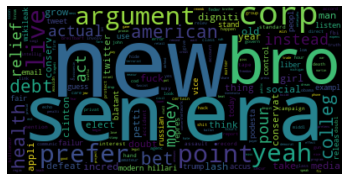

In [190]:
# Start with loading all necessary libraries
import numpy as np
import pandas as pd
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

import matplotlib.pyplot as plt
#% matplotlib inline

#dictionary_politics_list=list(dictionary_politics.values())
wordcloud = WordCloud().generate(string_dictionary_politics)

# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

### Repeating the procedure for other subreddits (top 5)to find topics and assigning them to each document. 

In [176]:
#result_lda_model_tfidf_worldnews = []
result_lda_model_tfidf_leagueoflegends = []
result_lda_model_tfidf_pcmasterrace = []
#'leagueoflegends', 'pcmasterrace'
#result_corpus_worldnews_df_tfidf = []
result_corpus_leagueoflegends_df_tfidf = []
result_corpus_pcmasterrace_df_tfidf= []

#result_dictionary_worldnews_df = []
result_dictionary_leagueoflegends_df= []
result_dictionary_pcmasterrace_df= []

#Performing the same operations for the remaining subreddits in the list of top 5 subreddits

def myfunc(subreddit_nm):
    subreddit_df = top_5_df[top_5_df["subreddit"].isin([subreddit_nm])]
    subreddit_df.index = pd.RangeIndex(len(subreddit_df.index))
    subreddit_df.index = range(len(subreddit_df.index))
    subreddit_df.reset_index(inplace=True)
    subreddit_df['parent_comment'] = subreddit_df['parent_comment'].astype('str') 
    
    processed_docs_subreddit_df = subreddit_df['parent_comment'].map(preprocess)
    processed_docs_subreddit_df
    
    dictionary_subreddit_df = gensim.corpora.Dictionary(processed_docs_subreddit_df)
    
    dictionary_subreddit_df.filter_extremes(no_below=10, no_above=0.5, keep_n=100000)
    
    bow_corpus_subreddit_df = [dictionary_subreddit_df.doc2bow(doc) for doc in processed_docs_subreddit_df]
    
    tfidf = models.TfidfModel(bow_corpus_subreddit_df)
    corpus_subreddit_df_tfidf = tfidf[bow_corpus_subreddit_df]
    
    lda_model_tfidf_subreddit_df = gensim.models.LdaMulticore(corpus_subreddit_df_tfidf, num_topics=2, id2word=dictionary_subreddit_df, passes=2, workers=4)
    
#    if( subreddit_nm == 'worldnews'):
#        result_lda_model_tfidf_worldnews = lda_model_tfidf_subreddit_df
#        result_corpus_worldnews_df_tfidf = corpus_subreddit_df_tfidf
#        result_dictionary_worldnews_df = dictionary_subreddit_df
    
    
    return lda_model_tfidf_subreddit_df,bow_corpus_subreddit_df,corpus_subreddit_df_tfidf,dictionary_subreddit_df


In [177]:
def myfunc2(lda_model_tfidf_subreddit_df, bow_corpus_subreddit_df ):
    for idx, topic in lda_model_tfidf_subreddit_df.print_topics(-1):
        print('Topic: {} Word: {}'.format(idx, topic))    
    
    count =0 
    for i in lda_model_tfidf_subreddit_df[bow_corpus_subreddit_df]:
        print("doc : ", count, i )
        count+=1

In [178]:
top_reddits[1]

'politics'

C:\Users\kapil\AppData\Local\Temp/ipykernel_6584/4053444518.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subreddit_df['parent_comment'] = subreddit_df['parent_comment'].astype('str')


Topic: 0 Word: 0.007*"like" + 0.007*"peopl" + 0.005*"know" + 0.005*"think" + 0.005*"time" + 0.005*"fuck" + 0.004*"want" + 0.004*"thing" + 0.004*"get" + 0.004*"reddit"
Topic: 1 Word: 0.008*"reddit" + 0.006*"thing" + 0.006*"peopl" + 0.005*"movi" + 0.005*"think" + 0.005*"like" + 0.005*"game" + 0.004*"know" + 0.004*"good" + 0.004*"shit"
doc :  0 [(0, 0.6930842), (1, 0.30691582)]
doc :  1 [(0, 0.13777326), (1, 0.8622267)]
doc :  2 [(0, 0.84599745), (1, 0.15400249)]
doc :  3 [(0, 0.11909548), (1, 0.88090456)]
doc :  4 [(0, 0.31289473), (1, 0.6871053)]
doc :  5 [(0, 0.18153834), (1, 0.8184616)]
doc :  6 [(0, 0.90338844), (1, 0.09661156)]
doc :  7 [(0, 0.541445), (1, 0.45855495)]
doc :  8 [(0, 0.836302), (1, 0.16369805)]
doc :  9 [(0, 0.8828508), (1, 0.11714918)]
doc :  10 [(0, 0.7382911), (1, 0.261709)]
doc :  11 [(0, 0.8845543), (1, 0.11544573)]
doc :  12 [(0, 0.55840284), (1, 0.4415972)]
doc :  13 [(0, 0.87369114), (1, 0.1263089)]
doc :  14 [(0, 0.55351067), (1, 0.44648933)]
doc :  15 [(0, 

doc :  484 [(0, 0.92089164), (1, 0.07910837)]
doc :  485 [(0, 0.19607185), (1, 0.8039282)]
doc :  486 [(0, 0.86071706), (1, 0.13928293)]
doc :  487 [(0, 0.74944454), (1, 0.2505554)]
doc :  488 [(0, 0.0925071), (1, 0.90749294)]
doc :  489 [(0, 0.8548704), (1, 0.14512959)]
doc :  490 [(0, 0.8985075), (1, 0.10149252)]
doc :  491 [(0, 0.41478816), (1, 0.5852118)]
doc :  492 [(0, 0.16084032), (1, 0.83915967)]
doc :  493 [(0, 0.08804303), (1, 0.91195697)]
doc :  494 [(0, 0.11273705), (1, 0.88726294)]
doc :  495 [(0, 0.8397803), (1, 0.16021968)]
doc :  496 [(0, 0.13206019), (1, 0.8679398)]
doc :  497 [(0, 0.13944341), (1, 0.8605566)]
doc :  498 [(0, 0.88347644), (1, 0.1165236)]
doc :  499 [(0, 0.45638165), (1, 0.5436183)]
doc :  500 [(0, 0.24190938), (1, 0.7580906)]
doc :  501 [(0, 0.13312523), (1, 0.86687475)]
doc :  502 [(0, 0.612774), (1, 0.38722602)]
doc :  503 [(0, 0.13130122), (1, 0.8686988)]
doc :  504 [(0, 0.72508705), (1, 0.27491298)]
doc :  505 [(0, 0.2104493), (1, 0.7895507)]
doc :

doc :  1009 [(0, 0.13639565), (1, 0.86360437)]
doc :  1010 [(0, 0.21033664), (1, 0.7896634)]
doc :  1011 [(0, 0.24688102), (1, 0.753119)]
doc :  1012 [(0, 0.21558543), (1, 0.7844146)]
doc :  1013 [(0, 0.15053691), (1, 0.8494631)]
doc :  1014 [(0, 0.1725945), (1, 0.8274055)]
doc :  1015 [(0, 0.10753835), (1, 0.89246166)]
doc :  1016 [(0, 0.18947612), (1, 0.81052387)]
doc :  1017 [(0, 0.17709583), (1, 0.82290417)]
doc :  1018 [(0, 0.7431149), (1, 0.25688508)]
doc :  1019 [(0, 0.08853739), (1, 0.9114626)]
doc :  1020 [(0, 0.16965692), (1, 0.83034307)]
doc :  1021 [(0, 0.85591143), (1, 0.14408855)]
doc :  1022 [(0, 0.10065117), (1, 0.8993488)]
doc :  1023 [(0, 0.46249855), (1, 0.5375015)]
doc :  1024 [(0, 0.635947), (1, 0.364053)]
doc :  1025 [(0, 0.7800389), (1, 0.21996112)]
doc :  1026 [(0, 0.88266325), (1, 0.11733678)]
doc :  1027 [(0, 0.45420134), (1, 0.54579866)]
doc :  1028 [(0, 0.2762807), (1, 0.7237193)]
doc :  1029 [(0, 0.7417002), (1, 0.2582998)]
doc :  1030 [(0, 0.11700744), (1,

doc :  1480 [(0, 0.53107774), (1, 0.46892232)]
doc :  1481 [(0, 0.32023805), (1, 0.6797619)]
doc :  1482 [(0, 0.84395176), (1, 0.1560483)]
doc :  1483 [(0, 0.1078685), (1, 0.8921315)]
doc :  1484 [(0, 0.17262049), (1, 0.82737947)]
doc :  1485 [(0, 0.056301687), (1, 0.9436983)]
doc :  1486 [(0, 0.73394066), (1, 0.26605934)]
doc :  1487 [(0, 0.7720825), (1, 0.22791749)]
doc :  1488 [(0, 0.21282299), (1, 0.787177)]
doc :  1489 [(0, 0.5842761), (1, 0.4157239)]
doc :  1490 [(0, 0.8080051), (1, 0.19199486)]
doc :  1491 [(0, 0.4793397), (1, 0.5206603)]
doc :  1492 [(0, 0.38329062), (1, 0.6167094)]
doc :  1493 [(0, 0.28926566), (1, 0.71073437)]
doc :  1494 [(0, 0.066177584), (1, 0.9338224)]
doc :  1495 [(0, 0.17398989), (1, 0.8260101)]
doc :  1496 [(0, 0.5), (1, 0.5)]
doc :  1497 [(0, 0.11143582), (1, 0.88856417)]
doc :  1498 [(0, 0.86623985), (1, 0.13376015)]
doc :  1499 [(0, 0.29027277), (1, 0.7097272)]
doc :  1500 [(0, 0.6796466), (1, 0.3203534)]
doc :  1501 [(0, 0.6836812), (1, 0.3163188)]

doc :  2002 [(0, 0.6582962), (1, 0.34170377)]
doc :  2003 [(0, 0.8447936), (1, 0.15520643)]
doc :  2004 [(0, 0.27335653), (1, 0.72664344)]
doc :  2005 [(0, 0.2113513), (1, 0.78864866)]
doc :  2006 [(0, 0.08811025), (1, 0.91188973)]
doc :  2007 [(0, 0.107560165), (1, 0.89243984)]
doc :  2008 [(0, 0.23878948), (1, 0.7612105)]
doc :  2009 [(0, 0.79472095), (1, 0.20527908)]
doc :  2010 [(0, 0.60361034), (1, 0.39638972)]
doc :  2011 [(0, 0.3186981), (1, 0.68130183)]
doc :  2012 [(0, 0.5), (1, 0.5)]
doc :  2013 [(0, 0.18588516), (1, 0.81411487)]
doc :  2014 [(0, 0.86369735), (1, 0.13630268)]
doc :  2015 [(0, 0.6276303), (1, 0.3723697)]
doc :  2016 [(0, 0.83721083), (1, 0.16278921)]
doc :  2017 [(0, 0.09744949), (1, 0.90255046)]
doc :  2018 [(0, 0.9584781), (1, 0.041521937)]
doc :  2019 [(0, 0.8337276), (1, 0.1662724)]
doc :  2020 [(0, 0.15569419), (1, 0.8443058)]
doc :  2021 [(0, 0.4930836), (1, 0.50691646)]
doc :  2022 [(0, 0.5155946), (1, 0.48440543)]
doc :  2023 [(0, 0.7403989), (1, 0.259

doc :  2481 [(0, 0.8108403), (1, 0.18915972)]
doc :  2482 [(0, 0.6557154), (1, 0.34428465)]
doc :  2483 [(0, 0.5), (1, 0.5)]
doc :  2484 [(0, 0.4534318), (1, 0.5465682)]
doc :  2485 [(0, 0.12407592), (1, 0.87592405)]
doc :  2486 [(0, 0.7898109), (1, 0.2101891)]
doc :  2487 [(0, 0.121452615), (1, 0.8785474)]
doc :  2488 [(0, 0.7258779), (1, 0.2741221)]
doc :  2489 [(0, 0.60970026), (1, 0.39029968)]
doc :  2490 [(0, 0.8869322), (1, 0.11306784)]
doc :  2491 [(0, 0.17694584), (1, 0.8230542)]
doc :  2492 [(0, 0.2393486), (1, 0.76065135)]
doc :  2493 [(0, 0.8697336), (1, 0.13026643)]
doc :  2494 [(0, 0.8537499), (1, 0.14625014)]
doc :  2495 [(0, 0.78943384), (1, 0.2105662)]
doc :  2496 [(0, 0.8994193), (1, 0.100580685)]
doc :  2497 [(0, 0.46473327), (1, 0.53526676)]
doc :  2498 [(0, 0.45792502), (1, 0.5420749)]
doc :  2499 [(0, 0.5937375), (1, 0.40626252)]
doc :  2500 [(0, 0.119843796), (1, 0.8801562)]
doc :  2501 [(0, 0.0925603), (1, 0.9074397)]
doc :  2502 [(0, 0.87917376), (1, 0.1208262)]

doc :  2980 [(0, 0.77965033), (1, 0.22034964)]
doc :  2981 [(0, 0.70963204), (1, 0.290368)]
doc :  2982 [(0, 0.5), (1, 0.5)]
doc :  2983 [(0, 0.7050352), (1, 0.29496485)]
doc :  2984 [(0, 0.8038361), (1, 0.19616394)]
doc :  2985 [(0, 0.9020988), (1, 0.09790122)]
doc :  2986 [(0, 0.30283922), (1, 0.6971608)]
doc :  2987 [(0, 0.5331269), (1, 0.46687314)]
doc :  2988 [(0, 0.5), (1, 0.5)]
doc :  2989 [(0, 0.826517), (1, 0.173483)]
doc :  2990 [(0, 0.8143271), (1, 0.1856729)]
doc :  2991 [(0, 0.62453765), (1, 0.3754624)]
doc :  2992 [(0, 0.28098327), (1, 0.71901673)]
doc :  2993 [(0, 0.84919596), (1, 0.15080407)]
doc :  2994 [(0, 0.88943636), (1, 0.11056362)]
doc :  2995 [(0, 0.757175), (1, 0.24282494)]
doc :  2996 [(0, 0.1256316), (1, 0.87436837)]
doc :  2997 [(0, 0.89030963), (1, 0.1096904)]
doc :  2998 [(0, 0.5), (1, 0.5)]
doc :  2999 [(0, 0.20994158), (1, 0.79005843)]
doc :  3000 [(0, 0.20430969), (1, 0.7956903)]
doc :  3001 [(0, 0.1271362), (1, 0.8728638)]
doc :  3002 [(0, 0.859318), (

doc :  3487 [(0, 0.8359595), (1, 0.1640405)]
doc :  3488 [(0, 0.27600107), (1, 0.72399896)]
doc :  3489 [(0, 0.82984245), (1, 0.17015754)]
doc :  3490 [(0, 0.47004226), (1, 0.5299578)]
doc :  3491 [(0, 0.086273134), (1, 0.9137268)]
doc :  3492 [(0, 0.8879475), (1, 0.11205251)]
doc :  3493 [(0, 0.69631875), (1, 0.30368125)]
doc :  3494 [(0, 0.5876167), (1, 0.41238332)]
doc :  3495 [(0, 0.34943867), (1, 0.6505614)]
doc :  3496 [(0, 0.85698044), (1, 0.14301959)]
doc :  3497 [(0, 0.09364341), (1, 0.9063566)]
doc :  3498 [(0, 0.10027897), (1, 0.899721)]
doc :  3499 [(0, 0.07087118), (1, 0.9291288)]
doc :  3500 [(0, 0.288894), (1, 0.711106)]
doc :  3501 [(0, 0.21355458), (1, 0.78644544)]
doc :  3502 [(0, 0.6614726), (1, 0.33852738)]
doc :  3503 [(0, 0.6859257), (1, 0.31407425)]
doc :  3504 [(0, 0.4935765), (1, 0.5064235)]
doc :  3505 [(0, 0.21563166), (1, 0.7843684)]
doc :  3506 [(0, 0.85290325), (1, 0.14709675)]
doc :  3507 [(0, 0.935192), (1, 0.064808)]
doc :  3508 [(0, 0.9486964), (1, 0.0

doc :  3999 [(0, 0.37734026), (1, 0.62265974)]
doc :  4000 [(0, 0.938274), (1, 0.061725933)]
doc :  4001 [(0, 0.51591617), (1, 0.48408383)]
doc :  4002 [(0, 0.3995842), (1, 0.60041577)]
doc :  4003 [(0, 0.41174486), (1, 0.5882551)]
doc :  4004 [(0, 0.18940091), (1, 0.8105991)]
doc :  4005 [(0, 0.94032514), (1, 0.05967483)]
doc :  4006 [(0, 0.46635222), (1, 0.5336477)]
doc :  4007 [(0, 0.47298214), (1, 0.52701783)]
doc :  4008 [(0, 0.82117325), (1, 0.17882675)]
doc :  4009 [(0, 0.09517705), (1, 0.90482295)]
doc :  4010 [(0, 0.1767392), (1, 0.82326084)]
doc :  4011 [(0, 0.92789197), (1, 0.07210807)]
doc :  4012 [(0, 0.97056395), (1, 0.029436057)]
doc :  4013 [(0, 0.11075558), (1, 0.8892444)]
doc :  4014 [(0, 0.27598575), (1, 0.7240142)]
doc :  4015 [(0, 0.34355533), (1, 0.65644467)]
doc :  4016 [(0, 0.9433708), (1, 0.05662912)]
doc :  4017 [(0, 0.7440321), (1, 0.25596786)]
doc :  4018 [(0, 0.5), (1, 0.5)]
doc :  4019 [(0, 0.16182958), (1, 0.83817047)]
doc :  4020 [(0, 0.20095122), (1, 0.

doc :  4505 [(0, 0.66767615), (1, 0.33232382)]
doc :  4506 [(0, 0.11734488), (1, 0.88265514)]
doc :  4507 [(0, 0.67121744), (1, 0.32878253)]
doc :  4508 [(0, 0.30821276), (1, 0.69178724)]
doc :  4509 [(0, 0.19573547), (1, 0.80426455)]
doc :  4510 [(0, 0.6236985), (1, 0.3763015)]
doc :  4511 [(0, 0.90264535), (1, 0.09735467)]
doc :  4512 [(0, 0.3023913), (1, 0.69760877)]
doc :  4513 [(0, 0.8860424), (1, 0.11395759)]
doc :  4514 [(0, 0.6647792), (1, 0.3352208)]
doc :  4515 [(0, 0.09868225), (1, 0.9013177)]
doc :  4516 [(0, 0.46511355), (1, 0.5348864)]
doc :  4517 [(0, 0.7893824), (1, 0.2106176)]
doc :  4518 [(0, 0.48033857), (1, 0.5196614)]
doc :  4519 [(0, 0.22148198), (1, 0.77851796)]
doc :  4520 [(0, 0.52142423), (1, 0.47857574)]
doc :  4521 [(0, 0.101122044), (1, 0.898878)]
doc :  4522 [(0, 0.44821426), (1, 0.5517857)]
doc :  4523 [(0, 0.49115467), (1, 0.50884527)]
doc :  4524 [(0, 0.3440898), (1, 0.6559102)]
doc :  4525 [(0, 0.5), (1, 0.5)]
doc :  4526 [(0, 0.7538866), (1, 0.2461133

doc :  4985 [(0, 0.9068795), (1, 0.09312054)]
doc :  4986 [(0, 0.89782536), (1, 0.10217458)]
doc :  4987 [(0, 0.95708674), (1, 0.04291322)]
doc :  4988 [(0, 0.29676816), (1, 0.7032318)]
doc :  4989 [(0, 0.58077145), (1, 0.41922855)]
doc :  4990 [(0, 0.75656), (1, 0.24344)]
doc :  4991 [(0, 0.6671413), (1, 0.33285865)]
doc :  4992 [(0, 0.09864649), (1, 0.90135354)]
doc :  4993 [(0, 0.6027216), (1, 0.39727846)]
doc :  4994 [(0, 0.9247746), (1, 0.075225405)]
doc :  4995 [(0, 0.4039114), (1, 0.59608865)]
doc :  4996 [(0, 0.8336448), (1, 0.1663552)]
doc :  4997 [(0, 0.14892998), (1, 0.85107005)]
doc :  4998 [(0, 0.15024401), (1, 0.849756)]
doc :  4999 [(0, 0.5583352), (1, 0.44166484)]
doc :  5000 [(0, 0.5313325), (1, 0.46866748)]
doc :  5001 [(0, 0.45386398), (1, 0.5461361)]
doc :  5002 [(0, 0.8188461), (1, 0.18115395)]
doc :  5003 [(0, 0.8218979), (1, 0.17810206)]
doc :  5004 [(0, 0.20901409), (1, 0.7909859)]
doc :  5005 [(0, 0.9253757), (1, 0.07462425)]
doc :  5006 [(0, 0.40773913), (1, 0

doc :  5508 [(0, 0.36485982), (1, 0.6351402)]
doc :  5509 [(0, 0.9730976), (1, 0.026902348)]
doc :  5510 [(0, 0.98797417), (1, 0.012025854)]
doc :  5511 [(0, 0.7956024), (1, 0.20439757)]
doc :  5512 [(0, 0.7538824), (1, 0.24611756)]
doc :  5513 [(0, 0.12299387), (1, 0.8770062)]
doc :  5514 [(0, 0.13429587), (1, 0.8657041)]
doc :  5515 [(0, 0.4706062), (1, 0.5293938)]
doc :  5516 [(0, 0.8933686), (1, 0.10663137)]
doc :  5517 [(0, 0.17169385), (1, 0.8283062)]
doc :  5518 [(0, 0.8832154), (1, 0.11678457)]
doc :  5519 [(0, 0.8383509), (1, 0.16164908)]
doc :  5520 [(0, 0.4330404), (1, 0.56695956)]
doc :  5521 [(0, 0.59945226), (1, 0.4005478)]
doc :  5522 [(0, 0.91780317), (1, 0.08219677)]
doc :  5523 [(0, 0.4836701), (1, 0.51632994)]
doc :  5524 [(0, 0.75737214), (1, 0.24262786)]
doc :  5525 [(0, 0.24548888), (1, 0.75451106)]
doc :  5526 [(0, 0.78437424), (1, 0.21562576)]
doc :  5527 [(0, 0.8705563), (1, 0.1294437)]
doc :  5528 [(0, 0.92841166), (1, 0.07158834)]
doc :  5529 [(0, 0.15355584)

doc :  5960 [(0, 0.3140728), (1, 0.6859272)]
doc :  5961 [(0, 0.18417698), (1, 0.815823)]
doc :  5962 [(0, 0.317522), (1, 0.68247795)]
doc :  5963 [(0, 0.22809191), (1, 0.7719081)]
doc :  5964 [(0, 0.22349428), (1, 0.7765057)]
doc :  5965 [(0, 0.88387245), (1, 0.11612756)]
doc :  5966 [(0, 0.8150176), (1, 0.18498243)]
doc :  5967 [(0, 0.10628274), (1, 0.8937172)]
doc :  5968 [(0, 0.2852072), (1, 0.7147928)]
doc :  5969 [(0, 0.87375015), (1, 0.12624982)]
doc :  5970 [(0, 0.6708141), (1, 0.32918593)]
doc :  5971 [(0, 0.17759192), (1, 0.82240814)]
doc :  5972 [(0, 0.15260096), (1, 0.84739906)]
doc :  5973 [(0, 0.17456843), (1, 0.8254315)]
doc :  5974 [(0, 0.24199209), (1, 0.7580079)]
doc :  5975 [(0, 0.5974463), (1, 0.40255365)]
doc :  5976 [(0, 0.20252103), (1, 0.797479)]
doc :  5977 [(0, 0.3174428), (1, 0.6825572)]
doc :  5978 [(0, 0.8701197), (1, 0.1298803)]
doc :  5979 [(0, 0.3209061), (1, 0.67909384)]
doc :  5980 [(0, 0.85861117), (1, 0.14138883)]
doc :  5981 [(0, 0.21046312), (1, 0.

doc :  6491 [(0, 0.47212732), (1, 0.5278727)]
doc :  6492 [(0, 0.19708054), (1, 0.8029195)]
doc :  6493 [(0, 0.86276174), (1, 0.13723832)]
doc :  6494 [(0, 0.54144675), (1, 0.45855328)]
doc :  6495 [(0, 0.08705293), (1, 0.91294706)]
doc :  6496 [(0, 0.87312675), (1, 0.12687327)]
doc :  6497 [(0, 0.93191415), (1, 0.06808585)]
doc :  6498 [(0, 0.5796048), (1, 0.42039523)]
doc :  6499 [(0, 0.86045), (1, 0.13955)]
doc :  6500 [(0, 0.6639513), (1, 0.33604872)]
doc :  6501 [(0, 0.79415), (1, 0.20585002)]
doc :  6502 [(0, 0.10433387), (1, 0.8956661)]
doc :  6503 [(0, 0.2790685), (1, 0.7209315)]
doc :  6504 [(0, 0.6228819), (1, 0.37711808)]
doc :  6505 [(0, 0.899749), (1, 0.100250974)]
doc :  6506 [(0, 0.75779474), (1, 0.24220522)]
doc :  6507 [(0, 0.57838124), (1, 0.42161873)]
doc :  6508 [(0, 0.86336106), (1, 0.13663892)]
doc :  6509 [(0, 0.1697578), (1, 0.8302422)]
doc :  6510 [(0, 0.22497258), (1, 0.7750274)]
doc :  6511 [(0, 0.52260566), (1, 0.47739437)]
doc :  6512 [(0, 0.1710651), (1, 0

doc :  6999 [(0, 0.12043466), (1, 0.87956536)]
doc :  7000 [(0, 0.1529196), (1, 0.8470804)]
doc :  7001 [(0, 0.27358502), (1, 0.726415)]
doc :  7002 [(0, 0.34337023), (1, 0.6566298)]
doc :  7003 [(0, 0.9314483), (1, 0.068551674)]
doc :  7004 [(0, 0.5219195), (1, 0.47808045)]
doc :  7005 [(0, 0.086783186), (1, 0.91321677)]
doc :  7006 [(0, 0.80199313), (1, 0.19800684)]
doc :  7007 [(0, 0.88159883), (1, 0.11840114)]
doc :  7008 [(0, 0.8904363), (1, 0.109563686)]
doc :  7009 [(0, 0.23381841), (1, 0.7661816)]
doc :  7010 [(0, 0.5), (1, 0.5)]
doc :  7011 [(0, 0.60162497), (1, 0.398375)]
doc :  7012 [(0, 0.16037287), (1, 0.8396271)]
doc :  7013 [(0, 0.11009384), (1, 0.8899061)]
doc :  7014 [(0, 0.23256753), (1, 0.76743245)]
doc :  7015 [(0, 0.5184337), (1, 0.48156637)]
doc :  7016 [(0, 0.56200933), (1, 0.43799067)]
doc :  7017 [(0, 0.3640612), (1, 0.6359388)]
doc :  7018 [(0, 0.20550357), (1, 0.7944964)]
doc :  7019 [(0, 0.7694249), (1, 0.23057504)]
doc :  7020 [(0, 0.9098234), (1, 0.0901765

doc :  7507 [(0, 0.8176996), (1, 0.18230039)]
doc :  7508 [(0, 0.8973429), (1, 0.10265713)]
doc :  7509 [(0, 0.07681766), (1, 0.9231823)]
doc :  7510 [(0, 0.8087484), (1, 0.19125159)]
doc :  7511 [(0, 0.7106301), (1, 0.28936994)]
doc :  7512 [(0, 0.90622026), (1, 0.093779765)]
doc :  7513 [(0, 0.5607773), (1, 0.4392227)]
doc :  7514 [(0, 0.9432945), (1, 0.05670549)]
doc :  7515 [(0, 0.9631975), (1, 0.036802456)]
doc :  7516 [(0, 0.2724917), (1, 0.7275083)]
doc :  7517 [(0, 0.73357856), (1, 0.26642144)]
doc :  7518 [(0, 0.36308032), (1, 0.6369197)]
doc :  7519 [(0, 0.6533699), (1, 0.34663016)]
doc :  7520 [(0, 0.20550905), (1, 0.79449093)]
doc :  7521 [(0, 0.7296586), (1, 0.27034143)]
doc :  7522 [(0, 0.90142137), (1, 0.09857865)]
doc :  7523 [(0, 0.12708288), (1, 0.8729171)]
doc :  7524 [(0, 0.0956701), (1, 0.9043299)]
doc :  7525 [(0, 0.86251384), (1, 0.13748614)]
doc :  7526 [(0, 0.8436413), (1, 0.15635876)]
doc :  7527 [(0, 0.7098408), (1, 0.29015929)]
doc :  7528 [(0, 0.27531376), 

doc :  7996 [(0, 0.92206144), (1, 0.077938564)]
doc :  7997 [(0, 0.84658366), (1, 0.1534164)]
doc :  7998 [(0, 0.6368101), (1, 0.3631899)]
doc :  7999 [(0, 0.273091), (1, 0.726909)]
doc :  8000 [(0, 0.5), (1, 0.5)]
doc :  8001 [(0, 0.93130034), (1, 0.068699695)]
doc :  8002 [(0, 0.26088795), (1, 0.7391121)]
doc :  8003 [(0, 0.28819868), (1, 0.7118013)]
doc :  8004 [(0, 0.1281214), (1, 0.8718786)]
doc :  8005 [(0, 0.11844526), (1, 0.8815548)]
doc :  8006 [(0, 0.88112), (1, 0.11887992)]
doc :  8007 [(0, 0.7218399), (1, 0.2781601)]
doc :  8008 [(0, 0.8193301), (1, 0.1806699)]
doc :  8009 [(0, 0.41330212), (1, 0.5866979)]
doc :  8010 [(0, 0.21482357), (1, 0.78517646)]
doc :  8011 [(0, 0.8198749), (1, 0.18012509)]
doc :  8012 [(0, 0.6492517), (1, 0.35074827)]
doc :  8013 [(0, 0.25974706), (1, 0.7402529)]
doc :  8014 [(0, 0.30240273), (1, 0.69759727)]
doc :  8015 [(0, 0.13006856), (1, 0.8699314)]
doc :  8016 [(0, 0.73700595), (1, 0.26299402)]
doc :  8017 [(0, 0.90275896), (1, 0.09724109)]
do

doc :  8478 [(0, 0.5922625), (1, 0.40773755)]
doc :  8479 [(0, 0.13909274), (1, 0.8609073)]
doc :  8480 [(0, 0.31593853), (1, 0.68406147)]
doc :  8481 [(0, 0.9134192), (1, 0.0865808)]
doc :  8482 [(0, 0.9365154), (1, 0.06348461)]
doc :  8483 [(0, 0.8344557), (1, 0.1655443)]
doc :  8484 [(0, 0.7112191), (1, 0.28878096)]
doc :  8485 [(0, 0.41109985), (1, 0.58890015)]
doc :  8486 [(0, 0.3570619), (1, 0.6429381)]
doc :  8487 [(0, 0.586834), (1, 0.41316602)]
doc :  8488 [(0, 0.11302496), (1, 0.88697505)]
doc :  8489 [(0, 0.59240353), (1, 0.40759644)]
doc :  8490 [(0, 0.5), (1, 0.5)]
doc :  8491 [(0, 0.17968126), (1, 0.8203187)]
doc :  8492 [(0, 0.8845585), (1, 0.11544154)]
doc :  8493 [(0, 0.74536157), (1, 0.25463846)]
doc :  8494 [(0, 0.85318345), (1, 0.14681649)]
doc :  8495 [(0, 0.2446066), (1, 0.75539345)]
doc :  8496 [(0, 0.88642955), (1, 0.113570414)]
doc :  8497 [(0, 0.87244385), (1, 0.12755616)]
doc :  8498 [(0, 0.84663796), (1, 0.15336202)]
doc :  8499 [(0, 0.32999483), (1, 0.67000

doc :  9003 [(0, 0.5576731), (1, 0.44232684)]
doc :  9004 [(0, 0.38887674), (1, 0.6111232)]
doc :  9005 [(0, 0.84959394), (1, 0.1504061)]
doc :  9006 [(0, 0.91497546), (1, 0.08502459)]
doc :  9007 [(0, 0.8499295), (1, 0.15007047)]
doc :  9008 [(0, 0.5520779), (1, 0.44792214)]
doc :  9009 [(0, 0.29806313), (1, 0.7019369)]
doc :  9010 [(0, 0.64969724), (1, 0.35030276)]
doc :  9011 [(0, 0.64033055), (1, 0.3596695)]
doc :  9012 [(0, 0.27719545), (1, 0.72280455)]
doc :  9013 [(0, 0.13732016), (1, 0.86267984)]
doc :  9014 [(0, 0.6268145), (1, 0.37318552)]
doc :  9015 [(0, 0.5771678), (1, 0.42283213)]
doc :  9016 [(0, 0.80767536), (1, 0.19232464)]
doc :  9017 [(0, 0.9193224), (1, 0.0806776)]
doc :  9018 [(0, 0.28015247), (1, 0.71984756)]
doc :  9019 [(0, 0.15038352), (1, 0.84961647)]
doc :  9020 [(0, 0.4254809), (1, 0.57451904)]
doc :  9021 [(0, 0.47653604), (1, 0.523464)]
doc :  9022 [(0, 0.1495224), (1, 0.85047764)]
doc :  9023 [(0, 0.25738633), (1, 0.7426137)]
doc :  9024 [(0, 0.22676362),

doc :  9519 [(0, 0.7077981), (1, 0.29220185)]
doc :  9520 [(0, 0.25553387), (1, 0.7444662)]
doc :  9521 [(0, 0.18908119), (1, 0.81091875)]
doc :  9522 [(0, 0.83455783), (1, 0.16544217)]
doc :  9523 [(0, 0.68431884), (1, 0.31568116)]
doc :  9524 [(0, 0.39817923), (1, 0.6018207)]
doc :  9525 [(0, 0.68277234), (1, 0.31722766)]
doc :  9526 [(0, 0.03989829), (1, 0.9601017)]
doc :  9527 [(0, 0.093673676), (1, 0.90632635)]
doc :  9528 [(0, 0.96011055), (1, 0.039889477)]
doc :  9529 [(0, 0.18581328), (1, 0.8141867)]
doc :  9530 [(0, 0.22752187), (1, 0.77247816)]
doc :  9531 [(0, 0.1002344), (1, 0.8997656)]
doc :  9532 [(0, 0.3210296), (1, 0.6789704)]
doc :  9533 [(0, 0.69325024), (1, 0.3067497)]
doc :  9534 [(0, 0.9527668), (1, 0.047233213)]
doc :  9535 [(0, 0.7736046), (1, 0.22639541)]
doc :  9536 [(0, 0.25534853), (1, 0.7446515)]
doc :  9537 [(0, 0.13822623), (1, 0.8617738)]
doc :  9538 [(0, 0.6614374), (1, 0.33856264)]
doc :  9539 [(0, 0.10766218), (1, 0.8923378)]
doc :  9540 [(0, 0.9016279

doc :  9994 [(0, 0.5641664), (1, 0.4358336)]
doc :  9995 [(0, 0.89690953), (1, 0.103090495)]
doc :  9996 [(0, 0.24002463), (1, 0.7599754)]
doc :  9997 [(0, 0.16095449), (1, 0.8390455)]
doc :  9998 [(0, 0.9280539), (1, 0.071946084)]
doc :  9999 [(0, 0.6793391), (1, 0.32066083)]
doc :  10000 [(0, 0.94544166), (1, 0.054558363)]
doc :  10001 [(0, 0.1495172), (1, 0.8504828)]
doc :  10002 [(0, 0.83977395), (1, 0.16022603)]
doc :  10003 [(0, 0.8288723), (1, 0.17112769)]
doc :  10004 [(0, 0.7357947), (1, 0.26420528)]
doc :  10005 [(0, 0.13744746), (1, 0.8625525)]
doc :  10006 [(0, 0.22532806), (1, 0.774672)]
doc :  10007 [(0, 0.92004853), (1, 0.07995147)]
doc :  10008 [(0, 0.85141414), (1, 0.14858592)]
doc :  10009 [(0, 0.8959078), (1, 0.104092196)]
doc :  10010 [(0, 0.8092064), (1, 0.1907936)]
doc :  10011 [(0, 0.19356312), (1, 0.8064369)]
doc :  10012 [(0, 0.1291734), (1, 0.8708266)]
doc :  10013 [(0, 0.17312762), (1, 0.82687235)]
doc :  10014 [(0, 0.14841114), (1, 0.8515889)]
doc :  10015 [

doc :  10481 [(0, 0.13868544), (1, 0.86131454)]
doc :  10482 [(0, 0.08244201), (1, 0.917558)]
doc :  10483 [(0, 0.9812743), (1, 0.018725734)]
doc :  10484 [(0, 0.18753286), (1, 0.8124671)]
doc :  10485 [(0, 0.19777863), (1, 0.80222136)]
doc :  10486 [(0, 0.41017067), (1, 0.5898293)]
doc :  10487 [(0, 0.09475659), (1, 0.9052434)]
doc :  10488 [(0, 0.26813182), (1, 0.73186815)]
doc :  10489 [(0, 0.38389197), (1, 0.61610806)]
doc :  10490 [(0, 0.68363446), (1, 0.31636557)]
doc :  10491 [(0, 0.9233738), (1, 0.07662615)]
doc :  10492 [(0, 0.9371542), (1, 0.062845886)]
doc :  10493 [(0, 0.3441552), (1, 0.65584487)]
doc :  10494 [(0, 0.9214431), (1, 0.07855688)]
doc :  10495 [(0, 0.11206625), (1, 0.88793373)]
doc :  10496 [(0, 0.91620106), (1, 0.08379893)]
doc :  10497 [(0, 0.58328676), (1, 0.41671318)]
doc :  10498 [(0, 0.75553936), (1, 0.24446064)]
doc :  10499 [(0, 0.35850164), (1, 0.6414984)]
doc :  10500 [(0, 0.8326758), (1, 0.16732423)]
doc :  10501 [(0, 0.21328004), (1, 0.7867199)]
doc

doc :  10976 [(0, 0.2990503), (1, 0.70094967)]
doc :  10977 [(0, 0.43421242), (1, 0.5657876)]
doc :  10978 [(0, 0.22722611), (1, 0.7727739)]
doc :  10979 [(0, 0.7803456), (1, 0.21965441)]
doc :  10980 [(0, 0.87487763), (1, 0.1251224)]
doc :  10981 [(0, 0.5), (1, 0.5)]
doc :  10982 [(0, 0.7224358), (1, 0.27756426)]
doc :  10983 [(0, 0.114061065), (1, 0.88593894)]
doc :  10984 [(0, 0.31136283), (1, 0.68863714)]
doc :  10985 [(0, 0.84640443), (1, 0.1535956)]
doc :  10986 [(0, 0.38852683), (1, 0.61147314)]
doc :  10987 [(0, 0.06010049), (1, 0.9398995)]
doc :  10988 [(0, 0.41552916), (1, 0.5844708)]
doc :  10989 [(0, 0.1718212), (1, 0.82817876)]
doc :  10990 [(0, 0.17386757), (1, 0.8261324)]
doc :  10991 [(0, 0.37018174), (1, 0.62981826)]
doc :  10992 [(0, 0.1750295), (1, 0.8249705)]
doc :  10993 [(0, 0.19634755), (1, 0.80365247)]
doc :  10994 [(0, 0.8766949), (1, 0.12330511)]
doc :  10995 [(0, 0.21208298), (1, 0.787917)]
doc :  10996 [(0, 0.14978199), (1, 0.85021794)]
doc :  10997 [(0, 0.5

doc :  11509 [(0, 0.8389113), (1, 0.1610887)]
doc :  11510 [(0, 0.08392156), (1, 0.91607845)]
doc :  11511 [(0, 0.71907437), (1, 0.28092563)]
doc :  11512 [(0, 0.13563038), (1, 0.86436963)]
doc :  11513 [(0, 0.34951612), (1, 0.6504839)]
doc :  11514 [(0, 0.22564961), (1, 0.77435035)]
doc :  11515 [(0, 0.42025924), (1, 0.57974076)]
doc :  11516 [(0, 0.5), (1, 0.5)]
doc :  11517 [(0, 0.1350585), (1, 0.86494154)]
doc :  11518 [(0, 0.18048215), (1, 0.81951785)]
doc :  11519 [(0, 0.78251505), (1, 0.21748497)]
doc :  11520 [(0, 0.7269269), (1, 0.27307308)]
doc :  11521 [(0, 0.9670233), (1, 0.032976698)]
doc :  11522 [(0, 0.40588698), (1, 0.59411305)]
doc :  11523 [(0, 0.77221835), (1, 0.22778164)]
doc :  11524 [(0, 0.5938916), (1, 0.40610838)]
doc :  11525 [(0, 0.18752289), (1, 0.8124771)]
doc :  11526 [(0, 0.5691423), (1, 0.43085772)]
doc :  11527 [(0, 0.89018005), (1, 0.109819956)]
doc :  11528 [(0, 0.9175646), (1, 0.08243541)]
doc :  11529 [(0, 0.61512417), (1, 0.3848759)]
doc :  11530 [(

doc :  12012 [(0, 0.82367104), (1, 0.17632894)]
doc :  12013 [(0, 0.58518136), (1, 0.41481864)]
doc :  12014 [(0, 0.87112695), (1, 0.12887311)]
doc :  12015 [(0, 0.07870164), (1, 0.9212983)]
doc :  12016 [(0, 0.7858436), (1, 0.2141564)]
doc :  12017 [(0, 0.86451966), (1, 0.13548033)]
doc :  12018 [(0, 0.16109101), (1, 0.838909)]
doc :  12019 [(0, 0.80066395), (1, 0.19933613)]
doc :  12020 [(0, 0.8190732), (1, 0.18092676)]
doc :  12021 [(0, 0.81277543), (1, 0.18722458)]
doc :  12022 [(0, 0.54487145), (1, 0.45512858)]
doc :  12023 [(0, 0.15040953), (1, 0.8495905)]
doc :  12024 [(0, 0.17307037), (1, 0.82692957)]
doc :  12025 [(0, 0.84303486), (1, 0.15696509)]
doc :  12026 [(0, 0.58300114), (1, 0.41699886)]
doc :  12027 [(0, 0.6863267), (1, 0.31367332)]
doc :  12028 [(0, 0.94961715), (1, 0.050382826)]
doc :  12029 [(0, 0.75710195), (1, 0.24289805)]
doc :  12030 [(0, 0.5), (1, 0.5)]
doc :  12031 [(0, 0.7364346), (1, 0.26356542)]
doc :  12032 [(0, 0.3870249), (1, 0.61297506)]
doc :  12033 [(

doc :  12557 [(0, 0.42321306), (1, 0.576787)]
doc :  12558 [(0, 0.34240365), (1, 0.6575963)]
doc :  12559 [(0, 0.17952509), (1, 0.8204749)]
doc :  12560 [(0, 0.15350558), (1, 0.84649444)]
doc :  12561 [(0, 0.93563664), (1, 0.06436333)]
doc :  12562 [(0, 0.93528974), (1, 0.06471027)]
doc :  12563 [(0, 0.10705597), (1, 0.89294404)]
doc :  12564 [(0, 0.57478654), (1, 0.42521352)]
doc :  12565 [(0, 0.5863273), (1, 0.41367272)]
doc :  12566 [(0, 0.73806363), (1, 0.26193637)]
doc :  12567 [(0, 0.6923215), (1, 0.3076785)]
doc :  12568 [(0, 0.8088374), (1, 0.19116262)]
doc :  12569 [(0, 0.32134596), (1, 0.678654)]
doc :  12570 [(0, 0.85039026), (1, 0.14960976)]
doc :  12571 [(0, 0.29657516), (1, 0.7034248)]
doc :  12572 [(0, 0.89606726), (1, 0.1039328)]
doc :  12573 [(0, 0.95820725), (1, 0.041792717)]
doc :  12574 [(0, 0.75975865), (1, 0.24024133)]
doc :  12575 [(0, 0.7521149), (1, 0.24788503)]
doc :  12576 [(0, 0.17967664), (1, 0.82032335)]
doc :  12577 [(0, 0.4430448), (1, 0.5569552)]
doc : 

doc :  12999 [(0, 0.70902854), (1, 0.2909715)]
doc :  13000 [(0, 0.69802326), (1, 0.3019768)]
doc :  13001 [(0, 0.69738626), (1, 0.3026138)]
doc :  13002 [(0, 0.8490229), (1, 0.15097712)]
doc :  13003 [(0, 0.31340206), (1, 0.686598)]
doc :  13004 [(0, 0.60648423), (1, 0.3935158)]
doc :  13005 [(0, 0.91383153), (1, 0.08616845)]
doc :  13006 [(0, 0.8039213), (1, 0.19607875)]
doc :  13007 [(0, 0.3821666), (1, 0.61783344)]
doc :  13008 [(0, 0.6164822), (1, 0.3835178)]
doc :  13009 [(0, 0.43180412), (1, 0.5681958)]
doc :  13010 [(0, 0.96237946), (1, 0.037620526)]
doc :  13011 [(0, 0.5091542), (1, 0.49084583)]
doc :  13012 [(0, 0.5490246), (1, 0.4509754)]
doc :  13013 [(0, 0.14560606), (1, 0.85439396)]
doc :  13014 [(0, 0.5), (1, 0.5)]
doc :  13015 [(0, 0.11879653), (1, 0.8812035)]
doc :  13016 [(0, 0.46107665), (1, 0.5389233)]
doc :  13017 [(0, 0.7462014), (1, 0.25379857)]
doc :  13018 [(0, 0.1290155), (1, 0.8709845)]
doc :  13019 [(0, 0.17212436), (1, 0.8278756)]
doc :  13020 [(0, 0.103222

doc :  13513 [(0, 0.73745686), (1, 0.26254314)]
doc :  13514 [(0, 0.7621949), (1, 0.23780514)]
doc :  13515 [(0, 0.4965898), (1, 0.50341016)]
doc :  13516 [(0, 0.96434325), (1, 0.035656802)]
doc :  13517 [(0, 0.5146889), (1, 0.48531112)]
doc :  13518 [(0, 0.22098142), (1, 0.7790186)]
doc :  13519 [(0, 0.27419764), (1, 0.7258023)]
doc :  13520 [(0, 0.8117509), (1, 0.18824908)]
doc :  13521 [(0, 0.30198336), (1, 0.69801664)]
doc :  13522 [(0, 0.71540487), (1, 0.28459513)]
doc :  13523 [(0, 0.1736324), (1, 0.8263676)]
doc :  13524 [(0, 0.70204556), (1, 0.29795444)]
doc :  13525 [(0, 0.9504785), (1, 0.049521524)]
doc :  13526 [(0, 0.946739), (1, 0.05326099)]
doc :  13527 [(0, 0.41020954), (1, 0.58979046)]
doc :  13528 [(0, 0.1808227), (1, 0.81917727)]
doc :  13529 [(0, 0.7629853), (1, 0.2370147)]
doc :  13530 [(0, 0.1336469), (1, 0.86635315)]
doc :  13531 [(0, 0.03131806), (1, 0.96868193)]
doc :  13532 [(0, 0.847557), (1, 0.15244295)]
doc :  13533 [(0, 0.97622067), (1, 0.02377929)]
doc :  

doc :  14019 [(0, 0.45345962), (1, 0.5465404)]
doc :  14020 [(0, 0.72730184), (1, 0.2726982)]
doc :  14021 [(0, 0.38282892), (1, 0.61717105)]
doc :  14022 [(0, 0.26811448), (1, 0.73188555)]
doc :  14023 [(0, 0.6858844), (1, 0.31411558)]
doc :  14024 [(0, 0.87479323), (1, 0.12520681)]
doc :  14025 [(0, 0.5470106), (1, 0.45298934)]
doc :  14026 [(0, 0.15817785), (1, 0.84182215)]
doc :  14027 [(0, 0.33953118), (1, 0.6604688)]
doc :  14028 [(0, 0.22773987), (1, 0.7722601)]
doc :  14029 [(0, 0.897497), (1, 0.10250298)]
doc :  14030 [(0, 0.2654629), (1, 0.73453707)]
doc :  14031 [(0, 0.5), (1, 0.5)]
doc :  14032 [(0, 0.49850413), (1, 0.5014959)]
doc :  14033 [(0, 0.28766394), (1, 0.71233606)]
doc :  14034 [(0, 0.805415), (1, 0.19458504)]
doc :  14035 [(0, 0.9003588), (1, 0.09964118)]
doc :  14036 [(0, 0.26991588), (1, 0.7300841)]
doc :  14037 [(0, 0.20796928), (1, 0.7920307)]
doc :  14038 [(0, 0.21915184), (1, 0.7808482)]
doc :  14039 [(0, 0.5389121), (1, 0.4610879)]
doc :  14040 [(0, 0.2091

doc :  14494 [(0, 0.145779), (1, 0.854221)]
doc :  14495 [(0, 0.353495), (1, 0.646505)]
doc :  14496 [(0, 0.5), (1, 0.5)]
doc :  14497 [(0, 0.8540907), (1, 0.14590928)]
doc :  14498 [(0, 0.21479255), (1, 0.78520745)]
doc :  14499 [(0, 0.1528392), (1, 0.8471608)]
doc :  14500 [(0, 0.23780921), (1, 0.76219076)]
doc :  14501 [(0, 0.6527503), (1, 0.34724966)]
doc :  14502 [(0, 0.7367818), (1, 0.2632182)]
doc :  14503 [(0, 0.80470115), (1, 0.1952989)]
doc :  14504 [(0, 0.5), (1, 0.5)]
doc :  14505 [(0, 0.096488275), (1, 0.90351176)]
doc :  14506 [(0, 0.5), (1, 0.5)]
doc :  14507 [(0, 0.6033103), (1, 0.39668977)]
doc :  14508 [(0, 0.91474295), (1, 0.08525708)]
doc :  14509 [(0, 0.47011355), (1, 0.5298864)]
doc :  14510 [(0, 0.8372699), (1, 0.1627301)]
doc :  14511 [(0, 0.086814485), (1, 0.91318554)]
doc :  14512 [(0, 0.4037807), (1, 0.5962193)]
doc :  14513 [(0, 0.09375622), (1, 0.9062438)]
doc :  14514 [(0, 0.6417201), (1, 0.35827988)]
doc :  14515 [(0, 0.704193), (1, 0.29580706)]
doc :  14

doc :  14957 [(0, 0.68002063), (1, 0.31997943)]
doc :  14958 [(0, 0.5712642), (1, 0.42873573)]
doc :  14959 [(0, 0.7493526), (1, 0.2506474)]
doc :  14960 [(0, 0.7501219), (1, 0.24987814)]
doc :  14961 [(0, 0.7549579), (1, 0.24504209)]
doc :  14962 [(0, 0.5), (1, 0.5)]
doc :  14963 [(0, 0.4349594), (1, 0.5650406)]
doc :  14964 [(0, 0.69304574), (1, 0.3069543)]
doc :  14965 [(0, 0.3283892), (1, 0.67161083)]
doc :  14966 [(0, 0.70686984), (1, 0.2931302)]
doc :  14967 [(0, 0.28199884), (1, 0.7180011)]
doc :  14968 [(0, 0.5), (1, 0.5)]
doc :  14969 [(0, 0.35514498), (1, 0.644855)]
doc :  14970 [(0, 0.8505546), (1, 0.14944544)]
doc :  14971 [(0, 0.4581582), (1, 0.5418418)]
doc :  14972 [(0, 0.8424323), (1, 0.15756772)]
doc :  14973 [(0, 0.17583428), (1, 0.8241657)]
doc :  14974 [(0, 0.3550215), (1, 0.6449785)]
doc :  14975 [(0, 0.7938901), (1, 0.20610987)]
doc :  14976 [(0, 0.629806), (1, 0.37019408)]
doc :  14977 [(0, 0.13412009), (1, 0.8658799)]
doc :  14978 [(0, 0.5724073), (1, 0.42759272

doc :  15441 [(0, 0.94997), (1, 0.050029974)]
doc :  15442 [(0, 0.5261297), (1, 0.47387034)]
doc :  15443 [(0, 0.68516016), (1, 0.31483984)]
doc :  15444 [(0, 0.522147), (1, 0.477853)]
doc :  15445 [(0, 0.8229593), (1, 0.17704065)]
doc :  15446 [(0, 0.8674021), (1, 0.13259786)]
doc :  15447 [(0, 0.15776221), (1, 0.8422378)]
doc :  15448 [(0, 0.7197185), (1, 0.28028145)]
doc :  15449 [(0, 0.09137243), (1, 0.90862757)]
doc :  15450 [(0, 0.8458754), (1, 0.15412457)]
doc :  15451 [(0, 0.45427805), (1, 0.5457219)]
doc :  15452 [(0, 0.5), (1, 0.5)]
doc :  15453 [(0, 0.94742304), (1, 0.052576996)]
doc :  15454 [(0, 0.5), (1, 0.5)]
doc :  15455 [(0, 0.09129924), (1, 0.90870076)]
doc :  15456 [(0, 0.12274627), (1, 0.8772537)]
doc :  15457 [(0, 0.67931795), (1, 0.320682)]
doc :  15458 [(0, 0.2657954), (1, 0.7342046)]
doc :  15459 [(0, 0.4598191), (1, 0.54018086)]
doc :  15460 [(0, 0.15163425), (1, 0.8483657)]
doc :  15461 [(0, 0.46915266), (1, 0.5308473)]
doc :  15462 [(0, 0.6951073), (1, 0.3048

doc :  15997 [(0, 0.22862113), (1, 0.7713789)]
doc :  15998 [(0, 0.6940393), (1, 0.3059607)]
doc :  15999 [(0, 0.92412853), (1, 0.07587142)]
doc :  16000 [(0, 0.6231085), (1, 0.3768915)]
doc :  16001 [(0, 0.10105946), (1, 0.89894056)]
doc :  16002 [(0, 0.57985646), (1, 0.42014357)]
doc :  16003 [(0, 0.911981), (1, 0.08801899)]
doc :  16004 [(0, 0.825174), (1, 0.17482607)]
doc :  16005 [(0, 0.80048007), (1, 0.19951996)]
doc :  16006 [(0, 0.20874803), (1, 0.79125196)]
doc :  16007 [(0, 0.7424251), (1, 0.25757495)]
doc :  16008 [(0, 0.5949259), (1, 0.40507418)]
doc :  16009 [(0, 0.5949322), (1, 0.40506786)]
doc :  16010 [(0, 0.78112334), (1, 0.21887666)]
doc :  16011 [(0, 0.43621203), (1, 0.563788)]
doc :  16012 [(0, 0.31106725), (1, 0.6889328)]
doc :  16013 [(0, 0.9616254), (1, 0.038374543)]
doc :  16014 [(0, 0.88382906), (1, 0.11617096)]
doc :  16015 [(0, 0.26742178), (1, 0.7325783)]
doc :  16016 [(0, 0.5), (1, 0.5)]
doc :  16017 [(0, 0.70164514), (1, 0.29835483)]
doc :  16018 [(0, 0.57

doc :  16445 [(0, 0.90966344), (1, 0.09033651)]
doc :  16446 [(0, 0.11747721), (1, 0.8825228)]
doc :  16447 [(0, 0.7624303), (1, 0.23756969)]
doc :  16448 [(0, 0.26455143), (1, 0.73544854)]
doc :  16449 [(0, 0.9059037), (1, 0.094096325)]
doc :  16450 [(0, 0.17835169), (1, 0.8216483)]
doc :  16451 [(0, 0.14075334), (1, 0.8592467)]
doc :  16452 [(0, 0.97418725), (1, 0.025812801)]
doc :  16453 [(0, 0.83808255), (1, 0.16191748)]
doc :  16454 [(0, 0.80558157), (1, 0.19441843)]
doc :  16455 [(0, 0.8921432), (1, 0.10785679)]
doc :  16456 [(0, 0.34467041), (1, 0.6553296)]
doc :  16457 [(0, 0.24805926), (1, 0.7519408)]
doc :  16458 [(0, 0.72325534), (1, 0.27674463)]
doc :  16459 [(0, 0.25951973), (1, 0.74048024)]
doc :  16460 [(0, 0.85655856), (1, 0.14344142)]
doc :  16461 [(0, 0.3905874), (1, 0.6094126)]
doc :  16462 [(0, 0.6757435), (1, 0.32425648)]
doc :  16463 [(0, 0.47896588), (1, 0.5210341)]
doc :  16464 [(0, 0.7999417), (1, 0.20005825)]
doc :  16465 [(0, 0.12551162), (1, 0.87448835)]
doc

doc :  16931 [(0, 0.6255801), (1, 0.37441993)]
doc :  16932 [(0, 0.5340349), (1, 0.46596506)]
doc :  16933 [(0, 0.19048986), (1, 0.8095101)]
doc :  16934 [(0, 0.7305773), (1, 0.2694227)]
doc :  16935 [(0, 0.06341771), (1, 0.93658227)]
doc :  16936 [(0, 0.43937126), (1, 0.5606287)]
doc :  16937 [(0, 0.80325913), (1, 0.19674087)]
doc :  16938 [(0, 0.275309), (1, 0.72469103)]
doc :  16939 [(0, 0.80324453), (1, 0.19675545)]
doc :  16940 [(0, 0.111502394), (1, 0.88849765)]
doc :  16941 [(0, 0.43820876), (1, 0.5617912)]
doc :  16942 [(0, 0.047156952), (1, 0.952843)]
doc :  16943 [(0, 0.9701025), (1, 0.02989754)]
doc :  16944 [(0, 0.28628454), (1, 0.7137155)]
doc :  16945 [(0, 0.3671962), (1, 0.63280374)]
doc :  16946 [(0, 0.19857647), (1, 0.8014235)]
doc :  16947 [(0, 0.1838747), (1, 0.81612533)]
doc :  16948 [(0, 0.73760897), (1, 0.26239103)]
doc :  16949 [(0, 0.55850106), (1, 0.44149897)]
doc :  16950 [(0, 0.4687127), (1, 0.5312873)]
doc :  16951 [(0, 0.9008385), (1, 0.09916149)]
doc :  16

doc :  17491 [(0, 0.4070314), (1, 0.59296864)]
doc :  17492 [(0, 0.659453), (1, 0.34054706)]
doc :  17493 [(0, 0.79371166), (1, 0.20628837)]
doc :  17494 [(0, 0.8446892), (1, 0.1553108)]
doc :  17495 [(0, 0.16250658), (1, 0.8374934)]
doc :  17496 [(0, 0.79953223), (1, 0.20046775)]
doc :  17497 [(0, 0.30415693), (1, 0.6958431)]
doc :  17498 [(0, 0.8832294), (1, 0.11677061)]
doc :  17499 [(0, 0.63008183), (1, 0.36991817)]
doc :  17500 [(0, 0.82550144), (1, 0.17449859)]
doc :  17501 [(0, 0.27449173), (1, 0.7255083)]
doc :  17502 [(0, 0.17340568), (1, 0.82659435)]
doc :  17503 [(0, 0.3932502), (1, 0.6067498)]
doc :  17504 [(0, 0.09831018), (1, 0.9016898)]
doc :  17505 [(0, 0.1448551), (1, 0.85514486)]
doc :  17506 [(0, 0.14743438), (1, 0.8525656)]
doc :  17507 [(0, 0.6571156), (1, 0.3428844)]
doc :  17508 [(0, 0.7856616), (1, 0.21433839)]
doc :  17509 [(0, 0.88739157), (1, 0.11260845)]
doc :  17510 [(0, 0.5753807), (1, 0.42461932)]
doc :  17511 [(0, 0.41875303), (1, 0.581247)]
doc :  17512

doc :  17935 [(0, 0.71083015), (1, 0.28916985)]
doc :  17936 [(0, 0.1172769), (1, 0.8827231)]
doc :  17937 [(0, 0.73856014), (1, 0.2614399)]
doc :  17938 [(0, 0.16247681), (1, 0.83752316)]
doc :  17939 [(0, 0.11912473), (1, 0.8808753)]
doc :  17940 [(0, 0.90903765), (1, 0.0909624)]
doc :  17941 [(0, 0.43707934), (1, 0.5629207)]
doc :  17942 [(0, 0.20477775), (1, 0.7952223)]
doc :  17943 [(0, 0.95704323), (1, 0.04295674)]
doc :  17944 [(0, 0.13920005), (1, 0.8607999)]
doc :  17945 [(0, 0.80395406), (1, 0.19604594)]
doc :  17946 [(0, 0.72654456), (1, 0.27345544)]
doc :  17947 [(0, 0.82838136), (1, 0.17161864)]
doc :  17948 [(0, 0.90438753), (1, 0.095612474)]
doc :  17949 [(0, 0.6491623), (1, 0.3508377)]
doc :  17950 [(0, 0.92858887), (1, 0.071411125)]
doc :  17951 [(0, 0.081725754), (1, 0.9182742)]
doc :  17952 [(0, 0.17004053), (1, 0.8299595)]
doc :  17953 [(0, 0.53105503), (1, 0.46894497)]
doc :  17954 [(0, 0.81662536), (1, 0.18337469)]
doc :  17955 [(0, 0.8145088), (1, 0.18549123)]
do

doc :  18455 [(0, 0.86637443), (1, 0.13362558)]
doc :  18456 [(0, 0.16029827), (1, 0.8397017)]
doc :  18457 [(0, 0.78717685), (1, 0.21282314)]
doc :  18458 [(0, 0.8857968), (1, 0.114203155)]
doc :  18459 [(0, 0.39479434), (1, 0.60520566)]
doc :  18460 [(0, 0.94494534), (1, 0.05505469)]
doc :  18461 [(0, 0.8465396), (1, 0.15346032)]
doc :  18462 [(0, 0.18238974), (1, 0.81761026)]
doc :  18463 [(0, 0.78339016), (1, 0.21660987)]
doc :  18464 [(0, 0.10407961), (1, 0.8959204)]
doc :  18465 [(0, 0.40149963), (1, 0.5985004)]
doc :  18466 [(0, 0.062225748), (1, 0.9377743)]
doc :  18467 [(0, 0.31843552), (1, 0.68156445)]
doc :  18468 [(0, 0.7248701), (1, 0.27512994)]
doc :  18469 [(0, 0.7834569), (1, 0.21654308)]
doc :  18470 [(0, 0.6930324), (1, 0.3069676)]
doc :  18471 [(0, 0.141522), (1, 0.858478)]
doc :  18472 [(0, 0.12987305), (1, 0.87012696)]
doc :  18473 [(0, 0.6212798), (1, 0.3787202)]
doc :  18474 [(0, 0.40671954), (1, 0.5932805)]
doc :  18475 [(0, 0.8182562), (1, 0.18174383)]
doc :  1

doc :  19003 [(0, 0.709641), (1, 0.29035905)]
doc :  19004 [(0, 0.79864), (1, 0.20135999)]
doc :  19005 [(0, 0.86434436), (1, 0.13565561)]
doc :  19006 [(0, 0.80366117), (1, 0.19633888)]
doc :  19007 [(0, 0.8242385), (1, 0.1757615)]
doc :  19008 [(0, 0.43715233), (1, 0.5628477)]
doc :  19009 [(0, 0.7809682), (1, 0.21903181)]
doc :  19010 [(0, 0.25825766), (1, 0.7417424)]
doc :  19011 [(0, 0.7901188), (1, 0.20988113)]
doc :  19012 [(0, 0.7886837), (1, 0.21131626)]
doc :  19013 [(0, 0.849343), (1, 0.150657)]
doc :  19014 [(0, 0.14076266), (1, 0.8592373)]
doc :  19015 [(0, 0.73848426), (1, 0.2615157)]
doc :  19016 [(0, 0.92361856), (1, 0.07638146)]
doc :  19017 [(0, 0.7081993), (1, 0.29180068)]
doc :  19018 [(0, 0.78242654), (1, 0.21757348)]
doc :  19019 [(0, 0.26008007), (1, 0.7399199)]
doc :  19020 [(0, 0.26040608), (1, 0.7395939)]
doc :  19021 [(0, 0.56312174), (1, 0.43687832)]
doc :  19022 [(0, 0.5631073), (1, 0.43689278)]
doc :  19023 [(0, 0.29165182), (1, 0.7083482)]
doc :  19024 [(

doc :  19479 [(0, 0.8224101), (1, 0.17758992)]
doc :  19480 [(0, 0.5732996), (1, 0.42670047)]
doc :  19481 [(0, 0.887616), (1, 0.112384)]
doc :  19482 [(0, 0.2295818), (1, 0.77041817)]
doc :  19483 [(0, 0.27815723), (1, 0.72184277)]
doc :  19484 [(0, 0.9210609), (1, 0.07893906)]
doc :  19485 [(0, 0.10600115), (1, 0.8939988)]
doc :  19486 [(0, 0.6173021), (1, 0.38269785)]
doc :  19487 [(0, 0.80240124), (1, 0.19759874)]
doc :  19488 [(0, 0.72836405), (1, 0.27163598)]
doc :  19489 [(0, 0.18282846), (1, 0.8171715)]
doc :  19490 [(0, 0.8312319), (1, 0.16876815)]
doc :  19491 [(0, 0.4300778), (1, 0.5699222)]
doc :  19492 [(0, 0.9340797), (1, 0.065920234)]
doc :  19493 [(0, 0.84565514), (1, 0.15434483)]
doc :  19494 [(0, 0.42672688), (1, 0.57327306)]
doc :  19495 [(0, 0.17917283), (1, 0.8208271)]
doc :  19496 [(0, 0.30283618), (1, 0.6971638)]
doc :  19497 [(0, 0.9303772), (1, 0.06962283)]
doc :  19498 [(0, 0.27263623), (1, 0.72736377)]
doc :  19499 [(0, 0.076652884), (1, 0.9233471)]
doc :  19

doc :  20003 [(0, 0.88399583), (1, 0.11600419)]
doc :  20004 [(0, 0.6714097), (1, 0.32859024)]
doc :  20005 [(0, 0.3071975), (1, 0.6928025)]
doc :  20006 [(0, 0.6105518), (1, 0.3894482)]
doc :  20007 [(0, 0.8116615), (1, 0.18833849)]
doc :  20008 [(0, 0.44231004), (1, 0.55768996)]
doc :  20009 [(0, 0.09502977), (1, 0.9049702)]
doc :  20010 [(0, 0.17672794), (1, 0.82327205)]
doc :  20011 [(0, 0.19482173), (1, 0.8051782)]
doc :  20012 [(0, 0.1394765), (1, 0.8605235)]
doc :  20013 [(0, 0.83058643), (1, 0.16941361)]
doc :  20014 [(0, 0.6213237), (1, 0.3786763)]
doc :  20015 [(0, 0.6376095), (1, 0.36239058)]
doc :  20016 [(0, 0.26000813), (1, 0.73999184)]
doc :  20017 [(0, 0.23578139), (1, 0.7642186)]
doc :  20018 [(0, 0.29879636), (1, 0.7012037)]
doc :  20019 [(0, 0.79278326), (1, 0.2072168)]
doc :  20020 [(0, 0.6326604), (1, 0.3673396)]
doc :  20021 [(0, 0.16885407), (1, 0.8311459)]
doc :  20022 [(0, 0.9215919), (1, 0.078408085)]
doc :  20023 [(0, 0.8877446), (1, 0.112255394)]
doc :  2002

doc :  20464 [(0, 0.8931598), (1, 0.10684018)]
doc :  20465 [(0, 0.3229426), (1, 0.6770574)]
doc :  20466 [(0, 0.17794758), (1, 0.82205236)]
doc :  20467 [(0, 0.1456407), (1, 0.8543593)]
doc :  20468 [(0, 0.6569141), (1, 0.34308589)]
doc :  20469 [(0, 0.08603425), (1, 0.9139657)]
doc :  20470 [(0, 0.5), (1, 0.5)]
doc :  20471 [(0, 0.9438971), (1, 0.05610292)]
doc :  20472 [(0, 0.8028937), (1, 0.19710627)]
doc :  20473 [(0, 0.33043778), (1, 0.6695623)]
doc :  20474 [(0, 0.6848703), (1, 0.31512967)]
doc :  20475 [(0, 0.8162735), (1, 0.18372643)]
doc :  20476 [(0, 0.7172285), (1, 0.28277153)]
doc :  20477 [(0, 0.17146395), (1, 0.82853603)]
doc :  20478 [(0, 0.3107648), (1, 0.68923515)]
doc :  20479 [(0, 0.7677257), (1, 0.2322743)]
doc :  20480 [(0, 0.6733368), (1, 0.3266632)]
doc :  20481 [(0, 0.13347584), (1, 0.86652416)]
doc :  20482 [(0, 0.35359773), (1, 0.6464023)]
doc :  20483 [(0, 0.25923193), (1, 0.7407681)]
doc :  20484 [(0, 0.8152964), (1, 0.18470357)]
doc :  20485 [(0, 0.8909184

doc :  21002 [(0, 0.890235), (1, 0.109765016)]
doc :  21003 [(0, 0.8859675), (1, 0.11403253)]
doc :  21004 [(0, 0.8875464), (1, 0.112453565)]
doc :  21005 [(0, 0.40410548), (1, 0.5958945)]
doc :  21006 [(0, 0.71115655), (1, 0.28884345)]
doc :  21007 [(0, 0.08375867), (1, 0.91624135)]
doc :  21008 [(0, 0.26119536), (1, 0.7388047)]
doc :  21009 [(0, 0.30520397), (1, 0.6947961)]
doc :  21010 [(0, 0.95760506), (1, 0.042394966)]
doc :  21011 [(0, 0.2976082), (1, 0.7023918)]
doc :  21012 [(0, 0.60942), (1, 0.39058)]
doc :  21013 [(0, 0.7688718), (1, 0.23112829)]
doc :  21014 [(0, 0.87131673), (1, 0.12868322)]
doc :  21015 [(0, 0.90717137), (1, 0.09282864)]
doc :  21016 [(0, 0.8607335), (1, 0.13926643)]
doc :  21017 [(0, 0.93049103), (1, 0.069508895)]
doc :  21018 [(0, 0.9223456), (1, 0.07765436)]
doc :  21019 [(0, 0.2203783), (1, 0.7796217)]
doc :  21020 [(0, 0.8031959), (1, 0.19680414)]
doc :  21021 [(0, 0.093494326), (1, 0.90650564)]
doc :  21022 [(0, 0.5468389), (1, 0.45316118)]
doc :  21

doc :  21502 [(0, 0.28186467), (1, 0.71813536)]
doc :  21503 [(0, 0.9408178), (1, 0.059182283)]
doc :  21504 [(0, 0.94742036), (1, 0.052579608)]
doc :  21505 [(0, 0.1274593), (1, 0.8725407)]
doc :  21506 [(0, 0.9430313), (1, 0.056968715)]
doc :  21507 [(0, 0.9066832), (1, 0.093316816)]
doc :  21508 [(0, 0.1960382), (1, 0.8039618)]
doc :  21509 [(0, 0.18231367), (1, 0.8176863)]
doc :  21510 [(0, 0.087886356), (1, 0.91211367)]
doc :  21511 [(0, 0.17236052), (1, 0.8276395)]
doc :  21512 [(0, 0.32358214), (1, 0.6764179)]
doc :  21513 [(0, 0.18344867), (1, 0.8165513)]
doc :  21514 [(0, 0.19609661), (1, 0.80390334)]
doc :  21515 [(0, 0.6028345), (1, 0.39716548)]
doc :  21516 [(0, 0.33163562), (1, 0.6683644)]
doc :  21517 [(0, 0.3813031), (1, 0.618697)]
doc :  21518 [(0, 0.22969988), (1, 0.77030015)]
doc :  21519 [(0, 0.89947325), (1, 0.10052679)]
doc :  21520 [(0, 0.8963719), (1, 0.10362813)]
doc :  21521 [(0, 0.1820162), (1, 0.81798387)]
doc :  21522 [(0, 0.03946174), (1, 0.96053827)]
doc :

doc :  21983 [(0, 0.8011631), (1, 0.1988369)]
doc :  21984 [(0, 0.6954015), (1, 0.30459854)]
doc :  21985 [(0, 0.48058578), (1, 0.5194142)]
doc :  21986 [(0, 0.5), (1, 0.5)]
doc :  21987 [(0, 0.88917214), (1, 0.110827886)]
doc :  21988 [(0, 0.5920247), (1, 0.40797535)]
doc :  21989 [(0, 0.6374457), (1, 0.36255434)]
doc :  21990 [(0, 0.84284145), (1, 0.15715857)]
doc :  21991 [(0, 0.8502855), (1, 0.1497145)]
doc :  21992 [(0, 0.36158213), (1, 0.6384179)]
doc :  21993 [(0, 0.8829199), (1, 0.11708008)]
doc :  21994 [(0, 0.7409354), (1, 0.2590646)]
doc :  21995 [(0, 0.53068167), (1, 0.46931836)]
doc :  21996 [(0, 0.19941759), (1, 0.8005824)]
doc :  21997 [(0, 0.92950326), (1, 0.07049678)]
doc :  21998 [(0, 0.92050564), (1, 0.07949438)]
doc :  21999 [(0, 0.26878044), (1, 0.7312196)]
doc :  22000 [(0, 0.7734337), (1, 0.22656628)]
doc :  22001 [(0, 0.73461646), (1, 0.26538354)]
doc :  22002 [(0, 0.59373564), (1, 0.40626436)]
doc :  22003 [(0, 0.10538793), (1, 0.894612)]
doc :  22004 [(0, 0.16

doc :  22511 [(0, 0.8302396), (1, 0.1697604)]
doc :  22512 [(0, 0.57092035), (1, 0.42907962)]
doc :  22513 [(0, 0.12926382), (1, 0.8707361)]
doc :  22514 [(0, 0.9047172), (1, 0.095282845)]
doc :  22515 [(0, 0.72165823), (1, 0.27834177)]
doc :  22516 [(0, 0.16564542), (1, 0.8343546)]
doc :  22517 [(0, 0.15171218), (1, 0.8482878)]
doc :  22518 [(0, 0.41856635), (1, 0.58143365)]
doc :  22519 [(0, 0.3447634), (1, 0.6552366)]
doc :  22520 [(0, 0.06264194), (1, 0.937358)]
doc :  22521 [(0, 0.10434531), (1, 0.8956547)]
doc :  22522 [(0, 0.14538936), (1, 0.8546106)]
doc :  22523 [(0, 0.48502415), (1, 0.5149759)]
doc :  22524 [(0, 0.28383625), (1, 0.71616375)]
doc :  22525 [(0, 0.1803702), (1, 0.8196298)]
doc :  22526 [(0, 0.25005102), (1, 0.7499489)]
doc :  22527 [(0, 0.82550514), (1, 0.17449485)]
doc :  22528 [(0, 0.19530746), (1, 0.80469257)]
doc :  22529 [(0, 0.20675164), (1, 0.79324836)]
doc :  22530 [(0, 0.7381905), (1, 0.2618095)]
doc :  22531 [(0, 0.23946662), (1, 0.7605334)]
doc :  225

doc :  23032 [(0, 0.8234775), (1, 0.17652252)]
doc :  23033 [(0, 0.7970568), (1, 0.20294327)]
doc :  23034 [(0, 0.7424945), (1, 0.25750548)]
doc :  23035 [(0, 0.53758323), (1, 0.46241677)]
doc :  23036 [(0, 0.39874524), (1, 0.60125476)]
doc :  23037 [(0, 0.8087284), (1, 0.19127165)]
doc :  23038 [(0, 0.3286131), (1, 0.6713869)]
doc :  23039 [(0, 0.7283284), (1, 0.2716716)]
doc :  23040 [(0, 0.1244323), (1, 0.8755677)]
doc :  23041 [(0, 0.32628527), (1, 0.6737147)]
doc :  23042 [(0, 0.70024997), (1, 0.29975)]
doc :  23043 [(0, 0.8984946), (1, 0.10150537)]
doc :  23044 [(0, 0.09794223), (1, 0.90205777)]
doc :  23045 [(0, 0.89764893), (1, 0.10235105)]
doc :  23046 [(0, 0.3356127), (1, 0.6643873)]
doc :  23047 [(0, 0.4977231), (1, 0.5022769)]
doc :  23048 [(0, 0.3168458), (1, 0.68315417)]
doc :  23049 [(0, 0.79978025), (1, 0.20021978)]
doc :  23050 [(0, 0.5986789), (1, 0.40132108)]
doc :  23051 [(0, 0.753022), (1, 0.24697797)]
doc :  23052 [(0, 0.29545814), (1, 0.70454186)]
doc :  23053 [(

doc :  23521 [(0, 0.86484534), (1, 0.1351547)]
doc :  23522 [(0, 0.5), (1, 0.5)]
doc :  23523 [(0, 0.65173894), (1, 0.34826106)]
doc :  23524 [(0, 0.12936144), (1, 0.87063855)]
doc :  23525 [(0, 0.2719692), (1, 0.7280308)]
doc :  23526 [(0, 0.88954395), (1, 0.11045603)]
doc :  23527 [(0, 0.919613), (1, 0.080387026)]
doc :  23528 [(0, 0.6648671), (1, 0.3351329)]
doc :  23529 [(0, 0.88404244), (1, 0.11595754)]
doc :  23530 [(0, 0.7614926), (1, 0.23850743)]
doc :  23531 [(0, 0.9207377), (1, 0.07926232)]
doc :  23532 [(0, 0.20261551), (1, 0.79738444)]
doc :  23533 [(0, 0.8874304), (1, 0.11256961)]
doc :  23534 [(0, 0.769069), (1, 0.23093103)]
doc :  23535 [(0, 0.61519635), (1, 0.38480362)]
doc :  23536 [(0, 0.8200019), (1, 0.17999808)]
doc :  23537 [(0, 0.8424759), (1, 0.15752412)]
doc :  23538 [(0, 0.91239923), (1, 0.087600775)]
doc :  23539 [(0, 0.720684), (1, 0.27931592)]
doc :  23540 [(0, 0.3932601), (1, 0.60673994)]
doc :  23541 [(0, 0.77313197), (1, 0.22686802)]
doc :  23542 [(0, 0.7

doc :  23965 [(0, 0.11607874), (1, 0.88392127)]
doc :  23966 [(0, 0.8835335), (1, 0.11646655)]
doc :  23967 [(0, 0.6687215), (1, 0.33127853)]
doc :  23968 [(0, 0.5), (1, 0.5)]
doc :  23969 [(0, 0.8225423), (1, 0.1774577)]
doc :  23970 [(0, 0.71728706), (1, 0.2827129)]
doc :  23971 [(0, 0.17803751), (1, 0.8219625)]
doc :  23972 [(0, 0.54489464), (1, 0.45510533)]
doc :  23973 [(0, 0.8175842), (1, 0.1824158)]
doc :  23974 [(0, 0.18706778), (1, 0.8129322)]
doc :  23975 [(0, 0.4012444), (1, 0.5987556)]
doc :  23976 [(0, 0.5072565), (1, 0.4927435)]
doc :  23977 [(0, 0.8219028), (1, 0.17809717)]
doc :  23978 [(0, 0.8911501), (1, 0.10884988)]
doc :  23979 [(0, 0.54987514), (1, 0.45012486)]
doc :  23980 [(0, 0.7488794), (1, 0.2511206)]
doc :  23981 [(0, 0.09843582), (1, 0.90156424)]
doc :  23982 [(0, 0.8468352), (1, 0.15316479)]
doc :  23983 [(0, 0.18659633), (1, 0.8134036)]
doc :  23984 [(0, 0.82020307), (1, 0.17979695)]
doc :  23985 [(0, 0.109478764), (1, 0.8905212)]
doc :  23986 [(0, 0.82091

doc :  24453 [(0, 0.52429116), (1, 0.4757088)]
doc :  24454 [(0, 0.37589824), (1, 0.6241018)]
doc :  24455 [(0, 0.4438521), (1, 0.55614793)]
doc :  24456 [(0, 0.9284779), (1, 0.07152206)]
doc :  24457 [(0, 0.9117346), (1, 0.08826542)]
doc :  24458 [(0, 0.86785436), (1, 0.13214561)]
doc :  24459 [(0, 0.5), (1, 0.5)]
doc :  24460 [(0, 0.13061687), (1, 0.8693831)]
doc :  24461 [(0, 0.48499417), (1, 0.5150059)]
doc :  24462 [(0, 0.8563817), (1, 0.14361823)]
doc :  24463 [(0, 0.5685642), (1, 0.4314358)]
doc :  24464 [(0, 0.81197715), (1, 0.18802287)]
doc :  24465 [(0, 0.20370358), (1, 0.7962965)]
doc :  24466 [(0, 0.6919579), (1, 0.30804214)]
doc :  24467 [(0, 0.12635557), (1, 0.8736445)]
doc :  24468 [(0, 0.68916446), (1, 0.31083557)]
doc :  24469 [(0, 0.113168515), (1, 0.8868315)]
doc :  24470 [(0, 0.8868429), (1, 0.113157116)]
doc :  24471 [(0, 0.4656433), (1, 0.5343567)]
doc :  24472 [(0, 0.7789188), (1, 0.22108123)]
doc :  24473 [(0, 0.14351892), (1, 0.8564811)]
doc :  24474 [(0, 0.185

doc :  24950 [(0, 0.69753295), (1, 0.30246705)]
doc :  24951 [(0, 0.41085246), (1, 0.58914757)]
doc :  24952 [(0, 0.5830959), (1, 0.41690406)]
doc :  24953 [(0, 0.8480292), (1, 0.15197083)]
doc :  24954 [(0, 0.8246082), (1, 0.17539182)]
doc :  24955 [(0, 0.68357813), (1, 0.3164219)]
doc :  24956 [(0, 0.9416958), (1, 0.058304247)]
doc :  24957 [(0, 0.55826336), (1, 0.44173664)]
doc :  24958 [(0, 0.18018128), (1, 0.81981874)]
doc :  24959 [(0, 0.5274774), (1, 0.47252262)]
doc :  24960 [(0, 0.3355923), (1, 0.6644077)]
doc :  24961 [(0, 0.7344377), (1, 0.26556236)]
doc :  24962 [(0, 0.7690807), (1, 0.23091932)]
doc :  24963 [(0, 0.863306), (1, 0.13669401)]
doc :  24964 [(0, 0.06555636), (1, 0.9344436)]
doc :  24965 [(0, 0.12321308), (1, 0.8767869)]
doc :  24966 [(0, 0.24031998), (1, 0.75968003)]
doc :  24967 [(0, 0.28248268), (1, 0.7175173)]
doc :  24968 [(0, 0.35407984), (1, 0.64592016)]
doc :  24969 [(0, 0.5119863), (1, 0.48801363)]
doc :  24970 [(0, 0.20405427), (1, 0.79594576)]
doc :  

doc :  25511 [(0, 0.48580605), (1, 0.51419395)]
doc :  25512 [(0, 0.74050796), (1, 0.25949204)]
doc :  25513 [(0, 0.6977587), (1, 0.30224133)]
doc :  25514 [(0, 0.14277115), (1, 0.8572289)]
doc :  25515 [(0, 0.08477167), (1, 0.91522837)]
doc :  25516 [(0, 0.34561592), (1, 0.6543841)]
doc :  25517 [(0, 0.5), (1, 0.5)]
doc :  25518 [(0, 0.7535256), (1, 0.24647439)]
doc :  25519 [(0, 0.5189559), (1, 0.4810441)]
doc :  25520 [(0, 0.2937534), (1, 0.7062466)]
doc :  25521 [(0, 0.36467502), (1, 0.63532495)]
doc :  25522 [(0, 0.58998626), (1, 0.41001377)]
doc :  25523 [(0, 0.9064393), (1, 0.0935607)]
doc :  25524 [(0, 0.26714945), (1, 0.73285055)]
doc :  25525 [(0, 0.10583948), (1, 0.8941605)]
doc :  25526 [(0, 0.18979314), (1, 0.8102069)]
doc :  25527 [(0, 0.120970175), (1, 0.8790298)]
doc :  25528 [(0, 0.8443814), (1, 0.1556186)]
doc :  25529 [(0, 0.8124479), (1, 0.18755206)]
doc :  25530 [(0, 0.738748), (1, 0.261252)]
doc :  25531 [(0, 0.09679354), (1, 0.90320647)]
doc :  25532 [(0, 0.74485

doc :  26059 [(0, 0.28765664), (1, 0.7123434)]
doc :  26060 [(0, 0.9180647), (1, 0.08193528)]
doc :  26061 [(0, 0.15336846), (1, 0.8466315)]
doc :  26062 [(0, 0.9368462), (1, 0.063153796)]
doc :  26063 [(0, 0.13682792), (1, 0.86317205)]
doc :  26064 [(0, 0.8026018), (1, 0.19739823)]
doc :  26065 [(0, 0.06683593), (1, 0.9331641)]
doc :  26066 [(0, 0.3992317), (1, 0.60076827)]
doc :  26067 [(0, 0.95551986), (1, 0.044480152)]
doc :  26068 [(0, 0.4777109), (1, 0.52228904)]
doc :  26069 [(0, 0.08992772), (1, 0.91007227)]
doc :  26070 [(0, 0.74811035), (1, 0.25188965)]
doc :  26071 [(0, 0.834783), (1, 0.16521698)]
doc :  26072 [(0, 0.6503706), (1, 0.3496294)]
doc :  26073 [(0, 0.24701038), (1, 0.75298965)]
doc :  26074 [(0, 0.9410037), (1, 0.058996245)]
doc :  26075 [(0, 0.72875047), (1, 0.27124953)]
doc :  26076 [(0, 0.8323227), (1, 0.16767727)]
doc :  26077 [(0, 0.5464898), (1, 0.45351028)]
doc :  26078 [(0, 0.105353415), (1, 0.89464664)]
doc :  26079 [(0, 0.29385817), (1, 0.7061418)]
doc 

doc :  26515 [(0, 0.91946507), (1, 0.080535)]
doc :  26516 [(0, 0.33020267), (1, 0.66979736)]
doc :  26517 [(0, 0.7945838), (1, 0.20541616)]
doc :  26518 [(0, 0.41241223), (1, 0.5875878)]
doc :  26519 [(0, 0.7628645), (1, 0.23713556)]
doc :  26520 [(0, 0.8564304), (1, 0.14356959)]
doc :  26521 [(0, 0.5), (1, 0.5)]
doc :  26522 [(0, 0.6263986), (1, 0.37360138)]
doc :  26523 [(0, 0.14081462), (1, 0.8591854)]
doc :  26524 [(0, 0.18598297), (1, 0.814017)]
doc :  26525 [(0, 0.1373311), (1, 0.86266893)]
doc :  26526 [(0, 0.70409626), (1, 0.29590374)]
doc :  26527 [(0, 0.5), (1, 0.5)]
doc :  26528 [(0, 0.08062041), (1, 0.9193796)]
doc :  26529 [(0, 0.8479866), (1, 0.15201338)]
doc :  26530 [(0, 0.25428778), (1, 0.7457122)]
doc :  26531 [(0, 0.72762954), (1, 0.2723705)]
doc :  26532 [(0, 0.545647), (1, 0.45435303)]
doc :  26533 [(0, 0.8134636), (1, 0.18653642)]
doc :  26534 [(0, 0.24741188), (1, 0.7525881)]
doc :  26535 [(0, 0.08662541), (1, 0.91337454)]
doc :  26536 [(0, 0.6547397), (1, 0.345

doc :  27028 [(0, 0.51273817), (1, 0.48726186)]
doc :  27029 [(0, 0.95064443), (1, 0.04935554)]
doc :  27030 [(0, 0.11150481), (1, 0.8884952)]
doc :  27031 [(0, 0.10131746), (1, 0.89868253)]
doc :  27032 [(0, 0.7718475), (1, 0.22815256)]
doc :  27033 [(0, 0.28929427), (1, 0.7107057)]
doc :  27034 [(0, 0.33071962), (1, 0.6692804)]
doc :  27035 [(0, 0.8687809), (1, 0.13121912)]
doc :  27036 [(0, 0.6647861), (1, 0.3352139)]
doc :  27037 [(0, 0.96777517), (1, 0.03222487)]
doc :  27038 [(0, 0.82404816), (1, 0.17595187)]
doc :  27039 [(0, 0.2667519), (1, 0.73324805)]
doc :  27040 [(0, 0.68274844), (1, 0.31725153)]
doc :  27041 [(0, 0.13864043), (1, 0.8613596)]
doc :  27042 [(0, 0.14594685), (1, 0.8540532)]
doc :  27043 [(0, 0.10452771), (1, 0.8954722)]
doc :  27044 [(0, 0.3873676), (1, 0.6126324)]
doc :  27045 [(0, 0.9435709), (1, 0.05642913)]
doc :  27046 [(0, 0.6092315), (1, 0.3907686)]
doc :  27047 [(0, 0.12219463), (1, 0.87780535)]
doc :  27048 [(0, 0.9404596), (1, 0.059540443)]
doc :  2

doc :  27617 [(0, 0.6483907), (1, 0.3516093)]
doc :  27618 [(0, 0.96349645), (1, 0.03650356)]
doc :  27619 [(0, 0.7357073), (1, 0.26429275)]
doc :  27620 [(0, 0.9171941), (1, 0.08280583)]
doc :  27621 [(0, 0.3683092), (1, 0.6316908)]
doc :  27622 [(0, 0.7032014), (1, 0.29679856)]
doc :  27623 [(0, 0.1188767), (1, 0.8811233)]
doc :  27624 [(0, 0.6557593), (1, 0.34424075)]
doc :  27625 [(0, 0.29176328), (1, 0.70823675)]
doc :  27626 [(0, 0.5841293), (1, 0.41587076)]
doc :  27627 [(0, 0.13278696), (1, 0.8672131)]
doc :  27628 [(0, 0.3482816), (1, 0.65171844)]
doc :  27629 [(0, 0.801783), (1, 0.19821699)]
doc :  27630 [(0, 0.16766183), (1, 0.8323382)]
doc :  27631 [(0, 0.29888988), (1, 0.7011101)]
doc :  27632 [(0, 0.2266331), (1, 0.77336687)]
doc :  27633 [(0, 0.6420484), (1, 0.35795158)]
doc :  27634 [(0, 0.823689), (1, 0.17631103)]
doc :  27635 [(0, 0.8665421), (1, 0.13345793)]
doc :  27636 [(0, 0.18597415), (1, 0.8140258)]
doc :  27637 [(0, 0.91081023), (1, 0.08918976)]
doc :  27638 [(

doc :  28036 [(0, 0.76401144), (1, 0.23598853)]
doc :  28037 [(0, 0.6304086), (1, 0.36959144)]
doc :  28038 [(0, 0.36458242), (1, 0.6354176)]
doc :  28039 [(0, 0.8449758), (1, 0.15502416)]
doc :  28040 [(0, 0.889545), (1, 0.110454984)]
doc :  28041 [(0, 0.18674074), (1, 0.81325924)]
doc :  28042 [(0, 0.70167935), (1, 0.29832062)]
doc :  28043 [(0, 0.4355419), (1, 0.56445813)]
doc :  28044 [(0, 0.2476803), (1, 0.7523197)]
doc :  28045 [(0, 0.6833898), (1, 0.3166102)]
doc :  28046 [(0, 0.8378631), (1, 0.16213697)]
doc :  28047 [(0, 0.12496685), (1, 0.87503314)]
doc :  28048 [(0, 0.5), (1, 0.5)]
doc :  28049 [(0, 0.3515653), (1, 0.6484347)]
doc :  28050 [(0, 0.39260522), (1, 0.60739475)]
doc :  28051 [(0, 0.8450522), (1, 0.15494782)]
doc :  28052 [(0, 0.5087485), (1, 0.49125153)]
doc :  28053 [(0, 0.14949974), (1, 0.8505002)]
doc :  28054 [(0, 0.8615537), (1, 0.13844624)]
doc :  28055 [(0, 0.4639833), (1, 0.53601676)]
doc :  28056 [(0, 0.52244985), (1, 0.4775502)]
doc :  28057 [(0, 0.8822

doc :  28623 [(0, 0.51240635), (1, 0.4875937)]
doc :  28624 [(0, 0.6850905), (1, 0.3149095)]
doc :  28625 [(0, 0.19290876), (1, 0.8070913)]
doc :  28626 [(0, 0.19567527), (1, 0.80432475)]
doc :  28627 [(0, 0.6897425), (1, 0.31025755)]
doc :  28628 [(0, 0.49863455), (1, 0.5013654)]
doc :  28629 [(0, 0.7910887), (1, 0.20891128)]
doc :  28630 [(0, 0.15345784), (1, 0.8465422)]
doc :  28631 [(0, 0.7976888), (1, 0.20231128)]
doc :  28632 [(0, 0.55430746), (1, 0.44569254)]
doc :  28633 [(0, 0.7293961), (1, 0.27060395)]
doc :  28634 [(0, 0.69810647), (1, 0.30189353)]
doc :  28635 [(0, 0.059615333), (1, 0.9403847)]
doc :  28636 [(0, 0.5988874), (1, 0.4011126)]
doc :  28637 [(0, 0.3132114), (1, 0.6867886)]
doc :  28638 [(0, 0.24258801), (1, 0.757412)]
doc :  28639 [(0, 0.9469095), (1, 0.053090535)]
doc :  28640 [(0, 0.73515755), (1, 0.26484248)]
doc :  28641 [(0, 0.3104905), (1, 0.6895095)]
doc :  28642 [(0, 0.12814245), (1, 0.8718575)]
doc :  28643 [(0, 0.97421247), (1, 0.025787544)]
doc :  286

doc :  29026 [(0, 0.6462902), (1, 0.35370982)]
doc :  29027 [(0, 0.24540514), (1, 0.75459486)]
doc :  29028 [(0, 0.4034039), (1, 0.59659606)]
doc :  29029 [(0, 0.922297), (1, 0.077702954)]
doc :  29030 [(0, 0.44909552), (1, 0.5509045)]
doc :  29031 [(0, 0.61666924), (1, 0.3833308)]
doc :  29032 [(0, 0.92003185), (1, 0.07996815)]
doc :  29033 [(0, 0.49510396), (1, 0.5048961)]
doc :  29034 [(0, 0.9498124), (1, 0.05018761)]
doc :  29035 [(0, 0.15360354), (1, 0.8463965)]
doc :  29036 [(0, 0.20485233), (1, 0.79514766)]
doc :  29037 [(0, 0.15343551), (1, 0.84656453)]
doc :  29038 [(0, 0.92689455), (1, 0.07310542)]
doc :  29039 [(0, 0.27953184), (1, 0.72046816)]
doc :  29040 [(0, 0.93453866), (1, 0.06546135)]
doc :  29041 [(0, 0.7258942), (1, 0.27410576)]
doc :  29042 [(0, 0.36798924), (1, 0.63201076)]
doc :  29043 [(0, 0.15384358), (1, 0.8461565)]
doc :  29044 [(0, 0.49501827), (1, 0.5049817)]
doc :  29045 [(0, 0.2545386), (1, 0.74546146)]
doc :  29046 [(0, 0.7115176), (1, 0.2884824)]
doc : 

doc :  29569 [(0, 0.21352103), (1, 0.78647894)]
doc :  29570 [(0, 0.88468665), (1, 0.1153133)]
doc :  29571 [(0, 0.08589944), (1, 0.9141006)]
doc :  29572 [(0, 0.24677211), (1, 0.7532279)]
doc :  29573 [(0, 0.709958), (1, 0.29004198)]
doc :  29574 [(0, 0.8807397), (1, 0.11926032)]
doc :  29575 [(0, 0.8782118), (1, 0.121788226)]
doc :  29576 [(0, 0.9143704), (1, 0.08562959)]
doc :  29577 [(0, 0.41411185), (1, 0.5858882)]
doc :  29578 [(0, 0.7700669), (1, 0.22993308)]
doc :  29579 [(0, 0.83489925), (1, 0.16510074)]
doc :  29580 [(0, 0.79520994), (1, 0.20479)]
doc :  29581 [(0, 0.8709609), (1, 0.12903911)]
doc :  29582 [(0, 0.59049726), (1, 0.4095027)]
doc :  29583 [(0, 0.18305346), (1, 0.8169465)]
doc :  29584 [(0, 0.87039864), (1, 0.12960133)]
doc :  29585 [(0, 0.35105646), (1, 0.64894354)]
doc :  29586 [(0, 0.2773197), (1, 0.72268033)]
doc :  29587 [(0, 0.39422256), (1, 0.6057775)]
doc :  29588 [(0, 0.7876428), (1, 0.21235721)]
doc :  29589 [(0, 0.41646197), (1, 0.583538)]
doc :  29590

doc :  30038 [(0, 0.72847474), (1, 0.27152526)]
doc :  30039 [(0, 0.79597723), (1, 0.20402277)]
doc :  30040 [(0, 0.4832565), (1, 0.51674354)]
doc :  30041 [(0, 0.7541203), (1, 0.24587972)]
doc :  30042 [(0, 0.5), (1, 0.5)]
doc :  30043 [(0, 0.07359406), (1, 0.9264059)]
doc :  30044 [(0, 0.56785774), (1, 0.4321423)]
doc :  30045 [(0, 0.4349247), (1, 0.5650753)]
doc :  30046 [(0, 0.09630316), (1, 0.90369684)]
doc :  30047 [(0, 0.30206412), (1, 0.6979359)]
doc :  30048 [(0, 0.21686791), (1, 0.78313214)]
doc :  30049 [(0, 0.86227685), (1, 0.13772316)]
doc :  30050 [(0, 0.61496514), (1, 0.3850348)]
doc :  30051 [(0, 0.20378368), (1, 0.7962163)]
doc :  30052 [(0, 0.41531846), (1, 0.5846816)]
doc :  30053 [(0, 0.7915043), (1, 0.20849575)]
doc :  30054 [(0, 0.14076966), (1, 0.85923034)]
doc :  30055 [(0, 0.89536947), (1, 0.10463054)]
doc :  30056 [(0, 0.778427), (1, 0.22157294)]
doc :  30057 [(0, 0.19038229), (1, 0.80961776)]
doc :  30058 [(0, 0.19826269), (1, 0.80173725)]
doc :  30059 [(0, 0

doc :  30580 [(0, 0.74382865), (1, 0.25617138)]
doc :  30581 [(0, 0.28636816), (1, 0.7136318)]
doc :  30582 [(0, 0.53113806), (1, 0.4688619)]
doc :  30583 [(0, 0.5), (1, 0.5)]
doc :  30584 [(0, 0.9121503), (1, 0.08784969)]
doc :  30585 [(0, 0.6767523), (1, 0.32324764)]
doc :  30586 [(0, 0.6082825), (1, 0.39171746)]
doc :  30587 [(0, 0.8349904), (1, 0.16500959)]
doc :  30588 [(0, 0.5091693), (1, 0.49083075)]
doc :  30589 [(0, 0.22446184), (1, 0.77553815)]
doc :  30590 [(0, 0.84464383), (1, 0.15535612)]
doc :  30591 [(0, 0.7284825), (1, 0.27151754)]
doc :  30592 [(0, 0.13942444), (1, 0.8605756)]
doc :  30593 [(0, 0.8952582), (1, 0.104741834)]
doc :  30594 [(0, 0.07219433), (1, 0.92780566)]
doc :  30595 [(0, 0.13621378), (1, 0.86378616)]
doc :  30596 [(0, 0.083563425), (1, 0.9164366)]
doc :  30597 [(0, 0.13787462), (1, 0.8621254)]
doc :  30598 [(0, 0.12405698), (1, 0.875943)]
doc :  30599 [(0, 0.36974564), (1, 0.6302543)]
doc :  30600 [(0, 0.89593244), (1, 0.104067616)]
doc :  30601 [(0, 

doc :  31094 [(0, 0.86736923), (1, 0.13263075)]
doc :  31095 [(0, 0.26967064), (1, 0.7303294)]
doc :  31096 [(0, 0.6582513), (1, 0.34174874)]
doc :  31097 [(0, 0.52405363), (1, 0.47594634)]
doc :  31098 [(0, 0.31794515), (1, 0.6820549)]
doc :  31099 [(0, 0.80076724), (1, 0.1992327)]
doc :  31100 [(0, 0.8166335), (1, 0.18336649)]
doc :  31101 [(0, 0.9163819), (1, 0.083618134)]
doc :  31102 [(0, 0.29744735), (1, 0.7025527)]
doc :  31103 [(0, 0.26246804), (1, 0.73753196)]
doc :  31104 [(0, 0.3617488), (1, 0.6382512)]
doc :  31105 [(0, 0.5), (1, 0.5)]
doc :  31106 [(0, 0.8972611), (1, 0.10273891)]
doc :  31107 [(0, 0.64143085), (1, 0.35856912)]
doc :  31108 [(0, 0.8954868), (1, 0.10451325)]
doc :  31109 [(0, 0.7514291), (1, 0.24857096)]
doc :  31110 [(0, 0.85872066), (1, 0.14127934)]
doc :  31111 [(0, 0.763334), (1, 0.236666)]
doc :  31112 [(0, 0.9881752), (1, 0.011824719)]
doc :  31113 [(0, 0.34576666), (1, 0.65423334)]
doc :  31114 [(0, 0.25514114), (1, 0.74485886)]
doc :  31115 [(0, 0.9

doc :  31560 [(0, 0.9715028), (1, 0.028497212)]
doc :  31561 [(0, 0.75769657), (1, 0.24230337)]
doc :  31562 [(0, 0.68357223), (1, 0.31642777)]
doc :  31563 [(0, 0.61654204), (1, 0.38345802)]
doc :  31564 [(0, 0.19488117), (1, 0.80511886)]
doc :  31565 [(0, 0.54668516), (1, 0.45331478)]
doc :  31566 [(0, 0.9006164), (1, 0.09938356)]
doc :  31567 [(0, 0.17674556), (1, 0.8232544)]
doc :  31568 [(0, 0.8481166), (1, 0.1518834)]
doc :  31569 [(0, 0.8217622), (1, 0.17823781)]
doc :  31570 [(0, 0.13551278), (1, 0.86448723)]
doc :  31571 [(0, 0.46764976), (1, 0.5323502)]
doc :  31572 [(0, 0.71726376), (1, 0.28273624)]
doc :  31573 [(0, 0.2587489), (1, 0.7412511)]
doc :  31574 [(0, 0.25663316), (1, 0.74336684)]
doc :  31575 [(0, 0.7511462), (1, 0.24885377)]
doc :  31576 [(0, 0.3650046), (1, 0.63499534)]
doc :  31577 [(0, 0.13772434), (1, 0.86227566)]
doc :  31578 [(0, 0.113141805), (1, 0.8868582)]
doc :  31579 [(0, 0.22282387), (1, 0.77717614)]
doc :  31580 [(0, 0.5694738), (1, 0.43052623)]
doc

doc :  32062 [(0, 0.6548998), (1, 0.3451002)]
doc :  32063 [(0, 0.63661987), (1, 0.36338016)]
doc :  32064 [(0, 0.8273925), (1, 0.17260751)]
doc :  32065 [(0, 0.7290961), (1, 0.27090386)]
doc :  32066 [(0, 0.7363401), (1, 0.2636599)]
doc :  32067 [(0, 0.282529), (1, 0.717471)]
doc :  32068 [(0, 0.21758081), (1, 0.78241915)]
doc :  32069 [(0, 0.15992613), (1, 0.8400739)]
doc :  32070 [(0, 0.88018113), (1, 0.11981886)]
doc :  32071 [(0, 0.8849214), (1, 0.11507861)]
doc :  32072 [(0, 0.78991604), (1, 0.21008404)]
doc :  32073 [(0, 0.8582835), (1, 0.14171654)]
doc :  32074 [(0, 0.5754491), (1, 0.4245509)]
doc :  32075 [(0, 0.20362073), (1, 0.79637927)]
doc :  32076 [(0, 0.25586212), (1, 0.7441379)]
doc :  32077 [(0, 0.8047654), (1, 0.19523455)]
doc :  32078 [(0, 0.56766605), (1, 0.43233395)]
doc :  32079 [(0, 0.97322017), (1, 0.026779862)]
doc :  32080 [(0, 0.6025359), (1, 0.39746407)]
doc :  32081 [(0, 0.17965439), (1, 0.8203456)]
doc :  32082 [(0, 0.5277102), (1, 0.4722898)]
doc :  32083

doc :  32560 [(0, 0.4313676), (1, 0.5686324)]
doc :  32561 [(0, 0.80598223), (1, 0.19401775)]
doc :  32562 [(0, 0.20999786), (1, 0.79000217)]
doc :  32563 [(0, 0.7929338), (1, 0.20706615)]
doc :  32564 [(0, 0.8169157), (1, 0.18308428)]
doc :  32565 [(0, 0.20397384), (1, 0.7960261)]
doc :  32566 [(0, 0.2582376), (1, 0.7417624)]
doc :  32567 [(0, 0.2642806), (1, 0.73571944)]
doc :  32568 [(0, 0.33125633), (1, 0.66874367)]
doc :  32569 [(0, 0.8078513), (1, 0.19214875)]
doc :  32570 [(0, 0.22099723), (1, 0.7790028)]
doc :  32571 [(0, 0.6290166), (1, 0.37098342)]
doc :  32572 [(0, 0.17509444), (1, 0.8249056)]
doc :  32573 [(0, 0.36749515), (1, 0.6325049)]
doc :  32574 [(0, 0.5346035), (1, 0.46539646)]
doc :  32575 [(0, 0.45919734), (1, 0.5408026)]
doc :  32576 [(0, 0.1297413), (1, 0.8702587)]
doc :  32577 [(0, 0.8764959), (1, 0.12350406)]
doc :  32578 [(0, 0.8667949), (1, 0.13320509)]
doc :  32579 [(0, 0.6417385), (1, 0.35826156)]
doc :  32580 [(0, 0.2800221), (1, 0.7199779)]
doc :  32581 [

doc :  33068 [(0, 0.15041003), (1, 0.84959)]
doc :  33069 [(0, 0.7735202), (1, 0.22647984)]
doc :  33070 [(0, 0.26204553), (1, 0.73795444)]
doc :  33071 [(0, 0.41120481), (1, 0.58879524)]
doc :  33072 [(0, 0.1457426), (1, 0.8542574)]
doc :  33073 [(0, 0.90998703), (1, 0.090013005)]
doc :  33074 [(0, 0.31522578), (1, 0.6847742)]
doc :  33075 [(0, 0.9166839), (1, 0.08331607)]
doc :  33076 [(0, 0.20889205), (1, 0.7911079)]
doc :  33077 [(0, 0.90966177), (1, 0.09033824)]
doc :  33078 [(0, 0.2939524), (1, 0.70604753)]
doc :  33079 [(0, 0.13972645), (1, 0.86027354)]
doc :  33080 [(0, 0.6331805), (1, 0.36681953)]
doc :  33081 [(0, 0.30445856), (1, 0.6955415)]
doc :  33082 [(0, 0.94993836), (1, 0.050061632)]
doc :  33083 [(0, 0.61351025), (1, 0.38648972)]
doc :  33084 [(0, 0.5058024), (1, 0.4941976)]
doc :  33085 [(0, 0.09678254), (1, 0.90321743)]
doc :  33086 [(0, 0.8674284), (1, 0.13257158)]
doc :  33087 [(0, 0.8432715), (1, 0.15672852)]
doc :  33088 [(0, 0.68651605), (1, 0.31348392)]
doc : 

doc :  33550 [(0, 0.56674564), (1, 0.4332544)]
doc :  33551 [(0, 0.4142493), (1, 0.5857507)]
doc :  33552 [(0, 0.3662228), (1, 0.63377726)]
doc :  33553 [(0, 0.93832433), (1, 0.06167568)]
doc :  33554 [(0, 0.7245103), (1, 0.2754897)]
doc :  33555 [(0, 0.91005087), (1, 0.08994917)]
doc :  33556 [(0, 0.4253627), (1, 0.5746373)]
doc :  33557 [(0, 0.6827158), (1, 0.31728426)]
doc :  33558 [(0, 0.9233635), (1, 0.076636456)]
doc :  33559 [(0, 0.5), (1, 0.5)]
doc :  33560 [(0, 0.29188845), (1, 0.7081115)]
doc :  33561 [(0, 0.24857807), (1, 0.7514219)]
doc :  33562 [(0, 0.9008579), (1, 0.099142045)]
doc :  33563 [(0, 0.8616441), (1, 0.1383559)]
doc :  33564 [(0, 0.7113924), (1, 0.28860763)]
doc :  33565 [(0, 0.35372952), (1, 0.6462705)]
doc :  33566 [(0, 0.7200902), (1, 0.2799098)]
doc :  33567 [(0, 0.5924915), (1, 0.40750852)]
doc :  33568 [(0, 0.48823228), (1, 0.5117677)]
doc :  33569 [(0, 0.38285103), (1, 0.617149)]
doc :  33570 [(0, 0.88517046), (1, 0.11482951)]
doc :  33571 [(0, 0.7386852

doc :  34046 [(0, 0.58993727), (1, 0.41006276)]
doc :  34047 [(0, 0.6304002), (1, 0.3695998)]
doc :  34048 [(0, 0.53385967), (1, 0.46614033)]
doc :  34049 [(0, 0.36644337), (1, 0.6335566)]
doc :  34050 [(0, 0.13004301), (1, 0.869957)]
doc :  34051 [(0, 0.5613689), (1, 0.43863115)]
doc :  34052 [(0, 0.900455), (1, 0.09954496)]
doc :  34053 [(0, 0.2593837), (1, 0.7406163)]
doc :  34054 [(0, 0.8700596), (1, 0.12994045)]
doc :  34055 [(0, 0.8509332), (1, 0.14906678)]
doc :  34056 [(0, 0.7351733), (1, 0.2648267)]
doc :  34057 [(0, 0.81625015), (1, 0.18374981)]
doc :  34058 [(0, 0.084429905), (1, 0.91557014)]
doc :  34059 [(0, 0.09719301), (1, 0.902807)]
doc :  34060 [(0, 0.090348), (1, 0.909652)]
doc :  34061 [(0, 0.5066497), (1, 0.4933503)]
doc :  34062 [(0, 0.20218413), (1, 0.79781586)]
doc :  34063 [(0, 0.7199853), (1, 0.28001472)]
doc :  34064 [(0, 0.13667588), (1, 0.8633241)]
doc :  34065 [(0, 0.30636945), (1, 0.6936306)]
doc :  34066 [(0, 0.26046973), (1, 0.73953027)]
doc :  34067 [(0

doc :  34515 [(0, 0.5857646), (1, 0.41423544)]
doc :  34516 [(0, 0.9074181), (1, 0.092581876)]
doc :  34517 [(0, 0.106234744), (1, 0.89376533)]
doc :  34518 [(0, 0.47845405), (1, 0.52154595)]
doc :  34519 [(0, 0.4564636), (1, 0.5435364)]
doc :  34520 [(0, 0.36428547), (1, 0.63571453)]
doc :  34521 [(0, 0.3911714), (1, 0.6088286)]
doc :  34522 [(0, 0.21015984), (1, 0.78984016)]
doc :  34523 [(0, 0.12397626), (1, 0.8760237)]
doc :  34524 [(0, 0.7728688), (1, 0.22713113)]
doc :  34525 [(0, 0.14230663), (1, 0.8576934)]
doc :  34526 [(0, 0.17568147), (1, 0.8243185)]
doc :  34527 [(0, 0.698139), (1, 0.30186093)]
doc :  34528 [(0, 0.19476861), (1, 0.8052314)]
doc :  34529 [(0, 0.46739683), (1, 0.53260314)]
doc :  34530 [(0, 0.95594656), (1, 0.04405344)]
doc :  34531 [(0, 0.7342185), (1, 0.26578155)]
doc :  34532 [(0, 0.22158837), (1, 0.7784116)]
doc :  34533 [(0, 0.32957152), (1, 0.67042845)]
doc :  34534 [(0, 0.32795843), (1, 0.6720416)]
doc :  34535 [(0, 0.70867926), (1, 0.29132077)]
doc : 

doc :  35002 [(0, 0.88207144), (1, 0.11792853)]
doc :  35003 [(0, 0.34192288), (1, 0.65807706)]
doc :  35004 [(0, 0.7972026), (1, 0.20279744)]
doc :  35005 [(0, 0.63328177), (1, 0.36671823)]
doc :  35006 [(0, 0.45147854), (1, 0.54852146)]
doc :  35007 [(0, 0.65820575), (1, 0.3417942)]
doc :  35008 [(0, 0.17117049), (1, 0.8288295)]
doc :  35009 [(0, 0.43913183), (1, 0.56086814)]
doc :  35010 [(0, 0.5212759), (1, 0.47872418)]
doc :  35011 [(0, 0.90585244), (1, 0.094147556)]
doc :  35012 [(0, 0.12793465), (1, 0.87206537)]
doc :  35013 [(0, 0.17565493), (1, 0.8243451)]
doc :  35014 [(0, 0.13273844), (1, 0.8672616)]
doc :  35015 [(0, 0.2630688), (1, 0.73693126)]
doc :  35016 [(0, 0.5), (1, 0.5)]
doc :  35017 [(0, 0.2665127), (1, 0.7334873)]
doc :  35018 [(0, 0.925535), (1, 0.07446499)]
doc :  35019 [(0, 0.8085618), (1, 0.19143824)]
doc :  35020 [(0, 0.9073241), (1, 0.092675924)]
doc :  35021 [(0, 0.7752547), (1, 0.2247453)]
doc :  35022 [(0, 0.68992984), (1, 0.31007016)]
doc :  35023 [(0, 0

doc :  35543 [(0, 0.6885581), (1, 0.31144193)]
doc :  35544 [(0, 0.467391), (1, 0.532609)]
doc :  35545 [(0, 0.81612146), (1, 0.18387853)]
doc :  35546 [(0, 0.8804917), (1, 0.11950835)]
doc :  35547 [(0, 0.93146735), (1, 0.068532705)]
doc :  35548 [(0, 0.18178564), (1, 0.81821436)]
doc :  35549 [(0, 0.9260478), (1, 0.07395215)]
doc :  35550 [(0, 0.5680708), (1, 0.4319292)]
doc :  35551 [(0, 0.9105676), (1, 0.08943245)]
doc :  35552 [(0, 0.77696085), (1, 0.22303917)]
doc :  35553 [(0, 0.5), (1, 0.5)]
doc :  35554 [(0, 0.099651314), (1, 0.9003487)]
doc :  35555 [(0, 0.41671857), (1, 0.58328146)]
doc :  35556 [(0, 0.70113313), (1, 0.2988669)]
doc :  35557 [(0, 0.8111592), (1, 0.1888408)]
doc :  35558 [(0, 0.5256454), (1, 0.47435462)]
doc :  35559 [(0, 0.10214991), (1, 0.89785004)]
doc :  35560 [(0, 0.51425445), (1, 0.48574558)]
doc :  35561 [(0, 0.3561629), (1, 0.64383715)]
doc :  35562 [(0, 0.13748443), (1, 0.8625155)]
doc :  35563 [(0, 0.08756124), (1, 0.91243875)]
doc :  35564 [(0, 0.2

doc :  36053 [(0, 0.8299966), (1, 0.17000344)]
doc :  36054 [(0, 0.8654635), (1, 0.13453652)]
doc :  36055 [(0, 0.11129236), (1, 0.88870764)]
doc :  36056 [(0, 0.4480309), (1, 0.5519691)]
doc :  36057 [(0, 0.85202503), (1, 0.14797492)]
doc :  36058 [(0, 0.104887195), (1, 0.8951128)]
doc :  36059 [(0, 0.84365296), (1, 0.156347)]
doc :  36060 [(0, 0.74677885), (1, 0.25322112)]
doc :  36061 [(0, 0.35239202), (1, 0.647608)]
doc :  36062 [(0, 0.68867654), (1, 0.31132343)]
doc :  36063 [(0, 0.82417977), (1, 0.1758202)]
doc :  36064 [(0, 0.37572175), (1, 0.6242783)]
doc :  36065 [(0, 0.962735), (1, 0.037264984)]
doc :  36066 [(0, 0.56608176), (1, 0.43391818)]
doc :  36067 [(0, 0.80822915), (1, 0.19177085)]
doc :  36068 [(0, 0.8986766), (1, 0.10132348)]
doc :  36069 [(0, 0.41161656), (1, 0.5883835)]
doc :  36070 [(0, 0.6998474), (1, 0.3001526)]
doc :  36071 [(0, 0.88593775), (1, 0.114062265)]
doc :  36072 [(0, 0.5233705), (1, 0.4766295)]
doc :  36073 [(0, 0.7800284), (1, 0.21997161)]
doc :  36

doc :  36585 [(0, 0.2318634), (1, 0.7681366)]
doc :  36586 [(0, 0.8370164), (1, 0.16298358)]
doc :  36587 [(0, 0.49572828), (1, 0.5042717)]
doc :  36588 [(0, 0.14287867), (1, 0.85712135)]
doc :  36589 [(0, 0.15024751), (1, 0.8497525)]
doc :  36590 [(0, 0.80377424), (1, 0.19622579)]
doc :  36591 [(0, 0.888948), (1, 0.11105194)]
doc :  36592 [(0, 0.5), (1, 0.5)]
doc :  36593 [(0, 0.24445656), (1, 0.7555434)]
doc :  36594 [(0, 0.6488513), (1, 0.35114875)]
doc :  36595 [(0, 0.17591359), (1, 0.82408637)]
doc :  36596 [(0, 0.660976), (1, 0.33902407)]
doc :  36597 [(0, 0.5), (1, 0.5)]
doc :  36598 [(0, 0.42589715), (1, 0.5741028)]
doc :  36599 [(0, 0.42590573), (1, 0.57409424)]
doc :  36600 [(0, 0.54292274), (1, 0.45707732)]
doc :  36601 [(0, 0.39462957), (1, 0.6053704)]
doc :  36602 [(0, 0.8198358), (1, 0.18016428)]
doc :  36603 [(0, 0.7287633), (1, 0.27123672)]
doc :  36604 [(0, 0.7383487), (1, 0.26165134)]
doc :  36605 [(0, 0.47865054), (1, 0.5213495)]
doc :  36606 [(0, 0.2566612), (1, 0.7

doc :  37012 [(0, 0.34330422), (1, 0.6566958)]
doc :  37013 [(0, 0.3367862), (1, 0.66321385)]
doc :  37014 [(0, 0.45190996), (1, 0.54809004)]
doc :  37015 [(0, 0.22304362), (1, 0.7769564)]
doc :  37016 [(0, 0.65753096), (1, 0.34246907)]
doc :  37017 [(0, 0.19994602), (1, 0.800054)]
doc :  37018 [(0, 0.45694286), (1, 0.54305714)]
doc :  37019 [(0, 0.74529827), (1, 0.2547017)]
doc :  37020 [(0, 0.7444867), (1, 0.25551334)]
doc :  37021 [(0, 0.14801389), (1, 0.8519861)]
doc :  37022 [(0, 0.20803879), (1, 0.7919612)]
doc :  37023 [(0, 0.21801767), (1, 0.7819823)]
doc :  37024 [(0, 0.42841586), (1, 0.57158417)]
doc :  37025 [(0, 0.7244078), (1, 0.27559218)]
doc :  37026 [(0, 0.8144206), (1, 0.18557948)]
doc :  37027 [(0, 0.8943365), (1, 0.10566349)]
doc :  37028 [(0, 0.8211717), (1, 0.1788283)]
doc :  37029 [(0, 0.66831756), (1, 0.3316825)]
doc :  37030 [(0, 0.68679214), (1, 0.3132078)]
doc :  37031 [(0, 0.86525106), (1, 0.13474901)]
doc :  37032 [(0, 0.19788833), (1, 0.8021117)]
doc :  370

doc :  37478 [(0, 0.78421897), (1, 0.21578106)]
doc :  37479 [(0, 0.197333), (1, 0.80266696)]
doc :  37480 [(0, 0.42660722), (1, 0.57339275)]
doc :  37481 [(0, 0.33827844), (1, 0.6617216)]
doc :  37482 [(0, 0.88677114), (1, 0.11322885)]
doc :  37483 [(0, 0.733995), (1, 0.26600495)]
doc :  37484 [(0, 0.80866146), (1, 0.1913385)]
doc :  37485 [(0, 0.102326974), (1, 0.8976731)]
doc :  37486 [(0, 0.36873883), (1, 0.63126117)]
doc :  37487 [(0, 0.73614776), (1, 0.2638522)]
doc :  37488 [(0, 0.08622277), (1, 0.9137773)]
doc :  37489 [(0, 0.16047338), (1, 0.8395266)]
doc :  37490 [(0, 0.4478996), (1, 0.55210036)]
doc :  37491 [(0, 0.4559838), (1, 0.5440162)]
doc :  37492 [(0, 0.8967847), (1, 0.103215285)]
doc :  37493 [(0, 0.31372428), (1, 0.6862757)]
doc :  37494 [(0, 0.55866605), (1, 0.44133398)]
doc :  37495 [(0, 0.8485648), (1, 0.15143512)]
doc :  37496 [(0, 0.17298053), (1, 0.82701945)]
doc :  37497 [(0, 0.42362893), (1, 0.57637113)]
doc :  37498 [(0, 0.9122943), (1, 0.087705635)]
doc : 

doc :  38002 [(0, 0.7684693), (1, 0.2315307)]
doc :  38003 [(0, 0.06082626), (1, 0.93917376)]
doc :  38004 [(0, 0.8672899), (1, 0.13271016)]
doc :  38005 [(0, 0.8813809), (1, 0.11861911)]
doc :  38006 [(0, 0.2635095), (1, 0.7364905)]
doc :  38007 [(0, 0.11167641), (1, 0.8883236)]
doc :  38008 [(0, 0.09302537), (1, 0.9069746)]
doc :  38009 [(0, 0.7886193), (1, 0.21138075)]
doc :  38010 [(0, 0.08327432), (1, 0.9167257)]
doc :  38011 [(0, 0.7491396), (1, 0.25086036)]
doc :  38012 [(0, 0.27614072), (1, 0.7238593)]
doc :  38013 [(0, 0.1724079), (1, 0.8275921)]
doc :  38014 [(0, 0.76027405), (1, 0.23972593)]
doc :  38015 [(0, 0.7649479), (1, 0.23505215)]
doc :  38016 [(0, 0.7311921), (1, 0.2688079)]
doc :  38017 [(0, 0.8287636), (1, 0.17123638)]
doc :  38018 [(0, 0.5348755), (1, 0.46512443)]
doc :  38019 [(0, 0.8241187), (1, 0.17588133)]
doc :  38020 [(0, 0.23522504), (1, 0.764775)]
doc :  38021 [(0, 0.21314676), (1, 0.7868532)]
doc :  38022 [(0, 0.16253905), (1, 0.83746094)]
doc :  38023 [(

doc :  38512 [(0, 0.8068198), (1, 0.19318016)]
doc :  38513 [(0, 0.19819003), (1, 0.8018099)]
doc :  38514 [(0, 0.7432678), (1, 0.25673217)]
doc :  38515 [(0, 0.27501845), (1, 0.7249815)]
doc :  38516 [(0, 0.5290089), (1, 0.47099108)]
doc :  38517 [(0, 0.16846175), (1, 0.83153826)]
doc :  38518 [(0, 0.054755297), (1, 0.94524467)]
doc :  38519 [(0, 0.100265235), (1, 0.89973474)]
doc :  38520 [(0, 0.5538265), (1, 0.4461735)]
doc :  38521 [(0, 0.89743316), (1, 0.10256685)]
doc :  38522 [(0, 0.8449649), (1, 0.1550351)]
doc :  38523 [(0, 0.8895568), (1, 0.11044315)]
doc :  38524 [(0, 0.9211956), (1, 0.07880437)]
doc :  38525 [(0, 0.9065249), (1, 0.09347515)]
doc :  38526 [(0, 0.62632406), (1, 0.37367597)]
doc :  38527 [(0, 0.18839978), (1, 0.8116002)]
doc :  38528 [(0, 0.11088819), (1, 0.8891118)]
doc :  38529 [(0, 0.5), (1, 0.5)]
doc :  38530 [(0, 0.5173181), (1, 0.4826818)]
doc :  38531 [(0, 0.37799248), (1, 0.62200755)]
doc :  38532 [(0, 0.4917093), (1, 0.5082907)]
doc :  38533 [(0, 0.65

doc :  39009 [(0, 0.12664977), (1, 0.87335026)]
doc :  39010 [(0, 0.38737902), (1, 0.61262095)]
doc :  39011 [(0, 0.93355787), (1, 0.06644214)]
doc :  39012 [(0, 0.83660215), (1, 0.16339783)]
doc :  39013 [(0, 0.89942247), (1, 0.10057755)]
doc :  39014 [(0, 0.49052042), (1, 0.50947964)]
doc :  39015 [(0, 0.7314395), (1, 0.26856047)]
doc :  39016 [(0, 0.7381667), (1, 0.2618333)]
doc :  39017 [(0, 0.5), (1, 0.5)]
doc :  39018 [(0, 0.5), (1, 0.5)]
doc :  39019 [(0, 0.7335015), (1, 0.26649854)]
doc :  39020 [(0, 0.42093167), (1, 0.5790683)]
doc :  39021 [(0, 0.71197), (1, 0.2880301)]
doc :  39022 [(0, 0.09459262), (1, 0.90540737)]
doc :  39023 [(0, 0.6631975), (1, 0.33680245)]
doc :  39024 [(0, 0.52295095), (1, 0.47704905)]
doc :  39025 [(0, 0.5371014), (1, 0.46289858)]
doc :  39026 [(0, 0.5680093), (1, 0.43199074)]
doc :  39027 [(0, 0.37608606), (1, 0.62391394)]
doc :  39028 [(0, 0.7207082), (1, 0.27929184)]
doc :  39029 [(0, 0.7919279), (1, 0.2080721)]
doc :  39030 [(0, 0.8725587), (1, 0

doc :  39532 [(0, 0.3685969), (1, 0.6314031)]
doc :  39533 [(0, 0.47553417), (1, 0.5244658)]
doc :  39534 [(0, 0.08731438), (1, 0.9126856)]
doc :  39535 [(0, 0.9110918), (1, 0.08890815)]
doc :  39536 [(0, 0.11090086), (1, 0.8890991)]
doc :  39537 [(0, 0.8465567), (1, 0.15344326)]
doc :  39538 [(0, 0.752591), (1, 0.247409)]
doc :  39539 [(0, 0.5957), (1, 0.4043)]
doc :  39540 [(0, 0.3452653), (1, 0.65473473)]
doc :  39541 [(0, 0.9435167), (1, 0.056483343)]
doc :  39542 [(0, 0.28380603), (1, 0.716194)]
doc :  39543 [(0, 0.81160647), (1, 0.1883935)]
doc :  39544 [(0, 0.30557868), (1, 0.6944213)]
doc :  39545 [(0, 0.53417116), (1, 0.46582887)]
doc :  39546 [(0, 0.17911182), (1, 0.8208882)]
doc :  39547 [(0, 0.29933944), (1, 0.7006605)]
doc :  39548 [(0, 0.93092334), (1, 0.06907669)]
doc :  39549 [(0, 0.86750185), (1, 0.13249815)]
doc :  39550 [(0, 0.11226112), (1, 0.8877389)]
doc :  39551 [(0, 0.5), (1, 0.5)]
doc :  39552 [(0, 0.6379127), (1, 0.36208728)]
doc :  39553 [(0, 0.4020863), (1, 

doc :  40035 [(0, 0.5), (1, 0.5)]
doc :  40036 [(0, 0.88451195), (1, 0.11548806)]
doc :  40037 [(0, 0.10223254), (1, 0.8977675)]
doc :  40038 [(0, 0.2183957), (1, 0.7816043)]
doc :  40039 [(0, 0.879294), (1, 0.120706044)]
doc :  40040 [(0, 0.049123976), (1, 0.950876)]
doc :  40041 [(0, 0.3776188), (1, 0.6223812)]
doc :  40042 [(0, 0.5), (1, 0.5)]
doc :  40043 [(0, 0.26642033), (1, 0.7335797)]
doc :  40044 [(0, 0.854155), (1, 0.14584494)]
doc :  40045 [(0, 0.26321483), (1, 0.7367852)]
doc :  40046 [(0, 0.74588937), (1, 0.2541106)]
doc :  40047 [(0, 0.17792463), (1, 0.8220754)]
doc :  40048 [(0, 0.3347802), (1, 0.6652198)]
doc :  40049 [(0, 0.13276656), (1, 0.8672334)]
doc :  40050 [(0, 0.37147555), (1, 0.6285244)]
doc :  40051 [(0, 0.7402379), (1, 0.2597621)]
doc :  40052 [(0, 0.6705771), (1, 0.32942292)]
doc :  40053 [(0, 0.42154092), (1, 0.57845914)]
doc :  40054 [(0, 0.71127754), (1, 0.28872246)]
doc :  40055 [(0, 0.549511), (1, 0.45048904)]
doc :  40056 [(0, 0.1867398), (1, 0.813260

doc :  40467 [(0, 0.7953974), (1, 0.20460263)]
doc :  40468 [(0, 0.87814504), (1, 0.121855006)]
doc :  40469 [(0, 0.86589354), (1, 0.13410647)]
doc :  40470 [(0, 0.46257773), (1, 0.5374223)]
doc :  40471 [(0, 0.541772), (1, 0.45822805)]
doc :  40472 [(0, 0.2824275), (1, 0.7175725)]
doc :  40473 [(0, 0.16041574), (1, 0.83958423)]
doc :  40474 [(0, 0.90352756), (1, 0.09647242)]
doc :  40475 [(0, 0.7857256), (1, 0.21427439)]
doc :  40476 [(0, 0.7047085), (1, 0.29529145)]
doc :  40477 [(0, 0.4279503), (1, 0.5720497)]
doc :  40478 [(0, 0.3865128), (1, 0.61348724)]
doc :  40479 [(0, 0.9598434), (1, 0.04015666)]
doc :  40480 [(0, 0.0984857), (1, 0.9015143)]
doc :  40481 [(0, 0.9377138), (1, 0.062286183)]
doc :  40482 [(0, 0.5055538), (1, 0.4944462)]
doc :  40483 [(0, 0.93158233), (1, 0.068417646)]
doc :  40484 [(0, 0.2748969), (1, 0.7251031)]
doc :  40485 [(0, 0.927467), (1, 0.07253296)]
doc :  40486 [(0, 0.5384659), (1, 0.4615341)]
doc :  40487 [(0, 0.91176754), (1, 0.08823245)]
doc :  40488

doc :  41006 [(0, 0.2517753), (1, 0.7482247)]
doc :  41007 [(0, 0.864776), (1, 0.13522401)]
doc :  41008 [(0, 0.7098815), (1, 0.29011852)]
doc :  41009 [(0, 0.1658358), (1, 0.8341642)]
doc :  41010 [(0, 0.72847605), (1, 0.27152395)]
doc :  41011 [(0, 0.20051782), (1, 0.7994822)]
doc :  41012 [(0, 0.36526364), (1, 0.63473636)]
doc :  41013 [(0, 0.2470142), (1, 0.7529858)]
doc :  41014 [(0, 0.33812276), (1, 0.6618772)]
doc :  41015 [(0, 0.80626357), (1, 0.19373643)]
doc :  41016 [(0, 0.526612), (1, 0.47338805)]
doc :  41017 [(0, 0.42818892), (1, 0.5718111)]
doc :  41018 [(0, 0.1784819), (1, 0.82151806)]
doc :  41019 [(0, 0.43814975), (1, 0.5618502)]
doc :  41020 [(0, 0.5887509), (1, 0.41124907)]
doc :  41021 [(0, 0.7966161), (1, 0.20338395)]
doc :  41022 [(0, 0.25946042), (1, 0.7405396)]
doc :  41023 [(0, 0.7346249), (1, 0.26537508)]
doc :  41024 [(0, 0.1706606), (1, 0.8293393)]
doc :  41025 [(0, 0.85330105), (1, 0.14669895)]
doc :  41026 [(0, 0.498708), (1, 0.50129205)]
doc :  41027 [(0

doc :  41457 [(0, 0.7827319), (1, 0.21726811)]
doc :  41458 [(0, 0.57129794), (1, 0.42870203)]
doc :  41459 [(0, 0.5), (1, 0.5)]
doc :  41460 [(0, 0.8420519), (1, 0.15794805)]
doc :  41461 [(0, 0.43431145), (1, 0.56568855)]
doc :  41462 [(0, 0.8457599), (1, 0.15424009)]
doc :  41463 [(0, 0.17372164), (1, 0.8262783)]
doc :  41464 [(0, 0.12595193), (1, 0.8740481)]
doc :  41465 [(0, 0.71889246), (1, 0.28110757)]
doc :  41466 [(0, 0.8424788), (1, 0.15752119)]
doc :  41467 [(0, 0.8601028), (1, 0.13989721)]
doc :  41468 [(0, 0.23612042), (1, 0.7638796)]
doc :  41469 [(0, 0.29578745), (1, 0.70421255)]
doc :  41470 [(0, 0.1894311), (1, 0.81056887)]
doc :  41471 [(0, 0.74329376), (1, 0.25670618)]
doc :  41472 [(0, 0.88138944), (1, 0.11861052)]
doc :  41473 [(0, 0.64353997), (1, 0.35646003)]
doc :  41474 [(0, 0.5578853), (1, 0.4421147)]
doc :  41475 [(0, 0.07661655), (1, 0.9233835)]
doc :  41476 [(0, 0.3453636), (1, 0.6546364)]
doc :  41477 [(0, 0.5357532), (1, 0.46424678)]
doc :  41478 [(0, 0.2

doc :  41946 [(0, 0.92126817), (1, 0.07873183)]
doc :  41947 [(0, 0.71012634), (1, 0.2898737)]
doc :  41948 [(0, 0.030200789), (1, 0.9697992)]
doc :  41949 [(0, 0.14227134), (1, 0.8577286)]
doc :  41950 [(0, 0.3687138), (1, 0.6312862)]
doc :  41951 [(0, 0.6021757), (1, 0.39782432)]
doc :  41952 [(0, 0.43048018), (1, 0.5695198)]
doc :  41953 [(0, 0.5), (1, 0.5)]
doc :  41954 [(0, 0.8866791), (1, 0.11332095)]
doc :  41955 [(0, 0.4230673), (1, 0.5769327)]
doc :  41956 [(0, 0.6372298), (1, 0.3627702)]
doc :  41957 [(0, 0.1115541), (1, 0.8884459)]
doc :  41958 [(0, 0.462356), (1, 0.537644)]
doc :  41959 [(0, 0.2049544), (1, 0.79504555)]
doc :  41960 [(0, 0.09709556), (1, 0.90290445)]
doc :  41961 [(0, 0.77341473), (1, 0.22658524)]
doc :  41962 [(0, 0.76608753), (1, 0.23391251)]
doc :  41963 [(0, 0.9129557), (1, 0.08704433)]
doc :  41964 [(0, 0.3066264), (1, 0.69337356)]
doc :  41965 [(0, 0.54045975), (1, 0.4595402)]
doc :  41966 [(0, 0.096615635), (1, 0.9033844)]
doc :  41967 [(0, 0.5931764

doc :  42452 [(0, 0.889756), (1, 0.110243976)]
doc :  42453 [(0, 0.892544), (1, 0.107456)]
doc :  42454 [(0, 0.35801715), (1, 0.6419828)]
doc :  42455 [(0, 0.5276124), (1, 0.47238764)]
doc :  42456 [(0, 0.96998423), (1, 0.030015787)]
doc :  42457 [(0, 0.8779408), (1, 0.12205922)]
doc :  42458 [(0, 0.83589774), (1, 0.16410229)]
doc :  42459 [(0, 0.59522444), (1, 0.40477556)]
doc :  42460 [(0, 0.5), (1, 0.5)]
doc :  42461 [(0, 0.11515629), (1, 0.8848437)]
doc :  42462 [(0, 0.42860308), (1, 0.5713969)]
doc :  42463 [(0, 0.50368506), (1, 0.49631494)]
doc :  42464 [(0, 0.541478), (1, 0.45852205)]
doc :  42465 [(0, 0.8934552), (1, 0.10654475)]
doc :  42466 [(0, 0.7297249), (1, 0.27027512)]
doc :  42467 [(0, 0.7378624), (1, 0.26213762)]
doc :  42468 [(0, 0.25973964), (1, 0.74026036)]
doc :  42469 [(0, 0.80788636), (1, 0.19211368)]
doc :  42470 [(0, 0.13163196), (1, 0.868368)]
doc :  42471 [(0, 0.8674581), (1, 0.13254185)]
doc :  42472 [(0, 0.84343225), (1, 0.15656777)]
doc :  42473 [(0, 0.139

doc :  42907 [(0, 0.17155129), (1, 0.8284487)]
doc :  42908 [(0, 0.7079636), (1, 0.2920364)]
doc :  42909 [(0, 0.41009125), (1, 0.5899088)]
doc :  42910 [(0, 0.52316946), (1, 0.4768305)]
doc :  42911 [(0, 0.57310325), (1, 0.42689672)]
doc :  42912 [(0, 0.5888974), (1, 0.41110262)]
doc :  42913 [(0, 0.5705774), (1, 0.4294226)]
doc :  42914 [(0, 0.9268098), (1, 0.073190235)]
doc :  42915 [(0, 0.7880169), (1, 0.21198305)]
doc :  42916 [(0, 0.8094651), (1, 0.19053489)]
doc :  42917 [(0, 0.91611135), (1, 0.08388867)]
doc :  42918 [(0, 0.40892336), (1, 0.5910766)]
doc :  42919 [(0, 0.85539836), (1, 0.1446016)]
doc :  42920 [(0, 0.5), (1, 0.5)]
doc :  42921 [(0, 0.12823395), (1, 0.87176603)]
doc :  42922 [(0, 0.41453966), (1, 0.5854603)]
doc :  42923 [(0, 0.92365205), (1, 0.07634797)]
doc :  42924 [(0, 0.93454486), (1, 0.06545517)]
doc :  42925 [(0, 0.70098037), (1, 0.29901963)]
doc :  42926 [(0, 0.25395525), (1, 0.74604475)]
doc :  42927 [(0, 0.3781243), (1, 0.6218757)]
doc :  42928 [(0, 0.7

doc :  43413 [(0, 0.97857994), (1, 0.021420095)]
doc :  43414 [(0, 0.17863834), (1, 0.82136166)]
doc :  43415 [(0, 0.6873301), (1, 0.3126699)]
doc :  43416 [(0, 0.8839184), (1, 0.11608156)]
doc :  43417 [(0, 0.5), (1, 0.5)]
doc :  43418 [(0, 0.099253364), (1, 0.90074664)]
doc :  43419 [(0, 0.48566383), (1, 0.51433617)]
doc :  43420 [(0, 0.7162153), (1, 0.2837847)]
doc :  43421 [(0, 0.7039726), (1, 0.29602742)]
doc :  43422 [(0, 0.1310876), (1, 0.8689124)]
doc :  43423 [(0, 0.3480762), (1, 0.65192384)]
doc :  43424 [(0, 0.1903829), (1, 0.8096171)]
doc :  43425 [(0, 0.87049866), (1, 0.12950133)]
doc :  43426 [(0, 0.74001133), (1, 0.25998867)]
doc :  43427 [(0, 0.6352373), (1, 0.36476272)]
doc :  43428 [(0, 0.22312416), (1, 0.77687585)]
doc :  43429 [(0, 0.44954115), (1, 0.5504589)]
doc :  43430 [(0, 0.21573102), (1, 0.784269)]
doc :  43431 [(0, 0.5770807), (1, 0.42291927)]
doc :  43432 [(0, 0.75942105), (1, 0.24057896)]
doc :  43433 [(0, 0.9475256), (1, 0.05247441)]
doc :  43434 [(0, 0.1

doc :  43920 [(0, 0.6150517), (1, 0.38494837)]
doc :  43921 [(0, 0.27045742), (1, 0.72954255)]
doc :  43922 [(0, 0.35225126), (1, 0.64774877)]
doc :  43923 [(0, 0.5413698), (1, 0.4586303)]
doc :  43924 [(0, 0.76588756), (1, 0.23411243)]
doc :  43925 [(0, 0.30565616), (1, 0.6943438)]
doc :  43926 [(0, 0.3976086), (1, 0.6023914)]
doc :  43927 [(0, 0.57940304), (1, 0.42059696)]
doc :  43928 [(0, 0.3417249), (1, 0.65827507)]
doc :  43929 [(0, 0.59932333), (1, 0.40067667)]
doc :  43930 [(0, 0.47874382), (1, 0.52125615)]
doc :  43931 [(0, 0.11875168), (1, 0.88124835)]
doc :  43932 [(0, 0.77507514), (1, 0.22492485)]
doc :  43933 [(0, 0.68743736), (1, 0.31256264)]
doc :  43934 [(0, 0.30043957), (1, 0.6995604)]
doc :  43935 [(0, 0.06877752), (1, 0.93122244)]
doc :  43936 [(0, 0.17008781), (1, 0.8299122)]
doc :  43937 [(0, 0.16086105), (1, 0.8391389)]
doc :  43938 [(0, 0.6004092), (1, 0.39959082)]
doc :  43939 [(0, 0.8764222), (1, 0.12357775)]
doc :  43940 [(0, 0.38944736), (1, 0.61055267)]
doc 

doc :  44421 [(0, 0.12583996), (1, 0.87416005)]
doc :  44422 [(0, 0.18419646), (1, 0.8158036)]
doc :  44423 [(0, 0.8185472), (1, 0.18145277)]
doc :  44424 [(0, 0.370283), (1, 0.629717)]
doc :  44425 [(0, 0.7972411), (1, 0.20275894)]
doc :  44426 [(0, 0.68096393), (1, 0.31903613)]
doc :  44427 [(0, 0.5172155), (1, 0.4827845)]
doc :  44428 [(0, 0.8966335), (1, 0.103366464)]
doc :  44429 [(0, 0.23887005), (1, 0.7611299)]
doc :  44430 [(0, 0.68356943), (1, 0.3164306)]
doc :  44431 [(0, 0.23871222), (1, 0.76128775)]
doc :  44432 [(0, 0.6693003), (1, 0.3306997)]
doc :  44433 [(0, 0.06473658), (1, 0.9352634)]
doc :  44434 [(0, 0.8919911), (1, 0.10800893)]
doc :  44435 [(0, 0.81844836), (1, 0.18155158)]
doc :  44436 [(0, 0.2650357), (1, 0.7349643)]
doc :  44437 [(0, 0.10459896), (1, 0.89540106)]
doc :  44438 [(0, 0.913351), (1, 0.086649045)]
doc :  44439 [(0, 0.38786942), (1, 0.61213064)]
doc :  44440 [(0, 0.89720184), (1, 0.10279816)]
doc :  44441 [(0, 0.38947076), (1, 0.6105293)]
doc :  4444

doc :  44857 [(0, 0.8018316), (1, 0.19816843)]
doc :  44858 [(0, 0.8782571), (1, 0.12174291)]
doc :  44859 [(0, 0.9029088), (1, 0.09709115)]
doc :  44860 [(0, 0.8646917), (1, 0.1353083)]
doc :  44861 [(0, 0.90878457), (1, 0.09121539)]
doc :  44862 [(0, 0.62219703), (1, 0.3778029)]
doc :  44863 [(0, 0.06893735), (1, 0.93106264)]
doc :  44864 [(0, 0.25655013), (1, 0.7434499)]
doc :  44865 [(0, 0.639199), (1, 0.360801)]
doc :  44866 [(0, 0.3143984), (1, 0.68560153)]
doc :  44867 [(0, 0.588016), (1, 0.41198403)]
doc :  44868 [(0, 0.22074763), (1, 0.77925235)]
doc :  44869 [(0, 0.5), (1, 0.5)]
doc :  44870 [(0, 0.7943271), (1, 0.20567292)]
doc :  44871 [(0, 0.8738363), (1, 0.12616368)]
doc :  44872 [(0, 0.27401856), (1, 0.7259815)]
doc :  44873 [(0, 0.8966489), (1, 0.103351094)]
doc :  44874 [(0, 0.35411605), (1, 0.645884)]
doc :  44875 [(0, 0.8135225), (1, 0.18647751)]
doc :  44876 [(0, 0.73509276), (1, 0.2649072)]
doc :  44877 [(0, 0.45571166), (1, 0.54428834)]
doc :  44878 [(0, 0.1773451

doc :  45405 [(0, 0.51812315), (1, 0.48187682)]
doc :  45406 [(0, 0.8822853), (1, 0.11771469)]
doc :  45407 [(0, 0.08251137), (1, 0.91748863)]
doc :  45408 [(0, 0.2021652), (1, 0.7978348)]
doc :  45409 [(0, 0.15110157), (1, 0.8488985)]
doc :  45410 [(0, 0.8158127), (1, 0.18418728)]
doc :  45411 [(0, 0.89347106), (1, 0.106528945)]
doc :  45412 [(0, 0.6454983), (1, 0.35450166)]
doc :  45413 [(0, 0.6879466), (1, 0.3120534)]
doc :  45414 [(0, 0.1308526), (1, 0.8691474)]
doc :  45415 [(0, 0.5), (1, 0.5)]
doc :  45416 [(0, 0.70009845), (1, 0.2999015)]
doc :  45417 [(0, 0.85044134), (1, 0.14955865)]
doc :  45418 [(0, 0.8129316), (1, 0.18706842)]
doc :  45419 [(0, 0.5155548), (1, 0.48444527)]
doc :  45420 [(0, 0.2184176), (1, 0.7815824)]
doc :  45421 [(0, 0.5052809), (1, 0.49471903)]
doc :  45422 [(0, 0.22594982), (1, 0.7740502)]
doc :  45423 [(0, 0.1077322), (1, 0.89226776)]
doc :  45424 [(0, 0.82576364), (1, 0.17423639)]
doc :  45425 [(0, 0.1501638), (1, 0.84983623)]
doc :  45426 [(0, 0.7247

doc :  45924 [(0, 0.7684756), (1, 0.23152441)]
doc :  45925 [(0, 0.8139566), (1, 0.1860434)]
doc :  45926 [(0, 0.6918433), (1, 0.30815673)]
doc :  45927 [(0, 0.32920122), (1, 0.6707988)]
doc :  45928 [(0, 0.8667511), (1, 0.13324897)]
doc :  45929 [(0, 0.9205406), (1, 0.07945947)]
doc :  45930 [(0, 0.5), (1, 0.5)]
doc :  45931 [(0, 0.26024422), (1, 0.7397558)]
doc :  45932 [(0, 0.13385816), (1, 0.8661418)]
doc :  45933 [(0, 0.6754497), (1, 0.3245503)]
doc :  45934 [(0, 0.7238592), (1, 0.27614084)]
doc :  45935 [(0, 0.661001), (1, 0.338999)]
doc :  45936 [(0, 0.34643343), (1, 0.65356654)]
doc :  45937 [(0, 0.83613974), (1, 0.16386028)]
doc :  45938 [(0, 0.23818846), (1, 0.76181155)]
doc :  45939 [(0, 0.8722423), (1, 0.12775768)]
doc :  45940 [(0, 0.6790397), (1, 0.3209603)]
doc :  45941 [(0, 0.9586229), (1, 0.04137713)]
doc :  45942 [(0, 0.62936574), (1, 0.37063426)]
doc :  45943 [(0, 0.25699627), (1, 0.7430037)]
doc :  45944 [(0, 0.86224675), (1, 0.13775322)]
doc :  45945 [(0, 0.0671419

doc :  46317 [(0, 0.2746829), (1, 0.7253171)]
doc :  46318 [(0, 0.4241275), (1, 0.5758725)]
doc :  46319 [(0, 0.27450964), (1, 0.72549033)]
doc :  46320 [(0, 0.76207757), (1, 0.23792244)]
doc :  46321 [(0, 0.076500185), (1, 0.9234998)]
doc :  46322 [(0, 0.17166589), (1, 0.8283341)]
doc :  46323 [(0, 0.8354563), (1, 0.16454372)]
doc :  46324 [(0, 0.82019335), (1, 0.17980666)]
doc :  46325 [(0, 0.20271325), (1, 0.79728675)]
doc :  46326 [(0, 0.3921637), (1, 0.6078363)]
doc :  46327 [(0, 0.12576257), (1, 0.8742374)]
doc :  46328 [(0, 0.94612473), (1, 0.053875223)]
doc :  46329 [(0, 0.2824179), (1, 0.71758205)]
doc :  46330 [(0, 0.77626973), (1, 0.2237303)]
doc :  46331 [(0, 0.76135546), (1, 0.23864456)]
doc :  46332 [(0, 0.45366386), (1, 0.5463361)]
doc :  46333 [(0, 0.16670428), (1, 0.83329576)]
doc :  46334 [(0, 0.43983355), (1, 0.5601664)]
doc :  46335 [(0, 0.63855004), (1, 0.36144996)]
doc :  46336 [(0, 0.18885812), (1, 0.8111419)]
doc :  46337 [(0, 0.8858001), (1, 0.11419987)]
doc : 

doc :  46791 [(0, 0.97083765), (1, 0.029162344)]
doc :  46792 [(0, 0.49850646), (1, 0.5014936)]
doc :  46793 [(0, 0.5), (1, 0.5)]
doc :  46794 [(0, 0.32110274), (1, 0.6788973)]
doc :  46795 [(0, 0.06885241), (1, 0.93114763)]
doc :  46796 [(0, 0.6945203), (1, 0.30547968)]
doc :  46797 [(0, 0.79104275), (1, 0.2089572)]
doc :  46798 [(0, 0.4498891), (1, 0.55011094)]
doc :  46799 [(0, 0.19240628), (1, 0.8075937)]
doc :  46800 [(0, 0.760725), (1, 0.239275)]
doc :  46801 [(0, 0.7514679), (1, 0.24853212)]
doc :  46802 [(0, 0.9543888), (1, 0.045611225)]
doc :  46803 [(0, 0.7042536), (1, 0.2957464)]
doc :  46804 [(0, 0.8678144), (1, 0.13218558)]
doc :  46805 [(0, 0.10418103), (1, 0.89581895)]
doc :  46806 [(0, 0.8583824), (1, 0.14161758)]
doc :  46807 [(0, 0.4714012), (1, 0.52859885)]
doc :  46808 [(0, 0.879084), (1, 0.12091599)]
doc :  46809 [(0, 0.7512056), (1, 0.24879442)]
doc :  46810 [(0, 0.6137393), (1, 0.38626075)]
doc :  46811 [(0, 0.5), (1, 0.5)]
doc :  46812 [(0, 0.19540226), (1, 0.80

doc :  47275 [(0, 0.69440305), (1, 0.305597)]
doc :  47276 [(0, 0.92468745), (1, 0.0753126)]
doc :  47277 [(0, 0.08212296), (1, 0.917877)]
doc :  47278 [(0, 0.16983345), (1, 0.8301666)]
doc :  47279 [(0, 0.9227732), (1, 0.07722683)]
doc :  47280 [(0, 0.5365288), (1, 0.46347123)]
doc :  47281 [(0, 0.1287678), (1, 0.8712322)]
doc :  47282 [(0, 0.2285447), (1, 0.7714553)]
doc :  47283 [(0, 0.6281633), (1, 0.3718367)]
doc :  47284 [(0, 0.8252211), (1, 0.17477886)]
doc :  47285 [(0, 0.14189161), (1, 0.8581084)]
doc :  47286 [(0, 0.8250274), (1, 0.1749726)]
doc :  47287 [(0, 0.90223116), (1, 0.09776886)]
doc :  47288 [(0, 0.9228876), (1, 0.07711237)]
doc :  47289 [(0, 0.61107594), (1, 0.38892406)]
doc :  47290 [(0, 0.7848311), (1, 0.2151689)]
doc :  47291 [(0, 0.81835735), (1, 0.18164262)]
doc :  47292 [(0, 0.61987454), (1, 0.38012546)]
doc :  47293 [(0, 0.5), (1, 0.5)]
doc :  47294 [(0, 0.2762521), (1, 0.7237479)]
doc :  47295 [(0, 0.9637158), (1, 0.036284257)]
doc :  47296 [(0, 0.11157301)

doc :  47768 [(0, 0.7200897), (1, 0.2799103)]
doc :  47769 [(0, 0.2282688), (1, 0.7717312)]
doc :  47770 [(0, 0.11359265), (1, 0.8864073)]
doc :  47771 [(0, 0.8540326), (1, 0.1459674)]
doc :  47772 [(0, 0.21575432), (1, 0.78424567)]
doc :  47773 [(0, 0.320963), (1, 0.679037)]
doc :  47774 [(0, 0.13490488), (1, 0.86509514)]
doc :  47775 [(0, 0.74905276), (1, 0.25094727)]
doc :  47776 [(0, 0.20438708), (1, 0.7956129)]
doc :  47777 [(0, 0.7898178), (1, 0.21018223)]
doc :  47778 [(0, 0.2630766), (1, 0.73692334)]
doc :  47779 [(0, 0.388823), (1, 0.611177)]
doc :  47780 [(0, 0.113369405), (1, 0.88663065)]
doc :  47781 [(0, 0.59536034), (1, 0.4046396)]
doc :  47782 [(0, 0.36625466), (1, 0.6337454)]
doc :  47783 [(0, 0.3933295), (1, 0.6066705)]
doc :  47784 [(0, 0.13107835), (1, 0.86892164)]
doc :  47785 [(0, 0.19539401), (1, 0.80460596)]
doc :  47786 [(0, 0.57000667), (1, 0.42999336)]
doc :  47787 [(0, 0.69210446), (1, 0.30789554)]
doc :  47788 [(0, 0.742882), (1, 0.25711805)]
doc :  47789 [(

doc :  48264 [(0, 0.75624996), (1, 0.24375004)]
doc :  48265 [(0, 0.07294805), (1, 0.92705196)]
doc :  48266 [(0, 0.123656355), (1, 0.87634367)]
doc :  48267 [(0, 0.5), (1, 0.5)]
doc :  48268 [(0, 0.42736107), (1, 0.57263887)]
doc :  48269 [(0, 0.95194083), (1, 0.04805919)]
doc :  48270 [(0, 0.74297434), (1, 0.25702566)]
doc :  48271 [(0, 0.87063056), (1, 0.12936948)]
doc :  48272 [(0, 0.39221916), (1, 0.6077808)]
doc :  48273 [(0, 0.7290412), (1, 0.27095878)]
doc :  48274 [(0, 0.17083167), (1, 0.8291683)]
doc :  48275 [(0, 0.48446614), (1, 0.51553386)]
doc :  48276 [(0, 0.14288098), (1, 0.857119)]
doc :  48277 [(0, 0.5378296), (1, 0.46217042)]
doc :  48278 [(0, 0.1916448), (1, 0.80835515)]
doc :  48279 [(0, 0.5307832), (1, 0.4692168)]
doc :  48280 [(0, 0.21093121), (1, 0.7890688)]
doc :  48281 [(0, 0.38055557), (1, 0.6194444)]
doc :  48282 [(0, 0.25846833), (1, 0.74153167)]
doc :  48283 [(0, 0.57667947), (1, 0.42332056)]
doc :  48284 [(0, 0.62011707), (1, 0.3798829)]
doc :  48285 [(0,

doc :  48805 [(0, 0.45275512), (1, 0.5472449)]
doc :  48806 [(0, 0.15460101), (1, 0.84539896)]
doc :  48807 [(0, 0.7531976), (1, 0.24680243)]
doc :  48808 [(0, 0.07815552), (1, 0.9218445)]
doc :  48809 [(0, 0.38615963), (1, 0.6138404)]
doc :  48810 [(0, 0.93042755), (1, 0.06957245)]
doc :  48811 [(0, 0.85278624), (1, 0.14721374)]
doc :  48812 [(0, 0.8393364), (1, 0.16066357)]
doc :  48813 [(0, 0.3458023), (1, 0.6541977)]
doc :  48814 [(0, 0.28139958), (1, 0.7186004)]
doc :  48815 [(0, 0.5), (1, 0.5)]
doc :  48816 [(0, 0.3719443), (1, 0.6280557)]
doc :  48817 [(0, 0.1254157), (1, 0.8745843)]
doc :  48818 [(0, 0.27473912), (1, 0.7252609)]
doc :  48819 [(0, 0.1340084), (1, 0.8659916)]
doc :  48820 [(0, 0.9533107), (1, 0.046689298)]
doc :  48821 [(0, 0.5), (1, 0.5)]
doc :  48822 [(0, 0.92034656), (1, 0.07965341)]
doc :  48823 [(0, 0.8687359), (1, 0.13126412)]
doc :  48824 [(0, 0.18096083), (1, 0.81903917)]
doc :  48825 [(0, 0.5863097), (1, 0.4136903)]
doc :  48826 [(0, 0.17392612), (1, 0.8

doc :  49242 [(0, 0.30344832), (1, 0.6965517)]
doc :  49243 [(0, 0.39921683), (1, 0.6007832)]
doc :  49244 [(0, 0.6219196), (1, 0.3780804)]
doc :  49245 [(0, 0.9300913), (1, 0.06990873)]
doc :  49246 [(0, 0.38156345), (1, 0.6184365)]
doc :  49247 [(0, 0.9672993), (1, 0.032700747)]
doc :  49248 [(0, 0.48435542), (1, 0.5156446)]
doc :  49249 [(0, 0.9119), (1, 0.088100046)]
doc :  49250 [(0, 0.8171139), (1, 0.18288618)]
doc :  49251 [(0, 0.5), (1, 0.5)]
doc :  49252 [(0, 0.7481288), (1, 0.25187117)]
doc :  49253 [(0, 0.83960736), (1, 0.16039266)]
doc :  49254 [(0, 0.8088934), (1, 0.19110659)]
doc :  49255 [(0, 0.44573313), (1, 0.55426687)]
doc :  49256 [(0, 0.176368), (1, 0.823632)]
doc :  49257 [(0, 0.78790504), (1, 0.21209499)]
doc :  49258 [(0, 0.12193345), (1, 0.87806654)]
doc :  49259 [(0, 0.12192278), (1, 0.8780772)]
doc :  49260 [(0, 0.5), (1, 0.5)]
doc :  49261 [(0, 0.8193187), (1, 0.18068123)]
doc :  49262 [(0, 0.19116856), (1, 0.80883145)]
doc :  49263 [(0, 0.9185304), (1, 0.081

doc :  49730 [(0, 0.23759657), (1, 0.7624034)]
doc :  49731 [(0, 0.44093058), (1, 0.55906945)]
doc :  49732 [(0, 0.8883673), (1, 0.1116327)]
doc :  49733 [(0, 0.52513146), (1, 0.47486848)]
doc :  49734 [(0, 0.12526804), (1, 0.874732)]
doc :  49735 [(0, 0.97219557), (1, 0.02780441)]
doc :  49736 [(0, 0.9290959), (1, 0.07090401)]
doc :  49737 [(0, 0.092241526), (1, 0.9077585)]
doc :  49738 [(0, 0.773072), (1, 0.22692801)]
doc :  49739 [(0, 0.2964761), (1, 0.70352393)]
doc :  49740 [(0, 0.23342364), (1, 0.76657635)]
doc :  49741 [(0, 0.8531176), (1, 0.14688243)]
doc :  49742 [(0, 0.25789347), (1, 0.7421065)]
doc :  49743 [(0, 0.8223032), (1, 0.17769687)]
doc :  49744 [(0, 0.8827727), (1, 0.11722733)]
doc :  49745 [(0, 0.8693218), (1, 0.13067818)]
doc :  49746 [(0, 0.8792585), (1, 0.12074153)]
doc :  49747 [(0, 0.73058355), (1, 0.26941645)]
doc :  49748 [(0, 0.2318733), (1, 0.76812667)]
doc :  49749 [(0, 0.8305471), (1, 0.16945288)]
doc :  49750 [(0, 0.80513334), (1, 0.19486663)]
doc :  49

doc :  50199 [(0, 0.9611458), (1, 0.038854126)]
doc :  50200 [(0, 0.06310571), (1, 0.9368943)]
doc :  50201 [(0, 0.082123704), (1, 0.9178763)]
doc :  50202 [(0, 0.85999525), (1, 0.14000477)]
doc :  50203 [(0, 0.845389), (1, 0.154611)]
doc :  50204 [(0, 0.21162641), (1, 0.78837365)]
doc :  50205 [(0, 0.30000174), (1, 0.6999983)]
doc :  50206 [(0, 0.93245065), (1, 0.06754936)]
doc :  50207 [(0, 0.9294335), (1, 0.07056652)]
doc :  50208 [(0, 0.78966236), (1, 0.21033761)]
doc :  50209 [(0, 0.48373425), (1, 0.5162658)]
doc :  50210 [(0, 0.26381084), (1, 0.7361892)]
doc :  50211 [(0, 0.1769736), (1, 0.8230264)]
doc :  50212 [(0, 0.7209272), (1, 0.27907285)]
doc :  50213 [(0, 0.19222985), (1, 0.8077702)]
doc :  50214 [(0, 0.60348177), (1, 0.39651826)]
doc :  50215 [(0, 0.10408156), (1, 0.8959184)]
doc :  50216 [(0, 0.7703023), (1, 0.22969769)]
doc :  50217 [(0, 0.406211), (1, 0.593789)]
doc :  50218 [(0, 0.7311846), (1, 0.26881537)]
doc :  50219 [(0, 0.7261206), (1, 0.27387944)]
doc :  50220 

doc :  50673 [(0, 0.8195396), (1, 0.18046038)]
doc :  50674 [(0, 0.39229655), (1, 0.60770345)]
doc :  50675 [(0, 0.17759259), (1, 0.8224074)]
doc :  50676 [(0, 0.8429505), (1, 0.15704945)]
doc :  50677 [(0, 0.8109605), (1, 0.18903953)]
doc :  50678 [(0, 0.5129953), (1, 0.4870047)]
doc :  50679 [(0, 0.51749957), (1, 0.4825005)]
doc :  50680 [(0, 0.5313986), (1, 0.46860147)]
doc :  50681 [(0, 0.40854892), (1, 0.59145105)]
doc :  50682 [(0, 0.12627946), (1, 0.8737206)]
doc :  50683 [(0, 0.6658074), (1, 0.33419257)]
doc :  50684 [(0, 0.9068079), (1, 0.09319211)]
doc :  50685 [(0, 0.8411719), (1, 0.15882803)]
doc :  50686 [(0, 0.77402395), (1, 0.22597603)]
doc :  50687 [(0, 0.8893758), (1, 0.110624194)]
doc :  50688 [(0, 0.37233838), (1, 0.62766165)]
doc :  50689 [(0, 0.8002728), (1, 0.19972716)]
doc :  50690 [(0, 0.92896336), (1, 0.07103667)]
doc :  50691 [(0, 0.90971535), (1, 0.09028464)]
doc :  50692 [(0, 0.5), (1, 0.5)]
doc :  50693 [(0, 0.96046716), (1, 0.03953287)]
doc :  50694 [(0, 0

doc :  51194 [(0, 0.22266677), (1, 0.7773332)]
doc :  51195 [(0, 0.7311665), (1, 0.2688335)]
doc :  51196 [(0, 0.5556126), (1, 0.44438732)]
doc :  51197 [(0, 0.14156291), (1, 0.8584371)]
doc :  51198 [(0, 0.86913294), (1, 0.13086706)]
doc :  51199 [(0, 0.6691514), (1, 0.33084854)]
doc :  51200 [(0, 0.6447939), (1, 0.35520613)]
doc :  51201 [(0, 0.08022829), (1, 0.91977173)]
doc :  51202 [(0, 0.31868494), (1, 0.68131506)]
doc :  51203 [(0, 0.29017386), (1, 0.7098262)]
doc :  51204 [(0, 0.32866308), (1, 0.67133695)]
doc :  51205 [(0, 0.8022031), (1, 0.19779687)]
doc :  51206 [(0, 0.16888916), (1, 0.83111084)]
doc :  51207 [(0, 0.124025606), (1, 0.8759744)]
doc :  51208 [(0, 0.15665677), (1, 0.84334326)]
doc :  51209 [(0, 0.71199787), (1, 0.28800213)]
doc :  51210 [(0, 0.25340736), (1, 0.7465927)]
doc :  51211 [(0, 0.8969694), (1, 0.10303067)]
doc :  51212 [(0, 0.18977231), (1, 0.8102277)]
doc :  51213 [(0, 0.18275537), (1, 0.8172446)]
doc :  51214 [(0, 0.14180137), (1, 0.8581986)]
doc : 

doc :  51699 [(0, 0.51091725), (1, 0.48908278)]
doc :  51700 [(0, 0.7140088), (1, 0.28599116)]
doc :  51701 [(0, 0.9051411), (1, 0.09485886)]
doc :  51702 [(0, 0.7175573), (1, 0.28244272)]
doc :  51703 [(0, 0.9352389), (1, 0.064761065)]
doc :  51704 [(0, 0.8048151), (1, 0.1951849)]
doc :  51705 [(0, 0.1407647), (1, 0.85923535)]
doc :  51706 [(0, 0.15110749), (1, 0.84889245)]
doc :  51707 [(0, 0.80007243), (1, 0.19992758)]
doc :  51708 [(0, 0.3390861), (1, 0.66091394)]
doc :  51709 [(0, 0.8940539), (1, 0.10594611)]
doc :  51710 [(0, 0.4459449), (1, 0.5540551)]
doc :  51711 [(0, 0.7245872), (1, 0.27541277)]
doc :  51712 [(0, 0.3605903), (1, 0.6394097)]
doc :  51713 [(0, 0.49755594), (1, 0.5024441)]
doc :  51714 [(0, 0.32126552), (1, 0.6787345)]
doc :  51715 [(0, 0.35350072), (1, 0.64649934)]
doc :  51716 [(0, 0.20806299), (1, 0.791937)]
doc :  51717 [(0, 0.121758915), (1, 0.8782411)]
doc :  51718 [(0, 0.48237535), (1, 0.5176247)]
doc :  51719 [(0, 0.24833798), (1, 0.751662)]
doc :  51720

doc :  52221 [(0, 0.87334514), (1, 0.12665491)]
doc :  52222 [(0, 0.4396426), (1, 0.5603574)]
doc :  52223 [(0, 0.32184702), (1, 0.678153)]
doc :  52224 [(0, 0.31471685), (1, 0.6852832)]
doc :  52225 [(0, 0.6319357), (1, 0.36806428)]
doc :  52226 [(0, 0.8460153), (1, 0.15398468)]
doc :  52227 [(0, 0.85368407), (1, 0.14631592)]
doc :  52228 [(0, 0.8958755), (1, 0.10412449)]
doc :  52229 [(0, 0.92735565), (1, 0.07264433)]
doc :  52230 [(0, 0.8878922), (1, 0.112107836)]
doc :  52231 [(0, 0.9326062), (1, 0.06739377)]
doc :  52232 [(0, 0.6520422), (1, 0.3479578)]
doc :  52233 [(0, 0.9298973), (1, 0.07010267)]
doc :  52234 [(0, 0.76557624), (1, 0.23442374)]
doc :  52235 [(0, 0.70225275), (1, 0.29774722)]
doc :  52236 [(0, 0.082655676), (1, 0.91734433)]
doc :  52237 [(0, 0.91512406), (1, 0.08487595)]
doc :  52238 [(0, 0.29439414), (1, 0.7056059)]
doc :  52239 [(0, 0.12318444), (1, 0.8768156)]
doc :  52240 [(0, 0.09759112), (1, 0.9024089)]
doc :  52241 [(0, 0.26328775), (1, 0.7367122)]
doc :  

doc :  52670 [(0, 0.72636485), (1, 0.27363515)]
doc :  52671 [(0, 0.9171383), (1, 0.082861744)]
doc :  52672 [(0, 0.8954148), (1, 0.10458521)]
doc :  52673 [(0, 0.2813809), (1, 0.7186191)]
doc :  52674 [(0, 0.8798213), (1, 0.12017869)]
doc :  52675 [(0, 0.8717936), (1, 0.12820636)]
doc :  52676 [(0, 0.91752845), (1, 0.08247152)]
doc :  52677 [(0, 0.89220595), (1, 0.10779402)]
doc :  52678 [(0, 0.91667265), (1, 0.08332731)]
doc :  52679 [(0, 0.30222577), (1, 0.6977743)]
doc :  52680 [(0, 0.29358923), (1, 0.70641077)]
doc :  52681 [(0, 0.9089488), (1, 0.09105123)]
doc :  52682 [(0, 0.8869942), (1, 0.11300582)]
doc :  52683 [(0, 0.85809195), (1, 0.14190806)]
doc :  52684 [(0, 0.55913377), (1, 0.4408662)]
doc :  52685 [(0, 0.793037), (1, 0.20696297)]
doc :  52686 [(0, 0.91051334), (1, 0.08948664)]
doc :  52687 [(0, 0.31834978), (1, 0.68165016)]
doc :  52688 [(0, 0.1463962), (1, 0.8536038)]
doc :  52689 [(0, 0.19217503), (1, 0.80782497)]
doc :  52690 [(0, 0.33304623), (1, 0.66695374)]
doc :

doc :  53200 [(0, 0.22481471), (1, 0.7751853)]
doc :  53201 [(0, 0.8303171), (1, 0.16968296)]
doc :  53202 [(0, 0.42312625), (1, 0.5768738)]
doc :  53203 [(0, 0.96901107), (1, 0.030988948)]
doc :  53204 [(0, 0.87482977), (1, 0.12517026)]
doc :  53205 [(0, 0.8276838), (1, 0.17231621)]
doc :  53206 [(0, 0.46547225), (1, 0.5345277)]
doc :  53207 [(0, 0.33334634), (1, 0.66665363)]
doc :  53208 [(0, 0.7059706), (1, 0.29402944)]
doc :  53209 [(0, 0.32245803), (1, 0.6775419)]
doc :  53210 [(0, 0.1442657), (1, 0.8557342)]
doc :  53211 [(0, 0.34806544), (1, 0.65193456)]
doc :  53212 [(0, 0.32291213), (1, 0.6770879)]
doc :  53213 [(0, 0.2776387), (1, 0.7223613)]
doc :  53214 [(0, 0.4002848), (1, 0.5997152)]
doc :  53215 [(0, 0.14850883), (1, 0.85149115)]
doc :  53216 [(0, 0.16366494), (1, 0.83633506)]
doc :  53217 [(0, 0.85989404), (1, 0.14010598)]
doc :  53218 [(0, 0.18364656), (1, 0.81635344)]
doc :  53219 [(0, 0.64202946), (1, 0.35797054)]
doc :  53220 [(0, 0.88087404), (1, 0.11912601)]
doc :

doc :  53700 [(0, 0.20288765), (1, 0.79711235)]
doc :  53701 [(0, 0.19801801), (1, 0.801982)]
doc :  53702 [(0, 0.5), (1, 0.5)]
doc :  53703 [(0, 0.09267918), (1, 0.90732086)]
doc :  53704 [(0, 0.090125024), (1, 0.90987504)]
doc :  53705 [(0, 0.3325033), (1, 0.6674967)]
doc :  53706 [(0, 0.05778844), (1, 0.9422115)]
doc :  53707 [(0, 0.87098294), (1, 0.12901704)]
doc :  53708 [(0, 0.6626381), (1, 0.33736193)]
doc :  53709 [(0, 0.7838432), (1, 0.2161568)]
doc :  53710 [(0, 0.8160922), (1, 0.1839078)]
doc :  53711 [(0, 0.45640793), (1, 0.5435921)]
doc :  53712 [(0, 0.07210093), (1, 0.9278991)]
doc :  53713 [(0, 0.6328989), (1, 0.3671011)]
doc :  53714 [(0, 0.5145078), (1, 0.4854922)]
doc :  53715 [(0, 0.28081754), (1, 0.71918243)]
doc :  53716 [(0, 0.10115411), (1, 0.8988459)]
doc :  53717 [(0, 0.2205578), (1, 0.7794422)]
doc :  53718 [(0, 0.13697124), (1, 0.86302876)]
doc :  53719 [(0, 0.11480376), (1, 0.8851962)]
doc :  53720 [(0, 0.8570821), (1, 0.14291789)]
doc :  53721 [(0, 0.920249

doc :  54219 [(0, 0.4711289), (1, 0.5288711)]
doc :  54220 [(0, 0.32592705), (1, 0.6740729)]
doc :  54221 [(0, 0.12431856), (1, 0.8756814)]
doc :  54222 [(0, 0.9107648), (1, 0.0892352)]
doc :  54223 [(0, 0.84203684), (1, 0.15796314)]
doc :  54224 [(0, 0.52509004), (1, 0.47491)]
doc :  54225 [(0, 0.6644041), (1, 0.33559588)]
doc :  54226 [(0, 0.06729025), (1, 0.93270975)]
doc :  54227 [(0, 0.54517984), (1, 0.4548202)]
doc :  54228 [(0, 0.89753), (1, 0.10247)]
doc :  54229 [(0, 0.2587503), (1, 0.74124974)]
doc :  54230 [(0, 0.91202664), (1, 0.08797338)]
doc :  54231 [(0, 0.08867729), (1, 0.9113227)]
doc :  54232 [(0, 0.66597587), (1, 0.3340242)]
doc :  54233 [(0, 0.8344118), (1, 0.16558819)]
doc :  54234 [(0, 0.60295), (1, 0.39704996)]
doc :  54235 [(0, 0.91137916), (1, 0.08862084)]
doc :  54236 [(0, 0.92377645), (1, 0.07622357)]
doc :  54237 [(0, 0.11643784), (1, 0.8835622)]
doc :  54238 [(0, 0.87488467), (1, 0.12511533)]
doc :  54239 [(0, 0.84617263), (1, 0.15382734)]
doc :  54240 [(0,

doc :  54652 [(0, 0.43005183), (1, 0.5699482)]
doc :  54653 [(0, 0.13347247), (1, 0.8665275)]
doc :  54654 [(0, 0.5), (1, 0.5)]
doc :  54655 [(0, 0.92596316), (1, 0.074036844)]
doc :  54656 [(0, 0.71586734), (1, 0.2841327)]
doc :  54657 [(0, 0.46280357), (1, 0.53719646)]
doc :  54658 [(0, 0.34319142), (1, 0.65680856)]
doc :  54659 [(0, 0.23179641), (1, 0.76820356)]
doc :  54660 [(0, 0.6947577), (1, 0.30524227)]
doc :  54661 [(0, 0.9720746), (1, 0.027925346)]
doc :  54662 [(0, 0.7971725), (1, 0.2028275)]
doc :  54663 [(0, 0.29316857), (1, 0.70683146)]
doc :  54664 [(0, 0.90904444), (1, 0.09095557)]
doc :  54665 [(0, 0.6622338), (1, 0.33776614)]
doc :  54666 [(0, 0.0617572), (1, 0.93824285)]
doc :  54667 [(0, 0.62929785), (1, 0.37070215)]
doc :  54668 [(0, 0.8291858), (1, 0.17081426)]
doc :  54669 [(0, 0.72082335), (1, 0.27917665)]
doc :  54670 [(0, 0.27109623), (1, 0.7289038)]
doc :  54671 [(0, 0.47290146), (1, 0.52709854)]
doc :  54672 [(0, 0.9321038), (1, 0.06789625)]
doc :  54673 [(0

doc :  55143 [(0, 0.5462982), (1, 0.45370185)]
doc :  55144 [(0, 0.91938764), (1, 0.08061236)]
doc :  55145 [(0, 0.5704051), (1, 0.4295949)]
doc :  55146 [(0, 0.66482323), (1, 0.33517677)]
doc :  55147 [(0, 0.5482341), (1, 0.45176595)]
doc :  55148 [(0, 0.54229516), (1, 0.4577048)]
doc :  55149 [(0, 0.22918747), (1, 0.7708126)]
doc :  55150 [(0, 0.5122461), (1, 0.48775396)]
doc :  55151 [(0, 0.9376568), (1, 0.0623432)]
doc :  55152 [(0, 0.9080141), (1, 0.091985926)]
doc :  55153 [(0, 0.26019362), (1, 0.73980635)]
doc :  55154 [(0, 0.90898395), (1, 0.09101607)]
doc :  55155 [(0, 0.87159115), (1, 0.12840883)]
doc :  55156 [(0, 0.10747009), (1, 0.8925299)]
doc :  55157 [(0, 0.37213773), (1, 0.62786233)]
doc :  55158 [(0, 0.8770806), (1, 0.122919425)]
doc :  55159 [(0, 0.6887032), (1, 0.31129685)]
doc :  55160 [(0, 0.3548598), (1, 0.6451402)]
doc :  55161 [(0, 0.31440395), (1, 0.68559605)]
doc :  55162 [(0, 0.7166965), (1, 0.2833035)]
doc :  55163 [(0, 0.8076154), (1, 0.19238465)]
doc :  5

doc :  55632 [(0, 0.26252615), (1, 0.73747385)]
doc :  55633 [(0, 0.22071382), (1, 0.7792862)]
doc :  55634 [(0, 0.20358631), (1, 0.7964137)]
doc :  55635 [(0, 0.95516914), (1, 0.04483087)]
doc :  55636 [(0, 0.06823472), (1, 0.9317653)]
doc :  55637 [(0, 0.95976347), (1, 0.040236495)]
doc :  55638 [(0, 0.7807375), (1, 0.21926247)]
doc :  55639 [(0, 0.3770704), (1, 0.6229296)]
doc :  55640 [(0, 0.20104055), (1, 0.7989594)]
doc :  55641 [(0, 0.38818404), (1, 0.611816)]
doc :  55642 [(0, 0.9144419), (1, 0.08555816)]
doc :  55643 [(0, 0.4893585), (1, 0.51064146)]
doc :  55644 [(0, 0.29286432), (1, 0.7071357)]
doc :  55645 [(0, 0.6729062), (1, 0.32709372)]
doc :  55646 [(0, 0.7387007), (1, 0.26129934)]
doc :  55647 [(0, 0.82812613), (1, 0.17187388)]
doc :  55648 [(0, 0.26698974), (1, 0.7330103)]
doc :  55649 [(0, 0.86877966), (1, 0.13122037)]
doc :  55650 [(0, 0.26658362), (1, 0.73341644)]
doc :  55651 [(0, 0.86345476), (1, 0.13654524)]
doc :  55652 [(0, 0.86105907), (1, 0.13894087)]
doc : 

doc :  56106 [(0, 0.69530547), (1, 0.3046945)]
doc :  56107 [(0, 0.12423524), (1, 0.8757648)]
doc :  56108 [(0, 0.93401396), (1, 0.06598609)]
doc :  56109 [(0, 0.85142994), (1, 0.14857005)]
doc :  56110 [(0, 0.8853165), (1, 0.11468356)]
doc :  56111 [(0, 0.20837638), (1, 0.7916236)]
doc :  56112 [(0, 0.19397879), (1, 0.80602115)]
doc :  56113 [(0, 0.8458162), (1, 0.15418382)]
doc :  56114 [(0, 0.8995647), (1, 0.100435324)]
doc :  56115 [(0, 0.78219247), (1, 0.2178075)]
doc :  56116 [(0, 0.7820632), (1, 0.21793674)]
doc :  56117 [(0, 0.28979337), (1, 0.7102066)]
doc :  56118 [(0, 0.44192576), (1, 0.55807424)]
doc :  56119 [(0, 0.9779777), (1, 0.02202229)]
doc :  56120 [(0, 0.70432657), (1, 0.29567343)]
doc :  56121 [(0, 0.14611536), (1, 0.85388464)]
doc :  56122 [(0, 0.3515002), (1, 0.6484998)]
doc :  56123 [(0, 0.78247464), (1, 0.21752533)]
doc :  56124 [(0, 0.17896011), (1, 0.8210399)]
doc :  56125 [(0, 0.8552948), (1, 0.14470515)]
doc :  56126 [(0, 0.6800107), (1, 0.31998926)]
doc : 

doc :  56621 [(0, 0.9593911), (1, 0.040608924)]
doc :  56622 [(0, 0.9326401), (1, 0.0673599)]
doc :  56623 [(0, 0.76797855), (1, 0.23202142)]
doc :  56624 [(0, 0.45502117), (1, 0.54497886)]
doc :  56625 [(0, 0.5568029), (1, 0.44319704)]
doc :  56626 [(0, 0.888778), (1, 0.111222014)]
doc :  56627 [(0, 0.2732724), (1, 0.7267276)]
doc :  56628 [(0, 0.9011987), (1, 0.09880131)]
doc :  56629 [(0, 0.08591246), (1, 0.91408753)]
doc :  56630 [(0, 0.46424657), (1, 0.5357534)]
doc :  56631 [(0, 0.5925806), (1, 0.40741944)]
doc :  56632 [(0, 0.9247802), (1, 0.07521978)]
doc :  56633 [(0, 0.08269923), (1, 0.91730076)]
doc :  56634 [(0, 0.641622), (1, 0.35837796)]
doc :  56635 [(0, 0.83793306), (1, 0.16206692)]
doc :  56636 [(0, 0.1415279), (1, 0.8584721)]
doc :  56637 [(0, 0.14522746), (1, 0.8547725)]
doc :  56638 [(0, 0.10913047), (1, 0.8908695)]
doc :  56639 [(0, 0.8082617), (1, 0.1917383)]
doc :  56640 [(0, 0.72631633), (1, 0.27368373)]
doc :  56641 [(0, 0.2801977), (1, 0.71980226)]
doc :  5664

doc :  57055 [(0, 0.89447856), (1, 0.10552144)]
doc :  57056 [(0, 0.21999033), (1, 0.7800096)]
doc :  57057 [(0, 0.18171284), (1, 0.8182872)]
doc :  57058 [(0, 0.7419951), (1, 0.25800487)]
doc :  57059 [(0, 0.88378286), (1, 0.11621715)]
doc :  57060 [(0, 0.7068396), (1, 0.29316038)]
doc :  57061 [(0, 0.70969224), (1, 0.2903078)]
doc :  57062 [(0, 0.9167782), (1, 0.08322176)]
doc :  57063 [(0, 0.6841682), (1, 0.31583175)]
doc :  57064 [(0, 0.95701426), (1, 0.042985782)]
doc :  57065 [(0, 0.60416514), (1, 0.39583483)]
doc :  57066 [(0, 0.74151456), (1, 0.2584854)]
doc :  57067 [(0, 0.11731468), (1, 0.8826853)]
doc :  57068 [(0, 0.4228419), (1, 0.57715815)]
doc :  57069 [(0, 0.6505781), (1, 0.34942186)]
doc :  57070 [(0, 0.13099357), (1, 0.8690064)]
doc :  57071 [(0, 0.29310998), (1, 0.70689)]
doc :  57072 [(0, 0.93764234), (1, 0.062357683)]
doc :  57073 [(0, 0.8078192), (1, 0.19218084)]
doc :  57074 [(0, 0.8475861), (1, 0.15241385)]
doc :  57075 [(0, 0.6827262), (1, 0.31727377)]
doc :  5

doc :  57597 [(0, 0.09359262), (1, 0.9064074)]
doc :  57598 [(0, 0.37368354), (1, 0.6263165)]
doc :  57599 [(0, 0.0864341), (1, 0.9135659)]
doc :  57600 [(0, 0.97983277), (1, 0.020167246)]
doc :  57601 [(0, 0.52021444), (1, 0.47978553)]
doc :  57602 [(0, 0.11873291), (1, 0.8812671)]
doc :  57603 [(0, 0.30500984), (1, 0.69499016)]
doc :  57604 [(0, 0.8870691), (1, 0.11293091)]
doc :  57605 [(0, 0.6940921), (1, 0.30590788)]
doc :  57606 [(0, 0.72472894), (1, 0.27527103)]
doc :  57607 [(0, 0.19904193), (1, 0.80095804)]
doc :  57608 [(0, 0.5855554), (1, 0.4144446)]
doc :  57609 [(0, 0.4873392), (1, 0.51266086)]
doc :  57610 [(0, 0.39918676), (1, 0.60081327)]
doc :  57611 [(0, 0.12187788), (1, 0.87812215)]
doc :  57612 [(0, 0.48687822), (1, 0.5131218)]
doc :  57613 [(0, 0.097132996), (1, 0.902867)]
doc :  57614 [(0, 0.7900633), (1, 0.20993666)]
doc :  57615 [(0, 0.33455053), (1, 0.66544944)]
doc :  57616 [(0, 0.28763026), (1, 0.71236974)]
doc :  57617 [(0, 0.39575994), (1, 0.6042401)]
doc :

doc :  57973 [(0, 0.93790406), (1, 0.062095907)]
doc :  57974 [(0, 0.9125115), (1, 0.08748844)]
doc :  57975 [(0, 0.13498639), (1, 0.8650136)]
doc :  57976 [(0, 0.5895168), (1, 0.41048318)]
doc :  57977 [(0, 0.5), (1, 0.5)]
doc :  57978 [(0, 0.96210504), (1, 0.03789495)]
doc :  57979 [(0, 0.93971884), (1, 0.06028109)]
doc :  57980 [(0, 0.30028978), (1, 0.6997102)]
doc :  57981 [(0, 0.20420907), (1, 0.7957909)]
doc :  57982 [(0, 0.90522736), (1, 0.094772674)]
doc :  57983 [(0, 0.5), (1, 0.5)]
doc :  57984 [(0, 0.10782655), (1, 0.8921734)]
doc :  57985 [(0, 0.33503726), (1, 0.6649627)]
doc :  57986 [(0, 0.18118353), (1, 0.8188165)]
doc :  57987 [(0, 0.70485514), (1, 0.29514486)]
doc :  57988 [(0, 0.87270874), (1, 0.12729128)]
doc :  57989 [(0, 0.84001845), (1, 0.15998156)]
doc :  57990 [(0, 0.78735137), (1, 0.21264862)]
doc :  57991 [(0, 0.96899605), (1, 0.031003933)]
doc :  57992 [(0, 0.8427222), (1, 0.15727781)]
doc :  57993 [(0, 0.913667), (1, 0.08633295)]
doc :  57994 [(0, 0.9539153)

doc :  58502 [(0, 0.7787748), (1, 0.2212252)]
doc :  58503 [(0, 0.5328052), (1, 0.46719474)]
doc :  58504 [(0, 0.8488599), (1, 0.15114011)]
doc :  58505 [(0, 0.4442869), (1, 0.55571306)]
doc :  58506 [(0, 0.16516264), (1, 0.8348373)]
doc :  58507 [(0, 0.5774727), (1, 0.4225273)]
doc :  58508 [(0, 0.37577263), (1, 0.6242274)]
doc :  58509 [(0, 0.9348897), (1, 0.06511031)]
doc :  58510 [(0, 0.20669043), (1, 0.79330957)]
doc :  58511 [(0, 0.083858855), (1, 0.9161411)]
doc :  58512 [(0, 0.87671125), (1, 0.123288766)]
doc :  58513 [(0, 0.4657025), (1, 0.5342975)]
doc :  58514 [(0, 0.6897127), (1, 0.31028724)]
doc :  58515 [(0, 0.70160544), (1, 0.29839456)]
doc :  58516 [(0, 0.20105855), (1, 0.79894143)]
doc :  58517 [(0, 0.88837403), (1, 0.11162596)]
doc :  58518 [(0, 0.911131), (1, 0.08886897)]
doc :  58519 [(0, 0.7752529), (1, 0.22474715)]
doc :  58520 [(0, 0.94546014), (1, 0.05453984)]
doc :  58521 [(0, 0.97788554), (1, 0.022114422)]
doc :  58522 [(0, 0.73072886), (1, 0.26927108)]
doc : 

doc :  58990 [(0, 0.76417494), (1, 0.23582503)]
doc :  58991 [(0, 0.65709394), (1, 0.34290606)]
doc :  58992 [(0, 0.73405015), (1, 0.26594988)]
doc :  58993 [(0, 0.6934847), (1, 0.30651534)]
doc :  58994 [(0, 0.85184276), (1, 0.14815728)]
doc :  58995 [(0, 0.30813724), (1, 0.69186276)]
doc :  58996 [(0, 0.605837), (1, 0.39416295)]
doc :  58997 [(0, 0.5807065), (1, 0.41929352)]
doc :  58998 [(0, 0.9223621), (1, 0.0776379)]
doc :  58999 [(0, 0.8470588), (1, 0.15294126)]
doc :  59000 [(0, 0.034097057), (1, 0.965903)]
doc :  59001 [(0, 0.74681646), (1, 0.2531835)]
doc :  59002 [(0, 0.5762119), (1, 0.42378807)]
doc :  59003 [(0, 0.5), (1, 0.5)]
doc :  59004 [(0, 0.24074171), (1, 0.7592583)]
doc :  59005 [(0, 0.9272998), (1, 0.07270022)]
doc :  59006 [(0, 0.99009454)]
doc :  59007 [(0, 0.94345945), (1, 0.056540605)]
doc :  59008 [(0, 0.8521619), (1, 0.14783812)]
doc :  59009 [(0, 0.26052538), (1, 0.73947465)]
doc :  59010 [(0, 0.32712147), (1, 0.67287856)]
doc :  59011 [(0, 0.82121766), (1, 

doc :  59409 [(0, 0.41616246), (1, 0.5838375)]
doc :  59410 [(0, 0.71601), (1, 0.28399006)]
doc :  59411 [(0, 0.8115733), (1, 0.18842666)]
doc :  59412 [(0, 0.062095936), (1, 0.9379041)]
doc :  59413 [(0, 0.4077498), (1, 0.5922502)]
doc :  59414 [(0, 0.91603965), (1, 0.08396038)]
doc :  59415 [(0, 0.3844592), (1, 0.6155408)]
doc :  59416 [(0, 0.8147068), (1, 0.18529318)]
doc :  59417 [(0, 0.95159996), (1, 0.048400007)]
doc :  59418 [(0, 0.54470533), (1, 0.45529464)]
doc :  59419 [(0, 0.38042024), (1, 0.61957973)]
doc :  59420 [(0, 0.4218265), (1, 0.57817346)]
doc :  59421 [(0, 0.29385927), (1, 0.70614076)]
doc :  59422 [(0, 0.28208342), (1, 0.71791655)]
doc :  59423 [(0, 0.7397284), (1, 0.26027158)]
doc :  59424 [(0, 0.18691035), (1, 0.8130897)]
doc :  59425 [(0, 0.33689386), (1, 0.66310614)]
doc :  59426 [(0, 0.3591875), (1, 0.64081246)]
doc :  59427 [(0, 0.94113183), (1, 0.05886819)]
doc :  59428 [(0, 0.23211946), (1, 0.76788056)]
doc :  59429 [(0, 0.5), (1, 0.5)]
doc :  59430 [(0, 0

doc :  59952 [(0, 0.8380866), (1, 0.16191345)]
doc :  59953 [(0, 0.28562376), (1, 0.7143763)]
doc :  59954 [(0, 0.27116367), (1, 0.7288363)]
doc :  59955 [(0, 0.9092808), (1, 0.090719275)]
doc :  59956 [(0, 0.88800913), (1, 0.11199086)]
doc :  59957 [(0, 0.63677686), (1, 0.3632232)]
doc :  59958 [(0, 0.21023397), (1, 0.7897661)]
doc :  59959 [(0, 0.4330169), (1, 0.5669831)]
doc :  59960 [(0, 0.9496216), (1, 0.05037842)]
doc :  59961 [(0, 0.682817), (1, 0.317183)]
doc :  59962 [(0, 0.56285423), (1, 0.43714574)]
doc :  59963 [(0, 0.96792626), (1, 0.032073755)]
doc :  59964 [(0, 0.21016702), (1, 0.78983295)]
doc :  59965 [(0, 0.90339386), (1, 0.09660613)]
doc :  59966 [(0, 0.7393234), (1, 0.26067662)]
doc :  59967 [(0, 0.4259459), (1, 0.5740541)]
doc :  59968 [(0, 0.5), (1, 0.5)]
doc :  59969 [(0, 0.16399941), (1, 0.83600056)]
doc :  59970 [(0, 0.80315477), (1, 0.19684525)]
doc :  59971 [(0, 0.33755714), (1, 0.66244286)]
doc :  59972 [(0, 0.20622653), (1, 0.79377353)]
doc :  59973 [(0, 0.

doc :  60374 [(0, 0.761616), (1, 0.23838401)]
doc :  60375 [(0, 0.7731872), (1, 0.22681272)]
doc :  60376 [(0, 0.5429702), (1, 0.45702985)]
doc :  60377 [(0, 0.3592611), (1, 0.64073884)]
doc :  60378 [(0, 0.68109983), (1, 0.31890014)]
doc :  60379 [(0, 0.22188245), (1, 0.77811754)]
doc :  60380 [(0, 0.7306145), (1, 0.26938546)]
doc :  60381 [(0, 0.82124424), (1, 0.17875578)]
doc :  60382 [(0, 0.27152452), (1, 0.72847545)]
doc :  60383 [(0, 0.91837794), (1, 0.081622094)]
doc :  60384 [(0, 0.82336646), (1, 0.17663352)]
doc :  60385 [(0, 0.5538523), (1, 0.44614765)]
doc :  60386 [(0, 0.37730846), (1, 0.6226915)]
doc :  60387 [(0, 0.2977189), (1, 0.7022811)]
doc :  60388 [(0, 0.15936957), (1, 0.8406304)]
doc :  60389 [(0, 0.8156118), (1, 0.18438822)]
doc :  60390 [(0, 0.32662892), (1, 0.67337114)]
doc :  60391 [(0, 0.2271656), (1, 0.7728344)]
doc :  60392 [(0, 0.45437396), (1, 0.545626)]
doc :  60393 [(0, 0.58306503), (1, 0.416935)]
doc :  60394 [(0, 0.17385742), (1, 0.82614255)]
doc :  60

doc :  60906 [(0, 0.896291), (1, 0.10370903)]
doc :  60907 [(0, 0.5), (1, 0.5)]
doc :  60908 [(0, 0.5174502), (1, 0.48254982)]
doc :  60909 [(0, 0.30915594), (1, 0.69084406)]
doc :  60910 [(0, 0.7105508), (1, 0.28944924)]
doc :  60911 [(0, 0.115841016), (1, 0.88415897)]
doc :  60912 [(0, 0.19294444), (1, 0.80705553)]
doc :  60913 [(0, 0.522651), (1, 0.47734895)]
doc :  60914 [(0, 0.8289326), (1, 0.17106745)]
doc :  60915 [(0, 0.055114567), (1, 0.94488543)]
doc :  60916 [(0, 0.08802645), (1, 0.91197354)]
doc :  60917 [(0, 0.5), (1, 0.5)]
doc :  60918 [(0, 0.84536415), (1, 0.1546359)]
doc :  60919 [(0, 0.20830074), (1, 0.7916993)]
doc :  60920 [(0, 0.8828767), (1, 0.117123306)]
doc :  60921 [(0, 0.68521047), (1, 0.31478956)]
doc :  60922 [(0, 0.6855086), (1, 0.31449136)]
doc :  60923 [(0, 0.8451134), (1, 0.1548866)]
doc :  60924 [(0, 0.7906295), (1, 0.20937055)]
doc :  60925 [(0, 0.94920623), (1, 0.05079378)]
doc :  60926 [(0, 0.45784375), (1, 0.5421562)]
doc :  60927 [(0, 0.048116174), 

doc :  61360 [(0, 0.67985517), (1, 0.3201448)]
doc :  61361 [(0, 0.9211681), (1, 0.07883194)]
doc :  61362 [(0, 0.083919324), (1, 0.91608065)]
doc :  61363 [(0, 0.7680695), (1, 0.23193046)]
doc :  61364 [(0, 0.8239438), (1, 0.17605622)]
doc :  61365 [(0, 0.6555066), (1, 0.3444934)]
doc :  61366 [(0, 0.92119086), (1, 0.078809164)]
doc :  61367 [(0, 0.23547843), (1, 0.76452154)]
doc :  61368 [(0, 0.9373809), (1, 0.06261915)]
doc :  61369 [(0, 0.9734707), (1, 0.0265293)]
doc :  61370 [(0, 0.8141675), (1, 0.1858325)]
doc :  61371 [(0, 0.21006568), (1, 0.78993434)]
doc :  61372 [(0, 0.21295162), (1, 0.7870484)]
doc :  61373 [(0, 0.06272801), (1, 0.937272)]
doc :  61374 [(0, 0.9718454), (1, 0.02815461)]
doc :  61375 [(0, 0.19034545), (1, 0.80965453)]
doc :  61376 [(0, 0.79409796), (1, 0.20590207)]
doc :  61377 [(0, 0.25025773), (1, 0.74974227)]
doc :  61378 [(0, 0.57689804), (1, 0.42310196)]
doc :  61379 [(0, 0.6805149), (1, 0.31948516)]
doc :  61380 [(0, 0.77870226), (1, 0.22129774)]
doc : 

doc :  61867 [(0, 0.35598907), (1, 0.64401096)]
doc :  61868 [(0, 0.48638904), (1, 0.51361096)]
doc :  61869 [(0, 0.5649425), (1, 0.43505755)]
doc :  61870 [(0, 0.85016906), (1, 0.14983095)]
doc :  61871 [(0, 0.05040448), (1, 0.9495955)]
doc :  61872 [(0, 0.16131891), (1, 0.83868104)]
doc :  61873 [(0, 0.6235829), (1, 0.37641716)]
doc :  61874 [(0, 0.88880587), (1, 0.11119415)]
doc :  61875 [(0, 0.49249148), (1, 0.5075085)]
doc :  61876 [(0, 0.3006599), (1, 0.6993401)]
doc :  61877 [(0, 0.29679328), (1, 0.7032067)]
doc :  61878 [(0, 0.4371561), (1, 0.56284386)]
doc :  61879 [(0, 0.44853163), (1, 0.5514684)]
doc :  61880 [(0, 0.46649328), (1, 0.5335067)]
doc :  61881 [(0, 0.34445497), (1, 0.65554506)]
doc :  61882 [(0, 0.7164221), (1, 0.28357792)]
doc :  61883 [(0, 0.44552994), (1, 0.55447006)]
doc :  61884 [(0, 0.14189048), (1, 0.8581095)]
doc :  61885 [(0, 0.5930016), (1, 0.40699837)]
doc :  61886 [(0, 0.64129883), (1, 0.35870117)]
doc :  61887 [(0, 0.771177), (1, 0.22882304)]
doc :  

doc :  62349 [(0, 0.6848777), (1, 0.31512237)]
doc :  62350 [(0, 0.71306884), (1, 0.28693116)]
doc :  62351 [(0, 0.19062538), (1, 0.80937463)]
doc :  62352 [(0, 0.77081144), (1, 0.22918856)]
doc :  62353 [(0, 0.86777073), (1, 0.13222928)]
doc :  62354 [(0, 0.44022822), (1, 0.5597718)]
doc :  62355 [(0, 0.7425832), (1, 0.25741684)]
doc :  62356 [(0, 0.70985997), (1, 0.29014)]
doc :  62357 [(0, 0.5597991), (1, 0.44020095)]
doc :  62358 [(0, 0.3206215), (1, 0.67937857)]
doc :  62359 [(0, 0.96373004), (1, 0.03627)]
doc :  62360 [(0, 0.48031968), (1, 0.51968026)]
doc :  62361 [(0, 0.7388142), (1, 0.2611858)]
doc :  62362 [(0, 0.8019569), (1, 0.19804315)]
doc :  62363 [(0, 0.7778752), (1, 0.22212477)]
doc :  62364 [(0, 0.6035247), (1, 0.39647534)]
doc :  62365 [(0, 0.12098192), (1, 0.8790181)]
doc :  62366 [(0, 0.90767705), (1, 0.09232299)]
doc :  62367 [(0, 0.5891158), (1, 0.41088426)]
doc :  62368 [(0, 0.1912121), (1, 0.8087879)]
doc :  62369 [(0, 0.7319078), (1, 0.26809224)]
doc :  62370 

doc :  62856 [(0, 0.79148805), (1, 0.208512)]
doc :  62857 [(0, 0.6539254), (1, 0.3460746)]
doc :  62858 [(0, 0.58750063), (1, 0.4124993)]
doc :  62859 [(0, 0.856068), (1, 0.14393201)]
doc :  62860 [(0, 0.1145251), (1, 0.88547486)]
doc :  62861 [(0, 0.14743592), (1, 0.8525641)]
doc :  62862 [(0, 0.8670832), (1, 0.13291676)]
doc :  62863 [(0, 0.39902192), (1, 0.60097814)]
doc :  62864 [(0, 0.18959497), (1, 0.810405)]
doc :  62865 [(0, 0.71969426), (1, 0.28030574)]
doc :  62866 [(0, 0.75509906), (1, 0.24490096)]
doc :  62867 [(0, 0.85434484), (1, 0.14565514)]
doc :  62868 [(0, 0.7005098), (1, 0.29949018)]
doc :  62869 [(0, 0.84377253), (1, 0.15622748)]
doc :  62870 [(0, 0.072506495), (1, 0.92749345)]
doc :  62871 [(0, 0.6471423), (1, 0.3528577)]
doc :  62872 [(0, 0.08775772), (1, 0.9122423)]
doc :  62873 [(0, 0.6176757), (1, 0.3823243)]
doc :  62874 [(0, 0.9434622), (1, 0.056537814)]
doc :  62875 [(0, 0.46611044), (1, 0.53388953)]
doc :  62876 [(0, 0.22862616), (1, 0.77137387)]
doc :  62

doc :  63314 [(0, 0.7359064), (1, 0.26409358)]
doc :  63315 [(0, 0.9159146), (1, 0.084085405)]
doc :  63316 [(0, 0.9758244), (1, 0.024175597)]
doc :  63317 [(0, 0.62135595), (1, 0.37864408)]
doc :  63318 [(0, 0.6319622), (1, 0.36803782)]
doc :  63319 [(0, 0.8599946), (1, 0.1400054)]
doc :  63320 [(0, 0.5), (1, 0.5)]
doc :  63321 [(0, 0.5370336), (1, 0.4629664)]
doc :  63322 [(0, 0.763523), (1, 0.23647705)]
doc :  63323 [(0, 0.9548932), (1, 0.045106884)]
doc :  63324 [(0, 0.25761175), (1, 0.74238825)]
doc :  63325 [(0, 0.8795081), (1, 0.12049193)]
doc :  63326 [(0, 0.6419186), (1, 0.35808137)]
doc :  63327 [(0, 0.9386963), (1, 0.061303716)]
doc :  63328 [(0, 0.6522405), (1, 0.34775946)]
doc :  63329 [(0, 0.28286254), (1, 0.71713746)]
doc :  63330 [(0, 0.19141884), (1, 0.8085812)]
doc :  63331 [(0, 0.11784546), (1, 0.8821546)]
doc :  63332 [(0, 0.31381026), (1, 0.6861898)]
doc :  63333 [(0, 0.8206966), (1, 0.17930341)]
doc :  63334 [(0, 0.15599088), (1, 0.8440091)]
doc :  63335 [(0, 0.68

doc :  63819 [(0, 0.88407195), (1, 0.115928054)]
doc :  63820 [(0, 0.1716025), (1, 0.8283975)]
doc :  63821 [(0, 0.81183356), (1, 0.18816645)]
doc :  63822 [(0, 0.9586262), (1, 0.041373756)]
doc :  63823 [(0, 0.48321873), (1, 0.5167813)]
doc :  63824 [(0, 0.5), (1, 0.5)]
doc :  63825 [(0, 0.5484807), (1, 0.45151934)]
doc :  63826 [(0, 0.9273167), (1, 0.07268331)]
doc :  63827 [(0, 0.70817983), (1, 0.29182017)]
doc :  63828 [(0, 0.78558916), (1, 0.21441078)]
doc :  63829 [(0, 0.3233798), (1, 0.6766202)]
doc :  63830 [(0, 0.77360505), (1, 0.22639494)]
doc :  63831 [(0, 0.73806125), (1, 0.26193875)]
doc :  63832 [(0, 0.28425354), (1, 0.7157464)]
doc :  63833 [(0, 0.92920357), (1, 0.07079642)]
doc :  63834 [(0, 0.9130425), (1, 0.08695757)]
doc :  63835 [(0, 0.3240911), (1, 0.6759089)]
doc :  63836 [(0, 0.42165473), (1, 0.57834524)]
doc :  63837 [(0, 0.25688004), (1, 0.7431199)]
doc :  63838 [(0, 0.79530066), (1, 0.20469928)]
doc :  63839 [(0, 0.85827965), (1, 0.14172034)]
doc :  63840 [(0,

doc :  64245 [(0, 0.19060808), (1, 0.80939186)]
doc :  64246 [(0, 0.8425236), (1, 0.15747644)]
doc :  64247 [(0, 0.7755035), (1, 0.22449648)]
doc :  64248 [(0, 0.3530116), (1, 0.6469884)]
doc :  64249 [(0, 0.9447584), (1, 0.055241555)]
doc :  64250 [(0, 0.54528004), (1, 0.45471993)]
doc :  64251 [(0, 0.48829457), (1, 0.51170546)]
doc :  64252 [(0, 0.3982202), (1, 0.6017798)]
doc :  64253 [(0, 0.21537311), (1, 0.78462696)]
doc :  64254 [(0, 0.5349585), (1, 0.46504152)]
doc :  64255 [(0, 0.95499474), (1, 0.045005295)]
doc :  64256 [(0, 0.09474045), (1, 0.90525955)]
doc :  64257 [(0, 0.15936394), (1, 0.8406361)]
doc :  64258 [(0, 0.94894624), (1, 0.051053766)]
doc :  64259 [(0, 0.4847962), (1, 0.5152038)]
doc :  64260 [(0, 0.17662588), (1, 0.8233741)]
doc :  64261 [(0, 0.875834), (1, 0.12416601)]
doc :  64262 [(0, 0.3261814), (1, 0.6738186)]
doc :  64263 [(0, 0.07320691), (1, 0.92679304)]
doc :  64264 [(0, 0.11209877), (1, 0.88790125)]
doc :  64265 [(0, 0.9032372), (1, 0.096762754)]
doc :

doc :  64745 [(0, 0.8414792), (1, 0.15852082)]
doc :  64746 [(0, 0.8287104), (1, 0.17128965)]
doc :  64747 [(0, 0.24948342), (1, 0.7505166)]
doc :  64748 [(0, 0.09548947), (1, 0.90451056)]
doc :  64749 [(0, 0.66258925), (1, 0.33741072)]
doc :  64750 [(0, 0.107229374), (1, 0.8927706)]
doc :  64751 [(0, 0.76562464), (1, 0.23437536)]
doc :  64752 [(0, 0.16821648), (1, 0.83178353)]
doc :  64753 [(0, 0.86178493), (1, 0.13821505)]
doc :  64754 [(0, 0.87191206), (1, 0.12808795)]
doc :  64755 [(0, 0.7622472), (1, 0.2377528)]
doc :  64756 [(0, 0.15524845), (1, 0.84475154)]
doc :  64757 [(0, 0.5149015), (1, 0.48509845)]
doc :  64758 [(0, 0.072911136), (1, 0.92708886)]
doc :  64759 [(0, 0.80568653), (1, 0.19431353)]
doc :  64760 [(0, 0.0750605), (1, 0.9249395)]
doc :  64761 [(0, 0.28367028), (1, 0.71632975)]
doc :  64762 [(0, 0.7779603), (1, 0.22203968)]
doc :  64763 [(0, 0.109250285), (1, 0.89074975)]
doc :  64764 [(0, 0.5891835), (1, 0.4108165)]
doc :  64765 [(0, 0.8839788), (1, 0.11602116)]
do

doc :  65172 [(0, 0.70023066), (1, 0.29976934)]
doc :  65173 [(0, 0.060861655), (1, 0.93913835)]
doc :  65174 [(0, 0.5), (1, 0.5)]
doc :  65175 [(0, 0.919514), (1, 0.08048598)]
doc :  65176 [(0, 0.3060332), (1, 0.6939668)]
doc :  65177 [(0, 0.1921446), (1, 0.8078554)]
doc :  65178 [(0, 0.5520501), (1, 0.4479499)]
doc :  65179 [(0, 0.7116553), (1, 0.28834468)]
doc :  65180 [(0, 0.05958617), (1, 0.9404138)]
doc :  65181 [(0, 0.568187), (1, 0.43181297)]
doc :  65182 [(0, 0.11860017), (1, 0.8813998)]
doc :  65183 [(0, 0.5112598), (1, 0.48874018)]
doc :  65184 [(0, 0.7741314), (1, 0.2258686)]
doc :  65185 [(0, 0.86325806), (1, 0.13674194)]
doc :  65186 [(0, 0.7904549), (1, 0.20954506)]
doc :  65187 [(0, 0.11464795), (1, 0.885352)]
doc :  65188 [(0, 0.9319237), (1, 0.06807631)]
doc :  65189 [(0, 0.15224744), (1, 0.8477526)]
doc :  65190 [(0, 0.888108), (1, 0.111891955)]
doc :  65191 [(0, 0.9296539), (1, 0.07034614)]
doc :  65192 [(0, 0.35493085), (1, 0.6450692)]
doc :  65193 [(0, 0.77710634)

doc :  65654 [(0, 0.84111637), (1, 0.15888366)]
doc :  65655 [(0, 0.9024003), (1, 0.09759972)]
doc :  65656 [(0, 0.8423762), (1, 0.1576238)]
doc :  65657 [(0, 0.63650674), (1, 0.36349326)]
doc :  65658 [(0, 0.7979941), (1, 0.20200592)]
doc :  65659 [(0, 0.6171206), (1, 0.38287944)]
doc :  65660 [(0, 0.84450024), (1, 0.15549973)]
doc :  65661 [(0, 0.7844086), (1, 0.21559134)]
doc :  65662 [(0, 0.17804052), (1, 0.82195944)]
doc :  65663 [(0, 0.24227321), (1, 0.7577268)]
doc :  65664 [(0, 0.2853322), (1, 0.7146678)]
doc :  65665 [(0, 0.882603), (1, 0.117397)]
doc :  65666 [(0, 0.85135496), (1, 0.14864503)]
doc :  65667 [(0, 0.26153702), (1, 0.738463)]
doc :  65668 [(0, 0.5664159), (1, 0.4335841)]
doc :  65669 [(0, 0.5), (1, 0.5)]
doc :  65670 [(0, 0.86729956), (1, 0.13270046)]
doc :  65671 [(0, 0.28290567), (1, 0.71709436)]
doc :  65672 [(0, 0.4397349), (1, 0.5602651)]
doc :  65673 [(0, 0.54010934), (1, 0.45989063)]
doc :  65674 [(0, 0.21451223), (1, 0.7854878)]
doc :  65675 [(0, 0.969753

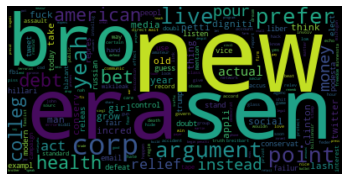

Topic: 0 Word: 0.006*"trump" + 0.005*"like" + 0.005*"peopl" + 0.005*"obama" + 0.004*"win" + 0.004*"republican" + 0.004*"clinton" + 0.004*"support" + 0.004*"vote" + 0.004*"democrat"
Topic: 1 Word: 0.006*"trump" + 0.006*"peopl" + 0.006*"vote" + 0.005*"think" + 0.004*"hillari" + 0.004*"clinton" + 0.004*"say" + 0.004*"right" + 0.004*"want" + 0.004*"like"
doc :  0 [(0, 0.10494145), (1, 0.8950586)]
doc :  1 [(0, 0.57189494), (1, 0.42810512)]
doc :  2 [(0, 0.93783844), (1, 0.062161546)]
doc :  3 [(0, 0.96021795), (1, 0.039782066)]
doc :  4 [(0, 0.3675735), (1, 0.63242656)]
doc :  5 [(0, 0.5575067), (1, 0.4424933)]
doc :  6 [(0, 0.24029732), (1, 0.7597027)]
doc :  7 [(0, 0.79439), (1, 0.20561002)]
doc :  8 [(0, 0.33664194), (1, 0.66335803)]
doc :  9 [(0, 0.13134673), (1, 0.86865324)]
doc :  10 [(0, 0.89855385), (1, 0.10144613)]
doc :  11 [(0, 0.83574253), (1, 0.16425742)]
doc :  12 [(0, 0.09154242), (1, 0.9084576)]
doc :  13 [(0, 0.14066137), (1, 0.85933864)]
doc :  14 [(0, 0.88848597), (1, 0.

doc :  428 [(0, 0.2342514), (1, 0.7657486)]
doc :  429 [(0, 0.82038087), (1, 0.17961912)]
doc :  430 [(0, 0.3675911), (1, 0.63240886)]
doc :  431 [(0, 0.07634035), (1, 0.9236596)]
doc :  432 [(0, 0.11852067), (1, 0.8814793)]
doc :  433 [(0, 0.27091888), (1, 0.7290811)]
doc :  434 [(0, 0.62497073), (1, 0.37502924)]
doc :  435 [(0, 0.4129337), (1, 0.5870663)]
doc :  436 [(0, 0.72485375), (1, 0.2751462)]
doc :  437 [(0, 0.5503214), (1, 0.44967863)]
doc :  438 [(0, 0.90661263), (1, 0.09338741)]
doc :  439 [(0, 0.6812847), (1, 0.3187153)]
doc :  440 [(0, 0.15103751), (1, 0.8489625)]
doc :  441 [(0, 0.26445258), (1, 0.7355474)]
doc :  442 [(0, 0.9628048), (1, 0.037195228)]
doc :  443 [(0, 0.8917924), (1, 0.1082076)]
doc :  444 [(0, 0.5153591), (1, 0.48464093)]
doc :  445 [(0, 0.7193039), (1, 0.28069612)]
doc :  446 [(0, 0.23980133), (1, 0.7601987)]
doc :  447 [(0, 0.83559346), (1, 0.16440657)]
doc :  448 [(0, 0.24540222), (1, 0.7545977)]
doc :  449 [(0, 0.82415557), (1, 0.17584448)]
doc :  4

doc :  716 [(0, 0.54707885), (1, 0.45292115)]
doc :  717 [(0, 0.8671943), (1, 0.13280572)]
doc :  718 [(0, 0.70064574), (1, 0.29935429)]
doc :  719 [(0, 0.13816957), (1, 0.8618304)]
doc :  720 [(0, 0.29996067), (1, 0.7000393)]
doc :  721 [(0, 0.065010026), (1, 0.93499)]
doc :  722 [(0, 0.17188774), (1, 0.82811224)]
doc :  723 [(0, 0.8975601), (1, 0.10243983)]
doc :  724 [(0, 0.72875106), (1, 0.27124894)]
doc :  725 [(0, 0.24615929), (1, 0.7538407)]
doc :  726 [(0, 0.69047797), (1, 0.30952203)]
doc :  727 [(0, 0.8645756), (1, 0.13542439)]
doc :  728 [(0, 0.70966625), (1, 0.29033378)]
doc :  729 [(0, 0.06909953), (1, 0.93090045)]
doc :  730 [(0, 0.14649971), (1, 0.8535003)]
doc :  731 [(0, 0.096332744), (1, 0.9036673)]
doc :  732 [(0, 0.08064838), (1, 0.9193516)]
doc :  733 [(0, 0.8471245), (1, 0.15287553)]
doc :  734 [(0, 0.07807966), (1, 0.92192036)]
doc :  735 [(0, 0.6387379), (1, 0.3612621)]
doc :  736 [(0, 0.7567373), (1, 0.24326266)]
doc :  737 [(0, 0.10547137), (1, 0.89452857)]
do

doc :  1064 [(0, 0.94921947), (1, 0.050780516)]
doc :  1065 [(0, 0.8838328), (1, 0.11616719)]
doc :  1066 [(0, 0.7521042), (1, 0.24789575)]
doc :  1067 [(0, 0.13985175), (1, 0.86014825)]
doc :  1068 [(0, 0.7592156), (1, 0.24078439)]
doc :  1069 [(0, 0.54951906), (1, 0.45048097)]
doc :  1070 [(0, 0.55194163), (1, 0.44805837)]
doc :  1071 [(0, 0.12694693), (1, 0.8730531)]
doc :  1072 [(0, 0.04678411), (1, 0.9532159)]
doc :  1073 [(0, 0.8046902), (1, 0.19530977)]
doc :  1074 [(0, 0.075422734), (1, 0.9245773)]
doc :  1075 [(0, 0.15049617), (1, 0.8495038)]
doc :  1076 [(0, 0.084262796), (1, 0.9157372)]
doc :  1077 [(0, 0.28556862), (1, 0.7144314)]
doc :  1078 [(0, 0.13059093), (1, 0.8694091)]
doc :  1079 [(0, 0.85199296), (1, 0.14800702)]
doc :  1080 [(0, 0.8355524), (1, 0.16444762)]
doc :  1081 [(0, 0.07319938), (1, 0.92680067)]
doc :  1082 [(0, 0.8475776), (1, 0.15242243)]
doc :  1083 [(0, 0.26768222), (1, 0.7323178)]
doc :  1084 [(0, 0.8792512), (1, 0.1207488)]
doc :  1085 [(0, 0.0806272

doc :  1475 [(0, 0.101459), (1, 0.89854103)]
doc :  1476 [(0, 0.29738665), (1, 0.70261335)]
doc :  1477 [(0, 0.1208178), (1, 0.87918216)]
doc :  1478 [(0, 0.06339583), (1, 0.93660414)]
doc :  1479 [(0, 0.8494149), (1, 0.1505851)]
doc :  1480 [(0, 0.21626835), (1, 0.78373164)]
doc :  1481 [(0, 0.8897861), (1, 0.11021391)]
doc :  1482 [(0, 0.13798814), (1, 0.86201185)]
doc :  1483 [(0, 0.05193785), (1, 0.9480621)]
doc :  1484 [(0, 0.44867614), (1, 0.5513239)]
doc :  1485 [(0, 0.7843312), (1, 0.21566883)]
doc :  1486 [(0, 0.15338215), (1, 0.8466178)]
doc :  1487 [(0, 0.16796915), (1, 0.8320309)]
doc :  1488 [(0, 0.92753273), (1, 0.072467245)]
doc :  1489 [(0, 0.7817721), (1, 0.21822792)]
doc :  1490 [(0, 0.16905604), (1, 0.830944)]
doc :  1491 [(0, 0.1171403), (1, 0.8828597)]
doc :  1492 [(0, 0.757069), (1, 0.24293101)]
doc :  1493 [(0, 0.04039044), (1, 0.95960957)]
doc :  1494 [(0, 0.8334689), (1, 0.16653104)]
doc :  1495 [(0, 0.42692584), (1, 0.57307416)]
doc :  1496 [(0, 0.79464763), (

doc :  1817 [(0, 0.8567331), (1, 0.14326692)]
doc :  1818 [(0, 0.111829996), (1, 0.88817)]
doc :  1819 [(0, 0.5542157), (1, 0.4457843)]
doc :  1820 [(0, 0.96750766), (1, 0.032492325)]
doc :  1821 [(0, 0.7873606), (1, 0.21263939)]
doc :  1822 [(0, 0.9135488), (1, 0.08645115)]
doc :  1823 [(0, 0.2501708), (1, 0.7498292)]
doc :  1824 [(0, 0.68612564), (1, 0.31387436)]
doc :  1825 [(0, 0.43066245), (1, 0.56933755)]
doc :  1826 [(0, 0.9241154), (1, 0.07588457)]
doc :  1827 [(0, 0.13335063), (1, 0.8666494)]
doc :  1828 [(0, 0.8122046), (1, 0.18779543)]
doc :  1829 [(0, 0.12166374), (1, 0.87833625)]
doc :  1830 [(0, 0.26230168), (1, 0.73769826)]
doc :  1831 [(0, 0.1474212), (1, 0.85257876)]
doc :  1832 [(0, 0.9378903), (1, 0.06210974)]
doc :  1833 [(0, 0.5), (1, 0.5)]
doc :  1834 [(0, 0.8097109), (1, 0.19028908)]
doc :  1835 [(0, 0.21266375), (1, 0.78733623)]
doc :  1836 [(0, 0.11525106), (1, 0.88474894)]
doc :  1837 [(0, 0.044656824), (1, 0.9553431)]
doc :  1838 [(0, 0.6768571), (1, 0.323142

doc :  2185 [(0, 0.8462765), (1, 0.15372352)]
doc :  2186 [(0, 0.16583782), (1, 0.83416224)]
doc :  2187 [(0, 0.6429237), (1, 0.3570763)]
doc :  2188 [(0, 0.6849576), (1, 0.3150424)]
doc :  2189 [(0, 0.8128235), (1, 0.18717653)]
doc :  2190 [(0, 0.5649744), (1, 0.43502557)]
doc :  2191 [(0, 0.6460778), (1, 0.35392222)]
doc :  2192 [(0, 0.53224427), (1, 0.46775568)]
doc :  2193 [(0, 0.36375397), (1, 0.6362461)]
doc :  2194 [(0, 0.27120903), (1, 0.728791)]
doc :  2195 [(0, 0.9362356), (1, 0.06376445)]
doc :  2196 [(0, 0.2219038), (1, 0.7780962)]
doc :  2197 [(0, 0.38753426), (1, 0.61246574)]
doc :  2198 [(0, 0.25237474), (1, 0.7476253)]
doc :  2199 [(0, 0.6764494), (1, 0.32355055)]
doc :  2200 [(0, 0.038254187), (1, 0.9617458)]
doc :  2201 [(0, 0.038851656), (1, 0.9611483)]
doc :  2202 [(0, 0.88401353), (1, 0.11598645)]
doc :  2203 [(0, 0.2770249), (1, 0.7229751)]
doc :  2204 [(0, 0.2278705), (1, 0.77212954)]
doc :  2205 [(0, 0.8274912), (1, 0.17250875)]
doc :  2206 [(0, 0.33810666), (1,

doc :  2613 [(0, 0.9306652), (1, 0.06933482)]
doc :  2614 [(0, 0.18044133), (1, 0.8195587)]
doc :  2615 [(0, 0.021593101), (1, 0.9784069)]
doc :  2616 [(0, 0.9295934), (1, 0.0704066)]
doc :  2617 [(0, 0.54368407), (1, 0.45631596)]
doc :  2618 [(0, 0.46431696), (1, 0.5356831)]
doc :  2619 [(0, 0.16670257), (1, 0.83329743)]
doc :  2620 [(0, 0.12883775), (1, 0.87116224)]
doc :  2621 [(0, 0.66451293), (1, 0.335487)]
doc :  2622 [(0, 0.14189553), (1, 0.85810447)]
doc :  2623 [(0, 0.12496004), (1, 0.87504)]
doc :  2624 [(0, 0.7636136), (1, 0.23638645)]
doc :  2625 [(0, 0.5160368), (1, 0.48396322)]
doc :  2626 [(0, 0.8782163), (1, 0.121783696)]
doc :  2627 [(0, 0.07145298), (1, 0.928547)]
doc :  2628 [(0, 0.5225362), (1, 0.47746378)]
doc :  2629 [(0, 0.5395707), (1, 0.4604293)]
doc :  2630 [(0, 0.12937891), (1, 0.8706211)]
doc :  2631 [(0, 0.92166805), (1, 0.0783319)]
doc :  2632 [(0, 0.2890942), (1, 0.7109058)]
doc :  2633 [(0, 0.87855136), (1, 0.12144865)]
doc :  2634 [(0, 0.07652077), (1, 

doc :  2927 [(0, 0.09936245), (1, 0.9006375)]
doc :  2928 [(0, 0.0874317), (1, 0.91256833)]
doc :  2929 [(0, 0.61741453), (1, 0.3825854)]
doc :  2930 [(0, 0.41638082), (1, 0.5836192)]
doc :  2931 [(0, 0.67534), (1, 0.32465994)]
doc :  2932 [(0, 0.87409055), (1, 0.12590945)]
doc :  2933 [(0, 0.82282853), (1, 0.17717147)]
doc :  2934 [(0, 0.4927411), (1, 0.50725883)]
doc :  2935 [(0, 0.7737413), (1, 0.22625872)]
doc :  2936 [(0, 0.8438482), (1, 0.1561518)]
doc :  2937 [(0, 0.14956807), (1, 0.850432)]
doc :  2938 [(0, 0.07301386), (1, 0.92698616)]
doc :  2939 [(0, 0.7762746), (1, 0.22372541)]
doc :  2940 [(0, 0.8751845), (1, 0.1248155)]
doc :  2941 [(0, 0.2837059), (1, 0.7162941)]
doc :  2942 [(0, 0.076425366), (1, 0.9235746)]
doc :  2943 [(0, 0.7076503), (1, 0.29234973)]
doc :  2944 [(0, 0.043860424), (1, 0.9561396)]
doc :  2945 [(0, 0.8238086), (1, 0.17619143)]
doc :  2946 [(0, 0.26934364), (1, 0.7306563)]
doc :  2947 [(0, 0.8375164), (1, 0.16248362)]
doc :  2948 [(0, 0.9076021), (1, 0.

doc :  3289 [(0, 0.36956364), (1, 0.63043636)]
doc :  3290 [(0, 0.89587104), (1, 0.10412898)]
doc :  3291 [(0, 0.21423101), (1, 0.785769)]
doc :  3292 [(0, 0.59707075), (1, 0.40292925)]
doc :  3293 [(0, 0.12853855), (1, 0.87146145)]
doc :  3294 [(0, 0.12372539), (1, 0.87627465)]
doc :  3295 [(0, 0.82706904), (1, 0.17293097)]
doc :  3296 [(0, 0.71827054), (1, 0.28172946)]
doc :  3297 [(0, 0.9309448), (1, 0.0690552)]
doc :  3298 [(0, 0.07536764), (1, 0.9246323)]
doc :  3299 [(0, 0.093465194), (1, 0.9065348)]
doc :  3300 [(0, 0.44719666), (1, 0.55280334)]
doc :  3301 [(0, 0.5338163), (1, 0.4661837)]
doc :  3302 [(0, 0.84926665), (1, 0.1507333)]
doc :  3303 [(0, 0.12976977), (1, 0.87023026)]
doc :  3304 [(0, 0.9554745), (1, 0.044525493)]
doc :  3305 [(0, 0.31301734), (1, 0.6869827)]
doc :  3306 [(0, 0.5257441), (1, 0.4742559)]
doc :  3307 [(0, 0.07417495), (1, 0.92582506)]
doc :  3308 [(0, 0.10902131), (1, 0.8909787)]
doc :  3309 [(0, 0.59355086), (1, 0.40644917)]
doc :  3310 [(0, 0.739440

doc :  3610 [(0, 0.23408215), (1, 0.7659179)]
doc :  3611 [(0, 0.3696227), (1, 0.63037735)]
doc :  3612 [(0, 0.21385741), (1, 0.78614265)]
doc :  3613 [(0, 0.38257986), (1, 0.61742014)]
doc :  3614 [(0, 0.90530866), (1, 0.09469132)]
doc :  3615 [(0, 0.49596828), (1, 0.5040317)]
doc :  3616 [(0, 0.05438873), (1, 0.9456113)]
doc :  3617 [(0, 0.8935181), (1, 0.106481925)]
doc :  3618 [(0, 0.86015856), (1, 0.13984145)]
doc :  3619 [(0, 0.27846083), (1, 0.7215392)]
doc :  3620 [(0, 0.11970687), (1, 0.88029313)]
doc :  3621 [(0, 0.07773815), (1, 0.92226183)]
doc :  3622 [(0, 0.7386227), (1, 0.26137727)]
doc :  3623 [(0, 0.04920993), (1, 0.95079005)]
doc :  3624 [(0, 0.06498511), (1, 0.9350149)]
doc :  3625 [(0, 0.06588677), (1, 0.9341132)]
doc :  3626 [(0, 0.8368995), (1, 0.16310053)]
doc :  3627 [(0, 0.4089549), (1, 0.59104514)]
doc :  3628 [(0, 0.05027254), (1, 0.9497274)]
doc :  3629 [(0, 0.6392015), (1, 0.36079842)]
doc :  3630 [(0, 0.91598046), (1, 0.08401958)]
doc :  3631 [(0, 0.383775

doc :  4019 [(0, 0.7631493), (1, 0.23685071)]
doc :  4020 [(0, 0.21496636), (1, 0.7850336)]
doc :  4021 [(0, 0.94218284), (1, 0.05781716)]
doc :  4022 [(0, 0.2192373), (1, 0.7807627)]
doc :  4023 [(0, 0.38350195), (1, 0.61649805)]
doc :  4024 [(0, 0.10844092), (1, 0.89155906)]
doc :  4025 [(0, 0.6212977), (1, 0.3787023)]
doc :  4026 [(0, 0.08093301), (1, 0.91906697)]
doc :  4027 [(0, 0.1133501), (1, 0.8866499)]
doc :  4028 [(0, 0.83098507), (1, 0.16901487)]
doc :  4029 [(0, 0.27695277), (1, 0.7230472)]
doc :  4030 [(0, 0.86012226), (1, 0.13987774)]
doc :  4031 [(0, 0.8948398), (1, 0.10516013)]
doc :  4032 [(0, 0.7705977), (1, 0.22940233)]
doc :  4033 [(0, 0.5854818), (1, 0.41451818)]
doc :  4034 [(0, 0.42061937), (1, 0.57938063)]
doc :  4035 [(0, 0.69206345), (1, 0.30793652)]
doc :  4036 [(0, 0.8313411), (1, 0.16865888)]
doc :  4037 [(0, 0.15603806), (1, 0.84396195)]
doc :  4038 [(0, 0.579221), (1, 0.42077902)]
doc :  4039 [(0, 0.49457726), (1, 0.5054228)]
doc :  4040 [(0, 0.4124003), 

doc :  4426 [(0, 0.8293836), (1, 0.17061639)]
doc :  4427 [(0, 0.06112137), (1, 0.9388786)]
doc :  4428 [(0, 0.35311434), (1, 0.6468857)]
doc :  4429 [(0, 0.13672233), (1, 0.8632776)]
doc :  4430 [(0, 0.22817954), (1, 0.7718204)]
doc :  4431 [(0, 0.88822544), (1, 0.11177458)]
doc :  4432 [(0, 0.5475107), (1, 0.45248938)]
doc :  4433 [(0, 0.16057566), (1, 0.8394244)]
doc :  4434 [(0, 0.457162), (1, 0.54283804)]
doc :  4435 [(0, 0.5), (1, 0.5)]
doc :  4436 [(0, 0.6966162), (1, 0.30338374)]
doc :  4437 [(0, 0.8467988), (1, 0.15320125)]
doc :  4438 [(0, 0.93050426), (1, 0.069495775)]
doc :  4439 [(0, 0.52717006), (1, 0.47283)]
doc :  4440 [(0, 0.58124834), (1, 0.41875163)]
doc :  4441 [(0, 0.13602148), (1, 0.8639785)]
doc :  4442 [(0, 0.87395066), (1, 0.12604935)]
doc :  4443 [(0, 0.9058806), (1, 0.0941194)]
doc :  4444 [(0, 0.8702206), (1, 0.12977937)]
doc :  4445 [(0, 0.08200542), (1, 0.91799456)]
doc :  4446 [(0, 0.11086096), (1, 0.88913906)]
doc :  4447 [(0, 0.08406439), (1, 0.9159356)

doc :  4806 [(0, 0.7624366), (1, 0.23756342)]
doc :  4807 [(0, 0.2510892), (1, 0.74891084)]
doc :  4808 [(0, 0.21726029), (1, 0.7827397)]
doc :  4809 [(0, 0.7741955), (1, 0.22580446)]
doc :  4810 [(0, 0.76706046), (1, 0.23293953)]
doc :  4811 [(0, 0.0655012), (1, 0.9344988)]
doc :  4812 [(0, 0.15510845), (1, 0.84489155)]
doc :  4813 [(0, 0.47275725), (1, 0.5272427)]
doc :  4814 [(0, 0.48944655), (1, 0.5105534)]
doc :  4815 [(0, 0.28463778), (1, 0.71536225)]
doc :  4816 [(0, 0.3688764), (1, 0.6311236)]
doc :  4817 [(0, 0.4109831), (1, 0.58901685)]
doc :  4818 [(0, 0.35021257), (1, 0.6497874)]
doc :  4819 [(0, 0.92177707), (1, 0.07822291)]
doc :  4820 [(0, 0.80334616), (1, 0.19665384)]
doc :  4821 [(0, 0.1534875), (1, 0.8465125)]
doc :  4822 [(0, 0.3650352), (1, 0.63496476)]
doc :  4823 [(0, 0.83964133), (1, 0.16035862)]
doc :  4824 [(0, 0.26136187), (1, 0.7386381)]
doc :  4825 [(0, 0.19622256), (1, 0.80377746)]
doc :  4826 [(0, 0.6964407), (1, 0.30355927)]
doc :  4827 [(0, 0.7871372), (

doc :  5202 [(0, 0.18641444), (1, 0.8135855)]
doc :  5203 [(0, 0.5260263), (1, 0.47397366)]
doc :  5204 [(0, 0.08275019), (1, 0.91724986)]
doc :  5205 [(0, 0.19271109), (1, 0.80728894)]
doc :  5206 [(0, 0.6399182), (1, 0.36008176)]
doc :  5207 [(0, 0.13716964), (1, 0.86283034)]
doc :  5208 [(0, 0.8716899), (1, 0.12831004)]
doc :  5209 [(0, 0.056883924), (1, 0.94311607)]
doc :  5210 [(0, 0.1434137), (1, 0.8565863)]
doc :  5211 [(0, 0.9057047), (1, 0.094295315)]
doc :  5212 [(0, 0.33420593), (1, 0.6657941)]
doc :  5213 [(0, 0.7611402), (1, 0.2388598)]
doc :  5214 [(0, 0.86866623), (1, 0.13133377)]
doc :  5215 [(0, 0.4468498), (1, 0.55315024)]
doc :  5216 [(0, 0.2784652), (1, 0.7215348)]
doc :  5217 [(0, 0.90249324), (1, 0.09750677)]
doc :  5218 [(0, 0.18327956), (1, 0.8167205)]
doc :  5219 [(0, 0.81760126), (1, 0.18239875)]
doc :  5220 [(0, 0.8489805), (1, 0.1510195)]
doc :  5221 [(0, 0.8378617), (1, 0.16213828)]
doc :  5222 [(0, 0.7990076), (1, 0.20099244)]
doc :  5223 [(0, 0.15542868),

doc :  5595 [(0, 0.7465225), (1, 0.2534775)]
doc :  5596 [(0, 0.936486), (1, 0.063513994)]
doc :  5597 [(0, 0.48761088), (1, 0.51238906)]
doc :  5598 [(0, 0.49050793), (1, 0.50949204)]
doc :  5599 [(0, 0.6339565), (1, 0.36604354)]
doc :  5600 [(0, 0.033389598), (1, 0.96661043)]
doc :  5601 [(0, 0.6988439), (1, 0.3011561)]
doc :  5602 [(0, 0.51682925), (1, 0.48317075)]
doc :  5603 [(0, 0.8348857), (1, 0.16511428)]
doc :  5604 [(0, 0.18215793), (1, 0.81784207)]
doc :  5605 [(0, 0.5891809), (1, 0.41081914)]
doc :  5606 [(0, 0.79129815), (1, 0.20870182)]
doc :  5607 [(0, 0.18113601), (1, 0.81886405)]
doc :  5608 [(0, 0.04848987), (1, 0.95151013)]
doc :  5609 [(0, 0.3674732), (1, 0.6325268)]
doc :  5610 [(0, 0.8445647), (1, 0.15543528)]
doc :  5611 [(0, 0.7995255), (1, 0.2004745)]
doc :  5612 [(0, 0.81134176), (1, 0.18865827)]
doc :  5613 [(0, 0.8611797), (1, 0.13882037)]
doc :  5614 [(0, 0.16042557), (1, 0.83957446)]
doc :  5615 [(0, 0.6868211), (1, 0.31317896)]
doc :  5616 [(0, 0.33146653

doc :  5871 [(0, 0.106434226), (1, 0.8935658)]
doc :  5872 [(0, 0.906966), (1, 0.09303399)]
doc :  5873 [(0, 0.81989884), (1, 0.18010113)]
doc :  5874 [(0, 0.5253445), (1, 0.47465548)]
doc :  5875 [(0, 0.29687443), (1, 0.70312554)]
doc :  5876 [(0, 0.9203551), (1, 0.07964492)]
doc :  5877 [(0, 0.24460232), (1, 0.7553977)]
doc :  5878 [(0, 0.42413324), (1, 0.5758667)]
doc :  5879 [(0, 0.041336384), (1, 0.9586636)]
doc :  5880 [(0, 0.8052111), (1, 0.19478886)]
doc :  5881 [(0, 0.37283745), (1, 0.6271626)]
doc :  5882 [(0, 0.5821496), (1, 0.41785038)]
doc :  5883 [(0, 0.07990041), (1, 0.9200996)]
doc :  5884 [(0, 0.27744827), (1, 0.72255176)]
doc :  5885 [(0, 0.581232), (1, 0.41876796)]
doc :  5886 [(0, 0.17038189), (1, 0.8296181)]
doc :  5887 [(0, 0.6214484), (1, 0.37855157)]
doc :  5888 [(0, 0.15285489), (1, 0.8471451)]
doc :  5889 [(0, 0.03377924), (1, 0.9662208)]
doc :  5890 [(0, 0.92116827), (1, 0.07883177)]
doc :  5891 [(0, 0.7731151), (1, 0.2268849)]
doc :  5892 [(0, 0.47276297), (

doc :  6204 [(0, 0.8638606), (1, 0.13613942)]
doc :  6205 [(0, 0.883681), (1, 0.11631903)]
doc :  6206 [(0, 0.790754), (1, 0.20924596)]
doc :  6207 [(0, 0.9449583), (1, 0.055041686)]
doc :  6208 [(0, 0.113380045), (1, 0.8866199)]
doc :  6209 [(0, 0.791982), (1, 0.20801803)]
doc :  6210 [(0, 0.3435717), (1, 0.6564283)]
doc :  6211 [(0, 0.34471968), (1, 0.6552803)]
doc :  6212 [(0, 0.6011975), (1, 0.39880252)]
doc :  6213 [(0, 0.700937), (1, 0.29906303)]
doc :  6214 [(0, 0.2613443), (1, 0.7386557)]
doc :  6215 [(0, 0.9328263), (1, 0.067173764)]
doc :  6216 [(0, 0.4114364), (1, 0.58856356)]
doc :  6217 [(0, 0.51864016), (1, 0.4813598)]
doc :  6218 [(0, 0.67937183), (1, 0.32062817)]
doc :  6219 [(0, 0.92597973), (1, 0.07402023)]
doc :  6220 [(0, 0.81191796), (1, 0.18808201)]
doc :  6221 [(0, 0.15142174), (1, 0.8485783)]
doc :  6222 [(0, 0.2370298), (1, 0.7629702)]
doc :  6223 [(0, 0.048459284), (1, 0.95154065)]
doc :  6224 [(0, 0.054344207), (1, 0.9456558)]
doc :  6225 [(0, 0.84384185), (1

doc :  6587 [(0, 0.8470408), (1, 0.15295924)]
doc :  6588 [(0, 0.03715867), (1, 0.9628413)]
doc :  6589 [(0, 0.09027756), (1, 0.90972245)]
doc :  6590 [(0, 0.119525686), (1, 0.88047427)]
doc :  6591 [(0, 0.35469258), (1, 0.6453074)]
doc :  6592 [(0, 0.67703646), (1, 0.32296354)]
doc :  6593 [(0, 0.5), (1, 0.5)]
doc :  6594 [(0, 0.50909173), (1, 0.4909082)]
doc :  6595 [(0, 0.18976854), (1, 0.81023145)]
doc :  6596 [(0, 0.11011039), (1, 0.88988966)]
doc :  6597 [(0, 0.27424955), (1, 0.72575045)]
doc :  6598 [(0, 0.886528), (1, 0.11347196)]
doc :  6599 [(0, 0.21490146), (1, 0.78509855)]
doc :  6600 [(0, 0.12658373), (1, 0.8734163)]
doc :  6601 [(0, 0.1083001), (1, 0.8916999)]
doc :  6602 [(0, 0.9629877), (1, 0.037012275)]
doc :  6603 [(0, 0.19911815), (1, 0.80088186)]
doc :  6604 [(0, 0.09083531), (1, 0.90916467)]
doc :  6605 [(0, 0.9267561), (1, 0.07324394)]
doc :  6606 [(0, 0.7650366), (1, 0.23496345)]
doc :  6607 [(0, 0.51690453), (1, 0.48309544)]
doc :  6608 [(0, 0.6798271), (1, 0.32

doc :  6975 [(0, 0.68042624), (1, 0.31957376)]
doc :  6976 [(0, 0.97042334), (1, 0.029576652)]
doc :  6977 [(0, 0.9031165), (1, 0.09688351)]
doc :  6978 [(0, 0.2212437), (1, 0.7787563)]
doc :  6979 [(0, 0.0990193), (1, 0.9009807)]
doc :  6980 [(0, 0.13297081), (1, 0.8670292)]
doc :  6981 [(0, 0.5984974), (1, 0.40150258)]
doc :  6982 [(0, 0.111179054), (1, 0.8888209)]
doc :  6983 [(0, 0.819408), (1, 0.18059196)]
doc :  6984 [(0, 0.27677268), (1, 0.7232274)]
doc :  6985 [(0, 0.15655918), (1, 0.84344083)]
doc :  6986 [(0, 0.06317667), (1, 0.9368233)]
doc :  6987 [(0, 0.3123424), (1, 0.6876576)]
doc :  6988 [(0, 0.932665), (1, 0.06733505)]
doc :  6989 [(0, 0.89607614), (1, 0.103923865)]
doc :  6990 [(0, 0.088568345), (1, 0.9114316)]
doc :  6991 [(0, 0.17952533), (1, 0.8204747)]
doc :  6992 [(0, 0.7326041), (1, 0.26739585)]
doc :  6993 [(0, 0.5283143), (1, 0.47168565)]
doc :  6994 [(0, 0.21922244), (1, 0.7807775)]
doc :  6995 [(0, 0.6662512), (1, 0.33374882)]
doc :  6996 [(0, 0.76137507), (

doc :  7355 [(0, 0.8184951), (1, 0.18150486)]
doc :  7356 [(0, 0.20351003), (1, 0.79649)]
doc :  7357 [(0, 0.9059727), (1, 0.09402725)]
doc :  7358 [(0, 0.34421828), (1, 0.6557817)]
doc :  7359 [(0, 0.79179585), (1, 0.2082041)]
doc :  7360 [(0, 0.95118845), (1, 0.04881152)]
doc :  7361 [(0, 0.70794815), (1, 0.29205185)]
doc :  7362 [(0, 0.029719284), (1, 0.97028077)]
doc :  7363 [(0, 0.7149209), (1, 0.28507912)]
doc :  7364 [(0, 0.3198502), (1, 0.68014973)]
doc :  7365 [(0, 0.38177127), (1, 0.61822873)]
doc :  7366 [(0, 0.91751707), (1, 0.08248292)]
doc :  7367 [(0, 0.82514495), (1, 0.17485507)]
doc :  7368 [(0, 0.70153075), (1, 0.29846922)]
doc :  7369 [(0, 0.92077786), (1, 0.07922214)]
doc :  7370 [(0, 0.13746302), (1, 0.86253697)]
doc :  7371 [(0, 0.06873284), (1, 0.93126714)]
doc :  7372 [(0, 0.1806748), (1, 0.81932515)]
doc :  7373 [(0, 0.36083442), (1, 0.6391656)]
doc :  7374 [(0, 0.6114987), (1, 0.38850132)]
doc :  7375 [(0, 0.032923456), (1, 0.9670766)]
doc :  7376 [(0, 0.28513

doc :  7723 [(0, 0.72786206), (1, 0.27213794)]
doc :  7724 [(0, 0.9575215), (1, 0.042478528)]
doc :  7725 [(0, 0.5509548), (1, 0.44904515)]
doc :  7726 [(0, 0.17350234), (1, 0.8264976)]
doc :  7727 [(0, 0.14260143), (1, 0.85739857)]
doc :  7728 [(0, 0.8602609), (1, 0.13973908)]
doc :  7729 [(0, 0.13052826), (1, 0.8694718)]
doc :  7730 [(0, 0.90527886), (1, 0.09472113)]
doc :  7731 [(0, 0.21214032), (1, 0.7878597)]
doc :  7732 [(0, 0.90817404), (1, 0.09182601)]
doc :  7733 [(0, 0.114147), (1, 0.885853)]
doc :  7734 [(0, 0.16664225), (1, 0.83335775)]
doc :  7735 [(0, 0.059872102), (1, 0.9401279)]
doc :  7736 [(0, 0.1390509), (1, 0.8609491)]
doc :  7737 [(0, 0.123774864), (1, 0.8762252)]
doc :  7738 [(0, 0.07755683), (1, 0.92244315)]
doc :  7739 [(0, 0.12163458), (1, 0.8783654)]
doc :  7740 [(0, 0.21832599), (1, 0.781674)]
doc :  7741 [(0, 0.8200673), (1, 0.17993271)]
doc :  7742 [(0, 0.8202484), (1, 0.17975153)]
doc :  7743 [(0, 0.5549241), (1, 0.44507593)]
doc :  7744 [(0, 0.11278714), 

doc :  8100 [(0, 0.25030842), (1, 0.74969155)]
doc :  8101 [(0, 0.24532057), (1, 0.75467944)]
doc :  8102 [(0, 0.7150866), (1, 0.28491345)]
doc :  8103 [(0, 0.9305256), (1, 0.06947441)]
doc :  8104 [(0, 0.45343202), (1, 0.546568)]
doc :  8105 [(0, 0.6861449), (1, 0.3138551)]
doc :  8106 [(0, 0.29920897), (1, 0.70079106)]
doc :  8107 [(0, 0.91272074), (1, 0.08727924)]
doc :  8108 [(0, 0.102308065), (1, 0.8976919)]
doc :  8109 [(0, 0.06924681), (1, 0.9307532)]
doc :  8110 [(0, 0.797377), (1, 0.20262302)]
doc :  8111 [(0, 0.042375986), (1, 0.957624)]
doc :  8112 [(0, 0.6419192), (1, 0.35808077)]
doc :  8113 [(0, 0.8505726), (1, 0.14942744)]
doc :  8114 [(0, 0.14503093), (1, 0.854969)]
doc :  8115 [(0, 0.14425722), (1, 0.85574275)]
doc :  8116 [(0, 0.09951987), (1, 0.9004801)]
doc :  8117 [(0, 0.3128427), (1, 0.6871573)]
doc :  8118 [(0, 0.8602352), (1, 0.13976479)]
doc :  8119 [(0, 0.9082731), (1, 0.0917269)]
doc :  8120 [(0, 0.13356745), (1, 0.86643255)]
doc :  8121 [(0, 0.19860615), (1,

doc :  8459 [(0, 0.2935894), (1, 0.70641065)]
doc :  8460 [(0, 0.878302), (1, 0.121698014)]
doc :  8461 [(0, 0.29240325), (1, 0.7075967)]
doc :  8462 [(0, 0.9606034), (1, 0.03939663)]
doc :  8463 [(0, 0.32385916), (1, 0.67614084)]
doc :  8464 [(0, 0.18357153), (1, 0.8164285)]
doc :  8465 [(0, 0.11613729), (1, 0.8838627)]
doc :  8466 [(0, 0.18605357), (1, 0.8139464)]
doc :  8467 [(0, 0.100584276), (1, 0.89941573)]
doc :  8468 [(0, 0.24391201), (1, 0.756088)]
doc :  8469 [(0, 0.15748337), (1, 0.8425166)]
doc :  8470 [(0, 0.81770253), (1, 0.18229745)]
doc :  8471 [(0, 0.820775), (1, 0.17922503)]
doc :  8472 [(0, 0.15811022), (1, 0.84188986)]
doc :  8473 [(0, 0.8207589), (1, 0.17924112)]
doc :  8474 [(0, 0.5571824), (1, 0.44281757)]
doc :  8475 [(0, 0.7241971), (1, 0.27580294)]
doc :  8476 [(0, 0.16851614), (1, 0.8314839)]
doc :  8477 [(0, 0.09380462), (1, 0.9061954)]
doc :  8478 [(0, 0.8956775), (1, 0.10432254)]
doc :  8479 [(0, 0.8581448), (1, 0.14185524)]
doc :  8480 [(0, 0.58969975), (

doc :  8882 [(0, 0.9535328), (1, 0.046467192)]
doc :  8883 [(0, 0.2664798), (1, 0.7335202)]
doc :  8884 [(0, 0.84052825), (1, 0.15947177)]
doc :  8885 [(0, 0.029453762), (1, 0.97054625)]
doc :  8886 [(0, 0.41779828), (1, 0.5822018)]
doc :  8887 [(0, 0.0866182), (1, 0.91338176)]
doc :  8888 [(0, 0.31864575), (1, 0.6813543)]
doc :  8889 [(0, 0.79410213), (1, 0.20589787)]
doc :  8890 [(0, 0.051879175), (1, 0.9481208)]
doc :  8891 [(0, 0.07607746), (1, 0.92392254)]
doc :  8892 [(0, 0.81320405), (1, 0.18679594)]
doc :  8893 [(0, 0.06912847), (1, 0.93087155)]
doc :  8894 [(0, 0.46749154), (1, 0.5325085)]
doc :  8895 [(0, 0.58706427), (1, 0.41293573)]
doc :  8896 [(0, 0.5), (1, 0.5)]
doc :  8897 [(0, 0.5618342), (1, 0.43816578)]
doc :  8898 [(0, 0.7930025), (1, 0.20699753)]
doc :  8899 [(0, 0.119453445), (1, 0.88054657)]
doc :  8900 [(0, 0.21991521), (1, 0.7800848)]
doc :  8901 [(0, 0.6088819), (1, 0.3911181)]
doc :  8902 [(0, 0.10330543), (1, 0.89669454)]
doc :  8903 [(0, 0.76915175), (1, 0.

doc :  9284 [(0, 0.92844975), (1, 0.07155029)]
doc :  9285 [(0, 0.28556648), (1, 0.71443355)]
doc :  9286 [(0, 0.89726204), (1, 0.10273794)]
doc :  9287 [(0, 0.86312294), (1, 0.13687709)]
doc :  9288 [(0, 0.41577864), (1, 0.5842213)]
doc :  9289 [(0, 0.1539904), (1, 0.84600955)]
doc :  9290 [(0, 0.070058204), (1, 0.9299418)]
doc :  9291 [(0, 0.910391), (1, 0.08960906)]
doc :  9292 [(0, 0.34973), (1, 0.65027004)]
doc :  9293 [(0, 0.255279), (1, 0.744721)]
doc :  9294 [(0, 0.73200834), (1, 0.26799163)]
doc :  9295 [(0, 0.5075141), (1, 0.49248588)]
doc :  9296 [(0, 0.124936834), (1, 0.8750632)]
doc :  9297 [(0, 0.7701531), (1, 0.22984685)]
doc :  9298 [(0, 0.12699771), (1, 0.8730023)]
doc :  9299 [(0, 0.82971174), (1, 0.17028828)]
doc :  9300 [(0, 0.48607802), (1, 0.513922)]
doc :  9301 [(0, 0.12731493), (1, 0.8726851)]
doc :  9302 [(0, 0.1252555), (1, 0.8747445)]
doc :  9303 [(0, 0.4774062), (1, 0.5225938)]
doc :  9304 [(0, 0.58294153), (1, 0.41705847)]
doc :  9305 [(0, 0.08323646), (1, 

doc :  9565 [(0, 0.17963073), (1, 0.8203693)]
doc :  9566 [(0, 0.87774193), (1, 0.12225809)]
doc :  9567 [(0, 0.8386667), (1, 0.16133332)]
doc :  9568 [(0, 0.85544384), (1, 0.14455612)]
doc :  9569 [(0, 0.7476416), (1, 0.25235844)]
doc :  9570 [(0, 0.27080226), (1, 0.72919774)]
doc :  9571 [(0, 0.7609671), (1, 0.2390329)]
doc :  9572 [(0, 0.12860517), (1, 0.8713948)]
doc :  9573 [(0, 0.13037226), (1, 0.8696277)]
doc :  9574 [(0, 0.06385319), (1, 0.9361468)]
doc :  9575 [(0, 0.17974386), (1, 0.8202562)]
doc :  9576 [(0, 0.8549445), (1, 0.14505544)]
doc :  9577 [(0, 0.8955762), (1, 0.10442386)]
doc :  9578 [(0, 0.4386138), (1, 0.56138617)]
doc :  9579 [(0, 0.42747727), (1, 0.5725227)]
doc :  9580 [(0, 0.72382206), (1, 0.27617794)]
doc :  9581 [(0, 0.6663301), (1, 0.33366993)]
doc :  9582 [(0, 0.9072685), (1, 0.09273151)]
doc :  9583 [(0, 0.47199765), (1, 0.5280023)]
doc :  9584 [(0, 0.19647615), (1, 0.80352384)]
doc :  9585 [(0, 0.081370115), (1, 0.9186299)]
doc :  9586 [(0, 0.8633687), 

doc :  9912 [(0, 0.071890116), (1, 0.9281099)]
doc :  9913 [(0, 0.41050953), (1, 0.5894904)]
doc :  9914 [(0, 0.45507845), (1, 0.5449216)]
doc :  9915 [(0, 0.24958771), (1, 0.7504122)]
doc :  9916 [(0, 0.10907179), (1, 0.89092827)]
doc :  9917 [(0, 0.15614368), (1, 0.84385633)]
doc :  9918 [(0, 0.19265333), (1, 0.8073467)]
doc :  9919 [(0, 0.3458702), (1, 0.6541298)]
doc :  9920 [(0, 0.09978336), (1, 0.9002167)]
doc :  9921 [(0, 0.77225554), (1, 0.22774448)]
doc :  9922 [(0, 0.11662495), (1, 0.88337505)]
doc :  9923 [(0, 0.9366128), (1, 0.06338717)]
doc :  9924 [(0, 0.90194213), (1, 0.09805788)]
doc :  9925 [(0, 0.8832536), (1, 0.11674644)]
doc :  9926 [(0, 0.038844395), (1, 0.9611556)]
doc :  9927 [(0, 0.063264534), (1, 0.93673545)]
doc :  9928 [(0, 0.9376836), (1, 0.0623164)]
doc :  9929 [(0, 0.28154984), (1, 0.7184502)]
doc :  9930 [(0, 0.12871905), (1, 0.87128097)]
doc :  9931 [(0, 0.5686242), (1, 0.43137574)]
doc :  9932 [(0, 0.6100016), (1, 0.3899984)]
doc :  9933 [(0, 0.15047333

doc :  10302 [(0, 0.13059162), (1, 0.86940837)]
doc :  10303 [(0, 0.48278406), (1, 0.51721597)]
doc :  10304 [(0, 0.07577343), (1, 0.9242266)]
doc :  10305 [(0, 0.4203683), (1, 0.5796317)]
doc :  10306 [(0, 0.41368324), (1, 0.5863168)]
doc :  10307 [(0, 0.14896941), (1, 0.8510306)]
doc :  10308 [(0, 0.6192018), (1, 0.38079822)]
doc :  10309 [(0, 0.09585222), (1, 0.9041478)]
doc :  10310 [(0, 0.12090646), (1, 0.8790936)]
doc :  10311 [(0, 0.5413911), (1, 0.45860898)]
doc :  10312 [(0, 0.79917735), (1, 0.20082264)]
doc :  10313 [(0, 0.1161655), (1, 0.8838345)]
doc :  10314 [(0, 0.60849184), (1, 0.39150816)]
doc :  10315 [(0, 0.11027133), (1, 0.88972867)]
doc :  10316 [(0, 0.22239113), (1, 0.7776089)]
doc :  10317 [(0, 0.3478852), (1, 0.6521148)]
doc :  10318 [(0, 0.080818154), (1, 0.9191819)]
doc :  10319 [(0, 0.82450575), (1, 0.17549427)]
doc :  10320 [(0, 0.33327013), (1, 0.6667299)]
doc :  10321 [(0, 0.8997776), (1, 0.100222446)]
doc :  10322 [(0, 0.3152906), (1, 0.68470937)]
doc :  1

doc :  10691 [(0, 0.5007082), (1, 0.4992918)]
doc :  10692 [(0, 0.30473137), (1, 0.6952687)]
doc :  10693 [(0, 0.1657398), (1, 0.8342602)]
doc :  10694 [(0, 0.2730119), (1, 0.7269881)]
doc :  10695 [(0, 0.4263491), (1, 0.5736509)]
doc :  10696 [(0, 0.6893898), (1, 0.31061023)]
doc :  10697 [(0, 0.8891485), (1, 0.110851586)]
doc :  10698 [(0, 0.47634384), (1, 0.52365613)]
doc :  10699 [(0, 0.22977428), (1, 0.7702257)]
doc :  10700 [(0, 0.23973216), (1, 0.7602679)]
doc :  10701 [(0, 0.5976193), (1, 0.40238065)]
doc :  10702 [(0, 0.59763837), (1, 0.40236166)]
doc :  10703 [(0, 0.85454935), (1, 0.14545065)]
doc :  10704 [(0, 0.17667891), (1, 0.8233211)]
doc :  10705 [(0, 0.7415239), (1, 0.25847605)]
doc :  10706 [(0, 0.26900443), (1, 0.7309956)]
doc :  10707 [(0, 0.54624575), (1, 0.45375422)]
doc :  10708 [(0, 0.3732033), (1, 0.6267967)]
doc :  10709 [(0, 0.8716815), (1, 0.12831847)]
doc :  10710 [(0, 0.15173021), (1, 0.8482698)]
doc :  10711 [(0, 0.28918606), (1, 0.71081394)]
doc :  10712

doc :  11112 [(0, 0.3027367), (1, 0.6972633)]
doc :  11113 [(0, 0.4532567), (1, 0.5467433)]
doc :  11114 [(0, 0.2317322), (1, 0.7682678)]
doc :  11115 [(0, 0.92172635), (1, 0.07827366)]
doc :  11116 [(0, 0.86987084), (1, 0.13012916)]
doc :  11117 [(0, 0.057231456), (1, 0.9427685)]
doc :  11118 [(0, 0.056090463), (1, 0.9439095)]
doc :  11119 [(0, 0.5597961), (1, 0.4402039)]
doc :  11120 [(0, 0.9250296), (1, 0.07497043)]
doc :  11121 [(0, 0.1613718), (1, 0.8386282)]
doc :  11122 [(0, 0.14049803), (1, 0.859502)]
doc :  11123 [(0, 0.6585051), (1, 0.3414949)]
doc :  11124 [(0, 0.13368136), (1, 0.8663187)]
doc :  11125 [(0, 0.9240259), (1, 0.07597405)]
doc :  11126 [(0, 0.7081046), (1, 0.29189536)]
doc :  11127 [(0, 0.74844337), (1, 0.2515567)]
doc :  11128 [(0, 0.08304751), (1, 0.91695255)]
doc :  11129 [(0, 0.884465), (1, 0.115535)]
doc :  11130 [(0, 0.27679744), (1, 0.7232026)]
doc :  11131 [(0, 0.78395975), (1, 0.21604018)]
doc :  11132 [(0, 0.8814186), (1, 0.118581414)]
doc :  11133 [(0

doc :  11449 [(0, 0.9033366), (1, 0.09666341)]
doc :  11450 [(0, 0.5521582), (1, 0.44784176)]
doc :  11451 [(0, 0.09901545), (1, 0.9009845)]
doc :  11452 [(0, 0.14310111), (1, 0.8568989)]
doc :  11453 [(0, 0.31174013), (1, 0.68825984)]
doc :  11454 [(0, 0.066978484), (1, 0.93302155)]
doc :  11455 [(0, 0.096532986), (1, 0.903467)]
doc :  11456 [(0, 0.0862752), (1, 0.9137248)]
doc :  11457 [(0, 0.16708256), (1, 0.83291745)]
doc :  11458 [(0, 0.5607826), (1, 0.4392174)]
doc :  11459 [(0, 0.8913867), (1, 0.108613335)]
doc :  11460 [(0, 0.456302), (1, 0.543698)]
doc :  11461 [(0, 0.80630904), (1, 0.19369103)]
doc :  11462 [(0, 0.8996814), (1, 0.10031857)]
doc :  11463 [(0, 0.44779828), (1, 0.5522017)]
doc :  11464 [(0, 0.30845183), (1, 0.69154817)]
doc :  11465 [(0, 0.4772183), (1, 0.52278167)]
doc :  11466 [(0, 0.27634704), (1, 0.72365296)]
doc :  11467 [(0, 0.6161517), (1, 0.38384834)]
doc :  11468 [(0, 0.7390504), (1, 0.26094958)]
doc :  11469 [(0, 0.118774995), (1, 0.881225)]
doc :  114

doc :  11814 [(0, 0.2183902), (1, 0.78160983)]
doc :  11815 [(0, 0.5600555), (1, 0.43994454)]
doc :  11816 [(0, 0.1456574), (1, 0.85434264)]
doc :  11817 [(0, 0.053461604), (1, 0.9465384)]
doc :  11818 [(0, 0.666229), (1, 0.33377105)]
doc :  11819 [(0, 0.18272363), (1, 0.81727636)]
doc :  11820 [(0, 0.34932518), (1, 0.6506748)]
doc :  11821 [(0, 0.6927727), (1, 0.3072273)]
doc :  11822 [(0, 0.43678156), (1, 0.5632185)]
doc :  11823 [(0, 0.08788799), (1, 0.912112)]
doc :  11824 [(0, 0.16274682), (1, 0.8372532)]
doc :  11825 [(0, 0.17794174), (1, 0.8220583)]
doc :  11826 [(0, 0.7891982), (1, 0.21080177)]
doc :  11827 [(0, 0.29917905), (1, 0.700821)]
doc :  11828 [(0, 0.15588391), (1, 0.8441161)]
doc :  11829 [(0, 0.17367426), (1, 0.8263257)]
doc :  11830 [(0, 0.24546771), (1, 0.7545323)]
doc :  11831 [(0, 0.6960647), (1, 0.30393526)]
doc :  11832 [(0, 0.5), (1, 0.5)]
doc :  11833 [(0, 0.37511608), (1, 0.62488395)]
doc :  11834 [(0, 0.5083634), (1, 0.4916366)]
doc :  11835 [(0, 0.19258885

doc :  12180 [(0, 0.18294403), (1, 0.817056)]
doc :  12181 [(0, 0.29770786), (1, 0.70229214)]
doc :  12182 [(0, 0.84232277), (1, 0.15767726)]
doc :  12183 [(0, 0.54808736), (1, 0.4519126)]
doc :  12184 [(0, 0.71592635), (1, 0.28407368)]
doc :  12185 [(0, 0.90325564), (1, 0.09674433)]
doc :  12186 [(0, 0.22024114), (1, 0.7797588)]
doc :  12187 [(0, 0.3166458), (1, 0.68335426)]
doc :  12188 [(0, 0.34969622), (1, 0.6503038)]
doc :  12189 [(0, 0.19895977), (1, 0.80104023)]
doc :  12190 [(0, 0.87113285), (1, 0.12886713)]
doc :  12191 [(0, 0.067759156), (1, 0.9322408)]
doc :  12192 [(0, 0.92436045), (1, 0.075639576)]
doc :  12193 [(0, 0.2568173), (1, 0.74318266)]
doc :  12194 [(0, 0.8285848), (1, 0.17141525)]
doc :  12195 [(0, 0.16942102), (1, 0.830579)]
doc :  12196 [(0, 0.14077055), (1, 0.85922945)]
doc :  12197 [(0, 0.89778554), (1, 0.10221453)]
doc :  12198 [(0, 0.2160949), (1, 0.7839051)]
doc :  12199 [(0, 0.2665037), (1, 0.7334963)]
doc :  12200 [(0, 0.8548923), (1, 0.14510763)]
doc : 

doc :  12556 [(0, 0.9373719), (1, 0.0626281)]
doc :  12557 [(0, 0.42359784), (1, 0.5764022)]
doc :  12558 [(0, 0.15071613), (1, 0.8492839)]
doc :  12559 [(0, 0.7588742), (1, 0.24112584)]
doc :  12560 [(0, 0.7386126), (1, 0.2613874)]
doc :  12561 [(0, 0.2530275), (1, 0.7469725)]
doc :  12562 [(0, 0.045475632), (1, 0.95452434)]
doc :  12563 [(0, 0.7226524), (1, 0.27734756)]
doc :  12564 [(0, 0.5952731), (1, 0.40472686)]
doc :  12565 [(0, 0.7609895), (1, 0.23901056)]
doc :  12566 [(0, 0.09648452), (1, 0.9035155)]
doc :  12567 [(0, 0.47766674), (1, 0.5223333)]
doc :  12568 [(0, 0.21046712), (1, 0.7895329)]
doc :  12569 [(0, 0.10428156), (1, 0.8957184)]
doc :  12570 [(0, 0.40137982), (1, 0.5986202)]
doc :  12571 [(0, 0.037677303), (1, 0.96232265)]
doc :  12572 [(0, 0.108341575), (1, 0.8916584)]
doc :  12573 [(0, 0.23381431), (1, 0.7661857)]
doc :  12574 [(0, 0.11281039), (1, 0.8871896)]
doc :  12575 [(0, 0.9146349), (1, 0.085365124)]
doc :  12576 [(0, 0.68335843), (1, 0.31664154)]
doc :  12

doc :  12948 [(0, 0.86422145), (1, 0.13577852)]
doc :  12949 [(0, 0.81706125), (1, 0.1829388)]
doc :  12950 [(0, 0.96319973), (1, 0.036800276)]
doc :  12951 [(0, 0.90300846), (1, 0.096991554)]
doc :  12952 [(0, 0.7198157), (1, 0.28018433)]
doc :  12953 [(0, 0.8206304), (1, 0.1793696)]
doc :  12954 [(0, 0.86412495), (1, 0.13587509)]
doc :  12955 [(0, 0.10710509), (1, 0.8928949)]
doc :  12956 [(0, 0.7878665), (1, 0.21213356)]
doc :  12957 [(0, 0.1022723), (1, 0.89772767)]
doc :  12958 [(0, 0.4407787), (1, 0.5592213)]
doc :  12959 [(0, 0.22285324), (1, 0.77714676)]
doc :  12960 [(0, 0.2694995), (1, 0.73050046)]
doc :  12961 [(0, 0.22526163), (1, 0.7747384)]
doc :  12962 [(0, 0.9013942), (1, 0.098605774)]
doc :  12963 [(0, 0.42212728), (1, 0.5778727)]
doc :  12964 [(0, 0.86186516), (1, 0.13813485)]
doc :  12965 [(0, 0.9272498), (1, 0.07275023)]
doc :  12966 [(0, 0.24640901), (1, 0.753591)]
doc :  12967 [(0, 0.69360983), (1, 0.30639017)]
doc :  12968 [(0, 0.105770655), (1, 0.89422935)]
doc 

doc :  13220 [(0, 0.53048486), (1, 0.4695152)]
doc :  13221 [(0, 0.13943908), (1, 0.8605609)]
doc :  13222 [(0, 0.8720069), (1, 0.12799314)]
doc :  13223 [(0, 0.90719384), (1, 0.092806146)]
doc :  13224 [(0, 0.74970704), (1, 0.25029293)]
doc :  13225 [(0, 0.89458764), (1, 0.10541239)]
doc :  13226 [(0, 0.7609367), (1, 0.2390633)]
doc :  13227 [(0, 0.3596925), (1, 0.6403074)]
doc :  13228 [(0, 0.8253401), (1, 0.17465995)]
doc :  13229 [(0, 0.061962184), (1, 0.9380378)]
doc :  13230 [(0, 0.7604334), (1, 0.23956664)]
doc :  13231 [(0, 0.46265206), (1, 0.537348)]
doc :  13232 [(0, 0.67730665), (1, 0.3226933)]
doc :  13233 [(0, 0.5688382), (1, 0.43116188)]
doc :  13234 [(0, 0.7302646), (1, 0.2697354)]
doc :  13235 [(0, 0.35209045), (1, 0.6479096)]
doc :  13236 [(0, 0.8111955), (1, 0.18880448)]
doc :  13237 [(0, 0.4414574), (1, 0.5585426)]
doc :  13238 [(0, 0.62387604), (1, 0.37612396)]
doc :  13239 [(0, 0.49282953), (1, 0.50717044)]
doc :  13240 [(0, 0.08217612), (1, 0.9178239)]
doc :  1324

doc :  13597 [(0, 0.30635205), (1, 0.693648)]
doc :  13598 [(0, 0.105003014), (1, 0.894997)]
doc :  13599 [(0, 0.40321165), (1, 0.5967884)]
doc :  13600 [(0, 0.0896111), (1, 0.9103889)]
doc :  13601 [(0, 0.21667491), (1, 0.7833251)]
doc :  13602 [(0, 0.865693), (1, 0.134307)]
doc :  13603 [(0, 0.9461288), (1, 0.053871166)]
doc :  13604 [(0, 0.15686588), (1, 0.8431341)]
doc :  13605 [(0, 0.9541881), (1, 0.045811906)]
doc :  13606 [(0, 0.79669404), (1, 0.2033059)]
doc :  13607 [(0, 0.09882251), (1, 0.90117747)]
doc :  13608 [(0, 0.25268313), (1, 0.7473169)]
doc :  13609 [(0, 0.9396176), (1, 0.06038243)]
doc :  13610 [(0, 0.08880774), (1, 0.91119224)]
doc :  13611 [(0, 0.1308725), (1, 0.86912745)]
doc :  13612 [(0, 0.21709265), (1, 0.7829073)]
doc :  13613 [(0, 0.6453119), (1, 0.35468814)]
doc :  13614 [(0, 0.15594381), (1, 0.8440562)]
doc :  13615 [(0, 0.4417396), (1, 0.5582604)]
doc :  13616 [(0, 0.2081357), (1, 0.79186434)]
doc :  13617 [(0, 0.7728951), (1, 0.2271049)]
doc :  13618 [(0

doc :  13969 [(0, 0.12507103), (1, 0.87492895)]
doc :  13970 [(0, 0.5932101), (1, 0.40678984)]
doc :  13971 [(0, 0.8863602), (1, 0.11363978)]
doc :  13972 [(0, 0.111618415), (1, 0.8883816)]
doc :  13973 [(0, 0.37441126), (1, 0.6255888)]
doc :  13974 [(0, 0.5999551), (1, 0.40004495)]
doc :  13975 [(0, 0.18209192), (1, 0.8179081)]
doc :  13976 [(0, 0.10294052), (1, 0.89705944)]
doc :  13977 [(0, 0.10685624), (1, 0.8931438)]
doc :  13978 [(0, 0.5914843), (1, 0.40851566)]
doc :  13979 [(0, 0.24793953), (1, 0.7520605)]
doc :  13980 [(0, 0.85125333), (1, 0.14874661)]
doc :  13981 [(0, 0.6398101), (1, 0.3601899)]
doc :  13982 [(0, 0.7326573), (1, 0.2673427)]
doc :  13983 [(0, 0.18484765), (1, 0.81515235)]
doc :  13984 [(0, 0.10936813), (1, 0.89063185)]
doc :  13985 [(0, 0.38547257), (1, 0.61452746)]
doc :  13986 [(0, 0.03579776), (1, 0.96420217)]
doc :  13987 [(0, 0.8648911), (1, 0.13510887)]
doc :  13988 [(0, 0.4490494), (1, 0.5509506)]
doc :  13989 [(0, 0.11390318), (1, 0.8860969)]
doc :  1

doc :  14288 [(0, 0.86854154), (1, 0.13145845)]
doc :  14289 [(0, 0.2261308), (1, 0.77386916)]
doc :  14290 [(0, 0.86033785), (1, 0.1396621)]
doc :  14291 [(0, 0.20292138), (1, 0.7970786)]
doc :  14292 [(0, 0.89089084), (1, 0.10910916)]
doc :  14293 [(0, 0.073729895), (1, 0.92627007)]
doc :  14294 [(0, 0.13386297), (1, 0.866137)]
doc :  14295 [(0, 0.1915089), (1, 0.8084911)]
doc :  14296 [(0, 0.650958), (1, 0.34904197)]
doc :  14297 [(0, 0.23349065), (1, 0.76650935)]
doc :  14298 [(0, 0.63847154), (1, 0.36152843)]
doc :  14299 [(0, 0.06170721), (1, 0.9382928)]
doc :  14300 [(0, 0.7968597), (1, 0.20314032)]
doc :  14301 [(0, 0.37459055), (1, 0.6254094)]
doc :  14302 [(0, 0.693521), (1, 0.30647895)]
doc :  14303 [(0, 0.087366045), (1, 0.912634)]
doc :  14304 [(0, 0.3401488), (1, 0.6598512)]
doc :  14305 [(0, 0.4736887), (1, 0.5263113)]
doc :  14306 [(0, 0.2843893), (1, 0.71561074)]
doc :  14307 [(0, 0.5623946), (1, 0.43760535)]
doc :  14308 [(0, 0.362186), (1, 0.6378139)]
doc :  14309 [(

doc :  14709 [(0, 0.7757561), (1, 0.22424392)]
doc :  14710 [(0, 0.56073266), (1, 0.4392674)]
doc :  14711 [(0, 0.11631803), (1, 0.883682)]
doc :  14712 [(0, 0.67696464), (1, 0.32303533)]
doc :  14713 [(0, 0.07181087), (1, 0.9281891)]
doc :  14714 [(0, 0.18402271), (1, 0.81597733)]
doc :  14715 [(0, 0.06678724), (1, 0.93321276)]
doc :  14716 [(0, 0.29107165), (1, 0.70892835)]
doc :  14717 [(0, 0.7039182), (1, 0.2960818)]
doc :  14718 [(0, 0.111386105), (1, 0.8886139)]
doc :  14719 [(0, 0.7499359), (1, 0.25006405)]
doc :  14720 [(0, 0.036291018), (1, 0.963709)]
doc :  14721 [(0, 0.74830776), (1, 0.25169224)]
doc :  14722 [(0, 0.23354442), (1, 0.7664556)]
doc :  14723 [(0, 0.10908967), (1, 0.8909103)]
doc :  14724 [(0, 0.7358776), (1, 0.2641224)]
doc :  14725 [(0, 0.6552869), (1, 0.3447131)]
doc :  14726 [(0, 0.1697944), (1, 0.8302056)]
doc :  14727 [(0, 0.089577526), (1, 0.9104225)]
doc :  14728 [(0, 0.043123625), (1, 0.9568764)]
doc :  14729 [(0, 0.08858977), (1, 0.9114102)]
doc :  147

doc :  15100 [(0, 0.4241502), (1, 0.5758498)]
doc :  15101 [(0, 0.66671395), (1, 0.33328605)]
doc :  15102 [(0, 0.18088889), (1, 0.8191111)]
doc :  15103 [(0, 0.52056247), (1, 0.47943756)]
doc :  15104 [(0, 0.5457015), (1, 0.45429847)]
doc :  15105 [(0, 0.85133815), (1, 0.14866188)]
doc :  15106 [(0, 0.4638932), (1, 0.53610677)]
doc :  15107 [(0, 0.5769334), (1, 0.4230666)]
doc :  15108 [(0, 0.75820255), (1, 0.24179743)]
doc :  15109 [(0, 0.5328876), (1, 0.46711245)]
doc :  15110 [(0, 0.42248303), (1, 0.577517)]
doc :  15111 [(0, 0.2606484), (1, 0.7393516)]
doc :  15112 [(0, 0.8592319), (1, 0.14076807)]
doc :  15113 [(0, 0.32314813), (1, 0.67685187)]
doc :  15114 [(0, 0.19846871), (1, 0.8015313)]
doc :  15115 [(0, 0.17838845), (1, 0.8216115)]
doc :  15116 [(0, 0.49409425), (1, 0.50590575)]
doc :  15117 [(0, 0.19725248), (1, 0.8027475)]
doc :  15118 [(0, 0.6421338), (1, 0.35786626)]
doc :  15119 [(0, 0.08702055), (1, 0.9129794)]
doc :  15120 [(0, 0.094601005), (1, 0.905399)]
doc :  1512

doc :  15443 [(0, 0.83866024), (1, 0.16133973)]
doc :  15444 [(0, 0.24088612), (1, 0.7591139)]
doc :  15445 [(0, 0.25128832), (1, 0.7487117)]
doc :  15446 [(0, 0.32738647), (1, 0.67261356)]
doc :  15447 [(0, 0.8573193), (1, 0.14268075)]
doc :  15448 [(0, 0.42307973), (1, 0.5769202)]
doc :  15449 [(0, 0.5057213), (1, 0.49427873)]
doc :  15450 [(0, 0.15035461), (1, 0.8496454)]
doc :  15451 [(0, 0.7986355), (1, 0.20136446)]
doc :  15452 [(0, 0.06513756), (1, 0.93486243)]
doc :  15453 [(0, 0.05500618), (1, 0.94499385)]
doc :  15454 [(0, 0.86726743), (1, 0.13273256)]
doc :  15455 [(0, 0.8596476), (1, 0.14035243)]
doc :  15456 [(0, 0.41072366), (1, 0.5892764)]
doc :  15457 [(0, 0.10844377), (1, 0.89155626)]
doc :  15458 [(0, 0.6594315), (1, 0.3405685)]
doc :  15459 [(0, 0.8186669), (1, 0.18133312)]
doc :  15460 [(0, 0.8988127), (1, 0.101187296)]
doc :  15461 [(0, 0.5864793), (1, 0.41352066)]
doc :  15462 [(0, 0.4480287), (1, 0.5519713)]
doc :  15463 [(0, 0.16016236), (1, 0.8398376)]
doc :  1

doc :  15830 [(0, 0.9251089), (1, 0.07489111)]
doc :  15831 [(0, 0.1269134), (1, 0.8730866)]
doc :  15832 [(0, 0.8999493), (1, 0.10005066)]
doc :  15833 [(0, 0.06699644), (1, 0.93300354)]
doc :  15834 [(0, 0.9288123), (1, 0.07118763)]
doc :  15835 [(0, 0.15085465), (1, 0.84914535)]
doc :  15836 [(0, 0.45843536), (1, 0.54156464)]
doc :  15837 [(0, 0.9106925), (1, 0.08930746)]
doc :  15838 [(0, 0.040883254), (1, 0.95911676)]
doc :  15839 [(0, 0.5551091), (1, 0.4448909)]
doc :  15840 [(0, 0.14247206), (1, 0.857528)]
doc :  15841 [(0, 0.58906823), (1, 0.41093183)]
doc :  15842 [(0, 0.4403182), (1, 0.5596818)]
doc :  15843 [(0, 0.09157014), (1, 0.90842986)]
doc :  15844 [(0, 0.13463178), (1, 0.8653682)]
doc :  15845 [(0, 0.57422715), (1, 0.42577285)]
doc :  15846 [(0, 0.12642002), (1, 0.87358)]
doc :  15847 [(0, 0.18858561), (1, 0.8114144)]
doc :  15848 [(0, 0.5528535), (1, 0.44714648)]
doc :  15849 [(0, 0.71486336), (1, 0.28513667)]
doc :  15850 [(0, 0.8102426), (1, 0.1897574)]
doc :  1585

doc :  16164 [(0, 0.27993578), (1, 0.7200642)]
doc :  16165 [(0, 0.14705941), (1, 0.85294056)]
doc :  16166 [(0, 0.56431633), (1, 0.43568367)]
doc :  16167 [(0, 0.097642176), (1, 0.9023578)]
doc :  16168 [(0, 0.32376665), (1, 0.67623335)]
doc :  16169 [(0, 0.8611329), (1, 0.13886708)]
doc :  16170 [(0, 0.07522665), (1, 0.9247734)]
doc :  16171 [(0, 0.8276744), (1, 0.1723256)]
doc :  16172 [(0, 0.883649), (1, 0.11635105)]
doc :  16173 [(0, 0.92819935), (1, 0.07180068)]
doc :  16174 [(0, 0.917934), (1, 0.082065985)]
doc :  16175 [(0, 0.45134708), (1, 0.54865295)]
doc :  16176 [(0, 0.067308), (1, 0.932692)]
doc :  16177 [(0, 0.17425936), (1, 0.82574064)]
doc :  16178 [(0, 0.24696568), (1, 0.7530343)]
doc :  16179 [(0, 0.59048784), (1, 0.4095122)]
doc :  16180 [(0, 0.32256582), (1, 0.6774342)]
doc :  16181 [(0, 0.66489476), (1, 0.33510527)]
doc :  16182 [(0, 0.9470572), (1, 0.052942783)]
doc :  16183 [(0, 0.8640022), (1, 0.13599773)]
doc :  16184 [(0, 0.33647576), (1, 0.6635242)]
doc :  16

doc :  16600 [(0, 0.6194634), (1, 0.38053668)]
doc :  16601 [(0, 0.11507324), (1, 0.8849268)]
doc :  16602 [(0, 0.6408241), (1, 0.3591759)]
doc :  16603 [(0, 0.11851278), (1, 0.8814872)]
doc :  16604 [(0, 0.13435988), (1, 0.8656401)]
doc :  16605 [(0, 0.14459912), (1, 0.85540086)]
doc :  16606 [(0, 0.133471), (1, 0.866529)]
doc :  16607 [(0, 0.88505924), (1, 0.11494075)]
doc :  16608 [(0, 0.8958784), (1, 0.104121625)]
doc :  16609 [(0, 0.13357893), (1, 0.86642104)]
doc :  16610 [(0, 0.68183035), (1, 0.31816962)]
doc :  16611 [(0, 0.45072162), (1, 0.5492784)]
doc :  16612 [(0, 0.43925026), (1, 0.5607497)]
doc :  16613 [(0, 0.8499204), (1, 0.15007962)]
doc :  16614 [(0, 0.15352811), (1, 0.8464719)]
doc :  16615 [(0, 0.6796639), (1, 0.32033607)]
doc :  16616 [(0, 0.8915021), (1, 0.108497925)]
doc :  16617 [(0, 0.5341903), (1, 0.4658097)]
doc :  16618 [(0, 0.84454626), (1, 0.15545371)]
doc :  16619 [(0, 0.9487527), (1, 0.0512473)]
doc :  16620 [(0, 0.5069796), (1, 0.49302042)]
doc :  16621

doc :  16922 [(0, 0.9238584), (1, 0.07614156)]
doc :  16923 [(0, 0.10578179), (1, 0.8942182)]
doc :  16924 [(0, 0.3631476), (1, 0.6368524)]
doc :  16925 [(0, 0.3187115), (1, 0.6812885)]
doc :  16926 [(0, 0.40081993), (1, 0.5991801)]
doc :  16927 [(0, 0.2111563), (1, 0.7888437)]
doc :  16928 [(0, 0.8703204), (1, 0.12967964)]
doc :  16929 [(0, 0.41769958), (1, 0.5823004)]
doc :  16930 [(0, 0.11565338), (1, 0.88434666)]
doc :  16931 [(0, 0.86234236), (1, 0.13765767)]
doc :  16932 [(0, 0.1843534), (1, 0.81564665)]
doc :  16933 [(0, 0.663463), (1, 0.336537)]
doc :  16934 [(0, 0.8629802), (1, 0.13701983)]
doc :  16935 [(0, 0.8785562), (1, 0.12144387)]
doc :  16936 [(0, 0.60900193), (1, 0.3909981)]
doc :  16937 [(0, 0.7850332), (1, 0.2149668)]
doc :  16938 [(0, 0.5260808), (1, 0.47391924)]
doc :  16939 [(0, 0.17057367), (1, 0.82942635)]
doc :  16940 [(0, 0.11895431), (1, 0.8810457)]
doc :  16941 [(0, 0.1095217), (1, 0.89047825)]
doc :  16942 [(0, 0.938336), (1, 0.06166398)]
doc :  16943 [(0, 

doc :  17241 [(0, 0.532647), (1, 0.467353)]
doc :  17242 [(0, 0.5), (1, 0.5)]
doc :  17243 [(0, 0.062890306), (1, 0.93710965)]
doc :  17244 [(0, 0.024282018), (1, 0.975718)]
doc :  17245 [(0, 0.65992963), (1, 0.34007034)]
doc :  17246 [(0, 0.8465133), (1, 0.15348671)]
doc :  17247 [(0, 0.45794758), (1, 0.54205245)]
doc :  17248 [(0, 0.6560554), (1, 0.3439446)]
doc :  17249 [(0, 0.83899957), (1, 0.16100046)]
doc :  17250 [(0, 0.9334727), (1, 0.06652728)]
doc :  17251 [(0, 0.047957126), (1, 0.9520429)]
doc :  17252 [(0, 0.28017685), (1, 0.7198231)]
doc :  17253 [(0, 0.07395301), (1, 0.92604697)]
doc :  17254 [(0, 0.14782552), (1, 0.85217446)]
doc :  17255 [(0, 0.4526111), (1, 0.5473889)]
doc :  17256 [(0, 0.53378296), (1, 0.466217)]
doc :  17257 [(0, 0.5135705), (1, 0.48642957)]
doc :  17258 [(0, 0.020741299), (1, 0.9792587)]
doc :  17259 [(0, 0.085251875), (1, 0.9147481)]
doc :  17260 [(0, 0.5303758), (1, 0.46962425)]
doc :  17261 [(0, 0.72527456), (1, 0.27472544)]
doc :  17262 [(0, 0.1

doc :  17567 [(0, 0.27242872), (1, 0.7275713)]
doc :  17568 [(0, 0.24344142), (1, 0.7565586)]
doc :  17569 [(0, 0.42971563), (1, 0.57028437)]
doc :  17570 [(0, 0.8085362), (1, 0.19146387)]
doc :  17571 [(0, 0.6278923), (1, 0.3721077)]
doc :  17572 [(0, 0.7696862), (1, 0.2303138)]
doc :  17573 [(0, 0.0792504), (1, 0.9207496)]
doc :  17574 [(0, 0.86393005), (1, 0.13606997)]
doc :  17575 [(0, 0.92459756), (1, 0.075402394)]
doc :  17576 [(0, 0.9271389), (1, 0.07286108)]
doc :  17577 [(0, 0.20297892), (1, 0.7970211)]
doc :  17578 [(0, 0.937996), (1, 0.062003996)]
doc :  17579 [(0, 0.33545214), (1, 0.66454786)]
doc :  17580 [(0, 0.9245548), (1, 0.075445145)]
doc :  17581 [(0, 0.25275272), (1, 0.7472473)]
doc :  17582 [(0, 0.30832356), (1, 0.6916765)]
doc :  17583 [(0, 0.4737816), (1, 0.5262185)]
doc :  17584 [(0, 0.20491692), (1, 0.7950831)]
doc :  17585 [(0, 0.33767936), (1, 0.6623207)]
doc :  17586 [(0, 0.22353883), (1, 0.7764612)]
doc :  17587 [(0, 0.6307874), (1, 0.3692126)]
doc :  17588

doc :  17908 [(0, 0.5849826), (1, 0.4150174)]
doc :  17909 [(0, 0.37265885), (1, 0.62734115)]
doc :  17910 [(0, 0.22501361), (1, 0.7749864)]
doc :  17911 [(0, 0.8830076), (1, 0.11699247)]
doc :  17912 [(0, 0.4829373), (1, 0.5170627)]
doc :  17913 [(0, 0.5678239), (1, 0.4321761)]
doc :  17914 [(0, 0.91858965), (1, 0.08141034)]
doc :  17915 [(0, 0.07227992), (1, 0.92772007)]
doc :  17916 [(0, 0.7020849), (1, 0.29791507)]
doc :  17917 [(0, 0.8629201), (1, 0.13707991)]
doc :  17918 [(0, 0.1729929), (1, 0.82700706)]
doc :  17919 [(0, 0.10907816), (1, 0.89092183)]
doc :  17920 [(0, 0.9363302), (1, 0.0636698)]
doc :  17921 [(0, 0.8097711), (1, 0.19022891)]
doc :  17922 [(0, 0.8916892), (1, 0.10831081)]
doc :  17923 [(0, 0.5914356), (1, 0.4085644)]
doc :  17924 [(0, 0.88390994), (1, 0.11609001)]
doc :  17925 [(0, 0.8995386), (1, 0.10046142)]
doc :  17926 [(0, 0.09410803), (1, 0.90589195)]
doc :  17927 [(0, 0.14149769), (1, 0.8585023)]
doc :  17928 [(0, 0.10882969), (1, 0.8911703)]
doc :  17929

doc :  18299 [(0, 0.75160795), (1, 0.24839202)]
doc :  18300 [(0, 0.39427993), (1, 0.6057201)]
doc :  18301 [(0, 0.14358923), (1, 0.85641074)]
doc :  18302 [(0, 0.877761), (1, 0.12223899)]
doc :  18303 [(0, 0.8458736), (1, 0.15412647)]
doc :  18304 [(0, 0.6267146), (1, 0.37328547)]
doc :  18305 [(0, 0.6057524), (1, 0.39424753)]
doc :  18306 [(0, 0.47492078), (1, 0.5250792)]
doc :  18307 [(0, 0.501847), (1, 0.49815297)]
doc :  18308 [(0, 0.15492688), (1, 0.8450731)]
doc :  18309 [(0, 0.7060134), (1, 0.2939866)]
doc :  18310 [(0, 0.05168586), (1, 0.9483142)]
doc :  18311 [(0, 0.47631803), (1, 0.523682)]
doc :  18312 [(0, 0.9182763), (1, 0.08172369)]
doc :  18313 [(0, 0.93255466), (1, 0.06744536)]
doc :  18314 [(0, 0.7099838), (1, 0.2900162)]
doc :  18315 [(0, 0.615912), (1, 0.38408792)]
doc :  18316 [(0, 0.56090605), (1, 0.43909392)]
doc :  18317 [(0, 0.68504846), (1, 0.31495157)]
doc :  18318 [(0, 0.13653035), (1, 0.8634696)]
doc :  18319 [(0, 0.18794197), (1, 0.81205803)]
doc :  18320 

doc :  18668 [(0, 0.9295804), (1, 0.07041962)]
doc :  18669 [(0, 0.8705577), (1, 0.1294422)]
doc :  18670 [(0, 0.85437685), (1, 0.14562316)]
doc :  18671 [(0, 0.93409246), (1, 0.06590752)]
doc :  18672 [(0, 0.4366676), (1, 0.56333244)]
doc :  18673 [(0, 0.7943756), (1, 0.20562439)]
doc :  18674 [(0, 0.45752665), (1, 0.5424733)]
doc :  18675 [(0, 0.55005723), (1, 0.44994274)]
doc :  18676 [(0, 0.42764097), (1, 0.572359)]
doc :  18677 [(0, 0.5811361), (1, 0.41886386)]
doc :  18678 [(0, 0.79586047), (1, 0.20413956)]
doc :  18679 [(0, 0.44182032), (1, 0.5581797)]
doc :  18680 [(0, 0.52380204), (1, 0.47619796)]
doc :  18681 [(0, 0.72866863), (1, 0.27133134)]
doc :  18682 [(0, 0.19907558), (1, 0.8009244)]
doc :  18683 [(0, 0.05801657), (1, 0.9419834)]
doc :  18684 [(0, 0.8976022), (1, 0.102397814)]
doc :  18685 [(0, 0.3379807), (1, 0.6620194)]
doc :  18686 [(0, 0.12073538), (1, 0.87926465)]
doc :  18687 [(0, 0.10827233), (1, 0.8917277)]
doc :  18688 [(0, 0.7666941), (1, 0.23330583)]
doc :  1

doc :  19116 [(0, 0.07495796), (1, 0.92504203)]
doc :  19117 [(0, 0.9052966), (1, 0.09470335)]
doc :  19118 [(0, 0.8051984), (1, 0.19480164)]
doc :  19119 [(0, 0.26470888), (1, 0.7352911)]
doc :  19120 [(0, 0.12259767), (1, 0.8774023)]
doc :  19121 [(0, 0.1941386), (1, 0.80586135)]
doc :  19122 [(0, 0.67625594), (1, 0.32374406)]
doc :  19123 [(0, 0.702068), (1, 0.29793203)]
doc :  19124 [(0, 0.61335325), (1, 0.38664675)]
doc :  19125 [(0, 0.39857614), (1, 0.6014238)]
doc :  19126 [(0, 0.8539812), (1, 0.14601882)]
doc :  19127 [(0, 0.12650512), (1, 0.87349486)]
doc :  19128 [(0, 0.17467006), (1, 0.8253299)]
doc :  19129 [(0, 0.7142682), (1, 0.2857318)]
doc :  19130 [(0, 0.7721511), (1, 0.22784881)]
doc :  19131 [(0, 0.8269787), (1, 0.17302132)]
doc :  19132 [(0, 0.09629242), (1, 0.90370756)]
doc :  19133 [(0, 0.23705442), (1, 0.76294553)]
doc :  19134 [(0, 0.8398558), (1, 0.16014418)]
doc :  19135 [(0, 0.4179078), (1, 0.58209217)]
doc :  19136 [(0, 0.5491152), (1, 0.4508848)]
doc :  191

doc :  19450 [(0, 0.4723876), (1, 0.52761245)]
doc :  19451 [(0, 0.8788646), (1, 0.12113541)]
doc :  19452 [(0, 0.8713581), (1, 0.12864186)]
doc :  19453 [(0, 0.53219205), (1, 0.46780792)]
doc :  19454 [(0, 0.120469265), (1, 0.8795308)]
doc :  19455 [(0, 0.26989305), (1, 0.73010695)]
doc :  19456 [(0, 0.09627242), (1, 0.9037276)]
doc :  19457 [(0, 0.7565734), (1, 0.2434266)]
doc :  19458 [(0, 0.43385673), (1, 0.5661433)]
doc :  19459 [(0, 0.17059883), (1, 0.82940114)]
doc :  19460 [(0, 0.35397857), (1, 0.6460215)]
doc :  19461 [(0, 0.105783075), (1, 0.89421695)]
doc :  19462 [(0, 0.33445224), (1, 0.6655478)]
doc :  19463 [(0, 0.21945313), (1, 0.78054684)]
doc :  19464 [(0, 0.3306291), (1, 0.6693709)]
doc :  19465 [(0, 0.26016617), (1, 0.73983383)]
doc :  19466 [(0, 0.8590062), (1, 0.14099376)]
doc :  19467 [(0, 0.87817895), (1, 0.12182106)]
doc :  19468 [(0, 0.1142746), (1, 0.8857254)]
doc :  19469 [(0, 0.84084004), (1, 0.15916002)]
doc :  19470 [(0, 0.11234817), (1, 0.8876518)]
doc : 

doc :  19809 [(0, 0.9045585), (1, 0.09544149)]
doc :  19810 [(0, 0.8343281), (1, 0.16567191)]
doc :  19811 [(0, 0.2038738), (1, 0.7961262)]
doc :  19812 [(0, 0.7224891), (1, 0.27751088)]
doc :  19813 [(0, 0.101339564), (1, 0.8986604)]
doc :  19814 [(0, 0.581511), (1, 0.41848898)]
doc :  19815 [(0, 0.59074914), (1, 0.4092508)]
doc :  19816 [(0, 0.6884408), (1, 0.31155926)]
doc :  19817 [(0, 0.7180332), (1, 0.28196684)]
doc :  19818 [(0, 0.76137024), (1, 0.23862973)]
doc :  19819 [(0, 0.42034885), (1, 0.5796511)]
doc :  19820 [(0, 0.3693623), (1, 0.6306377)]
doc :  19821 [(0, 0.3028904), (1, 0.69710964)]
doc :  19822 [(0, 0.9227038), (1, 0.07729623)]
doc :  19823 [(0, 0.83590347), (1, 0.1640965)]
doc :  19824 [(0, 0.7744422), (1, 0.22555785)]
doc :  19825 [(0, 0.34827963), (1, 0.6517204)]
doc :  19826 [(0, 0.22355793), (1, 0.77644205)]
doc :  19827 [(0, 0.7361023), (1, 0.26389772)]
doc :  19828 [(0, 0.8973401), (1, 0.10265986)]
doc :  19829 [(0, 0.8054419), (1, 0.19455807)]
doc :  19830 

doc :  20176 [(0, 0.4147173), (1, 0.58528274)]
doc :  20177 [(0, 0.14860876), (1, 0.8513912)]
doc :  20178 [(0, 0.22825906), (1, 0.771741)]
doc :  20179 [(0, 0.70594144), (1, 0.29405853)]
doc :  20180 [(0, 0.9263558), (1, 0.073644206)]
doc :  20181 [(0, 0.40863132), (1, 0.5913687)]
doc :  20182 [(0, 0.8778001), (1, 0.12219988)]
doc :  20183 [(0, 0.9394516), (1, 0.06054837)]
doc :  20184 [(0, 0.87254375), (1, 0.12745622)]
doc :  20185 [(0, 0.8590879), (1, 0.14091213)]
doc :  20186 [(0, 0.8462692), (1, 0.15373078)]
doc :  20187 [(0, 0.13693953), (1, 0.8630605)]
doc :  20188 [(0, 0.14775747), (1, 0.8522425)]
doc :  20189 [(0, 0.5188661), (1, 0.48113388)]
doc :  20190 [(0, 0.84835637), (1, 0.15164368)]
doc :  20191 [(0, 0.056772966), (1, 0.94322705)]
doc :  20192 [(0, 0.8146868), (1, 0.18531325)]
doc :  20193 [(0, 0.23019662), (1, 0.7698034)]
doc :  20194 [(0, 0.032795426), (1, 0.9672046)]
doc :  20195 [(0, 0.13858108), (1, 0.8614189)]
doc :  20196 [(0, 0.94998455), (1, 0.05001539)]
doc : 

doc :  20543 [(0, 0.5464693), (1, 0.45353067)]
doc :  20544 [(0, 0.65020925), (1, 0.34979075)]
doc :  20545 [(0, 0.23501515), (1, 0.76498485)]
doc :  20546 [(0, 0.72353894), (1, 0.27646106)]
doc :  20547 [(0, 0.12544993), (1, 0.87455004)]
doc :  20548 [(0, 0.5468724), (1, 0.45312765)]
doc :  20549 [(0, 0.4364807), (1, 0.5635193)]
doc :  20550 [(0, 0.45650792), (1, 0.5434921)]
doc :  20551 [(0, 0.48077637), (1, 0.51922363)]
doc :  20552 [(0, 0.6948433), (1, 0.3051567)]
doc :  20553 [(0, 0.8580112), (1, 0.14198886)]
doc :  20554 [(0, 0.0766968), (1, 0.92330325)]
doc :  20555 [(0, 0.6631457), (1, 0.33685425)]
doc :  20556 [(0, 0.85281855), (1, 0.14718145)]
doc :  20557 [(0, 0.64889723), (1, 0.35110277)]
doc :  20558 [(0, 0.55336446), (1, 0.44663557)]
doc :  20559 [(0, 0.17222174), (1, 0.8277782)]
doc :  20560 [(0, 0.74608034), (1, 0.25391966)]
doc :  20561 [(0, 0.84133625), (1, 0.15866375)]
doc :  20562 [(0, 0.10227999), (1, 0.89772)]
doc :  20563 [(0, 0.7891478), (1, 0.21085224)]
doc :  

doc :  20929 [(0, 0.5336228), (1, 0.46637717)]
doc :  20930 [(0, 0.7329268), (1, 0.26707318)]
doc :  20931 [(0, 0.12324469), (1, 0.87675536)]
doc :  20932 [(0, 0.2620027), (1, 0.7379973)]
doc :  20933 [(0, 0.35825318), (1, 0.6417468)]
doc :  20934 [(0, 0.16861288), (1, 0.8313871)]
doc :  20935 [(0, 0.60293204), (1, 0.397068)]
doc :  20936 [(0, 0.8840584), (1, 0.11594161)]
doc :  20937 [(0, 0.8765751), (1, 0.12342486)]
doc :  20938 [(0, 0.03847618), (1, 0.9615238)]
doc :  20939 [(0, 0.16565168), (1, 0.8343483)]
doc :  20940 [(0, 0.93015766), (1, 0.06984235)]
doc :  20941 [(0, 0.0710754), (1, 0.92892456)]
doc :  20942 [(0, 0.7910784), (1, 0.20892155)]
doc :  20943 [(0, 0.8304098), (1, 0.16959018)]
doc :  20944 [(0, 0.6638696), (1, 0.33613038)]
doc :  20945 [(0, 0.82100636), (1, 0.1789937)]
doc :  20946 [(0, 0.5733779), (1, 0.4266221)]
doc :  20947 [(0, 0.044045288), (1, 0.9559547)]
doc :  20948 [(0, 0.7567538), (1, 0.24324623)]
doc :  20949 [(0, 0.4352006), (1, 0.5647994)]
doc :  20950 [

doc :  21284 [(0, 0.15484245), (1, 0.84515756)]
doc :  21285 [(0, 0.7584243), (1, 0.24157576)]
doc :  21286 [(0, 0.10113586), (1, 0.8988641)]
doc :  21287 [(0, 0.83065003), (1, 0.16934997)]
doc :  21288 [(0, 0.8429025), (1, 0.15709756)]
doc :  21289 [(0, 0.93118227), (1, 0.06881775)]
doc :  21290 [(0, 0.93131936), (1, 0.06868066)]
doc :  21291 [(0, 0.20632283), (1, 0.79367715)]
doc :  21292 [(0, 0.13350116), (1, 0.8664989)]
doc :  21293 [(0, 0.59057796), (1, 0.40942207)]
doc :  21294 [(0, 0.1375337), (1, 0.86246634)]
doc :  21295 [(0, 0.07913546), (1, 0.9208645)]
doc :  21296 [(0, 0.3834418), (1, 0.61655825)]
doc :  21297 [(0, 0.31025198), (1, 0.68974805)]
doc :  21298 [(0, 0.3426636), (1, 0.6573364)]
doc :  21299 [(0, 0.6487905), (1, 0.35120952)]
doc :  21300 [(0, 0.22917895), (1, 0.7708211)]
doc :  21301 [(0, 0.098524675), (1, 0.90147537)]
doc :  21302 [(0, 0.5317126), (1, 0.46828738)]
doc :  21303 [(0, 0.30245182), (1, 0.69754815)]
doc :  21304 [(0, 0.83122486), (1, 0.16877516)]
doc

doc :  21643 [(0, 0.3338053), (1, 0.6661947)]
doc :  21644 [(0, 0.3174874), (1, 0.6825126)]
doc :  21645 [(0, 0.54836464), (1, 0.45163533)]
doc :  21646 [(0, 0.5), (1, 0.5)]
doc :  21647 [(0, 0.8018502), (1, 0.19814974)]
doc :  21648 [(0, 0.8813993), (1, 0.118600726)]
doc :  21649 [(0, 0.1018708), (1, 0.89812917)]
doc :  21650 [(0, 0.10211558), (1, 0.8978844)]
doc :  21651 [(0, 0.16535553), (1, 0.83464444)]
doc :  21652 [(0, 0.5432388), (1, 0.45676112)]
doc :  21653 [(0, 0.93339664), (1, 0.066603355)]
doc :  21654 [(0, 0.32254055), (1, 0.6774595)]
doc :  21655 [(0, 0.86031127), (1, 0.1396887)]
doc :  21656 [(0, 0.6825173), (1, 0.31748268)]
doc :  21657 [(0, 0.42344916), (1, 0.5765508)]
doc :  21658 [(0, 0.42518905), (1, 0.5748109)]
doc :  21659 [(0, 0.3690721), (1, 0.6309279)]
doc :  21660 [(0, 0.8125887), (1, 0.18741131)]
doc :  21661 [(0, 0.12885705), (1, 0.8711429)]
doc :  21662 [(0, 0.39381865), (1, 0.6061813)]
doc :  21663 [(0, 0.9432443), (1, 0.05675572)]
doc :  21664 [(0, 0.3348

doc :  22045 [(0, 0.7937432), (1, 0.20625679)]
doc :  22046 [(0, 0.8777037), (1, 0.12229628)]
doc :  22047 [(0, 0.661026), (1, 0.33897397)]
doc :  22048 [(0, 0.18672672), (1, 0.81327325)]
doc :  22049 [(0, 0.21360944), (1, 0.7863906)]
doc :  22050 [(0, 0.8890881), (1, 0.110911876)]
doc :  22051 [(0, 0.8607112), (1, 0.13928883)]
doc :  22052 [(0, 0.57211304), (1, 0.42788693)]
doc :  22053 [(0, 0.79637927), (1, 0.20362072)]
doc :  22054 [(0, 0.47062865), (1, 0.5293713)]
doc :  22055 [(0, 0.4748747), (1, 0.5251253)]
doc :  22056 [(0, 0.8831002), (1, 0.116899796)]
doc :  22057 [(0, 0.9248384), (1, 0.075161576)]
doc :  22058 [(0, 0.14807889), (1, 0.85192114)]
doc :  22059 [(0, 0.46695936), (1, 0.5330407)]
doc :  22060 [(0, 0.27352047), (1, 0.7264795)]
doc :  22061 [(0, 0.28051257), (1, 0.7194874)]
doc :  22062 [(0, 0.8732567), (1, 0.12674329)]
doc :  22063 [(0, 0.6492832), (1, 0.35071683)]
doc :  22064 [(0, 0.93022746), (1, 0.06977253)]
doc :  22065 [(0, 0.21658202), (1, 0.783418)]
doc :  2

doc :  22393 [(0, 0.82081056), (1, 0.1791894)]
doc :  22394 [(0, 0.15582329), (1, 0.8441767)]
doc :  22395 [(0, 0.10205286), (1, 0.89794713)]
doc :  22396 [(0, 0.26832935), (1, 0.7316706)]
doc :  22397 [(0, 0.20066085), (1, 0.7993392)]
doc :  22398 [(0, 0.68811065), (1, 0.31188935)]
doc :  22399 [(0, 0.6523402), (1, 0.34765983)]
doc :  22400 [(0, 0.675379), (1, 0.32462105)]
doc :  22401 [(0, 0.3382055), (1, 0.6617945)]
doc :  22402 [(0, 0.81246847), (1, 0.18753155)]
doc :  22403 [(0, 0.9209486), (1, 0.079051375)]
doc :  22404 [(0, 0.55763394), (1, 0.4423661)]
doc :  22405 [(0, 0.676372), (1, 0.32362804)]
doc :  22406 [(0, 0.7962545), (1, 0.20374548)]
doc :  22407 [(0, 0.15905124), (1, 0.84094876)]
doc :  22408 [(0, 0.25313914), (1, 0.74686086)]
doc :  22409 [(0, 0.1319123), (1, 0.8680877)]
doc :  22410 [(0, 0.72725606), (1, 0.272744)]
doc :  22411 [(0, 0.71614385), (1, 0.28385615)]
doc :  22412 [(0, 0.20599554), (1, 0.79400444)]
doc :  22413 [(0, 0.87377995), (1, 0.12622006)]
doc :  22

doc :  22778 [(0, 0.35694376), (1, 0.6430562)]
doc :  22779 [(0, 0.0843748), (1, 0.91562515)]
doc :  22780 [(0, 0.82532644), (1, 0.17467357)]
doc :  22781 [(0, 0.69302166), (1, 0.30697837)]
doc :  22782 [(0, 0.5313753), (1, 0.46862477)]
doc :  22783 [(0, 0.80632657), (1, 0.19367346)]
doc :  22784 [(0, 0.88937026), (1, 0.11062973)]
doc :  22785 [(0, 0.7404624), (1, 0.25953755)]
doc :  22786 [(0, 0.48553967), (1, 0.51446027)]
doc :  22787 [(0, 0.8409724), (1, 0.15902762)]
doc :  22788 [(0, 0.3770599), (1, 0.6229401)]
doc :  22789 [(0, 0.9541283), (1, 0.045871675)]
doc :  22790 [(0, 0.8901938), (1, 0.109806165)]
doc :  22791 [(0, 0.5522232), (1, 0.44777682)]
doc :  22792 [(0, 0.18554404), (1, 0.8144559)]
doc :  22793 [(0, 0.531134), (1, 0.46886596)]
doc :  22794 [(0, 0.9137998), (1, 0.086200126)]
doc :  22795 [(0, 0.48376188), (1, 0.51623815)]
doc :  22796 [(0, 0.1694401), (1, 0.83055985)]
doc :  22797 [(0, 0.4481582), (1, 0.5518418)]
doc :  22798 [(0, 0.03505815), (1, 0.96494186)]
doc : 

doc :  23064 [(0, 0.23463883), (1, 0.7653612)]
doc :  23065 [(0, 0.8481104), (1, 0.15188965)]
doc :  23066 [(0, 0.3231121), (1, 0.67688787)]
doc :  23067 [(0, 0.917804), (1, 0.08219597)]
doc :  23068 [(0, 0.9158995), (1, 0.08410043)]
doc :  23069 [(0, 0.8964572), (1, 0.10354285)]
doc :  23070 [(0, 0.1184424), (1, 0.8815576)]
doc :  23071 [(0, 0.2031123), (1, 0.7968877)]
doc :  23072 [(0, 0.14836118), (1, 0.8516388)]
doc :  23073 [(0, 0.3083289), (1, 0.6916711)]
doc :  23074 [(0, 0.8581434), (1, 0.1418566)]
doc :  23075 [(0, 0.10562242), (1, 0.8943776)]
doc :  23076 [(0, 0.58599365), (1, 0.41400632)]
doc :  23077 [(0, 0.91910404), (1, 0.08089599)]
doc :  23078 [(0, 0.8653908), (1, 0.13460928)]
doc :  23079 [(0, 0.44743568), (1, 0.5525643)]
doc :  23080 [(0, 0.21729869), (1, 0.7827014)]
doc :  23081 [(0, 0.070885), (1, 0.929115)]
doc :  23082 [(0, 0.91548216), (1, 0.08451788)]
doc :  23083 [(0, 0.22097656), (1, 0.7790234)]
doc :  23084 [(0, 0.6325553), (1, 0.36744466)]
doc :  23085 [(0, 

doc :  23414 [(0, 0.04071463), (1, 0.9592853)]
doc :  23415 [(0, 0.21332048), (1, 0.78667957)]
doc :  23416 [(0, 0.70072675), (1, 0.29927328)]
doc :  23417 [(0, 0.7659507), (1, 0.23404936)]
doc :  23418 [(0, 0.68848187), (1, 0.31151813)]
doc :  23419 [(0, 0.15187082), (1, 0.84812915)]
doc :  23420 [(0, 0.789254), (1, 0.21074595)]
doc :  23421 [(0, 0.47062635), (1, 0.5293737)]
doc :  23422 [(0, 0.2815367), (1, 0.7184633)]
doc :  23423 [(0, 0.90703577), (1, 0.092964195)]
doc :  23424 [(0, 0.8515258), (1, 0.14847419)]
doc :  23425 [(0, 0.16580656), (1, 0.83419347)]
doc :  23426 [(0, 0.57124734), (1, 0.4287527)]
doc :  23427 [(0, 0.16869263), (1, 0.8313074)]
doc :  23428 [(0, 0.48670718), (1, 0.51329285)]
doc :  23429 [(0, 0.9229562), (1, 0.07704381)]
doc :  23430 [(0, 0.8274741), (1, 0.17252585)]
doc :  23431 [(0, 0.83300185), (1, 0.16699816)]
doc :  23432 [(0, 0.62753206), (1, 0.3724679)]
doc :  23433 [(0, 0.81841093), (1, 0.18158907)]
doc :  23434 [(0, 0.15501934), (1, 0.84498066)]
doc 

doc :  23736 [(0, 0.23479487), (1, 0.76520514)]
doc :  23737 [(0, 0.09640306), (1, 0.90359694)]
doc :  23738 [(0, 0.7049537), (1, 0.2950463)]
doc :  23739 [(0, 0.6459402), (1, 0.35405982)]
doc :  23740 [(0, 0.21783039), (1, 0.78216964)]
doc :  23741 [(0, 0.5436809), (1, 0.4563191)]
doc :  23742 [(0, 0.5487694), (1, 0.45123053)]
doc :  23743 [(0, 0.75434077), (1, 0.24565926)]
doc :  23744 [(0, 0.11286367), (1, 0.88713634)]
doc :  23745 [(0, 0.96117103), (1, 0.03882902)]
doc :  23746 [(0, 0.9253618), (1, 0.07463823)]
doc :  23747 [(0, 0.9076391), (1, 0.09236095)]
doc :  23748 [(0, 0.76915926), (1, 0.23084074)]
doc :  23749 [(0, 0.8669956), (1, 0.13300441)]
doc :  23750 [(0, 0.88069814), (1, 0.11930183)]
doc :  23751 [(0, 0.1433592), (1, 0.85664076)]
doc :  23752 [(0, 0.39594004), (1, 0.60405993)]
doc :  23753 [(0, 0.42535576), (1, 0.5746442)]
doc :  23754 [(0, 0.14961688), (1, 0.85038316)]
doc :  23755 [(0, 0.5861426), (1, 0.41385746)]
doc :  23756 [(0, 0.785776), (1, 0.21422394)]
doc : 

doc :  24138 [(0, 0.2712337), (1, 0.72876626)]
doc :  24139 [(0, 0.15906149), (1, 0.8409385)]
doc :  24140 [(0, 0.07253839), (1, 0.9274616)]
doc :  24141 [(0, 0.87891525), (1, 0.121084794)]
doc :  24142 [(0, 0.77454376), (1, 0.22545621)]
doc :  24143 [(0, 0.92992276), (1, 0.07007721)]
doc :  24144 [(0, 0.92103976), (1, 0.07896023)]
doc :  24145 [(0, 0.7950609), (1, 0.20493916)]
doc :  24146 [(0, 0.37406012), (1, 0.6259399)]
doc :  24147 [(0, 0.82265925), (1, 0.17734076)]
doc :  24148 [(0, 0.71542615), (1, 0.2845739)]
doc :  24149 [(0, 0.21761316), (1, 0.78238684)]
doc :  24150 [(0, 0.862779), (1, 0.13722101)]
doc :  24151 [(0, 0.94770664), (1, 0.052293338)]
doc :  24152 [(0, 0.90173125), (1, 0.098268785)]
doc :  24153 [(0, 0.80284876), (1, 0.19715126)]
doc :  24154 [(0, 0.8939669), (1, 0.1060331)]
doc :  24155 [(0, 0.1368521), (1, 0.863148)]
doc :  24156 [(0, 0.574376), (1, 0.42562395)]
doc :  24157 [(0, 0.18797585), (1, 0.8120242)]
doc :  24158 [(0, 0.8028033), (1, 0.19719672)]
doc : 

doc :  24507 [(0, 0.5337398), (1, 0.46626016)]
doc :  24508 [(0, 0.92588407), (1, 0.07411593)]
doc :  24509 [(0, 0.5280633), (1, 0.47193667)]
doc :  24510 [(0, 0.22835194), (1, 0.77164805)]
doc :  24511 [(0, 0.81213987), (1, 0.18786015)]
doc :  24512 [(0, 0.707684), (1, 0.292316)]
doc :  24513 [(0, 0.24069697), (1, 0.75930303)]
doc :  24514 [(0, 0.09771904), (1, 0.9022809)]
doc :  24515 [(0, 0.5482407), (1, 0.45175928)]
doc :  24516 [(0, 0.49932542), (1, 0.50067455)]
doc :  24517 [(0, 0.53651035), (1, 0.46348968)]
doc :  24518 [(0, 0.06416867), (1, 0.9358313)]
doc :  24519 [(0, 0.91941625), (1, 0.080583796)]
doc :  24520 [(0, 0.20352069), (1, 0.79647934)]
doc :  24521 [(0, 0.50926137), (1, 0.49073863)]
doc :  24522 [(0, 0.9145558), (1, 0.085444145)]
doc :  24523 [(0, 0.11096188), (1, 0.88903815)]
doc :  24524 [(0, 0.054968406), (1, 0.94503164)]
doc :  24525 [(0, 0.7332004), (1, 0.2667997)]
doc :  24526 [(0, 0.09915305), (1, 0.90084696)]
doc :  24527 [(0, 0.8578936), (1, 0.14210646)]
do

doc :  24873 [(0, 0.6877477), (1, 0.31225228)]
doc :  24874 [(0, 0.21946155), (1, 0.78053844)]
doc :  24875 [(0, 0.64870405), (1, 0.35129595)]
doc :  24876 [(0, 0.91513306), (1, 0.08486697)]
doc :  24877 [(0, 0.11617519), (1, 0.8838248)]
doc :  24878 [(0, 0.16136588), (1, 0.8386341)]
doc :  24879 [(0, 0.27058265), (1, 0.7294174)]
doc :  24880 [(0, 0.21700066), (1, 0.78299934)]
doc :  24881 [(0, 0.906756), (1, 0.093244016)]
doc :  24882 [(0, 0.09657061), (1, 0.9034294)]
doc :  24883 [(0, 0.1678177), (1, 0.83218235)]
doc :  24884 [(0, 0.15399475), (1, 0.8460052)]
doc :  24885 [(0, 0.67369777), (1, 0.32630223)]
doc :  24886 [(0, 0.8350025), (1, 0.16499744)]
doc :  24887 [(0, 0.14313859), (1, 0.8568614)]
doc :  24888 [(0, 0.8248098), (1, 0.17519024)]
doc :  24889 [(0, 0.912793), (1, 0.08720697)]
doc :  24890 [(0, 0.6411659), (1, 0.35883406)]
doc :  24891 [(0, 0.21733317), (1, 0.7826668)]
doc :  24892 [(0, 0.90281814), (1, 0.0971819)]
doc :  24893 [(0, 0.07408987), (1, 0.9259101)]
doc :  24

doc :  25230 [(0, 0.7261173), (1, 0.27388263)]
doc :  25231 [(0, 0.909545), (1, 0.090455)]
doc :  25232 [(0, 0.8765302), (1, 0.12346986)]
doc :  25233 [(0, 0.1795516), (1, 0.8204484)]
doc :  25234 [(0, 0.90272886), (1, 0.09727115)]
doc :  25235 [(0, 0.32555872), (1, 0.6744413)]
doc :  25236 [(0, 0.9027965), (1, 0.09720347)]
doc :  25237 [(0, 0.819995), (1, 0.18000506)]
doc :  25238 [(0, 0.84490675), (1, 0.15509324)]
doc :  25239 [(0, 0.050557267), (1, 0.94944274)]
doc :  25240 [(0, 0.9067909), (1, 0.093209065)]
doc :  25241 [(0, 0.17798226), (1, 0.8220177)]
doc :  25242 [(0, 0.44544265), (1, 0.5545574)]
doc :  25243 [(0, 0.87604165), (1, 0.12395836)]
doc :  25244 [(0, 0.85866654), (1, 0.14133345)]
doc :  25245 [(0, 0.07154444), (1, 0.92845553)]
doc :  25246 [(0, 0.8734545), (1, 0.12654547)]
doc :  25247 [(0, 0.84549785), (1, 0.1545021)]
doc :  25248 [(0, 0.03807333), (1, 0.96192664)]
doc :  25249 [(0, 0.25553122), (1, 0.74446875)]
doc :  25250 [(0, 0.47254527), (1, 0.52745473)]
doc :  

doc :  25592 [(0, 0.53984064), (1, 0.4601594)]
doc :  25593 [(0, 0.31530362), (1, 0.6846963)]
doc :  25594 [(0, 0.08396198), (1, 0.91603804)]
doc :  25595 [(0, 0.35540757), (1, 0.64459246)]
doc :  25596 [(0, 0.799106), (1, 0.20089398)]
doc :  25597 [(0, 0.3365818), (1, 0.66341823)]
doc :  25598 [(0, 0.11707267), (1, 0.8829273)]
doc :  25599 [(0, 0.27397892), (1, 0.72602105)]
doc :  25600 [(0, 0.55018365), (1, 0.44981638)]
doc :  25601 [(0, 0.5829888), (1, 0.41701117)]
doc :  25602 [(0, 0.3121453), (1, 0.6878547)]
doc :  25603 [(0, 0.47212633), (1, 0.52787364)]
doc :  25604 [(0, 0.84471697), (1, 0.155283)]
doc :  25605 [(0, 0.8703765), (1, 0.1296235)]
doc :  25606 [(0, 0.19637923), (1, 0.80362076)]
doc :  25607 [(0, 0.9406206), (1, 0.05937937)]
doc :  25608 [(0, 0.28364033), (1, 0.7163597)]
doc :  25609 [(0, 0.71996546), (1, 0.2800345)]
doc :  25610 [(0, 0.8984458), (1, 0.101554245)]
doc :  25611 [(0, 0.8345318), (1, 0.16546826)]
doc :  25612 [(0, 0.3011418), (1, 0.6988582)]
doc :  2561

doc :  26003 [(0, 0.8259384), (1, 0.17406157)]
doc :  26004 [(0, 0.19565089), (1, 0.8043491)]
doc :  26005 [(0, 0.44952667), (1, 0.5504734)]
doc :  26006 [(0, 0.9441435), (1, 0.055856545)]
doc :  26007 [(0, 0.5982005), (1, 0.4017995)]
doc :  26008 [(0, 0.49415043), (1, 0.5058496)]
doc :  26009 [(0, 0.34550753), (1, 0.6544925)]
doc :  26010 [(0, 0.3091124), (1, 0.6908876)]
doc :  26011 [(0, 0.8563593), (1, 0.14364073)]
doc :  26012 [(0, 0.68291366), (1, 0.3170863)]
doc :  26013 [(0, 0.47816527), (1, 0.52183473)]
doc :  26014 [(0, 0.5), (1, 0.5)]
doc :  26015 [(0, 0.9090453), (1, 0.090954736)]
doc :  26016 [(0, 0.14887185), (1, 0.85112816)]
doc :  26017 [(0, 0.103457935), (1, 0.8965421)]
doc :  26018 [(0, 0.7780586), (1, 0.22194141)]
doc :  26019 [(0, 0.739724), (1, 0.26027605)]
doc :  26020 [(0, 0.16953452), (1, 0.83046544)]
doc :  26021 [(0, 0.34045678), (1, 0.6595432)]
doc :  26022 [(0, 0.38696873), (1, 0.6130313)]
doc :  26023 [(0, 0.9192542), (1, 0.080745816)]
doc :  26024 [(0, 0.12

doc :  26376 [(0, 0.16091011), (1, 0.8390899)]
doc :  26377 [(0, 0.52059245), (1, 0.47940755)]
doc :  26378 [(0, 0.5), (1, 0.5)]
doc :  26379 [(0, 0.122244366), (1, 0.87775564)]
doc :  26380 [(0, 0.8159405), (1, 0.18405952)]
doc :  26381 [(0, 0.8944932), (1, 0.10550675)]
doc :  26382 [(0, 0.42485964), (1, 0.57514036)]
doc :  26383 [(0, 0.786332), (1, 0.21366806)]
doc :  26384 [(0, 0.809757), (1, 0.19024299)]
doc :  26385 [(0, 0.6866453), (1, 0.3133546)]
doc :  26386 [(0, 0.16260934), (1, 0.83739066)]
doc :  26387 [(0, 0.33647007), (1, 0.6635299)]
doc :  26388 [(0, 0.109551646), (1, 0.89044833)]
doc :  26389 [(0, 0.79037917), (1, 0.20962083)]
doc :  26390 [(0, 0.5), (1, 0.5)]
doc :  26391 [(0, 0.27911523), (1, 0.72088474)]
doc :  26392 [(0, 0.12509681), (1, 0.8749032)]
doc :  26393 [(0, 0.2967729), (1, 0.7032271)]
doc :  26394 [(0, 0.41275465), (1, 0.5872453)]
doc :  26395 [(0, 0.9162772), (1, 0.08372272)]
doc :  26396 [(0, 0.13943702), (1, 0.8605629)]
doc :  26397 [(0, 0.9666446), (1, 

doc :  26712 [(0, 0.7005571), (1, 0.29944292)]
doc :  26713 [(0, 0.07123622), (1, 0.92876375)]
doc :  26714 [(0, 0.6857465), (1, 0.31425354)]
doc :  26715 [(0, 0.050202623), (1, 0.9497974)]
doc :  26716 [(0, 0.9116763), (1, 0.08832366)]
doc :  26717 [(0, 0.10288247), (1, 0.89711756)]
doc :  26718 [(0, 0.4480802), (1, 0.5519198)]
doc :  26719 [(0, 0.3914638), (1, 0.6085362)]
doc :  26720 [(0, 0.13275155), (1, 0.8672484)]
doc :  26721 [(0, 0.2023356), (1, 0.79766446)]
doc :  26722 [(0, 0.0636348), (1, 0.9363652)]
doc :  26723 [(0, 0.1044407), (1, 0.8955593)]
doc :  26724 [(0, 0.14542502), (1, 0.854575)]
doc :  26725 [(0, 0.8019156), (1, 0.19808441)]
doc :  26726 [(0, 0.84293056), (1, 0.15706943)]
doc :  26727 [(0, 0.9018785), (1, 0.098121576)]
doc :  26728 [(0, 0.83372617), (1, 0.16627382)]
doc :  26729 [(0, 0.08788199), (1, 0.912118)]
doc :  26730 [(0, 0.866418), (1, 0.13358203)]
doc :  26731 [(0, 0.83265954), (1, 0.16734047)]
doc :  26732 [(0, 0.886046), (1, 0.11395401)]
doc :  26733 [

doc :  27055 [(0, 0.8702437), (1, 0.12975626)]
doc :  27056 [(0, 0.25955322), (1, 0.74044675)]
doc :  27057 [(0, 0.96991265), (1, 0.030087382)]
doc :  27058 [(0, 0.060410973), (1, 0.939589)]
doc :  27059 [(0, 0.9108998), (1, 0.08910021)]
doc :  27060 [(0, 0.18018164), (1, 0.8198183)]
doc :  27061 [(0, 0.8872598), (1, 0.11274025)]
doc :  27062 [(0, 0.92416537), (1, 0.07583466)]
doc :  27063 [(0, 0.81731737), (1, 0.18268262)]
doc :  27064 [(0, 0.33158705), (1, 0.6684129)]
doc :  27065 [(0, 0.92050195), (1, 0.07949804)]
doc :  27066 [(0, 0.20634829), (1, 0.7936517)]
doc :  27067 [(0, 0.09019365), (1, 0.9098064)]
doc :  27068 [(0, 0.21647418), (1, 0.7835258)]
doc :  27069 [(0, 0.9000338), (1, 0.09996621)]
doc :  27070 [(0, 0.38500112), (1, 0.6149989)]
doc :  27071 [(0, 0.7894225), (1, 0.21057744)]
doc :  27072 [(0, 0.24777706), (1, 0.75222296)]
doc :  27073 [(0, 0.95326227), (1, 0.04673768)]
doc :  27074 [(0, 0.67083865), (1, 0.32916138)]
doc :  27075 [(0, 0.66829896), (1, 0.33170104)]
doc

doc :  27381 [(0, 0.26356137), (1, 0.73643863)]
doc :  27382 [(0, 0.08404636), (1, 0.9159537)]
doc :  27383 [(0, 0.7981017), (1, 0.20189825)]
doc :  27384 [(0, 0.5110199), (1, 0.48898008)]
doc :  27385 [(0, 0.20667402), (1, 0.79332596)]
doc :  27386 [(0, 0.62296695), (1, 0.37703308)]
doc :  27387 [(0, 0.95002383), (1, 0.049976215)]
doc :  27388 [(0, 0.48065278), (1, 0.51934725)]
doc :  27389 [(0, 0.87332886), (1, 0.12667115)]
doc :  27390 [(0, 0.6275003), (1, 0.37249973)]
doc :  27391 [(0, 0.70962954), (1, 0.29037046)]
doc :  27392 [(0, 0.7702586), (1, 0.22974136)]
doc :  27393 [(0, 0.8650816), (1, 0.13491845)]
doc :  27394 [(0, 0.13254552), (1, 0.8674545)]
doc :  27395 [(0, 0.9392221), (1, 0.060777884)]
doc :  27396 [(0, 0.15829685), (1, 0.8417032)]
doc :  27397 [(0, 0.29227176), (1, 0.7077282)]
doc :  27398 [(0, 0.82182306), (1, 0.17817694)]
doc :  27399 [(0, 0.21385607), (1, 0.78614396)]
doc :  27400 [(0, 0.36372975), (1, 0.6362703)]
doc :  27401 [(0, 0.68243575), (1, 0.31756422)]
d

doc :  27761 [(0, 0.1585483), (1, 0.8414517)]
doc :  27762 [(0, 0.78790164), (1, 0.21209837)]
doc :  27763 [(0, 0.7384707), (1, 0.2615293)]
doc :  27764 [(0, 0.14751536), (1, 0.85248464)]
doc :  27765 [(0, 0.7041813), (1, 0.29581866)]
doc :  27766 [(0, 0.9199425), (1, 0.08005752)]
doc :  27767 [(0, 0.21375553), (1, 0.78624445)]
doc :  27768 [(0, 0.38689494), (1, 0.613105)]
doc :  27769 [(0, 0.43118557), (1, 0.5688144)]
doc :  27770 [(0, 0.7663927), (1, 0.23360729)]
doc :  27771 [(0, 0.31962308), (1, 0.6803769)]
doc :  27772 [(0, 0.6477191), (1, 0.35228097)]
doc :  27773 [(0, 0.41777745), (1, 0.5822226)]
doc :  27774 [(0, 0.6554399), (1, 0.34456006)]
doc :  27775 [(0, 0.9099177), (1, 0.09008228)]
doc :  27776 [(0, 0.06395077), (1, 0.9360493)]
doc :  27777 [(0, 0.5812812), (1, 0.41871879)]
doc :  27778 [(0, 0.44116428), (1, 0.5588357)]
doc :  27779 [(0, 0.7202087), (1, 0.27979136)]
doc :  27780 [(0, 0.18548052), (1, 0.8145195)]
doc :  27781 [(0, 0.62404907), (1, 0.37595087)]
doc :  27782

doc :  28155 [(0, 0.9375843), (1, 0.0624157)]
doc :  28156 [(0, 0.16857977), (1, 0.83142024)]
doc :  28157 [(0, 0.656155), (1, 0.34384504)]
doc :  28158 [(0, 0.09175584), (1, 0.9082442)]
doc :  28159 [(0, 0.16880634), (1, 0.8311937)]
doc :  28160 [(0, 0.5), (1, 0.5)]
doc :  28161 [(0, 0.29103708), (1, 0.7089629)]
doc :  28162 [(0, 0.21082644), (1, 0.78917354)]
doc :  28163 [(0, 0.3524382), (1, 0.6475617)]
doc :  28164 [(0, 0.9165154), (1, 0.08348458)]
doc :  28165 [(0, 0.81745744), (1, 0.18254258)]
doc :  28166 [(0, 0.8617414), (1, 0.13825859)]
doc :  28167 [(0, 0.83288646), (1, 0.16711357)]
doc :  28168 [(0, 0.32406735), (1, 0.67593265)]
doc :  28169 [(0, 0.052348357), (1, 0.9476516)]
doc :  28170 [(0, 0.32829085), (1, 0.6717092)]
doc :  28171 [(0, 0.052075822), (1, 0.9479242)]
doc :  28172 [(0, 0.093467936), (1, 0.90653205)]
doc :  28173 [(0, 0.42842856), (1, 0.5715714)]
doc :  28174 [(0, 0.85792285), (1, 0.14207709)]
doc :  28175 [(0, 0.057232317), (1, 0.9427677)]
doc :  28176 [(0, 

doc :  28523 [(0, 0.48276234), (1, 0.51723766)]
doc :  28524 [(0, 0.8796015), (1, 0.12039854)]
doc :  28525 [(0, 0.93419033), (1, 0.065809675)]
doc :  28526 [(0, 0.3348284), (1, 0.6651716)]
doc :  28527 [(0, 0.27292258), (1, 0.7270774)]
doc :  28528 [(0, 0.48011577), (1, 0.51988417)]
doc :  28529 [(0, 0.86496854), (1, 0.13503146)]
doc :  28530 [(0, 0.37357673), (1, 0.6264233)]
doc :  28531 [(0, 0.9041661), (1, 0.095833905)]
doc :  28532 [(0, 0.64736056), (1, 0.35263947)]
doc :  28533 [(0, 0.86701167), (1, 0.13298833)]
doc :  28534 [(0, 0.12799096), (1, 0.87200904)]
doc :  28535 [(0, 0.83649707), (1, 0.16350293)]
doc :  28536 [(0, 0.9580976), (1, 0.041902445)]
doc :  28537 [(0, 0.051545985), (1, 0.94845396)]
doc :  28538 [(0, 0.12646616), (1, 0.87353384)]
doc :  28539 [(0, 0.36719608), (1, 0.63280386)]
doc :  28540 [(0, 0.21865624), (1, 0.78134376)]
doc :  28541 [(0, 0.57683367), (1, 0.42316636)]
doc :  28542 [(0, 0.07775838), (1, 0.92224157)]
doc :  28543 [(0, 0.70311916), (1, 0.296880

doc :  28869 [(0, 0.46655497), (1, 0.5334451)]
doc :  28870 [(0, 0.76318616), (1, 0.23681384)]
doc :  28871 [(0, 0.20965165), (1, 0.79034835)]
doc :  28872 [(0, 0.18516974), (1, 0.81483024)]
doc :  28873 [(0, 0.5173344), (1, 0.48266563)]
doc :  28874 [(0, 0.30400002), (1, 0.696)]
doc :  28875 [(0, 0.8871569), (1, 0.11284308)]
doc :  28876 [(0, 0.13682933), (1, 0.8631706)]
doc :  28877 [(0, 0.9047868), (1, 0.09521312)]
doc :  28878 [(0, 0.16261435), (1, 0.8373857)]
doc :  28879 [(0, 0.9334051), (1, 0.0665949)]
doc :  28880 [(0, 0.9394893), (1, 0.06051073)]
doc :  28881 [(0, 0.86816734), (1, 0.13183264)]
doc :  28882 [(0, 0.916107), (1, 0.08389299)]
doc :  28883 [(0, 0.32740414), (1, 0.6725959)]
doc :  28884 [(0, 0.0808361), (1, 0.9191639)]
doc :  28885 [(0, 0.94025594), (1, 0.059744038)]
doc :  28886 [(0, 0.49993068), (1, 0.5000693)]
doc :  28887 [(0, 0.10050599), (1, 0.89949405)]
doc :  28888 [(0, 0.5), (1, 0.5)]
doc :  28889 [(0, 0.72704995), (1, 0.27295005)]
doc :  28890 [(0, 0.20222

doc :  29220 [(0, 0.017895896), (1, 0.9821041)]
doc :  29221 [(0, 0.81875134), (1, 0.18124868)]
doc :  29222 [(0, 0.9026745), (1, 0.097325504)]
doc :  29223 [(0, 0.08577588), (1, 0.9142241)]
doc :  29224 [(0, 0.19718102), (1, 0.80281895)]
doc :  29225 [(0, 0.8790672), (1, 0.120932855)]
doc :  29226 [(0, 0.9077796), (1, 0.09222041)]
doc :  29227 [(0, 0.92645735), (1, 0.073542655)]
doc :  29228 [(0, 0.11006605), (1, 0.88993394)]
doc :  29229 [(0, 0.85624546), (1, 0.14375454)]
doc :  29230 [(0, 0.91218585), (1, 0.08781419)]
doc :  29231 [(0, 0.88750374), (1, 0.11249629)]
doc :  29232 [(0, 0.18894194), (1, 0.81105804)]
doc :  29233 [(0, 0.097429916), (1, 0.9025701)]
doc :  29234 [(0, 0.7649115), (1, 0.23508856)]
doc :  29235 [(0, 0.31659248), (1, 0.6834075)]
doc :  29236 [(0, 0.96298534), (1, 0.037014704)]
doc :  29237 [(0, 0.845012), (1, 0.15498805)]
doc :  29238 [(0, 0.40794814), (1, 0.5920519)]
doc :  29239 [(0, 0.14934191), (1, 0.8506581)]
doc :  29240 [(0, 0.08992394), (1, 0.9100761)]

doc :  29554 [(0, 0.96387565), (1, 0.036124337)]
doc :  29555 [(0, 0.8752643), (1, 0.12473573)]
doc :  29556 [(0, 0.15925913), (1, 0.84074086)]
doc :  29557 [(0, 0.79401135), (1, 0.20598863)]
doc :  29558 [(0, 0.1141741), (1, 0.88582593)]
doc :  29559 [(0, 0.9256808), (1, 0.074319154)]
doc :  29560 [(0, 0.59272283), (1, 0.40727723)]
doc :  29561 [(0, 0.7401662), (1, 0.25983384)]
doc :  29562 [(0, 0.18805979), (1, 0.8119402)]
doc :  29563 [(0, 0.54655194), (1, 0.453448)]
doc :  29564 [(0, 0.90129095), (1, 0.09870903)]
doc :  29565 [(0, 0.92035604), (1, 0.07964396)]
doc :  29566 [(0, 0.8169683), (1, 0.18303163)]
doc :  29567 [(0, 0.52603126), (1, 0.47396874)]
doc :  29568 [(0, 0.8784372), (1, 0.121562764)]
doc :  29569 [(0, 0.9465884), (1, 0.05341163)]
doc :  29570 [(0, 0.14963639), (1, 0.85036355)]
doc :  29571 [(0, 0.22300361), (1, 0.7769964)]
doc :  29572 [(0, 0.7522978), (1, 0.24770221)]
doc :  29573 [(0, 0.9796577), (1, 0.02034233)]
doc :  29574 [(0, 0.08959307), (1, 0.91040695)]
do

doc :  29845 [(0, 0.44270644), (1, 0.5572936)]
doc :  29846 [(0, 0.8775164), (1, 0.12248366)]
doc :  29847 [(0, 0.5320685), (1, 0.46793148)]
doc :  29848 [(0, 0.8098947), (1, 0.19010529)]
doc :  29849 [(0, 0.3446446), (1, 0.65535545)]
doc :  29850 [(0, 0.77046543), (1, 0.22953461)]
doc :  29851 [(0, 0.61311746), (1, 0.3868826)]
doc :  29852 [(0, 0.038365074), (1, 0.96163493)]
doc :  29853 [(0, 0.108426966), (1, 0.8915731)]
doc :  29854 [(0, 0.91447383), (1, 0.085526146)]
doc :  29855 [(0, 0.80896634), (1, 0.19103369)]
doc :  29856 [(0, 0.5094609), (1, 0.49053904)]
doc :  29857 [(0, 0.08399821), (1, 0.9160018)]
doc :  29858 [(0, 0.69263107), (1, 0.3073689)]
doc :  29859 [(0, 0.92625767), (1, 0.073742285)]
doc :  29860 [(0, 0.88425034), (1, 0.11574966)]
doc :  29861 [(0, 0.216765), (1, 0.78323495)]
doc :  29862 [(0, 0.2316524), (1, 0.7683476)]
doc :  29863 [(0, 0.56703717), (1, 0.4329628)]
doc :  29864 [(0, 0.8489042), (1, 0.15109578)]
doc :  29865 [(0, 0.8897037), (1, 0.1102963)]
doc : 

doc :  30179 [(0, 0.5179791), (1, 0.48202088)]
doc :  30180 [(0, 0.14025792), (1, 0.85974205)]
doc :  30181 [(0, 0.85287225), (1, 0.14712772)]
doc :  30182 [(0, 0.8169878), (1, 0.18301216)]
doc :  30183 [(0, 0.8799782), (1, 0.120021835)]
doc :  30184 [(0, 0.8579092), (1, 0.14209084)]
doc :  30185 [(0, 0.078076914), (1, 0.92192304)]
doc :  30186 [(0, 0.15498541), (1, 0.84501463)]
doc :  30187 [(0, 0.22031188), (1, 0.7796881)]
doc :  30188 [(0, 0.18660237), (1, 0.81339765)]
doc :  30189 [(0, 0.89272827), (1, 0.10727177)]
doc :  30190 [(0, 0.16209349), (1, 0.8379065)]
doc :  30191 [(0, 0.47439736), (1, 0.52560264)]
doc :  30192 [(0, 0.8697406), (1, 0.13025938)]
doc :  30193 [(0, 0.22936253), (1, 0.77063745)]
doc :  30194 [(0, 0.78691137), (1, 0.21308869)]
doc :  30195 [(0, 0.90912336), (1, 0.09087664)]
doc :  30196 [(0, 0.12020404), (1, 0.87979597)]
doc :  30197 [(0, 0.5216122), (1, 0.47838777)]
doc :  30198 [(0, 0.789737), (1, 0.21026303)]
doc :  30199 [(0, 0.38365), (1, 0.61634994)]
doc

doc :  30611 [(0, 0.5822631), (1, 0.41773692)]
doc :  30612 [(0, 0.8090228), (1, 0.19097719)]
doc :  30613 [(0, 0.24539343), (1, 0.7546066)]
doc :  30614 [(0, 0.75650334), (1, 0.24349667)]
doc :  30615 [(0, 0.3484944), (1, 0.6515056)]
doc :  30616 [(0, 0.91366845), (1, 0.08633151)]
doc :  30617 [(0, 0.7883758), (1, 0.21162423)]
doc :  30618 [(0, 0.65646845), (1, 0.34353155)]
doc :  30619 [(0, 0.10761299), (1, 0.89238703)]
doc :  30620 [(0, 0.52607375), (1, 0.47392622)]
doc :  30621 [(0, 0.06540919), (1, 0.9345908)]
doc :  30622 [(0, 0.23007885), (1, 0.7699212)]
doc :  30623 [(0, 0.39302757), (1, 0.60697246)]
doc :  30624 [(0, 0.91076463), (1, 0.089235336)]
doc :  30625 [(0, 0.48137248), (1, 0.5186275)]
doc :  30626 [(0, 0.6737688), (1, 0.32623124)]
doc :  30627 [(0, 0.888468), (1, 0.11153198)]
doc :  30628 [(0, 0.68378705), (1, 0.31621298)]
doc :  30629 [(0, 0.88899636), (1, 0.11100367)]
doc :  30630 [(0, 0.70175195), (1, 0.29824805)]
doc :  30631 [(0, 0.75071037), (1, 0.24928966)]
doc

doc :  30927 [(0, 0.840814), (1, 0.15918596)]
doc :  30928 [(0, 0.21389325), (1, 0.7861067)]
doc :  30929 [(0, 0.06718457), (1, 0.9328154)]
doc :  30930 [(0, 0.842021), (1, 0.15797901)]
doc :  30931 [(0, 0.40808964), (1, 0.59191036)]
doc :  30932 [(0, 0.14402297), (1, 0.855977)]
doc :  30933 [(0, 0.9553442), (1, 0.04465581)]
doc :  30934 [(0, 0.866419), (1, 0.13358097)]
doc :  30935 [(0, 0.28761414), (1, 0.71238583)]
doc :  30936 [(0, 0.8803021), (1, 0.119698)]
doc :  30937 [(0, 0.07574822), (1, 0.92425185)]
doc :  30938 [(0, 0.14343618), (1, 0.8565638)]
doc :  30939 [(0, 0.436393), (1, 0.563607)]
doc :  30940 [(0, 0.8561274), (1, 0.14387263)]
doc :  30941 [(0, 0.096051835), (1, 0.9039482)]
doc :  30942 [(0, 0.5788861), (1, 0.42111394)]
doc :  30943 [(0, 0.80626804), (1, 0.19373198)]
doc :  30944 [(0, 0.82255477), (1, 0.17744522)]
doc :  30945 [(0, 0.64814436), (1, 0.3518557)]
doc :  30946 [(0, 0.9030722), (1, 0.096927784)]
doc :  30947 [(0, 0.8715219), (1, 0.12847811)]
doc :  30948 [(

doc :  31288 [(0, 0.1052206), (1, 0.8947794)]
doc :  31289 [(0, 0.82483375), (1, 0.17516626)]
doc :  31290 [(0, 0.8240893), (1, 0.17591068)]
doc :  31291 [(0, 0.82771045), (1, 0.17228954)]
doc :  31292 [(0, 0.092150584), (1, 0.9078494)]
doc :  31293 [(0, 0.2596646), (1, 0.74033546)]
doc :  31294 [(0, 0.633419), (1, 0.36658102)]
doc :  31295 [(0, 0.4072313), (1, 0.5927687)]
doc :  31296 [(0, 0.77430546), (1, 0.22569454)]
doc :  31297 [(0, 0.13156769), (1, 0.8684323)]
doc :  31298 [(0, 0.90662557), (1, 0.093374476)]
doc :  31299 [(0, 0.055593785), (1, 0.9444062)]
doc :  31300 [(0, 0.063407555), (1, 0.93659246)]
doc :  31301 [(0, 0.4196236), (1, 0.5803764)]
doc :  31302 [(0, 0.53781617), (1, 0.46218377)]
doc :  31303 [(0, 0.7092245), (1, 0.29077548)]
doc :  31304 [(0, 0.47057492), (1, 0.5294251)]
doc :  31305 [(0, 0.6737694), (1, 0.32623065)]
doc :  31306 [(0, 0.6154284), (1, 0.3845716)]
doc :  31307 [(0, 0.587614), (1, 0.41238603)]
doc :  31308 [(0, 0.8779388), (1, 0.12206115)]
doc :  31

doc :  31673 [(0, 0.15412082), (1, 0.8458792)]
doc :  31674 [(0, 0.9307414), (1, 0.06925854)]
doc :  31675 [(0, 0.67379504), (1, 0.326205)]
doc :  31676 [(0, 0.5919178), (1, 0.40808216)]
doc :  31677 [(0, 0.17906226), (1, 0.82093775)]
doc :  31678 [(0, 0.0452543), (1, 0.95474577)]
doc :  31679 [(0, 0.8596584), (1, 0.14034164)]
doc :  31680 [(0, 0.8280376), (1, 0.17196237)]
doc :  31681 [(0, 0.75603825), (1, 0.24396178)]
doc :  31682 [(0, 0.056936946), (1, 0.943063)]
doc :  31683 [(0, 0.21254967), (1, 0.7874504)]
doc :  31684 [(0, 0.7249784), (1, 0.27502155)]
doc :  31685 [(0, 0.64755696), (1, 0.352443)]
doc :  31686 [(0, 0.74387985), (1, 0.25612015)]
doc :  31687 [(0, 0.83578485), (1, 0.16421515)]
doc :  31688 [(0, 0.2187729), (1, 0.7812271)]
doc :  31689 [(0, 0.29852176), (1, 0.7014782)]
doc :  31690 [(0, 0.87716156), (1, 0.12283844)]
doc :  31691 [(0, 0.7075302), (1, 0.2924698)]
doc :  31692 [(0, 0.53564686), (1, 0.4643531)]
doc :  31693 [(0, 0.051885907), (1, 0.94811416)]
doc :  316

doc :  32032 [(0, 0.15791571), (1, 0.8420842)]
doc :  32033 [(0, 0.6521654), (1, 0.3478346)]
doc :  32034 [(0, 0.5842264), (1, 0.41577354)]
doc :  32035 [(0, 0.86796874), (1, 0.13203129)]
doc :  32036 [(0, 0.60604125), (1, 0.39395875)]
doc :  32037 [(0, 0.9578112), (1, 0.04218882)]
doc :  32038 [(0, 0.9231692), (1, 0.076830804)]
doc :  32039 [(0, 0.114721894), (1, 0.88527817)]
doc :  32040 [(0, 0.8564461), (1, 0.14355393)]
doc :  32041 [(0, 0.2772084), (1, 0.7227917)]
doc :  32042 [(0, 0.909351), (1, 0.09064897)]
doc :  32043 [(0, 0.4174818), (1, 0.58251816)]
doc :  32044 [(0, 0.06961022), (1, 0.93038976)]
doc :  32045 [(0, 0.0796036), (1, 0.92039645)]
doc :  32046 [(0, 0.117476396), (1, 0.8825236)]
doc :  32047 [(0, 0.8923922), (1, 0.1076078)]
doc :  32048 [(0, 0.21398057), (1, 0.7860194)]
doc :  32049 [(0, 0.12687916), (1, 0.87312084)]
doc :  32050 [(0, 0.7059375), (1, 0.29406255)]
doc :  32051 [(0, 0.34426746), (1, 0.6557326)]
doc :  32052 [(0, 0.28309363), (1, 0.71690637)]
doc :  3

doc :  32429 [(0, 0.68808025), (1, 0.3119197)]
doc :  32430 [(0, 0.74063206), (1, 0.25936797)]
doc :  32431 [(0, 0.047475316), (1, 0.95252466)]
doc :  32432 [(0, 0.1530634), (1, 0.8469366)]
doc :  32433 [(0, 0.07132463), (1, 0.92867535)]
doc :  32434 [(0, 0.30898726), (1, 0.69101274)]
doc :  32435 [(0, 0.26614842), (1, 0.7338516)]
doc :  32436 [(0, 0.63277644), (1, 0.3672236)]
doc :  32437 [(0, 0.34054893), (1, 0.6594511)]
doc :  32438 [(0, 0.8784128), (1, 0.12158722)]
doc :  32439 [(0, 0.872398), (1, 0.127602)]
doc :  32440 [(0, 0.16551216), (1, 0.8344878)]
doc :  32441 [(0, 0.9540596), (1, 0.04594043)]
doc :  32442 [(0, 0.78501767), (1, 0.21498232)]
doc :  32443 [(0, 0.8655451), (1, 0.13445489)]
doc :  32444 [(0, 0.952358), (1, 0.047641985)]
doc :  32445 [(0, 0.12797798), (1, 0.872022)]
doc :  32446 [(0, 0.1525929), (1, 0.8474071)]
doc :  32447 [(0, 0.8588282), (1, 0.14117178)]
doc :  32448 [(0, 0.61686045), (1, 0.38313958)]
doc :  32449 [(0, 0.9221553), (1, 0.07784463)]
doc :  32450

doc :  32698 [(0, 0.6605811), (1, 0.3394189)]
doc :  32699 [(0, 0.19106823), (1, 0.80893177)]
doc :  32700 [(0, 0.8999905), (1, 0.100009486)]
doc :  32701 [(0, 0.31533268), (1, 0.6846673)]
doc :  32702 [(0, 0.9132096), (1, 0.086790405)]
doc :  32703 [(0, 0.41072753), (1, 0.5892725)]
doc :  32704 [(0, 0.68544525), (1, 0.31455475)]
doc :  32705 [(0, 0.67130524), (1, 0.3286948)]
doc :  32706 [(0, 0.810714), (1, 0.18928605)]
doc :  32707 [(0, 0.36380854), (1, 0.6361915)]
doc :  32708 [(0, 0.09750546), (1, 0.9024945)]
doc :  32709 [(0, 0.78243345), (1, 0.21756658)]
doc :  32710 [(0, 0.185624), (1, 0.81437606)]
doc :  32711 [(0, 0.8896745), (1, 0.110325575)]
doc :  32712 [(0, 0.023246815), (1, 0.9767532)]
doc :  32713 [(0, 0.94509417), (1, 0.05490587)]
doc :  32714 [(0, 0.96897364), (1, 0.03102638)]
doc :  32715 [(0, 0.24889734), (1, 0.7511026)]
doc :  32716 [(0, 0.25835884), (1, 0.74164116)]
doc :  32717 [(0, 0.24373825), (1, 0.75626177)]
doc :  32718 [(0, 0.22672175), (1, 0.77327824)]
doc 

doc :  33037 [(0, 0.3754795), (1, 0.62452054)]
doc :  33038 [(0, 0.7407019), (1, 0.2592981)]
doc :  33039 [(0, 0.9280797), (1, 0.07192028)]
doc :  33040 [(0, 0.26152945), (1, 0.73847055)]
doc :  33041 [(0, 0.92593473), (1, 0.074065275)]
doc :  33042 [(0, 0.8911053), (1, 0.1088947)]
doc :  33043 [(0, 0.4601678), (1, 0.5398322)]
doc :  33044 [(0, 0.9438953), (1, 0.05610473)]
doc :  33045 [(0, 0.6924206), (1, 0.30757943)]
doc :  33046 [(0, 0.18359858), (1, 0.8164015)]
doc :  33047 [(0, 0.68988746), (1, 0.31011254)]
doc :  33048 [(0, 0.9334356), (1, 0.066564366)]
doc :  33049 [(0, 0.8940572), (1, 0.105942816)]
doc :  33050 [(0, 0.66447484), (1, 0.33552516)]
doc :  33051 [(0, 0.28566933), (1, 0.71433073)]
doc :  33052 [(0, 0.12304531), (1, 0.87695473)]
doc :  33053 [(0, 0.80390394), (1, 0.19609609)]
doc :  33054 [(0, 0.20960166), (1, 0.79039836)]
doc :  33055 [(0, 0.79559416), (1, 0.20440586)]
doc :  33056 [(0, 0.9408402), (1, 0.0591598)]
doc :  33057 [(0, 0.7147975), (1, 0.28520247)]
doc :

doc :  33405 [(0, 0.4947131), (1, 0.5052869)]
doc :  33406 [(0, 0.59250444), (1, 0.40749556)]
doc :  33407 [(0, 0.49165118), (1, 0.5083489)]
doc :  33408 [(0, 0.092696786), (1, 0.9073032)]
doc :  33409 [(0, 0.35738787), (1, 0.6426121)]
doc :  33410 [(0, 0.58715504), (1, 0.412845)]
doc :  33411 [(0, 0.6677154), (1, 0.33228457)]
doc :  33412 [(0, 0.28975615), (1, 0.7102439)]
doc :  33413 [(0, 0.78927183), (1, 0.21072821)]
doc :  33414 [(0, 0.52742267), (1, 0.47257736)]
doc :  33415 [(0, 0.6275876), (1, 0.37241235)]
doc :  33416 [(0, 0.6565535), (1, 0.34344646)]
doc :  33417 [(0, 0.92926204), (1, 0.07073789)]
doc :  33418 [(0, 0.14266396), (1, 0.857336)]
doc :  33419 [(0, 0.17787245), (1, 0.8221276)]
doc :  33420 [(0, 0.46362907), (1, 0.53637093)]
doc :  33421 [(0, 0.78061503), (1, 0.21938492)]
doc :  33422 [(0, 0.71051425), (1, 0.2894857)]
doc :  33423 [(0, 0.60154086), (1, 0.3984591)]
doc :  33424 [(0, 0.11490152), (1, 0.8850985)]
doc :  33425 [(0, 0.06052296), (1, 0.9394771)]
doc :  33

doc :  33781 [(0, 0.08031112), (1, 0.9196889)]
doc :  33782 [(0, 0.098483406), (1, 0.9015166)]
doc :  33783 [(0, 0.82784206), (1, 0.1721579)]
doc :  33784 [(0, 0.12282462), (1, 0.87717533)]
doc :  33785 [(0, 0.61915076), (1, 0.38084918)]
doc :  33786 [(0, 0.4077885), (1, 0.59221154)]
doc :  33787 [(0, 0.29158622), (1, 0.7084138)]
doc :  33788 [(0, 0.9519557), (1, 0.048044305)]
doc :  33789 [(0, 0.699555), (1, 0.30044502)]
doc :  33790 [(0, 0.31784868), (1, 0.6821513)]
doc :  33791 [(0, 0.47739866), (1, 0.5226013)]
doc :  33792 [(0, 0.07768166), (1, 0.92231834)]
doc :  33793 [(0, 0.3769172), (1, 0.6230828)]
doc :  33794 [(0, 0.8609088), (1, 0.1390912)]
doc :  33795 [(0, 0.1589666), (1, 0.8410334)]
doc :  33796 [(0, 0.79541224), (1, 0.20458774)]
doc :  33797 [(0, 0.80649847), (1, 0.19350152)]
doc :  33798 [(0, 0.39273706), (1, 0.6072629)]
doc :  33799 [(0, 0.14132735), (1, 0.8586727)]
doc :  33800 [(0, 0.8652481), (1, 0.13475193)]
doc :  33801 [(0, 0.46468458), (1, 0.53531545)]
doc :  33

doc :  34143 [(0, 0.29732278), (1, 0.7026772)]
doc :  34144 [(0, 0.9218351), (1, 0.07816483)]
doc :  34145 [(0, 0.90798897), (1, 0.09201099)]
doc :  34146 [(0, 0.91999537), (1, 0.08000461)]
doc :  34147 [(0, 0.08371947), (1, 0.91628057)]
doc :  34148 [(0, 0.40585747), (1, 0.59414256)]
doc :  34149 [(0, 0.90604436), (1, 0.09395569)]
doc :  34150 [(0, 0.6599365), (1, 0.3400635)]
doc :  34151 [(0, 0.38206226), (1, 0.61793774)]
doc :  34152 [(0, 0.1054404), (1, 0.8945596)]
doc :  34153 [(0, 0.27872306), (1, 0.72127694)]
doc :  34154 [(0, 0.79981416), (1, 0.20018587)]
doc :  34155 [(0, 0.15410487), (1, 0.8458951)]
doc :  34156 [(0, 0.458694), (1, 0.541306)]
doc :  34157 [(0, 0.4741023), (1, 0.5258977)]
doc :  34158 [(0, 0.5789156), (1, 0.4210844)]
doc :  34159 [(0, 0.9501907), (1, 0.0498093)]
doc :  34160 [(0, 0.9056836), (1, 0.0943164)]
doc :  34161 [(0, 0.78998643), (1, 0.21001352)]
doc :  34162 [(0, 0.7281082), (1, 0.27189174)]
doc :  34163 [(0, 0.24915393), (1, 0.750846)]
doc :  34164 [

doc :  34507 [(0, 0.53074574), (1, 0.46925426)]
doc :  34508 [(0, 0.4219094), (1, 0.5780906)]
doc :  34509 [(0, 0.27052358), (1, 0.7294764)]
doc :  34510 [(0, 0.31569105), (1, 0.68430895)]
doc :  34511 [(0, 0.8187172), (1, 0.18128279)]
doc :  34512 [(0, 0.243988), (1, 0.75601196)]
doc :  34513 [(0, 0.24184975), (1, 0.7581503)]
doc :  34514 [(0, 0.1350303), (1, 0.8649697)]
doc :  34515 [(0, 0.15940547), (1, 0.84059453)]
doc :  34516 [(0, 0.81340903), (1, 0.18659094)]
doc :  34517 [(0, 0.93108004), (1, 0.068919934)]
doc :  34518 [(0, 0.7874305), (1, 0.21256945)]
doc :  34519 [(0, 0.4502785), (1, 0.54972154)]
doc :  34520 [(0, 0.38630378), (1, 0.6136962)]
doc :  34521 [(0, 0.09212572), (1, 0.9078743)]
doc :  34522 [(0, 0.7054255), (1, 0.2945745)]
doc :  34523 [(0, 0.25727305), (1, 0.742727)]
doc :  34524 [(0, 0.6931674), (1, 0.30683255)]
doc :  34525 [(0, 0.28517088), (1, 0.71482915)]
doc :  34526 [(0, 0.7179631), (1, 0.28203687)]
doc :  34527 [(0, 0.28664428), (1, 0.7133557)]
doc :  3452

doc :  34847 [(0, 0.69060177), (1, 0.3093982)]
doc :  34848 [(0, 0.9147525), (1, 0.08524753)]
doc :  34849 [(0, 0.16641025), (1, 0.8335898)]
doc :  34850 [(0, 0.31287655), (1, 0.6871235)]
doc :  34851 [(0, 0.28018308), (1, 0.7198169)]
doc :  34852 [(0, 0.0952003), (1, 0.9047997)]
doc :  34853 [(0, 0.13648164), (1, 0.86351836)]
doc :  34854 [(0, 0.47377166), (1, 0.5262283)]
doc :  34855 [(0, 0.09970693), (1, 0.90029305)]
doc :  34856 [(0, 0.45006445), (1, 0.5499356)]
doc :  34857 [(0, 0.51708215), (1, 0.48291788)]
doc :  34858 [(0, 0.064686716), (1, 0.9353133)]
doc :  34859 [(0, 0.94303095), (1, 0.056969058)]
doc :  34860 [(0, 0.27119514), (1, 0.7288048)]
doc :  34861 [(0, 0.013712362), (1, 0.98628765)]
doc :  34862 [(0, 0.88452846), (1, 0.11547152)]
doc :  34863 [(0, 0.19982827), (1, 0.80017173)]
doc :  34864 [(0, 0.09418786), (1, 0.90581214)]
doc :  34865 [(0, 0.8694103), (1, 0.13058972)]
doc :  34866 [(0, 0.16493881), (1, 0.83506125)]
doc :  34867 [(0, 0.12588169), (1, 0.8741183)]
do

doc :  35151 [(0, 0.94471467), (1, 0.055285305)]
doc :  35152 [(0, 0.16125324), (1, 0.8387467)]
doc :  35153 [(0, 0.90827984), (1, 0.09172017)]
doc :  35154 [(0, 0.41260102), (1, 0.587399)]
doc :  35155 [(0, 0.7919846), (1, 0.20801544)]
doc :  35156 [(0, 0.150178), (1, 0.849822)]
doc :  35157 [(0, 0.62755185), (1, 0.37244818)]
doc :  35158 [(0, 0.9501305), (1, 0.049869467)]
doc :  35159 [(0, 0.84364873), (1, 0.15635131)]
doc :  35160 [(0, 0.0878888), (1, 0.9121112)]
doc :  35161 [(0, 0.8381837), (1, 0.16181631)]
doc :  35162 [(0, 0.2892882), (1, 0.71071184)]
doc :  35163 [(0, 0.25982115), (1, 0.7401789)]
doc :  35164 [(0, 0.48440242), (1, 0.5155976)]
doc :  35165 [(0, 0.8973677), (1, 0.10263233)]
doc :  35166 [(0, 0.10289315), (1, 0.8971069)]
doc :  35167 [(0, 0.08755449), (1, 0.91244555)]
doc :  35168 [(0, 0.8475766), (1, 0.15242337)]
doc :  35169 [(0, 0.42078686), (1, 0.5792131)]
doc :  35170 [(0, 0.59344053), (1, 0.40655944)]
doc :  35171 [(0, 0.51844126), (1, 0.48155874)]
doc :  35

doc :  35519 [(0, 0.4345171), (1, 0.5654829)]
doc :  35520 [(0, 0.5888213), (1, 0.41117874)]
doc :  35521 [(0, 0.8923298), (1, 0.10767013)]
doc :  35522 [(0, 0.7187845), (1, 0.2812155)]
doc :  35523 [(0, 0.2575467), (1, 0.74245334)]
doc :  35524 [(0, 0.26228184), (1, 0.73771816)]
doc :  35525 [(0, 0.12510286), (1, 0.8748971)]
doc :  35526 [(0, 0.36790034), (1, 0.6320996)]
doc :  35527 [(0, 0.093864135), (1, 0.9061359)]
doc :  35528 [(0, 0.17492524), (1, 0.82507473)]
doc :  35529 [(0, 0.14665829), (1, 0.85334176)]
doc :  35530 [(0, 0.91835827), (1, 0.08164178)]
doc :  35531 [(0, 0.15617588), (1, 0.84382415)]
doc :  35532 [(0, 0.3201843), (1, 0.6798157)]
doc :  35533 [(0, 0.19765359), (1, 0.8023464)]
doc :  35534 [(0, 0.29984605), (1, 0.70015395)]
doc :  35535 [(0, 0.26904258), (1, 0.7309574)]
doc :  35536 [(0, 0.72595686), (1, 0.27404314)]
doc :  35537 [(0, 0.7640449), (1, 0.23595507)]
doc :  35538 [(0, 0.78638905), (1, 0.21361093)]
doc :  35539 [(0, 0.7863003), (1, 0.21369968)]
doc :  

doc :  35909 [(0, 0.09627341), (1, 0.90372664)]
doc :  35910 [(0, 0.14254801), (1, 0.85745203)]
doc :  35911 [(0, 0.8132201), (1, 0.18677992)]
doc :  35912 [(0, 0.40717348), (1, 0.59282655)]
doc :  35913 [(0, 0.87597287), (1, 0.124027155)]
doc :  35914 [(0, 0.13580647), (1, 0.86419356)]
doc :  35915 [(0, 0.39162514), (1, 0.60837483)]
doc :  35916 [(0, 0.46728793), (1, 0.5327121)]
doc :  35917 [(0, 0.53654045), (1, 0.46345952)]
doc :  35918 [(0, 0.9332312), (1, 0.06676876)]
doc :  35919 [(0, 0.2877139), (1, 0.7122861)]
doc :  35920 [(0, 0.6584775), (1, 0.34152257)]
doc :  35921 [(0, 0.82737595), (1, 0.17262405)]
doc :  35922 [(0, 0.55160815), (1, 0.44839185)]
doc :  35923 [(0, 0.9262545), (1, 0.07374545)]
doc :  35924 [(0, 0.8776998), (1, 0.12230017)]
doc :  35925 [(0, 0.71002936), (1, 0.28997064)]
doc :  35926 [(0, 0.8654092), (1, 0.13459076)]
doc :  35927 [(0, 0.79177296), (1, 0.20822711)]
doc :  35928 [(0, 0.6953218), (1, 0.3046782)]
doc :  35929 [(0, 0.20911494), (1, 0.7908851)]
doc

doc :  36292 [(0, 0.8414101), (1, 0.1585899)]
doc :  36293 [(0, 0.47910392), (1, 0.5208961)]
doc :  36294 [(0, 0.77689874), (1, 0.22310127)]
doc :  36295 [(0, 0.7884985), (1, 0.21150146)]
doc :  36296 [(0, 0.8663726), (1, 0.1336274)]
doc :  36297 [(0, 0.47465703), (1, 0.5253429)]
doc :  36298 [(0, 0.23865266), (1, 0.76134735)]
doc :  36299 [(0, 0.7625575), (1, 0.23744251)]
doc :  36300 [(0, 0.9053001), (1, 0.09469988)]
doc :  36301 [(0, 0.35983458), (1, 0.6401654)]
doc :  36302 [(0, 0.07788224), (1, 0.92211777)]
doc :  36303 [(0, 0.87638956), (1, 0.12361048)]
doc :  36304 [(0, 0.80337054), (1, 0.1966294)]
doc :  36305 [(0, 0.05122011), (1, 0.9487799)]
doc :  36306 [(0, 0.7709634), (1, 0.22903661)]
doc :  36307 [(0, 0.103292234), (1, 0.8967078)]
doc :  36308 [(0, 0.56288767), (1, 0.43711236)]
doc :  36309 [(0, 0.61329734), (1, 0.38670266)]
doc :  36310 [(0, 0.2620443), (1, 0.7379557)]
doc :  36311 [(0, 0.27034107), (1, 0.72965896)]
doc :  36312 [(0, 0.93266433), (1, 0.067335606)]
doc : 

doc :  36631 [(0, 0.14950289), (1, 0.85049707)]
doc :  36632 [(0, 0.8014146), (1, 0.19858539)]
doc :  36633 [(0, 0.50990236), (1, 0.4900976)]
doc :  36634 [(0, 0.8973188), (1, 0.10268118)]
doc :  36635 [(0, 0.13810165), (1, 0.86189836)]
doc :  36636 [(0, 0.122746736), (1, 0.87725323)]
doc :  36637 [(0, 0.8996587), (1, 0.10034131)]
doc :  36638 [(0, 0.39763927), (1, 0.6023607)]
doc :  36639 [(0, 0.25159883), (1, 0.74840117)]
doc :  36640 [(0, 0.9398645), (1, 0.060135502)]
doc :  36641 [(0, 0.8420508), (1, 0.15794921)]
doc :  36642 [(0, 0.9505357), (1, 0.04946424)]
doc :  36643 [(0, 0.69580615), (1, 0.30419382)]
doc :  36644 [(0, 0.842629), (1, 0.15737104)]
doc :  36645 [(0, 0.4066032), (1, 0.59339684)]
doc :  36646 [(0, 0.07135529), (1, 0.92864466)]
doc :  36647 [(0, 0.2399923), (1, 0.7600077)]
doc :  36648 [(0, 0.9507139), (1, 0.0492861)]
doc :  36649 [(0, 0.7162715), (1, 0.28372845)]
doc :  36650 [(0, 0.26794752), (1, 0.7320525)]
doc :  36651 [(0, 0.12532622), (1, 0.8746737)]
doc :  3

doc :  36971 [(0, 0.89693576), (1, 0.10306425)]
doc :  36972 [(0, 0.12608102), (1, 0.87391895)]
doc :  36973 [(0, 0.8099709), (1, 0.19002911)]
doc :  36974 [(0, 0.625544), (1, 0.374456)]
doc :  36975 [(0, 0.85120237), (1, 0.14879763)]
doc :  36976 [(0, 0.86672485), (1, 0.13327512)]
doc :  36977 [(0, 0.1871711), (1, 0.8128289)]
doc :  36978 [(0, 0.7842017), (1, 0.2157983)]
doc :  36979 [(0, 0.17254691), (1, 0.82745314)]
doc :  36980 [(0, 0.43884844), (1, 0.5611516)]
doc :  36981 [(0, 0.6191155), (1, 0.38088456)]
doc :  36982 [(0, 0.40351078), (1, 0.5964892)]
doc :  36983 [(0, 0.27849758), (1, 0.7215024)]
doc :  36984 [(0, 0.27537572), (1, 0.7246243)]
doc :  36985 [(0, 0.91034013), (1, 0.08965989)]
doc :  36986 [(0, 0.10446496), (1, 0.895535)]
doc :  36987 [(0, 0.8978072), (1, 0.10219284)]
doc :  36988 [(0, 0.20584057), (1, 0.7941595)]
doc :  36989 [(0, 0.47077644), (1, 0.52922356)]
doc :  36990 [(0, 0.16027832), (1, 0.8397217)]
doc :  36991 [(0, 0.5747282), (1, 0.4252718)]
doc :  36992 

doc :  37311 [(0, 0.2251246), (1, 0.7748754)]
doc :  37312 [(0, 0.6732204), (1, 0.32677957)]
doc :  37313 [(0, 0.11658689), (1, 0.88341314)]
doc :  37314 [(0, 0.266612), (1, 0.733388)]
doc :  37315 [(0, 0.09467332), (1, 0.9053267)]
doc :  37316 [(0, 0.5625731), (1, 0.43742692)]
doc :  37317 [(0, 0.31500053), (1, 0.68499947)]
doc :  37318 [(0, 0.9640749), (1, 0.035925075)]
doc :  37319 [(0, 0.27510536), (1, 0.7248947)]
doc :  37320 [(0, 0.42683095), (1, 0.573169)]
doc :  37321 [(0, 0.88254035), (1, 0.117459714)]
doc :  37322 [(0, 0.5908716), (1, 0.40912846)]
doc :  37323 [(0, 0.1668289), (1, 0.83317107)]
doc :  37324 [(0, 0.058985755), (1, 0.94101423)]
doc :  37325 [(0, 0.4434535), (1, 0.55654645)]
doc :  37326 [(0, 0.8949008), (1, 0.10509922)]
doc :  37327 [(0, 0.12494343), (1, 0.8750566)]
doc :  37328 [(0, 0.6688175), (1, 0.33118245)]
doc :  37329 [(0, 0.8112919), (1, 0.18870808)]
doc :  37330 [(0, 0.129158), (1, 0.8708419)]
doc :  37331 [(0, 0.6610642), (1, 0.33893582)]
doc :  37332 

doc :  37655 [(0, 0.41461825), (1, 0.5853818)]
doc :  37656 [(0, 0.20531943), (1, 0.79468054)]
doc :  37657 [(0, 0.5572707), (1, 0.44272935)]
doc :  37658 [(0, 0.9189615), (1, 0.08103851)]
doc :  37659 [(0, 0.92257106), (1, 0.077428944)]
doc :  37660 [(0, 0.12782092), (1, 0.87217903)]
doc :  37661 [(0, 0.6545029), (1, 0.34549704)]
doc :  37662 [(0, 0.65430444), (1, 0.3456956)]
doc :  37663 [(0, 0.64276046), (1, 0.3572395)]
doc :  37664 [(0, 0.47691378), (1, 0.52308625)]
doc :  37665 [(0, 0.5469063), (1, 0.45309368)]
doc :  37666 [(0, 0.081038825), (1, 0.91896117)]
doc :  37667 [(0, 0.895924), (1, 0.104076)]
doc :  37668 [(0, 0.7095981), (1, 0.29040185)]
doc :  37669 [(0, 0.8346182), (1, 0.16538179)]
doc :  37670 [(0, 0.13637619), (1, 0.8636238)]
doc :  37671 [(0, 0.7078774), (1, 0.2921225)]
doc :  37672 [(0, 0.17626075), (1, 0.8237393)]
doc :  37673 [(0, 0.9792748), (1, 0.020725207)]
doc :  37674 [(0, 0.11702284), (1, 0.8829772)]
doc :  37675 [(0, 0.26359278), (1, 0.73640716)]
doc :  3

doc :  37995 [(0, 0.1997048), (1, 0.80029523)]
doc :  37996 [(0, 0.5), (1, 0.5)]
doc :  37997 [(0, 0.13375394), (1, 0.86624604)]
doc :  37998 [(0, 0.050457753), (1, 0.9495422)]
doc :  37999 [(0, 0.42528108), (1, 0.57471895)]
doc :  38000 [(0, 0.894627), (1, 0.105373)]
doc :  38001 [(0, 0.14520621), (1, 0.8547938)]
doc :  38002 [(0, 0.12799741), (1, 0.8720026)]
doc :  38003 [(0, 0.0774184), (1, 0.9225816)]
doc :  38004 [(0, 0.51155216), (1, 0.48844782)]
doc :  38005 [(0, 0.9032573), (1, 0.09674269)]
doc :  38006 [(0, 0.85054517), (1, 0.14945485)]
doc :  38007 [(0, 0.87106234), (1, 0.12893765)]
doc :  38008 [(0, 0.9291353), (1, 0.0708647)]
doc :  38009 [(0, 0.34996605), (1, 0.65003395)]
doc :  38010 [(0, 0.81858385), (1, 0.18141617)]
doc :  38011 [(0, 0.935239), (1, 0.06476098)]
doc :  38012 [(0, 0.119934864), (1, 0.88006514)]
doc :  38013 [(0, 0.65949035), (1, 0.34050962)]
doc :  38014 [(0, 0.67935896), (1, 0.32064104)]
doc :  38015 [(0, 0.15156281), (1, 0.84843713)]
doc :  38016 [(0, 0

doc :  38321 [(0, 0.5567266), (1, 0.44327337)]
doc :  38322 [(0, 0.8205417), (1, 0.17945836)]
doc :  38323 [(0, 0.10660196), (1, 0.8933981)]
doc :  38324 [(0, 0.8395602), (1, 0.16043982)]
doc :  38325 [(0, 0.824925), (1, 0.17507502)]
doc :  38326 [(0, 0.14613847), (1, 0.8538616)]
doc :  38327 [(0, 0.54093534), (1, 0.4590647)]
doc :  38328 [(0, 0.12729163), (1, 0.8727084)]
doc :  38329 [(0, 0.8752682), (1, 0.124731794)]
doc :  38330 [(0, 0.68619204), (1, 0.313808)]
doc :  38331 [(0, 0.048942357), (1, 0.9510577)]
doc :  38332 [(0, 0.8715613), (1, 0.12843876)]
doc :  38333 [(0, 0.21743168), (1, 0.78256834)]
doc :  38334 [(0, 0.12409746), (1, 0.87590253)]
doc :  38335 [(0, 0.94186705), (1, 0.058132965)]
doc :  38336 [(0, 0.8532817), (1, 0.14671838)]
doc :  38337 [(0, 0.29020673), (1, 0.70979327)]
doc :  38338 [(0, 0.07585367), (1, 0.92414635)]
doc :  38339 [(0, 0.36195883), (1, 0.6380412)]
doc :  38340 [(0, 0.16317603), (1, 0.83682394)]
doc :  38341 [(0, 0.90500796), (1, 0.094992004)]
doc 

doc :  38656 [(0, 0.063382745), (1, 0.93661726)]
doc :  38657 [(0, 0.35455006), (1, 0.64544994)]
doc :  38658 [(0, 0.88992274), (1, 0.11007729)]
doc :  38659 [(0, 0.8629324), (1, 0.13706765)]
doc :  38660 [(0, 0.7920198), (1, 0.20798029)]
doc :  38661 [(0, 0.8511177), (1, 0.14888233)]
doc :  38662 [(0, 0.23331141), (1, 0.7666886)]
doc :  38663 [(0, 0.15436383), (1, 0.8456362)]
doc :  38664 [(0, 0.037809055), (1, 0.962191)]
doc :  38665 [(0, 0.070246495), (1, 0.9297535)]
doc :  38666 [(0, 0.597081), (1, 0.40291902)]
doc :  38667 [(0, 0.65272176), (1, 0.34727824)]
doc :  38668 [(0, 0.93402284), (1, 0.06597714)]
doc :  38669 [(0, 0.3240373), (1, 0.6759627)]
doc :  38670 [(0, 0.74145645), (1, 0.2585436)]
doc :  38671 [(0, 0.79985154), (1, 0.20014846)]
doc :  38672 [(0, 0.2035849), (1, 0.7964151)]
doc :  38673 [(0, 0.19212744), (1, 0.8078726)]
doc :  38674 [(0, 0.31118265), (1, 0.6888174)]
doc :  38675 [(0, 0.09775315), (1, 0.90224683)]
doc :  38676 [(0, 0.057275493), (1, 0.94272447)]
doc :

doc :  38989 [(0, 0.31000432), (1, 0.6899957)]
doc :  38990 [(0, 0.09568505), (1, 0.90431494)]
doc :  38991 [(0, 0.3917928), (1, 0.6082072)]
doc :  38992 [(0, 0.84679735), (1, 0.15320268)]
doc :  38993 [(0, 0.34898943), (1, 0.6510106)]
doc :  38994 [(0, 0.5334205), (1, 0.46657947)]
doc :  38995 [(0, 0.18011226), (1, 0.81988776)]
doc :  38996 [(0, 0.33215508), (1, 0.6678449)]
doc :  38997 [(0, 0.15570912), (1, 0.84429085)]
doc :  38998 [(0, 0.96504754), (1, 0.034952447)]
doc :  38999 [(0, 0.6932628), (1, 0.30673715)]
doc :  39000 [(0, 0.90482956), (1, 0.0951704)]
doc :  39001 [(0, 0.67723787), (1, 0.32276213)]
doc :  39002 [(0, 0.45809367), (1, 0.5419063)]
doc :  39003 [(0, 0.6912388), (1, 0.3087612)]
doc :  39004 [(0, 0.83764225), (1, 0.1623578)]
doc :  39005 [(0, 0.8514141), (1, 0.14858587)]
doc :  39006 [(0, 0.052005347), (1, 0.94799465)]
doc :  39007 [(0, 0.8358771), (1, 0.1641229)]
doc :  39008 [(0, 0.91020566), (1, 0.089794375)]
doc :  39009 [(0, 0.3675932), (1, 0.63240683)]
doc :

doc :  39355 [(0, 0.5225938), (1, 0.47740626)]
doc :  39356 [(0, 0.8586907), (1, 0.14130932)]
doc :  39357 [(0, 0.59926885), (1, 0.40073118)]
doc :  39358 [(0, 0.24690288), (1, 0.7530971)]
doc :  39359 [(0, 0.020986563), (1, 0.97901344)]
doc :  39360 [(0, 0.16808847), (1, 0.83191156)]
doc :  39361 [(0, 0.47043023), (1, 0.5295698)]
doc :  39362 [(0, 0.8943904), (1, 0.10560965)]
doc :  39363 [(0, 0.8979954), (1, 0.10200456)]
doc :  39364 [(0, 0.076255925), (1, 0.9237441)]
doc :  39365 [(0, 0.47472876), (1, 0.52527124)]
doc :  39366 [(0, 0.3548947), (1, 0.64510536)]
doc :  39367 [(0, 0.90716), (1, 0.092840016)]
doc :  39368 [(0, 0.91744345), (1, 0.08255656)]
doc :  39369 [(0, 0.7631121), (1, 0.23688781)]
doc :  39370 [(0, 0.21370515), (1, 0.7862948)]
doc :  39371 [(0, 0.8393781), (1, 0.16062191)]
doc :  39372 [(0, 0.7430212), (1, 0.2569788)]
doc :  39373 [(0, 0.16559781), (1, 0.8344022)]
doc :  39374 [(0, 0.82062256), (1, 0.1793774)]
doc :  39375 [(0, 0.7954377), (1, 0.20456229)]
doc :  3

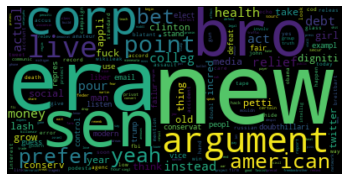

Topic: 0 Word: 0.006*"peopl" + 0.005*"think" + 0.005*"like" + 0.005*"countri" + 0.004*"right" + 0.004*"fuck" + 0.004*"israel" + 0.004*"govern" + 0.004*"say" + 0.003*"thing"
Topic: 1 Word: 0.004*"like" + 0.004*"peopl" + 0.004*"world" + 0.004*"say" + 0.004*"year" + 0.003*"kill" + 0.003*"good" + 0.003*"get" + 0.003*"know" + 0.003*"time"
doc :  0 [(0, 0.82844114), (1, 0.1715588)]
doc :  1 [(0, 0.2925896), (1, 0.7074104)]
doc :  2 [(0, 0.63555276), (1, 0.36444727)]
doc :  3 [(0, 0.10080809), (1, 0.8991919)]
doc :  4 [(0, 0.42245877), (1, 0.5775413)]
doc :  5 [(0, 0.9273897), (1, 0.07261028)]
doc :  6 [(0, 0.2568697), (1, 0.7431303)]
doc :  7 [(0, 0.08620428), (1, 0.91379565)]
doc :  8 [(0, 0.90599024), (1, 0.09400977)]
doc :  9 [(0, 0.93253285), (1, 0.06746713)]
doc :  10 [(0, 0.8162433), (1, 0.1837567)]
doc :  11 [(0, 0.90776443), (1, 0.09223561)]
doc :  12 [(0, 0.618842), (1, 0.381158)]
doc :  13 [(0, 0.831582), (1, 0.16841802)]
doc :  14 [(0, 0.5730841), (1, 0.42691594)]
doc :  15 [(0, 0

doc :  231 [(0, 0.41426343), (1, 0.5857366)]
doc :  232 [(0, 0.101086974), (1, 0.898913)]
doc :  233 [(0, 0.20766905), (1, 0.792331)]
doc :  234 [(0, 0.29024827), (1, 0.7097518)]
doc :  235 [(0, 0.978184), (1, 0.021816047)]
doc :  236 [(0, 0.91139585), (1, 0.08860418)]
doc :  237 [(0, 0.8954438), (1, 0.10455623)]
doc :  238 [(0, 0.5), (1, 0.5)]
doc :  239 [(0, 0.709883), (1, 0.290117)]
doc :  240 [(0, 0.85984683), (1, 0.14015317)]
doc :  241 [(0, 0.112034366), (1, 0.8879656)]
doc :  242 [(0, 0.044614926), (1, 0.9553851)]
doc :  243 [(0, 0.06738198), (1, 0.932618)]
doc :  244 [(0, 0.0996404), (1, 0.9003596)]
doc :  245 [(0, 0.40841195), (1, 0.591588)]
doc :  246 [(0, 0.15146923), (1, 0.84853077)]
doc :  247 [(0, 0.1664548), (1, 0.83354515)]
doc :  248 [(0, 0.14019337), (1, 0.85980666)]
doc :  249 [(0, 0.42980254), (1, 0.57019746)]
doc :  250 [(0, 0.7953688), (1, 0.2046312)]
doc :  251 [(0, 0.111196354), (1, 0.8888036)]
doc :  252 [(0, 0.42819908), (1, 0.5718009)]
doc :  253 [(0, 0.56897

doc :  470 [(0, 0.028479623), (1, 0.9715203)]
doc :  471 [(0, 0.93815404), (1, 0.06184592)]
doc :  472 [(0, 0.4203246), (1, 0.5796754)]
doc :  473 [(0, 0.16386515), (1, 0.83613485)]
doc :  474 [(0, 0.7750101), (1, 0.22498983)]
doc :  475 [(0, 0.06345865), (1, 0.9365414)]
doc :  476 [(0, 0.4772571), (1, 0.5227429)]
doc :  477 [(0, 0.12284716), (1, 0.87715286)]
doc :  478 [(0, 0.8973121), (1, 0.10268794)]
doc :  479 [(0, 0.09472487), (1, 0.90527517)]
doc :  480 [(0, 0.7483637), (1, 0.2516363)]
doc :  481 [(0, 0.12524371), (1, 0.8747563)]
doc :  482 [(0, 0.5784472), (1, 0.42155275)]
doc :  483 [(0, 0.86103857), (1, 0.13896143)]
doc :  484 [(0, 0.89371073), (1, 0.10628924)]
doc :  485 [(0, 0.05941159), (1, 0.9405884)]
doc :  486 [(0, 0.18223533), (1, 0.8177647)]
doc :  487 [(0, 0.70714325), (1, 0.29285672)]
doc :  488 [(0, 0.14608234), (1, 0.85391766)]
doc :  489 [(0, 0.7867325), (1, 0.21326749)]
doc :  490 [(0, 0.6785755), (1, 0.3214245)]
doc :  491 [(0, 0.63136077), (1, 0.36863926)]
doc 

doc :  724 [(0, 0.2694578), (1, 0.7305422)]
doc :  725 [(0, 0.78004473), (1, 0.21995528)]
doc :  726 [(0, 0.12707089), (1, 0.8729291)]
doc :  727 [(0, 0.8560536), (1, 0.14394644)]
doc :  728 [(0, 0.086658046), (1, 0.91334194)]
doc :  729 [(0, 0.6721713), (1, 0.32782876)]
doc :  730 [(0, 0.47154635), (1, 0.52845365)]
doc :  731 [(0, 0.41492954), (1, 0.5850705)]
doc :  732 [(0, 0.22478873), (1, 0.7752112)]
doc :  733 [(0, 0.9611605), (1, 0.038839564)]
doc :  734 [(0, 0.41125965), (1, 0.58874035)]
doc :  735 [(0, 0.913281), (1, 0.08671896)]
doc :  736 [(0, 0.048816994), (1, 0.95118296)]
doc :  737 [(0, 0.8345613), (1, 0.16543877)]
doc :  738 [(0, 0.692837), (1, 0.30716306)]
doc :  739 [(0, 0.30533835), (1, 0.6946616)]
doc :  740 [(0, 0.8619652), (1, 0.1380348)]
doc :  741 [(0, 0.488763), (1, 0.511237)]
doc :  742 [(0, 0.8897444), (1, 0.11025556)]
doc :  743 [(0, 0.75346345), (1, 0.24653657)]
doc :  744 [(0, 0.082676716), (1, 0.9173233)]
doc :  745 [(0, 0.18157268), (1, 0.8184274)]
doc :  

doc :  1014 [(0, 0.7186362), (1, 0.28136373)]
doc :  1015 [(0, 0.63176215), (1, 0.36823782)]
doc :  1016 [(0, 0.280483), (1, 0.719517)]
doc :  1017 [(0, 0.7633484), (1, 0.2366516)]
doc :  1018 [(0, 0.7132251), (1, 0.2867749)]
doc :  1019 [(0, 0.1616154), (1, 0.83838457)]
doc :  1020 [(0, 0.4234041), (1, 0.5765959)]
doc :  1021 [(0, 0.71689653), (1, 0.28310347)]
doc :  1022 [(0, 0.768071), (1, 0.23192902)]
doc :  1023 [(0, 0.6384391), (1, 0.36156085)]
doc :  1024 [(0, 0.9307471), (1, 0.06925293)]
doc :  1025 [(0, 0.8911841), (1, 0.10881587)]
doc :  1026 [(0, 0.793356), (1, 0.20664398)]
doc :  1027 [(0, 0.12025497), (1, 0.879745)]
doc :  1028 [(0, 0.11352462), (1, 0.8864754)]
doc :  1029 [(0, 0.5186946), (1, 0.48130536)]
doc :  1030 [(0, 0.83731544), (1, 0.16268457)]
doc :  1031 [(0, 0.8776469), (1, 0.12235307)]
doc :  1032 [(0, 0.35421938), (1, 0.6457806)]
doc :  1033 [(0, 0.19873533), (1, 0.80126464)]
doc :  1034 [(0, 0.32443014), (1, 0.67556983)]
doc :  1035 [(0, 0.5876089), (1, 0.412

doc :  1315 [(0, 0.85672754), (1, 0.14327241)]
doc :  1316 [(0, 0.85588694), (1, 0.14411311)]
doc :  1317 [(0, 0.6489664), (1, 0.35103366)]
doc :  1318 [(0, 0.700495), (1, 0.299505)]
doc :  1319 [(0, 0.8598417), (1, 0.14015834)]
doc :  1320 [(0, 0.9198164), (1, 0.080183625)]
doc :  1321 [(0, 0.29857352), (1, 0.7014265)]
doc :  1322 [(0, 0.80656326), (1, 0.19343676)]
doc :  1323 [(0, 0.316591), (1, 0.683409)]
doc :  1324 [(0, 0.2392609), (1, 0.7607391)]
doc :  1325 [(0, 0.6913971), (1, 0.30860296)]
doc :  1326 [(0, 0.16102861), (1, 0.8389714)]
doc :  1327 [(0, 0.2316181), (1, 0.76838195)]
doc :  1328 [(0, 0.09956913), (1, 0.90043086)]
doc :  1329 [(0, 0.35219285), (1, 0.6478072)]
doc :  1330 [(0, 0.18336101), (1, 0.81663895)]
doc :  1331 [(0, 0.08028527), (1, 0.9197147)]
doc :  1332 [(0, 0.8821234), (1, 0.11787656)]
doc :  1333 [(0, 0.7857625), (1, 0.2142375)]
doc :  1334 [(0, 0.84978735), (1, 0.15021268)]
doc :  1335 [(0, 0.9049361), (1, 0.09506393)]
doc :  1336 [(0, 0.5299488), (1, 0.

doc :  1618 [(0, 0.091586925), (1, 0.9084131)]
doc :  1619 [(0, 0.6452414), (1, 0.35475868)]
doc :  1620 [(0, 0.13200106), (1, 0.86799896)]
doc :  1621 [(0, 0.13200834), (1, 0.8679917)]
doc :  1622 [(0, 0.26521426), (1, 0.7347858)]
doc :  1623 [(0, 0.9163749), (1, 0.08362507)]
doc :  1624 [(0, 0.92541856), (1, 0.074581414)]
doc :  1625 [(0, 0.80076176), (1, 0.19923823)]
doc :  1626 [(0, 0.07526578), (1, 0.92473423)]
doc :  1627 [(0, 0.6882692), (1, 0.31173077)]
doc :  1628 [(0, 0.71296144), (1, 0.28703856)]
doc :  1629 [(0, 0.77492476), (1, 0.22507519)]
doc :  1630 [(0, 0.8363723), (1, 0.16362768)]
doc :  1631 [(0, 0.9464145), (1, 0.05358555)]
doc :  1632 [(0, 0.12132731), (1, 0.87867266)]
doc :  1633 [(0, 0.7604298), (1, 0.23957019)]
doc :  1634 [(0, 0.18558754), (1, 0.8144124)]
doc :  1635 [(0, 0.16580312), (1, 0.8341969)]
doc :  1636 [(0, 0.9625897), (1, 0.037410352)]
doc :  1637 [(0, 0.13759905), (1, 0.86240095)]
doc :  1638 [(0, 0.9318649), (1, 0.06813506)]
doc :  1639 [(0, 0.8978

doc :  1958 [(0, 0.43812296), (1, 0.561877)]
doc :  1959 [(0, 0.70351845), (1, 0.29648155)]
doc :  1960 [(0, 0.7204316), (1, 0.27956837)]
doc :  1961 [(0, 0.7393065), (1, 0.26069352)]
doc :  1962 [(0, 0.15091692), (1, 0.8490831)]
doc :  1963 [(0, 0.16908684), (1, 0.8309132)]
doc :  1964 [(0, 0.8010642), (1, 0.19893585)]
doc :  1965 [(0, 0.27198052), (1, 0.7280195)]
doc :  1966 [(0, 0.7657556), (1, 0.2342444)]
doc :  1967 [(0, 0.12021439), (1, 0.8797856)]
doc :  1968 [(0, 0.5031371), (1, 0.49686292)]
doc :  1969 [(0, 0.107257985), (1, 0.89274204)]
doc :  1970 [(0, 0.086053826), (1, 0.91394615)]
doc :  1971 [(0, 0.21399), (1, 0.78601)]
doc :  1972 [(0, 0.9349171), (1, 0.06508293)]
doc :  1973 [(0, 0.7812776), (1, 0.21872243)]
doc :  1974 [(0, 0.52955836), (1, 0.47044158)]
doc :  1975 [(0, 0.41955224), (1, 0.5804478)]
doc :  1976 [(0, 0.8969117), (1, 0.1030883)]
doc :  1977 [(0, 0.85674167), (1, 0.1432583)]
doc :  1978 [(0, 0.651664), (1, 0.34833592)]
doc :  1979 [(0, 0.10217247), (1, 0.8

doc :  2260 [(0, 0.93112737), (1, 0.06887261)]
doc :  2261 [(0, 0.58342946), (1, 0.41657048)]
doc :  2262 [(0, 0.4201176), (1, 0.5798824)]
doc :  2263 [(0, 0.10201111), (1, 0.8979889)]
doc :  2264 [(0, 0.15010087), (1, 0.8498991)]
doc :  2265 [(0, 0.86214274), (1, 0.13785726)]
doc :  2266 [(0, 0.6581664), (1, 0.34183356)]
doc :  2267 [(0, 0.78840023), (1, 0.21159975)]
doc :  2268 [(0, 0.9239453), (1, 0.07605476)]
doc :  2269 [(0, 0.9306867), (1, 0.06931327)]
doc :  2270 [(0, 0.83464974), (1, 0.16535023)]
doc :  2271 [(0, 0.22974725), (1, 0.7702527)]
doc :  2272 [(0, 0.39255583), (1, 0.60744417)]
doc :  2273 [(0, 0.9423771), (1, 0.057622902)]
doc :  2274 [(0, 0.17220348), (1, 0.8277966)]
doc :  2275 [(0, 0.24697736), (1, 0.7530226)]
doc :  2276 [(0, 0.21000294), (1, 0.78999704)]
doc :  2277 [(0, 0.17547296), (1, 0.8245271)]
doc :  2278 [(0, 0.2856824), (1, 0.71431756)]
doc :  2279 [(0, 0.4120334), (1, 0.58796656)]
doc :  2280 [(0, 0.30096844), (1, 0.6990316)]
doc :  2281 [(0, 0.72540295

doc :  2521 [(0, 0.8877952), (1, 0.11220483)]
doc :  2522 [(0, 0.962471), (1, 0.03752897)]
doc :  2523 [(0, 0.4591016), (1, 0.54089844)]
doc :  2524 [(0, 0.79774433), (1, 0.20225565)]
doc :  2525 [(0, 0.5179706), (1, 0.4820294)]
doc :  2526 [(0, 0.12029298), (1, 0.87970704)]
doc :  2527 [(0, 0.94289064), (1, 0.05710935)]
doc :  2528 [(0, 0.6990147), (1, 0.30098522)]
doc :  2529 [(0, 0.937152), (1, 0.06284798)]
doc :  2530 [(0, 0.24498762), (1, 0.75501245)]
doc :  2531 [(0, 0.86045545), (1, 0.13954449)]
doc :  2532 [(0, 0.6597646), (1, 0.34023538)]
doc :  2533 [(0, 0.30453405), (1, 0.6954659)]
doc :  2534 [(0, 0.54842097), (1, 0.45157903)]
doc :  2535 [(0, 0.18681574), (1, 0.81318426)]
doc :  2536 [(0, 0.21498838), (1, 0.78501165)]
doc :  2537 [(0, 0.78201956), (1, 0.21798046)]
doc :  2538 [(0, 0.7908133), (1, 0.2091867)]
doc :  2539 [(0, 0.29722777), (1, 0.7027722)]
doc :  2540 [(0, 0.21716951), (1, 0.7828305)]
doc :  2541 [(0, 0.17914577), (1, 0.82085425)]
doc :  2542 [(0, 0.14421736)

doc :  2813 [(0, 0.92746055), (1, 0.07253942)]
doc :  2814 [(0, 0.09084003), (1, 0.90915996)]
doc :  2815 [(0, 0.89325005), (1, 0.106750004)]
doc :  2816 [(0, 0.96803606), (1, 0.031963903)]
doc :  2817 [(0, 0.83947766), (1, 0.16052231)]
doc :  2818 [(0, 0.5395426), (1, 0.46045735)]
doc :  2819 [(0, 0.52594787), (1, 0.47405213)]
doc :  2820 [(0, 0.5962892), (1, 0.40371078)]
doc :  2821 [(0, 0.9293894), (1, 0.07061057)]
doc :  2822 [(0, 0.41290313), (1, 0.5870969)]
doc :  2823 [(0, 0.33314288), (1, 0.6668571)]
doc :  2824 [(0, 0.8389258), (1, 0.16107418)]
doc :  2825 [(0, 0.4759137), (1, 0.5240863)]
doc :  2826 [(0, 0.27473792), (1, 0.7252621)]
doc :  2827 [(0, 0.8228869), (1, 0.17711309)]
doc :  2828 [(0, 0.5313654), (1, 0.4686346)]
doc :  2829 [(0, 0.90454173), (1, 0.095458254)]
doc :  2830 [(0, 0.8100993), (1, 0.18990071)]
doc :  2831 [(0, 0.13186097), (1, 0.8681391)]
doc :  2832 [(0, 0.32374987), (1, 0.67625016)]
doc :  2833 [(0, 0.098224245), (1, 0.9017758)]
doc :  2834 [(0, 0.41906

doc :  3094 [(0, 0.54212177), (1, 0.4578782)]
doc :  3095 [(0, 0.20936343), (1, 0.79063654)]
doc :  3096 [(0, 0.12278893), (1, 0.8772111)]
doc :  3097 [(0, 0.70630294), (1, 0.29369703)]
doc :  3098 [(0, 0.7148725), (1, 0.2851275)]
doc :  3099 [(0, 0.9542015), (1, 0.04579853)]
doc :  3100 [(0, 0.63935465), (1, 0.36064532)]
doc :  3101 [(0, 0.831369), (1, 0.16863105)]
doc :  3102 [(0, 0.21775636), (1, 0.7822436)]
doc :  3103 [(0, 0.5335617), (1, 0.4664383)]
doc :  3104 [(0, 0.9436774), (1, 0.05632255)]
doc :  3105 [(0, 0.93034637), (1, 0.069653615)]
doc :  3106 [(0, 0.9179195), (1, 0.082080446)]
doc :  3107 [(0, 0.5402135), (1, 0.4597865)]
doc :  3108 [(0, 0.30750084), (1, 0.69249916)]
doc :  3109 [(0, 0.8961182), (1, 0.1038818)]
doc :  3110 [(0, 0.1207731), (1, 0.8792269)]
doc :  3111 [(0, 0.68954384), (1, 0.3104561)]
doc :  3112 [(0, 0.1478718), (1, 0.8521282)]
doc :  3113 [(0, 0.6098429), (1, 0.39015713)]
doc :  3114 [(0, 0.05170036), (1, 0.94829965)]
doc :  3115 [(0, 0.5), (1, 0.5)]


doc :  3461 [(0, 0.1173901), (1, 0.88260984)]
doc :  3462 [(0, 0.109132), (1, 0.89086795)]
doc :  3463 [(0, 0.5791996), (1, 0.4208004)]
doc :  3464 [(0, 0.9133794), (1, 0.08662063)]
doc :  3465 [(0, 0.24019861), (1, 0.7598014)]
doc :  3466 [(0, 0.20223315), (1, 0.7977668)]
doc :  3467 [(0, 0.92174786), (1, 0.078252144)]
doc :  3468 [(0, 0.07531658), (1, 0.92468345)]
doc :  3469 [(0, 0.12215575), (1, 0.8778443)]
doc :  3470 [(0, 0.8903661), (1, 0.10963393)]
doc :  3471 [(0, 0.8877422), (1, 0.11225776)]
doc :  3472 [(0, 0.06954877), (1, 0.9304512)]
doc :  3473 [(0, 0.11600992), (1, 0.8839901)]
doc :  3474 [(0, 0.50321317), (1, 0.49678686)]
doc :  3475 [(0, 0.74970347), (1, 0.2502965)]
doc :  3476 [(0, 0.5), (1, 0.5)]
doc :  3477 [(0, 0.8233178), (1, 0.1766822)]
doc :  3478 [(0, 0.9069964), (1, 0.09300355)]
doc :  3479 [(0, 0.11302009), (1, 0.8869799)]
doc :  3480 [(0, 0.20549268), (1, 0.7945073)]
doc :  3481 [(0, 0.12065492), (1, 0.87934506)]
doc :  3482 [(0, 0.487547), (1, 0.51245296)]


doc :  3744 [(0, 0.17871177), (1, 0.8212882)]
doc :  3745 [(0, 0.827864), (1, 0.17213595)]
doc :  3746 [(0, 0.52683926), (1, 0.4731607)]
doc :  3747 [(0, 0.95615166), (1, 0.043848358)]
doc :  3748 [(0, 0.29395798), (1, 0.706042)]
doc :  3749 [(0, 0.6283931), (1, 0.37160683)]
doc :  3750 [(0, 0.9353816), (1, 0.06461839)]
doc :  3751 [(0, 0.81326234), (1, 0.18673761)]
doc :  3752 [(0, 0.988337), (1, 0.011662993)]
doc :  3753 [(0, 0.8493245), (1, 0.15067545)]
doc :  3754 [(0, 0.94112486), (1, 0.05887514)]
doc :  3755 [(0, 0.5), (1, 0.5)]
doc :  3756 [(0, 0.7738067), (1, 0.22619326)]
doc :  3757 [(0, 0.65099186), (1, 0.34900814)]
doc :  3758 [(0, 0.075729184), (1, 0.9242708)]
doc :  3759 [(0, 0.2104856), (1, 0.78951436)]
doc :  3760 [(0, 0.59315073), (1, 0.40684924)]
doc :  3761 [(0, 0.23358466), (1, 0.76641536)]
doc :  3762 [(0, 0.32754314), (1, 0.6724568)]
doc :  3763 [(0, 0.20373847), (1, 0.79626155)]
doc :  3764 [(0, 0.8050739), (1, 0.1949261)]
doc :  3765 [(0, 0.82326686), (1, 0.17673

doc :  4124 [(0, 0.9145861), (1, 0.08541383)]
doc :  4125 [(0, 0.69771045), (1, 0.30228955)]
doc :  4126 [(0, 0.6873245), (1, 0.31267548)]
doc :  4127 [(0, 0.7742877), (1, 0.22571233)]
doc :  4128 [(0, 0.2262997), (1, 0.77370024)]
doc :  4129 [(0, 0.21230964), (1, 0.78769034)]
doc :  4130 [(0, 0.81552947), (1, 0.18447053)]
doc :  4131 [(0, 0.46271136), (1, 0.53728867)]
doc :  4132 [(0, 0.66597164), (1, 0.33402836)]
doc :  4133 [(0, 0.871281), (1, 0.12871897)]
doc :  4134 [(0, 0.13307355), (1, 0.8669265)]
doc :  4135 [(0, 0.46882725), (1, 0.53117275)]
doc :  4136 [(0, 0.67640376), (1, 0.3235962)]
doc :  4137 [(0, 0.55984527), (1, 0.4401547)]
doc :  4138 [(0, 0.79057264), (1, 0.2094274)]
doc :  4139 [(0, 0.9037035), (1, 0.096296474)]
doc :  4140 [(0, 0.1409461), (1, 0.8590539)]
doc :  4141 [(0, 0.3923059), (1, 0.6076941)]
doc :  4142 [(0, 0.1732853), (1, 0.8267147)]
doc :  4143 [(0, 0.6436331), (1, 0.35636687)]
doc :  4144 [(0, 0.8289966), (1, 0.17100339)]
doc :  4145 [(0, 0.40254104), (

doc :  4430 [(0, 0.6483483), (1, 0.35165176)]
doc :  4431 [(0, 0.7570648), (1, 0.24293518)]
doc :  4432 [(0, 0.9591691), (1, 0.040830947)]
doc :  4433 [(0, 0.09942206), (1, 0.90057796)]
doc :  4434 [(0, 0.2557599), (1, 0.74424016)]
doc :  4435 [(0, 0.86961466), (1, 0.13038535)]
doc :  4436 [(0, 0.084392875), (1, 0.91560715)]
doc :  4437 [(0, 0.9180251), (1, 0.08197491)]
doc :  4438 [(0, 0.6901769), (1, 0.30982307)]
doc :  4439 [(0, 0.21696208), (1, 0.7830379)]
doc :  4440 [(0, 0.8375412), (1, 0.16245879)]
doc :  4441 [(0, 0.18550748), (1, 0.81449246)]
doc :  4442 [(0, 0.8957317), (1, 0.104268275)]
doc :  4443 [(0, 0.16941483), (1, 0.8305851)]
doc :  4444 [(0, 0.90355957), (1, 0.096440405)]
doc :  4445 [(0, 0.889279), (1, 0.110720955)]
doc :  4446 [(0, 0.100440994), (1, 0.899559)]
doc :  4447 [(0, 0.41078246), (1, 0.58921754)]
doc :  4448 [(0, 0.9054955), (1, 0.09450449)]
doc :  4449 [(0, 0.1359392), (1, 0.8640608)]
doc :  4450 [(0, 0.08206862), (1, 0.9179314)]
doc :  4451 [(0, 0.5), (1

doc :  4790 [(0, 0.9444177), (1, 0.055582236)]
doc :  4791 [(0, 0.885134), (1, 0.114866)]
doc :  4792 [(0, 0.4752424), (1, 0.5247576)]
doc :  4793 [(0, 0.89408994), (1, 0.1059101)]
doc :  4794 [(0, 0.4371954), (1, 0.56280464)]
doc :  4795 [(0, 0.13253532), (1, 0.8674647)]
doc :  4796 [(0, 0.5), (1, 0.5)]
doc :  4797 [(0, 0.7605858), (1, 0.23941423)]
doc :  4798 [(0, 0.860341), (1, 0.13965905)]
doc :  4799 [(0, 0.9136344), (1, 0.086365595)]
doc :  4800 [(0, 0.95857555), (1, 0.04142452)]
doc :  4801 [(0, 0.85806674), (1, 0.14193323)]
doc :  4802 [(0, 0.08242288), (1, 0.91757715)]
doc :  4803 [(0, 0.6976288), (1, 0.3023712)]
doc :  4804 [(0, 0.73928213), (1, 0.2607178)]
doc :  4805 [(0, 0.9005429), (1, 0.099457026)]
doc :  4806 [(0, 0.16795942), (1, 0.83204055)]
doc :  4807 [(0, 0.53309965), (1, 0.46690035)]
doc :  4808 [(0, 0.923474), (1, 0.076526)]
doc :  4809 [(0, 0.079015605), (1, 0.9209844)]
doc :  4810 [(0, 0.059499044), (1, 0.9405009)]
doc :  4811 [(0, 0.9336429), (1, 0.06635703)]


doc :  5162 [(0, 0.9470828), (1, 0.05291714)]
doc :  5163 [(0, 0.91633445), (1, 0.08366555)]
doc :  5164 [(0, 0.27054745), (1, 0.72945255)]
doc :  5165 [(0, 0.70162183), (1, 0.2983782)]
doc :  5166 [(0, 0.8881264), (1, 0.1118736)]
doc :  5167 [(0, 0.8259576), (1, 0.17404242)]
doc :  5168 [(0, 0.07655699), (1, 0.923443)]
doc :  5169 [(0, 0.92380565), (1, 0.07619437)]
doc :  5170 [(0, 0.106488265), (1, 0.8935117)]
doc :  5171 [(0, 0.54459417), (1, 0.45540577)]
doc :  5172 [(0, 0.7711398), (1, 0.22886026)]
doc :  5173 [(0, 0.24106425), (1, 0.75893575)]
doc :  5174 [(0, 0.92412835), (1, 0.07587169)]
doc :  5175 [(0, 0.18694553), (1, 0.81305444)]
doc :  5176 [(0, 0.22243947), (1, 0.77756053)]
doc :  5177 [(0, 0.9546801), (1, 0.04531991)]
doc :  5178 [(0, 0.38845533), (1, 0.6115446)]
doc :  5179 [(0, 0.21201585), (1, 0.78798413)]
doc :  5180 [(0, 0.22855048), (1, 0.7714495)]
doc :  5181 [(0, 0.9539065), (1, 0.04609352)]
doc :  5182 [(0, 0.9334057), (1, 0.06659427)]
doc :  5183 [(0, 0.8278529

doc :  5523 [(0, 0.69758224), (1, 0.30241776)]
doc :  5524 [(0, 0.0985063), (1, 0.9014937)]
doc :  5525 [(0, 0.15148501), (1, 0.848515)]
doc :  5526 [(0, 0.15393022), (1, 0.8460698)]
doc :  5527 [(0, 0.1950401), (1, 0.8049599)]
doc :  5528 [(0, 0.8973723), (1, 0.102627724)]
doc :  5529 [(0, 0.3267771), (1, 0.6732229)]
doc :  5530 [(0, 0.25513634), (1, 0.7448636)]
doc :  5531 [(0, 0.57482255), (1, 0.42517745)]
doc :  5532 [(0, 0.91156316), (1, 0.08843681)]
doc :  5533 [(0, 0.13463525), (1, 0.8653648)]
doc :  5534 [(0, 0.958771), (1, 0.04122904)]
doc :  5535 [(0, 0.84436744), (1, 0.1556326)]
doc :  5536 [(0, 0.88682866), (1, 0.11317133)]
doc :  5537 [(0, 0.6633078), (1, 0.3366922)]
doc :  5538 [(0, 0.8920019), (1, 0.107998066)]
doc :  5539 [(0, 0.8985264), (1, 0.101473615)]
doc :  5540 [(0, 0.15628415), (1, 0.8437158)]
doc :  5541 [(0, 0.7101708), (1, 0.28982925)]
doc :  5542 [(0, 0.89391875), (1, 0.10608126)]
doc :  5543 [(0, 0.84845823), (1, 0.15154175)]
doc :  5544 [(0, 0.8020477), (1

doc :  5832 [(0, 0.8096198), (1, 0.19038023)]
doc :  5833 [(0, 0.8828091), (1, 0.1171909)]
doc :  5834 [(0, 0.958909), (1, 0.041091003)]
doc :  5835 [(0, 0.11879192), (1, 0.8812081)]
doc :  5836 [(0, 0.9236222), (1, 0.076377824)]
doc :  5837 [(0, 0.7238134), (1, 0.27618662)]
doc :  5838 [(0, 0.8119323), (1, 0.18806769)]
doc :  5839 [(0, 0.043720037), (1, 0.95627993)]
doc :  5840 [(0, 0.8929865), (1, 0.10701353)]
doc :  5841 [(0, 0.34839165), (1, 0.65160835)]
doc :  5842 [(0, 0.14203046), (1, 0.8579696)]
doc :  5843 [(0, 0.067067355), (1, 0.9329327)]
doc :  5844 [(0, 0.736582), (1, 0.26341805)]
doc :  5845 [(0, 0.8372912), (1, 0.16270888)]
doc :  5846 [(0, 0.43845856), (1, 0.56154144)]
doc :  5847 [(0, 0.87780464), (1, 0.12219537)]
doc :  5848 [(0, 0.52347255), (1, 0.47652748)]
doc :  5849 [(0, 0.26357257), (1, 0.7364274)]
doc :  5850 [(0, 0.26376215), (1, 0.7362379)]
doc :  5851 [(0, 0.26133984), (1, 0.73866016)]
doc :  5852 [(0, 0.8117766), (1, 0.1882235)]
doc :  5853 [(0, 0.16251974)

doc :  6183 [(0, 0.4981305), (1, 0.5018695)]
doc :  6184 [(0, 0.8265323), (1, 0.17346773)]
doc :  6185 [(0, 0.62134385), (1, 0.37865618)]
doc :  6186 [(0, 0.87145305), (1, 0.12854697)]
doc :  6187 [(0, 0.6447077), (1, 0.35529235)]
doc :  6188 [(0, 0.10644851), (1, 0.8935515)]
doc :  6189 [(0, 0.061430637), (1, 0.9385694)]
doc :  6190 [(0, 0.44794926), (1, 0.55205065)]
doc :  6191 [(0, 0.87977123), (1, 0.12022876)]
doc :  6192 [(0, 0.41912785), (1, 0.5808722)]
doc :  6193 [(0, 0.8927115), (1, 0.107288465)]
doc :  6194 [(0, 0.43402344), (1, 0.5659766)]
doc :  6195 [(0, 0.9286951), (1, 0.07130494)]
doc :  6196 [(0, 0.071794204), (1, 0.9282058)]
doc :  6197 [(0, 0.10525082), (1, 0.8947492)]
doc :  6198 [(0, 0.95311207), (1, 0.04688793)]
doc :  6199 [(0, 0.4748865), (1, 0.52511346)]
doc :  6200 [(0, 0.16960947), (1, 0.8303905)]
doc :  6201 [(0, 0.8053553), (1, 0.19464469)]
doc :  6202 [(0, 0.086573265), (1, 0.91342676)]
doc :  6203 [(0, 0.51908696), (1, 0.48091304)]
doc :  6204 [(0, 0.85245

doc :  6555 [(0, 0.8872546), (1, 0.112745374)]
doc :  6556 [(0, 0.2791891), (1, 0.72081095)]
doc :  6557 [(0, 0.5776364), (1, 0.42236355)]
doc :  6558 [(0, 0.5527284), (1, 0.44727162)]
doc :  6559 [(0, 0.87041724), (1, 0.12958273)]
doc :  6560 [(0, 0.15043463), (1, 0.8495653)]
doc :  6561 [(0, 0.07924641), (1, 0.9207536)]
doc :  6562 [(0, 0.27658734), (1, 0.7234127)]
doc :  6563 [(0, 0.10595452), (1, 0.8940454)]
doc :  6564 [(0, 0.3140232), (1, 0.6859768)]
doc :  6565 [(0, 0.097844824), (1, 0.90215516)]
doc :  6566 [(0, 0.5830051), (1, 0.4169949)]
doc :  6567 [(0, 0.5745306), (1, 0.4254694)]
doc :  6568 [(0, 0.8147255), (1, 0.18527445)]
doc :  6569 [(0, 0.80243915), (1, 0.19756089)]
doc :  6570 [(0, 0.7858207), (1, 0.21417928)]
doc :  6571 [(0, 0.15051614), (1, 0.84948385)]
doc :  6572 [(0, 0.6852191), (1, 0.31478086)]
doc :  6573 [(0, 0.9118124), (1, 0.08818763)]
doc :  6574 [(0, 0.8230096), (1, 0.17699037)]
doc :  6575 [(0, 0.85639966), (1, 0.14360031)]
doc :  6576 [(0, 0.42622575), 

doc :  6888 [(0, 0.092845), (1, 0.90715504)]
doc :  6889 [(0, 0.28301668), (1, 0.7169834)]
doc :  6890 [(0, 0.6433395), (1, 0.3566605)]
doc :  6891 [(0, 0.7098778), (1, 0.2901222)]
doc :  6892 [(0, 0.9440201), (1, 0.055979874)]
doc :  6893 [(0, 0.9491118), (1, 0.050888218)]
doc :  6894 [(0, 0.89343315), (1, 0.10656681)]
doc :  6895 [(0, 0.1077958), (1, 0.8922042)]
doc :  6896 [(0, 0.7086749), (1, 0.29132506)]
doc :  6897 [(0, 0.23513728), (1, 0.7648627)]
doc :  6898 [(0, 0.13582404), (1, 0.8641759)]
doc :  6899 [(0, 0.852133), (1, 0.14786707)]
doc :  6900 [(0, 0.888289), (1, 0.11171103)]
doc :  6901 [(0, 0.17328905), (1, 0.826711)]
doc :  6902 [(0, 0.9655356), (1, 0.034464404)]
doc :  6903 [(0, 0.85640836), (1, 0.14359161)]
doc :  6904 [(0, 0.084488735), (1, 0.9155112)]
doc :  6905 [(0, 0.47799948), (1, 0.5220005)]
doc :  6906 [(0, 0.11780447), (1, 0.88219553)]
doc :  6907 [(0, 0.9635069), (1, 0.036493167)]
doc :  6908 [(0, 0.48888674), (1, 0.5111133)]
doc :  6909 [(0, 0.30999964), (1,

doc :  7176 [(0, 0.08437979), (1, 0.9156202)]
doc :  7177 [(0, 0.8303607), (1, 0.16963933)]
doc :  7178 [(0, 0.5730523), (1, 0.42694777)]
doc :  7179 [(0, 0.8437548), (1, 0.15624523)]
doc :  7180 [(0, 0.08329284), (1, 0.91670716)]
doc :  7181 [(0, 0.1055789), (1, 0.8944211)]
doc :  7182 [(0, 0.69644505), (1, 0.30355498)]
doc :  7183 [(0, 0.603194), (1, 0.396806)]
doc :  7184 [(0, 0.4919494), (1, 0.50805056)]
doc :  7185 [(0, 0.91508263), (1, 0.08491738)]
doc :  7186 [(0, 0.40535834), (1, 0.5946416)]
doc :  7187 [(0, 0.81169945), (1, 0.18830055)]
doc :  7188 [(0, 0.09571434), (1, 0.90428567)]
doc :  7189 [(0, 0.15375514), (1, 0.8462449)]
doc :  7190 [(0, 0.38576412), (1, 0.6142359)]
doc :  7191 [(0, 0.34014225), (1, 0.6598578)]
doc :  7192 [(0, 0.117012054), (1, 0.882988)]
doc :  7193 [(0, 0.12727936), (1, 0.87272066)]
doc :  7194 [(0, 0.11138386), (1, 0.88861614)]
doc :  7195 [(0, 0.9159668), (1, 0.084033154)]
doc :  7196 [(0, 0.2264214), (1, 0.77357864)]
doc :  7197 [(0, 0.89065933), 

doc :  7490 [(0, 0.7651048), (1, 0.23489523)]
doc :  7491 [(0, 0.20748214), (1, 0.79251784)]
doc :  7492 [(0, 0.1397671), (1, 0.86023295)]
doc :  7493 [(0, 0.8383928), (1, 0.1616072)]
doc :  7494 [(0, 0.6102587), (1, 0.38974133)]
doc :  7495 [(0, 0.14250366), (1, 0.8574964)]
doc :  7496 [(0, 0.52581036), (1, 0.4741897)]
doc :  7497 [(0, 0.87150186), (1, 0.1284982)]
doc :  7498 [(0, 0.8325275), (1, 0.16747244)]
doc :  7499 [(0, 0.93871355), (1, 0.061286446)]
doc :  7500 [(0, 0.6826393), (1, 0.3173607)]
doc :  7501 [(0, 0.70278746), (1, 0.2972125)]
doc :  7502 [(0, 0.7863996), (1, 0.21360038)]
doc :  7503 [(0, 0.45843694), (1, 0.54156303)]
doc :  7504 [(0, 0.2415036), (1, 0.7584964)]
doc :  7505 [(0, 0.039551176), (1, 0.96044874)]
doc :  7506 [(0, 0.91074395), (1, 0.08925606)]
doc :  7507 [(0, 0.86866593), (1, 0.13133407)]
doc :  7508 [(0, 0.85299444), (1, 0.14700554)]
doc :  7509 [(0, 0.34780344), (1, 0.6521965)]
doc :  7510 [(0, 0.2890106), (1, 0.7109895)]
doc :  7511 [(0, 0.09690141),

doc :  7798 [(0, 0.26201934), (1, 0.7379807)]
doc :  7799 [(0, 0.7762786), (1, 0.22372137)]
doc :  7800 [(0, 0.7730433), (1, 0.22695671)]
doc :  7801 [(0, 0.08060049), (1, 0.91939956)]
doc :  7802 [(0, 0.08754863), (1, 0.9124514)]
doc :  7803 [(0, 0.6042193), (1, 0.39578065)]
doc :  7804 [(0, 0.50375336), (1, 0.49624664)]
doc :  7805 [(0, 0.30855379), (1, 0.6914462)]
doc :  7806 [(0, 0.8116604), (1, 0.18833962)]
doc :  7807 [(0, 0.8480934), (1, 0.15190667)]
doc :  7808 [(0, 0.8431178), (1, 0.1568822)]
doc :  7809 [(0, 0.69398093), (1, 0.30601904)]
doc :  7810 [(0, 0.10312106), (1, 0.89687896)]
doc :  7811 [(0, 0.06165624), (1, 0.93834376)]
doc :  7812 [(0, 0.64850134), (1, 0.35149866)]
doc :  7813 [(0, 0.31568158), (1, 0.6843184)]
doc :  7814 [(0, 0.22317491), (1, 0.7768251)]
doc :  7815 [(0, 0.8354624), (1, 0.16453756)]
doc :  7816 [(0, 0.14668821), (1, 0.8533117)]
doc :  7817 [(0, 0.8826509), (1, 0.117349066)]
doc :  7818 [(0, 0.028349305), (1, 0.97165066)]
doc :  7819 [(0, 0.1598378

doc :  8093 [(0, 0.57344806), (1, 0.42655194)]
doc :  8094 [(0, 0.9094871), (1, 0.09051286)]
doc :  8095 [(0, 0.7645467), (1, 0.23545325)]
doc :  8096 [(0, 0.1453906), (1, 0.85460943)]
doc :  8097 [(0, 0.18184969), (1, 0.81815034)]
doc :  8098 [(0, 0.63677704), (1, 0.36322293)]
doc :  8099 [(0, 0.63815737), (1, 0.36184263)]
doc :  8100 [(0, 0.8763111), (1, 0.12368887)]
doc :  8101 [(0, 0.8939905), (1, 0.10600947)]
doc :  8102 [(0, 0.5395796), (1, 0.46042046)]
doc :  8103 [(0, 0.9160245), (1, 0.0839755)]
doc :  8104 [(0, 0.8702392), (1, 0.1297608)]
doc :  8105 [(0, 0.12566116), (1, 0.8743388)]
doc :  8106 [(0, 0.91112053), (1, 0.08887949)]
doc :  8107 [(0, 0.89693594), (1, 0.10306407)]
doc :  8108 [(0, 0.8119027), (1, 0.18809724)]
doc :  8109 [(0, 0.7894412), (1, 0.21055882)]
doc :  8110 [(0, 0.778549), (1, 0.22145103)]
doc :  8111 [(0, 0.26116836), (1, 0.73883164)]
doc :  8112 [(0, 0.19729754), (1, 0.8027025)]
doc :  8113 [(0, 0.085637435), (1, 0.9143626)]
doc :  8114 [(0, 0.35566172),

doc :  8389 [(0, 0.16405343), (1, 0.83594656)]
doc :  8390 [(0, 0.54304683), (1, 0.45695314)]
doc :  8391 [(0, 0.10213113), (1, 0.8978689)]
doc :  8392 [(0, 0.2121593), (1, 0.7878407)]
doc :  8393 [(0, 0.6313816), (1, 0.3686184)]
doc :  8394 [(0, 0.3176223), (1, 0.68237776)]
doc :  8395 [(0, 0.46802905), (1, 0.531971)]
doc :  8396 [(0, 0.55840987), (1, 0.4415901)]
doc :  8397 [(0, 0.88999), (1, 0.11001007)]
doc :  8398 [(0, 0.55985904), (1, 0.4401409)]
doc :  8399 [(0, 0.8770022), (1, 0.12299781)]
doc :  8400 [(0, 0.5746339), (1, 0.42536604)]
doc :  8401 [(0, 0.59792894), (1, 0.40207103)]
doc :  8402 [(0, 0.5503463), (1, 0.44965369)]
doc :  8403 [(0, 0.67053086), (1, 0.32946917)]
doc :  8404 [(0, 0.38468385), (1, 0.61531615)]
doc :  8405 [(0, 0.65858823), (1, 0.34141177)]
doc :  8406 [(0, 0.11515613), (1, 0.8848439)]
doc :  8407 [(0, 0.14914131), (1, 0.85085875)]
doc :  8408 [(0, 0.25246108), (1, 0.7475389)]
doc :  8409 [(0, 0.615746), (1, 0.384254)]
doc :  8410 [(0, 0.099320434), (1, 

doc :  8739 [(0, 0.16771056), (1, 0.83228946)]
doc :  8740 [(0, 0.7054866), (1, 0.29451334)]
doc :  8741 [(0, 0.81254387), (1, 0.18745615)]
doc :  8742 [(0, 0.6989728), (1, 0.30102718)]
doc :  8743 [(0, 0.92174876), (1, 0.07825127)]
doc :  8744 [(0, 0.44560778), (1, 0.5543922)]
doc :  8745 [(0, 0.9498663), (1, 0.050133698)]
doc :  8746 [(0, 0.6050208), (1, 0.39497912)]
doc :  8747 [(0, 0.15078658), (1, 0.8492134)]
doc :  8748 [(0, 0.7743398), (1, 0.22566018)]
doc :  8749 [(0, 0.661166), (1, 0.33883402)]
doc :  8750 [(0, 0.66111225), (1, 0.33888778)]
doc :  8751 [(0, 0.8819836), (1, 0.118016414)]
doc :  8752 [(0, 0.726021), (1, 0.27397904)]
doc :  8753 [(0, 0.22346693), (1, 0.7765331)]
doc :  8754 [(0, 0.9212611), (1, 0.078738905)]
doc :  8755 [(0, 0.32465044), (1, 0.6753496)]
doc :  8756 [(0, 0.8886354), (1, 0.11136462)]
doc :  8757 [(0, 0.31192622), (1, 0.6880738)]
doc :  8758 [(0, 0.6519109), (1, 0.34808913)]
doc :  8759 [(0, 0.6613267), (1, 0.3386733)]
doc :  8760 [(0, 0.53063875), 

doc :  9037 [(0, 0.27840737), (1, 0.72159266)]
doc :  9038 [(0, 0.8815571), (1, 0.118442915)]
doc :  9039 [(0, 0.5297552), (1, 0.47024488)]
doc :  9040 [(0, 0.4765052), (1, 0.52349484)]
doc :  9041 [(0, 0.9262159), (1, 0.073784135)]
doc :  9042 [(0, 0.76497227), (1, 0.23502773)]
doc :  9043 [(0, 0.19963734), (1, 0.8003627)]
doc :  9044 [(0, 0.12261155), (1, 0.8773884)]
doc :  9045 [(0, 0.9570442), (1, 0.04295582)]
doc :  9046 [(0, 0.22569509), (1, 0.7743049)]
doc :  9047 [(0, 0.85161644), (1, 0.14838353)]
doc :  9048 [(0, 0.51450634), (1, 0.4854936)]
doc :  9049 [(0, 0.72489613), (1, 0.27510387)]
doc :  9050 [(0, 0.85775536), (1, 0.14224465)]
doc :  9051 [(0, 0.85042125), (1, 0.14957877)]
doc :  9052 [(0, 0.24777031), (1, 0.7522297)]
doc :  9053 [(0, 0.7834966), (1, 0.21650334)]
doc :  9054 [(0, 0.12759183), (1, 0.8724082)]
doc :  9055 [(0, 0.621359), (1, 0.378641)]
doc :  9056 [(0, 0.86982137), (1, 0.13017862)]
doc :  9057 [(0, 0.97056526), (1, 0.029434778)]
doc :  9058 [(0, 0.1635969

doc :  9404 [(0, 0.5780238), (1, 0.42197618)]
doc :  9405 [(0, 0.86444145), (1, 0.13555853)]
doc :  9406 [(0, 0.8836737), (1, 0.11632633)]
doc :  9407 [(0, 0.20409422), (1, 0.7959058)]
doc :  9408 [(0, 0.82099193), (1, 0.17900804)]
doc :  9409 [(0, 0.08503122), (1, 0.9149688)]
doc :  9410 [(0, 0.7541522), (1, 0.24584776)]
doc :  9411 [(0, 0.8821279), (1, 0.117872134)]
doc :  9412 [(0, 0.9019973), (1, 0.09800269)]
doc :  9413 [(0, 0.11361762), (1, 0.8863824)]
doc :  9414 [(0, 0.87267107), (1, 0.12732892)]
doc :  9415 [(0, 0.7703564), (1, 0.2296436)]
doc :  9416 [(0, 0.95007974), (1, 0.04992025)]
doc :  9417 [(0, 0.7458881), (1, 0.25411195)]
doc :  9418 [(0, 0.32235837), (1, 0.6776417)]
doc :  9419 [(0, 0.1621892), (1, 0.83781075)]
doc :  9420 [(0, 0.20305476), (1, 0.7969452)]
doc :  9421 [(0, 0.06886925), (1, 0.93113077)]
doc :  9422 [(0, 0.8702646), (1, 0.12973538)]
doc :  9423 [(0, 0.28639424), (1, 0.7136057)]
doc :  9424 [(0, 0.8340886), (1, 0.16591133)]
doc :  9425 [(0, 0.8077963), 

doc :  9678 [(0, 0.8102111), (1, 0.18978886)]
doc :  9679 [(0, 0.95545346), (1, 0.044546526)]
doc :  9680 [(0, 0.1533539), (1, 0.84664613)]
doc :  9681 [(0, 0.76344025), (1, 0.23655978)]
doc :  9682 [(0, 0.97217214), (1, 0.027827855)]
doc :  9683 [(0, 0.8798096), (1, 0.120190404)]
doc :  9684 [(0, 0.9258667), (1, 0.07413327)]
doc :  9685 [(0, 0.2803493), (1, 0.7196507)]
doc :  9686 [(0, 0.7862247), (1, 0.21377523)]
doc :  9687 [(0, 0.2596352), (1, 0.7403648)]
doc :  9688 [(0, 0.91899925), (1, 0.08100075)]
doc :  9689 [(0, 0.70352703), (1, 0.29647294)]
doc :  9690 [(0, 0.27487692), (1, 0.7251231)]
doc :  9691 [(0, 0.13105607), (1, 0.8689439)]
doc :  9692 [(0, 0.89432496), (1, 0.10567507)]
doc :  9693 [(0, 0.7500001), (1, 0.24999991)]
doc :  9694 [(0, 0.8116748), (1, 0.18832521)]
doc :  9695 [(0, 0.5761177), (1, 0.42388234)]
doc :  9696 [(0, 0.35480234), (1, 0.64519763)]
doc :  9697 [(0, 0.08066267), (1, 0.9193373)]
doc :  9698 [(0, 0.28382948), (1, 0.71617055)]
doc :  9699 [(0, 0.926360

doc :  10031 [(0, 0.09524514), (1, 0.9047548)]
doc :  10032 [(0, 0.8506856), (1, 0.14931439)]
doc :  10033 [(0, 0.83602417), (1, 0.1639758)]
doc :  10034 [(0, 0.8865878), (1, 0.11341221)]
doc :  10035 [(0, 0.84882647), (1, 0.15117359)]
doc :  10036 [(0, 0.4686552), (1, 0.5313448)]
doc :  10037 [(0, 0.41493246), (1, 0.5850675)]
doc :  10038 [(0, 0.49525627), (1, 0.50474375)]
doc :  10039 [(0, 0.8755287), (1, 0.12447131)]
doc :  10040 [(0, 0.9316316), (1, 0.068368375)]
doc :  10041 [(0, 0.32470745), (1, 0.6752925)]
doc :  10042 [(0, 0.09027336), (1, 0.9097267)]
doc :  10043 [(0, 0.9132084), (1, 0.08679157)]
doc :  10044 [(0, 0.31751552), (1, 0.6824845)]
doc :  10045 [(0, 0.93631786), (1, 0.06368215)]
doc :  10046 [(0, 0.31187853), (1, 0.68812144)]
doc :  10047 [(0, 0.7649687), (1, 0.23503125)]
doc :  10048 [(0, 0.11658687), (1, 0.88341314)]
doc :  10049 [(0, 0.9143637), (1, 0.08563634)]
doc :  10050 [(0, 0.8944841), (1, 0.10551594)]
doc :  10051 [(0, 0.07814501), (1, 0.921855)]
doc :  10

doc :  10366 [(0, 0.80954367), (1, 0.1904563)]
doc :  10367 [(0, 0.9645435), (1, 0.0354565)]
doc :  10368 [(0, 0.7913075), (1, 0.20869248)]
doc :  10369 [(0, 0.7336224), (1, 0.26637763)]
doc :  10370 [(0, 0.8683788), (1, 0.13162115)]
doc :  10371 [(0, 0.84455013), (1, 0.15544991)]
doc :  10372 [(0, 0.6025175), (1, 0.3974825)]
doc :  10373 [(0, 0.1659329), (1, 0.8340671)]
doc :  10374 [(0, 0.67347914), (1, 0.32652083)]
doc :  10375 [(0, 0.8031903), (1, 0.1968097)]
doc :  10376 [(0, 0.6722854), (1, 0.32771468)]
doc :  10377 [(0, 0.8486211), (1, 0.15137896)]
doc :  10378 [(0, 0.87810254), (1, 0.12189747)]
doc :  10379 [(0, 0.5774297), (1, 0.42257032)]
doc :  10380 [(0, 0.42667645), (1, 0.57332355)]
doc :  10381 [(0, 0.7317567), (1, 0.2682433)]
doc :  10382 [(0, 0.5807134), (1, 0.41928664)]
doc :  10383 [(0, 0.9098593), (1, 0.09014069)]
doc :  10384 [(0, 0.841723), (1, 0.15827693)]
doc :  10385 [(0, 0.813419), (1, 0.18658105)]
doc :  10386 [(0, 0.48717004), (1, 0.51283)]
doc :  10387 [(0, 

doc :  10670 [(0, 0.905063), (1, 0.094937034)]
doc :  10671 [(0, 0.3001479), (1, 0.6998521)]
doc :  10672 [(0, 0.8999746), (1, 0.10002542)]
doc :  10673 [(0, 0.2007594), (1, 0.79924065)]
doc :  10674 [(0, 0.59142894), (1, 0.4085711)]
doc :  10675 [(0, 0.49178532), (1, 0.5082147)]
doc :  10676 [(0, 0.50899655), (1, 0.49100342)]
doc :  10677 [(0, 0.5696424), (1, 0.4303576)]
doc :  10678 [(0, 0.9188146), (1, 0.08118537)]
doc :  10679 [(0, 0.9281692), (1, 0.07183082)]
doc :  10680 [(0, 0.3537188), (1, 0.6462812)]
doc :  10681 [(0, 0.9277433), (1, 0.07225666)]
doc :  10682 [(0, 0.08665107), (1, 0.913349)]
doc :  10683 [(0, 0.8897822), (1, 0.11021778)]
doc :  10684 [(0, 0.293663), (1, 0.706337)]
doc :  10685 [(0, 0.118800856), (1, 0.8811992)]
doc :  10686 [(0, 0.18037665), (1, 0.81962335)]
doc :  10687 [(0, 0.7254877), (1, 0.27451226)]
doc :  10688 [(0, 0.90303904), (1, 0.09696098)]
doc :  10689 [(0, 0.8750529), (1, 0.12494708)]
doc :  10690 [(0, 0.4366062), (1, 0.5633938)]
doc :  10691 [(0,

doc :  11012 [(0, 0.44264773), (1, 0.5573523)]
doc :  11013 [(0, 0.093297094), (1, 0.90670294)]
doc :  11014 [(0, 0.15810058), (1, 0.8418994)]
doc :  11015 [(0, 0.09667057), (1, 0.90332943)]
doc :  11016 [(0, 0.73539954), (1, 0.26460043)]
doc :  11017 [(0, 0.59182745), (1, 0.4081725)]
doc :  11018 [(0, 0.20024611), (1, 0.7997539)]
doc :  11019 [(0, 0.19871563), (1, 0.8012844)]
doc :  11020 [(0, 0.17329521), (1, 0.8267048)]
doc :  11021 [(0, 0.67196846), (1, 0.32803157)]
doc :  11022 [(0, 0.56318134), (1, 0.43681872)]
doc :  11023 [(0, 0.4204275), (1, 0.57957244)]
doc :  11024 [(0, 0.11125772), (1, 0.88874227)]
doc :  11025 [(0, 0.13736169), (1, 0.8626383)]
doc :  11026 [(0, 0.86014414), (1, 0.1398559)]
doc :  11027 [(0, 0.23792385), (1, 0.76207614)]
doc :  11028 [(0, 0.8304714), (1, 0.16952859)]
doc :  11029 [(0, 0.5394322), (1, 0.4605678)]
doc :  11030 [(0, 0.39422473), (1, 0.6057753)]
doc :  11031 [(0, 0.16335262), (1, 0.8366474)]
doc :  11032 [(0, 0.16492845), (1, 0.83507156)]
doc :

doc :  11364 [(0, 0.7482505), (1, 0.25174952)]
doc :  11365 [(0, 0.0821981), (1, 0.9178019)]
doc :  11366 [(0, 0.9264207), (1, 0.07357933)]
doc :  11367 [(0, 0.8997524), (1, 0.10024762)]
doc :  11368 [(0, 0.22627649), (1, 0.77372354)]
doc :  11369 [(0, 0.21910836), (1, 0.78089166)]
doc :  11370 [(0, 0.24500428), (1, 0.75499576)]
doc :  11371 [(0, 0.19066417), (1, 0.8093358)]
doc :  11372 [(0, 0.25380346), (1, 0.74619657)]
doc :  11373 [(0, 0.8950594), (1, 0.104940586)]
doc :  11374 [(0, 0.18177937), (1, 0.8182207)]
doc :  11375 [(0, 0.852132), (1, 0.14786796)]
doc :  11376 [(0, 0.1628918), (1, 0.8371082)]
doc :  11377 [(0, 0.79866004), (1, 0.20133995)]
doc :  11378 [(0, 0.94346094), (1, 0.05653911)]
doc :  11379 [(0, 0.226831), (1, 0.77316904)]
doc :  11380 [(0, 0.47016156), (1, 0.5298385)]
doc :  11381 [(0, 0.2238994), (1, 0.77610064)]
doc :  11382 [(0, 0.07400795), (1, 0.925992)]
doc :  11383 [(0, 0.8010519), (1, 0.19894803)]
doc :  11384 [(0, 0.4276523), (1, 0.5723477)]
doc :  11385

doc :  11725 [(0, 0.3071464), (1, 0.6928536)]
doc :  11726 [(0, 0.9077893), (1, 0.09221068)]
doc :  11727 [(0, 0.12078292), (1, 0.8792171)]
doc :  11728 [(0, 0.1744395), (1, 0.8255605)]
doc :  11729 [(0, 0.58902836), (1, 0.41097167)]
doc :  11730 [(0, 0.09890352), (1, 0.9010965)]
doc :  11731 [(0, 0.69869703), (1, 0.30130294)]
doc :  11732 [(0, 0.051976193), (1, 0.9480238)]
doc :  11733 [(0, 0.18700355), (1, 0.8129964)]
doc :  11734 [(0, 0.35238647), (1, 0.64761347)]
doc :  11735 [(0, 0.4097077), (1, 0.5902923)]
doc :  11736 [(0, 0.22571033), (1, 0.77428967)]
doc :  11737 [(0, 0.8992858), (1, 0.10071426)]
doc :  11738 [(0, 0.19055365), (1, 0.80944633)]
doc :  11739 [(0, 0.5), (1, 0.5)]
doc :  11740 [(0, 0.70977855), (1, 0.29022148)]
doc :  11741 [(0, 0.0268559), (1, 0.9731441)]
doc :  11742 [(0, 0.5112685), (1, 0.48873147)]
doc :  11743 [(0, 0.3017936), (1, 0.6982064)]
doc :  11744 [(0, 0.02996607), (1, 0.97003394)]
doc :  11745 [(0, 0.5977018), (1, 0.4022982)]
doc :  11746 [(0, 0.2742

doc :  12058 [(0, 0.39822635), (1, 0.6017737)]
doc :  12059 [(0, 0.13796616), (1, 0.86203384)]
doc :  12060 [(0, 0.8629434), (1, 0.13705659)]
doc :  12061 [(0, 0.8853697), (1, 0.1146303)]
doc :  12062 [(0, 0.63116074), (1, 0.36883926)]
doc :  12063 [(0, 0.9548744), (1, 0.045125615)]
doc :  12064 [(0, 0.5794119), (1, 0.42058814)]
doc :  12065 [(0, 0.11462879), (1, 0.88537115)]
doc :  12066 [(0, 0.14969397), (1, 0.8503061)]
doc :  12067 [(0, 0.9036211), (1, 0.096378915)]
doc :  12068 [(0, 0.80668455), (1, 0.19331548)]
doc :  12069 [(0, 0.848869), (1, 0.15113091)]
doc :  12070 [(0, 0.32888228), (1, 0.6711177)]
doc :  12071 [(0, 0.5238834), (1, 0.4761166)]
doc :  12072 [(0, 0.23759848), (1, 0.7624015)]
doc :  12073 [(0, 0.8784124), (1, 0.12158758)]
doc :  12074 [(0, 0.79142064), (1, 0.20857935)]
doc :  12075 [(0, 0.64142054), (1, 0.35857946)]
doc :  12076 [(0, 0.5391463), (1, 0.46085367)]
doc :  12077 [(0, 0.11950394), (1, 0.880496)]
doc :  12078 [(0, 0.9677136), (1, 0.03228639)]
doc :  12

doc :  12375 [(0, 0.30418655), (1, 0.6958134)]
doc :  12376 [(0, 0.7380838), (1, 0.2619162)]
doc :  12377 [(0, 0.12604366), (1, 0.8739563)]
doc :  12378 [(0, 0.20012045), (1, 0.79987955)]
doc :  12379 [(0, 0.6287766), (1, 0.37122336)]
doc :  12380 [(0, 0.5822667), (1, 0.4177333)]
doc :  12381 [(0, 0.5), (1, 0.5)]
doc :  12382 [(0, 0.86719567), (1, 0.13280432)]
doc :  12383 [(0, 0.8554686), (1, 0.14453143)]
doc :  12384 [(0, 0.10641373), (1, 0.8935863)]
doc :  12385 [(0, 0.4917408), (1, 0.50825924)]
doc :  12386 [(0, 0.8842171), (1, 0.11578291)]
doc :  12387 [(0, 0.21723548), (1, 0.7827645)]
doc :  12388 [(0, 0.85244477), (1, 0.14755523)]
doc :  12389 [(0, 0.9431529), (1, 0.056847088)]
doc :  12390 [(0, 0.722044), (1, 0.277956)]
doc :  12391 [(0, 0.0996072), (1, 0.9003928)]
doc :  12392 [(0, 0.856703), (1, 0.143297)]
doc :  12393 [(0, 0.6156623), (1, 0.38433772)]
doc :  12394 [(0, 0.7060877), (1, 0.2939123)]
doc :  12395 [(0, 0.65390396), (1, 0.34609607)]
doc :  12396 [(0, 0.80261546), 

doc :  12708 [(0, 0.9040797), (1, 0.09592036)]
doc :  12709 [(0, 0.93756115), (1, 0.062438816)]
doc :  12710 [(0, 0.37833896), (1, 0.621661)]
doc :  12711 [(0, 0.8587797), (1, 0.1412203)]
doc :  12712 [(0, 0.59012765), (1, 0.40987232)]
doc :  12713 [(0, 0.37682417), (1, 0.6231758)]
doc :  12714 [(0, 0.23128708), (1, 0.76871294)]
doc :  12715 [(0, 0.89055675), (1, 0.10944328)]
doc :  12716 [(0, 0.8414356), (1, 0.15856434)]
doc :  12717 [(0, 0.75589645), (1, 0.24410358)]
doc :  12718 [(0, 0.39859563), (1, 0.6014043)]
doc :  12719 [(0, 0.5921896), (1, 0.4078104)]
doc :  12720 [(0, 0.8918298), (1, 0.10817022)]
doc :  12721 [(0, 0.8900844), (1, 0.10991557)]
doc :  12722 [(0, 0.14587519), (1, 0.85412484)]
doc :  12723 [(0, 0.8917456), (1, 0.108254366)]
doc :  12724 [(0, 0.8840695), (1, 0.11593056)]
doc :  12725 [(0, 0.737268), (1, 0.262732)]
doc :  12726 [(0, 0.7790797), (1, 0.2209203)]
doc :  12727 [(0, 0.15575947), (1, 0.8442406)]
doc :  12728 [(0, 0.9038374), (1, 0.0961626)]
doc :  12729 

doc :  13047 [(0, 0.05724563), (1, 0.9427544)]
doc :  13048 [(0, 0.5), (1, 0.5)]
doc :  13049 [(0, 0.58694106), (1, 0.41305897)]
doc :  13050 [(0, 0.06725925), (1, 0.9327408)]
doc :  13051 [(0, 0.4385595), (1, 0.5614405)]
doc :  13052 [(0, 0.6856233), (1, 0.31437668)]
doc :  13053 [(0, 0.44358993), (1, 0.5564101)]
doc :  13054 [(0, 0.67429626), (1, 0.32570377)]
doc :  13055 [(0, 0.8061529), (1, 0.19384713)]
doc :  13056 [(0, 0.6221276), (1, 0.37787238)]
doc :  13057 [(0, 0.016051559), (1, 0.9839484)]
doc :  13058 [(0, 0.92360294), (1, 0.07639703)]
doc :  13059 [(0, 0.22395629), (1, 0.7760437)]
doc :  13060 [(0, 0.90679723), (1, 0.09320275)]
doc :  13061 [(0, 0.15971051), (1, 0.8402895)]
doc :  13062 [(0, 0.3193692), (1, 0.6806308)]
doc :  13063 [(0, 0.21897574), (1, 0.7810243)]
doc :  13064 [(0, 0.95144033), (1, 0.04855968)]
doc :  13065 [(0, 0.06855511), (1, 0.93144494)]
doc :  13066 [(0, 0.36626533), (1, 0.63373464)]
doc :  13067 [(0, 0.12680507), (1, 0.873195)]
doc :  13068 [(0, 0.4

doc :  13378 [(0, 0.39256763), (1, 0.60743237)]
doc :  13379 [(0, 0.9154441), (1, 0.08455595)]
doc :  13380 [(0, 0.25967267), (1, 0.7403273)]
doc :  13381 [(0, 0.66675085), (1, 0.33324912)]
doc :  13382 [(0, 0.7720104), (1, 0.22798958)]
doc :  13383 [(0, 0.83804435), (1, 0.1619557)]
doc :  13384 [(0, 0.67424506), (1, 0.325755)]
doc :  13385 [(0, 0.64895386), (1, 0.35104614)]
doc :  13386 [(0, 0.7340289), (1, 0.26597112)]
doc :  13387 [(0, 0.13909563), (1, 0.86090434)]
doc :  13388 [(0, 0.39005947), (1, 0.60994047)]
doc :  13389 [(0, 0.8382599), (1, 0.16174015)]
doc :  13390 [(0, 0.7948354), (1, 0.20516463)]
doc :  13391 [(0, 0.90576726), (1, 0.09423276)]
doc :  13392 [(0, 0.21203634), (1, 0.7879636)]
doc :  13393 [(0, 0.8561051), (1, 0.14389496)]
doc :  13394 [(0, 0.8981261), (1, 0.10187387)]
doc :  13395 [(0, 0.2810888), (1, 0.7189112)]
doc :  13396 [(0, 0.88051236), (1, 0.119487666)]
doc :  13397 [(0, 0.20989202), (1, 0.79010797)]
doc :  13398 [(0, 0.59740734), (1, 0.40259263)]
doc :

doc :  13671 [(0, 0.78549176), (1, 0.21450822)]
doc :  13672 [(0, 0.96875995), (1, 0.031240059)]
doc :  13673 [(0, 0.691812), (1, 0.30818805)]
doc :  13674 [(0, 0.76526296), (1, 0.23473711)]
doc :  13675 [(0, 0.79481155), (1, 0.20518844)]
doc :  13676 [(0, 0.24643622), (1, 0.75356376)]
doc :  13677 [(0, 0.76754886), (1, 0.2324511)]
doc :  13678 [(0, 0.6390135), (1, 0.36098647)]
doc :  13679 [(0, 0.3951285), (1, 0.6048715)]
doc :  13680 [(0, 0.64658356), (1, 0.35341647)]
doc :  13681 [(0, 0.9350826), (1, 0.06491742)]
doc :  13682 [(0, 0.8424719), (1, 0.15752806)]
doc :  13683 [(0, 0.6017954), (1, 0.39820462)]
doc :  13684 [(0, 0.6711575), (1, 0.32884255)]
doc :  13685 [(0, 0.21577376), (1, 0.78422624)]
doc :  13686 [(0, 0.20306744), (1, 0.7969325)]
doc :  13687 [(0, 0.25398627), (1, 0.7460137)]
doc :  13688 [(0, 0.18610714), (1, 0.81389284)]
doc :  13689 [(0, 0.023996718), (1, 0.9760033)]
doc :  13690 [(0, 0.17729536), (1, 0.8227046)]
doc :  13691 [(0, 0.12975748), (1, 0.87024254)]
doc 

doc :  13917 [(0, 0.93567157), (1, 0.064328425)]
doc :  13918 [(0, 0.59852135), (1, 0.40147862)]
doc :  13919 [(0, 0.96025467), (1, 0.03974534)]
doc :  13920 [(0, 0.1251303), (1, 0.87486964)]
doc :  13921 [(0, 0.7323901), (1, 0.2676099)]
doc :  13922 [(0, 0.5004106), (1, 0.4995894)]
doc :  13923 [(0, 0.17671916), (1, 0.8232809)]
doc :  13924 [(0, 0.43917695), (1, 0.5608231)]
doc :  13925 [(0, 0.9415304), (1, 0.05846961)]
doc :  13926 [(0, 0.77656174), (1, 0.22343828)]
doc :  13927 [(0, 0.15468383), (1, 0.84531623)]
doc :  13928 [(0, 0.20641485), (1, 0.7935851)]
doc :  13929 [(0, 0.61295336), (1, 0.38704664)]
doc :  13930 [(0, 0.85224986), (1, 0.14775015)]
doc :  13931 [(0, 0.9046181), (1, 0.095381916)]
doc :  13932 [(0, 0.6756953), (1, 0.3243047)]
doc :  13933 [(0, 0.23642232), (1, 0.7635777)]
doc :  13934 [(0, 0.1611253), (1, 0.83887476)]
doc :  13935 [(0, 0.90521836), (1, 0.09478164)]
doc :  13936 [(0, 0.7907192), (1, 0.20928082)]
doc :  13937 [(0, 0.6779158), (1, 0.3220842)]
doc :  

doc :  14217 [(0, 0.8575824), (1, 0.14241767)]
doc :  14218 [(0, 0.77820766), (1, 0.22179236)]
doc :  14219 [(0, 0.845606), (1, 0.15439402)]
doc :  14220 [(0, 0.14631651), (1, 0.8536835)]
doc :  14221 [(0, 0.21400847), (1, 0.78599155)]
doc :  14222 [(0, 0.7576335), (1, 0.24236654)]
doc :  14223 [(0, 0.7746194), (1, 0.22538055)]
doc :  14224 [(0, 0.21038899), (1, 0.78961104)]
doc :  14225 [(0, 0.183626), (1, 0.81637394)]
doc :  14226 [(0, 0.86433166), (1, 0.13566835)]
doc :  14227 [(0, 0.11753065), (1, 0.88246936)]
doc :  14228 [(0, 0.55732626), (1, 0.4426738)]
doc :  14229 [(0, 0.8167086), (1, 0.18329144)]
doc :  14230 [(0, 0.21745825), (1, 0.78254175)]
doc :  14231 [(0, 0.13416769), (1, 0.8658323)]
doc :  14232 [(0, 0.65203357), (1, 0.34796643)]
doc :  14233 [(0, 0.08098094), (1, 0.91901904)]
doc :  14234 [(0, 0.053053215), (1, 0.9469468)]
doc :  14235 [(0, 0.17239052), (1, 0.82760954)]
doc :  14236 [(0, 0.64615095), (1, 0.35384908)]
doc :  14237 [(0, 0.058269907), (1, 0.9417301)]
doc

doc :  14476 [(0, 0.09417947), (1, 0.90582055)]
doc :  14477 [(0, 0.8092201), (1, 0.19077988)]
doc :  14478 [(0, 0.72384375), (1, 0.2761563)]
doc :  14479 [(0, 0.27695823), (1, 0.7230418)]
doc :  14480 [(0, 0.5), (1, 0.5)]
doc :  14481 [(0, 0.39848062), (1, 0.60151935)]
doc :  14482 [(0, 0.11427863), (1, 0.8857213)]
doc :  14483 [(0, 0.26966512), (1, 0.7303349)]
doc :  14484 [(0, 0.88611615), (1, 0.1138839)]
doc :  14485 [(0, 0.025639327), (1, 0.97436064)]
doc :  14486 [(0, 0.5473886), (1, 0.45261136)]
doc :  14487 [(0, 0.8872349), (1, 0.112765126)]
doc :  14488 [(0, 0.23975134), (1, 0.76024866)]
doc :  14489 [(0, 0.83537006), (1, 0.16463)]
doc :  14490 [(0, 0.61085063), (1, 0.3891494)]
doc :  14491 [(0, 0.32388657), (1, 0.6761134)]
doc :  14492 [(0, 0.82060426), (1, 0.17939572)]
doc :  14493 [(0, 0.24735284), (1, 0.7526472)]
doc :  14494 [(0, 0.08805061), (1, 0.9119494)]
doc :  14495 [(0, 0.9062241), (1, 0.09377592)]
doc :  14496 [(0, 0.7406434), (1, 0.2593566)]
doc :  14497 [(0, 0.65

doc :  14838 [(0, 0.17247154), (1, 0.8275284)]
doc :  14839 [(0, 0.08261158), (1, 0.9173884)]
doc :  14840 [(0, 0.8789091), (1, 0.121090904)]
doc :  14841 [(0, 0.7199034), (1, 0.28009665)]
doc :  14842 [(0, 0.8239852), (1, 0.17601477)]
doc :  14843 [(0, 0.6836285), (1, 0.31637144)]
doc :  14844 [(0, 0.13325055), (1, 0.86674947)]
doc :  14845 [(0, 0.6108277), (1, 0.38917232)]
doc :  14846 [(0, 0.66237414), (1, 0.3376258)]
doc :  14847 [(0, 0.07071815), (1, 0.92928183)]
doc :  14848 [(0, 0.94292325), (1, 0.057076745)]
doc :  14849 [(0, 0.20819229), (1, 0.7918077)]
doc :  14850 [(0, 0.9168574), (1, 0.0831426)]
doc :  14851 [(0, 0.22269367), (1, 0.7773063)]
doc :  14852 [(0, 0.90212065), (1, 0.09787933)]
doc :  14853 [(0, 0.022457046), (1, 0.97754294)]
doc :  14854 [(0, 0.72930783), (1, 0.2706922)]
doc :  14855 [(0, 0.8468277), (1, 0.1531723)]
doc :  14856 [(0, 0.2544364), (1, 0.74556357)]
doc :  14857 [(0, 0.09114973), (1, 0.9088503)]
doc :  14858 [(0, 0.2286956), (1, 0.7713044)]
doc :  1

doc :  15178 [(0, 0.33573315), (1, 0.6642669)]
doc :  15179 [(0, 0.5497749), (1, 0.4502251)]
doc :  15180 [(0, 0.09398592), (1, 0.9060141)]
doc :  15181 [(0, 0.96238554), (1, 0.03761444)]
doc :  15182 [(0, 0.9021348), (1, 0.097865246)]
doc :  15183 [(0, 0.9080137), (1, 0.091986276)]
doc :  15184 [(0, 0.871164), (1, 0.12883596)]
doc :  15185 [(0, 0.29159212), (1, 0.7084078)]
doc :  15186 [(0, 0.8239556), (1, 0.17604436)]
doc :  15187 [(0, 0.8922632), (1, 0.10773682)]
doc :  15188 [(0, 0.2943517), (1, 0.7056483)]
doc :  15189 [(0, 0.6163383), (1, 0.38366166)]
doc :  15190 [(0, 0.4930991), (1, 0.5069009)]
doc :  15191 [(0, 0.94826585), (1, 0.051734176)]
doc :  15192 [(0, 0.6633654), (1, 0.3366346)]
doc :  15193 [(0, 0.08825117), (1, 0.9117488)]
doc :  15194 [(0, 0.7758058), (1, 0.22419424)]
doc :  15195 [(0, 0.8404899), (1, 0.1595101)]
doc :  15196 [(0, 0.44555435), (1, 0.5544456)]
doc :  15197 [(0, 0.68574786), (1, 0.3142521)]
doc :  15198 [(0, 0.95158976), (1, 0.04841021)]
doc :  15199 

doc :  15501 [(0, 0.7928523), (1, 0.20714772)]
doc :  15502 [(0, 0.83412886), (1, 0.16587117)]
doc :  15503 [(0, 0.06356832), (1, 0.93643165)]
doc :  15504 [(0, 0.1286228), (1, 0.87137717)]
doc :  15505 [(0, 0.76677096), (1, 0.23322906)]
doc :  15506 [(0, 0.7503215), (1, 0.2496785)]
doc :  15507 [(0, 0.24578379), (1, 0.7542162)]
doc :  15508 [(0, 0.16284448), (1, 0.8371556)]
doc :  15509 [(0, 0.958546), (1, 0.041454032)]
doc :  15510 [(0, 0.14648758), (1, 0.85351247)]
doc :  15511 [(0, 0.79768586), (1, 0.20231417)]
doc :  15512 [(0, 0.81123835), (1, 0.18876162)]
doc :  15513 [(0, 0.85151863), (1, 0.1484814)]
doc :  15514 [(0, 0.46973476), (1, 0.5302652)]
doc :  15515 [(0, 0.66237116), (1, 0.33762887)]
doc :  15516 [(0, 0.08473413), (1, 0.91526586)]
doc :  15517 [(0, 0.091211945), (1, 0.9087881)]
doc :  15518 [(0, 0.8633016), (1, 0.13669842)]
doc :  15519 [(0, 0.25620997), (1, 0.74379003)]
doc :  15520 [(0, 0.11065233), (1, 0.8893477)]
doc :  15521 [(0, 0.9482635), (1, 0.051736463)]
doc

doc :  15832 [(0, 0.4156455), (1, 0.58435446)]
doc :  15833 [(0, 0.8605705), (1, 0.13942958)]
doc :  15834 [(0, 0.29661846), (1, 0.7033816)]
doc :  15835 [(0, 0.49871144), (1, 0.5012886)]
doc :  15836 [(0, 0.730181), (1, 0.26981896)]
doc :  15837 [(0, 0.46858728), (1, 0.5314127)]
doc :  15838 [(0, 0.86410624), (1, 0.13589378)]
doc :  15839 [(0, 0.8736583), (1, 0.12634169)]
doc :  15840 [(0, 0.108198375), (1, 0.89180166)]
doc :  15841 [(0, 0.41257012), (1, 0.58742994)]
doc :  15842 [(0, 0.88676924), (1, 0.11323078)]
doc :  15843 [(0, 0.45333636), (1, 0.54666364)]
doc :  15844 [(0, 0.90233815), (1, 0.09766187)]
doc :  15845 [(0, 0.9014494), (1, 0.098550625)]
doc :  15846 [(0, 0.51497704), (1, 0.48502293)]
doc :  15847 [(0, 0.88979477), (1, 0.11020524)]
doc :  15848 [(0, 0.37081164), (1, 0.6291883)]
doc :  15849 [(0, 0.13108724), (1, 0.8689128)]
doc :  15850 [(0, 0.86919814), (1, 0.13080183)]
doc :  15851 [(0, 0.8039429), (1, 0.19605711)]
doc :  15852 [(0, 0.32978418), (1, 0.6702158)]
doc

doc :  16134 [(0, 0.2453141), (1, 0.75468594)]
doc :  16135 [(0, 0.9066143), (1, 0.09338569)]
doc :  16136 [(0, 0.95177656), (1, 0.048223425)]
doc :  16137 [(0, 0.9446356), (1, 0.05536438)]
doc :  16138 [(0, 0.10875211), (1, 0.89124787)]
doc :  16139 [(0, 0.2232304), (1, 0.7767696)]
doc :  16140 [(0, 0.51019853), (1, 0.48980153)]
doc :  16141 [(0, 0.5470992), (1, 0.45290083)]
doc :  16142 [(0, 0.09091152), (1, 0.90908843)]
doc :  16143 [(0, 0.64526963), (1, 0.3547304)]
doc :  16144 [(0, 0.73249686), (1, 0.26750317)]
doc :  16145 [(0, 0.72675663), (1, 0.2732433)]
doc :  16146 [(0, 0.8580173), (1, 0.14198269)]
doc :  16147 [(0, 0.37287456), (1, 0.6271255)]
doc :  16148 [(0, 0.4404486), (1, 0.5595514)]
doc :  16149 [(0, 0.6071504), (1, 0.39284962)]
doc :  16150 [(0, 0.14532828), (1, 0.8546717)]
doc :  16151 [(0, 0.08731335), (1, 0.9126867)]
doc :  16152 [(0, 0.72792935), (1, 0.2720706)]
doc :  16153 [(0, 0.8252188), (1, 0.1747812)]
doc :  16154 [(0, 0.31996983), (1, 0.68003017)]
doc :  16

doc :  16427 [(0, 0.15132774), (1, 0.8486723)]
doc :  16428 [(0, 0.77189296), (1, 0.228107)]
doc :  16429 [(0, 0.6908496), (1, 0.30915046)]
doc :  16430 [(0, 0.20714451), (1, 0.7928555)]
doc :  16431 [(0, 0.14670968), (1, 0.8532903)]
doc :  16432 [(0, 0.5), (1, 0.5)]
doc :  16433 [(0, 0.69948244), (1, 0.30051756)]
doc :  16434 [(0, 0.7493819), (1, 0.25061807)]
doc :  16435 [(0, 0.054321304), (1, 0.9456787)]
doc :  16436 [(0, 0.15149675), (1, 0.84850323)]
doc :  16437 [(0, 0.80588216), (1, 0.19411787)]
doc :  16438 [(0, 0.2555908), (1, 0.7444092)]
doc :  16439 [(0, 0.5836054), (1, 0.41639462)]
doc :  16440 [(0, 0.42510933), (1, 0.5748907)]
doc :  16441 [(0, 0.15375146), (1, 0.8462485)]
doc :  16442 [(0, 0.61517084), (1, 0.3848292)]
doc :  16443 [(0, 0.09736072), (1, 0.90263927)]
doc :  16444 [(0, 0.16673018), (1, 0.8332698)]
doc :  16445 [(0, 0.48002014), (1, 0.51997983)]
doc :  16446 [(0, 0.7188736), (1, 0.28112638)]
doc :  16447 [(0, 0.1259741), (1, 0.8740259)]
doc :  16448 [(0, 0.156

doc :  16760 [(0, 0.30609313), (1, 0.6939069)]
doc :  16761 [(0, 0.62093073), (1, 0.37906927)]
doc :  16762 [(0, 0.73630184), (1, 0.26369816)]
doc :  16763 [(0, 0.5282049), (1, 0.47179502)]
doc :  16764 [(0, 0.51006967), (1, 0.4899303)]
doc :  16765 [(0, 0.15588696), (1, 0.844113)]
doc :  16766 [(0, 0.20083775), (1, 0.7991622)]
doc :  16767 [(0, 0.096295424), (1, 0.9037046)]
doc :  16768 [(0, 0.8320502), (1, 0.1679498)]
doc :  16769 [(0, 0.098093174), (1, 0.9019068)]
doc :  16770 [(0, 0.911598), (1, 0.08840195)]
doc :  16771 [(0, 0.24793132), (1, 0.7520687)]
doc :  16772 [(0, 0.84848815), (1, 0.15151185)]
doc :  16773 [(0, 0.7167491), (1, 0.28325093)]
doc :  16774 [(0, 0.82576585), (1, 0.17423417)]
doc :  16775 [(0, 0.3328035), (1, 0.6671965)]
doc :  16776 [(0, 0.64638925), (1, 0.35361078)]
doc :  16777 [(0, 0.1391911), (1, 0.8608089)]
doc :  16778 [(0, 0.16988982), (1, 0.8301102)]
doc :  16779 [(0, 0.86634636), (1, 0.1336537)]
doc :  16780 [(0, 0.9233619), (1, 0.076638125)]
doc :  167

doc :  17049 [(0, 0.8659385), (1, 0.13406152)]
doc :  17050 [(0, 0.1759833), (1, 0.8240167)]
doc :  17051 [(0, 0.7317706), (1, 0.26822942)]
doc :  17052 [(0, 0.1561751), (1, 0.84382486)]
doc :  17053 [(0, 0.64166206), (1, 0.358338)]
doc :  17054 [(0, 0.38218817), (1, 0.61781186)]
doc :  17055 [(0, 0.79180205), (1, 0.20819797)]
doc :  17056 [(0, 0.5446146), (1, 0.4553854)]
doc :  17057 [(0, 0.9584008), (1, 0.041599214)]
doc :  17058 [(0, 0.11260437), (1, 0.8873956)]
doc :  17059 [(0, 0.84418386), (1, 0.15581615)]
doc :  17060 [(0, 0.83249056), (1, 0.16750944)]
doc :  17061 [(0, 0.28968146), (1, 0.7103185)]
doc :  17062 [(0, 0.108305305), (1, 0.89169466)]
doc :  17063 [(0, 0.35270515), (1, 0.6472949)]
doc :  17064 [(0, 0.9708533), (1, 0.029146675)]
doc :  17065 [(0, 0.08922248), (1, 0.9107775)]
doc :  17066 [(0, 0.1581612), (1, 0.8418388)]
doc :  17067 [(0, 0.14288825), (1, 0.8571117)]
doc :  17068 [(0, 0.04036954), (1, 0.9596305)]
doc :  17069 [(0, 0.9048873), (1, 0.09511267)]
doc :  17

doc :  17378 [(0, 0.13190898), (1, 0.868091)]
doc :  17379 [(0, 0.77841306), (1, 0.22158696)]
doc :  17380 [(0, 0.93001485), (1, 0.06998511)]
doc :  17381 [(0, 0.03575322), (1, 0.9642468)]
doc :  17382 [(0, 0.16480649), (1, 0.8351936)]
doc :  17383 [(0, 0.9660957), (1, 0.033904266)]
doc :  17384 [(0, 0.06734878), (1, 0.9326513)]
doc :  17385 [(0, 0.26103964), (1, 0.7389604)]
doc :  17386 [(0, 0.71049356), (1, 0.2895064)]
doc :  17387 [(0, 0.39819312), (1, 0.6018069)]
doc :  17388 [(0, 0.7922267), (1, 0.20777331)]
doc :  17389 [(0, 0.9124143), (1, 0.08758569)]
doc :  17390 [(0, 0.789818), (1, 0.21018198)]
doc :  17391 [(0, 0.9668099), (1, 0.033190098)]
doc :  17392 [(0, 0.84827095), (1, 0.15172902)]
doc :  17393 [(0, 0.19436285), (1, 0.8056371)]
doc :  17394 [(0, 0.82756656), (1, 0.1724334)]
doc :  17395 [(0, 0.17479928), (1, 0.82520074)]
doc :  17396 [(0, 0.8914883), (1, 0.1085117)]
doc :  17397 [(0, 0.119946636), (1, 0.8800534)]
doc :  17398 [(0, 0.8429094), (1, 0.1570906)]
doc :  173

doc :  17644 [(0, 0.9350544), (1, 0.0649456)]
doc :  17645 [(0, 0.45837575), (1, 0.54162425)]
doc :  17646 [(0, 0.69248533), (1, 0.30751464)]
doc :  17647 [(0, 0.92333543), (1, 0.07666453)]
doc :  17648 [(0, 0.26545087), (1, 0.73454916)]
doc :  17649 [(0, 0.15148811), (1, 0.8485118)]
doc :  17650 [(0, 0.9404677), (1, 0.059532326)]
doc :  17651 [(0, 0.8733736), (1, 0.12662637)]
doc :  17652 [(0, 0.8937296), (1, 0.10627037)]
doc :  17653 [(0, 0.8930649), (1, 0.106935106)]
doc :  17654 [(0, 0.0700031), (1, 0.92999685)]
doc :  17655 [(0, 0.11537689), (1, 0.8846231)]
doc :  17656 [(0, 0.7271135), (1, 0.27288654)]
doc :  17657 [(0, 0.084969066), (1, 0.9150309)]
doc :  17658 [(0, 0.45922264), (1, 0.5407773)]
doc :  17659 [(0, 0.42044464), (1, 0.57955533)]
doc :  17660 [(0, 0.6244562), (1, 0.37554377)]
doc :  17661 [(0, 0.3268381), (1, 0.67316186)]
doc :  17662 [(0, 0.78316015), (1, 0.21683984)]
doc :  17663 [(0, 0.10278325), (1, 0.89721674)]
doc :  17664 [(0, 0.551553), (1, 0.44844705)]
doc :

doc :  17996 [(0, 0.88161665), (1, 0.118383385)]
doc :  17997 [(0, 0.18412767), (1, 0.8158724)]
doc :  17998 [(0, 0.52468127), (1, 0.47531867)]
doc :  17999 [(0, 0.66083753), (1, 0.33916247)]
doc :  18000 [(0, 0.33930293), (1, 0.6606971)]
doc :  18001 [(0, 0.8495046), (1, 0.15049542)]
doc :  18002 [(0, 0.52227575), (1, 0.47772425)]
doc :  18003 [(0, 0.13680923), (1, 0.86319077)]
doc :  18004 [(0, 0.06270874), (1, 0.9372912)]
doc :  18005 [(0, 0.19055326), (1, 0.80944675)]
doc :  18006 [(0, 0.9057279), (1, 0.09427205)]
doc :  18007 [(0, 0.06750566), (1, 0.93249434)]
doc :  18008 [(0, 0.31411842), (1, 0.6858816)]
doc :  18009 [(0, 0.9339057), (1, 0.06609432)]
doc :  18010 [(0, 0.51092255), (1, 0.48907742)]
doc :  18011 [(0, 0.106121466), (1, 0.8938785)]
doc :  18012 [(0, 0.23155284), (1, 0.76844716)]
doc :  18013 [(0, 0.834368), (1, 0.16563201)]
doc :  18014 [(0, 0.77758664), (1, 0.22241336)]
doc :  18015 [(0, 0.8735203), (1, 0.12647966)]
doc :  18016 [(0, 0.47172508), (1, 0.5282749)]
do

doc :  18310 [(0, 0.057175823), (1, 0.9428241)]
doc :  18311 [(0, 0.9380439), (1, 0.06195609)]
doc :  18312 [(0, 0.84568346), (1, 0.15431656)]
doc :  18313 [(0, 0.10246616), (1, 0.89753383)]
doc :  18314 [(0, 0.45227632), (1, 0.5477237)]
doc :  18315 [(0, 0.87871355), (1, 0.12128645)]
doc :  18316 [(0, 0.7788394), (1, 0.22116058)]
doc :  18317 [(0, 0.45233262), (1, 0.5476674)]
doc :  18318 [(0, 0.8352509), (1, 0.16474913)]
doc :  18319 [(0, 0.4662078), (1, 0.5337922)]
doc :  18320 [(0, 0.28661615), (1, 0.71338385)]
doc :  18321 [(0, 0.5), (1, 0.5)]
doc :  18322 [(0, 0.1304878), (1, 0.86951214)]
doc :  18323 [(0, 0.12957054), (1, 0.87042946)]
doc :  18324 [(0, 0.8003778), (1, 0.19962221)]
doc :  18325 [(0, 0.71844655), (1, 0.28155345)]
doc :  18326 [(0, 0.1368338), (1, 0.8631662)]
doc :  18327 [(0, 0.15608147), (1, 0.8439185)]
doc :  18328 [(0, 0.4000573), (1, 0.59994274)]
doc :  18329 [(0, 0.84173965), (1, 0.15826038)]
doc :  18330 [(0, 0.92482525), (1, 0.075174764)]
doc :  18331 [(0, 

doc :  18713 [(0, 0.87362295), (1, 0.12637705)]
doc :  18714 [(0, 0.93672144), (1, 0.06327858)]
doc :  18715 [(0, 0.8167852), (1, 0.1832148)]
doc :  18716 [(0, 0.84497947), (1, 0.1550205)]
doc :  18717 [(0, 0.801291), (1, 0.19870903)]
doc :  18718 [(0, 0.8944474), (1, 0.10555258)]
doc :  18719 [(0, 0.4172245), (1, 0.58277553)]
doc :  18720 [(0, 0.6404648), (1, 0.35953522)]
doc :  18721 [(0, 0.3265583), (1, 0.6734417)]
doc :  18722 [(0, 0.7226918), (1, 0.27730826)]
doc :  18723 [(0, 0.08468823), (1, 0.91531175)]
doc :  18724 [(0, 0.74488074), (1, 0.2551192)]
doc :  18725 [(0, 0.8488579), (1, 0.15114214)]
doc :  18726 [(0, 0.8701868), (1, 0.12981321)]
doc :  18727 [(0, 0.10903656), (1, 0.89096344)]
doc :  18728 [(0, 0.936565), (1, 0.063434996)]
doc :  18729 [(0, 0.8758591), (1, 0.12414096)]
doc :  18730 [(0, 0.9541675), (1, 0.045832533)]
doc :  18731 [(0, 0.1906956), (1, 0.8093044)]
doc :  18732 [(0, 0.7644939), (1, 0.23550612)]
doc :  18733 [(0, 0.92608494), (1, 0.07391506)]
doc :  1873

doc :  19045 [(0, 0.90346634), (1, 0.09653362)]
doc :  19046 [(0, 0.13271287), (1, 0.8672871)]
doc :  19047 [(0, 0.08688267), (1, 0.91311735)]
doc :  19048 [(0, 0.56231135), (1, 0.4376886)]
doc :  19049 [(0, 0.5638877), (1, 0.43611225)]
doc :  19050 [(0, 0.75535375), (1, 0.24464624)]
doc :  19051 [(0, 0.77440745), (1, 0.2255925)]
doc :  19052 [(0, 0.8448071), (1, 0.15519288)]
doc :  19053 [(0, 0.90610355), (1, 0.09389643)]
doc :  19054 [(0, 0.5292561), (1, 0.4707438)]
doc :  19055 [(0, 0.8404586), (1, 0.15954146)]
doc :  19056 [(0, 0.899208), (1, 0.10079198)]
doc :  19057 [(0, 0.87933713), (1, 0.12066287)]
doc :  19058 [(0, 0.09593438), (1, 0.9040656)]
doc :  19059 [(0, 0.10581997), (1, 0.89418)]
doc :  19060 [(0, 0.91645664), (1, 0.083543375)]
doc :  19061 [(0, 0.87779826), (1, 0.12220173)]
doc :  19062 [(0, 0.14107081), (1, 0.8589292)]
doc :  19063 [(0, 0.85459554), (1, 0.14540446)]
doc :  19064 [(0, 0.40249026), (1, 0.5975097)]
doc :  19065 [(0, 0.35579038), (1, 0.64420956)]
doc :  

doc :  19310 [(0, 0.04141388), (1, 0.95858616)]
doc :  19311 [(0, 0.15735056), (1, 0.84264946)]
doc :  19312 [(0, 0.14160272), (1, 0.85839725)]
doc :  19313 [(0, 0.16283017), (1, 0.8371698)]
doc :  19314 [(0, 0.8865914), (1, 0.11340862)]
doc :  19315 [(0, 0.56308365), (1, 0.43691632)]
doc :  19316 [(0, 0.8374417), (1, 0.16255827)]
doc :  19317 [(0, 0.71386606), (1, 0.28613397)]
doc :  19318 [(0, 0.58594805), (1, 0.41405198)]
doc :  19319 [(0, 0.06777831), (1, 0.93222165)]
doc :  19320 [(0, 0.5678913), (1, 0.43210873)]
doc :  19321 [(0, 0.6835696), (1, 0.3164304)]
doc :  19322 [(0, 0.7329942), (1, 0.2670058)]
doc :  19323 [(0, 0.77286875), (1, 0.22713123)]
doc :  19324 [(0, 0.8452504), (1, 0.15474959)]
doc :  19325 [(0, 0.28724247), (1, 0.7127575)]
doc :  19326 [(0, 0.5782161), (1, 0.4217839)]
doc :  19327 [(0, 0.9845989), (1, 0.015401103)]
doc :  19328 [(0, 0.63246125), (1, 0.36753878)]
doc :  19329 [(0, 0.7372573), (1, 0.26274264)]
doc :  19330 [(0, 0.2759984), (1, 0.7240015)]
doc :  

doc :  19648 [(0, 0.58319944), (1, 0.41680056)]
doc :  19649 [(0, 0.06624791), (1, 0.93375206)]
doc :  19650 [(0, 0.11104456), (1, 0.8889554)]
doc :  19651 [(0, 0.70321524), (1, 0.29678476)]
doc :  19652 [(0, 0.40385124), (1, 0.5961488)]
doc :  19653 [(0, 0.93205357), (1, 0.06794641)]
doc :  19654 [(0, 0.7243459), (1, 0.27565405)]
doc :  19655 [(0, 0.18492232), (1, 0.8150777)]
doc :  19656 [(0, 0.83835083), (1, 0.16164921)]
doc :  19657 [(0, 0.12127107), (1, 0.8787289)]
doc :  19658 [(0, 0.85561985), (1, 0.14438008)]
doc :  19659 [(0, 0.5342944), (1, 0.46570554)]
doc :  19660 [(0, 0.9381412), (1, 0.061858807)]
doc :  19661 [(0, 0.08507765), (1, 0.91492236)]
doc :  19662 [(0, 0.7612175), (1, 0.23878247)]
doc :  19663 [(0, 0.51577765), (1, 0.48422235)]
doc :  19664 [(0, 0.3807167), (1, 0.61928326)]
doc :  19665 [(0, 0.6702282), (1, 0.32977182)]
doc :  19666 [(0, 0.21721315), (1, 0.78278685)]
doc :  19667 [(0, 0.9774698), (1, 0.022530157)]
doc :  19668 [(0, 0.91314566), (1, 0.08685431)]
d

doc :  20000 [(0, 0.29846165), (1, 0.7015384)]
doc :  20001 [(0, 0.7855227), (1, 0.21447733)]
doc :  20002 [(0, 0.9040475), (1, 0.09595254)]
doc :  20003 [(0, 0.92284584), (1, 0.07715419)]
doc :  20004 [(0, 0.58399105), (1, 0.416009)]
doc :  20005 [(0, 0.91085637), (1, 0.08914364)]
doc :  20006 [(0, 0.308643), (1, 0.691357)]
doc :  20007 [(0, 0.7974849), (1, 0.20251516)]
doc :  20008 [(0, 0.14251466), (1, 0.8574854)]
doc :  20009 [(0, 0.07070429), (1, 0.9292957)]
doc :  20010 [(0, 0.488421), (1, 0.51157904)]
doc :  20011 [(0, 0.32415682), (1, 0.6758432)]
doc :  20012 [(0, 0.25072652), (1, 0.7492735)]
doc :  20013 [(0, 0.1939307), (1, 0.8060693)]
doc :  20014 [(0, 0.16850683), (1, 0.83149314)]
doc :  20015 [(0, 0.9148312), (1, 0.08516876)]
doc :  20016 [(0, 0.9131569), (1, 0.08684309)]
doc :  20017 [(0, 0.8354575), (1, 0.16454245)]
doc :  20018 [(0, 0.6155306), (1, 0.38446942)]
doc :  20019 [(0, 0.0492366), (1, 0.9507634)]
doc :  20020 [(0, 0.15283313), (1, 0.8471669)]
doc :  20021 [(0,

doc :  20341 [(0, 0.52535534), (1, 0.47464463)]
doc :  20342 [(0, 0.790546), (1, 0.209454)]
doc :  20343 [(0, 0.3396433), (1, 0.6603567)]
doc :  20344 [(0, 0.81138164), (1, 0.18861833)]
doc :  20345 [(0, 0.69789463), (1, 0.30210537)]
doc :  20346 [(0, 0.20978546), (1, 0.79021454)]
doc :  20347 [(0, 0.70357704), (1, 0.296423)]
doc :  20348 [(0, 0.840497), (1, 0.15950291)]
doc :  20349 [(0, 0.8951554), (1, 0.104844674)]
doc :  20350 [(0, 0.31101027), (1, 0.6889897)]
doc :  20351 [(0, 0.5), (1, 0.5)]
doc :  20352 [(0, 0.075463764), (1, 0.9245362)]
doc :  20353 [(0, 0.47300252), (1, 0.5269975)]
doc :  20354 [(0, 0.18200877), (1, 0.81799126)]
doc :  20355 [(0, 0.3514873), (1, 0.6485127)]
doc :  20356 [(0, 0.089983396), (1, 0.9100166)]
doc :  20357 [(0, 0.19291973), (1, 0.80708027)]
doc :  20358 [(0, 0.092767246), (1, 0.90723276)]
doc :  20359 [(0, 0.67829484), (1, 0.3217052)]
doc :  20360 [(0, 0.69434977), (1, 0.30565023)]
doc :  20361 [(0, 0.9478636), (1, 0.052136395)]
doc :  20362 [(0, 0.

doc :  20676 [(0, 0.6211844), (1, 0.37881556)]
doc :  20677 [(0, 0.54922366), (1, 0.45077637)]
doc :  20678 [(0, 0.20342313), (1, 0.7965769)]
doc :  20679 [(0, 0.21031475), (1, 0.7896853)]
doc :  20680 [(0, 0.20991325), (1, 0.79008675)]
doc :  20681 [(0, 0.8898492), (1, 0.11015081)]
doc :  20682 [(0, 0.90172887), (1, 0.09827112)]
doc :  20683 [(0, 0.06230161), (1, 0.9376984)]
doc :  20684 [(0, 0.9212935), (1, 0.07870653)]
doc :  20685 [(0, 0.88613975), (1, 0.113860294)]
doc :  20686 [(0, 0.8803441), (1, 0.119655915)]
doc :  20687 [(0, 0.9646957), (1, 0.03530433)]
doc :  20688 [(0, 0.44564578), (1, 0.5543542)]
doc :  20689 [(0, 0.7231214), (1, 0.2768786)]
doc :  20690 [(0, 0.19673872), (1, 0.8032613)]
doc :  20691 [(0, 0.74485654), (1, 0.25514346)]
doc :  20692 [(0, 0.10675101), (1, 0.893249)]
doc :  20693 [(0, 0.09626054), (1, 0.90373945)]
doc :  20694 [(0, 0.9141779), (1, 0.08582211)]
doc :  20695 [(0, 0.91561145), (1, 0.08438855)]
doc :  20696 [(0, 0.6697781), (1, 0.33022183)]
doc : 

doc :  21055 [(0, 0.28180063), (1, 0.7181994)]
doc :  21056 [(0, 0.4794292), (1, 0.5205708)]
doc :  21057 [(0, 0.5426103), (1, 0.45738974)]
doc :  21058 [(0, 0.55571485), (1, 0.44428515)]
doc :  21059 [(0, 0.437815), (1, 0.562185)]
doc :  21060 [(0, 0.18172592), (1, 0.8182741)]
doc :  21061 [(0, 0.79865825), (1, 0.20134175)]
doc :  21062 [(0, 0.87969756), (1, 0.120302394)]
doc :  21063 [(0, 0.19118877), (1, 0.80881125)]
doc :  21064 [(0, 0.91252714), (1, 0.08747289)]
doc :  21065 [(0, 0.9612908), (1, 0.038709283)]
doc :  21066 [(0, 0.8531859), (1, 0.14681405)]
doc :  21067 [(0, 0.784631), (1, 0.21536893)]
doc :  21068 [(0, 0.90580666), (1, 0.094193354)]
doc :  21069 [(0, 0.25586697), (1, 0.744133)]
doc :  21070 [(0, 0.7729554), (1, 0.22704455)]
doc :  21071 [(0, 0.91353226), (1, 0.08646779)]
doc :  21072 [(0, 0.20945092), (1, 0.7905491)]
doc :  21073 [(0, 0.10646742), (1, 0.8935326)]
doc :  21074 [(0, 0.83500963), (1, 0.16499043)]
doc :  21075 [(0, 0.8297848), (1, 0.17021511)]
doc :  2

doc :  21340 [(0, 0.2567222), (1, 0.7432778)]
doc :  21341 [(0, 0.29601616), (1, 0.7039839)]
doc :  21342 [(0, 0.8465632), (1, 0.15343677)]
doc :  21343 [(0, 0.9442236), (1, 0.05577645)]
doc :  21344 [(0, 0.19501904), (1, 0.804981)]
doc :  21345 [(0, 0.84525985), (1, 0.15474017)]
doc :  21346 [(0, 0.8315661), (1, 0.16843389)]
doc :  21347 [(0, 0.8777153), (1, 0.12228473)]
doc :  21348 [(0, 0.52818924), (1, 0.47181076)]
doc :  21349 [(0, 0.17662819), (1, 0.82337177)]
doc :  21350 [(0, 0.9175706), (1, 0.08242945)]
doc :  21351 [(0, 0.8683172), (1, 0.13168275)]
doc :  21352 [(0, 0.25663397), (1, 0.74336606)]
doc :  21353 [(0, 0.83596087), (1, 0.16403913)]
doc :  21354 [(0, 0.7648475), (1, 0.23515253)]
doc :  21355 [(0, 0.8429432), (1, 0.15705682)]
doc :  21356 [(0, 0.07191235), (1, 0.92808765)]
doc :  21357 [(0, 0.21978398), (1, 0.78021604)]
doc :  21358 [(0, 0.2140128), (1, 0.78598714)]
doc :  21359 [(0, 0.11406778), (1, 0.88593227)]
doc :  21360 [(0, 0.2598691), (1, 0.7401309)]
doc :  2

doc :  21667 [(0, 0.19910589), (1, 0.80089414)]
doc :  21668 [(0, 0.8921518), (1, 0.10784821)]
doc :  21669 [(0, 0.18511723), (1, 0.8148828)]
doc :  21670 [(0, 0.23604238), (1, 0.7639576)]
doc :  21671 [(0, 0.92578554), (1, 0.07421447)]
doc :  21672 [(0, 0.09568416), (1, 0.9043158)]
doc :  21673 [(0, 0.88273937), (1, 0.11726062)]
doc :  21674 [(0, 0.9279187), (1, 0.07208135)]
doc :  21675 [(0, 0.23884438), (1, 0.7611556)]
doc :  21676 [(0, 0.80416715), (1, 0.19583288)]
doc :  21677 [(0, 0.11298856), (1, 0.88701147)]
doc :  21678 [(0, 0.8148809), (1, 0.18511909)]
doc :  21679 [(0, 0.6768722), (1, 0.3231278)]
doc :  21680 [(0, 0.3034862), (1, 0.69651383)]
doc :  21681 [(0, 0.80489093), (1, 0.19510911)]
doc :  21682 [(0, 0.3074336), (1, 0.6925664)]
doc :  21683 [(0, 0.7882795), (1, 0.21172053)]
doc :  21684 [(0, 0.4431642), (1, 0.55683583)]
doc :  21685 [(0, 0.48948485), (1, 0.5105152)]
doc :  21686 [(0, 0.6726066), (1, 0.3273934)]
doc :  21687 [(0, 0.20339902), (1, 0.79660094)]
doc :  21

doc :  21990 [(0, 0.23657942), (1, 0.7634206)]
doc :  21991 [(0, 0.59965795), (1, 0.40034208)]
doc :  21992 [(0, 0.69151956), (1, 0.30848047)]
doc :  21993 [(0, 0.7941144), (1, 0.20588563)]
doc :  21994 [(0, 0.75016147), (1, 0.24983856)]
doc :  21995 [(0, 0.72478354), (1, 0.27521643)]
doc :  21996 [(0, 0.8087139), (1, 0.19128607)]
doc :  21997 [(0, 0.34976992), (1, 0.6502301)]
doc :  21998 [(0, 0.6816916), (1, 0.3183084)]
doc :  21999 [(0, 0.50500673), (1, 0.4949933)]
doc :  22000 [(0, 0.16295077), (1, 0.83704925)]
doc :  22001 [(0, 0.80573237), (1, 0.1942676)]
doc :  22002 [(0, 0.7047709), (1, 0.2952291)]
doc :  22003 [(0, 0.4368854), (1, 0.5631146)]
doc :  22004 [(0, 0.10032257), (1, 0.8996774)]
doc :  22005 [(0, 0.729644), (1, 0.270356)]
doc :  22006 [(0, 0.5028215), (1, 0.4971785)]
doc :  22007 [(0, 0.6338886), (1, 0.3661114)]
doc :  22008 [(0, 0.44768628), (1, 0.55231375)]
doc :  22009 [(0, 0.9525829), (1, 0.047417127)]
doc :  22010 [(0, 0.06453145), (1, 0.93546855)]
doc :  22011 

doc :  22256 [(0, 0.04816993), (1, 0.95183)]
doc :  22257 [(0, 0.20142108), (1, 0.7985789)]
doc :  22258 [(0, 0.37029174), (1, 0.6297083)]
doc :  22259 [(0, 0.09159471), (1, 0.9084053)]
doc :  22260 [(0, 0.054126736), (1, 0.94587326)]
doc :  22261 [(0, 0.6911864), (1, 0.3088135)]
doc :  22262 [(0, 0.65843195), (1, 0.34156808)]
doc :  22263 [(0, 0.90904135), (1, 0.09095867)]
doc :  22264 [(0, 0.07059423), (1, 0.9294058)]
doc :  22265 [(0, 0.8450073), (1, 0.15499273)]
doc :  22266 [(0, 0.10432189), (1, 0.8956781)]
doc :  22267 [(0, 0.94605327), (1, 0.05394667)]
doc :  22268 [(0, 0.83214736), (1, 0.16785263)]
doc :  22269 [(0, 0.6861969), (1, 0.31380314)]
doc :  22270 [(0, 0.36910874), (1, 0.6308913)]
doc :  22271 [(0, 0.5), (1, 0.5)]
doc :  22272 [(0, 0.08325866), (1, 0.9167413)]
doc :  22273 [(0, 0.68356895), (1, 0.31643102)]
doc :  22274 [(0, 0.846328), (1, 0.15367194)]
doc :  22275 [(0, 0.90389746), (1, 0.09610254)]
doc :  22276 [(0, 0.7807553), (1, 0.21924473)]
doc :  22277 [(0, 0.58

doc :  22588 [(0, 0.80217505), (1, 0.19782498)]
doc :  22589 [(0, 0.71277595), (1, 0.28722405)]
doc :  22590 [(0, 0.45738745), (1, 0.5426125)]
doc :  22591 [(0, 0.896784), (1, 0.10321599)]
doc :  22592 [(0, 0.08727245), (1, 0.91272753)]
doc :  22593 [(0, 0.3730007), (1, 0.6269994)]
doc :  22594 [(0, 0.7419152), (1, 0.25808477)]
doc :  22595 [(0, 0.8589304), (1, 0.14106959)]
doc :  22596 [(0, 0.9041286), (1, 0.0958714)]
doc :  22597 [(0, 0.110743955), (1, 0.889256)]
doc :  22598 [(0, 0.39369825), (1, 0.6063017)]
doc :  22599 [(0, 0.36687556), (1, 0.6331245)]
doc :  22600 [(0, 0.08994931), (1, 0.9100507)]
doc :  22601 [(0, 0.37754366), (1, 0.6224563)]
doc :  22602 [(0, 0.88182247), (1, 0.11817752)]
doc :  22603 [(0, 0.7801759), (1, 0.21982402)]
doc :  22604 [(0, 0.5091625), (1, 0.49083754)]
doc :  22605 [(0, 0.10854252), (1, 0.8914575)]
doc :  22606 [(0, 0.6147431), (1, 0.38525692)]
doc :  22607 [(0, 0.27892876), (1, 0.72107124)]
doc :  22608 [(0, 0.05979114), (1, 0.9402089)]
doc :  2260

doc :  22976 [(0, 0.59249115), (1, 0.40750885)]
doc :  22977 [(0, 0.90462613), (1, 0.095373906)]
doc :  22978 [(0, 0.11820102), (1, 0.881799)]
doc :  22979 [(0, 0.4602887), (1, 0.53971136)]
doc :  22980 [(0, 0.74822044), (1, 0.2517796)]
doc :  22981 [(0, 0.65172106), (1, 0.3482789)]
doc :  22982 [(0, 0.5381998), (1, 0.46180025)]
doc :  22983 [(0, 0.94921166), (1, 0.050788358)]
doc :  22984 [(0, 0.723734), (1, 0.27626595)]
doc :  22985 [(0, 0.1075735), (1, 0.8924265)]
doc :  22986 [(0, 0.8531202), (1, 0.14687976)]
doc :  22987 [(0, 0.3256214), (1, 0.67437863)]
doc :  22988 [(0, 0.38663203), (1, 0.613368)]
doc :  22989 [(0, 0.9617316), (1, 0.038268406)]
doc :  22990 [(0, 0.15957123), (1, 0.84042877)]
doc :  22991 [(0, 0.8921025), (1, 0.10789751)]
doc :  22992 [(0, 0.4534952), (1, 0.5465048)]
doc :  22993 [(0, 0.19958094), (1, 0.80041903)]
doc :  22994 [(0, 0.5636185), (1, 0.43638155)]
doc :  22995 [(0, 0.040560998), (1, 0.95943904)]
doc :  22996 [(0, 0.3806573), (1, 0.61934274)]
doc :  2

doc :  23351 [(0, 0.08944079), (1, 0.91055924)]
doc :  23352 [(0, 0.19152868), (1, 0.8084713)]
doc :  23353 [(0, 0.34231538), (1, 0.65768456)]
doc :  23354 [(0, 0.5277134), (1, 0.47228655)]
doc :  23355 [(0, 0.7505124), (1, 0.24948762)]
doc :  23356 [(0, 0.35274956), (1, 0.6472504)]
doc :  23357 [(0, 0.54347706), (1, 0.456523)]
doc :  23358 [(0, 0.8502963), (1, 0.14970367)]
doc :  23359 [(0, 0.50113297), (1, 0.49886698)]
doc :  23360 [(0, 0.90638274), (1, 0.09361723)]
doc :  23361 [(0, 0.09630807), (1, 0.9036919)]
doc :  23362 [(0, 0.33597755), (1, 0.66402245)]
doc :  23363 [(0, 0.14040656), (1, 0.85959345)]
doc :  23364 [(0, 0.75887895), (1, 0.24112107)]
doc :  23365 [(0, 0.81492007), (1, 0.18507987)]
doc :  23366 [(0, 0.476905), (1, 0.52309495)]
doc :  23367 [(0, 0.769974), (1, 0.23002602)]
doc :  23368 [(0, 0.41593334), (1, 0.5840666)]
doc :  23369 [(0, 0.82693285), (1, 0.17306715)]
doc :  23370 [(0, 0.87699646), (1, 0.12300356)]
doc :  23371 [(0, 0.39916632), (1, 0.6008337)]
doc : 

doc :  23719 [(0, 0.49535996), (1, 0.5046401)]
doc :  23720 [(0, 0.73560596), (1, 0.26439402)]
doc :  23721 [(0, 0.73171806), (1, 0.26828197)]
doc :  23722 [(0, 0.44848925), (1, 0.55151075)]
doc :  23723 [(0, 0.8900913), (1, 0.10990875)]
doc :  23724 [(0, 0.2109018), (1, 0.7890982)]
doc :  23725 [(0, 0.08993173), (1, 0.91006833)]
doc :  23726 [(0, 0.60084283), (1, 0.3991572)]
doc :  23727 [(0, 0.9071825), (1, 0.09281747)]
doc :  23728 [(0, 0.80436337), (1, 0.19563664)]
doc :  23729 [(0, 0.837183), (1, 0.16281702)]
doc :  23730 [(0, 0.14898409), (1, 0.85101587)]
doc :  23731 [(0, 0.09092267), (1, 0.9090773)]
doc :  23732 [(0, 0.75670606), (1, 0.243294)]
doc :  23733 [(0, 0.11557404), (1, 0.88442594)]
doc :  23734 [(0, 0.09190669), (1, 0.9080933)]
doc :  23735 [(0, 0.13475665), (1, 0.8652434)]
doc :  23736 [(0, 0.23729424), (1, 0.76270574)]
doc :  23737 [(0, 0.78003675), (1, 0.21996333)]
doc :  23738 [(0, 0.06966629), (1, 0.9303337)]
doc :  23739 [(0, 0.30004063), (1, 0.6999594)]
doc :  

doc :  24018 [(0, 0.91412485), (1, 0.08587514)]
doc :  24019 [(0, 0.11398444), (1, 0.8860156)]
doc :  24020 [(0, 0.48929158), (1, 0.51070833)]
doc :  24021 [(0, 0.07383168), (1, 0.9261684)]
doc :  24022 [(0, 0.5317603), (1, 0.46823975)]
doc :  24023 [(0, 0.69337934), (1, 0.30662066)]
doc :  24024 [(0, 0.86721504), (1, 0.13278492)]
doc :  24025 [(0, 0.88342685), (1, 0.11657312)]
doc :  24026 [(0, 0.84521496), (1, 0.15478502)]
doc :  24027 [(0, 0.43333742), (1, 0.56666255)]
doc :  24028 [(0, 0.36682957), (1, 0.63317037)]
doc :  24029 [(0, 0.96276164), (1, 0.037238352)]
doc :  24030 [(0, 0.7612575), (1, 0.23874252)]
doc :  24031 [(0, 0.9188714), (1, 0.08112856)]
doc :  24032 [(0, 0.96869123), (1, 0.031308793)]
doc :  24033 [(0, 0.77495784), (1, 0.2250422)]
doc :  24034 [(0, 0.09944162), (1, 0.90055835)]
doc :  24035 [(0, 0.15118209), (1, 0.8488179)]
doc :  24036 [(0, 0.09665308), (1, 0.90334696)]
doc :  24037 [(0, 0.12922443), (1, 0.8707755)]
doc :  24038 [(0, 0.84137183), (1, 0.15862821)

doc :  24284 [(0, 0.024508744), (1, 0.9754912)]
doc :  24285 [(0, 0.9087834), (1, 0.09121665)]
doc :  24286 [(0, 0.6270251), (1, 0.37297484)]
doc :  24287 [(0, 0.80677587), (1, 0.19322413)]
doc :  24288 [(0, 0.69015735), (1, 0.3098426)]
doc :  24289 [(0, 0.08725667), (1, 0.91274333)]
doc :  24290 [(0, 0.81934834), (1, 0.18065168)]
doc :  24291 [(0, 0.95562404), (1, 0.04437596)]
doc :  24292 [(0, 0.9558634), (1, 0.044136547)]
doc :  24293 [(0, 0.35041922), (1, 0.6495808)]
doc :  24294 [(0, 0.9150601), (1, 0.084939875)]
doc :  24295 [(0, 0.23558779), (1, 0.7644122)]
doc :  24296 [(0, 0.08794626), (1, 0.9120537)]
doc :  24297 [(0, 0.6399651), (1, 0.36003488)]
doc :  24298 [(0, 0.78160167), (1, 0.21839839)]
doc :  24299 [(0, 0.51808035), (1, 0.48191968)]
doc :  24300 [(0, 0.742054), (1, 0.257946)]
doc :  24301 [(0, 0.95916635), (1, 0.040833663)]
doc :  24302 [(0, 0.94520974), (1, 0.054790284)]
doc :  24303 [(0, 0.07482969), (1, 0.9251703)]
doc :  24304 [(0, 0.96070266), (1, 0.03929739)]
do

doc :  24654 [(0, 0.9159602), (1, 0.084039845)]
doc :  24655 [(0, 0.39721516), (1, 0.6027849)]
doc :  24656 [(0, 0.9206244), (1, 0.079375654)]
doc :  24657 [(0, 0.917699), (1, 0.08230103)]
doc :  24658 [(0, 0.89243764), (1, 0.10756241)]
doc :  24659 [(0, 0.97547185), (1, 0.024528157)]
doc :  24660 [(0, 0.032915868), (1, 0.96708417)]
doc :  24661 [(0, 0.5), (1, 0.5)]
doc :  24662 [(0, 0.9343388), (1, 0.065661214)]
doc :  24663 [(0, 0.2884163), (1, 0.71158373)]
doc :  24664 [(0, 0.62240666), (1, 0.3775933)]
doc :  24665 [(0, 0.12010335), (1, 0.8798967)]
doc :  24666 [(0, 0.86334956), (1, 0.13665044)]
doc :  24667 [(0, 0.14248882), (1, 0.85751116)]
doc :  24668 [(0, 0.87487835), (1, 0.12512167)]
doc :  24669 [(0, 0.6556457), (1, 0.34435424)]
doc :  24670 [(0, 0.5255345), (1, 0.47446543)]
doc :  24671 [(0, 0.8402359), (1, 0.15976411)]
doc :  24672 [(0, 0.92501336), (1, 0.074986644)]
doc :  24673 [(0, 0.3912295), (1, 0.60877055)]
doc :  24674 [(0, 0.41099942), (1, 0.5890006)]
doc :  24675 [

doc :  24981 [(0, 0.1067097), (1, 0.8932903)]
doc :  24982 [(0, 0.9527068), (1, 0.047293138)]
doc :  24983 [(0, 0.45837638), (1, 0.5416236)]
doc :  24984 [(0, 0.1699454), (1, 0.8300545)]
doc :  24985 [(0, 0.80256194), (1, 0.19743805)]
doc :  24986 [(0, 0.16580136), (1, 0.83419865)]
doc :  24987 [(0, 0.83170897), (1, 0.16829102)]
doc :  24988 [(0, 0.04867613), (1, 0.9513238)]
doc :  24989 [(0, 0.12031438), (1, 0.8796856)]
doc :  24990 [(0, 0.79601985), (1, 0.20398016)]
doc :  24991 [(0, 0.6120759), (1, 0.38792408)]
doc :  24992 [(0, 0.52613616), (1, 0.47386384)]
doc :  24993 [(0, 0.9102559), (1, 0.08974406)]
doc :  24994 [(0, 0.9693131), (1, 0.030686865)]
doc :  24995 [(0, 0.12082856), (1, 0.8791714)]
doc :  24996 [(0, 0.03941015), (1, 0.9605899)]
doc :  24997 [(0, 0.733799), (1, 0.26620102)]
doc :  24998 [(0, 0.83602846), (1, 0.1639715)]
doc :  24999 [(0, 0.04607799), (1, 0.95392203)]
doc :  25000 [(0, 0.94481486), (1, 0.05518514)]
doc :  25001 [(0, 0.37480888), (1, 0.62519115)]
doc : 

doc :  25423 [(0, 0.74967504), (1, 0.2503249)]
doc :  25424 [(0, 0.4800442), (1, 0.5199558)]
doc :  25425 [(0, 0.9115037), (1, 0.08849635)]
doc :  25426 [(0, 0.12821874), (1, 0.87178123)]
doc :  25427 [(0, 0.760201), (1, 0.23979902)]
doc :  25428 [(0, 0.12533383), (1, 0.87466615)]
doc :  25429 [(0, 0.07583733), (1, 0.9241627)]
doc :  25430 [(0, 0.09640295), (1, 0.90359706)]
doc :  25431 [(0, 0.8341839), (1, 0.16581608)]
doc :  25432 [(0, 0.11776315), (1, 0.88223684)]
doc :  25433 [(0, 0.07521942), (1, 0.9247806)]
doc :  25434 [(0, 0.1353392), (1, 0.8646608)]
doc :  25435 [(0, 0.05662333), (1, 0.94337666)]
doc :  25436 [(0, 0.9245919), (1, 0.07540811)]
doc :  25437 [(0, 0.23053372), (1, 0.7694662)]
doc :  25438 [(0, 0.05689962), (1, 0.94310033)]
doc :  25439 [(0, 0.88051295), (1, 0.119487055)]
doc :  25440 [(0, 0.20245773), (1, 0.79754233)]
doc :  25441 [(0, 0.034397926), (1, 0.9656021)]
doc :  25442 [(0, 0.44937685), (1, 0.5506232)]
doc :  25443 [(0, 0.9318725), (1, 0.06812748)]
doc : 

doc :  25783 [(0, 0.7475856), (1, 0.25241444)]
doc :  25784 [(0, 0.74400324), (1, 0.25599676)]
doc :  25785 [(0, 0.15651754), (1, 0.84348243)]
doc :  25786 [(0, 0.10437104), (1, 0.895629)]
doc :  25787 [(0, 0.8416178), (1, 0.15838216)]
doc :  25788 [(0, 0.08699198), (1, 0.91300803)]
doc :  25789 [(0, 0.92417306), (1, 0.07582695)]
doc :  25790 [(0, 0.09994018), (1, 0.9000598)]
doc :  25791 [(0, 0.095669776), (1, 0.9043302)]
doc :  25792 [(0, 0.3790129), (1, 0.62098706)]
doc :  25793 [(0, 0.8707622), (1, 0.12923782)]
doc :  25794 [(0, 0.077475406), (1, 0.9225246)]
doc :  25795 [(0, 0.39190775), (1, 0.6080923)]
doc :  25796 [(0, 0.08816503), (1, 0.91183496)]
doc :  25797 [(0, 0.58228207), (1, 0.41771793)]
doc :  25798 [(0, 0.96666956), (1, 0.033330493)]
doc :  25799 [(0, 0.13423447), (1, 0.8657655)]
doc :  25800 [(0, 0.48827934), (1, 0.5117207)]
doc :  25801 [(0, 0.1439788), (1, 0.85602117)]
doc :  25802 [(0, 0.84238476), (1, 0.1576152)]
doc :  25803 [(0, 0.82021594), (1, 0.17978403)]
doc

doc :  26099 [(0, 0.11506275), (1, 0.8849372)]
doc :  26100 [(0, 0.52133393), (1, 0.4786661)]
doc :  26101 [(0, 0.9089675), (1, 0.09103247)]
doc :  26102 [(0, 0.85087377), (1, 0.14912623)]
doc :  26103 [(0, 0.5), (1, 0.5)]
doc :  26104 [(0, 0.82757), (1, 0.17242998)]
doc :  26105 [(0, 0.18131962), (1, 0.81868035)]
doc :  26106 [(0, 0.41749623), (1, 0.58250374)]
doc :  26107 [(0, 0.7082882), (1, 0.2917118)]
doc :  26108 [(0, 0.8385636), (1, 0.16143638)]
doc :  26109 [(0, 0.37854692), (1, 0.62145305)]
doc :  26110 [(0, 0.8435638), (1, 0.1564362)]
doc :  26111 [(0, 0.94295055), (1, 0.057049435)]
doc :  26112 [(0, 0.95248586), (1, 0.047514096)]
doc :  26113 [(0, 0.7971563), (1, 0.20284368)]
doc :  26114 [(0, 0.04714517), (1, 0.9528548)]
doc :  26115 [(0, 0.87985116), (1, 0.12014887)]
doc :  26116 [(0, 0.18691656), (1, 0.81308347)]
doc :  26117 [(0, 0.56838334), (1, 0.43161672)]
doc :  26118 [(0, 0.11715147), (1, 0.8828485)]
doc :  26119 [(0, 0.11355394), (1, 0.8864461)]
doc :  26120 [(0, 0

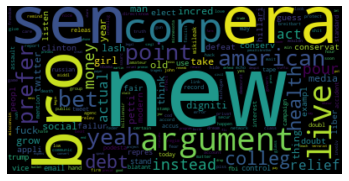

Topic: 0 Word: 0.007*"game" + 0.007*"like" + 0.006*"play" + 0.005*"peopl" + 0.005*"go" + 0.004*"leagu" + 0.004*"riot" + 0.004*"player" + 0.004*"lol" + 0.004*"think"
Topic: 1 Word: 0.008*"team" + 0.007*"play" + 0.007*"game" + 0.007*"think" + 0.005*"like" + 0.005*"get" + 0.005*"peopl" + 0.005*"know" + 0.005*"riot" + 0.004*"win"
doc :  0 [(0, 0.75041014), (1, 0.2495899)]
doc :  1 [(0, 0.03685714), (1, 0.9631429)]
doc :  2 [(0, 0.8277521), (1, 0.17224786)]
doc :  3 [(0, 0.2441016), (1, 0.7558984)]
doc :  4 [(0, 0.09067287), (1, 0.9093271)]
doc :  5 [(0, 0.40266466), (1, 0.5973354)]
doc :  6 [(0, 0.8833756), (1, 0.11662442)]
doc :  7 [(0, 0.8480134), (1, 0.1519866)]
doc :  8 [(0, 0.43621385), (1, 0.56378615)]
doc :  9 [(0, 0.18931615), (1, 0.8106839)]
doc :  10 [(0, 0.8918101), (1, 0.108189836)]
doc :  11 [(0, 0.24867994), (1, 0.75132006)]
doc :  12 [(0, 0.21907008), (1, 0.7809299)]
doc :  13 [(0, 0.19950135), (1, 0.8004986)]
doc :  14 [(0, 0.33492303), (1, 0.66507703)]
doc :  15 [(0, 0.791

doc :  335 [(0, 0.8587912), (1, 0.14120883)]
doc :  336 [(0, 0.23819908), (1, 0.76180094)]
doc :  337 [(0, 0.9619841), (1, 0.038015906)]
doc :  338 [(0, 0.9035502), (1, 0.096449785)]
doc :  339 [(0, 0.19642194), (1, 0.8035781)]
doc :  340 [(0, 0.13826527), (1, 0.86173475)]
doc :  341 [(0, 0.4058175), (1, 0.59418255)]
doc :  342 [(0, 0.21967699), (1, 0.78032297)]
doc :  343 [(0, 0.14171971), (1, 0.8582803)]
doc :  344 [(0, 0.2817284), (1, 0.7182717)]
doc :  345 [(0, 0.09668456), (1, 0.9033155)]
doc :  346 [(0, 0.19004205), (1, 0.8099579)]
doc :  347 [(0, 0.5), (1, 0.5)]
doc :  348 [(0, 0.03422789), (1, 0.96577215)]
doc :  349 [(0, 0.051432088), (1, 0.9485679)]
doc :  350 [(0, 0.912819), (1, 0.08718094)]
doc :  351 [(0, 0.8297229), (1, 0.17027709)]
doc :  352 [(0, 0.17121442), (1, 0.8287856)]
doc :  353 [(0, 0.8905102), (1, 0.109489866)]
doc :  354 [(0, 0.10437457), (1, 0.8956254)]
doc :  355 [(0, 0.52835375), (1, 0.47164625)]
doc :  356 [(0, 0.08553988), (1, 0.9144601)]
doc :  357 [(0, 

doc :  580 [(0, 0.7016935), (1, 0.29830652)]
doc :  581 [(0, 0.25502634), (1, 0.7449737)]
doc :  582 [(0, 0.9357368), (1, 0.064263225)]
doc :  583 [(0, 0.25534147), (1, 0.7446585)]
doc :  584 [(0, 0.48213187), (1, 0.51786816)]
doc :  585 [(0, 0.31488556), (1, 0.68511444)]
doc :  586 [(0, 0.42430663), (1, 0.57569337)]
doc :  587 [(0, 0.5391896), (1, 0.4608104)]
doc :  588 [(0, 0.8573443), (1, 0.14265564)]
doc :  589 [(0, 0.8601535), (1, 0.1398465)]
doc :  590 [(0, 0.7683457), (1, 0.23165433)]
doc :  591 [(0, 0.24358654), (1, 0.7564134)]
doc :  592 [(0, 0.1581204), (1, 0.84187955)]
doc :  593 [(0, 0.8556698), (1, 0.1443302)]
doc :  594 [(0, 0.19303927), (1, 0.80696076)]
doc :  595 [(0, 0.40498322), (1, 0.5950168)]
doc :  596 [(0, 0.9425818), (1, 0.05741824)]
doc :  597 [(0, 0.5203618), (1, 0.47963822)]
doc :  598 [(0, 0.42988616), (1, 0.57011384)]
doc :  599 [(0, 0.051564924), (1, 0.94843507)]
doc :  600 [(0, 0.8603063), (1, 0.13969366)]
doc :  601 [(0, 0.21975642), (1, 0.7802436)]
doc :

doc :  869 [(0, 0.23296358), (1, 0.7670364)]
doc :  870 [(0, 0.8662169), (1, 0.13378316)]
doc :  871 [(0, 0.19468231), (1, 0.8053177)]
doc :  872 [(0, 0.16438518), (1, 0.83561486)]
doc :  873 [(0, 0.88298017), (1, 0.117019795)]
doc :  874 [(0, 0.10164831), (1, 0.89835167)]
doc :  875 [(0, 0.8782839), (1, 0.121716045)]
doc :  876 [(0, 0.64582056), (1, 0.35417947)]
doc :  877 [(0, 0.12581043), (1, 0.87418956)]
doc :  878 [(0, 0.8128868), (1, 0.18711323)]
doc :  879 [(0, 0.2711246), (1, 0.7288754)]
doc :  880 [(0, 0.4353707), (1, 0.56462926)]
doc :  881 [(0, 0.78360397), (1, 0.216396)]
doc :  882 [(0, 0.26836976), (1, 0.7316302)]
doc :  883 [(0, 0.16187546), (1, 0.8381245)]
doc :  884 [(0, 0.7258929), (1, 0.27410704)]
doc :  885 [(0, 0.9753947), (1, 0.024605295)]
doc :  886 [(0, 0.89134383), (1, 0.108656175)]
doc :  887 [(0, 0.19326226), (1, 0.8067378)]
doc :  888 [(0, 0.17525037), (1, 0.82474965)]
doc :  889 [(0, 0.7769402), (1, 0.22305977)]
doc :  890 [(0, 0.8719717), (1, 0.12802824)]
d

doc :  1210 [(0, 0.8822106), (1, 0.11778937)]
doc :  1211 [(0, 0.16167489), (1, 0.83832514)]
doc :  1212 [(0, 0.68722165), (1, 0.31277832)]
doc :  1213 [(0, 0.20416895), (1, 0.7958311)]
doc :  1214 [(0, 0.29492688), (1, 0.7050731)]
doc :  1215 [(0, 0.8867374), (1, 0.11326261)]
doc :  1216 [(0, 0.93532944), (1, 0.06467059)]
doc :  1217 [(0, 0.71897024), (1, 0.2810298)]
doc :  1218 [(0, 0.9883166), (1, 0.0116834305)]
doc :  1219 [(0, 0.8020725), (1, 0.19792743)]
doc :  1220 [(0, 0.33108428), (1, 0.66891575)]
doc :  1221 [(0, 0.76681185), (1, 0.23318821)]
doc :  1222 [(0, 0.25201806), (1, 0.74798197)]
doc :  1223 [(0, 0.86829543), (1, 0.13170458)]
doc :  1224 [(0, 0.26473826), (1, 0.7352618)]
doc :  1225 [(0, 0.92777354), (1, 0.072226465)]
doc :  1226 [(0, 0.8180537), (1, 0.18194632)]
doc :  1227 [(0, 0.94520587), (1, 0.05479418)]
doc :  1228 [(0, 0.8560263), (1, 0.1439737)]
doc :  1229 [(0, 0.17448702), (1, 0.825513)]
doc :  1230 [(0, 0.355844), (1, 0.64415604)]
doc :  1231 [(0, 0.46327)

doc :  1542 [(0, 0.71396875), (1, 0.28603122)]
doc :  1543 [(0, 0.6584579), (1, 0.3415421)]
doc :  1544 [(0, 0.72749174), (1, 0.27250832)]
doc :  1545 [(0, 0.07308236), (1, 0.9269177)]
doc :  1546 [(0, 0.80422807), (1, 0.19577198)]
doc :  1547 [(0, 0.79882395), (1, 0.20117605)]
doc :  1548 [(0, 0.42278782), (1, 0.57721215)]
doc :  1549 [(0, 0.8113683), (1, 0.1886317)]
doc :  1550 [(0, 0.831613), (1, 0.16838697)]
doc :  1551 [(0, 0.25075594), (1, 0.74924403)]
doc :  1552 [(0, 0.2684248), (1, 0.7315752)]
doc :  1553 [(0, 0.91365796), (1, 0.08634199)]
doc :  1554 [(0, 0.7802357), (1, 0.21976432)]
doc :  1555 [(0, 0.67811376), (1, 0.3218862)]
doc :  1556 [(0, 0.32248336), (1, 0.67751664)]
doc :  1557 [(0, 0.69354343), (1, 0.30645657)]
doc :  1558 [(0, 0.49378732), (1, 0.50621265)]
doc :  1559 [(0, 0.77472556), (1, 0.22527446)]
doc :  1560 [(0, 0.102461316), (1, 0.8975387)]
doc :  1561 [(0, 0.5), (1, 0.5)]
doc :  1562 [(0, 0.7903385), (1, 0.20966148)]
doc :  1563 [(0, 0.21307978), (1, 0.786

doc :  1888 [(0, 0.6064539), (1, 0.39354613)]
doc :  1889 [(0, 0.74124897), (1, 0.25875103)]
doc :  1890 [(0, 0.13228595), (1, 0.86771405)]
doc :  1891 [(0, 0.15755555), (1, 0.8424444)]
doc :  1892 [(0, 0.80739474), (1, 0.19260526)]
doc :  1893 [(0, 0.16383696), (1, 0.836163)]
doc :  1894 [(0, 0.8019355), (1, 0.19806455)]
doc :  1895 [(0, 0.0638718), (1, 0.93612814)]
doc :  1896 [(0, 0.26780078), (1, 0.7321992)]
doc :  1897 [(0, 0.88990134), (1, 0.110098705)]
doc :  1898 [(0, 0.5), (1, 0.5)]
doc :  1899 [(0, 0.61611044), (1, 0.3838895)]
doc :  1900 [(0, 0.4375532), (1, 0.56244683)]
doc :  1901 [(0, 0.14469638), (1, 0.85530365)]
doc :  1902 [(0, 0.7209419), (1, 0.27905807)]
doc :  1903 [(0, 0.6158278), (1, 0.3841722)]
doc :  1904 [(0, 0.7670254), (1, 0.23297454)]
doc :  1905 [(0, 0.8030399), (1, 0.19696009)]
doc :  1906 [(0, 0.646377), (1, 0.353623)]
doc :  1907 [(0, 0.15259069), (1, 0.8474093)]
doc :  1908 [(0, 0.32554752), (1, 0.6744525)]
doc :  1909 [(0, 0.091671735), (1, 0.9083283)]

doc :  2183 [(0, 0.08697086), (1, 0.91302913)]
doc :  2184 [(0, 0.47024947), (1, 0.5297505)]
doc :  2185 [(0, 0.63377875), (1, 0.36622122)]
doc :  2186 [(0, 0.84738237), (1, 0.15261763)]
doc :  2187 [(0, 0.4323132), (1, 0.5676868)]
doc :  2188 [(0, 0.5), (1, 0.5)]
doc :  2189 [(0, 0.8192737), (1, 0.18072626)]
doc :  2190 [(0, 0.9135955), (1, 0.08640454)]
doc :  2191 [(0, 0.7244185), (1, 0.27558142)]
doc :  2192 [(0, 0.20652644), (1, 0.79347354)]
doc :  2193 [(0, 0.7219441), (1, 0.2780559)]
doc :  2194 [(0, 0.31720567), (1, 0.68279433)]
doc :  2195 [(0, 0.86532646), (1, 0.13467357)]
doc :  2196 [(0, 0.098352104), (1, 0.9016479)]
doc :  2197 [(0, 0.21325135), (1, 0.78674865)]
doc :  2198 [(0, 0.6975942), (1, 0.30240577)]
doc :  2199 [(0, 0.9070199), (1, 0.092980094)]
doc :  2200 [(0, 0.9043443), (1, 0.09565571)]
doc :  2201 [(0, 0.27811104), (1, 0.7218889)]
doc :  2202 [(0, 0.7181579), (1, 0.2818421)]
doc :  2203 [(0, 0.1405239), (1, 0.8594761)]
doc :  2204 [(0, 0.080591224), (1, 0.91940

doc :  2474 [(0, 0.17130403), (1, 0.82869595)]
doc :  2475 [(0, 0.2754571), (1, 0.72454286)]
doc :  2476 [(0, 0.097046725), (1, 0.90295327)]
doc :  2477 [(0, 0.9605501), (1, 0.0394499)]
doc :  2478 [(0, 0.3274629), (1, 0.6725371)]
doc :  2479 [(0, 0.92062896), (1, 0.07937098)]
doc :  2480 [(0, 0.27372319), (1, 0.7262768)]
doc :  2481 [(0, 0.787782), (1, 0.212218)]
doc :  2482 [(0, 0.40032917), (1, 0.5996708)]
doc :  2483 [(0, 0.72664297), (1, 0.27335703)]
doc :  2484 [(0, 0.067879185), (1, 0.9321208)]
doc :  2485 [(0, 0.5), (1, 0.5)]
doc :  2486 [(0, 0.93958604), (1, 0.06041396)]
doc :  2487 [(0, 0.14714472), (1, 0.85285527)]
doc :  2488 [(0, 0.9062765), (1, 0.09372353)]
doc :  2489 [(0, 0.5199199), (1, 0.48008007)]
doc :  2490 [(0, 0.8938522), (1, 0.10614782)]
doc :  2491 [(0, 0.20877405), (1, 0.7912259)]
doc :  2492 [(0, 0.5375281), (1, 0.46247196)]
doc :  2493 [(0, 0.32900825), (1, 0.6709917)]
doc :  2494 [(0, 0.76466167), (1, 0.23533837)]
doc :  2495 [(0, 0.16211098), (1, 0.8378891

doc :  2753 [(0, 0.71402997), (1, 0.28596997)]
doc :  2754 [(0, 0.15799281), (1, 0.84200716)]
doc :  2755 [(0, 0.70706797), (1, 0.29293206)]
doc :  2756 [(0, 0.9240327), (1, 0.075967364)]
doc :  2757 [(0, 0.07498391), (1, 0.92501605)]
doc :  2758 [(0, 0.7121078), (1, 0.28789222)]
doc :  2759 [(0, 0.30436468), (1, 0.6956353)]
doc :  2760 [(0, 0.38013667), (1, 0.6198634)]
doc :  2761 [(0, 0.21957324), (1, 0.7804268)]
doc :  2762 [(0, 0.18716303), (1, 0.812837)]
doc :  2763 [(0, 0.83348745), (1, 0.1665126)]
doc :  2764 [(0, 0.85571855), (1, 0.14428143)]
doc :  2765 [(0, 0.52634597), (1, 0.47365403)]
doc :  2766 [(0, 0.17378305), (1, 0.8262169)]
doc :  2767 [(0, 0.91316783), (1, 0.08683216)]
doc :  2768 [(0, 0.9657337), (1, 0.034266263)]
doc :  2769 [(0, 0.8076195), (1, 0.19238047)]
doc :  2770 [(0, 0.09744852), (1, 0.9025515)]
doc :  2771 [(0, 0.08183828), (1, 0.9181617)]
doc :  2772 [(0, 0.84367716), (1, 0.1563228)]
doc :  2773 [(0, 0.094734006), (1, 0.905266)]
doc :  2774 [(0, 0.2162668

doc :  3076 [(0, 0.3642667), (1, 0.6357333)]
doc :  3077 [(0, 0.05289576), (1, 0.9471043)]
doc :  3078 [(0, 0.21248536), (1, 0.7875146)]
doc :  3079 [(0, 0.68711203), (1, 0.3128879)]
doc :  3080 [(0, 0.85939765), (1, 0.14060232)]
doc :  3081 [(0, 0.36222956), (1, 0.6377704)]
doc :  3082 [(0, 0.16370104), (1, 0.836299)]
doc :  3083 [(0, 0.08755067), (1, 0.91244936)]
doc :  3084 [(0, 0.8975613), (1, 0.10243868)]
doc :  3085 [(0, 0.7885822), (1, 0.2114178)]
doc :  3086 [(0, 0.62489015), (1, 0.37510988)]
doc :  3087 [(0, 0.502074), (1, 0.49792597)]
doc :  3088 [(0, 0.6491007), (1, 0.3508993)]
doc :  3089 [(0, 0.11736918), (1, 0.8826308)]
doc :  3090 [(0, 0.87354887), (1, 0.12645115)]
doc :  3091 [(0, 0.2129679), (1, 0.7870321)]
doc :  3092 [(0, 0.50155413), (1, 0.4984459)]
doc :  3093 [(0, 0.07986572), (1, 0.9201343)]
doc :  3094 [(0, 0.11704434), (1, 0.8829556)]
doc :  3095 [(0, 0.123699725), (1, 0.8763003)]
doc :  3096 [(0, 0.63602424), (1, 0.3639757)]
doc :  3097 [(0, 0.010563083), (1, 

doc :  3350 [(0, 0.109596476), (1, 0.8904035)]
doc :  3351 [(0, 0.909638), (1, 0.09036207)]
doc :  3352 [(0, 0.17027996), (1, 0.8297201)]
doc :  3353 [(0, 0.89928985), (1, 0.10071014)]
doc :  3354 [(0, 0.79636025), (1, 0.20363979)]
doc :  3355 [(0, 0.81564), (1, 0.1843601)]
doc :  3356 [(0, 0.3623078), (1, 0.6376922)]
doc :  3357 [(0, 0.09545732), (1, 0.9045427)]
doc :  3358 [(0, 0.70942813), (1, 0.29057184)]
doc :  3359 [(0, 0.10843981), (1, 0.8915602)]
doc :  3360 [(0, 0.4856333), (1, 0.5143667)]
doc :  3361 [(0, 0.72343034), (1, 0.27656972)]
doc :  3362 [(0, 0.041006923), (1, 0.9589931)]
doc :  3363 [(0, 0.93192565), (1, 0.06807433)]
doc :  3364 [(0, 0.21113615), (1, 0.78886384)]
doc :  3365 [(0, 0.32870454), (1, 0.67129546)]
doc :  3366 [(0, 0.13134606), (1, 0.8686539)]
doc :  3367 [(0, 0.31098816), (1, 0.6890118)]
doc :  3368 [(0, 0.28618425), (1, 0.7138157)]
doc :  3369 [(0, 0.099178605), (1, 0.9008214)]
doc :  3370 [(0, 0.20020808), (1, 0.79979193)]
doc :  3371 [(0, 0.7274679), 

doc :  3630 [(0, 0.110263914), (1, 0.88973606)]
doc :  3631 [(0, 0.14380153), (1, 0.85619843)]
doc :  3632 [(0, 0.7894931), (1, 0.2105069)]
doc :  3633 [(0, 0.21795629), (1, 0.7820437)]
doc :  3634 [(0, 0.8517185), (1, 0.14828148)]
doc :  3635 [(0, 0.7600725), (1, 0.23992746)]
doc :  3636 [(0, 0.20021787), (1, 0.79978216)]
doc :  3637 [(0, 0.23975646), (1, 0.76024354)]
doc :  3638 [(0, 0.07344161), (1, 0.92655843)]
doc :  3639 [(0, 0.08841534), (1, 0.9115847)]
doc :  3640 [(0, 0.043000974), (1, 0.95699906)]
doc :  3641 [(0, 0.14412582), (1, 0.8558742)]
doc :  3642 [(0, 0.87219816), (1, 0.12780185)]
doc :  3643 [(0, 0.20155238), (1, 0.7984476)]
doc :  3644 [(0, 0.17806104), (1, 0.821939)]
doc :  3645 [(0, 0.22397445), (1, 0.77602553)]
doc :  3646 [(0, 0.8772582), (1, 0.12274185)]
doc :  3647 [(0, 0.418462), (1, 0.58153796)]
doc :  3648 [(0, 0.7061029), (1, 0.2938971)]
doc :  3649 [(0, 0.79118425), (1, 0.20881578)]
doc :  3650 [(0, 0.18163368), (1, 0.81836635)]
doc :  3651 [(0, 0.4295464

doc :  3942 [(0, 0.16662171), (1, 0.8333783)]
doc :  3943 [(0, 0.06502898), (1, 0.93497103)]
doc :  3944 [(0, 0.9587008), (1, 0.041299243)]
doc :  3945 [(0, 0.50035197), (1, 0.499648)]
doc :  3946 [(0, 0.5), (1, 0.5)]
doc :  3947 [(0, 0.16521896), (1, 0.83478105)]
doc :  3948 [(0, 0.43946266), (1, 0.5605374)]
doc :  3949 [(0, 0.83771974), (1, 0.16228026)]
doc :  3950 [(0, 0.055865165), (1, 0.9441349)]
doc :  3951 [(0, 0.8777221), (1, 0.12227792)]
doc :  3952 [(0, 0.11823255), (1, 0.88176745)]
doc :  3953 [(0, 0.08784423), (1, 0.91215575)]
doc :  3954 [(0, 0.71388733), (1, 0.2861126)]
doc :  3955 [(0, 0.3581041), (1, 0.6418959)]
doc :  3956 [(0, 0.31737408), (1, 0.6826259)]
doc :  3957 [(0, 0.45054984), (1, 0.54945016)]
doc :  3958 [(0, 0.23373067), (1, 0.7662693)]
doc :  3959 [(0, 0.58980554), (1, 0.41019452)]
doc :  3960 [(0, 0.11923462), (1, 0.8807654)]
doc :  3961 [(0, 0.7073307), (1, 0.29266933)]
doc :  3962 [(0, 0.8217876), (1, 0.17821243)]
doc :  3963 [(0, 0.8283832), (1, 0.17161

doc :  4266 [(0, 0.5), (1, 0.5)]
doc :  4267 [(0, 0.06697167), (1, 0.93302834)]
doc :  4268 [(0, 0.9207888), (1, 0.07921115)]
doc :  4269 [(0, 0.2992554), (1, 0.7007446)]
doc :  4270 [(0, 0.3464334), (1, 0.6535666)]
doc :  4271 [(0, 0.15628487), (1, 0.84371513)]
doc :  4272 [(0, 0.21108884), (1, 0.78891116)]
doc :  4273 [(0, 0.28881416), (1, 0.7111859)]
doc :  4274 [(0, 0.4240033), (1, 0.57599664)]
doc :  4275 [(0, 0.8787791), (1, 0.12122087)]
doc :  4276 [(0, 0.8262811), (1, 0.17371896)]
doc :  4277 [(0, 0.6802667), (1, 0.31973332)]
doc :  4278 [(0, 0.8549791), (1, 0.14502089)]
doc :  4279 [(0, 0.3719468), (1, 0.6280532)]
doc :  4280 [(0, 0.17825574), (1, 0.82174426)]
doc :  4281 [(0, 0.7917882), (1, 0.20821175)]
doc :  4282 [(0, 0.1206876), (1, 0.87931234)]
doc :  4283 [(0, 0.26201963), (1, 0.73798037)]
doc :  4284 [(0, 0.38176927), (1, 0.61823076)]
doc :  4285 [(0, 0.8054975), (1, 0.19450241)]
doc :  4286 [(0, 0.054200407), (1, 0.94579965)]
doc :  4287 [(0, 0.7821458), (1, 0.2178542

doc :  4599 [(0, 0.2044286), (1, 0.7955714)]
doc :  4600 [(0, 0.7823111), (1, 0.21768889)]
doc :  4601 [(0, 0.79840386), (1, 0.20159619)]
doc :  4602 [(0, 0.5815773), (1, 0.41842276)]
doc :  4603 [(0, 0.045348603), (1, 0.9546514)]
doc :  4604 [(0, 0.9263152), (1, 0.07368476)]
doc :  4605 [(0, 0.027137464), (1, 0.97286254)]
doc :  4606 [(0, 0.8672293), (1, 0.13277073)]
doc :  4607 [(0, 0.354898), (1, 0.645102)]
doc :  4608 [(0, 0.86865693), (1, 0.13134313)]
doc :  4609 [(0, 0.96530795), (1, 0.03469203)]
doc :  4610 [(0, 0.2672684), (1, 0.7327316)]
doc :  4611 [(0, 0.9653272), (1, 0.034672834)]
doc :  4612 [(0, 0.086397044), (1, 0.913603)]
doc :  4613 [(0, 0.103649646), (1, 0.8963503)]
doc :  4614 [(0, 0.96368855), (1, 0.036311455)]
doc :  4615 [(0, 0.27455756), (1, 0.7254424)]
doc :  4616 [(0, 0.21823621), (1, 0.7817638)]
doc :  4617 [(0, 0.8873025), (1, 0.1126975)]
doc :  4618 [(0, 0.20648828), (1, 0.79351175)]
doc :  4619 [(0, 0.06854257), (1, 0.93145746)]
doc :  4620 [(0, 0.15786365)

doc :  4922 [(0, 0.78170156), (1, 0.21829839)]
doc :  4923 [(0, 0.7263628), (1, 0.27363718)]
doc :  4924 [(0, 0.10563598), (1, 0.894364)]
doc :  4925 [(0, 0.103980705), (1, 0.8960193)]
doc :  4926 [(0, 0.92826724), (1, 0.07173276)]
doc :  4927 [(0, 0.9491227), (1, 0.050877243)]
doc :  4928 [(0, 0.5426796), (1, 0.4573204)]
doc :  4929 [(0, 0.65590155), (1, 0.34409845)]
doc :  4930 [(0, 0.85573083), (1, 0.14426918)]
doc :  4931 [(0, 0.7403551), (1, 0.25964493)]
doc :  4932 [(0, 0.15801263), (1, 0.8419874)]
doc :  4933 [(0, 0.7632867), (1, 0.23671329)]
doc :  4934 [(0, 0.22809494), (1, 0.77190506)]
doc :  4935 [(0, 0.17531572), (1, 0.82468426)]
doc :  4936 [(0, 0.8239817), (1, 0.1760183)]
doc :  4937 [(0, 0.93716675), (1, 0.0628332)]
doc :  4938 [(0, 0.673144), (1, 0.326856)]
doc :  4939 [(0, 0.8056903), (1, 0.19430974)]
doc :  4940 [(0, 0.6141022), (1, 0.38589785)]
doc :  4941 [(0, 0.18524452), (1, 0.8147555)]
doc :  4942 [(0, 0.7584375), (1, 0.24156244)]
doc :  4943 [(0, 0.5947157), (1,

doc :  5250 [(0, 0.20668305), (1, 0.79331696)]
doc :  5251 [(0, 0.52513975), (1, 0.47486028)]
doc :  5252 [(0, 0.086089686), (1, 0.9139103)]
doc :  5253 [(0, 0.22995439), (1, 0.7700456)]
doc :  5254 [(0, 0.16368212), (1, 0.8363179)]
doc :  5255 [(0, 0.8950264), (1, 0.10497365)]
doc :  5256 [(0, 0.22535501), (1, 0.77464503)]
doc :  5257 [(0, 0.19226617), (1, 0.8077339)]
doc :  5258 [(0, 0.35485741), (1, 0.6451426)]
doc :  5259 [(0, 0.8823665), (1, 0.11763346)]
doc :  5260 [(0, 0.7458377), (1, 0.25416222)]
doc :  5261 [(0, 0.16373855), (1, 0.83626145)]
doc :  5262 [(0, 0.48034507), (1, 0.519655)]
doc :  5263 [(0, 0.923578), (1, 0.07642197)]
doc :  5264 [(0, 0.7652145), (1, 0.2347855)]
doc :  5265 [(0, 0.8785988), (1, 0.121401146)]
doc :  5266 [(0, 0.53871363), (1, 0.46128637)]
doc :  5267 [(0, 0.7785364), (1, 0.22146355)]
doc :  5268 [(0, 0.62014997), (1, 0.37985006)]
doc :  5269 [(0, 0.8558609), (1, 0.1441391)]
doc :  5270 [(0, 0.4870108), (1, 0.51298916)]
doc :  5271 [(0, 0.6762628), (

doc :  5604 [(0, 0.35420465), (1, 0.64579535)]
doc :  5605 [(0, 0.15955588), (1, 0.84044415)]
doc :  5606 [(0, 0.12594053), (1, 0.8740595)]
doc :  5607 [(0, 0.15768072), (1, 0.84231925)]
doc :  5608 [(0, 0.35621485), (1, 0.6437852)]
doc :  5609 [(0, 0.21509168), (1, 0.78490835)]
doc :  5610 [(0, 0.14518966), (1, 0.85481036)]
doc :  5611 [(0, 0.8185911), (1, 0.18140891)]
doc :  5612 [(0, 0.82844234), (1, 0.17155765)]
doc :  5613 [(0, 0.35491496), (1, 0.64508504)]
doc :  5614 [(0, 0.11657181), (1, 0.8834282)]
doc :  5615 [(0, 0.6139607), (1, 0.38603935)]
doc :  5616 [(0, 0.95806533), (1, 0.04193471)]
doc :  5617 [(0, 0.3938202), (1, 0.6061798)]
doc :  5618 [(0, 0.7845755), (1, 0.21542446)]
doc :  5619 [(0, 0.20405957), (1, 0.79594046)]
doc :  5620 [(0, 0.7834798), (1, 0.21652022)]
doc :  5621 [(0, 0.5), (1, 0.5)]
doc :  5622 [(0, 0.6604585), (1, 0.33954144)]
doc :  5623 [(0, 0.1258849), (1, 0.8741151)]
doc :  5624 [(0, 0.31224534), (1, 0.6877547)]
doc :  5625 [(0, 0.5484529), (1, 0.45154

doc :  5906 [(0, 0.077948205), (1, 0.9220518)]
doc :  5907 [(0, 0.78852767), (1, 0.2114723)]
doc :  5908 [(0, 0.7857777), (1, 0.21422233)]
doc :  5909 [(0, 0.7959547), (1, 0.20404527)]
doc :  5910 [(0, 0.73815316), (1, 0.26184687)]
doc :  5911 [(0, 0.76092917), (1, 0.2390708)]
doc :  5912 [(0, 0.17562692), (1, 0.82437307)]
doc :  5913 [(0, 0.1241434), (1, 0.8758566)]
doc :  5914 [(0, 0.7960628), (1, 0.20393717)]
doc :  5915 [(0, 0.16535163), (1, 0.8346484)]
doc :  5916 [(0, 0.80406266), (1, 0.19593732)]
doc :  5917 [(0, 0.5283829), (1, 0.47161707)]
doc :  5918 [(0, 0.8873343), (1, 0.11266573)]
doc :  5919 [(0, 0.25709736), (1, 0.74290264)]
doc :  5920 [(0, 0.34882087), (1, 0.6511791)]
doc :  5921 [(0, 0.43770367), (1, 0.56229633)]
doc :  5922 [(0, 0.91258055), (1, 0.0874195)]
doc :  5923 [(0, 0.054387625), (1, 0.9456124)]
doc :  5924 [(0, 0.871189), (1, 0.12881099)]
doc :  5925 [(0, 0.1660993), (1, 0.8339007)]
doc :  5926 [(0, 0.2898835), (1, 0.7101165)]
doc :  5927 [(0, 0.19691512), (

doc :  6231 [(0, 0.9052451), (1, 0.09475487)]
doc :  6232 [(0, 0.77151483), (1, 0.22848514)]
doc :  6233 [(0, 0.14530455), (1, 0.85469544)]
doc :  6234 [(0, 0.1834169), (1, 0.81658304)]
doc :  6235 [(0, 0.21530005), (1, 0.7846999)]
doc :  6236 [(0, 0.96878743), (1, 0.031212531)]
doc :  6237 [(0, 0.31660008), (1, 0.6833999)]
doc :  6238 [(0, 0.78198797), (1, 0.21801199)]
doc :  6239 [(0, 0.18541066), (1, 0.8145893)]
doc :  6240 [(0, 0.9155465), (1, 0.08445358)]
doc :  6241 [(0, 0.60415155), (1, 0.39584842)]
doc :  6242 [(0, 0.92502487), (1, 0.07497514)]
doc :  6243 [(0, 0.3309223), (1, 0.6690777)]
doc :  6244 [(0, 0.719436), (1, 0.280564)]
doc :  6245 [(0, 0.6707476), (1, 0.3292524)]
doc :  6246 [(0, 0.6931238), (1, 0.30687618)]
doc :  6247 [(0, 0.8585022), (1, 0.14149782)]
doc :  6248 [(0, 0.8309583), (1, 0.1690417)]
doc :  6249 [(0, 0.639858), (1, 0.360142)]
doc :  6250 [(0, 0.92618746), (1, 0.07381257)]
doc :  6251 [(0, 0.75123644), (1, 0.24876358)]
doc :  6252 [(0, 0.18098703), (1, 

doc :  6510 [(0, 0.53664935), (1, 0.46335062)]
doc :  6511 [(0, 0.85022706), (1, 0.1497729)]
doc :  6512 [(0, 0.028432548), (1, 0.97156745)]
doc :  6513 [(0, 0.22260159), (1, 0.7773984)]
doc :  6514 [(0, 0.2270045), (1, 0.77299553)]
doc :  6515 [(0, 0.15834305), (1, 0.841657)]
doc :  6516 [(0, 0.61349535), (1, 0.38650465)]
doc :  6517 [(0, 0.838173), (1, 0.16182704)]
doc :  6518 [(0, 0.7055254), (1, 0.29447463)]
doc :  6519 [(0, 0.26004764), (1, 0.7399524)]
doc :  6520 [(0, 0.03763627), (1, 0.9623637)]
doc :  6521 [(0, 0.5), (1, 0.5)]
doc :  6522 [(0, 0.83308697), (1, 0.16691303)]
doc :  6523 [(0, 0.91715926), (1, 0.08284081)]
doc :  6524 [(0, 0.039642796), (1, 0.96035725)]
doc :  6525 [(0, 0.28039563), (1, 0.7196044)]
doc :  6526 [(0, 0.83717716), (1, 0.16282287)]
doc :  6527 [(0, 0.21553616), (1, 0.7844639)]
doc :  6528 [(0, 0.16816793), (1, 0.83183205)]
doc :  6529 [(0, 0.81840396), (1, 0.18159603)]
doc :  6530 [(0, 0.88790256), (1, 0.11209743)]
doc :  6531 [(0, 0.15132828), (1, 0.8

doc :  6803 [(0, 0.93471307), (1, 0.06528691)]
doc :  6804 [(0, 0.13302284), (1, 0.86697716)]
doc :  6805 [(0, 0.15097563), (1, 0.8490244)]
doc :  6806 [(0, 0.22931819), (1, 0.7706818)]
doc :  6807 [(0, 0.12126755), (1, 0.87873244)]
doc :  6808 [(0, 0.07463544), (1, 0.92536455)]
doc :  6809 [(0, 0.676231), (1, 0.32376894)]
doc :  6810 [(0, 0.63648856), (1, 0.36351138)]
doc :  6811 [(0, 0.5), (1, 0.5)]
doc :  6812 [(0, 0.90936637), (1, 0.0906336)]
doc :  6813 [(0, 0.08068014), (1, 0.9193198)]
doc :  6814 [(0, 0.17563516), (1, 0.82436484)]
doc :  6815 [(0, 0.84855074), (1, 0.15144926)]
doc :  6816 [(0, 0.16647772), (1, 0.83352226)]
doc :  6817 [(0, 0.23174033), (1, 0.7682597)]
doc :  6818 [(0, 0.30851644), (1, 0.69148356)]
doc :  6819 [(0, 0.5), (1, 0.5)]
doc :  6820 [(0, 0.56328905), (1, 0.43671092)]
doc :  6821 [(0, 0.23467234), (1, 0.7653277)]
doc :  6822 [(0, 0.052993473), (1, 0.94700646)]
doc :  6823 [(0, 0.3096183), (1, 0.6903817)]
doc :  6824 [(0, 0.23880698), (1, 0.76119304)]
doc

doc :  7082 [(0, 0.07355659), (1, 0.9264434)]
doc :  7083 [(0, 0.93869215), (1, 0.06130787)]
doc :  7084 [(0, 0.12003644), (1, 0.8799635)]
doc :  7085 [(0, 0.83637154), (1, 0.16362847)]
doc :  7086 [(0, 0.9585801), (1, 0.04141994)]
doc :  7087 [(0, 0.9562252), (1, 0.04377484)]
doc :  7088 [(0, 0.84579337), (1, 0.15420666)]
doc :  7089 [(0, 0.5465744), (1, 0.45342556)]
doc :  7090 [(0, 0.08015229), (1, 0.91984767)]
doc :  7091 [(0, 0.5), (1, 0.5)]
doc :  7092 [(0, 0.29923388), (1, 0.70076615)]
doc :  7093 [(0, 0.8881556), (1, 0.11184436)]
doc :  7094 [(0, 0.10270182), (1, 0.89729816)]
doc :  7095 [(0, 0.9528991), (1, 0.04710093)]
doc :  7096 [(0, 0.8664257), (1, 0.13357435)]
doc :  7097 [(0, 0.90189946), (1, 0.09810051)]
doc :  7098 [(0, 0.41793904), (1, 0.58206093)]
doc :  7099 [(0, 0.22759865), (1, 0.77240133)]
doc :  7100 [(0, 0.17658342), (1, 0.8234166)]
doc :  7101 [(0, 0.23671593), (1, 0.7632841)]
doc :  7102 [(0, 0.8254461), (1, 0.1745539)]
doc :  7103 [(0, 0.9314798), (1, 0.0685

doc :  7381 [(0, 0.33704832), (1, 0.66295165)]
doc :  7382 [(0, 0.5262144), (1, 0.4737856)]
doc :  7383 [(0, 0.17342901), (1, 0.826571)]
doc :  7384 [(0, 0.11538704), (1, 0.8846129)]
doc :  7385 [(0, 0.29498914), (1, 0.70501083)]
doc :  7386 [(0, 0.55474025), (1, 0.44525975)]
doc :  7387 [(0, 0.7941731), (1, 0.20582691)]
doc :  7388 [(0, 0.62276495), (1, 0.37723505)]
doc :  7389 [(0, 0.3995104), (1, 0.60048956)]
doc :  7390 [(0, 0.12863664), (1, 0.87136334)]
doc :  7391 [(0, 0.73603624), (1, 0.2639638)]
doc :  7392 [(0, 0.20663564), (1, 0.79336435)]
doc :  7393 [(0, 0.8189488), (1, 0.18105122)]
doc :  7394 [(0, 0.88186973), (1, 0.11813027)]
doc :  7395 [(0, 0.23331541), (1, 0.76668465)]
doc :  7396 [(0, 0.15387262), (1, 0.8461274)]
doc :  7397 [(0, 0.7910242), (1, 0.20897572)]
doc :  7398 [(0, 0.56578803), (1, 0.43421194)]
doc :  7399 [(0, 0.6997312), (1, 0.3002688)]
doc :  7400 [(0, 0.17314722), (1, 0.8268528)]
doc :  7401 [(0, 0.347594), (1, 0.65240604)]
doc :  7402 [(0, 0.7934251), 

doc :  7714 [(0, 0.10651805), (1, 0.8934819)]
doc :  7715 [(0, 0.39797807), (1, 0.60202193)]
doc :  7716 [(0, 0.14372754), (1, 0.8562724)]
doc :  7717 [(0, 0.1573526), (1, 0.8426474)]
doc :  7718 [(0, 0.4658639), (1, 0.53413606)]
doc :  7719 [(0, 0.6090552), (1, 0.39094475)]
doc :  7720 [(0, 0.4085717), (1, 0.59142834)]
doc :  7721 [(0, 0.22157238), (1, 0.7784276)]
doc :  7722 [(0, 0.46304703), (1, 0.536953)]
doc :  7723 [(0, 0.3596193), (1, 0.64038074)]
doc :  7724 [(0, 0.75740546), (1, 0.24259453)]
doc :  7725 [(0, 0.59989566), (1, 0.40010434)]
doc :  7726 [(0, 0.90729874), (1, 0.09270125)]
doc :  7727 [(0, 0.15112124), (1, 0.8488788)]
doc :  7728 [(0, 0.68143463), (1, 0.3185654)]
doc :  7729 [(0, 0.17010038), (1, 0.8298996)]
doc :  7730 [(0, 0.7339441), (1, 0.26605585)]
doc :  7731 [(0, 0.72480136), (1, 0.2751986)]
doc :  7732 [(0, 0.4023118), (1, 0.5976882)]
doc :  7733 [(0, 0.988746), (1, 0.0112540005)]
doc :  7734 [(0, 0.5122746), (1, 0.48772535)]
doc :  7735 [(0, 0.2983447), (1,

doc :  8090 [(0, 0.9572051), (1, 0.042794906)]
doc :  8091 [(0, 0.50549066), (1, 0.49450934)]
doc :  8092 [(0, 0.22501954), (1, 0.7749805)]
doc :  8093 [(0, 0.5448617), (1, 0.4551383)]
doc :  8094 [(0, 0.30019626), (1, 0.69980377)]
doc :  8095 [(0, 0.08590859), (1, 0.9140914)]
doc :  8096 [(0, 0.9220481), (1, 0.07795192)]
doc :  8097 [(0, 0.67314935), (1, 0.32685065)]
doc :  8098 [(0, 0.12795801), (1, 0.872042)]
doc :  8099 [(0, 0.71572435), (1, 0.28427568)]
doc :  8100 [(0, 0.13360403), (1, 0.86639595)]
doc :  8101 [(0, 0.6484424), (1, 0.35155764)]
doc :  8102 [(0, 0.7569919), (1, 0.24300809)]
doc :  8103 [(0, 0.8016143), (1, 0.19838573)]
doc :  8104 [(0, 0.9806488), (1, 0.01935119)]
doc :  8105 [(0, 0.8757701), (1, 0.12422993)]
doc :  8106 [(0, 0.13596578), (1, 0.8640343)]
doc :  8107 [(0, 0.047864124), (1, 0.9521359)]
doc :  8108 [(0, 0.8890087), (1, 0.11099129)]
doc :  8109 [(0, 0.7675334), (1, 0.23246653)]
doc :  8110 [(0, 0.16579837), (1, 0.83420163)]
doc :  8111 [(0, 0.7801877),

doc :  8393 [(0, 0.7493896), (1, 0.2506104)]
doc :  8394 [(0, 0.26367167), (1, 0.7363283)]
doc :  8395 [(0, 0.24633636), (1, 0.75366366)]
doc :  8396 [(0, 0.8540098), (1, 0.14599015)]
doc :  8397 [(0, 0.9188155), (1, 0.08118453)]
doc :  8398 [(0, 0.41102123), (1, 0.5889788)]
doc :  8399 [(0, 0.12619066), (1, 0.87380934)]
doc :  8400 [(0, 0.2276128), (1, 0.7723872)]
doc :  8401 [(0, 0.094129965), (1, 0.90587)]
doc :  8402 [(0, 0.5), (1, 0.5)]
doc :  8403 [(0, 0.15402377), (1, 0.84597623)]
doc :  8404 [(0, 0.39790967), (1, 0.60209036)]
doc :  8405 [(0, 0.47254935), (1, 0.5274506)]
doc :  8406 [(0, 0.7259217), (1, 0.2740783)]
doc :  8407 [(0, 0.84017056), (1, 0.15982942)]
doc :  8408 [(0, 0.76108634), (1, 0.23891364)]
doc :  8409 [(0, 0.7166923), (1, 0.2833076)]
doc :  8410 [(0, 0.45840934), (1, 0.54159063)]
doc :  8411 [(0, 0.3293492), (1, 0.6706508)]
doc :  8412 [(0, 0.82312155), (1, 0.17687842)]
doc :  8413 [(0, 0.07071544), (1, 0.9292846)]
doc :  8414 [(0, 0.6545379), (1, 0.34546205)]

doc :  8715 [(0, 0.28218937), (1, 0.71781063)]
doc :  8716 [(0, 0.8072514), (1, 0.19274868)]
doc :  8717 [(0, 0.15378499), (1, 0.846215)]
doc :  8718 [(0, 0.05308984), (1, 0.94691014)]
doc :  8719 [(0, 0.5), (1, 0.5)]
doc :  8720 [(0, 0.86636865), (1, 0.13363133)]
doc :  8721 [(0, 0.8276819), (1, 0.17231807)]
doc :  8722 [(0, 0.27710235), (1, 0.7228977)]
doc :  8723 [(0, 0.15600906), (1, 0.843991)]
doc :  8724 [(0, 0.79663795), (1, 0.20336203)]
doc :  8725 [(0, 0.81014645), (1, 0.18985356)]
doc :  8726 [(0, 0.78209555), (1, 0.21790445)]
doc :  8727 [(0, 0.73288953), (1, 0.2671104)]
doc :  8728 [(0, 0.10799506), (1, 0.89200497)]
doc :  8729 [(0, 0.18288714), (1, 0.81711286)]
doc :  8730 [(0, 0.17337002), (1, 0.82663)]
doc :  8731 [(0, 0.6515325), (1, 0.3484675)]
doc :  8732 [(0, 0.21173559), (1, 0.7882644)]
doc :  8733 [(0, 0.32253394), (1, 0.67746603)]
doc :  8734 [(0, 0.5), (1, 0.5)]
doc :  8735 [(0, 0.7926805), (1, 0.2073195)]
doc :  8736 [(0, 0.83791417), (1, 0.1620858)]
doc :  8737

doc :  9030 [(0, 0.7778557), (1, 0.22214434)]
doc :  9031 [(0, 0.04955901), (1, 0.950441)]
doc :  9032 [(0, 0.47837836), (1, 0.5216217)]
doc :  9033 [(0, 0.84805644), (1, 0.15194364)]
doc :  9034 [(0, 0.771175), (1, 0.22882503)]
doc :  9035 [(0, 0.22570938), (1, 0.7742906)]
doc :  9036 [(0, 0.8388231), (1, 0.16117689)]
doc :  9037 [(0, 0.0725032), (1, 0.9274968)]
doc :  9038 [(0, 0.6773404), (1, 0.32265967)]
doc :  9039 [(0, 0.96815544), (1, 0.031844564)]
doc :  9040 [(0, 0.838107), (1, 0.16189305)]
doc :  9041 [(0, 0.08142219), (1, 0.9185778)]
doc :  9042 [(0, 0.8144362), (1, 0.18556383)]
doc :  9043 [(0, 0.70059437), (1, 0.29940563)]
doc :  9044 [(0, 0.04402243), (1, 0.9559776)]
doc :  9045 [(0, 0.87957186), (1, 0.12042812)]
doc :  9046 [(0, 0.597474), (1, 0.40252602)]
doc :  9047 [(0, 0.9195119), (1, 0.08048816)]
doc :  9048 [(0, 0.8001064), (1, 0.19989364)]
doc :  9049 [(0, 0.90855664), (1, 0.09144337)]
doc :  9050 [(0, 0.83893883), (1, 0.16106115)]
doc :  9051 [(0, 0.5), (1, 0.5)]

doc :  9396 [(0, 0.8740498), (1, 0.12595026)]
doc :  9397 [(0, 0.19792482), (1, 0.80207515)]
doc :  9398 [(0, 0.81670636), (1, 0.18329364)]
doc :  9399 [(0, 0.404835), (1, 0.595165)]
doc :  9400 [(0, 0.5), (1, 0.5)]
doc :  9401 [(0, 0.09228866), (1, 0.9077114)]
doc :  9402 [(0, 0.7019576), (1, 0.2980424)]
doc :  9403 [(0, 0.08617771), (1, 0.9138223)]
doc :  9404 [(0, 0.86238396), (1, 0.13761608)]
doc :  9405 [(0, 0.94918555), (1, 0.050814413)]
doc :  9406 [(0, 0.7465521), (1, 0.25344786)]
doc :  9407 [(0, 0.29575977), (1, 0.70424026)]
doc :  9408 [(0, 0.26518956), (1, 0.7348104)]
doc :  9409 [(0, 0.37990123), (1, 0.6200987)]
doc :  9410 [(0, 0.19137709), (1, 0.80862284)]
doc :  9411 [(0, 0.770924), (1, 0.22907597)]
doc :  9412 [(0, 0.30587894), (1, 0.694121)]
doc :  9413 [(0, 0.9000239), (1, 0.0999761)]
doc :  9414 [(0, 0.1477225), (1, 0.85227746)]
doc :  9415 [(0, 0.6832527), (1, 0.3167473)]
doc :  9416 [(0, 0.5), (1, 0.5)]
doc :  9417 [(0, 0.18101539), (1, 0.81898457)]
doc :  9418 [(

doc :  9679 [(0, 0.086341254), (1, 0.9136588)]
doc :  9680 [(0, 0.46000633), (1, 0.53999364)]
doc :  9681 [(0, 0.063840255), (1, 0.93615973)]
doc :  9682 [(0, 0.8390775), (1, 0.16092254)]
doc :  9683 [(0, 0.66084754), (1, 0.33915243)]
doc :  9684 [(0, 0.8158205), (1, 0.18417948)]
doc :  9685 [(0, 0.036792535), (1, 0.9632075)]
doc :  9686 [(0, 0.87177074), (1, 0.12822925)]
doc :  9687 [(0, 0.82953787), (1, 0.17046209)]
doc :  9688 [(0, 0.15735734), (1, 0.8426427)]
doc :  9689 [(0, 0.42090648), (1, 0.5790935)]
doc :  9690 [(0, 0.7765942), (1, 0.22340575)]
doc :  9691 [(0, 0.5), (1, 0.5)]
doc :  9692 [(0, 0.057684693), (1, 0.9423153)]
doc :  9693 [(0, 0.14829746), (1, 0.8517025)]
doc :  9694 [(0, 0.15423432), (1, 0.84576565)]
doc :  9695 [(0, 0.93932354), (1, 0.06067644)]
doc :  9696 [(0, 0.22645468), (1, 0.7735453)]
doc :  9697 [(0, 0.6105108), (1, 0.38948917)]
doc :  9698 [(0, 0.8585729), (1, 0.14142708)]
doc :  9699 [(0, 0.8851147), (1, 0.11488527)]
doc :  9700 [(0, 0.3138437), (1, 0.6

doc :  9980 [(0, 0.45400298), (1, 0.545997)]
doc :  9981 [(0, 0.053154636), (1, 0.9468454)]
doc :  9982 [(0, 0.7351007), (1, 0.26489928)]
doc :  9983 [(0, 0.8464478), (1, 0.15355217)]
doc :  9984 [(0, 0.13806984), (1, 0.86193013)]
doc :  9985 [(0, 0.31078488), (1, 0.6892151)]
doc :  9986 [(0, 0.2696047), (1, 0.7303953)]
doc :  9987 [(0, 0.13491876), (1, 0.8650812)]
doc :  9988 [(0, 0.6557539), (1, 0.3442461)]
doc :  9989 [(0, 0.9117288), (1, 0.088271156)]
doc :  9990 [(0, 0.7348382), (1, 0.2651618)]
doc :  9991 [(0, 0.20705391), (1, 0.7929461)]
doc :  9992 [(0, 0.11286617), (1, 0.88713384)]
doc :  9993 [(0, 0.84519076), (1, 0.15480927)]
doc :  9994 [(0, 0.9462569), (1, 0.053743117)]
doc :  9995 [(0, 0.97605294), (1, 0.023947088)]
doc :  9996 [(0, 0.82371706), (1, 0.17628293)]
doc :  9997 [(0, 0.2562784), (1, 0.7437216)]
doc :  9998 [(0, 0.83966), (1, 0.16033998)]
doc :  9999 [(0, 0.7715037), (1, 0.22849628)]
doc :  10000 [(0, 0.95979244), (1, 0.040207583)]
doc :  10001 [(0, 0.13768049)

doc :  10221 [(0, 0.14829694), (1, 0.85170305)]
doc :  10222 [(0, 0.1445157), (1, 0.8554843)]
doc :  10223 [(0, 0.92805654), (1, 0.071943514)]
doc :  10224 [(0, 0.62652206), (1, 0.37347797)]
doc :  10225 [(0, 0.7391507), (1, 0.26084924)]
doc :  10226 [(0, 0.63650507), (1, 0.363495)]
doc :  10227 [(0, 0.4825008), (1, 0.5174992)]
doc :  10228 [(0, 0.4139359), (1, 0.5860641)]
doc :  10229 [(0, 0.52597713), (1, 0.4740228)]
doc :  10230 [(0, 0.8522516), (1, 0.14774837)]
doc :  10231 [(0, 0.341418), (1, 0.65858203)]
doc :  10232 [(0, 0.72441286), (1, 0.27558714)]
doc :  10233 [(0, 0.7416508), (1, 0.25834918)]
doc :  10234 [(0, 0.08110698), (1, 0.91889304)]
doc :  10235 [(0, 0.22775546), (1, 0.7722445)]
doc :  10236 [(0, 0.07547711), (1, 0.9245229)]
doc :  10237 [(0, 0.70561755), (1, 0.29438242)]
doc :  10238 [(0, 0.9016454), (1, 0.098354615)]
doc :  10239 [(0, 0.26099986), (1, 0.73900014)]
doc :  10240 [(0, 0.5983735), (1, 0.40162647)]
doc :  10241 [(0, 0.83689606), (1, 0.16310394)]
doc :  1

doc :  10510 [(0, 0.090724275), (1, 0.9092757)]
doc :  10511 [(0, 0.7513478), (1, 0.24865223)]
doc :  10512 [(0, 0.12197948), (1, 0.87802047)]
doc :  10513 [(0, 0.27894378), (1, 0.7210563)]
doc :  10514 [(0, 0.17702809), (1, 0.82297194)]
doc :  10515 [(0, 0.89401007), (1, 0.10598993)]
doc :  10516 [(0, 0.13766427), (1, 0.8623357)]
doc :  10517 [(0, 0.35774264), (1, 0.64225733)]
doc :  10518 [(0, 0.41783187), (1, 0.5821681)]
doc :  10519 [(0, 0.8982252), (1, 0.101774804)]
doc :  10520 [(0, 0.10120054), (1, 0.8987994)]
doc :  10521 [(0, 0.8737281), (1, 0.12627187)]
doc :  10522 [(0, 0.45227337), (1, 0.5477267)]
doc :  10523 [(0, 0.40339833), (1, 0.59660167)]
doc :  10524 [(0, 0.1295407), (1, 0.8704593)]
doc :  10525 [(0, 0.50586843), (1, 0.49413154)]
doc :  10526 [(0, 0.20198242), (1, 0.79801756)]
doc :  10527 [(0, 0.3327452), (1, 0.6672548)]
doc :  10528 [(0, 0.28160873), (1, 0.71839124)]
doc :  10529 [(0, 0.7320519), (1, 0.2679481)]
doc :  10530 [(0, 0.16053753), (1, 0.83946246)]
doc :

doc :  10867 [(0, 0.5856398), (1, 0.4143602)]
doc :  10868 [(0, 0.099658325), (1, 0.9003417)]
doc :  10869 [(0, 0.8451544), (1, 0.15484563)]
doc :  10870 [(0, 0.8875787), (1, 0.11242132)]
doc :  10871 [(0, 0.19335803), (1, 0.80664194)]
doc :  10872 [(0, 0.8519241), (1, 0.1480759)]
doc :  10873 [(0, 0.75189316), (1, 0.24810676)]
doc :  10874 [(0, 0.34540287), (1, 0.6545971)]
doc :  10875 [(0, 0.30839306), (1, 0.69160694)]
doc :  10876 [(0, 0.23994578), (1, 0.7600542)]
doc :  10877 [(0, 0.160122), (1, 0.83987796)]
doc :  10878 [(0, 0.6954807), (1, 0.3045193)]
doc :  10879 [(0, 0.06971519), (1, 0.9302848)]
doc :  10880 [(0, 0.5031326), (1, 0.49686736)]
doc :  10881 [(0, 0.9087075), (1, 0.09129254)]
doc :  10882 [(0, 0.4068488), (1, 0.5931512)]
doc :  10883 [(0, 0.8511031), (1, 0.14889686)]
doc :  10884 [(0, 0.66064644), (1, 0.33935356)]
doc :  10885 [(0, 0.8034541), (1, 0.19654584)]
doc :  10886 [(0, 0.16996434), (1, 0.8300356)]
doc :  10887 [(0, 0.16046402), (1, 0.83953595)]
doc :  10888

doc :  11183 [(0, 0.14902426), (1, 0.8509757)]
doc :  11184 [(0, 0.93248194), (1, 0.067518055)]
doc :  11185 [(0, 0.1333914), (1, 0.8666086)]
doc :  11186 [(0, 0.048078373), (1, 0.95192164)]
doc :  11187 [(0, 0.8021877), (1, 0.19781227)]
doc :  11188 [(0, 0.11062797), (1, 0.88937205)]
doc :  11189 [(0, 0.14061402), (1, 0.85938597)]
doc :  11190 [(0, 0.8632265), (1, 0.13677354)]
doc :  11191 [(0, 0.27752423), (1, 0.7224758)]
doc :  11192 [(0, 0.8028524), (1, 0.1971476)]
doc :  11193 [(0, 0.15854804), (1, 0.84145194)]
doc :  11194 [(0, 0.8784205), (1, 0.12157953)]
doc :  11195 [(0, 0.9148688), (1, 0.08513126)]
doc :  11196 [(0, 0.5), (1, 0.5)]
doc :  11197 [(0, 0.32045266), (1, 0.67954737)]
doc :  11198 [(0, 0.46971402), (1, 0.530286)]
doc :  11199 [(0, 0.43419132), (1, 0.5658087)]
doc :  11200 [(0, 0.12461808), (1, 0.87538195)]
doc :  11201 [(0, 0.45665267), (1, 0.54334736)]
doc :  11202 [(0, 0.24211827), (1, 0.75788176)]
doc :  11203 [(0, 0.7794978), (1, 0.2205022)]
doc :  11204 [(0, 0

doc :  11503 [(0, 0.11261319), (1, 0.8873868)]
doc :  11504 [(0, 0.85720396), (1, 0.14279602)]
doc :  11505 [(0, 0.7909089), (1, 0.20909114)]
doc :  11506 [(0, 0.14384061), (1, 0.8561594)]
doc :  11507 [(0, 0.4364511), (1, 0.5635489)]
doc :  11508 [(0, 0.6587752), (1, 0.34122482)]
doc :  11509 [(0, 0.7278925), (1, 0.27210748)]
doc :  11510 [(0, 0.22025228), (1, 0.7797477)]
doc :  11511 [(0, 0.35642564), (1, 0.6435743)]
doc :  11512 [(0, 0.44152138), (1, 0.5584786)]
doc :  11513 [(0, 0.88143474), (1, 0.11856527)]
doc :  11514 [(0, 0.33499485), (1, 0.6650051)]
doc :  11515 [(0, 0.81219727), (1, 0.18780275)]
doc :  11516 [(0, 0.6314043), (1, 0.36859572)]
doc :  11517 [(0, 0.017824449), (1, 0.9821755)]
doc :  11518 [(0, 0.4600138), (1, 0.5399862)]
doc :  11519 [(0, 0.17050235), (1, 0.82949764)]
doc :  11520 [(0, 0.73056704), (1, 0.26943296)]
doc :  11521 [(0, 0.49778065), (1, 0.5022193)]
doc :  11522 [(0, 0.050629023), (1, 0.94937104)]
doc :  11523 [(0, 0.12539336), (1, 0.87460667)]
doc : 

doc :  11820 [(0, 0.8468361), (1, 0.15316394)]
doc :  11821 [(0, 0.033620335), (1, 0.9663797)]
doc :  11822 [(0, 0.23074415), (1, 0.7692559)]
doc :  11823 [(0, 0.023841625), (1, 0.9761584)]
doc :  11824 [(0, 0.5682163), (1, 0.4317837)]
doc :  11825 [(0, 0.14469555), (1, 0.8553045)]
doc :  11826 [(0, 0.8694663), (1, 0.1305337)]
doc :  11827 [(0, 0.7072056), (1, 0.2927944)]
doc :  11828 [(0, 0.18820818), (1, 0.81179184)]
doc :  11829 [(0, 0.30766812), (1, 0.6923319)]
doc :  11830 [(0, 0.85854155), (1, 0.1414585)]
doc :  11831 [(0, 0.08393601), (1, 0.91606396)]
doc :  11832 [(0, 0.14989981), (1, 0.85010016)]
doc :  11833 [(0, 0.6536496), (1, 0.3463504)]
doc :  11834 [(0, 0.9327626), (1, 0.067237355)]
doc :  11835 [(0, 0.2844993), (1, 0.7155008)]
doc :  11836 [(0, 0.78269947), (1, 0.21730053)]
doc :  11837 [(0, 0.17502864), (1, 0.8249713)]
doc :  11838 [(0, 0.5627189), (1, 0.43728113)]
doc :  11839 [(0, 0.7884992), (1, 0.21150085)]
doc :  11840 [(0, 0.52499855), (1, 0.47500142)]
doc :  118

doc :  12123 [(0, 0.86226594), (1, 0.13773403)]
doc :  12124 [(0, 0.064553685), (1, 0.93544626)]
doc :  12125 [(0, 0.8511798), (1, 0.14882024)]
doc :  12126 [(0, 0.119933926), (1, 0.88006604)]
doc :  12127 [(0, 0.14811248), (1, 0.85188746)]
doc :  12128 [(0, 0.28784886), (1, 0.7121511)]
doc :  12129 [(0, 0.08208628), (1, 0.9179137)]
doc :  12130 [(0, 0.16553381), (1, 0.83446616)]
doc :  12131 [(0, 0.14100797), (1, 0.85899204)]
doc :  12132 [(0, 0.65600574), (1, 0.34399423)]
doc :  12133 [(0, 0.14239213), (1, 0.8576079)]
doc :  12134 [(0, 0.898579), (1, 0.10142099)]
doc :  12135 [(0, 0.102541775), (1, 0.89745826)]
doc :  12136 [(0, 0.36623743), (1, 0.6337625)]
doc :  12137 [(0, 0.578104), (1, 0.421896)]
doc :  12138 [(0, 0.90851575), (1, 0.09148428)]
doc :  12139 [(0, 0.13365865), (1, 0.86634135)]
doc :  12140 [(0, 0.31727916), (1, 0.6827209)]
doc :  12141 [(0, 0.16067243), (1, 0.8393276)]
doc :  12142 [(0, 0.86550814), (1, 0.13449182)]
doc :  12143 [(0, 0.10417678), (1, 0.8958232)]
doc

doc :  12431 [(0, 0.14395764), (1, 0.8560423)]
doc :  12432 [(0, 0.55095226), (1, 0.44904774)]
doc :  12433 [(0, 0.5808481), (1, 0.4191519)]
doc :  12434 [(0, 0.38866037), (1, 0.6113396)]
doc :  12435 [(0, 0.14250007), (1, 0.85749996)]
doc :  12436 [(0, 0.80007654), (1, 0.19992352)]
doc :  12437 [(0, 0.45209378), (1, 0.5479062)]
doc :  12438 [(0, 0.335481), (1, 0.66451895)]
doc :  12439 [(0, 0.045857996), (1, 0.95414203)]
doc :  12440 [(0, 0.4796806), (1, 0.5203194)]
doc :  12441 [(0, 0.06448402), (1, 0.935516)]
doc :  12442 [(0, 0.12371694), (1, 0.8762831)]
doc :  12443 [(0, 0.05381444), (1, 0.9461855)]
doc :  12444 [(0, 0.3287075), (1, 0.67129254)]
doc :  12445 [(0, 0.8628109), (1, 0.13718909)]
doc :  12446 [(0, 0.3673368), (1, 0.6326632)]
doc :  12447 [(0, 0.88352436), (1, 0.11647567)]
doc :  12448 [(0, 0.16912912), (1, 0.83087087)]
doc :  12449 [(0, 0.17387916), (1, 0.8261209)]
doc :  12450 [(0, 0.11463737), (1, 0.8853626)]
doc :  12451 [(0, 0.89608365), (1, 0.103916384)]
doc :  12

doc :  12768 [(0, 0.22218414), (1, 0.7778158)]
doc :  12769 [(0, 0.63561267), (1, 0.3643873)]
doc :  12770 [(0, 0.112013556), (1, 0.8879864)]
doc :  12771 [(0, 0.15897392), (1, 0.84102607)]
doc :  12772 [(0, 0.8753106), (1, 0.12468935)]
doc :  12773 [(0, 0.26297513), (1, 0.73702484)]
doc :  12774 [(0, 0.12097784), (1, 0.8790222)]
doc :  12775 [(0, 0.46435502), (1, 0.535645)]
doc :  12776 [(0, 0.5), (1, 0.5)]
doc :  12777 [(0, 0.10665892), (1, 0.89334106)]
doc :  12778 [(0, 0.83933985), (1, 0.16066013)]
doc :  12779 [(0, 0.60212076), (1, 0.3978793)]
doc :  12780 [(0, 0.2546236), (1, 0.7453764)]
doc :  12781 [(0, 0.19688755), (1, 0.8031125)]
doc :  12782 [(0, 0.2949205), (1, 0.7050795)]
doc :  12783 [(0, 0.46998653), (1, 0.53001344)]
doc :  12784 [(0, 0.6636658), (1, 0.33633423)]
doc :  12785 [(0, 0.8923825), (1, 0.10761749)]
doc :  12786 [(0, 0.12786406), (1, 0.8721359)]
doc :  12787 [(0, 0.58753186), (1, 0.41246817)]
doc :  12788 [(0, 0.14749274), (1, 0.8525073)]
doc :  12789 [(0, 0.25

doc :  13133 [(0, 0.76499665), (1, 0.2350034)]
doc :  13134 [(0, 0.17656134), (1, 0.82343864)]
doc :  13135 [(0, 0.07798159), (1, 0.92201835)]
doc :  13136 [(0, 0.052516565), (1, 0.9474834)]
doc :  13137 [(0, 0.5103696), (1, 0.4896304)]
doc :  13138 [(0, 0.20005654), (1, 0.79994345)]
doc :  13139 [(0, 0.66791487), (1, 0.33208516)]
doc :  13140 [(0, 0.14737575), (1, 0.85262424)]
doc :  13141 [(0, 0.9296052), (1, 0.07039477)]
doc :  13142 [(0, 0.89470214), (1, 0.10529786)]
doc :  13143 [(0, 0.20128025), (1, 0.7987197)]
doc :  13144 [(0, 0.13016444), (1, 0.86983556)]
doc :  13145 [(0, 0.84772724), (1, 0.15227279)]
doc :  13146 [(0, 0.4834956), (1, 0.5165044)]
doc :  13147 [(0, 0.75813127), (1, 0.24186876)]
doc :  13148 [(0, 0.11928825), (1, 0.88071173)]
doc :  13149 [(0, 0.52874863), (1, 0.47125137)]
doc :  13150 [(0, 0.15233932), (1, 0.84766066)]
doc :  13151 [(0, 0.2236472), (1, 0.77635276)]
doc :  13152 [(0, 0.21652602), (1, 0.78347397)]
doc :  13153 [(0, 0.1967375), (1, 0.8032625)]
do

doc :  13351 [(0, 0.9489177), (1, 0.051082313)]
doc :  13352 [(0, 0.22514233), (1, 0.7748577)]
doc :  13353 [(0, 0.44842458), (1, 0.5515754)]
doc :  13354 [(0, 0.5086232), (1, 0.4913768)]
doc :  13355 [(0, 0.5809614), (1, 0.4190386)]
doc :  13356 [(0, 0.891867), (1, 0.10813301)]
doc :  13357 [(0, 0.099144995), (1, 0.90085506)]
doc :  13358 [(0, 0.9247446), (1, 0.07525536)]
doc :  13359 [(0, 0.43679184), (1, 0.56320816)]
doc :  13360 [(0, 0.48182225), (1, 0.51817775)]
doc :  13361 [(0, 0.87240565), (1, 0.12759434)]
doc :  13362 [(0, 0.91128236), (1, 0.08871768)]
doc :  13363 [(0, 0.7490993), (1, 0.25090066)]
doc :  13364 [(0, 0.5), (1, 0.5)]
doc :  13365 [(0, 0.068115264), (1, 0.9318847)]
doc :  13366 [(0, 0.11806722), (1, 0.8819328)]
doc :  13367 [(0, 0.19472313), (1, 0.8052769)]
doc :  13368 [(0, 0.07686739), (1, 0.9231326)]
doc :  13369 [(0, 0.74999565), (1, 0.25000432)]
doc :  13370 [(0, 0.07080829), (1, 0.9291917)]
doc :  13371 [(0, 0.59784985), (1, 0.40215018)]
doc :  13372 [(0, 0

doc :  13624 [(0, 0.6817631), (1, 0.31823686)]
doc :  13625 [(0, 0.5265065), (1, 0.47349352)]
doc :  13626 [(0, 0.20503771), (1, 0.7949623)]
doc :  13627 [(0, 0.20216843), (1, 0.79783154)]
doc :  13628 [(0, 0.97271794), (1, 0.027282089)]
doc :  13629 [(0, 0.08273358), (1, 0.9172664)]
doc :  13630 [(0, 0.67870504), (1, 0.32129493)]
doc :  13631 [(0, 0.81149405), (1, 0.18850593)]
doc :  13632 [(0, 0.1480717), (1, 0.85192835)]
doc :  13633 [(0, 0.67283404), (1, 0.32716602)]
doc :  13634 [(0, 0.49732098), (1, 0.50267905)]
doc :  13635 [(0, 0.13774122), (1, 0.8622588)]
doc :  13636 [(0, 0.2879029), (1, 0.7120971)]
doc :  13637 [(0, 0.1599303), (1, 0.8400697)]
doc :  13638 [(0, 0.7658101), (1, 0.2341899)]
doc :  13639 [(0, 0.67716587), (1, 0.32283416)]
doc :  13640 [(0, 0.5967046), (1, 0.4032953)]
doc :  13641 [(0, 0.5), (1, 0.5)]
doc :  13642 [(0, 0.2278082), (1, 0.7721918)]
doc :  13643 [(0, 0.46919435), (1, 0.5308057)]
doc :  13644 [(0, 0.06630207), (1, 0.9336979)]
doc :  13645 [(0, 0.946

doc :  13960 [(0, 0.8572675), (1, 0.1427325)]
doc :  13961 [(0, 0.5450834), (1, 0.45491666)]
doc :  13962 [(0, 0.76127964), (1, 0.23872037)]
doc :  13963 [(0, 0.7180413), (1, 0.28195867)]
doc :  13964 [(0, 0.3962063), (1, 0.6037937)]
doc :  13965 [(0, 0.8731163), (1, 0.12688366)]
doc :  13966 [(0, 0.8529114), (1, 0.14708863)]
doc :  13967 [(0, 0.8774583), (1, 0.122541726)]
doc :  13968 [(0, 0.892639), (1, 0.107361)]
doc :  13969 [(0, 0.12995806), (1, 0.8700419)]
doc :  13970 [(0, 0.21163604), (1, 0.788364)]
doc :  13971 [(0, 0.89105326), (1, 0.10894677)]
doc :  13972 [(0, 0.6076843), (1, 0.3923157)]
doc :  13973 [(0, 0.711065), (1, 0.288935)]
doc :  13974 [(0, 0.74374133), (1, 0.25625864)]
doc :  13975 [(0, 0.88654697), (1, 0.11345299)]
doc :  13976 [(0, 0.3164658), (1, 0.6835342)]
doc :  13977 [(0, 0.75554836), (1, 0.24445167)]
doc :  13978 [(0, 0.13641788), (1, 0.86358213)]
doc :  13979 [(0, 0.11772536), (1, 0.8822746)]
doc :  13980 [(0, 0.57916176), (1, 0.4208382)]
doc :  13981 [(0,

doc :  14324 [(0, 0.6896846), (1, 0.3103153)]
doc :  14325 [(0, 0.053313583), (1, 0.94668645)]
doc :  14326 [(0, 0.8984672), (1, 0.10153285)]
doc :  14327 [(0, 0.89340955), (1, 0.10659048)]
doc :  14328 [(0, 0.1645943), (1, 0.83540577)]
doc :  14329 [(0, 0.5), (1, 0.5)]
doc :  14330 [(0, 0.3800231), (1, 0.6199769)]
doc :  14331 [(0, 0.73556125), (1, 0.26443872)]
doc :  14332 [(0, 0.5), (1, 0.5)]
doc :  14333 [(0, 0.7268758), (1, 0.27312422)]
doc :  14334 [(0, 0.07727745), (1, 0.9227225)]
doc :  14335 [(0, 0.910466), (1, 0.08953401)]
doc :  14336 [(0, 0.6748616), (1, 0.3251384)]
doc :  14337 [(0, 0.78763574), (1, 0.21236427)]
doc :  14338 [(0, 0.82011926), (1, 0.17988078)]
doc :  14339 [(0, 0.64053285), (1, 0.35946715)]
doc :  14340 [(0, 0.5102503), (1, 0.48974973)]
doc :  14341 [(0, 0.5), (1, 0.5)]
doc :  14342 [(0, 0.92775285), (1, 0.072247185)]
doc :  14343 [(0, 0.2781894), (1, 0.7218106)]
doc :  14344 [(0, 0.4128841), (1, 0.58711594)]
doc :  14345 [(0, 0.21179917), (1, 0.78820086)]


doc :  14701 [(0, 0.7861037), (1, 0.21389624)]
doc :  14702 [(0, 0.12927093), (1, 0.8707291)]
doc :  14703 [(0, 0.059463847), (1, 0.94053614)]
doc :  14704 [(0, 0.86374265), (1, 0.13625732)]
doc :  14705 [(0, 0.5501027), (1, 0.44989723)]
doc :  14706 [(0, 0.3283496), (1, 0.6716504)]
doc :  14707 [(0, 0.8037469), (1, 0.19625312)]
doc :  14708 [(0, 0.80326885), (1, 0.19673114)]
doc :  14709 [(0, 0.5756352), (1, 0.42436472)]
doc :  14710 [(0, 0.8100285), (1, 0.18997154)]
doc :  14711 [(0, 0.1645646), (1, 0.8354354)]
doc :  14712 [(0, 0.12504338), (1, 0.8749566)]
doc :  14713 [(0, 0.13104145), (1, 0.86895853)]
doc :  14714 [(0, 0.79920053), (1, 0.20079948)]
doc :  14715 [(0, 0.13780801), (1, 0.86219203)]
doc :  14716 [(0, 0.37519392), (1, 0.62480605)]
doc :  14717 [(0, 0.8481194), (1, 0.15188065)]
doc :  14718 [(0, 0.11733722), (1, 0.8826628)]
doc :  14719 [(0, 0.086407624), (1, 0.91359234)]
doc :  14720 [(0, 0.3086413), (1, 0.6913587)]
doc :  14721 [(0, 0.18867947), (1, 0.8113205)]
doc : 

doc :  15018 [(0, 0.8941945), (1, 0.10580553)]
doc :  15019 [(0, 0.07184032), (1, 0.92815965)]
doc :  15020 [(0, 0.74146384), (1, 0.25853616)]
doc :  15021 [(0, 0.9228578), (1, 0.07714216)]
doc :  15022 [(0, 0.052895535), (1, 0.94710445)]
doc :  15023 [(0, 0.72347033), (1, 0.2765297)]
doc :  15024 [(0, 0.5), (1, 0.5)]
doc :  15025 [(0, 0.8492127), (1, 0.1507873)]
doc :  15026 [(0, 0.12876624), (1, 0.8712338)]
doc :  15027 [(0, 0.30456278), (1, 0.6954372)]
doc :  15028 [(0, 0.84514236), (1, 0.15485767)]
doc :  15029 [(0, 0.2514069), (1, 0.7485931)]
doc :  15030 [(0, 0.31857643), (1, 0.6814236)]
doc :  15031 [(0, 0.45273343), (1, 0.5472666)]
doc :  15032 [(0, 0.1498872), (1, 0.85011274)]
doc :  15033 [(0, 0.74204546), (1, 0.25795454)]
doc :  15034 [(0, 0.57240254), (1, 0.4275975)]
doc :  15035 [(0, 0.62307614), (1, 0.37692392)]
doc :  15036 [(0, 0.16449665), (1, 0.83550334)]
doc :  15037 [(0, 0.47456768), (1, 0.52543235)]
doc :  15038 [(0, 0.83398676), (1, 0.1660132)]
doc :  15039 [(0, 0

doc :  15344 [(0, 0.65316194), (1, 0.34683803)]
doc :  15345 [(0, 0.8356477), (1, 0.16435237)]
doc :  15346 [(0, 0.18183449), (1, 0.8181655)]
doc :  15347 [(0, 0.29801184), (1, 0.7019882)]
doc :  15348 [(0, 0.8823722), (1, 0.11762782)]
doc :  15349 [(0, 0.599662), (1, 0.400338)]
doc :  15350 [(0, 0.36551616), (1, 0.6344839)]
doc :  15351 [(0, 0.1599835), (1, 0.8400165)]
doc :  15352 [(0, 0.72085816), (1, 0.2791418)]
doc :  15353 [(0, 0.9549948), (1, 0.045005143)]
doc :  15354 [(0, 0.04539327), (1, 0.9546067)]
doc :  15355 [(0, 0.21262713), (1, 0.7873729)]
doc :  15356 [(0, 0.2942875), (1, 0.70571244)]
doc :  15357 [(0, 0.71428454), (1, 0.28571546)]
doc :  15358 [(0, 0.6244013), (1, 0.3755987)]
doc :  15359 [(0, 0.70408076), (1, 0.29591927)]
doc :  15360 [(0, 0.94881755), (1, 0.05118242)]
doc :  15361 [(0, 0.809167), (1, 0.190833)]
doc :  15362 [(0, 0.36475468), (1, 0.6352454)]
doc :  15363 [(0, 0.31626344), (1, 0.68373656)]
doc :  15364 [(0, 0.92381954), (1, 0.076180436)]
doc :  15365 

doc :  15630 [(0, 0.55786765), (1, 0.44213238)]
doc :  15631 [(0, 0.8116797), (1, 0.18832032)]
doc :  15632 [(0, 0.4137011), (1, 0.58629894)]
doc :  15633 [(0, 0.18391457), (1, 0.8160854)]
doc :  15634 [(0, 0.113529734), (1, 0.88647026)]
doc :  15635 [(0, 0.19869979), (1, 0.80130017)]
doc :  15636 [(0, 0.47920087), (1, 0.5207991)]
doc :  15637 [(0, 0.4279965), (1, 0.5720035)]
doc :  15638 [(0, 0.7346074), (1, 0.26539257)]
doc :  15639 [(0, 0.5), (1, 0.5)]
doc :  15640 [(0, 0.88665634), (1, 0.11334361)]
doc :  15641 [(0, 0.8423121), (1, 0.1576879)]
doc :  15642 [(0, 0.40239385), (1, 0.5976062)]
doc :  15643 [(0, 0.3027133), (1, 0.69728667)]
doc :  15644 [(0, 0.75231105), (1, 0.24768898)]
doc :  15645 [(0, 0.5), (1, 0.5)]
doc :  15646 [(0, 0.4509225), (1, 0.5490775)]
doc :  15647 [(0, 0.8434846), (1, 0.15651542)]
doc :  15648 [(0, 0.2788408), (1, 0.72115916)]
doc :  15649 [(0, 0.22231996), (1, 0.77768004)]
doc :  15650 [(0, 0.7590364), (1, 0.24096362)]
doc :  15651 [(0, 0.7243387), (1, 0

doc :  16010 [(0, 0.562531), (1, 0.43746907)]
doc :  16011 [(0, 0.84107316), (1, 0.15892686)]
doc :  16012 [(0, 0.07848562), (1, 0.9215144)]
doc :  16013 [(0, 0.8882152), (1, 0.11178479)]
doc :  16014 [(0, 0.87637186), (1, 0.12362811)]
doc :  16015 [(0, 0.7161345), (1, 0.28386557)]
doc :  16016 [(0, 0.4496922), (1, 0.5503078)]
doc :  16017 [(0, 0.83174556), (1, 0.16825446)]
doc :  16018 [(0, 0.8852861), (1, 0.11471389)]
doc :  16019 [(0, 0.22718543), (1, 0.7728145)]
doc :  16020 [(0, 0.29816386), (1, 0.7018361)]
doc :  16021 [(0, 0.220868), (1, 0.77913195)]
doc :  16022 [(0, 0.26684776), (1, 0.7331522)]
doc :  16023 [(0, 0.1029553), (1, 0.8970447)]
doc :  16024 [(0, 0.11176503), (1, 0.8882349)]
doc :  16025 [(0, 0.77467215), (1, 0.22532782)]
doc :  16026 [(0, 0.094169356), (1, 0.9058306)]
doc :  16027 [(0, 0.15528394), (1, 0.8447161)]
doc :  16028 [(0, 0.8787337), (1, 0.12126635)]
doc :  16029 [(0, 0.2099167), (1, 0.7900833)]
doc :  16030 [(0, 0.4353479), (1, 0.5646521)]
doc :  16031 [

doc :  16348 [(0, 0.8011173), (1, 0.19888274)]
doc :  16349 [(0, 0.20098978), (1, 0.7990102)]
doc :  16350 [(0, 0.9380612), (1, 0.06193883)]
doc :  16351 [(0, 0.4693788), (1, 0.53062123)]
doc :  16352 [(0, 0.7509907), (1, 0.24900925)]
doc :  16353 [(0, 0.1810313), (1, 0.8189687)]
doc :  16354 [(0, 0.14250529), (1, 0.8574948)]
doc :  16355 [(0, 0.5839383), (1, 0.41606176)]
doc :  16356 [(0, 0.8090742), (1, 0.19092578)]
doc :  16357 [(0, 0.45016542), (1, 0.54983455)]
doc :  16358 [(0, 0.92928076), (1, 0.07071925)]
doc :  16359 [(0, 0.16670492), (1, 0.83329505)]
doc :  16360 [(0, 0.6366033), (1, 0.36339673)]
doc :  16361 [(0, 0.49495095), (1, 0.505049)]
doc :  16362 [(0, 0.5556242), (1, 0.4443758)]
doc :  16363 [(0, 0.8090717), (1, 0.19092831)]
doc :  16364 [(0, 0.13193409), (1, 0.8680659)]
doc :  16365 [(0, 0.21043895), (1, 0.7895611)]
doc :  16366 [(0, 0.06328534), (1, 0.93671465)]
doc :  16367 [(0, 0.91171116), (1, 0.08828887)]
doc :  16368 [(0, 0.5), (1, 0.5)]
doc :  16369 [(0, 0.4031

doc :  16635 [(0, 0.88402104), (1, 0.11597893)]
doc :  16636 [(0, 0.14902033), (1, 0.8509797)]
doc :  16637 [(0, 0.17977665), (1, 0.8202234)]
doc :  16638 [(0, 0.957082), (1, 0.042918053)]
doc :  16639 [(0, 0.2737185), (1, 0.72628146)]
doc :  16640 [(0, 0.93940943), (1, 0.06059052)]
doc :  16641 [(0, 0.75435644), (1, 0.24564357)]
doc :  16642 [(0, 0.7985037), (1, 0.20149626)]
doc :  16643 [(0, 0.12093577), (1, 0.8790642)]
doc :  16644 [(0, 0.11690883), (1, 0.88309115)]
doc :  16645 [(0, 0.6970121), (1, 0.30298787)]
doc :  16646 [(0, 0.8041715), (1, 0.19582853)]
doc :  16647 [(0, 0.9559044), (1, 0.04409552)]
doc :  16648 [(0, 0.12473734), (1, 0.8752626)]
doc :  16649 [(0, 0.8125352), (1, 0.18746483)]
doc :  16650 [(0, 0.07600093), (1, 0.9239991)]
doc :  16651 [(0, 0.09404175), (1, 0.90595824)]
doc :  16652 [(0, 0.38247216), (1, 0.6175278)]
doc :  16653 [(0, 0.88866675), (1, 0.11133331)]
doc :  16654 [(0, 0.587587), (1, 0.412413)]
doc :  16655 [(0, 0.10025998), (1, 0.89974004)]
doc :  16

doc :  16888 [(0, 0.9341265), (1, 0.065873556)]
doc :  16889 [(0, 0.1671171), (1, 0.8328829)]
doc :  16890 [(0, 0.7554861), (1, 0.24451394)]
doc :  16891 [(0, 0.84865236), (1, 0.15134765)]
doc :  16892 [(0, 0.5107593), (1, 0.48924074)]
doc :  16893 [(0, 0.9188997), (1, 0.08110031)]
doc :  16894 [(0, 0.2789051), (1, 0.7210949)]
doc :  16895 [(0, 0.78642696), (1, 0.21357302)]
doc :  16896 [(0, 0.119586594), (1, 0.8804134)]
doc :  16897 [(0, 0.8037418), (1, 0.19625819)]
doc :  16898 [(0, 0.82922256), (1, 0.17077738)]
doc :  16899 [(0, 0.31055254), (1, 0.68944746)]
doc :  16900 [(0, 0.80345225), (1, 0.19654772)]
doc :  16901 [(0, 0.6184152), (1, 0.3815848)]
doc :  16902 [(0, 0.814234), (1, 0.185766)]
doc :  16903 [(0, 0.81900436), (1, 0.18099561)]
doc :  16904 [(0, 0.5), (1, 0.5)]
doc :  16905 [(0, 0.9454257), (1, 0.054574333)]
doc :  16906 [(0, 0.115580015), (1, 0.88442004)]
doc :  16907 [(0, 0.5), (1, 0.5)]
doc :  16908 [(0, 0.102538615), (1, 0.8974614)]
doc :  16909 [(0, 0.87348527), (1

doc :  17182 [(0, 0.7124619), (1, 0.28753814)]
doc :  17183 [(0, 0.5), (1, 0.5)]
doc :  17184 [(0, 0.2395038), (1, 0.7604962)]
doc :  17185 [(0, 0.5285132), (1, 0.47148678)]
doc :  17186 [(0, 0.80125964), (1, 0.1987403)]
doc :  17187 [(0, 0.6988058), (1, 0.30119422)]
doc :  17188 [(0, 0.2277507), (1, 0.77224934)]
doc :  17189 [(0, 0.90242666), (1, 0.09757338)]
doc :  17190 [(0, 0.096929826), (1, 0.9030702)]
doc :  17191 [(0, 0.71148896), (1, 0.28851104)]
doc :  17192 [(0, 0.8696623), (1, 0.13033767)]
doc :  17193 [(0, 0.90733165), (1, 0.09266833)]
doc :  17194 [(0, 0.75524324), (1, 0.24475673)]
doc :  17195 [(0, 0.7445591), (1, 0.2554409)]
doc :  17196 [(0, 0.18102156), (1, 0.8189785)]
doc :  17197 [(0, 0.29933342), (1, 0.7006666)]
doc :  17198 [(0, 0.12741195), (1, 0.8725881)]
doc :  17199 [(0, 0.5928927), (1, 0.40710732)]
doc :  17200 [(0, 0.3514903), (1, 0.64850974)]
doc :  17201 [(0, 0.94395137), (1, 0.05604861)]
doc :  17202 [(0, 0.55406827), (1, 0.44593176)]
doc :  17203 [(0, 0.3

doc :  17512 [(0, 0.70300484), (1, 0.29699513)]
doc :  17513 [(0, 0.38809428), (1, 0.6119057)]
doc :  17514 [(0, 0.13666874), (1, 0.86333126)]
doc :  17515 [(0, 0.09462341), (1, 0.9053766)]
doc :  17516 [(0, 0.8572734), (1, 0.14272662)]
doc :  17517 [(0, 0.09976153), (1, 0.9002385)]
doc :  17518 [(0, 0.120617196), (1, 0.8793828)]
doc :  17519 [(0, 0.3671671), (1, 0.6328329)]
doc :  17520 [(0, 0.976988), (1, 0.023011968)]
doc :  17521 [(0, 0.8823904), (1, 0.11760963)]
doc :  17522 [(0, 0.058098838), (1, 0.9419012)]
doc :  17523 [(0, 0.8137973), (1, 0.18620272)]
doc :  17524 [(0, 0.2251966), (1, 0.7748034)]
doc :  17525 [(0, 0.8658349), (1, 0.13416506)]
doc :  17526 [(0, 0.7479881), (1, 0.25201187)]
doc :  17527 [(0, 0.95478016), (1, 0.04521984)]
doc :  17528 [(0, 0.1273066), (1, 0.8726934)]
doc :  17529 [(0, 0.29392377), (1, 0.7060762)]
doc :  17530 [(0, 0.18386686), (1, 0.8161332)]
doc :  17531 [(0, 0.7576373), (1, 0.24236268)]
doc :  17532 [(0, 0.8726867), (1, 0.1273133)]
doc :  17533

doc :  17839 [(0, 0.8848733), (1, 0.115126766)]
doc :  17840 [(0, 0.94752693), (1, 0.052473076)]
doc :  17841 [(0, 0.4418788), (1, 0.5581212)]
doc :  17842 [(0, 0.71147376), (1, 0.28852624)]
doc :  17843 [(0, 0.023465404), (1, 0.97653455)]
doc :  17844 [(0, 0.33330208), (1, 0.6666979)]
doc :  17845 [(0, 0.18343808), (1, 0.81656194)]
doc :  17846 [(0, 0.73020494), (1, 0.2697951)]
doc :  17847 [(0, 0.15102772), (1, 0.84897226)]
doc :  17848 [(0, 0.15653199), (1, 0.843468)]
doc :  17849 [(0, 0.7923304), (1, 0.20766968)]
doc :  17850 [(0, 0.97431195), (1, 0.02568806)]
doc :  17851 [(0, 0.96921563), (1, 0.030784339)]
doc :  17852 [(0, 0.8093737), (1, 0.19062628)]
doc :  17853 [(0, 0.9471388), (1, 0.05286117)]
doc :  17854 [(0, 0.20687003), (1, 0.79313)]
doc :  17855 [(0, 0.2457461), (1, 0.7542539)]
doc :  17856 [(0, 0.11220699), (1, 0.887793)]
doc :  17857 [(0, 0.5), (1, 0.5)]
doc :  17858 [(0, 0.90302545), (1, 0.09697457)]
doc :  17859 [(0, 0.5028166), (1, 0.49718338)]
doc :  17860 [(0, 0.

doc :  18178 [(0, 0.064961046), (1, 0.9350389)]
doc :  18179 [(0, 0.8762834), (1, 0.12371659)]
doc :  18180 [(0, 0.73038465), (1, 0.26961535)]
doc :  18181 [(0, 0.1589043), (1, 0.8410957)]
doc :  18182 [(0, 0.5447433), (1, 0.45525667)]
doc :  18183 [(0, 0.25965998), (1, 0.74034005)]
doc :  18184 [(0, 0.38475728), (1, 0.6152427)]
doc :  18185 [(0, 0.43168777), (1, 0.5683122)]
doc :  18186 [(0, 0.72026885), (1, 0.27973118)]
doc :  18187 [(0, 0.33319855), (1, 0.66680145)]
doc :  18188 [(0, 0.6227326), (1, 0.37726742)]
doc :  18189 [(0, 0.973547), (1, 0.026453037)]
doc :  18190 [(0, 0.5244865), (1, 0.47551352)]
doc :  18191 [(0, 0.5673462), (1, 0.43265375)]
doc :  18192 [(0, 0.6722602), (1, 0.32773975)]
doc :  18193 [(0, 0.12131918), (1, 0.87868077)]
doc :  18194 [(0, 0.9052188), (1, 0.094781235)]
doc :  18195 [(0, 0.7886156), (1, 0.21138442)]
doc :  18196 [(0, 0.886099), (1, 0.11390099)]
doc :  18197 [(0, 0.4273357), (1, 0.57266426)]
doc :  18198 [(0, 0.5215981), (1, 0.47840196)]
doc :  1

doc :  18532 [(0, 0.06774888), (1, 0.9322511)]
doc :  18533 [(0, 0.31396255), (1, 0.6860374)]
doc :  18534 [(0, 0.7800888), (1, 0.21991117)]
doc :  18535 [(0, 0.964486), (1, 0.035513967)]
doc :  18536 [(0, 0.2131702), (1, 0.78682977)]
doc :  18537 [(0, 0.29006183), (1, 0.7099382)]
doc :  18538 [(0, 0.20730297), (1, 0.792697)]
doc :  18539 [(0, 0.86821544), (1, 0.1317846)]
doc :  18540 [(0, 0.4771793), (1, 0.5228208)]
doc :  18541 [(0, 0.7502725), (1, 0.24972747)]
doc :  18542 [(0, 0.06672021), (1, 0.93327975)]
doc :  18543 [(0, 0.7189929), (1, 0.28100708)]
doc :  18544 [(0, 0.7071888), (1, 0.29281121)]
doc :  18545 [(0, 0.88230383), (1, 0.117696196)]
doc :  18546 [(0, 0.27897272), (1, 0.7210273)]
doc :  18547 [(0, 0.35523224), (1, 0.6447677)]
doc :  18548 [(0, 0.16712387), (1, 0.83287615)]
doc :  18549 [(0, 0.70249265), (1, 0.29750738)]
doc :  18550 [(0, 0.39322448), (1, 0.6067755)]
doc :  18551 [(0, 0.87372494), (1, 0.12627502)]
doc :  18552 [(0, 0.8764357), (1, 0.12356429)]
doc :  18

doc :  18872 [(0, 0.094461866), (1, 0.9055381)]
doc :  18873 [(0, 0.94385946), (1, 0.05614059)]
doc :  18874 [(0, 0.7549769), (1, 0.2450231)]
doc :  18875 [(0, 0.85843223), (1, 0.14156777)]
doc :  18876 [(0, 0.8616502), (1, 0.13834976)]
doc :  18877 [(0, 0.033991035), (1, 0.966009)]
doc :  18878 [(0, 0.10906201), (1, 0.890938)]
doc :  18879 [(0, 0.19008602), (1, 0.809914)]
doc :  18880 [(0, 0.7381263), (1, 0.26187372)]
doc :  18881 [(0, 0.09196884), (1, 0.90803117)]
doc :  18882 [(0, 0.4170204), (1, 0.58297956)]
doc :  18883 [(0, 0.2459862), (1, 0.7540138)]
doc :  18884 [(0, 0.93666), (1, 0.06333998)]
doc :  18885 [(0, 0.6658442), (1, 0.3341558)]
doc :  18886 [(0, 0.26194602), (1, 0.738054)]
doc :  18887 [(0, 0.76141953), (1, 0.23858047)]
doc :  18888 [(0, 0.11401598), (1, 0.885984)]
doc :  18889 [(0, 0.29320142), (1, 0.7067986)]
doc :  18890 [(0, 0.25009426), (1, 0.7499057)]
doc :  18891 [(0, 0.08727225), (1, 0.9127277)]
doc :  18892 [(0, 0.13087885), (1, 0.8691212)]
doc :  18893 [(0,

doc :  19158 [(0, 0.10478079), (1, 0.8952192)]
doc :  19159 [(0, 0.3639502), (1, 0.63604987)]
doc :  19160 [(0, 0.13984582), (1, 0.86015415)]
doc :  19161 [(0, 0.9135939), (1, 0.08640609)]
doc :  19162 [(0, 0.83362824), (1, 0.16637173)]
doc :  19163 [(0, 0.82403034), (1, 0.17596969)]
doc :  19164 [(0, 0.86544865), (1, 0.13455135)]
doc :  19165 [(0, 0.6277118), (1, 0.3722882)]
doc :  19166 [(0, 0.06827266), (1, 0.9317273)]
doc :  19167 [(0, 0.124203116), (1, 0.8757969)]
doc :  19168 [(0, 0.11139553), (1, 0.88860446)]
doc :  19169 [(0, 0.2550563), (1, 0.7449437)]
doc :  19170 [(0, 0.095402606), (1, 0.90459746)]
doc :  19171 [(0, 0.23942403), (1, 0.76057595)]
doc :  19172 [(0, 0.028713621), (1, 0.9712864)]
doc :  19173 [(0, 0.43535113), (1, 0.5646489)]
doc :  19174 [(0, 0.54064435), (1, 0.45935556)]
doc :  19175 [(0, 0.27509567), (1, 0.7249043)]
doc :  19176 [(0, 0.17686833), (1, 0.8231317)]
doc :  19177 [(0, 0.6115576), (1, 0.38844246)]
doc :  19178 [(0, 0.0729404), (1, 0.92705965)]
doc 

doc :  19522 [(0, 0.9366036), (1, 0.06339639)]
doc :  19523 [(0, 0.9663002), (1, 0.033699807)]
doc :  19524 [(0, 0.18397716), (1, 0.8160229)]
doc :  19525 [(0, 0.5914633), (1, 0.40853673)]
doc :  19526 [(0, 0.8872592), (1, 0.11274085)]
doc :  19527 [(0, 0.6126787), (1, 0.38732126)]
doc :  19528 [(0, 0.694758), (1, 0.30524197)]
doc :  19529 [(0, 0.9301063), (1, 0.06989377)]
doc :  19530 [(0, 0.64979315), (1, 0.35020685)]
doc :  19531 [(0, 0.0495551), (1, 0.9504449)]
doc :  19532 [(0, 0.2292419), (1, 0.7707581)]
doc :  19533 [(0, 0.17561588), (1, 0.82438415)]
doc :  19534 [(0, 0.16024621), (1, 0.83975375)]
doc :  19535 [(0, 0.062991016), (1, 0.937009)]
doc :  19536 [(0, 0.13988079), (1, 0.8601192)]
doc :  19537 [(0, 0.069112405), (1, 0.9308876)]
doc :  19538 [(0, 0.87834513), (1, 0.12165485)]
doc :  19539 [(0, 0.06627183), (1, 0.93372816)]
doc :  19540 [(0, 0.88254523), (1, 0.11745474)]
doc :  19541 [(0, 0.12565705), (1, 0.8743429)]
doc :  19542 [(0, 0.72006243), (1, 0.27993757)]
doc :  

doc :  19803 [(0, 0.5249371), (1, 0.47506294)]
doc :  19804 [(0, 0.26310143), (1, 0.7368986)]
doc :  19805 [(0, 0.24984077), (1, 0.75015926)]
doc :  19806 [(0, 0.13003582), (1, 0.8699642)]
doc :  19807 [(0, 0.16595459), (1, 0.83404547)]
doc :  19808 [(0, 0.8515709), (1, 0.14842911)]
doc :  19809 [(0, 0.9386022), (1, 0.061397802)]
doc :  19810 [(0, 0.1887846), (1, 0.8112154)]
doc :  19811 [(0, 0.94221926), (1, 0.057780746)]
doc :  19812 [(0, 0.5082588), (1, 0.49174115)]
doc :  19813 [(0, 0.34140435), (1, 0.6585956)]
doc :  19814 [(0, 0.33915147), (1, 0.66084856)]
doc :  19815 [(0, 0.35582882), (1, 0.6441711)]
doc :  19816 [(0, 0.8947959), (1, 0.10520416)]
doc :  19817 [(0, 0.68146306), (1, 0.31853697)]
doc :  19818 [(0, 0.1408453), (1, 0.8591547)]
doc :  19819 [(0, 0.91786426), (1, 0.08213577)]
doc :  19820 [(0, 0.21530871), (1, 0.7846913)]
doc :  19821 [(0, 0.9461889), (1, 0.053811092)]
doc :  19822 [(0, 0.8352346), (1, 0.16476546)]
doc :  19823 [(0, 0.5882879), (1, 0.4117121)]
doc :  

doc :  20070 [(0, 0.77489907), (1, 0.22510096)]
doc :  20071 [(0, 0.90475774), (1, 0.0952423)]
doc :  20072 [(0, 0.5), (1, 0.5)]
doc :  20073 [(0, 0.7653406), (1, 0.23465937)]
doc :  20074 [(0, 0.5), (1, 0.5)]
doc :  20075 [(0, 0.30438736), (1, 0.69561267)]
doc :  20076 [(0, 0.65247375), (1, 0.34752628)]
doc :  20077 [(0, 0.7206567), (1, 0.27934334)]
doc :  20078 [(0, 0.73383695), (1, 0.26616305)]
doc :  20079 [(0, 0.15394108), (1, 0.8460589)]
doc :  20080 [(0, 0.30781367), (1, 0.6921863)]
doc :  20081 [(0, 0.21439), (1, 0.78561)]
doc :  20082 [(0, 0.9172342), (1, 0.0827658)]
doc :  20083 [(0, 0.79112643), (1, 0.20887363)]
doc :  20084 [(0, 0.827163), (1, 0.172837)]
doc :  20085 [(0, 0.89377564), (1, 0.10622436)]
doc :  20086 [(0, 0.41868317), (1, 0.58131677)]
doc :  20087 [(0, 0.36877406), (1, 0.631226)]
doc :  20088 [(0, 0.7883829), (1, 0.21161711)]
doc :  20089 [(0, 0.15452583), (1, 0.8454742)]
doc :  20090 [(0, 0.89882135), (1, 0.101178646)]
doc :  20091 [(0, 0.3151091), (1, 0.6848

doc :  20378 [(0, 0.47619185), (1, 0.5238082)]
doc :  20379 [(0, 0.3726122), (1, 0.62738776)]
doc :  20380 [(0, 0.7726825), (1, 0.22731751)]
doc :  20381 [(0, 0.5), (1, 0.5)]
doc :  20382 [(0, 0.243377), (1, 0.756623)]
doc :  20383 [(0, 0.56760573), (1, 0.43239424)]
doc :  20384 [(0, 0.8326197), (1, 0.16738023)]
doc :  20385 [(0, 0.19484961), (1, 0.8051504)]
doc :  20386 [(0, 0.7892109), (1, 0.21078908)]
doc :  20387 [(0, 0.23239493), (1, 0.76760507)]
doc :  20388 [(0, 0.68392277), (1, 0.31607723)]
doc :  20389 [(0, 0.9562429), (1, 0.043757062)]
doc :  20390 [(0, 0.09002806), (1, 0.9099719)]
doc :  20391 [(0, 0.26562068), (1, 0.73437935)]
doc :  20392 [(0, 0.28827187), (1, 0.7117281)]
doc :  20393 [(0, 0.30781698), (1, 0.69218296)]
doc :  20394 [(0, 0.28083792), (1, 0.71916205)]
doc :  20395 [(0, 0.82465416), (1, 0.17534582)]
doc :  20396 [(0, 0.09398658), (1, 0.90601337)]
doc :  20397 [(0, 0.15792626), (1, 0.84207374)]
doc :  20398 [(0, 0.15585102), (1, 0.84414893)]
doc :  20399 [(0, 

doc :  20676 [(0, 0.9851256), (1, 0.014874423)]
doc :  20677 [(0, 0.8437477), (1, 0.15625234)]
doc :  20678 [(0, 0.9308991), (1, 0.06910087)]
doc :  20679 [(0, 0.30193853), (1, 0.69806147)]
doc :  20680 [(0, 0.10646921), (1, 0.8935307)]
doc :  20681 [(0, 0.050933536), (1, 0.94906646)]
doc :  20682 [(0, 0.78288794), (1, 0.21711205)]
doc :  20683 [(0, 0.08582116), (1, 0.9141788)]
doc :  20684 [(0, 0.31111544), (1, 0.68888456)]
doc :  20685 [(0, 0.92922497), (1, 0.070775025)]
doc :  20686 [(0, 0.58515763), (1, 0.4148424)]
doc :  20687 [(0, 0.7544214), (1, 0.2455786)]
doc :  20688 [(0, 0.5), (1, 0.5)]
doc :  20689 [(0, 0.7557071), (1, 0.24429291)]
doc :  20690 [(0, 0.14496954), (1, 0.8550305)]
doc :  20691 [(0, 0.9269989), (1, 0.073001094)]
doc :  20692 [(0, 0.34335914), (1, 0.6566408)]
doc :  20693 [(0, 0.49342462), (1, 0.5065754)]
doc :  20694 [(0, 0.91899425), (1, 0.08100573)]
doc :  20695 [(0, 0.58554554), (1, 0.41445443)]
doc :  20696 [(0, 0.28965616), (1, 0.7103438)]
doc :  20697 [(0

doc :  20968 [(0, 0.8445626), (1, 0.15543747)]
doc :  20969 [(0, 0.7745033), (1, 0.2254967)]
doc :  20970 [(0, 0.7948987), (1, 0.20510128)]
doc :  20971 [(0, 0.7998969), (1, 0.20010307)]
doc :  20972 [(0, 0.14590126), (1, 0.85409874)]
doc :  20973 [(0, 0.06718561), (1, 0.93281436)]
doc :  20974 [(0, 0.10340513), (1, 0.8965948)]
doc :  20975 [(0, 0.1372146), (1, 0.86278534)]
doc :  20976 [(0, 0.03890661), (1, 0.96109337)]
doc :  20977 [(0, 0.90665615), (1, 0.09334383)]
doc :  20978 [(0, 0.16940908), (1, 0.8305909)]
doc :  20979 [(0, 0.5821967), (1, 0.4178033)]
doc :  20980 [(0, 0.19322287), (1, 0.8067771)]
doc :  20981 [(0, 0.86129427), (1, 0.13870575)]
doc :  20982 [(0, 0.73490065), (1, 0.26509938)]
doc :  20983 [(0, 0.3993032), (1, 0.6006968)]
doc :  20984 [(0, 0.14112307), (1, 0.8588769)]
doc :  20985 [(0, 0.9531794), (1, 0.04682059)]
doc :  20986 [(0, 0.47100285), (1, 0.5289972)]
doc :  20987 [(0, 0.8155074), (1, 0.18449257)]
doc :  20988 [(0, 0.75038356), (1, 0.2496164)]
doc :  209

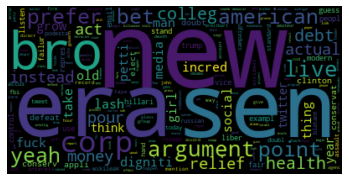

Topic: 0 Word: 0.010*"game" + 0.007*"like" + 0.007*"get" + 0.006*"new" + 0.006*"consol" + 0.006*"look" + 0.005*"build" + 0.005*"upgrad" + 0.005*"come" + 0.004*"buy"
Topic: 1 Word: 0.014*"game" + 0.011*"fps" + 0.009*"peasant" + 0.008*"play" + 0.008*"like" + 0.007*"think" + 0.007*"know" + 0.006*"steam" + 0.006*"consol" + 0.005*"buy"
doc :  0 [(0, 0.77072436), (1, 0.22927567)]
doc :  1 [(0, 0.11581882), (1, 0.8841812)]
doc :  2 [(0, 0.3434821), (1, 0.6565179)]
doc :  3 [(0, 0.24298194), (1, 0.757018)]
doc :  4 [(0, 0.12414003), (1, 0.8758599)]
doc :  5 [(0, 0.37582058), (1, 0.6241794)]
doc :  6 [(0, 0.05894339), (1, 0.9410566)]
doc :  7 [(0, 0.11781774), (1, 0.88218224)]
doc :  8 [(0, 0.11893642), (1, 0.88106364)]
doc :  9 [(0, 0.5), (1, 0.5)]
doc :  10 [(0, 0.3447795), (1, 0.6552205)]
doc :  11 [(0, 0.2526527), (1, 0.7473473)]
doc :  12 [(0, 0.14030385), (1, 0.8596962)]
doc :  13 [(0, 0.8274276), (1, 0.17257237)]
doc :  14 [(0, 0.12636265), (1, 0.8736374)]
doc :  15 [(0, 0.35009181), (1,

doc :  351 [(0, 0.8029566), (1, 0.19704342)]
doc :  352 [(0, 0.79543585), (1, 0.20456418)]
doc :  353 [(0, 0.34982404), (1, 0.6501759)]
doc :  354 [(0, 0.79092985), (1, 0.20907016)]
doc :  355 [(0, 0.13745314), (1, 0.8625469)]
doc :  356 [(0, 0.82511497), (1, 0.17488503)]
doc :  357 [(0, 0.41020754), (1, 0.58979243)]
doc :  358 [(0, 0.6002185), (1, 0.39978153)]
doc :  359 [(0, 0.25048095), (1, 0.7495191)]
doc :  360 [(0, 0.2984334), (1, 0.70156664)]
doc :  361 [(0, 0.6914895), (1, 0.30851048)]
doc :  362 [(0, 0.14079021), (1, 0.8592097)]
doc :  363 [(0, 0.7919924), (1, 0.20800763)]
doc :  364 [(0, 0.92360866), (1, 0.076391324)]
doc :  365 [(0, 0.18422444), (1, 0.8157756)]
doc :  366 [(0, 0.08669135), (1, 0.9133087)]
doc :  367 [(0, 0.9462689), (1, 0.05373106)]
doc :  368 [(0, 0.6290458), (1, 0.37095422)]
doc :  369 [(0, 0.42504624), (1, 0.57495373)]
doc :  370 [(0, 0.69758666), (1, 0.30241334)]
doc :  371 [(0, 0.9282888), (1, 0.07171119)]
doc :  372 [(0, 0.60751665), (1, 0.39248332)]
d

doc :  648 [(0, 0.7857617), (1, 0.21423836)]
doc :  649 [(0, 0.32891178), (1, 0.67108816)]
doc :  650 [(0, 0.6800078), (1, 0.31999213)]
doc :  651 [(0, 0.18825749), (1, 0.81174254)]
doc :  652 [(0, 0.06679891), (1, 0.9332011)]
doc :  653 [(0, 0.15339978), (1, 0.8466002)]
doc :  654 [(0, 0.6638756), (1, 0.33612442)]
doc :  655 [(0, 0.1310199), (1, 0.8689801)]
doc :  656 [(0, 0.6690838), (1, 0.33091626)]
doc :  657 [(0, 0.34402677), (1, 0.6559732)]
doc :  658 [(0, 0.837074), (1, 0.16292596)]
doc :  659 [(0, 0.09869373), (1, 0.9013063)]
doc :  660 [(0, 0.9134528), (1, 0.08654717)]
doc :  661 [(0, 0.16582897), (1, 0.834171)]
doc :  662 [(0, 0.55656636), (1, 0.4434336)]
doc :  663 [(0, 0.31402785), (1, 0.6859722)]
doc :  664 [(0, 0.08113779), (1, 0.91886216)]
doc :  665 [(0, 0.24372011), (1, 0.7562799)]
doc :  666 [(0, 0.83241725), (1, 0.16758278)]
doc :  667 [(0, 0.23649865), (1, 0.7635014)]
doc :  668 [(0, 0.12268106), (1, 0.8773189)]
doc :  669 [(0, 0.8592715), (1, 0.14072847)]
doc :  67

doc :  1017 [(0, 0.6086982), (1, 0.39130178)]
doc :  1018 [(0, 0.8173331), (1, 0.18266691)]
doc :  1019 [(0, 0.2615018), (1, 0.7384982)]
doc :  1020 [(0, 0.72161883), (1, 0.27838114)]
doc :  1021 [(0, 0.23839349), (1, 0.76160645)]
doc :  1022 [(0, 0.12015971), (1, 0.8798403)]
doc :  1023 [(0, 0.08619555), (1, 0.9138044)]
doc :  1024 [(0, 0.2056415), (1, 0.7943585)]
doc :  1025 [(0, 0.8212234), (1, 0.17877664)]
doc :  1026 [(0, 0.51690316), (1, 0.4830969)]
doc :  1027 [(0, 0.56010413), (1, 0.4398959)]
doc :  1028 [(0, 0.094493516), (1, 0.9055065)]
doc :  1029 [(0, 0.717737), (1, 0.282263)]
doc :  1030 [(0, 0.19831468), (1, 0.80168533)]
doc :  1031 [(0, 0.6053366), (1, 0.39466336)]
doc :  1032 [(0, 0.28212142), (1, 0.71787864)]
doc :  1033 [(0, 0.8885806), (1, 0.11141938)]
doc :  1034 [(0, 0.27973875), (1, 0.7202612)]
doc :  1035 [(0, 0.11643566), (1, 0.8835644)]
doc :  1036 [(0, 0.77273875), (1, 0.22726119)]
doc :  1037 [(0, 0.70932144), (1, 0.29067862)]
doc :  1038 [(0, 0.1987484), (1,

doc :  1396 [(0, 0.57898337), (1, 0.42101666)]
doc :  1397 [(0, 0.12293622), (1, 0.87706375)]
doc :  1398 [(0, 0.6116846), (1, 0.38831535)]
doc :  1399 [(0, 0.2714345), (1, 0.7285656)]
doc :  1400 [(0, 0.44563362), (1, 0.5543664)]
doc :  1401 [(0, 0.91399217), (1, 0.08600789)]
doc :  1402 [(0, 0.3086148), (1, 0.69138527)]
doc :  1403 [(0, 0.11047478), (1, 0.8895252)]
doc :  1404 [(0, 0.08397847), (1, 0.9160215)]
doc :  1405 [(0, 0.83138555), (1, 0.16861445)]
doc :  1406 [(0, 0.768056), (1, 0.23194405)]
doc :  1407 [(0, 0.23263805), (1, 0.76736194)]
doc :  1408 [(0, 0.77067065), (1, 0.22932935)]
doc :  1409 [(0, 0.16582772), (1, 0.83417225)]
doc :  1410 [(0, 0.79126126), (1, 0.20873871)]
doc :  1411 [(0, 0.50513643), (1, 0.49486357)]
doc :  1412 [(0, 0.65434104), (1, 0.34565902)]
doc :  1413 [(0, 0.78104067), (1, 0.2189593)]
doc :  1414 [(0, 0.94763607), (1, 0.052363902)]
doc :  1415 [(0, 0.5), (1, 0.5)]
doc :  1416 [(0, 0.14029673), (1, 0.8597033)]
doc :  1417 [(0, 0.46972886), (1, 0.5

doc :  1757 [(0, 0.8215337), (1, 0.17846633)]
doc :  1758 [(0, 0.100306556), (1, 0.8996935)]
doc :  1759 [(0, 0.6947762), (1, 0.30522385)]
doc :  1760 [(0, 0.74208164), (1, 0.25791836)]
doc :  1761 [(0, 0.38228834), (1, 0.61771166)]
doc :  1762 [(0, 0.807032), (1, 0.19296801)]
doc :  1763 [(0, 0.5), (1, 0.5)]
doc :  1764 [(0, 0.29571328), (1, 0.70428675)]
doc :  1765 [(0, 0.84745187), (1, 0.15254821)]
doc :  1766 [(0, 0.045301665), (1, 0.9546983)]
doc :  1767 [(0, 0.9167383), (1, 0.08326172)]
doc :  1768 [(0, 0.15304187), (1, 0.8469581)]
doc :  1769 [(0, 0.86783016), (1, 0.13216981)]
doc :  1770 [(0, 0.19721971), (1, 0.80278033)]
doc :  1771 [(0, 0.8404977), (1, 0.15950233)]
doc :  1772 [(0, 0.32792783), (1, 0.6720721)]
doc :  1773 [(0, 0.8460263), (1, 0.15397367)]
doc :  1774 [(0, 0.11127503), (1, 0.888725)]
doc :  1775 [(0, 0.2020193), (1, 0.7979807)]
doc :  1776 [(0, 0.6677049), (1, 0.33229512)]
doc :  1777 [(0, 0.43160555), (1, 0.5683944)]
doc :  1778 [(0, 0.62350667), (1, 0.376493

doc :  2092 [(0, 0.28920564), (1, 0.7107943)]
doc :  2093 [(0, 0.30300045), (1, 0.69699955)]
doc :  2094 [(0, 0.8749695), (1, 0.12503044)]
doc :  2095 [(0, 0.7393604), (1, 0.2606396)]
doc :  2096 [(0, 0.15941207), (1, 0.8405879)]
doc :  2097 [(0, 0.6357007), (1, 0.3642993)]
doc :  2098 [(0, 0.20569931), (1, 0.79430073)]
doc :  2099 [(0, 0.5), (1, 0.5)]
doc :  2100 [(0, 0.08904963), (1, 0.9109504)]
doc :  2101 [(0, 0.80317664), (1, 0.19682339)]
doc :  2102 [(0, 0.12234744), (1, 0.8776526)]
doc :  2103 [(0, 0.70776427), (1, 0.29223576)]
doc :  2104 [(0, 0.8074281), (1, 0.19257188)]
doc :  2105 [(0, 0.5132071), (1, 0.48679292)]
doc :  2106 [(0, 0.2610444), (1, 0.7389556)]
doc :  2107 [(0, 0.28359407), (1, 0.7164059)]
doc :  2108 [(0, 0.19321378), (1, 0.80678624)]
doc :  2109 [(0, 0.7107721), (1, 0.28922793)]
doc :  2110 [(0, 0.25759834), (1, 0.7424016)]
doc :  2111 [(0, 0.14831638), (1, 0.8516836)]
doc :  2112 [(0, 0.28371194), (1, 0.71628803)]
doc :  2113 [(0, 0.25759187), (1, 0.74240816

doc :  2504 [(0, 0.62365025), (1, 0.37634978)]
doc :  2505 [(0, 0.202266), (1, 0.79773396)]
doc :  2506 [(0, 0.23263165), (1, 0.7673684)]
doc :  2507 [(0, 0.8103694), (1, 0.18963064)]
doc :  2508 [(0, 0.19783473), (1, 0.80216527)]
doc :  2509 [(0, 0.8319846), (1, 0.16801545)]
doc :  2510 [(0, 0.31096104), (1, 0.689039)]
doc :  2511 [(0, 0.21068801), (1, 0.789312)]
doc :  2512 [(0, 0.28314367), (1, 0.7168563)]
doc :  2513 [(0, 0.7812068), (1, 0.21879324)]
doc :  2514 [(0, 0.105993226), (1, 0.8940067)]
doc :  2515 [(0, 0.20589583), (1, 0.79410416)]
doc :  2516 [(0, 0.27717143), (1, 0.7228285)]
doc :  2517 [(0, 0.9366488), (1, 0.06335123)]
doc :  2518 [(0, 0.71417075), (1, 0.28582925)]
doc :  2519 [(0, 0.6839367), (1, 0.31606326)]
doc :  2520 [(0, 0.1882844), (1, 0.81171554)]
doc :  2521 [(0, 0.8646222), (1, 0.13537787)]
doc :  2522 [(0, 0.88506323), (1, 0.114936754)]
doc :  2523 [(0, 0.89989066), (1, 0.10010937)]
doc :  2524 [(0, 0.19651213), (1, 0.8034879)]
doc :  2525 [(0, 0.76025176),

doc :  2780 [(0, 0.62518656), (1, 0.3748134)]
doc :  2781 [(0, 0.44568497), (1, 0.55431503)]
doc :  2782 [(0, 0.8298588), (1, 0.17014119)]
doc :  2783 [(0, 0.6459664), (1, 0.3540336)]
doc :  2784 [(0, 0.8383185), (1, 0.1616815)]
doc :  2785 [(0, 0.9317571), (1, 0.06824291)]
doc :  2786 [(0, 0.13511544), (1, 0.8648846)]
doc :  2787 [(0, 0.24203503), (1, 0.75796497)]
doc :  2788 [(0, 0.7233357), (1, 0.27666435)]
doc :  2789 [(0, 0.85275614), (1, 0.14724383)]
doc :  2790 [(0, 0.3243212), (1, 0.6756788)]
doc :  2791 [(0, 0.25402167), (1, 0.74597836)]
doc :  2792 [(0, 0.14616542), (1, 0.85383457)]
doc :  2793 [(0, 0.30237693), (1, 0.69762313)]
doc :  2794 [(0, 0.2215205), (1, 0.7784795)]
doc :  2795 [(0, 0.32679167), (1, 0.6732083)]
doc :  2796 [(0, 0.9016443), (1, 0.09835573)]
doc :  2797 [(0, 0.20148893), (1, 0.7985111)]
doc :  2798 [(0, 0.18863165), (1, 0.81136835)]
doc :  2799 [(0, 0.47143495), (1, 0.52856505)]
doc :  2800 [(0, 0.4995461), (1, 0.5004539)]
doc :  2801 [(0, 0.421193), (1,

doc :  3074 [(0, 0.81035745), (1, 0.1896425)]
doc :  3075 [(0, 0.31933874), (1, 0.6806612)]
doc :  3076 [(0, 0.45933887), (1, 0.5406611)]
doc :  3077 [(0, 0.7583663), (1, 0.24163371)]
doc :  3078 [(0, 0.5), (1, 0.5)]
doc :  3079 [(0, 0.737577), (1, 0.26242298)]
doc :  3080 [(0, 0.44104087), (1, 0.5589592)]
doc :  3081 [(0, 0.19226788), (1, 0.8077321)]
doc :  3082 [(0, 0.8253528), (1, 0.17464718)]
doc :  3083 [(0, 0.67731476), (1, 0.32268524)]
doc :  3084 [(0, 0.7655248), (1, 0.23447523)]
doc :  3085 [(0, 0.5), (1, 0.5)]
doc :  3086 [(0, 0.2071295), (1, 0.7928705)]
doc :  3087 [(0, 0.71411544), (1, 0.2858846)]
doc :  3088 [(0, 0.96248275), (1, 0.037517287)]
doc :  3089 [(0, 0.8853239), (1, 0.11467612)]
doc :  3090 [(0, 0.8272306), (1, 0.1727694)]
doc :  3091 [(0, 0.7639991), (1, 0.23600085)]
doc :  3092 [(0, 0.36898804), (1, 0.63101196)]
doc :  3093 [(0, 0.5521605), (1, 0.44783953)]
doc :  3094 [(0, 0.7777703), (1, 0.22222972)]
doc :  3095 [(0, 0.37528977), (1, 0.62471026)]
doc :  3096 

doc :  3410 [(0, 0.41824645), (1, 0.58175355)]
doc :  3411 [(0, 0.11666515), (1, 0.8833349)]
doc :  3412 [(0, 0.13607395), (1, 0.86392605)]
doc :  3413 [(0, 0.11538538), (1, 0.88461465)]
doc :  3414 [(0, 0.49071366), (1, 0.50928634)]
doc :  3415 [(0, 0.78374773), (1, 0.21625225)]
doc :  3416 [(0, 0.73474836), (1, 0.26525158)]
doc :  3417 [(0, 0.32634038), (1, 0.6736596)]
doc :  3418 [(0, 0.8729583), (1, 0.12704168)]
doc :  3419 [(0, 0.8067056), (1, 0.19329435)]
doc :  3420 [(0, 0.13054998), (1, 0.86945003)]
doc :  3421 [(0, 0.8061142), (1, 0.19388579)]
doc :  3422 [(0, 0.081087515), (1, 0.9189125)]
doc :  3423 [(0, 0.34321064), (1, 0.6567894)]
doc :  3424 [(0, 0.90618956), (1, 0.09381044)]
doc :  3425 [(0, 0.19225195), (1, 0.807748)]
doc :  3426 [(0, 0.78758955), (1, 0.21241045)]
doc :  3427 [(0, 0.5840346), (1, 0.41596538)]
doc :  3428 [(0, 0.2768866), (1, 0.7231134)]
doc :  3429 [(0, 0.7630797), (1, 0.23692034)]
doc :  3430 [(0, 0.59467316), (1, 0.4053268)]
doc :  3431 [(0, 0.1527987

doc :  3727 [(0, 0.5313133), (1, 0.46868676)]
doc :  3728 [(0, 0.4434732), (1, 0.5565267)]
doc :  3729 [(0, 0.35627973), (1, 0.64372027)]
doc :  3730 [(0, 0.21778375), (1, 0.78221625)]
doc :  3731 [(0, 0.12444379), (1, 0.8755562)]
doc :  3732 [(0, 0.45641467), (1, 0.5435853)]
doc :  3733 [(0, 0.23913415), (1, 0.7608659)]
doc :  3734 [(0, 0.77470726), (1, 0.22529273)]
doc :  3735 [(0, 0.2582189), (1, 0.7417811)]
doc :  3736 [(0, 0.8889265), (1, 0.1110735)]
doc :  3737 [(0, 0.1751298), (1, 0.82487017)]
doc :  3738 [(0, 0.6493571), (1, 0.3506429)]
doc :  3739 [(0, 0.8159813), (1, 0.18401869)]
doc :  3740 [(0, 0.68136203), (1, 0.31863797)]
doc :  3741 [(0, 0.2765501), (1, 0.7234499)]
doc :  3742 [(0, 0.85777473), (1, 0.14222524)]
doc :  3743 [(0, 0.8448844), (1, 0.15511559)]
doc :  3744 [(0, 0.25981888), (1, 0.7401811)]
doc :  3745 [(0, 0.8844463), (1, 0.1155537)]
doc :  3746 [(0, 0.48830128), (1, 0.5116987)]
doc :  3747 [(0, 0.5), (1, 0.5)]
doc :  3748 [(0, 0.4137067), (1, 0.58629334)]
do

doc :  4081 [(0, 0.69854057), (1, 0.30145943)]
doc :  4082 [(0, 0.4624212), (1, 0.5375788)]
doc :  4083 [(0, 0.40337452), (1, 0.5966255)]
doc :  4084 [(0, 0.3951928), (1, 0.6048072)]
doc :  4085 [(0, 0.8588283), (1, 0.14117165)]
doc :  4086 [(0, 0.3165812), (1, 0.68341875)]
doc :  4087 [(0, 0.20769593), (1, 0.79230404)]
doc :  4088 [(0, 0.22071238), (1, 0.77928764)]
doc :  4089 [(0, 0.8955186), (1, 0.10448139)]
doc :  4090 [(0, 0.81857884), (1, 0.18142112)]
doc :  4091 [(0, 0.14917704), (1, 0.8508229)]
doc :  4092 [(0, 0.698401), (1, 0.30159897)]
doc :  4093 [(0, 0.798004), (1, 0.20199606)]
doc :  4094 [(0, 0.20170476), (1, 0.79829526)]
doc :  4095 [(0, 0.42234522), (1, 0.5776547)]
doc :  4096 [(0, 0.72522753), (1, 0.27477247)]
doc :  4097 [(0, 0.16989115), (1, 0.8301088)]
doc :  4098 [(0, 0.89062613), (1, 0.10937386)]
doc :  4099 [(0, 0.6309566), (1, 0.36904338)]
doc :  4100 [(0, 0.76587564), (1, 0.23412438)]
doc :  4101 [(0, 0.24297503), (1, 0.757025)]
doc :  4102 [(0, 0.12364843), (

doc :  4510 [(0, 0.5963472), (1, 0.40365273)]
doc :  4511 [(0, 0.6626017), (1, 0.33739832)]
doc :  4512 [(0, 0.8553243), (1, 0.14467567)]
doc :  4513 [(0, 0.17756912), (1, 0.8224309)]
doc :  4514 [(0, 0.6789449), (1, 0.3210551)]
doc :  4515 [(0, 0.36314318), (1, 0.63685685)]
doc :  4516 [(0, 0.42476702), (1, 0.575233)]
doc :  4517 [(0, 0.26925623), (1, 0.73074377)]
doc :  4518 [(0, 0.11618441), (1, 0.8838156)]
doc :  4519 [(0, 0.40408117), (1, 0.59591883)]
doc :  4520 [(0, 0.23536351), (1, 0.76463646)]
doc :  4521 [(0, 0.30051982), (1, 0.6994802)]
doc :  4522 [(0, 0.08303841), (1, 0.9169616)]
doc :  4523 [(0, 0.31772438), (1, 0.6822756)]
doc :  4524 [(0, 0.85289675), (1, 0.14710322)]
doc :  4525 [(0, 0.18614346), (1, 0.8138565)]
doc :  4526 [(0, 0.34884787), (1, 0.65115213)]
doc :  4527 [(0, 0.61260253), (1, 0.38739744)]
doc :  4528 [(0, 0.95141894), (1, 0.04858109)]
doc :  4529 [(0, 0.36232096), (1, 0.6376791)]
doc :  4530 [(0, 0.34574917), (1, 0.65425086)]
doc :  4531 [(0, 0.79055744

doc :  4841 [(0, 0.92616564), (1, 0.07383433)]
doc :  4842 [(0, 0.16976821), (1, 0.8302318)]
doc :  4843 [(0, 0.2277896), (1, 0.77221036)]
doc :  4844 [(0, 0.28300112), (1, 0.7169989)]
doc :  4845 [(0, 0.8901001), (1, 0.10989987)]
doc :  4846 [(0, 0.60012424), (1, 0.39987576)]
doc :  4847 [(0, 0.08436293), (1, 0.9156371)]
doc :  4848 [(0, 0.7811714), (1, 0.21882863)]
doc :  4849 [(0, 0.8188462), (1, 0.18115376)]
doc :  4850 [(0, 0.8222588), (1, 0.17774118)]
doc :  4851 [(0, 0.60001695), (1, 0.39998308)]
doc :  4852 [(0, 0.2546555), (1, 0.7453445)]
doc :  4853 [(0, 0.29592103), (1, 0.70407903)]
doc :  4854 [(0, 0.57374007), (1, 0.4262599)]
doc :  4855 [(0, 0.14392622), (1, 0.85607374)]
doc :  4856 [(0, 0.10009416), (1, 0.8999058)]
doc :  4857 [(0, 0.77979416), (1, 0.22020583)]
doc :  4858 [(0, 0.15514092), (1, 0.84485906)]
doc :  4859 [(0, 0.33104375), (1, 0.6689562)]
doc :  4860 [(0, 0.84525806), (1, 0.15474191)]
doc :  4861 [(0, 0.07562083), (1, 0.92437917)]
doc :  4862 [(0, 0.9588607

doc :  5251 [(0, 0.4954405), (1, 0.50455946)]
doc :  5252 [(0, 0.25313687), (1, 0.7468631)]
doc :  5253 [(0, 0.5631195), (1, 0.43688047)]
doc :  5254 [(0, 0.5956649), (1, 0.40433505)]
doc :  5255 [(0, 0.8076626), (1, 0.19233733)]
doc :  5256 [(0, 0.8578103), (1, 0.14218968)]
doc :  5257 [(0, 0.9068965), (1, 0.09310348)]
doc :  5258 [(0, 0.25686052), (1, 0.74313945)]
doc :  5259 [(0, 0.7001013), (1, 0.29989874)]
doc :  5260 [(0, 0.29507557), (1, 0.70492446)]
doc :  5261 [(0, 0.8333157), (1, 0.16668434)]
doc :  5262 [(0, 0.06416083), (1, 0.9358391)]
doc :  5263 [(0, 0.780743), (1, 0.21925697)]
doc :  5264 [(0, 0.8811141), (1, 0.118885905)]
doc :  5265 [(0, 0.26971552), (1, 0.7302845)]
doc :  5266 [(0, 0.81181604), (1, 0.18818402)]
doc :  5267 [(0, 0.8358193), (1, 0.16418071)]
doc :  5268 [(0, 0.06832659), (1, 0.9316734)]
doc :  5269 [(0, 0.858662), (1, 0.14133799)]
doc :  5270 [(0, 0.17983858), (1, 0.8201614)]
doc :  5271 [(0, 0.20318739), (1, 0.79681265)]
doc :  5272 [(0, 0.53429055), (

doc :  5552 [(0, 0.26281315), (1, 0.73718685)]
doc :  5553 [(0, 0.63785416), (1, 0.36214584)]
doc :  5554 [(0, 0.88765395), (1, 0.112346075)]
doc :  5555 [(0, 0.8253431), (1, 0.17465687)]
doc :  5556 [(0, 0.7737134), (1, 0.22628659)]
doc :  5557 [(0, 0.3563662), (1, 0.64363384)]
doc :  5558 [(0, 0.6345931), (1, 0.36540684)]
doc :  5559 [(0, 0.24683298), (1, 0.75316703)]
doc :  5560 [(0, 0.849838), (1, 0.15016195)]
doc :  5561 [(0, 0.082399234), (1, 0.9176008)]
doc :  5562 [(0, 0.08311009), (1, 0.9168899)]
doc :  5563 [(0, 0.34433252), (1, 0.65566754)]
doc :  5564 [(0, 0.5630437), (1, 0.4369563)]
doc :  5565 [(0, 0.10054283), (1, 0.8994572)]
doc :  5566 [(0, 0.07537604), (1, 0.92462397)]
doc :  5567 [(0, 0.3755964), (1, 0.6244036)]
doc :  5568 [(0, 0.15439697), (1, 0.845603)]
doc :  5569 [(0, 0.28415695), (1, 0.715843)]
doc :  5570 [(0, 0.511949), (1, 0.48805097)]
doc :  5571 [(0, 0.1632073), (1, 0.83679277)]
doc :  5572 [(0, 0.27259266), (1, 0.72740734)]
doc :  5573 [(0, 0.78254694), (

doc :  5905 [(0, 0.65450853), (1, 0.3454914)]
doc :  5906 [(0, 0.856042), (1, 0.14395803)]
doc :  5907 [(0, 0.78403735), (1, 0.21596268)]
doc :  5908 [(0, 0.076313116), (1, 0.92368686)]
doc :  5909 [(0, 0.8862921), (1, 0.11370784)]
doc :  5910 [(0, 0.08991259), (1, 0.9100874)]
doc :  5911 [(0, 0.5644714), (1, 0.4355286)]
doc :  5912 [(0, 0.23818097), (1, 0.761819)]
doc :  5913 [(0, 0.50518984), (1, 0.4948102)]
doc :  5914 [(0, 0.49030817), (1, 0.50969183)]
doc :  5915 [(0, 0.7212818), (1, 0.27871817)]
doc :  5916 [(0, 0.42338103), (1, 0.57661897)]
doc :  5917 [(0, 0.5), (1, 0.5)]
doc :  5918 [(0, 0.5), (1, 0.5)]
doc :  5919 [(0, 0.4977267), (1, 0.50227326)]
doc :  5920 [(0, 0.20795432), (1, 0.7920457)]
doc :  5921 [(0, 0.67994845), (1, 0.3200516)]
doc :  5922 [(0, 0.29849264), (1, 0.7015074)]
doc :  5923 [(0, 0.0462288), (1, 0.9537712)]
doc :  5924 [(0, 0.34563473), (1, 0.65436524)]
doc :  5925 [(0, 0.76608986), (1, 0.23391014)]
doc :  5926 [(0, 0.27070525), (1, 0.7292948)]
doc :  5927

doc :  6316 [(0, 0.9178527), (1, 0.082147256)]
doc :  6317 [(0, 0.32041442), (1, 0.6795856)]
doc :  6318 [(0, 0.594414), (1, 0.40558597)]
doc :  6319 [(0, 0.32800308), (1, 0.6719969)]
doc :  6320 [(0, 0.5), (1, 0.5)]
doc :  6321 [(0, 0.4739172), (1, 0.5260828)]
doc :  6322 [(0, 0.67632806), (1, 0.32367194)]
doc :  6323 [(0, 0.51922315), (1, 0.48077685)]
doc :  6324 [(0, 0.07626404), (1, 0.923736)]
doc :  6325 [(0, 0.51286477), (1, 0.48713523)]
doc :  6326 [(0, 0.09008495), (1, 0.90991503)]
doc :  6327 [(0, 0.1277802), (1, 0.8722198)]
doc :  6328 [(0, 0.07035991), (1, 0.92964005)]
doc :  6329 [(0, 0.6055273), (1, 0.39447272)]
doc :  6330 [(0, 0.8637391), (1, 0.13626093)]
doc :  6331 [(0, 0.93131435), (1, 0.06868566)]
doc :  6332 [(0, 0.052721776), (1, 0.9472782)]
doc :  6333 [(0, 0.89707977), (1, 0.102920175)]
doc :  6334 [(0, 0.75626534), (1, 0.24373463)]
doc :  6335 [(0, 0.11198487), (1, 0.88801515)]
doc :  6336 [(0, 0.8231658), (1, 0.17683421)]
doc :  6337 [(0, 0.84289515), (1, 0.157

doc :  6681 [(0, 0.60602516), (1, 0.39397478)]
doc :  6682 [(0, 0.7227869), (1, 0.27721307)]
doc :  6683 [(0, 0.3178565), (1, 0.6821435)]
doc :  6684 [(0, 0.955301), (1, 0.04469906)]
doc :  6685 [(0, 0.46497858), (1, 0.5350214)]
doc :  6686 [(0, 0.86393625), (1, 0.1360637)]
doc :  6687 [(0, 0.20045397), (1, 0.799546)]
doc :  6688 [(0, 0.52463), (1, 0.47537)]
doc :  6689 [(0, 0.820308), (1, 0.17969194)]
doc :  6690 [(0, 0.8747889), (1, 0.12521112)]
doc :  6691 [(0, 0.43799004), (1, 0.56200993)]
doc :  6692 [(0, 0.82029945), (1, 0.1797005)]
doc :  6693 [(0, 0.81091106), (1, 0.189089)]
doc :  6694 [(0, 0.29216006), (1, 0.7078399)]
doc :  6695 [(0, 0.88347757), (1, 0.116522394)]
doc :  6696 [(0, 0.35805959), (1, 0.6419404)]
doc :  6697 [(0, 0.21567896), (1, 0.784321)]
doc :  6698 [(0, 0.29259902), (1, 0.707401)]
doc :  6699 [(0, 0.40726745), (1, 0.59273255)]
doc :  6700 [(0, 0.4427462), (1, 0.55725384)]
doc :  6701 [(0, 0.11605809), (1, 0.8839419)]
doc :  6702 [(0, 0.66756827), (1, 0.33243

doc :  7070 [(0, 0.12192529), (1, 0.8780747)]
doc :  7071 [(0, 0.57433057), (1, 0.42566946)]
doc :  7072 [(0, 0.90866625), (1, 0.09133375)]
doc :  7073 [(0, 0.8710309), (1, 0.12896904)]
doc :  7074 [(0, 0.13590565), (1, 0.8640944)]
doc :  7075 [(0, 0.7493788), (1, 0.25062126)]
doc :  7076 [(0, 0.23882483), (1, 0.7611752)]
doc :  7077 [(0, 0.10890865), (1, 0.89109135)]
doc :  7078 [(0, 0.20439367), (1, 0.7956064)]
doc :  7079 [(0, 0.54243106), (1, 0.45756897)]
doc :  7080 [(0, 0.9248276), (1, 0.07517234)]
doc :  7081 [(0, 0.345697), (1, 0.654303)]
doc :  7082 [(0, 0.57715535), (1, 0.4228447)]
doc :  7083 [(0, 0.83782893), (1, 0.16217107)]
doc :  7084 [(0, 0.118214265), (1, 0.88178575)]
doc :  7085 [(0, 0.1432724), (1, 0.8567276)]
doc :  7086 [(0, 0.49907425), (1, 0.5009258)]
doc :  7087 [(0, 0.33960602), (1, 0.660394)]
doc :  7088 [(0, 0.23830806), (1, 0.761692)]
doc :  7089 [(0, 0.69189346), (1, 0.30810648)]
doc :  7090 [(0, 0.16413957), (1, 0.83586043)]
doc :  7091 [(0, 0.75331783), (

doc :  7380 [(0, 0.78670305), (1, 0.2132969)]
doc :  7381 [(0, 0.32787743), (1, 0.6721226)]
doc :  7382 [(0, 0.7151802), (1, 0.28481978)]
doc :  7383 [(0, 0.03215297), (1, 0.96784705)]
doc :  7384 [(0, 0.8162007), (1, 0.18379936)]
doc :  7385 [(0, 0.119167164), (1, 0.8808328)]
doc :  7386 [(0, 0.6498424), (1, 0.35015765)]
doc :  7387 [(0, 0.97373587), (1, 0.026264101)]
doc :  7388 [(0, 0.30862403), (1, 0.6913759)]
doc :  7389 [(0, 0.1363485), (1, 0.8636515)]
doc :  7390 [(0, 0.5865771), (1, 0.41342285)]
doc :  7391 [(0, 0.41521886), (1, 0.5847811)]
doc :  7392 [(0, 0.43084422), (1, 0.5691558)]
doc :  7393 [(0, 0.07178982), (1, 0.92821014)]
doc :  7394 [(0, 0.806399), (1, 0.19360104)]
doc :  7395 [(0, 0.46773726), (1, 0.53226274)]
doc :  7396 [(0, 0.8243524), (1, 0.17564763)]
doc :  7397 [(0, 0.81524837), (1, 0.18475164)]
doc :  7398 [(0, 0.69529206), (1, 0.30470794)]
doc :  7399 [(0, 0.6513381), (1, 0.34866193)]
doc :  7400 [(0, 0.8621177), (1, 0.13788232)]
doc :  7401 [(0, 0.18801953)

doc :  7669 [(0, 0.24905956), (1, 0.75094044)]
doc :  7670 [(0, 0.68044275), (1, 0.31955722)]
doc :  7671 [(0, 0.34703967), (1, 0.6529603)]
doc :  7672 [(0, 0.1832999), (1, 0.81670016)]
doc :  7673 [(0, 0.6994842), (1, 0.30051577)]
doc :  7674 [(0, 0.24407583), (1, 0.7559242)]
doc :  7675 [(0, 0.8961932), (1, 0.10380684)]
doc :  7676 [(0, 0.10336499), (1, 0.896635)]
doc :  7677 [(0, 0.8114592), (1, 0.1885408)]
doc :  7678 [(0, 0.8447381), (1, 0.15526189)]
doc :  7679 [(0, 0.818325), (1, 0.18167499)]
doc :  7680 [(0, 0.53773385), (1, 0.46226612)]
doc :  7681 [(0, 0.831621), (1, 0.16837902)]
doc :  7682 [(0, 0.76272297), (1, 0.23727699)]
doc :  7683 [(0, 0.24411054), (1, 0.7558895)]
doc :  7684 [(0, 0.7726311), (1, 0.22736888)]
doc :  7685 [(0, 0.09397785), (1, 0.90602213)]
doc :  7686 [(0, 0.8476217), (1, 0.15237834)]
doc :  7687 [(0, 0.5153251), (1, 0.48467484)]
doc :  7688 [(0, 0.09189776), (1, 0.9081022)]
doc :  7689 [(0, 0.21741888), (1, 0.78258115)]
doc :  7690 [(0, 0.14983487), (1

doc :  8026 [(0, 0.6424715), (1, 0.35752854)]
doc :  8027 [(0, 0.09958003), (1, 0.90041995)]
doc :  8028 [(0, 0.16110533), (1, 0.83889467)]
doc :  8029 [(0, 0.24282463), (1, 0.7571753)]
doc :  8030 [(0, 0.2808495), (1, 0.7191505)]
doc :  8031 [(0, 0.14490104), (1, 0.85509896)]
doc :  8032 [(0, 0.5699476), (1, 0.43005237)]
doc :  8033 [(0, 0.40702245), (1, 0.5929776)]
doc :  8034 [(0, 0.8865509), (1, 0.113449104)]
doc :  8035 [(0, 0.2210991), (1, 0.7789009)]
doc :  8036 [(0, 0.3016169), (1, 0.69838315)]
doc :  8037 [(0, 0.15389955), (1, 0.8461005)]
doc :  8038 [(0, 0.7845621), (1, 0.21543793)]
doc :  8039 [(0, 0.47230354), (1, 0.5276965)]
doc :  8040 [(0, 0.07923395), (1, 0.92076606)]
doc :  8041 [(0, 0.79175717), (1, 0.20824282)]
doc :  8042 [(0, 0.56891227), (1, 0.43108773)]
doc :  8043 [(0, 0.8327037), (1, 0.16729632)]
doc :  8044 [(0, 0.8660591), (1, 0.1339409)]
doc :  8045 [(0, 0.18814135), (1, 0.81185865)]
doc :  8046 [(0, 0.13346104), (1, 0.86653894)]
doc :  8047 [(0, 0.16415082)

doc :  8395 [(0, 0.59990364), (1, 0.40009636)]
doc :  8396 [(0, 0.17785841), (1, 0.8221416)]
doc :  8397 [(0, 0.6313314), (1, 0.36866868)]
doc :  8398 [(0, 0.12230652), (1, 0.8776935)]
doc :  8399 [(0, 0.82898813), (1, 0.17101187)]
doc :  8400 [(0, 0.68881243), (1, 0.3111876)]
doc :  8401 [(0, 0.3444503), (1, 0.6555497)]
doc :  8402 [(0, 0.8218941), (1, 0.17810589)]
doc :  8403 [(0, 0.776581), (1, 0.22341903)]
doc :  8404 [(0, 0.20296341), (1, 0.7970366)]
doc :  8405 [(0, 0.59376144), (1, 0.40623856)]
doc :  8406 [(0, 0.11728584), (1, 0.88271415)]
doc :  8407 [(0, 0.7930963), (1, 0.20690371)]
doc :  8408 [(0, 0.27710947), (1, 0.7228905)]
doc :  8409 [(0, 0.44279224), (1, 0.55720776)]
doc :  8410 [(0, 0.8385401), (1, 0.16145992)]
doc :  8411 [(0, 0.56984115), (1, 0.43015882)]
doc :  8412 [(0, 0.35767776), (1, 0.64232224)]
doc :  8413 [(0, 0.021868093), (1, 0.9781319)]
doc :  8414 [(0, 0.1442098), (1, 0.8557902)]
doc :  8415 [(0, 0.24176013), (1, 0.75823987)]
doc :  8416 [(0, 0.802826), 

doc :  8810 [(0, 0.50702864), (1, 0.4929714)]
doc :  8811 [(0, 0.90420353), (1, 0.09579648)]
doc :  8812 [(0, 0.8015489), (1, 0.19845115)]
doc :  8813 [(0, 0.17591375), (1, 0.82408625)]
doc :  8814 [(0, 0.88412184), (1, 0.11587814)]
doc :  8815 [(0, 0.7971425), (1, 0.20285751)]
doc :  8816 [(0, 0.09073057), (1, 0.90926945)]
doc :  8817 [(0, 0.8807133), (1, 0.1192867)]
doc :  8818 [(0, 0.20453703), (1, 0.795463)]
doc :  8819 [(0, 0.29542956), (1, 0.7045705)]
doc :  8820 [(0, 0.6074557), (1, 0.39254433)]
doc :  8821 [(0, 0.51624715), (1, 0.48375282)]
doc :  8822 [(0, 0.26171666), (1, 0.73828334)]
doc :  8823 [(0, 0.12099641), (1, 0.8790036)]
doc :  8824 [(0, 0.20633368), (1, 0.79366636)]
doc :  8825 [(0, 0.36582), (1, 0.63418)]
doc :  8826 [(0, 0.9547539), (1, 0.045246087)]
doc :  8827 [(0, 0.918526), (1, 0.081474036)]
doc :  8828 [(0, 0.5), (1, 0.5)]
doc :  8829 [(0, 0.16322145), (1, 0.8367786)]
doc :  8830 [(0, 0.88714474), (1, 0.11285524)]
doc :  8831 [(0, 0.14119238), (1, 0.8588076)]

doc :  9153 [(0, 0.9168378), (1, 0.08316217)]
doc :  9154 [(0, 0.8540069), (1, 0.14599317)]
doc :  9155 [(0, 0.36731988), (1, 0.6326802)]
doc :  9156 [(0, 0.452786), (1, 0.547214)]
doc :  9157 [(0, 0.5548163), (1, 0.44518372)]
doc :  9158 [(0, 0.34923857), (1, 0.65076137)]
doc :  9159 [(0, 0.37919393), (1, 0.62080604)]
doc :  9160 [(0, 0.087164655), (1, 0.91283536)]
doc :  9161 [(0, 0.714795), (1, 0.285205)]
doc :  9162 [(0, 0.40371442), (1, 0.5962856)]
doc :  9163 [(0, 0.26377776), (1, 0.73622227)]
doc :  9164 [(0, 0.5593364), (1, 0.4406636)]
doc :  9165 [(0, 0.23938838), (1, 0.76061165)]
doc :  9166 [(0, 0.19638865), (1, 0.80361134)]
doc :  9167 [(0, 0.58012986), (1, 0.41987014)]
doc :  9168 [(0, 0.81935346), (1, 0.18064651)]
doc :  9169 [(0, 0.11752256), (1, 0.88247746)]
doc :  9170 [(0, 0.90606165), (1, 0.0939383)]
doc :  9171 [(0, 0.33601415), (1, 0.6639859)]
doc :  9172 [(0, 0.6441007), (1, 0.35589927)]
doc :  9173 [(0, 0.8780641), (1, 0.121935874)]
doc :  9174 [(0, 0.18466835), 

doc :  9530 [(0, 0.47358388), (1, 0.5264161)]
doc :  9531 [(0, 0.29772723), (1, 0.7022727)]
doc :  9532 [(0, 0.4621774), (1, 0.5378226)]
doc :  9533 [(0, 0.5), (1, 0.5)]
doc :  9534 [(0, 0.25079894), (1, 0.74920106)]
doc :  9535 [(0, 0.4385087), (1, 0.5614913)]
doc :  9536 [(0, 0.255969), (1, 0.744031)]
doc :  9537 [(0, 0.25713608), (1, 0.74286395)]
doc :  9538 [(0, 0.13684848), (1, 0.8631515)]
doc :  9539 [(0, 0.3458978), (1, 0.6541022)]
doc :  9540 [(0, 0.59876764), (1, 0.40123233)]
doc :  9541 [(0, 0.86725724), (1, 0.13274276)]
doc :  9542 [(0, 0.6277958), (1, 0.37220415)]
doc :  9543 [(0, 0.46349695), (1, 0.5365031)]
doc :  9544 [(0, 0.42325717), (1, 0.5767428)]
doc :  9545 [(0, 0.67456645), (1, 0.32543355)]
doc :  9546 [(0, 0.05040048), (1, 0.9495995)]
doc :  9547 [(0, 0.6872162), (1, 0.3127838)]
doc :  9548 [(0, 0.8721377), (1, 0.12786229)]
doc :  9549 [(0, 0.9100086), (1, 0.08999144)]
doc :  9550 [(0, 0.49520755), (1, 0.50479245)]
doc :  9551 [(0, 0.39188465), (1, 0.6081153)]
do

doc :  9906 [(0, 0.44984853), (1, 0.55015147)]
doc :  9907 [(0, 0.71879476), (1, 0.28120524)]
doc :  9908 [(0, 0.5), (1, 0.5)]
doc :  9909 [(0, 0.35136002), (1, 0.64864)]
doc :  9910 [(0, 0.29395065), (1, 0.7060494)]
doc :  9911 [(0, 0.13934113), (1, 0.8606589)]
doc :  9912 [(0, 0.24366128), (1, 0.7563387)]
doc :  9913 [(0, 0.37524784), (1, 0.6247522)]
doc :  9914 [(0, 0.8156948), (1, 0.18430516)]
doc :  9915 [(0, 0.6101434), (1, 0.38985652)]
doc :  9916 [(0, 0.105682716), (1, 0.89431727)]
doc :  9917 [(0, 0.09995777), (1, 0.90004224)]
doc :  9918 [(0, 0.9200302), (1, 0.07996981)]
doc :  9919 [(0, 0.36919102), (1, 0.630809)]
doc :  9920 [(0, 0.3776529), (1, 0.62234706)]
doc :  9921 [(0, 0.73830116), (1, 0.2616988)]
doc :  9922 [(0, 0.8698373), (1, 0.13016275)]
doc :  9923 [(0, 0.4970005), (1, 0.50299954)]
doc :  9924 [(0, 0.81794864), (1, 0.18205144)]
doc :  9925 [(0, 0.45235413), (1, 0.54764587)]
doc :  9926 [(0, 0.21983145), (1, 0.78016853)]
doc :  9927 [(0, 0.16590294), (1, 0.834097

doc :  10272 [(0, 0.22846483), (1, 0.77153516)]
doc :  10273 [(0, 0.8941329), (1, 0.10586713)]
doc :  10274 [(0, 0.69380933), (1, 0.30619064)]
doc :  10275 [(0, 0.9322322), (1, 0.06776778)]
doc :  10276 [(0, 0.8376551), (1, 0.16234484)]
doc :  10277 [(0, 0.89625037), (1, 0.10374959)]
doc :  10278 [(0, 0.9019136), (1, 0.098086424)]
doc :  10279 [(0, 0.2018434), (1, 0.7981566)]
doc :  10280 [(0, 0.5695982), (1, 0.4304018)]
doc :  10281 [(0, 0.31639096), (1, 0.68360907)]
doc :  10282 [(0, 0.23128662), (1, 0.7687134)]
doc :  10283 [(0, 0.5), (1, 0.5)]
doc :  10284 [(0, 0.7177278), (1, 0.28227228)]
doc :  10285 [(0, 0.7142191), (1, 0.28578088)]
doc :  10286 [(0, 0.100680634), (1, 0.8993194)]
doc :  10287 [(0, 0.28547168), (1, 0.7145283)]
doc :  10288 [(0, 0.26732457), (1, 0.73267543)]
doc :  10289 [(0, 0.2602825), (1, 0.73971754)]
doc :  10290 [(0, 0.1956963), (1, 0.80430377)]
doc :  10291 [(0, 0.38965428), (1, 0.6103457)]
doc :  10292 [(0, 0.24904665), (1, 0.7509533)]
doc :  10293 [(0, 0.6

doc :  10575 [(0, 0.29494718), (1, 0.70505285)]
doc :  10576 [(0, 0.654926), (1, 0.34507397)]
doc :  10577 [(0, 0.64418864), (1, 0.35581133)]
doc :  10578 [(0, 0.10595473), (1, 0.8940453)]
doc :  10579 [(0, 0.91064036), (1, 0.089359656)]
doc :  10580 [(0, 0.70922023), (1, 0.29077977)]
doc :  10581 [(0, 0.70926356), (1, 0.29073647)]
doc :  10582 [(0, 0.10742287), (1, 0.8925771)]
doc :  10583 [(0, 0.40423003), (1, 0.59577)]
doc :  10584 [(0, 0.11826352), (1, 0.8817365)]
doc :  10585 [(0, 0.761282), (1, 0.23871797)]
doc :  10586 [(0, 0.9076887), (1, 0.09231134)]
doc :  10587 [(0, 0.8490615), (1, 0.15093856)]
doc :  10588 [(0, 0.77982265), (1, 0.22017732)]
doc :  10589 [(0, 0.7635161), (1, 0.23648384)]
doc :  10590 [(0, 0.734097), (1, 0.26590303)]
doc :  10591 [(0, 0.73316723), (1, 0.26683277)]
doc :  10592 [(0, 0.33057457), (1, 0.6694254)]
doc :  10593 [(0, 0.31235355), (1, 0.68764645)]
doc :  10594 [(0, 0.53744), (1, 0.46255994)]
doc :  10595 [(0, 0.5), (1, 0.5)]
doc :  10596 [(0, 0.2225

doc :  10903 [(0, 0.8813801), (1, 0.118619904)]
doc :  10904 [(0, 0.22050558), (1, 0.7794944)]
doc :  10905 [(0, 0.5), (1, 0.5)]
doc :  10906 [(0, 0.4760789), (1, 0.5239211)]
doc :  10907 [(0, 0.9703677), (1, 0.029632295)]
doc :  10908 [(0, 0.2073293), (1, 0.7926707)]
doc :  10909 [(0, 0.31247184), (1, 0.6875282)]
doc :  10910 [(0, 0.8328994), (1, 0.16710058)]
doc :  10911 [(0, 0.32895327), (1, 0.6710467)]
doc :  10912 [(0, 0.6830233), (1, 0.31697667)]
doc :  10913 [(0, 0.103564665), (1, 0.8964353)]
doc :  10914 [(0, 0.21932581), (1, 0.78067416)]
doc :  10915 [(0, 0.6974796), (1, 0.30252033)]
doc :  10916 [(0, 0.35063273), (1, 0.6493673)]
doc :  10917 [(0, 0.5778926), (1, 0.42210743)]
doc :  10918 [(0, 0.41114804), (1, 0.588852)]
doc :  10919 [(0, 0.116586916), (1, 0.8834131)]
doc :  10920 [(0, 0.69022685), (1, 0.30977315)]
doc :  10921 [(0, 0.80216795), (1, 0.1978321)]
doc :  10922 [(0, 0.5), (1, 0.5)]
doc :  10923 [(0, 0.9009257), (1, 0.09907432)]
doc :  10924 [(0, 0.18542099), (1, 0

doc :  11239 [(0, 0.87298125), (1, 0.12701876)]
doc :  11240 [(0, 0.6759452), (1, 0.32405478)]
doc :  11241 [(0, 0.39611644), (1, 0.6038835)]
doc :  11242 [(0, 0.66016763), (1, 0.33983234)]
doc :  11243 [(0, 0.2791296), (1, 0.7208704)]
doc :  11244 [(0, 0.7002241), (1, 0.29977584)]
doc :  11245 [(0, 0.21537149), (1, 0.78462845)]
doc :  11246 [(0, 0.099007934), (1, 0.90099204)]
doc :  11247 [(0, 0.69056493), (1, 0.3094351)]
doc :  11248 [(0, 0.69061935), (1, 0.30938065)]
doc :  11249 [(0, 0.09967702), (1, 0.90032303)]
doc :  11250 [(0, 0.20731798), (1, 0.792682)]
doc :  11251 [(0, 0.10545852), (1, 0.8945415)]
doc :  11252 [(0, 0.71692306), (1, 0.28307697)]
doc :  11253 [(0, 0.3746197), (1, 0.62538034)]
doc :  11254 [(0, 0.14773442), (1, 0.8522656)]
doc :  11255 [(0, 0.7598464), (1, 0.24015363)]
doc :  11256 [(0, 0.22238754), (1, 0.7776125)]
doc :  11257 [(0, 0.82022756), (1, 0.17977247)]
doc :  11258 [(0, 0.8280273), (1, 0.17197274)]
doc :  11259 [(0, 0.51778036), (1, 0.4822197)]
doc : 

doc :  11553 [(0, 0.7462276), (1, 0.25377238)]
doc :  11554 [(0, 0.5), (1, 0.5)]
doc :  11555 [(0, 0.16810255), (1, 0.83189744)]
doc :  11556 [(0, 0.44140497), (1, 0.558595)]
doc :  11557 [(0, 0.70372504), (1, 0.29627496)]
doc :  11558 [(0, 0.09433274), (1, 0.90566725)]
doc :  11559 [(0, 0.6989832), (1, 0.30101684)]
doc :  11560 [(0, 0.4704307), (1, 0.5295693)]
doc :  11561 [(0, 0.19260235), (1, 0.80739766)]
doc :  11562 [(0, 0.8225196), (1, 0.17748044)]
doc :  11563 [(0, 0.5604808), (1, 0.43951926)]
doc :  11564 [(0, 0.91754156), (1, 0.08245849)]
doc :  11565 [(0, 0.16200294), (1, 0.8379971)]
doc :  11566 [(0, 0.47042677), (1, 0.52957326)]
doc :  11567 [(0, 0.5398051), (1, 0.46019495)]
doc :  11568 [(0, 0.74502486), (1, 0.25497514)]
doc :  11569 [(0, 0.5930656), (1, 0.40693438)]
doc :  11570 [(0, 0.8761458), (1, 0.12385417)]
doc :  11571 [(0, 0.24305688), (1, 0.7569431)]
doc :  11572 [(0, 0.5592997), (1, 0.4407003)]
doc :  11573 [(0, 0.32313043), (1, 0.6768696)]
doc :  11574 [(0, 0.71

doc :  11875 [(0, 0.12367592), (1, 0.87632406)]
doc :  11876 [(0, 0.91758436), (1, 0.082415625)]
doc :  11877 [(0, 0.97035426), (1, 0.029645752)]
doc :  11878 [(0, 0.70668364), (1, 0.29331636)]
doc :  11879 [(0, 0.15510719), (1, 0.84489274)]
doc :  11880 [(0, 0.7793289), (1, 0.22067112)]
doc :  11881 [(0, 0.82347393), (1, 0.17652604)]
doc :  11882 [(0, 0.25813398), (1, 0.74186605)]
doc :  11883 [(0, 0.3990916), (1, 0.6009084)]
doc :  11884 [(0, 0.13717145), (1, 0.86282855)]
doc :  11885 [(0, 0.23118126), (1, 0.7688188)]
doc :  11886 [(0, 0.26143736), (1, 0.73856264)]
doc :  11887 [(0, 0.40650877), (1, 0.5934912)]
doc :  11888 [(0, 0.68186384), (1, 0.31813616)]
doc :  11889 [(0, 0.4684553), (1, 0.53154474)]
doc :  11890 [(0, 0.8000631), (1, 0.19993688)]
doc :  11891 [(0, 0.037430916), (1, 0.96256906)]
doc :  11892 [(0, 0.78265446), (1, 0.2173455)]
doc :  11893 [(0, 0.1384219), (1, 0.8615781)]
doc :  11894 [(0, 0.44627592), (1, 0.5537241)]
doc :  11895 [(0, 0.7350687), (1, 0.26493132)]
d

doc :  12233 [(0, 0.55469286), (1, 0.4453071)]
doc :  12234 [(0, 0.7654493), (1, 0.2345507)]
doc :  12235 [(0, 0.6996188), (1, 0.30038118)]
doc :  12236 [(0, 0.4080069), (1, 0.59199303)]
doc :  12237 [(0, 0.07119845), (1, 0.92880154)]
doc :  12238 [(0, 0.25174445), (1, 0.74825555)]
doc :  12239 [(0, 0.6608624), (1, 0.33913758)]
doc :  12240 [(0, 0.08433952), (1, 0.9156605)]
doc :  12241 [(0, 0.908853), (1, 0.09114705)]
doc :  12242 [(0, 0.5), (1, 0.5)]
doc :  12243 [(0, 0.112321675), (1, 0.8876783)]
doc :  12244 [(0, 0.4675053), (1, 0.53249466)]
doc :  12245 [(0, 0.66076285), (1, 0.33923715)]
doc :  12246 [(0, 0.16063085), (1, 0.8393691)]
doc :  12247 [(0, 0.15029487), (1, 0.84970516)]
doc :  12248 [(0, 0.27346578), (1, 0.72653425)]
doc :  12249 [(0, 0.09605569), (1, 0.9039443)]
doc :  12250 [(0, 0.20043495), (1, 0.799565)]
doc :  12251 [(0, 0.21221533), (1, 0.78778464)]
doc :  12252 [(0, 0.78965306), (1, 0.2103469)]
doc :  12253 [(0, 0.88567555), (1, 0.11432444)]
doc :  12254 [(0, 0.7

doc :  12678 [(0, 0.26327437), (1, 0.7367256)]
doc :  12679 [(0, 0.22474977), (1, 0.7752502)]
doc :  12680 [(0, 0.6807725), (1, 0.31922758)]
doc :  12681 [(0, 0.10709629), (1, 0.89290375)]
doc :  12682 [(0, 0.3557255), (1, 0.6442745)]
doc :  12683 [(0, 0.07100595), (1, 0.92899406)]
doc :  12684 [(0, 0.84915656), (1, 0.15084346)]
doc :  12685 [(0, 0.5352457), (1, 0.46475425)]
doc :  12686 [(0, 0.92883265), (1, 0.07116731)]
doc :  12687 [(0, 0.9175918), (1, 0.08240822)]
doc :  12688 [(0, 0.57702863), (1, 0.4229714)]
doc :  12689 [(0, 0.7827049), (1, 0.2172951)]
doc :  12690 [(0, 0.68527377), (1, 0.31472623)]
doc :  12691 [(0, 0.93776125), (1, 0.06223882)]
doc :  12692 [(0, 0.1300945), (1, 0.8699055)]
doc :  12693 [(0, 0.8057117), (1, 0.19428833)]
doc :  12694 [(0, 0.7355909), (1, 0.26440907)]
doc :  12695 [(0, 0.29271263), (1, 0.7072874)]
doc :  12696 [(0, 0.24012828), (1, 0.7598717)]
doc :  12697 [(0, 0.866512), (1, 0.13348798)]
doc :  12698 [(0, 0.34218484), (1, 0.65781516)]
doc :  126

doc :  12936 [(0, 0.062743284), (1, 0.93725675)]
doc :  12937 [(0, 0.8629128), (1, 0.13708717)]
doc :  12938 [(0, 0.5), (1, 0.5)]
doc :  12939 [(0, 0.86111397), (1, 0.13888606)]
doc :  12940 [(0, 0.16941999), (1, 0.83058)]
doc :  12941 [(0, 0.36581296), (1, 0.634187)]
doc :  12942 [(0, 0.13088542), (1, 0.8691145)]
doc :  12943 [(0, 0.8013475), (1, 0.19865248)]
doc :  12944 [(0, 0.7186461), (1, 0.2813539)]
doc :  12945 [(0, 0.82789016), (1, 0.17210986)]
doc :  12946 [(0, 0.27145943), (1, 0.72854054)]
doc :  12947 [(0, 0.84965014), (1, 0.15034983)]
doc :  12948 [(0, 0.81137687), (1, 0.18862315)]
doc :  12949 [(0, 0.8783702), (1, 0.12162974)]
doc :  12950 [(0, 0.79424965), (1, 0.20575029)]
doc :  12951 [(0, 0.34151384), (1, 0.6584862)]
doc :  12952 [(0, 0.7053798), (1, 0.2946202)]
doc :  12953 [(0, 0.21813281), (1, 0.7818672)]
doc :  12954 [(0, 0.18541646), (1, 0.81458354)]
doc :  12955 [(0, 0.6153187), (1, 0.38468125)]
doc :  12956 [(0, 0.21325856), (1, 0.78674144)]
doc :  12957 [(0, 0.8

doc :  13248 [(0, 0.4638655), (1, 0.5361345)]
doc :  13249 [(0, 0.17823325), (1, 0.82176673)]
doc :  13250 [(0, 0.09953511), (1, 0.9004649)]
doc :  13251 [(0, 0.30487671), (1, 0.69512326)]
doc :  13252 [(0, 0.18323365), (1, 0.8167664)]
doc :  13253 [(0, 0.6547927), (1, 0.3452073)]
doc :  13254 [(0, 0.521206), (1, 0.478794)]
doc :  13255 [(0, 0.22325003), (1, 0.77675)]
doc :  13256 [(0, 0.6114523), (1, 0.38854772)]
doc :  13257 [(0, 0.54970634), (1, 0.45029363)]
doc :  13258 [(0, 0.07957017), (1, 0.9204299)]
doc :  13259 [(0, 0.14322537), (1, 0.8567746)]
doc :  13260 [(0, 0.0928457), (1, 0.9071543)]
doc :  13261 [(0, 0.34602678), (1, 0.65397316)]
doc :  13262 [(0, 0.09390064), (1, 0.9060994)]
doc :  13263 [(0, 0.3486648), (1, 0.6513352)]
doc :  13264 [(0, 0.83833957), (1, 0.1616604)]
doc :  13265 [(0, 0.4705154), (1, 0.52948457)]
doc :  13266 [(0, 0.60966444), (1, 0.39033556)]
doc :  13267 [(0, 0.79915404), (1, 0.20084599)]
doc :  13268 [(0, 0.14928322), (1, 0.85071677)]
doc :  13269 [(

doc :  13626 [(0, 0.6947921), (1, 0.30520788)]
doc :  13627 [(0, 0.1485754), (1, 0.85142463)]
doc :  13628 [(0, 0.44245705), (1, 0.5575429)]
doc :  13629 [(0, 0.13918771), (1, 0.8608123)]
doc :  13630 [(0, 0.14576177), (1, 0.8542383)]
doc :  13631 [(0, 0.77717733), (1, 0.2228227)]
doc :  13632 [(0, 0.283667), (1, 0.71633303)]
doc :  13633 [(0, 0.6725665), (1, 0.3274335)]
doc :  13634 [(0, 0.22168699), (1, 0.778313)]
doc :  13635 [(0, 0.1772201), (1, 0.8227799)]
doc :  13636 [(0, 0.8137747), (1, 0.18622528)]
doc :  13637 [(0, 0.21659964), (1, 0.7834004)]
doc :  13638 [(0, 0.5851567), (1, 0.41484332)]
doc :  13639 [(0, 0.76526994), (1, 0.2347301)]
doc :  13640 [(0, 0.2967108), (1, 0.7032892)]
doc :  13641 [(0, 0.22435541), (1, 0.7756446)]
doc :  13642 [(0, 0.62121093), (1, 0.37878904)]
doc :  13643 [(0, 0.6701094), (1, 0.3298906)]
doc :  13644 [(0, 0.89742625), (1, 0.10257376)]
doc :  13645 [(0, 0.2711003), (1, 0.72889966)]
doc :  13646 [(0, 0.15433653), (1, 0.8456635)]
doc :  13647 [(0,

doc :  13999 [(0, 0.11813695), (1, 0.88186306)]
doc :  14000 [(0, 0.73346055), (1, 0.26653948)]
doc :  14001 [(0, 0.90038496), (1, 0.09961503)]
doc :  14002 [(0, 0.025133563), (1, 0.97486645)]
doc :  14003 [(0, 0.056912743), (1, 0.9430872)]
doc :  14004 [(0, 0.43671155), (1, 0.5632885)]
doc :  14005 [(0, 0.068223216), (1, 0.9317768)]
doc :  14006 [(0, 0.84488416), (1, 0.15511583)]
doc :  14007 [(0, 0.47739285), (1, 0.52260715)]
doc :  14008 [(0, 0.14626786), (1, 0.85373217)]
doc :  14009 [(0, 0.16029716), (1, 0.83970284)]
doc :  14010 [(0, 0.31440833), (1, 0.6855917)]
doc :  14011 [(0, 0.6537564), (1, 0.34624365)]
doc :  14012 [(0, 0.22356734), (1, 0.77643263)]
doc :  14013 [(0, 0.85599446), (1, 0.14400555)]
doc :  14014 [(0, 0.46082488), (1, 0.5391751)]
doc :  14015 [(0, 0.16980632), (1, 0.83019364)]
doc :  14016 [(0, 0.254903), (1, 0.745097)]
doc :  14017 [(0, 0.75224966), (1, 0.24775034)]
doc :  14018 [(0, 0.8672006), (1, 0.13279934)]
doc :  14019 [(0, 0.84138775), (1, 0.15861222)]


doc :  14372 [(0, 0.44383088), (1, 0.55616915)]
doc :  14373 [(0, 0.81967217), (1, 0.18032785)]
doc :  14374 [(0, 0.25804496), (1, 0.741955)]
doc :  14375 [(0, 0.24703819), (1, 0.7529618)]
doc :  14376 [(0, 0.6624578), (1, 0.33754212)]
doc :  14377 [(0, 0.49506524), (1, 0.5049348)]
doc :  14378 [(0, 0.14890394), (1, 0.85109603)]
doc :  14379 [(0, 0.19792253), (1, 0.8020774)]
doc :  14380 [(0, 0.43317896), (1, 0.56682104)]
doc :  14381 [(0, 0.59836406), (1, 0.40163592)]
doc :  14382 [(0, 0.7875684), (1, 0.21243161)]
doc :  14383 [(0, 0.82911617), (1, 0.17088379)]
doc :  14384 [(0, 0.5240457), (1, 0.4759543)]
doc :  14385 [(0, 0.2531559), (1, 0.7468441)]
doc :  14386 [(0, 0.33017746), (1, 0.6698226)]
doc :  14387 [(0, 0.7743231), (1, 0.22567691)]
doc :  14388 [(0, 0.10919969), (1, 0.8908003)]
doc :  14389 [(0, 0.8175848), (1, 0.18241516)]
doc :  14390 [(0, 0.4691132), (1, 0.5308868)]
doc :  14391 [(0, 0.5226725), (1, 0.47732756)]
doc :  14392 [(0, 0.5546665), (1, 0.44533345)]
doc :  1439

doc :  14725 [(0, 0.2624204), (1, 0.7375796)]
doc :  14726 [(0, 0.1041619), (1, 0.89583814)]
doc :  14727 [(0, 0.90623456), (1, 0.093765445)]
doc :  14728 [(0, 0.29355857), (1, 0.7064414)]
doc :  14729 [(0, 0.2878357), (1, 0.71216434)]
doc :  14730 [(0, 0.62326175), (1, 0.37673822)]
doc :  14731 [(0, 0.14131021), (1, 0.8586898)]
doc :  14732 [(0, 0.5), (1, 0.5)]
doc :  14733 [(0, 0.8985522), (1, 0.10144787)]
doc :  14734 [(0, 0.14072552), (1, 0.8592745)]
doc :  14735 [(0, 0.49602625), (1, 0.5039737)]
doc :  14736 [(0, 0.8795924), (1, 0.12040761)]
doc :  14737 [(0, 0.16648564), (1, 0.83351433)]
doc :  14738 [(0, 0.88846254), (1, 0.11153744)]
doc :  14739 [(0, 0.53070694), (1, 0.4692931)]
doc :  14740 [(0, 0.5345734), (1, 0.46542668)]
doc :  14741 [(0, 0.110402435), (1, 0.8895976)]
doc :  14742 [(0, 0.23535717), (1, 0.76464283)]
doc :  14743 [(0, 0.8815328), (1, 0.118467174)]
doc :  14744 [(0, 0.24830614), (1, 0.7516939)]
doc :  14745 [(0, 0.83080643), (1, 0.16919358)]
doc :  14746 [(0, 

doc :  15085 [(0, 0.34608445), (1, 0.6539156)]
doc :  15086 [(0, 0.18439728), (1, 0.8156027)]
doc :  15087 [(0, 0.15013222), (1, 0.8498678)]
doc :  15088 [(0, 0.14486857), (1, 0.85513145)]
doc :  15089 [(0, 0.28063247), (1, 0.71936756)]
doc :  15090 [(0, 0.13004765), (1, 0.8699524)]
doc :  15091 [(0, 0.8254038), (1, 0.17459619)]
doc :  15092 [(0, 0.93209755), (1, 0.06790245)]
doc :  15093 [(0, 0.8238017), (1, 0.17619827)]
doc :  15094 [(0, 0.6690853), (1, 0.33091468)]
doc :  15095 [(0, 0.5735882), (1, 0.42641184)]
doc :  15096 [(0, 0.44447556), (1, 0.55552447)]
doc :  15097 [(0, 0.51724446), (1, 0.48275557)]
doc :  15098 [(0, 0.12951116), (1, 0.8704888)]
doc :  15099 [(0, 0.37239218), (1, 0.6276078)]
doc :  15100 [(0, 0.13586316), (1, 0.8641368)]
doc :  15101 [(0, 0.34111768), (1, 0.6588824)]
doc :  15102 [(0, 0.38779795), (1, 0.6122021)]
doc :  15103 [(0, 0.24828753), (1, 0.7517125)]
doc :  15104 [(0, 0.6449136), (1, 0.3550864)]
doc :  15105 [(0, 0.8454328), (1, 0.15456724)]
doc :  15

doc :  15443 [(0, 0.55714345), (1, 0.44285652)]
doc :  15444 [(0, 0.33569786), (1, 0.6643022)]
doc :  15445 [(0, 0.34585282), (1, 0.6541472)]
doc :  15446 [(0, 0.8683022), (1, 0.13169774)]
doc :  15447 [(0, 0.3574969), (1, 0.64250314)]
doc :  15448 [(0, 0.73928195), (1, 0.26071805)]
doc :  15449 [(0, 0.5), (1, 0.5)]
doc :  15450 [(0, 0.5527538), (1, 0.44724622)]
doc :  15451 [(0, 0.24983557), (1, 0.75016445)]
doc :  15452 [(0, 0.27490026), (1, 0.7250997)]
doc :  15453 [(0, 0.7364213), (1, 0.26357877)]
doc :  15454 [(0, 0.16267285), (1, 0.8373271)]
doc :  15455 [(0, 0.7602426), (1, 0.2397574)]
doc :  15456 [(0, 0.7264904), (1, 0.27350965)]
doc :  15457 [(0, 0.23428808), (1, 0.76571196)]
doc :  15458 [(0, 0.1885295), (1, 0.81147045)]
doc :  15459 [(0, 0.5), (1, 0.5)]
doc :  15460 [(0, 0.79148537), (1, 0.20851463)]
doc :  15461 [(0, 0.81478214), (1, 0.18521783)]
doc :  15462 [(0, 0.33641234), (1, 0.6635876)]
doc :  15463 [(0, 0.6412519), (1, 0.3587481)]
doc :  15464 [(0, 0.2850863), (1, 0

doc :  15843 [(0, 0.42938447), (1, 0.5706156)]
doc :  15844 [(0, 0.23911048), (1, 0.7608895)]
doc :  15845 [(0, 0.8452676), (1, 0.15473245)]
doc :  15846 [(0, 0.26795262), (1, 0.7320474)]
doc :  15847 [(0, 0.19448552), (1, 0.8055145)]
doc :  15848 [(0, 0.15030907), (1, 0.8496909)]
doc :  15849 [(0, 0.8657186), (1, 0.13428137)]
doc :  15850 [(0, 0.3046111), (1, 0.6953889)]
doc :  15851 [(0, 0.844911), (1, 0.15508905)]
doc :  15852 [(0, 0.12505525), (1, 0.8749447)]
doc :  15853 [(0, 0.09843786), (1, 0.9015621)]
doc :  15854 [(0, 0.7060836), (1, 0.29391643)]
doc :  15855 [(0, 0.327031), (1, 0.672969)]
doc :  15856 [(0, 0.3049228), (1, 0.6950772)]
doc :  15857 [(0, 0.5), (1, 0.5)]
doc :  15858 [(0, 0.23394476), (1, 0.7660552)]
doc :  15859 [(0, 0.08425566), (1, 0.91574436)]
doc :  15860 [(0, 0.7416138), (1, 0.2583862)]
doc :  15861 [(0, 0.21316087), (1, 0.7868392)]
doc :  15862 [(0, 0.7985532), (1, 0.20144671)]
doc :  15863 [(0, 0.93783814), (1, 0.062161904)]
doc :  15864 [(0, 0.10853863),

doc :  16111 [(0, 0.4704568), (1, 0.5295432)]
doc :  16112 [(0, 0.8144564), (1, 0.1855436)]
doc :  16113 [(0, 0.37762496), (1, 0.622375)]
doc :  16114 [(0, 0.94697374), (1, 0.053026307)]
doc :  16115 [(0, 0.5), (1, 0.5)]
doc :  16116 [(0, 0.5205498), (1, 0.47945026)]
doc :  16117 [(0, 0.12691957), (1, 0.87308043)]
doc :  16118 [(0, 0.8225594), (1, 0.17744057)]
doc :  16119 [(0, 0.7548374), (1, 0.24516264)]
doc :  16120 [(0, 0.11035213), (1, 0.8896479)]
doc :  16121 [(0, 0.123054385), (1, 0.8769456)]
doc :  16122 [(0, 0.30136102), (1, 0.698639)]
doc :  16123 [(0, 0.30405763), (1, 0.69594234)]
doc :  16124 [(0, 0.5), (1, 0.5)]
doc :  16125 [(0, 0.6147709), (1, 0.38522908)]
doc :  16126 [(0, 0.7868419), (1, 0.21315809)]
doc :  16127 [(0, 0.8791215), (1, 0.12087857)]
doc :  16128 [(0, 0.31548113), (1, 0.6845189)]
doc :  16129 [(0, 0.84651864), (1, 0.15348138)]
doc :  16130 [(0, 0.56239647), (1, 0.43760356)]
doc :  16131 [(0, 0.80252737), (1, 0.19747262)]
doc :  16132 [(0, 0.22014464), (1, 

doc :  16437 [(0, 0.12784003), (1, 0.87215996)]
doc :  16438 [(0, 0.5), (1, 0.5)]
doc :  16439 [(0, 0.51356685), (1, 0.4864332)]
doc :  16440 [(0, 0.1517562), (1, 0.8482438)]
doc :  16441 [(0, 0.71246094), (1, 0.2875391)]
doc :  16442 [(0, 0.6475407), (1, 0.35245937)]
doc :  16443 [(0, 0.65910125), (1, 0.34089875)]
doc :  16444 [(0, 0.84533024), (1, 0.1546698)]
doc :  16445 [(0, 0.74984354), (1, 0.2501565)]
doc :  16446 [(0, 0.62833303), (1, 0.371667)]
doc :  16447 [(0, 0.21211356), (1, 0.7878864)]
doc :  16448 [(0, 0.54662764), (1, 0.4533724)]
doc :  16449 [(0, 0.1643847), (1, 0.83561534)]
doc :  16450 [(0, 0.21102801), (1, 0.788972)]
doc :  16451 [(0, 0.21854414), (1, 0.7814558)]
doc :  16452 [(0, 0.5), (1, 0.5)]
doc :  16453 [(0, 0.860829), (1, 0.13917106)]
doc :  16454 [(0, 0.15942496), (1, 0.84057504)]
doc :  16455 [(0, 0.03530354), (1, 0.9646964)]
doc :  16456 [(0, 0.2346142), (1, 0.7653858)]
doc :  16457 [(0, 0.16943417), (1, 0.8305658)]
doc :  16458 [(0, 0.93169224), (1, 0.0683

doc :  16782 [(0, 0.5882685), (1, 0.41173145)]
doc :  16783 [(0, 0.26152122), (1, 0.7384788)]
doc :  16784 [(0, 0.6987158), (1, 0.30128425)]
doc :  16785 [(0, 0.73119885), (1, 0.26880115)]
doc :  16786 [(0, 0.20375428), (1, 0.79624575)]
doc :  16787 [(0, 0.9042813), (1, 0.09571865)]
doc :  16788 [(0, 0.85302126), (1, 0.14697869)]
doc :  16789 [(0, 0.24679825), (1, 0.7532017)]
doc :  16790 [(0, 0.18967257), (1, 0.8103274)]
doc :  16791 [(0, 0.257724), (1, 0.74227595)]
doc :  16792 [(0, 0.88770586), (1, 0.11229414)]
doc :  16793 [(0, 0.7388118), (1, 0.26118818)]
doc :  16794 [(0, 0.8230976), (1, 0.17690243)]
doc :  16795 [(0, 0.7156158), (1, 0.2843842)]
doc :  16796 [(0, 0.50724393), (1, 0.492756)]
doc :  16797 [(0, 0.12883222), (1, 0.8711678)]
doc :  16798 [(0, 0.15626363), (1, 0.84373635)]
doc :  16799 [(0, 0.09598588), (1, 0.9040141)]
doc :  16800 [(0, 0.69981194), (1, 0.30018806)]
doc :  16801 [(0, 0.19669928), (1, 0.80330074)]
doc :  16802 [(0, 0.2685059), (1, 0.73149407)]
doc :  16

doc :  17137 [(0, 0.78020537), (1, 0.21979462)]
doc :  17138 [(0, 0.5323422), (1, 0.46765783)]
doc :  17139 [(0, 0.7440737), (1, 0.2559263)]
doc :  17140 [(0, 0.49516824), (1, 0.5048318)]
doc :  17141 [(0, 0.35125777), (1, 0.6487422)]
doc :  17142 [(0, 0.69870824), (1, 0.3012918)]
doc :  17143 [(0, 0.96035266), (1, 0.03964733)]
doc :  17144 [(0, 0.38582897), (1, 0.6141711)]
doc :  17145 [(0, 0.41307756), (1, 0.58692247)]
doc :  17146 [(0, 0.11170385), (1, 0.8882961)]
doc :  17147 [(0, 0.79320455), (1, 0.20679548)]
doc :  17148 [(0, 0.65260196), (1, 0.34739807)]
doc :  17149 [(0, 0.08799143), (1, 0.9120086)]
doc :  17150 [(0, 0.37231436), (1, 0.6276856)]
doc :  17151 [(0, 0.8145861), (1, 0.18541385)]
doc :  17152 [(0, 0.5), (1, 0.5)]
doc :  17153 [(0, 0.33169654), (1, 0.66830343)]
doc :  17154 [(0, 0.14891307), (1, 0.8510869)]
doc :  17155 [(0, 0.86124754), (1, 0.1387525)]
doc :  17156 [(0, 0.069681406), (1, 0.9303186)]
doc :  17157 [(0, 0.9066643), (1, 0.09333567)]
doc :  17158 [(0, 0.

doc :  17528 [(0, 0.37752894), (1, 0.62247103)]
doc :  17529 [(0, 0.24387008), (1, 0.7561299)]
doc :  17530 [(0, 0.2844299), (1, 0.7155701)]
doc :  17531 [(0, 0.38081607), (1, 0.6191839)]
doc :  17532 [(0, 0.1648754), (1, 0.8351246)]
doc :  17533 [(0, 0.2648681), (1, 0.7351319)]
doc :  17534 [(0, 0.76132196), (1, 0.23867801)]
doc :  17535 [(0, 0.23488747), (1, 0.7651125)]
doc :  17536 [(0, 0.23437014), (1, 0.7656298)]
doc :  17537 [(0, 0.5497524), (1, 0.4502476)]
doc :  17538 [(0, 0.050004285), (1, 0.94999576)]
doc :  17539 [(0, 0.8705128), (1, 0.1294872)]
doc :  17540 [(0, 0.8839608), (1, 0.11603919)]
doc :  17541 [(0, 0.79350543), (1, 0.20649457)]
doc :  17542 [(0, 0.22267331), (1, 0.7773267)]
doc :  17543 [(0, 0.2971437), (1, 0.7028563)]
doc :  17544 [(0, 0.29688403), (1, 0.703116)]
doc :  17545 [(0, 0.2842397), (1, 0.7157603)]
doc :  17546 [(0, 0.87893975), (1, 0.12106027)]
doc :  17547 [(0, 0.5362187), (1, 0.4637813)]
doc :  17548 [(0, 0.54376346), (1, 0.4562365)]
doc :  17549 [(0

doc :  17923 [(0, 0.16833484), (1, 0.83166516)]
doc :  17924 [(0, 0.035006575), (1, 0.9649934)]
doc :  17925 [(0, 0.096710615), (1, 0.9032894)]
doc :  17926 [(0, 0.7560486), (1, 0.24395142)]
doc :  17927 [(0, 0.25197434), (1, 0.74802566)]
doc :  17928 [(0, 0.584046), (1, 0.41595402)]
doc :  17929 [(0, 0.10219029), (1, 0.89780974)]
doc :  17930 [(0, 0.90384287), (1, 0.096157126)]
doc :  17931 [(0, 0.88936776), (1, 0.110632285)]
doc :  17932 [(0, 0.11016428), (1, 0.8898357)]
doc :  17933 [(0, 0.30873865), (1, 0.69126135)]
doc :  17934 [(0, 0.39242238), (1, 0.6075776)]
doc :  17935 [(0, 0.86863583), (1, 0.13136415)]
doc :  17936 [(0, 0.9294882), (1, 0.070511855)]
doc :  17937 [(0, 0.8871216), (1, 0.11287838)]
doc :  17938 [(0, 0.27802685), (1, 0.7219731)]
doc :  17939 [(0, 0.13389532), (1, 0.86610466)]
doc :  17940 [(0, 0.91737527), (1, 0.08262469)]
doc :  17941 [(0, 0.299339), (1, 0.70066106)]
doc :  17942 [(0, 0.14767998), (1, 0.85232)]
doc :  17943 [(0, 0.3278821), (1, 0.6721179)]
doc 

doc :  18332 [(0, 0.276687), (1, 0.723313)]
doc :  18333 [(0, 0.9075051), (1, 0.09249489)]
doc :  18334 [(0, 0.083204746), (1, 0.91679525)]
doc :  18335 [(0, 0.7663291), (1, 0.23367092)]
doc :  18336 [(0, 0.08381104), (1, 0.91618896)]
doc :  18337 [(0, 0.2844711), (1, 0.7155289)]
doc :  18338 [(0, 0.20326729), (1, 0.7967327)]
doc :  18339 [(0, 0.20832652), (1, 0.7916735)]
doc :  18340 [(0, 0.03631322), (1, 0.96368676)]
doc :  18341 [(0, 0.26234815), (1, 0.7376518)]
doc :  18342 [(0, 0.69353205), (1, 0.30646795)]
doc :  18343 [(0, 0.8934572), (1, 0.10654286)]
doc :  18344 [(0, 0.71902096), (1, 0.28097907)]
doc :  18345 [(0, 0.32891563), (1, 0.67108434)]
doc :  18346 [(0, 0.46139938), (1, 0.5386006)]
doc :  18347 [(0, 0.14160183), (1, 0.85839814)]
doc :  18348 [(0, 0.882688), (1, 0.117312014)]
doc :  18349 [(0, 0.26235676), (1, 0.7376432)]
doc :  18350 [(0, 0.27571726), (1, 0.72428274)]
doc :  18351 [(0, 0.62781787), (1, 0.37218216)]
doc :  18352 [(0, 0.8954016), (1, 0.1045984)]
doc :  1

doc :  18754 [(0, 0.4364944), (1, 0.5635056)]
doc :  18755 [(0, 0.25899312), (1, 0.74100685)]
doc :  18756 [(0, 0.6929603), (1, 0.30703962)]
doc :  18757 [(0, 0.8901962), (1, 0.1098038)]
doc :  18758 [(0, 0.35331604), (1, 0.64668393)]
doc :  18759 [(0, 0.11085785), (1, 0.8891421)]
doc :  18760 [(0, 0.13415228), (1, 0.8658477)]
doc :  18761 [(0, 0.6333363), (1, 0.36666372)]
doc :  18762 [(0, 0.09003644), (1, 0.90996355)]
doc :  18763 [(0, 0.7527454), (1, 0.24725462)]
doc :  18764 [(0, 0.28454188), (1, 0.7154581)]
doc :  18765 [(0, 0.054184474), (1, 0.9458155)]
doc :  18766 [(0, 0.11103328), (1, 0.88896674)]
doc :  18767 [(0, 0.64762866), (1, 0.3523713)]
doc :  18768 [(0, 0.82612044), (1, 0.17387961)]
doc :  18769 [(0, 0.8090134), (1, 0.19098651)]
doc :  18770 [(0, 0.8882703), (1, 0.11172969)]
doc :  18771 [(0, 0.6742825), (1, 0.32571757)]
doc :  18772 [(0, 0.13413937), (1, 0.8658606)]
doc :  18773 [(0, 0.6901611), (1, 0.3098389)]
doc :  18774 [(0, 0.10581515), (1, 0.8941849)]
doc :  187

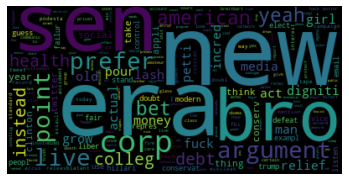

In [191]:
for top in top_reddits:
    result_lda_model_tfidf_subreddit_df, result_bow_corpus_subreddit_df,result_corpus_subreddit_df_tfidf,result_dictionary_subreddit_df = myfunc(top)
    myfunc2(result_lda_model_tfidf_subreddit_df,result_bow_corpus_subreddit_df)
    
    result_dictionary_subreddit_df
    
    string_dictionary_subreddit = ""
    for k, v in result_dictionary_subreddit_df.iteritems():
        #print(k, v)
        string_dictionary_subreddit = string_dictionary_subreddit+ " " +v
    
    wordcloud = WordCloud().generate(string_dictionary_politics)

# Display the generated image:
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    
    #not working
    #vis = pyLDAvis.gensim_models.prepare(result_lda_model_tfidf_subreddit_df, result_corpus_subreddit_df_tfidf, result_dictionary_subreddit_df)
    #vis
#result_df


In [23]:
### Checking for 'worldnews', 'leagueoflegends' and 'pcmasterrace' too

worldnews_df = top_5_df[top_5_df["subreddit"].isin(["worldnews"])]
worldnews_df.index = pd.RangeIndex(len(worldnews_df.index))
worldnews_df.index = range(len(worldnews_df.index))
worldnews_df.reset_index(inplace=True)
worldnews_df['parent_comment'] = worldnews_df['parent_comment'].astype('str') 
worldnews_df

C:\Users\kapil\AppData\Local\Temp/ipykernel_22532/3173989134.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  worldnews_df['parent_comment'] = worldnews_df['parent_comment'].astype('str')


,index,label,parent_comment,subreddit
0,0,0,I agree that his imprisonment is self imposed ...,worldnews
1,1,0,"Thank you Putin, for showing the level-headed ...",worldnews
2,2,0,Apple paid the taxes that Ireland required.,worldnews
3,3,0,South Korea opposition introduces bill to impe...,worldnews
4,4,0,"if someone boycotted every muslim nation, and ...",worldnews
...,...,...,...,...
26372,26372,0,All we need now is the europeans to push the i...,worldnews
26373,26373,1,The Israeli army kidnaps 27 Palestinian civili...,worldnews
26374,26374,1,Tell me again why we don't fucking vet people ...,worldnews
26375,26375,1,And my parents had a rough upbringing/backgrou...,worldnews


In [24]:
processed_docs_worldnews = worldnews_df['parent_comment'].map(preprocess)
processed_docs_worldnews

0        [agre, imprison, self, impos, basi, want, send...
1        [thank, putin, show, level, head, respons, car...
2                        [appl, pay, tax, ireland, requir]
3        [south, korea, opposit, introduc, impeach, sca...
4        [boycott, muslim, nation, nation, presumpt, pr...
                               ...                        
26372    [need, european, push, impeach, case, presid, ...
26373    [isra, armi, kidnap, palestinian, civilian, we...
26374    [tell, fuck, vet, peopl, border, background, c...
26375    [parent, rough, upbring, background, poor, was...
26376    [unsettl, hear, lot, jewish, peopl, israel, pl...
Name: parent_comment, Length: 26377, dtype: object

In [25]:
dictionary_worldnews = gensim.corpora.Dictionary(processed_docs_worldnews)
dictionary_worldnews.filter_extremes(no_below=10, no_above=0.5, keep_n=100000)

In [26]:
bow_corpus_worldnews = [dictionary_worldnews.doc2bow(doc) for doc in processed_docs_worldnews]
bow_corpus_worldnews

[[(0, 1),
  (1, 1),
  (2, 1),
  (3, 1),
  (4, 1),
  (5, 1),
  (6, 1),
  (7, 1),
  (8, 1),
  (9, 1),
  (10, 2),
  (11, 4),
  (12, 1),
  (13, 1),
  (14, 1),
  (15, 1),
  (16, 2),
  (17, 1),
  (18, 1),
  (19, 1),
  (20, 3),
  (21, 4),
  (22, 1),
  (23, 1),
  (24, 1),
  (25, 1)],
 [(26, 1),
  (27, 1),
  (28, 1),
  (29, 1),
  (30, 1),
  (31, 1),
  (32, 1),
  (33, 1),
  (34, 1),
  (35, 1),
  (36, 1),
  (37, 1),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 1),
  (42, 1),
  (43, 2),
  (44, 1),
  (45, 1),
  (46, 1),
  (47, 2)],
 [(48, 1), (49, 1), (50, 1), (51, 1), (52, 1)],
 [(53, 1), (54, 1), (55, 1), (56, 1), (57, 1), (58, 1), (59, 1)],
 [(33, 2), (60, 1), (61, 1), (62, 1), (63, 1)],
 [(64, 1),
  (65, 1),
  (66, 1),
  (67, 1),
  (68, 1),
  (69, 1),
  (70, 1),
  (71, 1),
  (72, 1),
  (73, 1),
  (74, 1),
  (75, 1)],
 [(12, 1),
  (62, 1),
  (76, 1),
  (77, 1),
  (78, 1),
  (79, 3),
  (80, 1),
  (81, 1),
  (82, 1),
  (83, 1),
  (84, 2),
  (85, 1),
  (86, 1),
  (87, 1),
  (88, 1),
  (89, 1),
  (90, 1)

In [27]:
tfidf = models.TfidfModel(bow_corpus_worldnews)
corpus_worldnews_tfidf = tfidf[bow_corpus_worldnews]

In [28]:
lda_model_tfidf = gensim.models.LdaMulticore(corpus_worldnews_tfidf, num_topics=2, id2word=dictionary_worldnews, passes=2, workers=4)
for idx, topic in lda_model_tfidf.print_topics(-1):
    print('Topic: {} Word: {}'.format(idx, topic))

Topic: 0 Word: 0.005*"peopl" + 0.004*"israel" + 0.004*"like" + 0.003*"world" + 0.003*"get" + 0.003*"right" + 0.003*"year" + 0.003*"say" + 0.003*"go" + 0.003*"muslim"
Topic: 1 Word: 0.006*"peopl" + 0.005*"like" + 0.005*"think" + 0.004*"fuck" + 0.004*"kill" + 0.004*"countri" + 0.004*"say" + 0.004*"know" + 0.003*"govern" + 0.003*"want"


In [29]:
count =0 
for i in lda_model_tfidf[bow_corpus_worldnews]:
    print("doc : ", count, i )
    count+=1

doc :  0 [(0, 0.94750506), (1, 0.052494876)]
doc :  1 [(0, 0.49382266), (1, 0.5061773)]
doc :  2 [(0, 0.607591), (1, 0.392409)]
doc :  3 [(0, 0.08690796), (1, 0.9130921)]
doc :  4 [(0, 0.8645402), (1, 0.13545978)]
doc :  5 [(0, 0.79983395), (1, 0.200166)]
doc :  6 [(0, 0.962462), (1, 0.037538007)]
doc :  7 [(0, 0.92173696), (1, 0.07826303)]
doc :  8 [(0, 0.1906242), (1, 0.80937576)]
doc :  9 [(0, 0.47937396), (1, 0.520626)]
doc :  10 [(0, 0.13431258), (1, 0.8656874)]
doc :  11 [(0, 0.5839547), (1, 0.41604528)]
doc :  12 [(0, 0.051951338), (1, 0.94804865)]
doc :  13 [(0, 0.41827312), (1, 0.58172685)]
doc :  14 [(0, 0.29173452), (1, 0.7082655)]
doc :  15 [(0, 0.08896261), (1, 0.9110374)]
doc :  16 [(0, 0.13005343), (1, 0.8699466)]
doc :  17 [(0, 0.080186926), (1, 0.91981304)]
doc :  18 [(0, 0.8439017), (1, 0.15609829)]
doc :  19 [(0, 0.075505845), (1, 0.92449415)]
doc :  20 [(0, 0.110563494), (1, 0.8894365)]
doc :  21 [(0, 0.83817947), (1, 0.16182047)]
doc :  22 [(0, 0.16341427), (1, 0.8

doc :  332 [(0, 0.14859906), (1, 0.8514009)]
doc :  333 [(0, 0.1786857), (1, 0.82131433)]
doc :  334 [(0, 0.7985986), (1, 0.20140141)]
doc :  335 [(0, 0.058919545), (1, 0.94108045)]
doc :  336 [(0, 0.13955475), (1, 0.86044526)]
doc :  337 [(0, 0.086905226), (1, 0.91309476)]
doc :  338 [(0, 0.10205693), (1, 0.8979431)]
doc :  339 [(0, 0.9516483), (1, 0.04835164)]
doc :  340 [(0, 0.19489913), (1, 0.80510086)]
doc :  341 [(0, 0.20188579), (1, 0.79811424)]
doc :  342 [(0, 0.04848079), (1, 0.95151925)]
doc :  343 [(0, 0.40376422), (1, 0.5962358)]
doc :  344 [(0, 0.8367945), (1, 0.16320555)]
doc :  345 [(0, 0.042537153), (1, 0.9574629)]
doc :  346 [(0, 0.50635594), (1, 0.4936441)]
doc :  347 [(0, 0.91494536), (1, 0.085054666)]
doc :  348 [(0, 0.7948501), (1, 0.2051499)]
doc :  349 [(0, 0.7654649), (1, 0.23453505)]
doc :  350 [(0, 0.9558923), (1, 0.044107683)]
doc :  351 [(0, 0.14966497), (1, 0.85033506)]
doc :  352 [(0, 0.8697025), (1, 0.1302975)]
doc :  353 [(0, 0.13072538), (1, 0.8692746)]

doc :  669 [(0, 0.08378805), (1, 0.91621196)]
doc :  670 [(0, 0.8866841), (1, 0.11331589)]
doc :  671 [(0, 0.7252362), (1, 0.27476385)]
doc :  672 [(0, 0.054569464), (1, 0.9454305)]
doc :  673 [(0, 0.5), (1, 0.5)]
doc :  674 [(0, 0.79781914), (1, 0.20218082)]
doc :  675 [(0, 0.77630794), (1, 0.22369201)]
doc :  676 [(0, 0.77857983), (1, 0.22142018)]
doc :  677 [(0, 0.8279068), (1, 0.17209324)]
doc :  678 [(0, 0.25129393), (1, 0.7487061)]
doc :  679 [(0, 0.22368684), (1, 0.7763132)]
doc :  680 [(0, 0.89851403), (1, 0.101485915)]
doc :  681 [(0, 0.73412824), (1, 0.26587176)]
doc :  682 [(0, 0.36064488), (1, 0.63935506)]
doc :  683 [(0, 0.8970681), (1, 0.10293193)]
doc :  684 [(0, 0.06293665), (1, 0.93706334)]
doc :  685 [(0, 0.13862732), (1, 0.86137265)]
doc :  686 [(0, 0.9622755), (1, 0.03772447)]
doc :  687 [(0, 0.6378114), (1, 0.36218855)]
doc :  688 [(0, 0.85698974), (1, 0.14301024)]
doc :  689 [(0, 0.5), (1, 0.5)]
doc :  690 [(0, 0.08957206), (1, 0.9104279)]
doc :  691 [(0, 0.180774

doc :  1007 [(0, 0.80865014), (1, 0.19134983)]
doc :  1008 [(0, 0.3783134), (1, 0.62168664)]
doc :  1009 [(0, 0.08505554), (1, 0.91494447)]
doc :  1010 [(0, 0.8139715), (1, 0.18602848)]
doc :  1011 [(0, 0.40833116), (1, 0.59166884)]
doc :  1012 [(0, 0.09909757), (1, 0.90090245)]
doc :  1013 [(0, 0.70620126), (1, 0.29379874)]
doc :  1014 [(0, 0.61003745), (1, 0.38996252)]
doc :  1015 [(0, 0.34259623), (1, 0.65740377)]
doc :  1016 [(0, 0.28065556), (1, 0.7193444)]
doc :  1017 [(0, 0.12743615), (1, 0.87256384)]
doc :  1018 [(0, 0.19035266), (1, 0.8096473)]
doc :  1019 [(0, 0.11930648), (1, 0.8806935)]
doc :  1020 [(0, 0.16827086), (1, 0.8317291)]
doc :  1021 [(0, 0.15724987), (1, 0.84275013)]
doc :  1022 [(0, 0.17574324), (1, 0.8242567)]
doc :  1023 [(0, 0.73607665), (1, 0.26392335)]
doc :  1024 [(0, 0.89434355), (1, 0.10565648)]
doc :  1025 [(0, 0.1508907), (1, 0.84910935)]
doc :  1026 [(0, 0.25074548), (1, 0.7492545)]
doc :  1027 [(0, 0.07854841), (1, 0.92145157)]
doc :  1028 [(0, 0.901

doc :  1354 [(0, 0.21478377), (1, 0.7852163)]
doc :  1355 [(0, 0.10994134), (1, 0.8900587)]
doc :  1356 [(0, 0.07190842), (1, 0.9280916)]
doc :  1357 [(0, 0.07829232), (1, 0.9217077)]
doc :  1358 [(0, 0.1571481), (1, 0.84285194)]
doc :  1359 [(0, 0.5), (1, 0.5)]
doc :  1360 [(0, 0.7893613), (1, 0.21063875)]
doc :  1361 [(0, 0.6858113), (1, 0.3141887)]
doc :  1362 [(0, 0.696582), (1, 0.30341798)]
doc :  1363 [(0, 0.11469672), (1, 0.88530326)]
doc :  1364 [(0, 0.9361645), (1, 0.06383549)]
doc :  1365 [(0, 0.81109804), (1, 0.18890198)]
doc :  1366 [(0, 0.88484126), (1, 0.11515875)]
doc :  1367 [(0, 0.7610377), (1, 0.2389623)]
doc :  1368 [(0, 0.57681036), (1, 0.4231897)]
doc :  1369 [(0, 0.8591518), (1, 0.14084825)]
doc :  1370 [(0, 0.2653644), (1, 0.7346356)]
doc :  1371 [(0, 0.0992092), (1, 0.9007908)]
doc :  1372 [(0, 0.064834155), (1, 0.9351659)]
doc :  1373 [(0, 0.3643576), (1, 0.63564247)]
doc :  1374 [(0, 0.86457026), (1, 0.13542975)]
doc :  1375 [(0, 0.08419792), (1, 0.91580206)]


doc :  1700 [(0, 0.8898521), (1, 0.110147886)]
doc :  1701 [(0, 0.8830954), (1, 0.116904624)]
doc :  1702 [(0, 0.14596185), (1, 0.8540382)]
doc :  1703 [(0, 0.41326138), (1, 0.58673865)]
doc :  1704 [(0, 0.10815193), (1, 0.8918481)]
doc :  1705 [(0, 0.67519474), (1, 0.32480532)]
doc :  1706 [(0, 0.81370324), (1, 0.18629673)]
doc :  1707 [(0, 0.8433577), (1, 0.1566423)]
doc :  1708 [(0, 0.3159087), (1, 0.6840913)]
doc :  1709 [(0, 0.20965391), (1, 0.7903461)]
doc :  1710 [(0, 0.5), (1, 0.5)]
doc :  1711 [(0, 0.7759052), (1, 0.22409482)]
doc :  1712 [(0, 0.4127382), (1, 0.5872618)]
doc :  1713 [(0, 0.065757096), (1, 0.93424284)]
doc :  1714 [(0, 0.7896483), (1, 0.21035175)]
doc :  1715 [(0, 0.31458622), (1, 0.6854138)]
doc :  1716 [(0, 0.80205345), (1, 0.19794656)]
doc :  1717 [(0, 0.8209554), (1, 0.17904466)]
doc :  1718 [(0, 0.8725639), (1, 0.12743606)]
doc :  1719 [(0, 0.84093416), (1, 0.15906589)]
doc :  1720 [(0, 0.35435304), (1, 0.645647)]
doc :  1721 [(0, 0.1691663), (1, 0.8308337

doc :  2060 [(0, 0.43304953), (1, 0.5669505)]
doc :  2061 [(0, 0.18242434), (1, 0.8175757)]
doc :  2062 [(0, 0.40683198), (1, 0.593168)]
doc :  2063 [(0, 0.24881631), (1, 0.7511837)]
doc :  2064 [(0, 0.3921963), (1, 0.60780376)]
doc :  2065 [(0, 0.098504215), (1, 0.90149575)]
doc :  2066 [(0, 0.09223813), (1, 0.9077619)]
doc :  2067 [(0, 0.3826219), (1, 0.61737806)]
doc :  2068 [(0, 0.08052832), (1, 0.91947174)]
doc :  2069 [(0, 0.71179116), (1, 0.2882088)]
doc :  2070 [(0, 0.7979722), (1, 0.20202781)]
doc :  2071 [(0, 0.22998643), (1, 0.7700136)]
doc :  2072 [(0, 0.86848867), (1, 0.13151136)]
doc :  2073 [(0, 0.13536534), (1, 0.8646347)]
doc :  2074 [(0, 0.104489066), (1, 0.8955109)]
doc :  2075 [(0, 0.8623074), (1, 0.1376926)]
doc :  2076 [(0, 0.746447), (1, 0.25355294)]
doc :  2077 [(0, 0.09332819), (1, 0.90667176)]
doc :  2078 [(0, 0.08215583), (1, 0.9178442)]
doc :  2079 [(0, 0.9527578), (1, 0.047242228)]
doc :  2080 [(0, 0.8870853), (1, 0.11291467)]
doc :  2081 [(0, 0.16460039), 

doc :  2239 [(0, 0.5305324), (1, 0.46946758)]
doc :  2240 [(0, 0.17791787), (1, 0.8220821)]
doc :  2241 [(0, 0.34200436), (1, 0.65799564)]
doc :  2242 [(0, 0.21269755), (1, 0.78730243)]
doc :  2243 [(0, 0.7164565), (1, 0.28354353)]
doc :  2244 [(0, 0.82498556), (1, 0.17501442)]
doc :  2245 [(0, 0.8511718), (1, 0.14882824)]
doc :  2246 [(0, 0.9569864), (1, 0.043013588)]
doc :  2247 [(0, 0.030634811), (1, 0.9693652)]
doc :  2248 [(0, 0.10449081), (1, 0.8955092)]
doc :  2249 [(0, 0.2726592), (1, 0.72734076)]
doc :  2250 [(0, 0.09409996), (1, 0.9059)]
doc :  2251 [(0, 0.08760345), (1, 0.91239655)]
doc :  2252 [(0, 0.08756131), (1, 0.91243875)]
doc :  2253 [(0, 0.78164154), (1, 0.21835849)]
doc :  2254 [(0, 0.91503304), (1, 0.08496695)]
doc :  2255 [(0, 0.54572433), (1, 0.45427567)]
doc :  2256 [(0, 0.7900472), (1, 0.20995276)]
doc :  2257 [(0, 0.69723195), (1, 0.30276808)]
doc :  2258 [(0, 0.11092108), (1, 0.8890789)]
doc :  2259 [(0, 0.64327526), (1, 0.35672474)]
doc :  2260 [(0, 0.082982

doc :  2580 [(0, 0.8370292), (1, 0.16297077)]
doc :  2581 [(0, 0.28558564), (1, 0.7144144)]
doc :  2582 [(0, 0.23982964), (1, 0.76017034)]
doc :  2583 [(0, 0.8507481), (1, 0.1492519)]
doc :  2584 [(0, 0.07431693), (1, 0.9256831)]
doc :  2585 [(0, 0.14075834), (1, 0.85924166)]
doc :  2586 [(0, 0.32604215), (1, 0.6739578)]
doc :  2587 [(0, 0.73960876), (1, 0.26039127)]
doc :  2588 [(0, 0.15511431), (1, 0.84488565)]
doc :  2589 [(0, 0.12526104), (1, 0.87473893)]
doc :  2590 [(0, 0.084898286), (1, 0.91510177)]
doc :  2591 [(0, 0.6163229), (1, 0.38367712)]
doc :  2592 [(0, 0.73507214), (1, 0.26492783)]
doc :  2593 [(0, 0.09223295), (1, 0.90776706)]
doc :  2594 [(0, 0.62177664), (1, 0.3782234)]
doc :  2595 [(0, 0.5), (1, 0.5)]
doc :  2596 [(0, 0.09766523), (1, 0.9023348)]
doc :  2597 [(0, 0.107040666), (1, 0.89295936)]
doc :  2598 [(0, 0.95074815), (1, 0.0492518)]
doc :  2599 [(0, 0.5053173), (1, 0.49468276)]
doc :  2600 [(0, 0.114083715), (1, 0.8859163)]
doc :  2601 [(0, 0.9714548), (1, 0.0

doc :  2765 [(0, 0.099832185), (1, 0.9001678)]
doc :  2766 [(0, 0.15120193), (1, 0.8487981)]
doc :  2767 [(0, 0.95550865), (1, 0.044491354)]
doc :  2768 [(0, 0.90473086), (1, 0.095269084)]
doc :  2769 [(0, 0.312764), (1, 0.6872361)]
doc :  2770 [(0, 0.9268049), (1, 0.07319508)]
doc :  2771 [(0, 0.9268435), (1, 0.07315649)]
doc :  2772 [(0, 0.3222641), (1, 0.67773587)]
doc :  2773 [(0, 0.3641416), (1, 0.6358584)]
doc :  2774 [(0, 0.9461419), (1, 0.053858142)]
doc :  2775 [(0, 0.07545106), (1, 0.924549)]
doc :  2776 [(0, 0.9499704), (1, 0.050029553)]
doc :  2777 [(0, 0.3638613), (1, 0.63613874)]
doc :  2778 [(0, 0.06257794), (1, 0.93742204)]
doc :  2779 [(0, 0.44342226), (1, 0.55657774)]
doc :  2780 [(0, 0.077891104), (1, 0.9221089)]
doc :  2781 [(0, 0.6994342), (1, 0.30056575)]
doc :  2782 [(0, 0.10667803), (1, 0.893322)]
doc :  2783 [(0, 0.25744575), (1, 0.74255425)]
doc :  2784 [(0, 0.6904825), (1, 0.30951753)]
doc :  2785 [(0, 0.90677404), (1, 0.09322595)]
doc :  2786 [(0, 0.73020715

doc :  3104 [(0, 0.9030964), (1, 0.09690361)]
doc :  3105 [(0, 0.83753264), (1, 0.16246732)]
doc :  3106 [(0, 0.09915727), (1, 0.9008428)]
doc :  3107 [(0, 0.5144373), (1, 0.4855627)]
doc :  3108 [(0, 0.42648005), (1, 0.57351995)]
doc :  3109 [(0, 0.15102744), (1, 0.8489725)]
doc :  3110 [(0, 0.89084846), (1, 0.10915152)]
doc :  3111 [(0, 0.4721297), (1, 0.5278703)]
doc :  3112 [(0, 0.8882829), (1, 0.11171713)]
doc :  3113 [(0, 0.039372236), (1, 0.9606278)]
doc :  3114 [(0, 0.91059417), (1, 0.08940578)]
doc :  3115 [(0, 0.5), (1, 0.5)]
doc :  3116 [(0, 0.13652714), (1, 0.8634729)]
doc :  3117 [(0, 0.642126), (1, 0.357874)]
doc :  3118 [(0, 0.6422272), (1, 0.35777277)]
doc :  3119 [(0, 0.9333312), (1, 0.06666883)]
doc :  3120 [(0, 0.85575646), (1, 0.14424346)]
doc :  3121 [(0, 0.0875757), (1, 0.91242427)]
doc :  3122 [(0, 0.15222695), (1, 0.847773)]
doc :  3123 [(0, 0.086207174), (1, 0.91379285)]
doc :  3124 [(0, 0.3730678), (1, 0.6269322)]
doc :  3125 [(0, 0.95728374), (1, 0.042716246)

doc :  3284 [(0, 0.3170665), (1, 0.68293345)]
doc :  3285 [(0, 0.34004998), (1, 0.65995)]
doc :  3286 [(0, 0.2155379), (1, 0.7844621)]
doc :  3287 [(0, 0.33074343), (1, 0.66925657)]
doc :  3288 [(0, 0.90646356), (1, 0.09353645)]
doc :  3289 [(0, 0.4203157), (1, 0.57968426)]
doc :  3290 [(0, 0.07800639), (1, 0.9219936)]
doc :  3291 [(0, 0.10635644), (1, 0.8936436)]
doc :  3292 [(0, 0.8761104), (1, 0.12388962)]
doc :  3293 [(0, 0.10779941), (1, 0.8922006)]
doc :  3294 [(0, 0.807329), (1, 0.19267103)]
doc :  3295 [(0, 0.8644291), (1, 0.13557088)]
doc :  3296 [(0, 0.83223325), (1, 0.16776673)]
doc :  3297 [(0, 0.12651424), (1, 0.87348574)]
doc :  3298 [(0, 0.6438453), (1, 0.35615477)]
doc :  3299 [(0, 0.33660668), (1, 0.6633933)]
doc :  3300 [(0, 0.94468397), (1, 0.05531609)]
doc :  3301 [(0, 0.8905974), (1, 0.10940259)]
doc :  3302 [(0, 0.8482644), (1, 0.15173563)]
doc :  3303 [(0, 0.11737973), (1, 0.8826203)]
doc :  3304 [(0, 0.25989544), (1, 0.74010456)]
doc :  3305 [(0, 0.1575796), (1,

doc :  3465 [(0, 0.5392202), (1, 0.46077982)]
doc :  3466 [(0, 0.87128323), (1, 0.12871678)]
doc :  3467 [(0, 0.19760332), (1, 0.80239666)]
doc :  3468 [(0, 0.32725886), (1, 0.6727411)]
doc :  3469 [(0, 0.15529852), (1, 0.84470147)]
doc :  3470 [(0, 0.13814679), (1, 0.86185324)]
doc :  3471 [(0, 0.82106686), (1, 0.17893313)]
doc :  3472 [(0, 0.3920379), (1, 0.6079621)]
doc :  3473 [(0, 0.6825662), (1, 0.3174337)]
doc :  3474 [(0, 0.2899473), (1, 0.71005267)]
doc :  3475 [(0, 0.07827186), (1, 0.92172813)]
doc :  3476 [(0, 0.5), (1, 0.5)]
doc :  3477 [(0, 0.77502316), (1, 0.22497681)]
doc :  3478 [(0, 0.5662742), (1, 0.43372577)]
doc :  3479 [(0, 0.6404082), (1, 0.35959175)]
doc :  3480 [(0, 0.79532623), (1, 0.20467374)]
doc :  3481 [(0, 0.7327821), (1, 0.26721784)]
doc :  3482 [(0, 0.34152293), (1, 0.65847707)]
doc :  3483 [(0, 0.10597933), (1, 0.8940207)]
doc :  3484 [(0, 0.3674544), (1, 0.63254553)]
doc :  3485 [(0, 0.53134435), (1, 0.4686556)]
doc :  3486 [(0, 0.8913817), (1, 0.10861

doc :  3806 [(0, 0.7821364), (1, 0.21786362)]
doc :  3807 [(0, 0.9328239), (1, 0.06717609)]
doc :  3808 [(0, 0.18793254), (1, 0.81206745)]
doc :  3809 [(0, 0.5720483), (1, 0.42795163)]
doc :  3810 [(0, 0.6490235), (1, 0.35097656)]
doc :  3811 [(0, 0.9444964), (1, 0.055503633)]
doc :  3812 [(0, 0.08264922), (1, 0.91735077)]
doc :  3813 [(0, 0.89938736), (1, 0.10061262)]
doc :  3814 [(0, 0.48164064), (1, 0.5183594)]
doc :  3815 [(0, 0.8597084), (1, 0.14029156)]
doc :  3816 [(0, 0.36544302), (1, 0.634557)]
doc :  3817 [(0, 0.93880224), (1, 0.061197728)]
doc :  3818 [(0, 0.89244896), (1, 0.107551046)]
doc :  3819 [(0, 0.9110181), (1, 0.08898192)]
doc :  3820 [(0, 0.69427896), (1, 0.305721)]
doc :  3821 [(0, 0.9517102), (1, 0.04828973)]
doc :  3822 [(0, 0.7785336), (1, 0.22146644)]
doc :  3823 [(0, 0.67311424), (1, 0.32688576)]
doc :  3824 [(0, 0.13943501), (1, 0.86056495)]
doc :  3825 [(0, 0.6946033), (1, 0.3053967)]
doc :  3826 [(0, 0.27394807), (1, 0.7260519)]
doc :  3827 [(0, 0.49283716

doc :  4153 [(0, 0.20575427), (1, 0.7942457)]
doc :  4154 [(0, 0.50524265), (1, 0.49475726)]
doc :  4155 [(0, 0.20084198), (1, 0.79915804)]
doc :  4156 [(0, 0.13071641), (1, 0.8692836)]
doc :  4157 [(0, 0.23080574), (1, 0.76919425)]
doc :  4158 [(0, 0.7629082), (1, 0.23709175)]
doc :  4159 [(0, 0.39368102), (1, 0.606319)]
doc :  4160 [(0, 0.702046), (1, 0.29795402)]
doc :  4161 [(0, 0.3938758), (1, 0.60612416)]
doc :  4162 [(0, 0.920853), (1, 0.079147)]
doc :  4163 [(0, 0.9043823), (1, 0.09561766)]
doc :  4164 [(0, 0.51094306), (1, 0.48905697)]
doc :  4165 [(0, 0.14994758), (1, 0.8500524)]
doc :  4166 [(0, 0.59411067), (1, 0.4058893)]
doc :  4167 [(0, 0.05839134), (1, 0.94160867)]
doc :  4168 [(0, 0.1990317), (1, 0.8009683)]
doc :  4169 [(0, 0.65863395), (1, 0.34136608)]
doc :  4170 [(0, 0.17490816), (1, 0.82509184)]
doc :  4171 [(0, 0.9374983), (1, 0.06250173)]
doc :  4172 [(0, 0.21461892), (1, 0.7853811)]
doc :  4173 [(0, 0.0434972), (1, 0.9565028)]
doc :  4174 [(0, 0.5), (1, 0.5)]
d

doc :  4486 [(0, 0.30560198), (1, 0.69439805)]
doc :  4487 [(0, 0.07608486), (1, 0.9239151)]
doc :  4488 [(0, 0.28007805), (1, 0.71992195)]
doc :  4489 [(0, 0.9583986), (1, 0.041601386)]
doc :  4490 [(0, 0.8929143), (1, 0.1070857)]
doc :  4491 [(0, 0.10812754), (1, 0.89187247)]
doc :  4492 [(0, 0.09307366), (1, 0.90692633)]
doc :  4493 [(0, 0.08590042), (1, 0.9140996)]
doc :  4494 [(0, 0.84018624), (1, 0.15981379)]
doc :  4495 [(0, 0.9480466), (1, 0.051953394)]
doc :  4496 [(0, 0.63050896), (1, 0.36949098)]
doc :  4497 [(0, 0.6103736), (1, 0.38962635)]
doc :  4498 [(0, 0.96450037), (1, 0.0354996)]
doc :  4499 [(0, 0.101154596), (1, 0.8988454)]
doc :  4500 [(0, 0.7889072), (1, 0.21109286)]
doc :  4501 [(0, 0.36958358), (1, 0.63041645)]
doc :  4502 [(0, 0.92280644), (1, 0.07719356)]
doc :  4503 [(0, 0.868732), (1, 0.13126805)]
doc :  4504 [(0, 0.7737049), (1, 0.22629513)]
doc :  4505 [(0, 0.1881564), (1, 0.81184363)]
doc :  4506 [(0, 0.6663703), (1, 0.33362967)]
doc :  4507 [(0, 0.659779

doc :  4838 [(0, 0.06479109), (1, 0.9352089)]
doc :  4839 [(0, 0.06105344), (1, 0.9389466)]
doc :  4840 [(0, 0.67583644), (1, 0.3241636)]
doc :  4841 [(0, 0.13149023), (1, 0.86850977)]
doc :  4842 [(0, 0.37089774), (1, 0.6291023)]
doc :  4843 [(0, 0.09438727), (1, 0.90561277)]
doc :  4844 [(0, 0.8788039), (1, 0.12119605)]
doc :  4845 [(0, 0.68177176), (1, 0.31822821)]
doc :  4846 [(0, 0.514474), (1, 0.48552606)]
doc :  4847 [(0, 0.20410809), (1, 0.7958919)]
doc :  4848 [(0, 0.69654286), (1, 0.3034571)]
doc :  4849 [(0, 0.15592012), (1, 0.84407985)]
doc :  4850 [(0, 0.0503958), (1, 0.9496042)]
doc :  4851 [(0, 0.32717115), (1, 0.67282885)]
doc :  4852 [(0, 0.102750845), (1, 0.89724916)]
doc :  4853 [(0, 0.26767972), (1, 0.73232025)]
doc :  4854 [(0, 0.9486571), (1, 0.05134291)]
doc :  4855 [(0, 0.17546906), (1, 0.8245309)]
doc :  4856 [(0, 0.283525), (1, 0.716475)]
doc :  4857 [(0, 0.77927154), (1, 0.22072846)]
doc :  4858 [(0, 0.63577527), (1, 0.3642247)]
doc :  4859 [(0, 0.8519932), (

doc :  5169 [(0, 0.9412045), (1, 0.05879552)]
doc :  5170 [(0, 0.65702266), (1, 0.3429774)]
doc :  5171 [(0, 0.085453555), (1, 0.91454643)]
doc :  5172 [(0, 0.33593157), (1, 0.6640684)]
doc :  5173 [(0, 0.11968826), (1, 0.8803117)]
doc :  5174 [(0, 0.8848225), (1, 0.115177445)]
doc :  5175 [(0, 0.87188035), (1, 0.12811963)]
doc :  5176 [(0, 0.7685589), (1, 0.23144107)]
doc :  5177 [(0, 0.047834694), (1, 0.95216537)]
doc :  5178 [(0, 0.08537021), (1, 0.91462976)]
doc :  5179 [(0, 0.66077834), (1, 0.33922166)]
doc :  5180 [(0, 0.8529026), (1, 0.14709742)]
doc :  5181 [(0, 0.89182955), (1, 0.10817042)]
doc :  5182 [(0, 0.94662607), (1, 0.05337393)]
doc :  5183 [(0, 0.15294714), (1, 0.8470528)]
doc :  5184 [(0, 0.64080507), (1, 0.35919493)]
doc :  5185 [(0, 0.28417814), (1, 0.71582186)]
doc :  5186 [(0, 0.949415), (1, 0.05058499)]
doc :  5187 [(0, 0.066959694), (1, 0.9330403)]
doc :  5188 [(0, 0.7627182), (1, 0.23728181)]
doc :  5189 [(0, 0.116660826), (1, 0.88333917)]
doc :  5190 [(0, 0.8

doc :  5349 [(0, 0.18349211), (1, 0.8165079)]
doc :  5350 [(0, 0.07107563), (1, 0.9289243)]
doc :  5351 [(0, 0.4913853), (1, 0.5086147)]
doc :  5352 [(0, 0.5119353), (1, 0.4880648)]
doc :  5353 [(0, 0.86914825), (1, 0.13085173)]
doc :  5354 [(0, 0.8205304), (1, 0.17946957)]
doc :  5355 [(0, 0.92568165), (1, 0.0743184)]
doc :  5356 [(0, 0.65804076), (1, 0.34195927)]
doc :  5357 [(0, 0.9219051), (1, 0.078094915)]
doc :  5358 [(0, 0.8689997), (1, 0.13100028)]
doc :  5359 [(0, 0.088963225), (1, 0.9110368)]
doc :  5360 [(0, 0.051223483), (1, 0.9487765)]
doc :  5361 [(0, 0.57991135), (1, 0.42008862)]
doc :  5362 [(0, 0.57178456), (1, 0.42821544)]
doc :  5363 [(0, 0.87621707), (1, 0.12378296)]
doc :  5364 [(0, 0.90303403), (1, 0.09696598)]
doc :  5365 [(0, 0.21863292), (1, 0.7813671)]
doc :  5366 [(0, 0.92653644), (1, 0.07346354)]
doc :  5367 [(0, 0.23685338), (1, 0.7631466)]
doc :  5368 [(0, 0.96667296), (1, 0.033327017)]
doc :  5369 [(0, 0.8073771), (1, 0.19262291)]
doc :  5370 [(0, 0.65182

doc :  5674 [(0, 0.72831416), (1, 0.27168587)]
doc :  5675 [(0, 0.08801153), (1, 0.9119885)]
doc :  5676 [(0, 0.9361987), (1, 0.063801326)]
doc :  5677 [(0, 0.41677478), (1, 0.58322525)]
doc :  5678 [(0, 0.80871665), (1, 0.19128333)]
doc :  5679 [(0, 0.64202154), (1, 0.35797846)]
doc :  5680 [(0, 0.21055235), (1, 0.7894476)]
doc :  5681 [(0, 0.73269457), (1, 0.2673054)]
doc :  5682 [(0, 0.9235322), (1, 0.07646783)]
doc :  5683 [(0, 0.0957519), (1, 0.9042481)]
doc :  5684 [(0, 0.1418123), (1, 0.85818774)]
doc :  5685 [(0, 0.45222846), (1, 0.5477715)]
doc :  5686 [(0, 0.6094707), (1, 0.39052927)]
doc :  5687 [(0, 0.4251073), (1, 0.5748927)]
doc :  5688 [(0, 0.82248527), (1, 0.1775147)]
doc :  5689 [(0, 0.77361625), (1, 0.22638376)]
doc :  5690 [(0, 0.094968855), (1, 0.9050312)]
doc :  5691 [(0, 0.85964704), (1, 0.14035298)]
doc :  5692 [(0, 0.8709363), (1, 0.12906368)]
doc :  5693 [(0, 0.8992845), (1, 0.10071551)]
doc :  5694 [(0, 0.9053835), (1, 0.09461647)]
doc :  5695 [(0, 0.34801254)

doc :  6010 [(0, 0.16549659), (1, 0.8345034)]
doc :  6011 [(0, 0.36101335), (1, 0.6389866)]
doc :  6012 [(0, 0.6242538), (1, 0.37574616)]
doc :  6013 [(0, 0.09341974), (1, 0.90658027)]
doc :  6014 [(0, 0.84787965), (1, 0.1521203)]
doc :  6015 [(0, 0.719798), (1, 0.28020194)]
doc :  6016 [(0, 0.41134515), (1, 0.5886548)]
doc :  6017 [(0, 0.700281), (1, 0.29971898)]
doc :  6018 [(0, 0.8619077), (1, 0.13809222)]
doc :  6019 [(0, 0.072304256), (1, 0.92769575)]
doc :  6020 [(0, 0.09550309), (1, 0.9044969)]
doc :  6021 [(0, 0.13180354), (1, 0.8681965)]
doc :  6022 [(0, 0.5), (1, 0.5)]
doc :  6023 [(0, 0.8589674), (1, 0.14103256)]
doc :  6024 [(0, 0.12927158), (1, 0.8707284)]
doc :  6025 [(0, 0.07640347), (1, 0.92359656)]
doc :  6026 [(0, 0.053980928), (1, 0.94601905)]
doc :  6027 [(0, 0.85228455), (1, 0.1477154)]
doc :  6028 [(0, 0.69562805), (1, 0.30437192)]
doc :  6029 [(0, 0.36226663), (1, 0.6377334)]
doc :  6030 [(0, 0.8988928), (1, 0.101107165)]
doc :  6031 [(0, 0.15537772), (1, 0.84462

doc :  6349 [(0, 0.9547737), (1, 0.04522629)]
doc :  6350 [(0, 0.048004698), (1, 0.95199525)]
doc :  6351 [(0, 0.12406606), (1, 0.87593395)]
doc :  6352 [(0, 0.41726047), (1, 0.5827395)]
doc :  6353 [(0, 0.9237635), (1, 0.07623651)]
doc :  6354 [(0, 0.35731712), (1, 0.64268285)]
doc :  6355 [(0, 0.86991644), (1, 0.1300836)]
doc :  6356 [(0, 0.28034484), (1, 0.7196552)]
doc :  6357 [(0, 0.5693363), (1, 0.43066373)]
doc :  6358 [(0, 0.90281904), (1, 0.09718094)]
doc :  6359 [(0, 0.6372342), (1, 0.36276576)]
doc :  6360 [(0, 0.4598864), (1, 0.54011357)]
doc :  6361 [(0, 0.08265085), (1, 0.91734916)]
doc :  6362 [(0, 0.6038037), (1, 0.39619622)]
doc :  6363 [(0, 0.68179137), (1, 0.31820863)]
doc :  6364 [(0, 0.068632886), (1, 0.9313671)]
doc :  6365 [(0, 0.10556222), (1, 0.8944378)]
doc :  6366 [(0, 0.8460729), (1, 0.1539271)]
doc :  6367 [(0, 0.12965909), (1, 0.8703409)]
doc :  6368 [(0, 0.09748326), (1, 0.9025167)]
doc :  6369 [(0, 0.28688806), (1, 0.71311194)]
doc :  6370 [(0, 0.8247594

doc :  6677 [(0, 0.83449876), (1, 0.16550127)]
doc :  6678 [(0, 0.700291), (1, 0.299709)]
doc :  6679 [(0, 0.080423415), (1, 0.91957664)]
doc :  6680 [(0, 0.5290475), (1, 0.47095257)]
doc :  6681 [(0, 0.8591574), (1, 0.1408426)]
doc :  6682 [(0, 0.8680547), (1, 0.1319453)]
doc :  6683 [(0, 0.44752166), (1, 0.5524783)]
doc :  6684 [(0, 0.16061506), (1, 0.839385)]
doc :  6685 [(0, 0.6803883), (1, 0.31961173)]
doc :  6686 [(0, 0.9434281), (1, 0.05657188)]
doc :  6687 [(0, 0.94648796), (1, 0.053512026)]
doc :  6688 [(0, 0.06991102), (1, 0.930089)]
doc :  6689 [(0, 0.90178096), (1, 0.09821905)]
doc :  6690 [(0, 0.29206976), (1, 0.7079302)]
doc :  6691 [(0, 0.7691127), (1, 0.2308873)]
doc :  6692 [(0, 0.7509315), (1, 0.2490685)]
doc :  6693 [(0, 0.71544206), (1, 0.28455794)]
doc :  6694 [(0, 0.1324732), (1, 0.8675268)]
doc :  6695 [(0, 0.94181883), (1, 0.058181208)]
doc :  6696 [(0, 0.87565386), (1, 0.12434606)]
doc :  6697 [(0, 0.8783003), (1, 0.121699646)]
doc :  6698 [(0, 0.8896426), (1, 

doc :  7030 [(0, 0.7111599), (1, 0.28884006)]
doc :  7031 [(0, 0.18852076), (1, 0.8114793)]
doc :  7032 [(0, 0.24613461), (1, 0.75386536)]
doc :  7033 [(0, 0.14907373), (1, 0.8509262)]
doc :  7034 [(0, 0.71888727), (1, 0.2811127)]
doc :  7035 [(0, 0.73831314), (1, 0.26168683)]
doc :  7036 [(0, 0.389291), (1, 0.610709)]
doc :  7037 [(0, 0.07364218), (1, 0.9263578)]
doc :  7038 [(0, 0.8475005), (1, 0.15249951)]
doc :  7039 [(0, 0.10629922), (1, 0.89370084)]
doc :  7040 [(0, 0.62286), (1, 0.37714)]
doc :  7041 [(0, 0.27270856), (1, 0.72729146)]
doc :  7042 [(0, 0.42858937), (1, 0.5714106)]
doc :  7043 [(0, 0.9219962), (1, 0.07800383)]
doc :  7044 [(0, 0.14140402), (1, 0.858596)]
doc :  7045 [(0, 0.4737241), (1, 0.5262759)]
doc :  7046 [(0, 0.06872162), (1, 0.9312784)]
doc :  7047 [(0, 0.28034213), (1, 0.71965784)]
doc :  7048 [(0, 0.2486397), (1, 0.7513603)]
doc :  7049 [(0, 0.07703745), (1, 0.92296255)]
doc :  7050 [(0, 0.8563702), (1, 0.14362979)]
doc :  7051 [(0, 0.19641742), (1, 0.803

doc :  7358 [(0, 0.85357267), (1, 0.1464273)]
doc :  7359 [(0, 0.075431556), (1, 0.9245685)]
doc :  7360 [(0, 0.74863887), (1, 0.2513611)]
doc :  7361 [(0, 0.80148965), (1, 0.19851029)]
doc :  7362 [(0, 0.8613617), (1, 0.1386383)]
doc :  7363 [(0, 0.83316314), (1, 0.16683686)]
doc :  7364 [(0, 0.62313163), (1, 0.37686834)]
doc :  7365 [(0, 0.9084899), (1, 0.0915101)]
doc :  7366 [(0, 0.82937604), (1, 0.17062394)]
doc :  7367 [(0, 0.5), (1, 0.5)]
doc :  7368 [(0, 0.8865073), (1, 0.11349278)]
doc :  7369 [(0, 0.8511944), (1, 0.1488056)]
doc :  7370 [(0, 0.7602173), (1, 0.2397827)]
doc :  7371 [(0, 0.14269856), (1, 0.8573015)]
doc :  7372 [(0, 0.25700408), (1, 0.7429959)]
doc :  7373 [(0, 0.15691134), (1, 0.8430886)]
doc :  7374 [(0, 0.9143288), (1, 0.08567117)]
doc :  7375 [(0, 0.5), (1, 0.5)]
doc :  7376 [(0, 0.5), (1, 0.5)]
doc :  7377 [(0, 0.9545831), (1, 0.045416895)]
doc :  7378 [(0, 0.29172668), (1, 0.7082733)]
doc :  7379 [(0, 0.11452998), (1, 0.88547003)]
doc :  7380 [(0, 0.26930

doc :  7689 [(0, 0.5), (1, 0.5)]
doc :  7690 [(0, 0.900934), (1, 0.09906603)]
doc :  7691 [(0, 0.91057235), (1, 0.089427635)]
doc :  7692 [(0, 0.52656895), (1, 0.473431)]
doc :  7693 [(0, 0.27997908), (1, 0.7200209)]
doc :  7694 [(0, 0.72789645), (1, 0.2721036)]
doc :  7695 [(0, 0.8968285), (1, 0.103171505)]
doc :  7696 [(0, 0.37524202), (1, 0.62475795)]
doc :  7697 [(0, 0.14869961), (1, 0.85130036)]
doc :  7698 [(0, 0.2829851), (1, 0.7170149)]
doc :  7699 [(0, 0.23912774), (1, 0.7608723)]
doc :  7700 [(0, 0.44124103), (1, 0.5587589)]
doc :  7701 [(0, 0.34262905), (1, 0.6573709)]
doc :  7702 [(0, 0.91612476), (1, 0.083875254)]
doc :  7703 [(0, 0.860707), (1, 0.13929306)]
doc :  7704 [(0, 0.5701621), (1, 0.4298379)]
doc :  7705 [(0, 0.18892403), (1, 0.8110759)]
doc :  7706 [(0, 0.122351415), (1, 0.87764853)]
doc :  7707 [(0, 0.41188303), (1, 0.58811694)]
doc :  7708 [(0, 0.9405235), (1, 0.05947653)]
doc :  7709 [(0, 0.14966995), (1, 0.85033005)]
doc :  7710 [(0, 0.7834327), (1, 0.216567

doc :  8032 [(0, 0.70314294), (1, 0.29685703)]
doc :  8033 [(0, 0.047164023), (1, 0.95283604)]
doc :  8034 [(0, 0.14576425), (1, 0.85423577)]
doc :  8035 [(0, 0.13515311), (1, 0.86484694)]
doc :  8036 [(0, 0.7128188), (1, 0.28718117)]
doc :  8037 [(0, 0.2622593), (1, 0.7377407)]
doc :  8038 [(0, 0.6245476), (1, 0.37545237)]
doc :  8039 [(0, 0.090640835), (1, 0.90935916)]
doc :  8040 [(0, 0.49558493), (1, 0.5044151)]
doc :  8041 [(0, 0.17147069), (1, 0.8285293)]
doc :  8042 [(0, 0.66777766), (1, 0.33222243)]
doc :  8043 [(0, 0.81863594), (1, 0.18136404)]
doc :  8044 [(0, 0.8267067), (1, 0.17329332)]
doc :  8045 [(0, 0.09782018), (1, 0.9021798)]
doc :  8046 [(0, 0.39695928), (1, 0.6030407)]
doc :  8047 [(0, 0.935027), (1, 0.064973034)]
doc :  8048 [(0, 0.27382597), (1, 0.72617406)]
doc :  8049 [(0, 0.092612535), (1, 0.9073875)]
doc :  8050 [(0, 0.082751125), (1, 0.9172489)]
doc :  8051 [(0, 0.26141372), (1, 0.7385863)]
doc :  8052 [(0, 0.27213258), (1, 0.7278674)]
doc :  8053 [(0, 0.9183

doc :  8382 [(0, 0.26588815), (1, 0.73411185)]
doc :  8383 [(0, 0.79127836), (1, 0.20872165)]
doc :  8384 [(0, 0.0659235), (1, 0.9340765)]
doc :  8385 [(0, 0.5620255), (1, 0.43797454)]
doc :  8386 [(0, 0.89335114), (1, 0.10664884)]
doc :  8387 [(0, 0.1521936), (1, 0.8478064)]
doc :  8388 [(0, 0.07140189), (1, 0.92859817)]
doc :  8389 [(0, 0.39744484), (1, 0.60255516)]
doc :  8390 [(0, 0.5682477), (1, 0.43175232)]
doc :  8391 [(0, 0.9053296), (1, 0.09467037)]
doc :  8392 [(0, 0.109547324), (1, 0.8904527)]
doc :  8393 [(0, 0.6966022), (1, 0.30339777)]
doc :  8394 [(0, 0.88356686), (1, 0.11643313)]
doc :  8395 [(0, 0.44628683), (1, 0.55371314)]
doc :  8396 [(0, 0.9612875), (1, 0.038712516)]
doc :  8397 [(0, 0.36414734), (1, 0.63585263)]
doc :  8398 [(0, 0.9612619), (1, 0.03873812)]
doc :  8399 [(0, 0.18748486), (1, 0.81251514)]
doc :  8400 [(0, 0.78217596), (1, 0.21782403)]
doc :  8401 [(0, 0.5234561), (1, 0.4765439)]
doc :  8402 [(0, 0.17352346), (1, 0.8264766)]
doc :  8403 [(0, 0.909412

doc :  8712 [(0, 0.85145855), (1, 0.1485415)]
doc :  8713 [(0, 0.06898394), (1, 0.931016)]
doc :  8714 [(0, 0.88983166), (1, 0.11016836)]
doc :  8715 [(0, 0.891399), (1, 0.10860095)]
doc :  8716 [(0, 0.31763092), (1, 0.68236905)]
doc :  8717 [(0, 0.25194463), (1, 0.7480554)]
doc :  8718 [(0, 0.091319054), (1, 0.9086809)]
doc :  8719 [(0, 0.14135727), (1, 0.85864276)]
doc :  8720 [(0, 0.90777034), (1, 0.09222971)]
doc :  8721 [(0, 0.26027665), (1, 0.7397234)]
doc :  8722 [(0, 0.2596806), (1, 0.7403194)]
doc :  8723 [(0, 0.2597165), (1, 0.7402835)]
doc :  8724 [(0, 0.13235322), (1, 0.86764675)]
doc :  8725 [(0, 0.6819983), (1, 0.31800166)]
doc :  8726 [(0, 0.056824688), (1, 0.9431753)]
doc :  8727 [(0, 0.060722265), (1, 0.9392777)]
doc :  8728 [(0, 0.06590069), (1, 0.9340993)]
doc :  8729 [(0, 0.1251757), (1, 0.87482435)]
doc :  8730 [(0, 0.06572765), (1, 0.93427235)]
doc :  8731 [(0, 0.7191439), (1, 0.2808561)]
doc :  8732 [(0, 0.19709548), (1, 0.80290455)]
doc :  8733 [(0, 0.96241224),

doc :  9038 [(0, 0.08905411), (1, 0.9109459)]
doc :  9039 [(0, 0.16396181), (1, 0.8360382)]
doc :  9040 [(0, 0.061534483), (1, 0.93846554)]
doc :  9041 [(0, 0.059473082), (1, 0.94052696)]
doc :  9042 [(0, 0.24858895), (1, 0.7514111)]
doc :  9043 [(0, 0.46191353), (1, 0.5380865)]
doc :  9044 [(0, 0.11699661), (1, 0.8830034)]
doc :  9045 [(0, 0.050969172), (1, 0.9490309)]
doc :  9046 [(0, 0.9066951), (1, 0.09330487)]
doc :  9047 [(0, 0.8253818), (1, 0.17461821)]
doc :  9048 [(0, 0.65775776), (1, 0.34224227)]
doc :  9049 [(0, 0.7342993), (1, 0.26570073)]
doc :  9050 [(0, 0.100865975), (1, 0.89913404)]
doc :  9051 [(0, 0.19932142), (1, 0.8006786)]
doc :  9052 [(0, 0.24108753), (1, 0.7589125)]
doc :  9053 [(0, 0.80305487), (1, 0.19694519)]
doc :  9054 [(0, 0.1384851), (1, 0.8615149)]
doc :  9055 [(0, 0.66676694), (1, 0.3332331)]
doc :  9056 [(0, 0.7075839), (1, 0.2924161)]
doc :  9057 [(0, 0.69314545), (1, 0.30685458)]
doc :  9058 [(0, 0.7555097), (1, 0.24449037)]
doc :  9059 [(0, 0.1641971

doc :  9363 [(0, 0.9020864), (1, 0.097913586)]
doc :  9364 [(0, 0.70614105), (1, 0.293859)]
doc :  9365 [(0, 0.25935227), (1, 0.74064773)]
doc :  9366 [(0, 0.882307), (1, 0.11769297)]
doc :  9367 [(0, 0.0695462), (1, 0.9304538)]
doc :  9368 [(0, 0.79071724), (1, 0.20928271)]
doc :  9369 [(0, 0.09660609), (1, 0.9033939)]
doc :  9370 [(0, 0.8920569), (1, 0.10794316)]
doc :  9371 [(0, 0.077242576), (1, 0.92275745)]
doc :  9372 [(0, 0.93095344), (1, 0.069046594)]
doc :  9373 [(0, 0.10378911), (1, 0.8962109)]
doc :  9374 [(0, 0.18683453), (1, 0.8131654)]
doc :  9375 [(0, 0.09533936), (1, 0.90466064)]
doc :  9376 [(0, 0.9027852), (1, 0.097214766)]
doc :  9377 [(0, 0.84896255), (1, 0.15103745)]
doc :  9378 [(0, 0.11272703), (1, 0.8872729)]
doc :  9379 [(0, 0.65723544), (1, 0.3427646)]
doc :  9380 [(0, 0.250561), (1, 0.74943906)]
doc :  9381 [(0, 0.199289), (1, 0.800711)]
doc :  9382 [(0, 0.7341036), (1, 0.26589635)]
doc :  9383 [(0, 0.17993805), (1, 0.8200619)]
doc :  9384 [(0, 0.8429086), (1

doc :  9687 [(0, 0.35707888), (1, 0.6429211)]
doc :  9688 [(0, 0.18014278), (1, 0.81985724)]
doc :  9689 [(0, 0.06865975), (1, 0.9313403)]
doc :  9690 [(0, 0.1261901), (1, 0.87380993)]
doc :  9691 [(0, 0.1118565), (1, 0.8881435)]
doc :  9692 [(0, 0.62291205), (1, 0.37708792)]
doc :  9693 [(0, 0.09497864), (1, 0.90502137)]
doc :  9694 [(0, 0.10410026), (1, 0.8958997)]
doc :  9695 [(0, 0.7734099), (1, 0.22659013)]
doc :  9696 [(0, 0.080513775), (1, 0.9194862)]
doc :  9697 [(0, 0.8974307), (1, 0.10256926)]
doc :  9698 [(0, 0.3538822), (1, 0.6461178)]
doc :  9699 [(0, 0.6163717), (1, 0.38362825)]
doc :  9700 [(0, 0.62523603), (1, 0.37476397)]
doc :  9701 [(0, 0.7484283), (1, 0.25157177)]
doc :  9702 [(0, 0.57578355), (1, 0.42421645)]
doc :  9703 [(0, 0.0661539), (1, 0.93384606)]
doc :  9704 [(0, 0.64919555), (1, 0.35080445)]
doc :  9705 [(0, 0.36164695), (1, 0.63835305)]
doc :  9706 [(0, 0.74174947), (1, 0.2582505)]
doc :  9707 [(0, 0.19262703), (1, 0.807373)]
doc :  9708 [(0, 0.5755621), 

doc :  10026 [(0, 0.093338035), (1, 0.9066619)]
doc :  10027 [(0, 0.41782555), (1, 0.5821744)]
doc :  10028 [(0, 0.5), (1, 0.5)]
doc :  10029 [(0, 0.80589), (1, 0.19411005)]
doc :  10030 [(0, 0.1459724), (1, 0.8540276)]
doc :  10031 [(0, 0.07079389), (1, 0.92920613)]
doc :  10032 [(0, 0.07628595), (1, 0.923714)]
doc :  10033 [(0, 0.41159463), (1, 0.58840543)]
doc :  10034 [(0, 0.21232958), (1, 0.78767043)]
doc :  10035 [(0, 0.6219425), (1, 0.37805748)]
doc :  10036 [(0, 0.10121618), (1, 0.89878386)]
doc :  10037 [(0, 0.8658249), (1, 0.13417506)]
doc :  10038 [(0, 0.8555674), (1, 0.1444326)]
doc :  10039 [(0, 0.9075608), (1, 0.09243921)]
doc :  10040 [(0, 0.05845046), (1, 0.9415495)]
doc :  10041 [(0, 0.8716695), (1, 0.1283305)]
doc :  10042 [(0, 0.84598595), (1, 0.15401402)]
doc :  10043 [(0, 0.09767151), (1, 0.9023285)]
doc :  10044 [(0, 0.69450825), (1, 0.30549178)]
doc :  10045 [(0, 0.6158557), (1, 0.38414437)]
doc :  10046 [(0, 0.48002443), (1, 0.5199756)]
doc :  10047 [(0, 0.08221

doc :  10363 [(0, 0.24196407), (1, 0.75803596)]
doc :  10364 [(0, 0.115112096), (1, 0.88488793)]
doc :  10365 [(0, 0.7445803), (1, 0.2554197)]
doc :  10366 [(0, 0.73333615), (1, 0.2666639)]
doc :  10367 [(0, 0.52775496), (1, 0.47224507)]
doc :  10368 [(0, 0.21598943), (1, 0.7840105)]
doc :  10369 [(0, 0.26179928), (1, 0.7382007)]
doc :  10370 [(0, 0.9280055), (1, 0.07199455)]
doc :  10371 [(0, 0.18523784), (1, 0.8147622)]
doc :  10372 [(0, 0.7306264), (1, 0.26937357)]
doc :  10373 [(0, 0.08291674), (1, 0.91708326)]
doc :  10374 [(0, 0.47589785), (1, 0.52410215)]
doc :  10375 [(0, 0.51102346), (1, 0.48897654)]
doc :  10376 [(0, 0.40633675), (1, 0.5936633)]
doc :  10377 [(0, 0.18184061), (1, 0.8181594)]
doc :  10378 [(0, 0.39319146), (1, 0.6068085)]
doc :  10379 [(0, 0.7101532), (1, 0.28984672)]
doc :  10380 [(0, 0.554073), (1, 0.44592696)]
doc :  10381 [(0, 0.23770513), (1, 0.7622948)]
doc :  10382 [(0, 0.6334064), (1, 0.36659363)]
doc :  10383 [(0, 0.9065265), (1, 0.0934735)]
doc :  10

doc :  10537 [(0, 0.7488167), (1, 0.25118333)]
doc :  10538 [(0, 0.24474093), (1, 0.75525904)]
doc :  10539 [(0, 0.3846854), (1, 0.61531454)]
doc :  10540 [(0, 0.88341075), (1, 0.116589226)]
doc :  10541 [(0, 0.1603524), (1, 0.83964753)]
doc :  10542 [(0, 0.8988122), (1, 0.10118779)]
doc :  10543 [(0, 0.097653), (1, 0.90234697)]
doc :  10544 [(0, 0.28496015), (1, 0.71503985)]
doc :  10545 [(0, 0.4902691), (1, 0.5097309)]
doc :  10546 [(0, 0.06832912), (1, 0.93167084)]
doc :  10547 [(0, 0.05302904), (1, 0.94697094)]
doc :  10548 [(0, 0.40028334), (1, 0.59971666)]
doc :  10549 [(0, 0.8894254), (1, 0.110574655)]
doc :  10550 [(0, 0.13538094), (1, 0.864619)]
doc :  10551 [(0, 0.674837), (1, 0.325163)]
doc :  10552 [(0, 0.11830329), (1, 0.8816967)]
doc :  10553 [(0, 0.12172457), (1, 0.8782754)]
doc :  10554 [(0, 0.1953336), (1, 0.8046664)]
doc :  10555 [(0, 0.67963856), (1, 0.32036144)]
doc :  10556 [(0, 0.7180228), (1, 0.2819772)]
doc :  10557 [(0, 0.70071894), (1, 0.2992811)]
doc :  10558

doc :  10868 [(0, 0.12494221), (1, 0.8750578)]
doc :  10869 [(0, 0.5449432), (1, 0.45505673)]
doc :  10870 [(0, 0.90849227), (1, 0.09150773)]
doc :  10871 [(0, 0.17472017), (1, 0.82527983)]
doc :  10872 [(0, 0.14312273), (1, 0.85687727)]
doc :  10873 [(0, 0.09545083), (1, 0.90454924)]
doc :  10874 [(0, 0.18389149), (1, 0.81610847)]
doc :  10875 [(0, 0.15802228), (1, 0.8419777)]
doc :  10876 [(0, 0.60810363), (1, 0.3918964)]
doc :  10877 [(0, 0.44753632), (1, 0.5524637)]
doc :  10878 [(0, 0.8105992), (1, 0.18940075)]
doc :  10879 [(0, 0.13133653), (1, 0.86866343)]
doc :  10880 [(0, 0.86841244), (1, 0.13158762)]
doc :  10881 [(0, 0.6922592), (1, 0.30774084)]
doc :  10882 [(0, 0.23099557), (1, 0.76900446)]
doc :  10883 [(0, 0.43368617), (1, 0.5663138)]
doc :  10884 [(0, 0.033239514), (1, 0.96676046)]
doc :  10885 [(0, 0.16729765), (1, 0.8327024)]
doc :  10886 [(0, 0.38371968), (1, 0.61628026)]
doc :  10887 [(0, 0.9123283), (1, 0.08767171)]
doc :  10888 [(0, 0.090086006), (1, 0.90991396)]


doc :  11201 [(0, 0.91720265), (1, 0.08279736)]
doc :  11202 [(0, 0.34477144), (1, 0.6552285)]
doc :  11203 [(0, 0.81701624), (1, 0.18298379)]
doc :  11204 [(0, 0.20665625), (1, 0.7933437)]
doc :  11205 [(0, 0.46949813), (1, 0.53050184)]
doc :  11206 [(0, 0.86170435), (1, 0.13829568)]
doc :  11207 [(0, 0.36766058), (1, 0.63233936)]
doc :  11208 [(0, 0.15706225), (1, 0.8429377)]
doc :  11209 [(0, 0.15342316), (1, 0.8465768)]
doc :  11210 [(0, 0.54189974), (1, 0.4581003)]
doc :  11211 [(0, 0.8010226), (1, 0.19897741)]
doc :  11212 [(0, 0.07987353), (1, 0.92012644)]
doc :  11213 [(0, 0.48869503), (1, 0.511305)]
doc :  11214 [(0, 0.13387407), (1, 0.86612594)]
doc :  11215 [(0, 0.80185187), (1, 0.19814809)]
doc :  11216 [(0, 0.32285008), (1, 0.67714995)]
doc :  11217 [(0, 0.7279731), (1, 0.2720269)]
doc :  11218 [(0, 0.10663194), (1, 0.89336807)]
doc :  11219 [(0, 0.3026089), (1, 0.69739115)]
doc :  11220 [(0, 0.3430135), (1, 0.6569865)]
doc :  11221 [(0, 0.45315108), (1, 0.5468489)]
doc : 

doc :  11378 [(0, 0.19178182), (1, 0.8082182)]
doc :  11379 [(0, 0.9475059), (1, 0.052494094)]
doc :  11380 [(0, 0.7794952), (1, 0.22050484)]
doc :  11381 [(0, 0.08102279), (1, 0.9189772)]
doc :  11382 [(0, 0.9183951), (1, 0.081604846)]
doc :  11383 [(0, 0.85062957), (1, 0.14937039)]
doc :  11384 [(0, 0.8570205), (1, 0.1429795)]
doc :  11385 [(0, 0.26907822), (1, 0.7309218)]
doc :  11386 [(0, 0.5221058), (1, 0.47789425)]
doc :  11387 [(0, 0.3399691), (1, 0.6600309)]
doc :  11388 [(0, 0.1872107), (1, 0.8127893)]
doc :  11389 [(0, 0.35979885), (1, 0.6402012)]
doc :  11390 [(0, 0.9082351), (1, 0.09176493)]
doc :  11391 [(0, 0.88095945), (1, 0.11904055)]
doc :  11392 [(0, 0.5462297), (1, 0.45377025)]
doc :  11393 [(0, 0.7388828), (1, 0.26111722)]
doc :  11394 [(0, 0.5081038), (1, 0.4918962)]
doc :  11395 [(0, 0.070917636), (1, 0.9290824)]
doc :  11396 [(0, 0.17183477), (1, 0.82816523)]
doc :  11397 [(0, 0.7464878), (1, 0.25351223)]
doc :  11398 [(0, 0.1939174), (1, 0.8060826)]
doc :  11399

doc :  11694 [(0, 0.06900332), (1, 0.93099666)]
doc :  11695 [(0, 0.103568), (1, 0.896432)]
doc :  11696 [(0, 0.84616286), (1, 0.15383713)]
doc :  11697 [(0, 0.41601986), (1, 0.5839801)]
doc :  11698 [(0, 0.61042637), (1, 0.38957363)]
doc :  11699 [(0, 0.34230882), (1, 0.65769124)]
doc :  11700 [(0, 0.16782644), (1, 0.8321735)]
doc :  11701 [(0, 0.48490715), (1, 0.5150929)]
doc :  11702 [(0, 0.5), (1, 0.5)]
doc :  11703 [(0, 0.06221626), (1, 0.9377838)]
doc :  11704 [(0, 0.75650686), (1, 0.24349318)]
doc :  11705 [(0, 0.43851292), (1, 0.5614871)]
doc :  11706 [(0, 0.93731177), (1, 0.06268824)]
doc :  11707 [(0, 0.24837962), (1, 0.7516204)]
doc :  11708 [(0, 0.9274777), (1, 0.07252225)]
doc :  11709 [(0, 0.14249691), (1, 0.85750306)]
doc :  11710 [(0, 0.95054066), (1, 0.04945933)]
doc :  11711 [(0, 0.10518527), (1, 0.8948147)]
doc :  11712 [(0, 0.6286052), (1, 0.37139484)]
doc :  11713 [(0, 0.31183657), (1, 0.6881634)]
doc :  11714 [(0, 0.19554415), (1, 0.8044558)]
doc :  11715 [(0, 0.9

doc :  12033 [(0, 0.091578975), (1, 0.90842104)]
doc :  12034 [(0, 0.32335678), (1, 0.6766432)]
doc :  12035 [(0, 0.44115204), (1, 0.55884796)]
doc :  12036 [(0, 0.6439133), (1, 0.35608667)]
doc :  12037 [(0, 0.837453), (1, 0.16254699)]
doc :  12038 [(0, 0.5638638), (1, 0.43613625)]
doc :  12039 [(0, 0.56402624), (1, 0.43597376)]
doc :  12040 [(0, 0.24297331), (1, 0.75702673)]
doc :  12041 [(0, 0.07347635), (1, 0.9265237)]
doc :  12042 [(0, 0.6302623), (1, 0.36973768)]
doc :  12043 [(0, 0.28113732), (1, 0.71886265)]
doc :  12044 [(0, 0.12458737), (1, 0.87541264)]
doc :  12045 [(0, 0.8978343), (1, 0.10216575)]
doc :  12046 [(0, 0.96864885), (1, 0.031351127)]
doc :  12047 [(0, 0.06315707), (1, 0.9368429)]
doc :  12048 [(0, 0.049316086), (1, 0.9506839)]
doc :  12049 [(0, 0.6071943), (1, 0.3928057)]
doc :  12050 [(0, 0.12800595), (1, 0.8719941)]
doc :  12051 [(0, 0.80825174), (1, 0.19174829)]
doc :  12052 [(0, 0.08811858), (1, 0.9118814)]
doc :  12053 [(0, 0.9198669), (1, 0.08013304)]
doc 

doc :  12370 [(0, 0.22233716), (1, 0.7776628)]
doc :  12371 [(0, 0.14567752), (1, 0.8543225)]
doc :  12372 [(0, 0.9334989), (1, 0.066501096)]
doc :  12373 [(0, 0.89403814), (1, 0.10596184)]
doc :  12374 [(0, 0.17310826), (1, 0.8268917)]
doc :  12375 [(0, 0.6761693), (1, 0.32383075)]
doc :  12376 [(0, 0.06247747), (1, 0.9375225)]
doc :  12377 [(0, 0.16793051), (1, 0.8320695)]
doc :  12378 [(0, 0.73482245), (1, 0.26517758)]
doc :  12379 [(0, 0.5783101), (1, 0.42168993)]
doc :  12380 [(0, 0.8259449), (1, 0.17405507)]
doc :  12381 [(0, 0.5), (1, 0.5)]
doc :  12382 [(0, 0.7113069), (1, 0.28869304)]
doc :  12383 [(0, 0.7859833), (1, 0.2140167)]
doc :  12384 [(0, 0.12231631), (1, 0.8776837)]
doc :  12385 [(0, 0.2297742), (1, 0.7702258)]
doc :  12386 [(0, 0.12128894), (1, 0.8787111)]
doc :  12387 [(0, 0.65595126), (1, 0.34404874)]
doc :  12388 [(0, 0.25850505), (1, 0.7414949)]
doc :  12389 [(0, 0.04603481), (1, 0.9539652)]
doc :  12390 [(0, 0.13327403), (1, 0.866726)]
doc :  12391 [(0, 0.09994

doc :  12545 [(0, 0.09588221), (1, 0.9041178)]
doc :  12546 [(0, 0.16628064), (1, 0.8337193)]
doc :  12547 [(0, 0.1172572), (1, 0.8827428)]
doc :  12548 [(0, 0.80992985), (1, 0.19007017)]
doc :  12549 [(0, 0.48563123), (1, 0.51436883)]
doc :  12550 [(0, 0.44547394), (1, 0.5545261)]
doc :  12551 [(0, 0.637811), (1, 0.362189)]
doc :  12552 [(0, 0.9270805), (1, 0.072919525)]
doc :  12553 [(0, 0.2736401), (1, 0.7263599)]
doc :  12554 [(0, 0.22713228), (1, 0.7728678)]
doc :  12555 [(0, 0.45606765), (1, 0.5439323)]
doc :  12556 [(0, 0.08971352), (1, 0.9102865)]
doc :  12557 [(0, 0.16374414), (1, 0.83625585)]
doc :  12558 [(0, 0.5044454), (1, 0.4955546)]
doc :  12559 [(0, 0.7824392), (1, 0.21756086)]
doc :  12560 [(0, 0.20587647), (1, 0.79412353)]
doc :  12561 [(0, 0.9156008), (1, 0.084399186)]
doc :  12562 [(0, 0.76688), (1, 0.23312001)]
doc :  12563 [(0, 0.603712), (1, 0.396288)]
doc :  12564 [(0, 0.71423423), (1, 0.28576574)]
doc :  12565 [(0, 0.33486262), (1, 0.6651374)]
doc :  12566 [(0,

doc :  12722 [(0, 0.44260505), (1, 0.55739486)]
doc :  12723 [(0, 0.27961832), (1, 0.7203817)]
doc :  12724 [(0, 0.10827864), (1, 0.89172137)]
doc :  12725 [(0, 0.26529187), (1, 0.73470813)]
doc :  12726 [(0, 0.5526952), (1, 0.44730476)]
doc :  12727 [(0, 0.7309025), (1, 0.2690975)]
doc :  12728 [(0, 0.89348996), (1, 0.10651003)]
doc :  12729 [(0, 0.9210774), (1, 0.07892264)]
doc :  12730 [(0, 0.8928327), (1, 0.10716732)]
doc :  12731 [(0, 0.33603898), (1, 0.66396105)]
doc :  12732 [(0, 0.47912967), (1, 0.5208703)]
doc :  12733 [(0, 0.9584585), (1, 0.041541506)]
doc :  12734 [(0, 0.07999435), (1, 0.9200056)]
doc :  12735 [(0, 0.18682402), (1, 0.813176)]
doc :  12736 [(0, 0.20472014), (1, 0.79527986)]
doc :  12737 [(0, 0.93069583), (1, 0.06930411)]
doc :  12738 [(0, 0.4575397), (1, 0.54246026)]
doc :  12739 [(0, 0.605728), (1, 0.394272)]
doc :  12740 [(0, 0.09039166), (1, 0.9096083)]
doc :  12741 [(0, 0.1948019), (1, 0.8051981)]
doc :  12742 [(0, 0.14897177), (1, 0.8510282)]
doc :  1274

doc :  13052 [(0, 0.9324063), (1, 0.06759374)]
doc :  13053 [(0, 0.12326405), (1, 0.8767359)]
doc :  13054 [(0, 0.839352), (1, 0.16064794)]
doc :  13055 [(0, 0.571108), (1, 0.42889196)]
doc :  13056 [(0, 0.70730484), (1, 0.29269516)]
doc :  13057 [(0, 0.94943035), (1, 0.050569654)]
doc :  13058 [(0, 0.12685937), (1, 0.87314063)]
doc :  13059 [(0, 0.16035344), (1, 0.8396465)]
doc :  13060 [(0, 0.90694195), (1, 0.093058005)]
doc :  13061 [(0, 0.6302043), (1, 0.36979568)]
doc :  13062 [(0, 0.92395574), (1, 0.07604423)]
doc :  13063 [(0, 0.17694941), (1, 0.8230506)]
doc :  13064 [(0, 0.0961198), (1, 0.9038802)]
doc :  13065 [(0, 0.8783275), (1, 0.12167247)]
doc :  13066 [(0, 0.9101542), (1, 0.089845836)]
doc :  13067 [(0, 0.50956976), (1, 0.49043024)]
doc :  13068 [(0, 0.8577389), (1, 0.1422611)]
doc :  13069 [(0, 0.5443715), (1, 0.45562854)]
doc :  13070 [(0, 0.2910953), (1, 0.7089047)]
doc :  13071 [(0, 0.121574126), (1, 0.8784259)]
doc :  13072 [(0, 0.8743733), (1, 0.1256267)]
doc :  13

doc :  13385 [(0, 0.4227396), (1, 0.5772604)]
doc :  13386 [(0, 0.32732415), (1, 0.67267585)]
doc :  13387 [(0, 0.8655896), (1, 0.13441035)]
doc :  13388 [(0, 0.38655084), (1, 0.61344916)]
doc :  13389 [(0, 0.7815956), (1, 0.21840437)]
doc :  13390 [(0, 0.108729914), (1, 0.8912701)]
doc :  13391 [(0, 0.8372799), (1, 0.1627201)]
doc :  13392 [(0, 0.8353358), (1, 0.1646642)]
doc :  13393 [(0, 0.17352153), (1, 0.8264785)]
doc :  13394 [(0, 0.11001877), (1, 0.88998127)]
doc :  13395 [(0, 0.7260028), (1, 0.27399716)]
doc :  13396 [(0, 0.8498497), (1, 0.1501503)]
doc :  13397 [(0, 0.19805646), (1, 0.80194354)]
doc :  13398 [(0, 0.06015678), (1, 0.93984324)]
doc :  13399 [(0, 0.44592986), (1, 0.5540702)]
doc :  13400 [(0, 0.26804167), (1, 0.7319583)]
doc :  13401 [(0, 0.8124186), (1, 0.18758142)]
doc :  13402 [(0, 0.1421821), (1, 0.8578179)]
doc :  13403 [(0, 0.051568158), (1, 0.94843185)]
doc :  13404 [(0, 0.91482794), (1, 0.08517205)]
doc :  13405 [(0, 0.886212), (1, 0.11378803)]
doc :  134

doc :  13726 [(0, 0.096760765), (1, 0.9032392)]
doc :  13727 [(0, 0.14772937), (1, 0.8522706)]
doc :  13728 [(0, 0.14608553), (1, 0.8539145)]
doc :  13729 [(0, 0.9072362), (1, 0.09276375)]
doc :  13730 [(0, 0.1781561), (1, 0.8218439)]
doc :  13731 [(0, 0.7980666), (1, 0.20193338)]
doc :  13732 [(0, 0.18367097), (1, 0.81632906)]
doc :  13733 [(0, 0.13986458), (1, 0.86013544)]
doc :  13734 [(0, 0.13846132), (1, 0.8615387)]
doc :  13735 [(0, 0.14735371), (1, 0.8526463)]
doc :  13736 [(0, 0.60764456), (1, 0.39235544)]
doc :  13737 [(0, 0.07074704), (1, 0.929253)]
doc :  13738 [(0, 0.7737868), (1, 0.22621322)]
doc :  13739 [(0, 0.0805183), (1, 0.9194817)]
doc :  13740 [(0, 0.8700762), (1, 0.12992378)]
doc :  13741 [(0, 0.46440622), (1, 0.5355938)]
doc :  13742 [(0, 0.8853169), (1, 0.11468311)]
doc :  13743 [(0, 0.5884982), (1, 0.4115018)]
doc :  13744 [(0, 0.16141121), (1, 0.8385888)]
doc :  13745 [(0, 0.7637714), (1, 0.23622862)]
doc :  13746 [(0, 0.26584506), (1, 0.73415494)]
doc :  13747

doc :  14061 [(0, 0.2245698), (1, 0.77543026)]
doc :  14062 [(0, 0.9199744), (1, 0.080025636)]
doc :  14063 [(0, 0.10249854), (1, 0.89750147)]
doc :  14064 [(0, 0.9168914), (1, 0.08310856)]
doc :  14065 [(0, 0.4448832), (1, 0.55511683)]
doc :  14066 [(0, 0.07285873), (1, 0.92714125)]
doc :  14067 [(0, 0.1864244), (1, 0.8135756)]
doc :  14068 [(0, 0.773988), (1, 0.226012)]
doc :  14069 [(0, 0.71355325), (1, 0.28644675)]
doc :  14070 [(0, 0.112372555), (1, 0.8876274)]
doc :  14071 [(0, 0.29760867), (1, 0.7023913)]
doc :  14072 [(0, 0.8087808), (1, 0.19121918)]
doc :  14073 [(0, 0.71523464), (1, 0.28476533)]
doc :  14074 [(0, 0.90251386), (1, 0.09748615)]
doc :  14075 [(0, 0.42396492), (1, 0.576035)]
doc :  14076 [(0, 0.6507685), (1, 0.34923145)]
doc :  14077 [(0, 0.35005888), (1, 0.64994115)]
doc :  14078 [(0, 0.10494436), (1, 0.89505565)]
doc :  14079 [(0, 0.66850346), (1, 0.33149654)]
doc :  14080 [(0, 0.8529938), (1, 0.1470062)]
doc :  14081 [(0, 0.45302993), (1, 0.54697007)]
doc :  1

doc :  14386 [(0, 0.18765375), (1, 0.8123462)]
doc :  14387 [(0, 0.94991964), (1, 0.050080393)]
doc :  14388 [(0, 0.9331373), (1, 0.066862695)]
doc :  14389 [(0, 0.7059912), (1, 0.2940088)]
doc :  14390 [(0, 0.08198839), (1, 0.9180116)]
doc :  14391 [(0, 0.91580886), (1, 0.08419114)]
doc :  14392 [(0, 0.17128496), (1, 0.828715)]
doc :  14393 [(0, 0.22245759), (1, 0.7775424)]
doc :  14394 [(0, 0.3646402), (1, 0.6353598)]
doc :  14395 [(0, 0.92378503), (1, 0.07621501)]
doc :  14396 [(0, 0.7974586), (1, 0.20254144)]
doc :  14397 [(0, 0.40809482), (1, 0.59190524)]
doc :  14398 [(0, 0.81597584), (1, 0.18402417)]
doc :  14399 [(0, 0.81675905), (1, 0.18324094)]
doc :  14400 [(0, 0.07053161), (1, 0.9294684)]
doc :  14401 [(0, 0.8401964), (1, 0.15980367)]
doc :  14402 [(0, 0.086685725), (1, 0.9133143)]
doc :  14403 [(0, 0.6315873), (1, 0.3684127)]
doc :  14404 [(0, 0.122209385), (1, 0.87779063)]
doc :  14405 [(0, 0.25240758), (1, 0.74759245)]
doc :  14406 [(0, 0.2233306), (1, 0.77666944)]
doc :

doc :  14722 [(0, 0.41014504), (1, 0.58985496)]
doc :  14723 [(0, 0.12115213), (1, 0.8788479)]
doc :  14724 [(0, 0.50513023), (1, 0.4948698)]
doc :  14725 [(0, 0.05629233), (1, 0.9437077)]
doc :  14726 [(0, 0.90507776), (1, 0.09492224)]
doc :  14727 [(0, 0.83239967), (1, 0.16760033)]
doc :  14728 [(0, 0.8995965), (1, 0.10040349)]
doc :  14729 [(0, 0.6383089), (1, 0.36169112)]
doc :  14730 [(0, 0.91077745), (1, 0.08922257)]
doc :  14731 [(0, 0.57870257), (1, 0.42129743)]
doc :  14732 [(0, 0.80614257), (1, 0.19385746)]
doc :  14733 [(0, 0.16723599), (1, 0.832764)]
doc :  14734 [(0, 0.27040237), (1, 0.7295976)]
doc :  14735 [(0, 0.16052452), (1, 0.83947545)]
doc :  14736 [(0, 0.8946839), (1, 0.10531608)]
doc :  14737 [(0, 0.7292481), (1, 0.27075186)]
doc :  14738 [(0, 0.94732326), (1, 0.05267674)]
doc :  14739 [(0, 0.1646616), (1, 0.83533835)]
doc :  14740 [(0, 0.21943742), (1, 0.7805626)]
doc :  14741 [(0, 0.88218665), (1, 0.11781332)]
doc :  14742 [(0, 0.42583498), (1, 0.57416505)]
doc 

doc :  15058 [(0, 0.12493866), (1, 0.87506133)]
doc :  15059 [(0, 0.8293763), (1, 0.17062378)]
doc :  15060 [(0, 0.45913845), (1, 0.5408615)]
doc :  15061 [(0, 0.73063713), (1, 0.2693629)]
doc :  15062 [(0, 0.13004698), (1, 0.86995304)]
doc :  15063 [(0, 0.8953437), (1, 0.10465627)]
doc :  15064 [(0, 0.9215017), (1, 0.07849833)]
doc :  15065 [(0, 0.18679874), (1, 0.8132013)]
doc :  15066 [(0, 0.25097078), (1, 0.7490292)]
doc :  15067 [(0, 0.15129071), (1, 0.8487093)]
doc :  15068 [(0, 0.72745067), (1, 0.2725493)]
doc :  15069 [(0, 0.87628603), (1, 0.12371397)]
doc :  15070 [(0, 0.32394826), (1, 0.67605174)]
doc :  15071 [(0, 0.45152047), (1, 0.54847956)]
doc :  15072 [(0, 0.101564094), (1, 0.8984359)]
doc :  15073 [(0, 0.49405795), (1, 0.50594205)]
doc :  15074 [(0, 0.6205346), (1, 0.37946537)]
doc :  15075 [(0, 0.48158678), (1, 0.51841325)]
doc :  15076 [(0, 0.1929553), (1, 0.8070447)]
doc :  15077 [(0, 0.19476269), (1, 0.8052373)]
doc :  15078 [(0, 0.86186284), (1, 0.13813715)]
doc :

doc :  15382 [(0, 0.20852256), (1, 0.79147744)]
doc :  15383 [(0, 0.08859552), (1, 0.9114045)]
doc :  15384 [(0, 0.44595292), (1, 0.5540471)]
doc :  15385 [(0, 0.9600777), (1, 0.039922327)]
doc :  15386 [(0, 0.14431743), (1, 0.85568255)]
doc :  15387 [(0, 0.61419415), (1, 0.3858058)]
doc :  15388 [(0, 0.14774203), (1, 0.85225797)]
doc :  15389 [(0, 0.8412193), (1, 0.15878068)]
doc :  15390 [(0, 0.6361832), (1, 0.36381674)]
doc :  15391 [(0, 0.8610164), (1, 0.1389836)]
doc :  15392 [(0, 0.18701333), (1, 0.8129867)]
doc :  15393 [(0, 0.46341604), (1, 0.53658396)]
doc :  15394 [(0, 0.9126524), (1, 0.08734757)]
doc :  15395 [(0, 0.72465396), (1, 0.275346)]
doc :  15396 [(0, 0.828333), (1, 0.17166692)]
doc :  15397 [(0, 0.78103226), (1, 0.21896775)]
doc :  15398 [(0, 0.86778176), (1, 0.13221821)]
doc :  15399 [(0, 0.15357187), (1, 0.84642816)]
doc :  15400 [(0, 0.037993893), (1, 0.9620061)]
doc :  15401 [(0, 0.4997276), (1, 0.5002724)]
doc :  15402 [(0, 0.18040675), (1, 0.81959325)]
doc :  

doc :  15702 [(0, 0.13322598), (1, 0.8667741)]
doc :  15703 [(0, 0.62810695), (1, 0.37189305)]
doc :  15704 [(0, 0.08644354), (1, 0.91355646)]
doc :  15705 [(0, 0.67728716), (1, 0.32271287)]
doc :  15706 [(0, 0.08225625), (1, 0.91774374)]
doc :  15707 [(0, 0.7644215), (1, 0.23557846)]
doc :  15708 [(0, 0.68403864), (1, 0.31596133)]
doc :  15709 [(0, 0.8541109), (1, 0.14588909)]
doc :  15710 [(0, 0.92531425), (1, 0.07468576)]
doc :  15711 [(0, 0.95145327), (1, 0.048546705)]
doc :  15712 [(0, 0.9842154), (1, 0.01578461)]
doc :  15713 [(0, 0.94552785), (1, 0.05447216)]
doc :  15714 [(0, 0.1309306), (1, 0.86906934)]
doc :  15715 [(0, 0.8885638), (1, 0.11143615)]
doc :  15716 [(0, 0.914596), (1, 0.085404)]
doc :  15717 [(0, 0.70673007), (1, 0.29326996)]
doc :  15718 [(0, 0.26545718), (1, 0.7345428)]
doc :  15719 [(0, 0.7388843), (1, 0.26111564)]
doc :  15720 [(0, 0.105311066), (1, 0.8946889)]
doc :  15721 [(0, 0.12260942), (1, 0.87739056)]
doc :  15722 [(0, 0.93704957), (1, 0.06295045)]
doc

doc :  16027 [(0, 0.21270427), (1, 0.7872957)]
doc :  16028 [(0, 0.28934693), (1, 0.710653)]
doc :  16029 [(0, 0.1577861), (1, 0.84221387)]
doc :  16030 [(0, 0.3509581), (1, 0.6490419)]
doc :  16031 [(0, 0.8910384), (1, 0.10896158)]
doc :  16032 [(0, 0.11052405), (1, 0.88947594)]
doc :  16033 [(0, 0.9201212), (1, 0.07987875)]
doc :  16034 [(0, 0.6349273), (1, 0.36507273)]
doc :  16035 [(0, 0.35069442), (1, 0.64930564)]
doc :  16036 [(0, 0.5079898), (1, 0.49201027)]
doc :  16037 [(0, 0.7271068), (1, 0.27289316)]
doc :  16038 [(0, 0.7570326), (1, 0.24296743)]
doc :  16039 [(0, 0.07984317), (1, 0.92015684)]
doc :  16040 [(0, 0.15454471), (1, 0.8454552)]
doc :  16041 [(0, 0.9000848), (1, 0.09991522)]
doc :  16042 [(0, 0.8807128), (1, 0.119287245)]
doc :  16043 [(0, 0.8969248), (1, 0.103075214)]
doc :  16044 [(0, 0.05669872), (1, 0.9433013)]
doc :  16045 [(0, 0.3564695), (1, 0.6435305)]
doc :  16046 [(0, 0.070573024), (1, 0.929427)]
doc :  16047 [(0, 0.8323708), (1, 0.1676292)]
doc :  16048

doc :  16357 [(0, 0.79325944), (1, 0.20674054)]
doc :  16358 [(0, 0.6306573), (1, 0.36934274)]
doc :  16359 [(0, 0.12950355), (1, 0.8704965)]
doc :  16360 [(0, 0.23304611), (1, 0.7669539)]
doc :  16361 [(0, 0.057070475), (1, 0.9429295)]
doc :  16362 [(0, 0.17291503), (1, 0.82708496)]
doc :  16363 [(0, 0.7296785), (1, 0.27032146)]
doc :  16364 [(0, 0.079270914), (1, 0.9207291)]
doc :  16365 [(0, 0.6759357), (1, 0.32406434)]
doc :  16366 [(0, 0.757164), (1, 0.24283606)]
doc :  16367 [(0, 0.20439866), (1, 0.79560137)]
doc :  16368 [(0, 0.19917603), (1, 0.8008239)]
doc :  16369 [(0, 0.7158345), (1, 0.28416556)]
doc :  16370 [(0, 0.66908836), (1, 0.33091158)]
doc :  16371 [(0, 0.34738553), (1, 0.65261453)]
doc :  16372 [(0, 0.16232482), (1, 0.8376752)]
doc :  16373 [(0, 0.69330174), (1, 0.30669823)]
doc :  16374 [(0, 0.05998405), (1, 0.940016)]
doc :  16375 [(0, 0.5395898), (1, 0.46041015)]
doc :  16376 [(0, 0.27777287), (1, 0.72222716)]
doc :  16377 [(0, 0.26002777), (1, 0.73997223)]
doc :

doc :  16701 [(0, 0.3003627), (1, 0.6996373)]
doc :  16702 [(0, 0.09632965), (1, 0.9036704)]
doc :  16703 [(0, 0.055592917), (1, 0.94440705)]
doc :  16704 [(0, 0.05668959), (1, 0.9433104)]
doc :  16705 [(0, 0.09903716), (1, 0.9009628)]
doc :  16706 [(0, 0.24071279), (1, 0.7592872)]
doc :  16707 [(0, 0.17443043), (1, 0.82556957)]
doc :  16708 [(0, 0.15357006), (1, 0.84643)]
doc :  16709 [(0, 0.21682271), (1, 0.78317726)]
doc :  16710 [(0, 0.107452005), (1, 0.89254797)]
doc :  16711 [(0, 0.12732776), (1, 0.87267226)]
doc :  16712 [(0, 0.47226462), (1, 0.52773535)]
doc :  16713 [(0, 0.8363655), (1, 0.16363443)]
doc :  16714 [(0, 0.07889306), (1, 0.92110693)]
doc :  16715 [(0, 0.11761744), (1, 0.8823826)]
doc :  16716 [(0, 0.59722483), (1, 0.40277514)]
doc :  16717 [(0, 0.20449659), (1, 0.79550344)]
doc :  16718 [(0, 0.11067496), (1, 0.889325)]
doc :  16719 [(0, 0.40234822), (1, 0.5976518)]
doc :  16720 [(0, 0.09371582), (1, 0.90628415)]
doc :  16721 [(0, 0.48472154), (1, 0.51527846)]
doc 

doc :  17020 [(0, 0.4597595), (1, 0.5402405)]
doc :  17021 [(0, 0.84131926), (1, 0.15868075)]
doc :  17022 [(0, 0.92480624), (1, 0.07519379)]
doc :  17023 [(0, 0.13498507), (1, 0.8650149)]
doc :  17024 [(0, 0.19570556), (1, 0.80429447)]
doc :  17025 [(0, 0.76381594), (1, 0.23618406)]
doc :  17026 [(0, 0.38070625), (1, 0.6192938)]
doc :  17027 [(0, 0.19223215), (1, 0.80776787)]
doc :  17028 [(0, 0.8164945), (1, 0.1835055)]
doc :  17029 [(0, 0.92092353), (1, 0.07907647)]
doc :  17030 [(0, 0.2912775), (1, 0.7087225)]
doc :  17031 [(0, 0.7890798), (1, 0.21092018)]
doc :  17032 [(0, 0.5463385), (1, 0.45366144)]
doc :  17033 [(0, 0.28955555), (1, 0.7104445)]
doc :  17034 [(0, 0.8948591), (1, 0.105140954)]
doc :  17035 [(0, 0.85775685), (1, 0.14224312)]
doc :  17036 [(0, 0.28904685), (1, 0.7109531)]
doc :  17037 [(0, 0.5990404), (1, 0.40095958)]
doc :  17038 [(0, 0.09053241), (1, 0.9094676)]
doc :  17039 [(0, 0.8090773), (1, 0.19092263)]
doc :  17040 [(0, 0.5), (1, 0.5)]
doc :  17041 [(0, 0.8

doc :  17344 [(0, 0.7986411), (1, 0.20135891)]
doc :  17345 [(0, 0.050038673), (1, 0.9499613)]
doc :  17346 [(0, 0.354971), (1, 0.645029)]
doc :  17347 [(0, 0.82300645), (1, 0.17699352)]
doc :  17348 [(0, 0.27285862), (1, 0.72714144)]
doc :  17349 [(0, 0.16068919), (1, 0.83931077)]
doc :  17350 [(0, 0.11296246), (1, 0.8870375)]
doc :  17351 [(0, 0.11447824), (1, 0.88552177)]
doc :  17352 [(0, 0.5053777), (1, 0.4946223)]
doc :  17353 [(0, 0.2753874), (1, 0.7246126)]
doc :  17354 [(0, 0.11878333), (1, 0.8812167)]
doc :  17355 [(0, 0.15984502), (1, 0.840155)]
doc :  17356 [(0, 0.80683094), (1, 0.1931691)]
doc :  17357 [(0, 0.10627656), (1, 0.8937234)]
doc :  17358 [(0, 0.9171274), (1, 0.08287264)]
doc :  17359 [(0, 0.7336247), (1, 0.26637527)]
doc :  17360 [(0, 0.4479299), (1, 0.55207014)]
doc :  17361 [(0, 0.11852584), (1, 0.8814742)]
doc :  17362 [(0, 0.3273657), (1, 0.6726343)]
doc :  17363 [(0, 0.78732306), (1, 0.21267696)]
doc :  17364 [(0, 0.617444), (1, 0.38255602)]
doc :  17365 [(

doc :  17662 [(0, 0.27387744), (1, 0.7261226)]
doc :  17663 [(0, 0.11430309), (1, 0.8856969)]
doc :  17664 [(0, 0.8673799), (1, 0.13262019)]
doc :  17665 [(0, 0.6655441), (1, 0.33445594)]
doc :  17666 [(0, 0.43602535), (1, 0.5639746)]
doc :  17667 [(0, 0.19918026), (1, 0.8008197)]
doc :  17668 [(0, 0.5775837), (1, 0.42241633)]
doc :  17669 [(0, 0.748699), (1, 0.25130096)]
doc :  17670 [(0, 0.16035396), (1, 0.83964604)]
doc :  17671 [(0, 0.8115368), (1, 0.18846321)]
doc :  17672 [(0, 0.5367985), (1, 0.46320146)]
doc :  17673 [(0, 0.6178007), (1, 0.3821993)]
doc :  17674 [(0, 0.3502431), (1, 0.64975697)]
doc :  17675 [(0, 0.1316096), (1, 0.86839044)]
doc :  17676 [(0, 0.08330319), (1, 0.91669685)]
doc :  17677 [(0, 0.32184112), (1, 0.6781588)]
doc :  17678 [(0, 0.14947805), (1, 0.8505219)]
doc :  17679 [(0, 0.62065154), (1, 0.37934843)]
doc :  17680 [(0, 0.12792446), (1, 0.8720755)]
doc :  17681 [(0, 0.35201344), (1, 0.64798653)]
doc :  17682 [(0, 0.89208233), (1, 0.10791767)]
doc :  176

doc :  17995 [(0, 0.50413346), (1, 0.49586663)]
doc :  17996 [(0, 0.08264991), (1, 0.9173501)]
doc :  17997 [(0, 0.76305246), (1, 0.23694755)]
doc :  17998 [(0, 0.20205532), (1, 0.79794466)]
doc :  17999 [(0, 0.09732916), (1, 0.90267086)]
doc :  18000 [(0, 0.30815038), (1, 0.6918496)]
doc :  18001 [(0, 0.12374052), (1, 0.87625945)]
doc :  18002 [(0, 0.5357412), (1, 0.4642588)]
doc :  18003 [(0, 0.1498471), (1, 0.8501529)]
doc :  18004 [(0, 0.29754254), (1, 0.7024575)]
doc :  18005 [(0, 0.16563065), (1, 0.83436936)]
doc :  18006 [(0, 0.21835098), (1, 0.781649)]
doc :  18007 [(0, 0.68453664), (1, 0.31546336)]
doc :  18008 [(0, 0.103820994), (1, 0.89617896)]
doc :  18009 [(0, 0.51315993), (1, 0.48684007)]
doc :  18010 [(0, 0.7259409), (1, 0.27405912)]
doc :  18011 [(0, 0.44058448), (1, 0.5594156)]
doc :  18012 [(0, 0.6913373), (1, 0.30866274)]
doc :  18013 [(0, 0.22880435), (1, 0.77119565)]
doc :  18014 [(0, 0.31273627), (1, 0.6872637)]
doc :  18015 [(0, 0.097921036), (1, 0.902079)]
doc :

doc :  18326 [(0, 0.456075), (1, 0.543925)]
doc :  18327 [(0, 0.33523336), (1, 0.66476667)]
doc :  18328 [(0, 0.39520276), (1, 0.6047972)]
doc :  18329 [(0, 0.06987073), (1, 0.9301293)]
doc :  18330 [(0, 0.31349385), (1, 0.68650615)]
doc :  18331 [(0, 0.93741745), (1, 0.06258255)]
doc :  18332 [(0, 0.58778805), (1, 0.41221198)]
doc :  18333 [(0, 0.23325387), (1, 0.76674616)]
doc :  18334 [(0, 0.21017875), (1, 0.7898212)]
doc :  18335 [(0, 0.17298372), (1, 0.8270163)]
doc :  18336 [(0, 0.07474802), (1, 0.92525196)]
doc :  18337 [(0, 0.33538705), (1, 0.66461295)]
doc :  18338 [(0, 0.21893892), (1, 0.78106105)]
doc :  18339 [(0, 0.18934315), (1, 0.81065685)]
doc :  18340 [(0, 0.9169539), (1, 0.08304608)]
doc :  18341 [(0, 0.058408387), (1, 0.9415916)]
doc :  18342 [(0, 0.49178052), (1, 0.5082195)]
doc :  18343 [(0, 0.19303559), (1, 0.8069644)]
doc :  18344 [(0, 0.8426152), (1, 0.15738475)]
doc :  18345 [(0, 0.6213779), (1, 0.37862214)]
doc :  18346 [(0, 0.8820567), (1, 0.11794331)]
doc : 

doc :  18654 [(0, 0.046435717), (1, 0.9535643)]
doc :  18655 [(0, 0.7914886), (1, 0.20851135)]
doc :  18656 [(0, 0.17166507), (1, 0.82833487)]
doc :  18657 [(0, 0.78089845), (1, 0.2191016)]
doc :  18658 [(0, 0.65278935), (1, 0.34721062)]
doc :  18659 [(0, 0.75930303), (1, 0.24069694)]
doc :  18660 [(0, 0.085623845), (1, 0.9143762)]
doc :  18661 [(0, 0.9065947), (1, 0.0934053)]
doc :  18662 [(0, 0.88860697), (1, 0.111393)]
doc :  18663 [(0, 0.37122416), (1, 0.6287759)]
doc :  18664 [(0, 0.05999869), (1, 0.9400013)]
doc :  18665 [(0, 0.1395873), (1, 0.8604127)]
doc :  18666 [(0, 0.7050812), (1, 0.29491878)]
doc :  18667 [(0, 0.52939725), (1, 0.4706028)]
doc :  18668 [(0, 0.84976727), (1, 0.15023272)]
doc :  18669 [(0, 0.22652568), (1, 0.77347434)]
doc :  18670 [(0, 0.18288697), (1, 0.81711304)]
doc :  18671 [(0, 0.43684655), (1, 0.56315345)]
doc :  18672 [(0, 0.767191), (1, 0.23280896)]
doc :  18673 [(0, 0.86712486), (1, 0.13287511)]
doc :  18674 [(0, 0.52442676), (1, 0.4755732)]
doc :  

doc :  18835 [(0, 0.4073891), (1, 0.59261084)]
doc :  18836 [(0, 0.7810518), (1, 0.21894817)]
doc :  18837 [(0, 0.2176878), (1, 0.7823122)]
doc :  18838 [(0, 0.094528124), (1, 0.90547186)]
doc :  18839 [(0, 0.9148922), (1, 0.085107744)]
doc :  18840 [(0, 0.5152985), (1, 0.4847015)]
doc :  18841 [(0, 0.39498174), (1, 0.60501826)]
doc :  18842 [(0, 0.85801864), (1, 0.14198135)]
doc :  18843 [(0, 0.14433289), (1, 0.8556671)]
doc :  18844 [(0, 0.79171365), (1, 0.2082863)]
doc :  18845 [(0, 0.1343119), (1, 0.8656881)]
doc :  18846 [(0, 0.54232496), (1, 0.457675)]
doc :  18847 [(0, 0.63628775), (1, 0.36371225)]
doc :  18848 [(0, 0.22081995), (1, 0.77918005)]
doc :  18849 [(0, 0.8718856), (1, 0.12811446)]
doc :  18850 [(0, 0.14920905), (1, 0.8507909)]
doc :  18851 [(0, 0.09707991), (1, 0.90292007)]
doc :  18852 [(0, 0.26125616), (1, 0.7387438)]
doc :  18853 [(0, 0.7800019), (1, 0.21999814)]
doc :  18854 [(0, 0.6764604), (1, 0.3235396)]
doc :  18855 [(0, 0.17430021), (1, 0.8256998)]
doc :  188

doc :  19140 [(0, 0.2414035), (1, 0.75859654)]
doc :  19141 [(0, 0.1335291), (1, 0.86647093)]
doc :  19142 [(0, 0.22774386), (1, 0.7722561)]
doc :  19143 [(0, 0.14335626), (1, 0.85664374)]
doc :  19144 [(0, 0.26465026), (1, 0.7353497)]
doc :  19145 [(0, 0.91212004), (1, 0.08787996)]
doc :  19146 [(0, 0.93854594), (1, 0.06145404)]
doc :  19147 [(0, 0.583999), (1, 0.41600105)]
doc :  19148 [(0, 0.08457278), (1, 0.91542727)]
doc :  19149 [(0, 0.10042351), (1, 0.8995765)]
doc :  19150 [(0, 0.2335384), (1, 0.7664617)]
doc :  19151 [(0, 0.7140596), (1, 0.2859404)]
doc :  19152 [(0, 0.46820605), (1, 0.53179395)]
doc :  19153 [(0, 0.83811134), (1, 0.16188861)]
doc :  19154 [(0, 0.12381218), (1, 0.87618786)]
doc :  19155 [(0, 0.7119795), (1, 0.2880205)]
doc :  19156 [(0, 0.7291374), (1, 0.27086258)]
doc :  19157 [(0, 0.1535347), (1, 0.8464653)]
doc :  19158 [(0, 0.0685668), (1, 0.93143326)]
doc :  19159 [(0, 0.81099635), (1, 0.18900365)]
doc :  19160 [(0, 0.8715918), (1, 0.12840822)]
doc :  191

doc :  19453 [(0, 0.19696589), (1, 0.8030341)]
doc :  19454 [(0, 0.29140422), (1, 0.70859575)]
doc :  19455 [(0, 0.93163925), (1, 0.06836076)]
doc :  19456 [(0, 0.50537264), (1, 0.4946274)]
doc :  19457 [(0, 0.25194514), (1, 0.74805486)]
doc :  19458 [(0, 0.27314514), (1, 0.72685486)]
doc :  19459 [(0, 0.35504752), (1, 0.6449524)]
doc :  19460 [(0, 0.14078638), (1, 0.8592136)]
doc :  19461 [(0, 0.8415429), (1, 0.1584571)]
doc :  19462 [(0, 0.19043036), (1, 0.8095696)]
doc :  19463 [(0, 0.6424426), (1, 0.35755745)]
doc :  19464 [(0, 0.17579293), (1, 0.82420707)]
doc :  19465 [(0, 0.23277149), (1, 0.7672285)]
doc :  19466 [(0, 0.775372), (1, 0.22462799)]
doc :  19467 [(0, 0.93981034), (1, 0.06018963)]
doc :  19468 [(0, 0.38548943), (1, 0.61451054)]
doc :  19469 [(0, 0.19615714), (1, 0.80384284)]
doc :  19470 [(0, 0.15379372), (1, 0.8462063)]
doc :  19471 [(0, 0.9480215), (1, 0.051978514)]
doc :  19472 [(0, 0.10702625), (1, 0.8929737)]
doc :  19473 [(0, 0.07801375), (1, 0.9219862)]
doc : 

doc :  19776 [(0, 0.86221606), (1, 0.13778394)]
doc :  19777 [(0, 0.10249164), (1, 0.8975084)]
doc :  19778 [(0, 0.10934779), (1, 0.8906522)]
doc :  19779 [(0, 0.8371349), (1, 0.16286507)]
doc :  19780 [(0, 0.83963513), (1, 0.16036491)]
doc :  19781 [(0, 0.7077382), (1, 0.29226178)]
doc :  19782 [(0, 0.9585071), (1, 0.04149288)]
doc :  19783 [(0, 0.16887265), (1, 0.8311273)]
doc :  19784 [(0, 0.062543325), (1, 0.93745667)]
doc :  19785 [(0, 0.18176869), (1, 0.8182313)]
doc :  19786 [(0, 0.9045763), (1, 0.095423706)]
doc :  19787 [(0, 0.88474876), (1, 0.11525122)]
doc :  19788 [(0, 0.5238285), (1, 0.4761715)]
doc :  19789 [(0, 0.9563359), (1, 0.043664023)]
doc :  19790 [(0, 0.65259856), (1, 0.34740144)]
doc :  19791 [(0, 0.10348004), (1, 0.89652)]
doc :  19792 [(0, 0.82340056), (1, 0.1765994)]
doc :  19793 [(0, 0.6326798), (1, 0.36732018)]
doc :  19794 [(0, 0.44729272), (1, 0.5527073)]
doc :  19795 [(0, 0.5941668), (1, 0.4058332)]
doc :  19796 [(0, 0.1640351), (1, 0.8359649)]
doc :  197

doc :  20090 [(0, 0.2905374), (1, 0.70946264)]
doc :  20091 [(0, 0.29552734), (1, 0.7044726)]
doc :  20092 [(0, 0.050229155), (1, 0.94977087)]
doc :  20093 [(0, 0.09545088), (1, 0.9045491)]
doc :  20094 [(0, 0.7569307), (1, 0.2430693)]
doc :  20095 [(0, 0.7971009), (1, 0.20289908)]
doc :  20096 [(0, 0.8901868), (1, 0.10981317)]
doc :  20097 [(0, 0.087100945), (1, 0.912899)]
doc :  20098 [(0, 0.80315113), (1, 0.19684888)]
doc :  20099 [(0, 0.15549079), (1, 0.8445092)]
doc :  20100 [(0, 0.90215325), (1, 0.097846806)]
doc :  20101 [(0, 0.9015109), (1, 0.09848911)]
doc :  20102 [(0, 0.6469523), (1, 0.35304776)]
doc :  20103 [(0, 0.6868326), (1, 0.3131674)]
doc :  20104 [(0, 0.8632672), (1, 0.13673286)]
doc :  20105 [(0, 0.13281883), (1, 0.8671812)]
doc :  20106 [(0, 0.28263342), (1, 0.7173666)]
doc :  20107 [(0, 0.9056663), (1, 0.09433371)]
doc :  20108 [(0, 0.1377802), (1, 0.8622198)]
doc :  20109 [(0, 0.41538352), (1, 0.5846165)]
doc :  20110 [(0, 0.06267492), (1, 0.9373251)]
doc :  2011

doc :  20433 [(0, 0.84493434), (1, 0.15506564)]
doc :  20434 [(0, 0.8940303), (1, 0.10596966)]
doc :  20435 [(0, 0.11609396), (1, 0.88390607)]
doc :  20436 [(0, 0.13831882), (1, 0.86168116)]
doc :  20437 [(0, 0.4630067), (1, 0.5369933)]
doc :  20438 [(0, 0.88716424), (1, 0.11283574)]
doc :  20439 [(0, 0.1132319), (1, 0.8867681)]
doc :  20440 [(0, 0.103265256), (1, 0.8967347)]
doc :  20441 [(0, 0.14663857), (1, 0.8533614)]
doc :  20442 [(0, 0.74634445), (1, 0.25365558)]
doc :  20443 [(0, 0.7947994), (1, 0.2052006)]
doc :  20444 [(0, 0.53513277), (1, 0.46486723)]
doc :  20445 [(0, 0.13040362), (1, 0.86959636)]
doc :  20446 [(0, 0.79764557), (1, 0.20235448)]
doc :  20447 [(0, 0.6633457), (1, 0.33665425)]
doc :  20448 [(0, 0.5), (1, 0.5)]
doc :  20449 [(0, 0.5), (1, 0.5)]
doc :  20450 [(0, 0.8598001), (1, 0.14019991)]
doc :  20451 [(0, 0.87192583), (1, 0.12807418)]
doc :  20452 [(0, 0.83375484), (1, 0.16624513)]
doc :  20453 [(0, 0.41021988), (1, 0.5897801)]
doc :  20454 [(0, 0.94854087), 

doc :  20773 [(0, 0.27754837), (1, 0.72245157)]
doc :  20774 [(0, 0.15031843), (1, 0.84968156)]
doc :  20775 [(0, 0.13650155), (1, 0.8634985)]
doc :  20776 [(0, 0.08529751), (1, 0.91470253)]
doc :  20777 [(0, 0.25687218), (1, 0.7431278)]
doc :  20778 [(0, 0.14750986), (1, 0.85249007)]
doc :  20779 [(0, 0.60953605), (1, 0.3904639)]
doc :  20780 [(0, 0.5951286), (1, 0.40487137)]
doc :  20781 [(0, 0.52796227), (1, 0.47203773)]
doc :  20782 [(0, 0.47263715), (1, 0.5273628)]
doc :  20783 [(0, 0.7668973), (1, 0.23310272)]
doc :  20784 [(0, 0.92959887), (1, 0.07040109)]
doc :  20785 [(0, 0.2757847), (1, 0.72421527)]
doc :  20786 [(0, 0.7919907), (1, 0.20800927)]
doc :  20787 [(0, 0.31185332), (1, 0.68814665)]
doc :  20788 [(0, 0.070790924), (1, 0.92920905)]
doc :  20789 [(0, 0.32523555), (1, 0.67476445)]
doc :  20790 [(0, 0.06460762), (1, 0.9353924)]
doc :  20791 [(0, 0.5455335), (1, 0.45446655)]
doc :  20792 [(0, 0.07260873), (1, 0.92739123)]
doc :  20793 [(0, 0.94716024), (1, 0.052839726)]


doc :  20948 [(0, 0.2013289), (1, 0.7986711)]
doc :  20949 [(0, 0.5), (1, 0.5)]
doc :  20950 [(0, 0.83774513), (1, 0.16225484)]
doc :  20951 [(0, 0.39178607), (1, 0.60821396)]
doc :  20952 [(0, 0.054807443), (1, 0.9451926)]
doc :  20953 [(0, 0.20125641), (1, 0.7987436)]
doc :  20954 [(0, 0.86803526), (1, 0.13196476)]
doc :  20955 [(0, 0.706795), (1, 0.29320502)]
doc :  20956 [(0, 0.9044547), (1, 0.0955453)]
doc :  20957 [(0, 0.7572474), (1, 0.24275257)]
doc :  20958 [(0, 0.57048917), (1, 0.4295108)]
doc :  20959 [(0, 0.051156692), (1, 0.94884336)]
doc :  20960 [(0, 0.4080884), (1, 0.5919116)]
doc :  20961 [(0, 0.80298674), (1, 0.19701321)]
doc :  20962 [(0, 0.15642127), (1, 0.84357876)]
doc :  20963 [(0, 0.8758895), (1, 0.12411056)]
doc :  20964 [(0, 0.27244085), (1, 0.72755915)]
doc :  20965 [(0, 0.05215701), (1, 0.947843)]
doc :  20966 [(0, 0.7126095), (1, 0.28739053)]
doc :  20967 [(0, 0.15016879), (1, 0.84983116)]
doc :  20968 [(0, 0.33778286), (1, 0.66221714)]
doc :  20969 [(0, 0.

doc :  21126 [(0, 0.7890655), (1, 0.21093452)]
doc :  21127 [(0, 0.7810888), (1, 0.21891113)]
doc :  21128 [(0, 0.79778665), (1, 0.20221338)]
doc :  21129 [(0, 0.75285923), (1, 0.2471408)]
doc :  21130 [(0, 0.23481192), (1, 0.76518804)]
doc :  21131 [(0, 0.5948288), (1, 0.4051712)]
doc :  21132 [(0, 0.8156756), (1, 0.18432438)]
doc :  21133 [(0, 0.103279576), (1, 0.8967204)]
doc :  21134 [(0, 0.18812373), (1, 0.81187624)]
doc :  21135 [(0, 0.35088912), (1, 0.6491109)]
doc :  21136 [(0, 0.9654564), (1, 0.03454354)]
doc :  21137 [(0, 0.3345551), (1, 0.6654449)]
doc :  21138 [(0, 0.42529583), (1, 0.5747042)]
doc :  21139 [(0, 0.8752788), (1, 0.124721184)]
doc :  21140 [(0, 0.67059606), (1, 0.3294039)]
doc :  21141 [(0, 0.120931305), (1, 0.8790687)]
doc :  21142 [(0, 0.15422195), (1, 0.84577805)]
doc :  21143 [(0, 0.1508884), (1, 0.8491116)]
doc :  21144 [(0, 0.25655276), (1, 0.74344724)]
doc :  21145 [(0, 0.0281171), (1, 0.97188294)]
doc :  21146 [(0, 0.24430427), (1, 0.75569576)]
doc :  

doc :  21468 [(0, 0.13889323), (1, 0.86110675)]
doc :  21469 [(0, 0.21970333), (1, 0.7802966)]
doc :  21470 [(0, 0.9560224), (1, 0.04397764)]
doc :  21471 [(0, 0.22879682), (1, 0.77120316)]
doc :  21472 [(0, 0.3868227), (1, 0.6131773)]
doc :  21473 [(0, 0.07940384), (1, 0.9205962)]
doc :  21474 [(0, 0.12255593), (1, 0.8774441)]
doc :  21475 [(0, 0.512903), (1, 0.48709702)]
doc :  21476 [(0, 0.050761014), (1, 0.949239)]
doc :  21477 [(0, 0.1479924), (1, 0.85200757)]
doc :  21478 [(0, 0.112679064), (1, 0.88732094)]
doc :  21479 [(0, 0.24860117), (1, 0.7513988)]
doc :  21480 [(0, 0.66726255), (1, 0.3327375)]
doc :  21481 [(0, 0.96043205), (1, 0.039567947)]
doc :  21482 [(0, 0.03582572), (1, 0.9641743)]
doc :  21483 [(0, 0.31707838), (1, 0.68292165)]
doc :  21484 [(0, 0.15958653), (1, 0.84041345)]
doc :  21485 [(0, 0.3491138), (1, 0.6508862)]
doc :  21486 [(0, 0.21911107), (1, 0.7808889)]
doc :  21487 [(0, 0.8135671), (1, 0.1864329)]
doc :  21488 [(0, 0.14555691), (1, 0.85444313)]
doc :  2

doc :  21813 [(0, 0.63799924), (1, 0.36200073)]
doc :  21814 [(0, 0.46769294), (1, 0.532307)]
doc :  21815 [(0, 0.6181324), (1, 0.38186753)]
doc :  21816 [(0, 0.92995363), (1, 0.07004636)]
doc :  21817 [(0, 0.47560862), (1, 0.52439135)]
doc :  21818 [(0, 0.8664847), (1, 0.13351533)]
doc :  21819 [(0, 0.07697772), (1, 0.9230223)]
doc :  21820 [(0, 0.8689287), (1, 0.13107134)]
doc :  21821 [(0, 0.94028497), (1, 0.059715018)]
doc :  21822 [(0, 0.058807924), (1, 0.94119203)]
doc :  21823 [(0, 0.6309427), (1, 0.36905727)]
doc :  21824 [(0, 0.8651132), (1, 0.13488685)]
doc :  21825 [(0, 0.254369), (1, 0.74563104)]
doc :  21826 [(0, 0.21834338), (1, 0.78165656)]
doc :  21827 [(0, 0.4003374), (1, 0.59966254)]
doc :  21828 [(0, 0.071093746), (1, 0.92890626)]
doc :  21829 [(0, 0.747716), (1, 0.25228402)]
doc :  21830 [(0, 0.1781538), (1, 0.8218462)]
doc :  21831 [(0, 0.13783035), (1, 0.8621697)]
doc :  21832 [(0, 0.09664068), (1, 0.9033593)]
doc :  21833 [(0, 0.8689457), (1, 0.13105428)]
doc :  

doc :  22155 [(0, 0.6633237), (1, 0.33667633)]
doc :  22156 [(0, 0.7168907), (1, 0.2831093)]
doc :  22157 [(0, 0.18052702), (1, 0.819473)]
doc :  22158 [(0, 0.63571304), (1, 0.36428696)]
doc :  22159 [(0, 0.762968), (1, 0.23703198)]
doc :  22160 [(0, 0.24827215), (1, 0.7517279)]
doc :  22161 [(0, 0.16224927), (1, 0.8377507)]
doc :  22162 [(0, 0.26627323), (1, 0.73372674)]
doc :  22163 [(0, 0.13076115), (1, 0.86923885)]
doc :  22164 [(0, 0.7175883), (1, 0.28241166)]
doc :  22165 [(0, 0.44748324), (1, 0.5525167)]
doc :  22166 [(0, 0.6404653), (1, 0.35953462)]
doc :  22167 [(0, 0.14726679), (1, 0.8527332)]
doc :  22168 [(0, 0.20439845), (1, 0.79560155)]
doc :  22169 [(0, 0.35813487), (1, 0.64186513)]
doc :  22170 [(0, 0.28015417), (1, 0.71984583)]
doc :  22171 [(0, 0.88380843), (1, 0.11619156)]
doc :  22172 [(0, 0.16390271), (1, 0.8360973)]
doc :  22173 [(0, 0.8470483), (1, 0.15295173)]
doc :  22174 [(0, 0.13262704), (1, 0.867373)]
doc :  22175 [(0, 0.17589185), (1, 0.8241082)]
doc :  221

doc :  22495 [(0, 0.8918661), (1, 0.10813394)]
doc :  22496 [(0, 0.76030576), (1, 0.23969425)]
doc :  22497 [(0, 0.5997572), (1, 0.40024278)]
doc :  22498 [(0, 0.5), (1, 0.5)]
doc :  22499 [(0, 0.5966771), (1, 0.40332294)]
doc :  22500 [(0, 0.14183094), (1, 0.8581691)]
doc :  22501 [(0, 0.2304402), (1, 0.7695598)]
doc :  22502 [(0, 0.10174222), (1, 0.8982578)]
doc :  22503 [(0, 0.739966), (1, 0.26003402)]
doc :  22504 [(0, 0.9648531), (1, 0.035146922)]
doc :  22505 [(0, 0.09337895), (1, 0.90662104)]
doc :  22506 [(0, 0.59565216), (1, 0.40434784)]
doc :  22507 [(0, 0.752832), (1, 0.24716796)]
doc :  22508 [(0, 0.78163373), (1, 0.21836627)]
doc :  22509 [(0, 0.82563883), (1, 0.17436123)]
doc :  22510 [(0, 0.76677257), (1, 0.23322739)]
doc :  22511 [(0, 0.92390496), (1, 0.07609504)]
doc :  22512 [(0, 0.6911363), (1, 0.3088637)]
doc :  22513 [(0, 0.8063839), (1, 0.19361615)]
doc :  22514 [(0, 0.90026873), (1, 0.09973119)]
doc :  22515 [(0, 0.69877106), (1, 0.3012289)]
doc :  22516 [(0, 0.8

doc :  22841 [(0, 0.30249083), (1, 0.69750917)]
doc :  22842 [(0, 0.92206514), (1, 0.0779349)]
doc :  22843 [(0, 0.05234646), (1, 0.94765353)]
doc :  22844 [(0, 0.1297095), (1, 0.8702905)]
doc :  22845 [(0, 0.5186048), (1, 0.4813952)]
doc :  22846 [(0, 0.16012521), (1, 0.83987486)]
doc :  22847 [(0, 0.6894342), (1, 0.31056574)]
doc :  22848 [(0, 0.26791084), (1, 0.73208916)]
doc :  22849 [(0, 0.4118661), (1, 0.5881339)]
doc :  22850 [(0, 0.41613013), (1, 0.5838698)]
doc :  22851 [(0, 0.08361972), (1, 0.9163803)]
doc :  22852 [(0, 0.0988842), (1, 0.90111583)]
doc :  22853 [(0, 0.5353879), (1, 0.4646121)]
doc :  22854 [(0, 0.14231148), (1, 0.8576885)]
doc :  22855 [(0, 0.14369126), (1, 0.85630876)]
doc :  22856 [(0, 0.09662616), (1, 0.90337384)]
doc :  22857 [(0, 0.08564904), (1, 0.9143509)]
doc :  22858 [(0, 0.68784904), (1, 0.31215096)]
doc :  22859 [(0, 0.10519732), (1, 0.8948027)]
doc :  22860 [(0, 0.43673587), (1, 0.56326413)]
doc :  22861 [(0, 0.7402795), (1, 0.25972047)]
doc :  22

doc :  23184 [(0, 0.68010724), (1, 0.3198927)]
doc :  23185 [(0, 0.94301003), (1, 0.056989983)]
doc :  23186 [(0, 0.26847646), (1, 0.7315235)]
doc :  23187 [(0, 0.31558383), (1, 0.6844162)]
doc :  23188 [(0, 0.23413526), (1, 0.76586473)]
doc :  23189 [(0, 0.7959872), (1, 0.20401286)]
doc :  23190 [(0, 0.26450098), (1, 0.735499)]
doc :  23191 [(0, 0.74031925), (1, 0.25968072)]
doc :  23192 [(0, 0.57777023), (1, 0.42222977)]
doc :  23193 [(0, 0.08568734), (1, 0.91431266)]
doc :  23194 [(0, 0.28275344), (1, 0.7172466)]
doc :  23195 [(0, 0.7184386), (1, 0.2815614)]
doc :  23196 [(0, 0.48204356), (1, 0.5179564)]
doc :  23197 [(0, 0.10955494), (1, 0.89044505)]
doc :  23198 [(0, 0.9170504), (1, 0.08294957)]
doc :  23199 [(0, 0.7523477), (1, 0.24765228)]
doc :  23200 [(0, 0.49862015), (1, 0.5013799)]
doc :  23201 [(0, 0.94071007), (1, 0.05928994)]
doc :  23202 [(0, 0.65307677), (1, 0.34692323)]
doc :  23203 [(0, 0.3210514), (1, 0.6789486)]
doc :  23204 [(0, 0.5458314), (1, 0.45416856)]
doc :  

doc :  23509 [(0, 0.11831864), (1, 0.8816813)]
doc :  23510 [(0, 0.5625743), (1, 0.43742567)]
doc :  23511 [(0, 0.75192815), (1, 0.24807186)]
doc :  23512 [(0, 0.95347637), (1, 0.046523623)]
doc :  23513 [(0, 0.27007064), (1, 0.7299294)]
doc :  23514 [(0, 0.12614825), (1, 0.8738518)]
doc :  23515 [(0, 0.95462346), (1, 0.045376554)]
doc :  23516 [(0, 0.44870982), (1, 0.55129015)]
doc :  23517 [(0, 0.1052249), (1, 0.8947751)]
doc :  23518 [(0, 0.35970718), (1, 0.6402928)]
doc :  23519 [(0, 0.96721673), (1, 0.03278326)]
doc :  23520 [(0, 0.7999451), (1, 0.20005484)]
doc :  23521 [(0, 0.4649203), (1, 0.5350797)]
doc :  23522 [(0, 0.09565587), (1, 0.90434414)]
doc :  23523 [(0, 0.2441114), (1, 0.7558886)]
doc :  23524 [(0, 0.86747044), (1, 0.13252953)]
doc :  23525 [(0, 0.8840073), (1, 0.11599276)]
doc :  23526 [(0, 0.2055993), (1, 0.79440063)]
doc :  23527 [(0, 0.62346613), (1, 0.37653384)]
doc :  23528 [(0, 0.7289359), (1, 0.2710641)]
doc :  23529 [(0, 0.83739316), (1, 0.16260685)]
doc : 

doc :  23683 [(0, 0.13244388), (1, 0.8675561)]
doc :  23684 [(0, 0.46878782), (1, 0.5312121)]
doc :  23685 [(0, 0.62989163), (1, 0.37010834)]
doc :  23686 [(0, 0.6936285), (1, 0.30637154)]
doc :  23687 [(0, 0.1284841), (1, 0.87151587)]
doc :  23688 [(0, 0.5), (1, 0.5)]
doc :  23689 [(0, 0.19250673), (1, 0.80749327)]
doc :  23690 [(0, 0.18074848), (1, 0.81925154)]
doc :  23691 [(0, 0.18216608), (1, 0.81783396)]
doc :  23692 [(0, 0.074499466), (1, 0.9255006)]
doc :  23693 [(0, 0.15137547), (1, 0.8486245)]
doc :  23694 [(0, 0.35791245), (1, 0.6420875)]
doc :  23695 [(0, 0.37520206), (1, 0.6247979)]
doc :  23696 [(0, 0.5), (1, 0.5)]
doc :  23697 [(0, 0.8876194), (1, 0.11238061)]
doc :  23698 [(0, 0.30265248), (1, 0.6973475)]
doc :  23699 [(0, 0.9341124), (1, 0.065887555)]
doc :  23700 [(0, 0.435854), (1, 0.56414604)]
doc :  23701 [(0, 0.8369044), (1, 0.16309558)]
doc :  23702 [(0, 0.12690902), (1, 0.8730909)]
doc :  23703 [(0, 0.8846391), (1, 0.11536091)]
doc :  23704 [(0, 0.86229706), (1,

doc :  23866 [(0, 0.9065536), (1, 0.093446344)]
doc :  23867 [(0, 0.33357102), (1, 0.666429)]
doc :  23868 [(0, 0.9078588), (1, 0.09214123)]
doc :  23869 [(0, 0.56941414), (1, 0.4305859)]
doc :  23870 [(0, 0.83465314), (1, 0.16534685)]
doc :  23871 [(0, 0.3557616), (1, 0.6442384)]
doc :  23872 [(0, 0.5347599), (1, 0.46524006)]
doc :  23873 [(0, 0.27920783), (1, 0.7207922)]
doc :  23874 [(0, 0.24105512), (1, 0.7589449)]
doc :  23875 [(0, 0.9516897), (1, 0.048310257)]
doc :  23876 [(0, 0.85798174), (1, 0.14201826)]
doc :  23877 [(0, 0.12003474), (1, 0.87996525)]
doc :  23878 [(0, 0.8891805), (1, 0.11081952)]
doc :  23879 [(0, 0.70033956), (1, 0.29966047)]
doc :  23880 [(0, 0.81099486), (1, 0.18900514)]
doc :  23881 [(0, 0.112268426), (1, 0.8877316)]
doc :  23882 [(0, 0.44160205), (1, 0.55839795)]
doc :  23883 [(0, 0.92225343), (1, 0.07774658)]
doc :  23884 [(0, 0.63303095), (1, 0.36696908)]
doc :  23885 [(0, 0.95516324), (1, 0.044836763)]
doc :  23886 [(0, 0.7976501), (1, 0.2023499)]
doc

doc :  24046 [(0, 0.046081666), (1, 0.95391834)]
doc :  24047 [(0, 0.9034377), (1, 0.09656236)]
doc :  24048 [(0, 0.9172189), (1, 0.0827811)]
doc :  24049 [(0, 0.94248044), (1, 0.0575196)]
doc :  24050 [(0, 0.433192), (1, 0.566808)]
doc :  24051 [(0, 0.15238084), (1, 0.8476192)]
doc :  24052 [(0, 0.06391287), (1, 0.9360872)]
doc :  24053 [(0, 0.93526286), (1, 0.064737126)]
doc :  24054 [(0, 0.11154589), (1, 0.8884541)]
doc :  24055 [(0, 0.102080755), (1, 0.89791924)]
doc :  24056 [(0, 0.05312322), (1, 0.94687676)]
doc :  24057 [(0, 0.6513459), (1, 0.34865412)]
doc :  24058 [(0, 0.8197145), (1, 0.18028557)]
doc :  24059 [(0, 0.56210965), (1, 0.43789032)]
doc :  24060 [(0, 0.33074445), (1, 0.66925555)]
doc :  24061 [(0, 0.31232536), (1, 0.6876747)]
doc :  24062 [(0, 0.9433822), (1, 0.05661779)]
doc :  24063 [(0, 0.1280127), (1, 0.8719873)]
doc :  24064 [(0, 0.094663695), (1, 0.90533626)]
doc :  24065 [(0, 0.11989114), (1, 0.8801089)]
doc :  24066 [(0, 0.7353238), (1, 0.26467618)]
doc :  

doc :  24394 [(0, 0.8696318), (1, 0.13036819)]
doc :  24395 [(0, 0.72319275), (1, 0.27680722)]
doc :  24396 [(0, 0.43035266), (1, 0.5696473)]
doc :  24397 [(0, 0.02104558), (1, 0.97895443)]
doc :  24398 [(0, 0.043813765), (1, 0.95618623)]
doc :  24399 [(0, 0.7934494), (1, 0.20655052)]
doc :  24400 [(0, 0.9517813), (1, 0.04821871)]
doc :  24401 [(0, 0.92587906), (1, 0.074121)]
doc :  24402 [(0, 0.9198003), (1, 0.08019969)]
doc :  24403 [(0, 0.6907746), (1, 0.30922532)]
doc :  24404 [(0, 0.30814716), (1, 0.69185287)]
doc :  24405 [(0, 0.026199942), (1, 0.97380006)]
doc :  24406 [(0, 0.5903798), (1, 0.40962026)]
doc :  24407 [(0, 0.9371996), (1, 0.06280041)]
doc :  24408 [(0, 0.5), (1, 0.5)]
doc :  24409 [(0, 0.24681482), (1, 0.7531852)]
doc :  24410 [(0, 0.90104294), (1, 0.0989571)]
doc :  24411 [(0, 0.4219865), (1, 0.57801354)]
doc :  24412 [(0, 0.84660095), (1, 0.15339908)]
doc :  24413 [(0, 0.35365736), (1, 0.64634264)]
doc :  24414 [(0, 0.9285346), (1, 0.07146537)]
doc :  24415 [(0, 

doc :  24736 [(0, 0.85949725), (1, 0.1405027)]
doc :  24737 [(0, 0.1538022), (1, 0.8461978)]
doc :  24738 [(0, 0.19768655), (1, 0.80231345)]
doc :  24739 [(0, 0.047754414), (1, 0.9522456)]
doc :  24740 [(0, 0.8708673), (1, 0.1291327)]
doc :  24741 [(0, 0.33587906), (1, 0.66412085)]
doc :  24742 [(0, 0.45358178), (1, 0.5464182)]
doc :  24743 [(0, 0.9635848), (1, 0.03641521)]
doc :  24744 [(0, 0.61161), (1, 0.38839006)]
doc :  24745 [(0, 0.8798457), (1, 0.12015437)]
doc :  24746 [(0, 0.47882828), (1, 0.52117175)]
doc :  24747 [(0, 0.9005015), (1, 0.099498525)]
doc :  24748 [(0, 0.074487776), (1, 0.9255122)]
doc :  24749 [(0, 0.8824281), (1, 0.1175719)]
doc :  24750 [(0, 0.2538285), (1, 0.7461715)]
doc :  24751 [(0, 0.34144986), (1, 0.65855014)]
doc :  24752 [(0, 0.24863784), (1, 0.75136214)]
doc :  24753 [(0, 0.95988506), (1, 0.04011493)]
doc :  24754 [(0, 0.7968237), (1, 0.20317632)]
doc :  24755 [(0, 0.1973913), (1, 0.8026087)]
doc :  24756 [(0, 0.20098493), (1, 0.79901505)]
doc :  247

doc :  25075 [(0, 0.0998751), (1, 0.9001249)]
doc :  25076 [(0, 0.09700871), (1, 0.9029913)]
doc :  25077 [(0, 0.20043695), (1, 0.79956305)]
doc :  25078 [(0, 0.10512962), (1, 0.89487034)]
doc :  25079 [(0, 0.88602096), (1, 0.11397905)]
doc :  25080 [(0, 0.69632816), (1, 0.30367184)]
doc :  25081 [(0, 0.3112743), (1, 0.68872577)]
doc :  25082 [(0, 0.12561257), (1, 0.8743874)]
doc :  25083 [(0, 0.24853997), (1, 0.75146)]
doc :  25084 [(0, 0.54432803), (1, 0.455672)]
doc :  25085 [(0, 0.07821082), (1, 0.92178917)]
doc :  25086 [(0, 0.41836604), (1, 0.5816339)]
doc :  25087 [(0, 0.1109022), (1, 0.8890978)]
doc :  25088 [(0, 0.9825206), (1, 0.017479474)]
doc :  25089 [(0, 0.113903075), (1, 0.88609695)]
doc :  25090 [(0, 0.85805297), (1, 0.14194706)]
doc :  25091 [(0, 0.8848327), (1, 0.11516734)]
doc :  25092 [(0, 0.057915032), (1, 0.94208497)]
doc :  25093 [(0, 0.8941652), (1, 0.10583478)]
doc :  25094 [(0, 0.9324253), (1, 0.06757466)]
doc :  25095 [(0, 0.43304324), (1, 0.5669567)]
doc :  

doc :  25426 [(0, 0.06403831), (1, 0.93596166)]
doc :  25427 [(0, 0.14094548), (1, 0.85905457)]
doc :  25428 [(0, 0.18176065), (1, 0.8182394)]
doc :  25429 [(0, 0.14754273), (1, 0.8524572)]
doc :  25430 [(0, 0.13596682), (1, 0.8640332)]
doc :  25431 [(0, 0.72689337), (1, 0.2731066)]
doc :  25432 [(0, 0.8668111), (1, 0.13318889)]
doc :  25433 [(0, 0.74347717), (1, 0.25652277)]
doc :  25434 [(0, 0.89350414), (1, 0.106495805)]
doc :  25435 [(0, 0.15303516), (1, 0.84696484)]
doc :  25436 [(0, 0.6293216), (1, 0.37067845)]
doc :  25437 [(0, 0.6256347), (1, 0.37436536)]
doc :  25438 [(0, 0.91601366), (1, 0.08398633)]
doc :  25439 [(0, 0.1097809), (1, 0.8902191)]
doc :  25440 [(0, 0.7973035), (1, 0.20269646)]
doc :  25441 [(0, 0.2877145), (1, 0.7122855)]
doc :  25442 [(0, 0.84782034), (1, 0.15217966)]
doc :  25443 [(0, 0.4774148), (1, 0.5225852)]
doc :  25444 [(0, 0.1742639), (1, 0.8257361)]
doc :  25445 [(0, 0.95685214), (1, 0.043147914)]
doc :  25446 [(0, 0.13314703), (1, 0.866853)]
doc :  2

doc :  25762 [(0, 0.094255485), (1, 0.90574455)]
doc :  25763 [(0, 0.87536776), (1, 0.12463224)]
doc :  25764 [(0, 0.34601933), (1, 0.65398073)]
doc :  25765 [(0, 0.9391003), (1, 0.06089961)]
doc :  25766 [(0, 0.07976164), (1, 0.9202384)]
doc :  25767 [(0, 0.07467642), (1, 0.92532355)]
doc :  25768 [(0, 0.2928751), (1, 0.7071249)]
doc :  25769 [(0, 0.8688236), (1, 0.13117641)]
doc :  25770 [(0, 0.8985073), (1, 0.101492666)]
doc :  25771 [(0, 0.91846126), (1, 0.08153873)]
doc :  25772 [(0, 0.58669615), (1, 0.41330382)]
doc :  25773 [(0, 0.3861477), (1, 0.61385226)]
doc :  25774 [(0, 0.8545852), (1, 0.1454148)]
doc :  25775 [(0, 0.15769452), (1, 0.8423055)]
doc :  25776 [(0, 0.7710711), (1, 0.22892897)]
doc :  25777 [(0, 0.08513076), (1, 0.91486925)]
doc :  25778 [(0, 0.057944693), (1, 0.94205534)]
doc :  25779 [(0, 0.86483157), (1, 0.13516842)]
doc :  25780 [(0, 0.84697706), (1, 0.15302296)]
doc :  25781 [(0, 0.46246168), (1, 0.53753835)]
doc :  25782 [(0, 0.40785113), (1, 0.5921489)]
d

doc :  25937 [(0, 0.107892185), (1, 0.8921078)]
doc :  25938 [(0, 0.6762013), (1, 0.32379872)]
doc :  25939 [(0, 0.14259656), (1, 0.8574034)]
doc :  25940 [(0, 0.49528563), (1, 0.5047143)]
doc :  25941 [(0, 0.42930892), (1, 0.5706911)]
doc :  25942 [(0, 0.15590389), (1, 0.84409606)]
doc :  25943 [(0, 0.8873207), (1, 0.11267928)]
doc :  25944 [(0, 0.10312122), (1, 0.8968788)]
doc :  25945 [(0, 0.17480004), (1, 0.82519996)]
doc :  25946 [(0, 0.28102973), (1, 0.7189703)]
doc :  25947 [(0, 0.7598727), (1, 0.24012727)]
doc :  25948 [(0, 0.6232953), (1, 0.37670472)]
doc :  25949 [(0, 0.85964555), (1, 0.14035442)]
doc :  25950 [(0, 0.05384569), (1, 0.9461543)]
doc :  25951 [(0, 0.061977793), (1, 0.9380222)]
doc :  25952 [(0, 0.8750546), (1, 0.12494546)]
doc :  25953 [(0, 0.31924868), (1, 0.6807513)]
doc :  25954 [(0, 0.47011238), (1, 0.5298876)]
doc :  25955 [(0, 0.77012485), (1, 0.22987512)]
doc :  25956 [(0, 0.40989444), (1, 0.5901056)]
doc :  25957 [(0, 0.2854083), (1, 0.7145917)]
doc :  2

doc :  26268 [(0, 0.068281844), (1, 0.9317182)]
doc :  26269 [(0, 0.7582727), (1, 0.24172725)]
doc :  26270 [(0, 0.12816589), (1, 0.8718341)]
doc :  26271 [(0, 0.14465205), (1, 0.855348)]
doc :  26272 [(0, 0.11834906), (1, 0.8816509)]
doc :  26273 [(0, 0.14171311), (1, 0.85828686)]
doc :  26274 [(0, 0.7332032), (1, 0.2667968)]
doc :  26275 [(0, 0.6684844), (1, 0.33151564)]
doc :  26276 [(0, 0.40193054), (1, 0.5980695)]
doc :  26277 [(0, 0.14485757), (1, 0.8551424)]
doc :  26278 [(0, 0.11885034), (1, 0.88114965)]
doc :  26279 [(0, 0.26097253), (1, 0.7390275)]
doc :  26280 [(0, 0.82515776), (1, 0.1748423)]
doc :  26281 [(0, 0.3588342), (1, 0.6411658)]
doc :  26282 [(0, 0.8573975), (1, 0.14260249)]
doc :  26283 [(0, 0.7632834), (1, 0.23671664)]
doc :  26284 [(0, 0.7358871), (1, 0.26411286)]
doc :  26285 [(0, 0.27192208), (1, 0.72807795)]
doc :  26286 [(0, 0.11501222), (1, 0.88498783)]
doc :  26287 [(0, 0.713825), (1, 0.28617498)]
doc :  26288 [(0, 0.16768415), (1, 0.83231586)]
doc :  2628

In [30]:
# Visualize the topics
#from pyLDAvis import gensim
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model_tfidf, corpus_worldnews_tfidf, dictionary_worldnews)
vis

C:\Users\kapil\anaconda3\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=             x    y  topics  cluster       Freq
topic                                          
1      0.02943  0.0       1        1  50.301828
0     -0.02943  0.0       2        1  49.698172, topic_info=       Term        Freq       Total Category  logprob  loglift
515     jew   87.000000   87.000000  Default  30.0000  30.0000
80      gay   73.000000   73.000000  Default  29.0000  29.0000
1589   gaza   57.000000   57.000000  Default  28.0000  28.0000
576    fuck  228.000000  228.000000  Default  27.0000  27.0000
330   human  121.000000  121.000000  Default  26.0000  26.0000
...     ...         ...         ...      ...      ...      ...
202   thing   80.851579  185.262187   Topic2  -6.0807  -0.1300
46      war   76.311170  188.688110   Topic2  -6.1385  -0.2061
23     want   75.252724  191.249047   Topic2  -6.1525  -0.2335
245    kill   77.068781  231.869486   Topic2  -6.1286  -0.4023
209    know   74.992221  211.454276   Topic2  -6.1559  -0.3374

[215 rows x 6 columns], token_table=      Topic      Freq        Term
term                             
587       1  0.089114  acknowledg
587       2  0.891139  acknowledg
76        1  0.286719       allow
76        2  0.716797       allow
117       1  0.351306    american
...     ...       ...         ...
47        2  0.532134       world
1677      1  0.820767         wow
1677      2  0.157840         wow
218       1  0.462063        year
218       2  0.539836        year

[336 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 1])

In [31]:
leagueoflegends_df = top_5_df[top_5_df["subreddit"].isin(["leagueoflegends"])]
leagueoflegends_df.index = pd.RangeIndex(len(leagueoflegends_df.index))
leagueoflegends_df.index = range(len(leagueoflegends_df.index))
leagueoflegends_df.reset_index(inplace=True)
leagueoflegends_df['parent_comment'] = leagueoflegends_df['parent_comment'].astype('str')
leagueoflegends_df

C:\Users\kapil\AppData\Local\Temp/ipykernel_22532/1071069789.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  leagueoflegends_df['parent_comment'] = leagueoflegends_df['parent_comment'].astype('str')


,index,label,parent_comment,subreddit
0,0,0,But i liked Xpascal better with tartle then wi...,leagueoflegends
1,1,0,"1. They got fucked by Riot (best of 2 format),...",leagueoflegends
2,2,1,Doesn't Galio hard counter Ryze?,leagueoflegends
3,3,0,"That's your own hangup. Luckily, Riot caters t...",leagueoflegends
4,4,0,I refuse to accept the outcome of this WC if a...,leagueoflegends
...,...,...,...,...
21032,21032,1,Adult League of Legends,leagueoflegends
21033,21033,1,"You didn't have your prom at 8? Man, get with ...",leagueoflegends
21034,21034,1,This community has become a lynch mob The rabi...,leagueoflegends
21035,21035,1,"Hey man, you should use those skins for someth...",leagueoflegends


In [32]:
processed_docs_leagueoflegends = leagueoflegends_df['parent_comment'].map(preprocess)
processed_docs_leagueoflegends

0                   [like, xpascal, better, tartl, chowex]
1        [get, fuck, riot, best, format, game, afford, ...
2                             [galio, hard, counter, ryze]
3        [hangup, luckili, riot, cater, money, time, pl...
4              [refus, accept, outcom, western, team, win]
                               ...                        
21032                               [adult, leagu, legend]
21033    [prom, man, hilari, comment, articl, state, ga...
21034    [communiti, lynch, mob, rabid, hatr, dignita, ...
21035    [hey, man, use, skin, good, away, communiti, s...
21036    [veigar, dark, matter, projectil, speed, incre...
Name: parent_comment, Length: 21037, dtype: object

Present


In [33]:
dictionary_leagueoflegends = gensim.corpora.Dictionary(processed_docs_leagueoflegends)
dictionary_leagueoflegends.filter_extremes(no_below=10, no_above=0.5, keep_n=100000)

In [34]:
bow_corpus_leagueoflegends = [dictionary_leagueoflegends.doc2bow(doc) for doc in processed_docs_leagueoflegends]
bow_corpus_leagueoflegends

[[(0, 1), (1, 1)],
 [(2, 1),
  (3, 1),
  (4, 1),
  (5, 2),
  (6, 1),
  (7, 1),
  (8, 1),
  (9, 2),
  (10, 1),
  (11, 2),
  (12, 1),
  (13, 1),
  (14, 1),
  (15, 1),
  (16, 2),
  (17, 1),
  (18, 1),
  (19, 1),
  (20, 1),
  (21, 1),
  (22, 1),
  (23, 1),
  (24, 1),
  (25, 1),
  (26, 1),
  (27, 1)],
 [(28, 1), (29, 1), (30, 1), (31, 1)],
 [(11, 1), (19, 1), (21, 1), (32, 1), (33, 1)],
 [(34, 1), (35, 1), (36, 1), (37, 1), (38, 1), (39, 1)],
 [(32, 1), (40, 1), (41, 1), (42, 1), (43, 1)],
 [(0, 1), (44, 1), (45, 1), (46, 1), (47, 1)],
 [(10, 1), (48, 1), (49, 1), (50, 1), (51, 1), (52, 1), (53, 1), (54, 2)],
 [(12, 1),
  (13, 1),
  (33, 1),
  (37, 1),
  (38, 1),
  (55, 1),
  (56, 1),
  (57, 2),
  (58, 2),
  (59, 1),
  (60, 1),
  (61, 1),
  (62, 2),
  (63, 1),
  (64, 1),
  (65, 1)],
 [(66, 1), (67, 1)],
 [(68, 1), (69, 1), (70, 1), (71, 1), (72, 1), (73, 1)],
 [(74, 1), (75, 1), (76, 1)],
 [(1, 2),
  (11, 1),
  (19, 1),
  (63, 1),
  (65, 1),
  (77, 1),
  (78, 1),
  (79, 1),
  (80, 1),
  (81

In [35]:
tfidf = models.TfidfModel(bow_corpus_leagueoflegends)
corpus_leagueoflegends_tfidf = tfidf[bow_corpus_leagueoflegends]

In [36]:
lda_model_tfidf = gensim.models.LdaMulticore(corpus_leagueoflegends_tfidf, num_topics=2, id2word=dictionary_leagueoflegends, passes=2, workers=4)
for idx, topic in lda_model_tfidf.print_topics(-1):
    print('Topic: {} Word: {}'.format(idx, topic))

Topic: 0 Word: 0.008*"game" + 0.007*"team" + 0.006*"like" + 0.006*"play" + 0.006*"think" + 0.006*"good" + 0.005*"champion" + 0.005*"time" + 0.005*"know" + 0.005*"leagu"
Topic: 1 Word: 0.007*"play" + 0.007*"game" + 0.006*"get" + 0.006*"peopl" + 0.006*"like" + 0.005*"fuck" + 0.005*"think" + 0.004*"tsm" + 0.004*"team" + 0.004*"player"


In [37]:
count =0 
for i in lda_model_tfidf[bow_corpus_leagueoflegends]:
    print("doc : ", count, i )
    count+=1

doc :  0 [(0, 0.6742904), (1, 0.32570955)]
doc :  1 [(0, 0.07655115), (1, 0.92344886)]
doc :  2 [(0, 0.13181967), (1, 0.86818033)]
doc :  3 [(0, 0.8566823), (1, 0.14331767)]
doc :  4 [(0, 0.8220431), (1, 0.1779569)]
doc :  5 [(0, 0.24248396), (1, 0.757516)]
doc :  6 [(0, 0.6176803), (1, 0.38231963)]
doc :  7 [(0, 0.52709), (1, 0.47290996)]
doc :  8 [(0, 0.6540225), (1, 0.34597743)]
doc :  9 [(0, 0.23428889), (1, 0.7657111)]
doc :  10 [(0, 0.22426456), (1, 0.77573544)]
doc :  11 [(0, 0.37747842), (1, 0.6225215)]
doc :  12 [(0, 0.8860852), (1, 0.113914795)]
doc :  13 [(0, 0.92962563), (1, 0.070374325)]
doc :  14 [(0, 0.94789064), (1, 0.052109413)]
doc :  15 [(0, 0.1874447), (1, 0.8125553)]
doc :  16 [(0, 0.18865928), (1, 0.81134075)]
doc :  17 [(0, 0.8019502), (1, 0.19804981)]
doc :  18 [(0, 0.06533527), (1, 0.9346647)]
doc :  19 [(0, 0.8613995), (1, 0.13860057)]
doc :  20 [(0, 0.9079951), (1, 0.092004925)]
doc :  21 [(0, 0.26594433), (1, 0.7340557)]
doc :  22 [(0, 0.22992775), (1, 0.770

doc :  341 [(0, 0.7612135), (1, 0.2387865)]
doc :  342 [(0, 0.7832099), (1, 0.21679008)]
doc :  343 [(0, 0.8274057), (1, 0.17259431)]
doc :  344 [(0, 0.5422027), (1, 0.4577973)]
doc :  345 [(0, 0.9171296), (1, 0.08287035)]
doc :  346 [(0, 0.55228865), (1, 0.44771132)]
doc :  347 [(0, 0.5), (1, 0.5)]
doc :  348 [(0, 0.039843064), (1, 0.9601569)]
doc :  349 [(0, 0.8443881), (1, 0.15561187)]
doc :  350 [(0, 0.18090345), (1, 0.81909657)]
doc :  351 [(0, 0.80135953), (1, 0.19864048)]
doc :  352 [(0, 0.71409905), (1, 0.28590095)]
doc :  353 [(0, 0.8626187), (1, 0.13738126)]
doc :  354 [(0, 0.6026229), (1, 0.3973771)]
doc :  355 [(0, 0.5868705), (1, 0.4131295)]
doc :  356 [(0, 0.10702756), (1, 0.8929724)]
doc :  357 [(0, 0.9575548), (1, 0.042445213)]
doc :  358 [(0, 0.28343877), (1, 0.7165612)]
doc :  359 [(0, 0.95904297), (1, 0.04095698)]
doc :  360 [(0, 0.7580106), (1, 0.24198934)]
doc :  361 [(0, 0.3314176), (1, 0.6685824)]
doc :  362 [(0, 0.61396664), (1, 0.38603336)]
doc :  363 [(0, 0.46

doc :  696 [(0, 0.8995851), (1, 0.100414865)]
doc :  697 [(0, 0.808403), (1, 0.19159694)]
doc :  698 [(0, 0.27539635), (1, 0.72460365)]
doc :  699 [(0, 0.83594245), (1, 0.16405755)]
doc :  700 [(0, 0.29896474), (1, 0.70103526)]
doc :  701 [(0, 0.9120621), (1, 0.08793793)]
doc :  702 [(0, 0.037433412), (1, 0.9625666)]
doc :  703 [(0, 0.9278195), (1, 0.0721805)]
doc :  704 [(0, 0.23076917), (1, 0.76923084)]
doc :  705 [(0, 0.5), (1, 0.5)]
doc :  706 [(0, 0.1309531), (1, 0.8690469)]
doc :  707 [(0, 0.8452622), (1, 0.15473776)]
doc :  708 [(0, 0.51795995), (1, 0.48204002)]
doc :  709 [(0, 0.29093742), (1, 0.7090626)]
doc :  710 [(0, 0.25179303), (1, 0.748207)]
doc :  711 [(0, 0.12934977), (1, 0.87065023)]
doc :  712 [(0, 0.15767662), (1, 0.84232336)]
doc :  713 [(0, 0.82031864), (1, 0.1796813)]
doc :  714 [(0, 0.4015322), (1, 0.5984678)]
doc :  715 [(0, 0.34707972), (1, 0.6529203)]
doc :  716 [(0, 0.144817), (1, 0.855183)]
doc :  717 [(0, 0.8767926), (1, 0.123207435)]
doc :  718 [(0, 0.065

doc :  1051 [(0, 0.4879441), (1, 0.5120559)]
doc :  1052 [(0, 0.060299154), (1, 0.9397009)]
doc :  1053 [(0, 0.7143307), (1, 0.2856694)]
doc :  1054 [(0, 0.2258732), (1, 0.7741268)]
doc :  1055 [(0, 0.09904495), (1, 0.9009551)]
doc :  1056 [(0, 0.5), (1, 0.5)]
doc :  1057 [(0, 0.10019171), (1, 0.8998083)]
doc :  1058 [(0, 0.6013611), (1, 0.39863887)]
doc :  1059 [(0, 0.38282782), (1, 0.6171721)]
doc :  1060 [(0, 0.5545511), (1, 0.44544882)]
doc :  1061 [(0, 0.674982), (1, 0.32501796)]
doc :  1062 [(0, 0.83044827), (1, 0.16955177)]
doc :  1063 [(0, 0.05239587), (1, 0.9476042)]
doc :  1064 [(0, 0.8905758), (1, 0.10942422)]
doc :  1065 [(0, 0.28256953), (1, 0.7174305)]
doc :  1066 [(0, 0.83028316), (1, 0.16971686)]
doc :  1067 [(0, 0.92066765), (1, 0.07933233)]
doc :  1068 [(0, 0.11243379), (1, 0.88756615)]
doc :  1069 [(0, 0.8761227), (1, 0.12387734)]
doc :  1070 [(0, 0.48297107), (1, 0.51702887)]
doc :  1071 [(0, 0.28620088), (1, 0.7137991)]
doc :  1072 [(0, 0.86261696), (1, 0.13738301)

doc :  1232 [(0, 0.904162), (1, 0.095837966)]
doc :  1233 [(0, 0.72284174), (1, 0.2771583)]
doc :  1234 [(0, 0.21125396), (1, 0.78874606)]
doc :  1235 [(0, 0.06934464), (1, 0.93065536)]
doc :  1236 [(0, 0.8970978), (1, 0.1029022)]
doc :  1237 [(0, 0.5174489), (1, 0.4825511)]
doc :  1238 [(0, 0.8969194), (1, 0.103080586)]
doc :  1239 [(0, 0.4082009), (1, 0.5917991)]
doc :  1240 [(0, 0.5), (1, 0.5)]
doc :  1241 [(0, 0.739285), (1, 0.26071498)]
doc :  1242 [(0, 0.289032), (1, 0.710968)]
doc :  1243 [(0, 0.08558511), (1, 0.9144149)]
doc :  1244 [(0, 0.59415567), (1, 0.40584427)]
doc :  1245 [(0, 0.82728547), (1, 0.17271456)]
doc :  1246 [(0, 0.85315645), (1, 0.14684355)]
doc :  1247 [(0, 0.14806645), (1, 0.85193354)]
doc :  1248 [(0, 0.11220811), (1, 0.88779193)]
doc :  1249 [(0, 0.86347705), (1, 0.13652293)]
doc :  1250 [(0, 0.952725), (1, 0.047275018)]
doc :  1251 [(0, 0.79389334), (1, 0.20610666)]
doc :  1252 [(0, 0.14844851), (1, 0.8515515)]
doc :  1253 [(0, 0.7545864), (1, 0.24541359)

doc :  1588 [(0, 0.86222804), (1, 0.137772)]
doc :  1589 [(0, 0.85520935), (1, 0.14479059)]
doc :  1590 [(0, 0.84882885), (1, 0.15117113)]
doc :  1591 [(0, 0.72902745), (1, 0.2709726)]
doc :  1592 [(0, 0.90167975), (1, 0.09832028)]
doc :  1593 [(0, 0.649793), (1, 0.35020694)]
doc :  1594 [(0, 0.4108183), (1, 0.5891817)]
doc :  1595 [(0, 0.8338775), (1, 0.1661225)]
doc :  1596 [(0, 0.44397494), (1, 0.556025)]
doc :  1597 [(0, 0.27651215), (1, 0.72348785)]
doc :  1598 [(0, 0.26055482), (1, 0.73944515)]
doc :  1599 [(0, 0.4832168), (1, 0.5167832)]
doc :  1600 [(0, 0.5640574), (1, 0.4359426)]
doc :  1601 [(0, 0.05859525), (1, 0.94140476)]
doc :  1602 [(0, 0.7771586), (1, 0.22284132)]
doc :  1603 [(0, 0.17859815), (1, 0.82140183)]
doc :  1604 [(0, 0.6149495), (1, 0.38505048)]
doc :  1605 [(0, 0.2181141), (1, 0.7818859)]
doc :  1606 [(0, 0.8079864), (1, 0.1920136)]
doc :  1607 [(0, 0.8763183), (1, 0.12368174)]
doc :  1608 [(0, 0.7865267), (1, 0.21347335)]
doc :  1609 [(0, 0.6005744), (1, 0.3

doc :  1943 [(0, 0.26389593), (1, 0.7361041)]
doc :  1944 [(0, 0.6869852), (1, 0.31301478)]
doc :  1945 [(0, 0.29212955), (1, 0.7078705)]
doc :  1946 [(0, 0.072567835), (1, 0.9274321)]
doc :  1947 [(0, 0.3710417), (1, 0.62895834)]
doc :  1948 [(0, 0.1983441), (1, 0.80165595)]
doc :  1949 [(0, 0.620646), (1, 0.379354)]
doc :  1950 [(0, 0.2300584), (1, 0.76994157)]
doc :  1951 [(0, 0.67479813), (1, 0.3252019)]
doc :  1952 [(0, 0.7772105), (1, 0.22278951)]
doc :  1953 [(0, 0.21647711), (1, 0.7835229)]
doc :  1954 [(0, 0.07793264), (1, 0.92206734)]
doc :  1955 [(0, 0.4223407), (1, 0.5776593)]
doc :  1956 [(0, 0.73630977), (1, 0.2636903)]
doc :  1957 [(0, 0.80140895), (1, 0.198591)]
doc :  1958 [(0, 0.16309096), (1, 0.836909)]
doc :  1959 [(0, 0.9108132), (1, 0.08918681)]
doc :  1960 [(0, 0.7489089), (1, 0.25109118)]
doc :  1961 [(0, 0.8083969), (1, 0.1916031)]
doc :  1962 [(0, 0.22201173), (1, 0.77798826)]
doc :  1963 [(0, 0.6239328), (1, 0.37606722)]
doc :  1964 [(0, 0.8443168), (1, 0.155

doc :  2300 [(0, 0.53094095), (1, 0.469059)]
doc :  2301 [(0, 0.16136095), (1, 0.838639)]
doc :  2302 [(0, 0.61842704), (1, 0.38157293)]
doc :  2303 [(0, 0.6095221), (1, 0.39047787)]
doc :  2304 [(0, 0.066536784), (1, 0.9334632)]
doc :  2305 [(0, 0.5136196), (1, 0.48638043)]
doc :  2306 [(0, 0.86043024), (1, 0.13956977)]
doc :  2307 [(0, 0.7030222), (1, 0.29697785)]
doc :  2308 [(0, 0.47668177), (1, 0.5233182)]
doc :  2309 [(0, 0.18629608), (1, 0.8137039)]
doc :  2310 [(0, 0.29287773), (1, 0.70712227)]
doc :  2311 [(0, 0.90570253), (1, 0.094297476)]
doc :  2312 [(0, 0.2891045), (1, 0.7108955)]
doc :  2313 [(0, 0.90558755), (1, 0.09441246)]
doc :  2314 [(0, 0.04644242), (1, 0.95355755)]
doc :  2315 [(0, 0.873723), (1, 0.12627698)]
doc :  2316 [(0, 0.8521408), (1, 0.14785923)]
doc :  2317 [(0, 0.8655554), (1, 0.13444456)]
doc :  2318 [(0, 0.052680638), (1, 0.9473193)]
doc :  2319 [(0, 0.652542), (1, 0.34745798)]
doc :  2320 [(0, 0.91615206), (1, 0.08384795)]
doc :  2321 [(0, 0.5), (1, 0.

doc :  2484 [(0, 0.12044018), (1, 0.8795598)]
doc :  2485 [(0, 0.5), (1, 0.5)]
doc :  2486 [(0, 0.84351593), (1, 0.15648401)]
doc :  2487 [(0, 0.42256537), (1, 0.5774346)]
doc :  2488 [(0, 0.6559733), (1, 0.3440267)]
doc :  2489 [(0, 0.90770185), (1, 0.092298195)]
doc :  2490 [(0, 0.2841589), (1, 0.71584105)]
doc :  2491 [(0, 0.09723653), (1, 0.9027635)]
doc :  2492 [(0, 0.14397618), (1, 0.8560238)]
doc :  2493 [(0, 0.15249957), (1, 0.8475004)]
doc :  2494 [(0, 0.20234744), (1, 0.79765254)]
doc :  2495 [(0, 0.19945128), (1, 0.80054873)]
doc :  2496 [(0, 0.095850535), (1, 0.9041495)]
doc :  2497 [(0, 0.8452973), (1, 0.15470274)]
doc :  2498 [(0, 0.12921746), (1, 0.8707825)]
doc :  2499 [(0, 0.85944927), (1, 0.14055075)]
doc :  2500 [(0, 0.11672228), (1, 0.8832777)]
doc :  2501 [(0, 0.93393165), (1, 0.06606836)]
doc :  2502 [(0, 0.15458655), (1, 0.8454135)]
doc :  2503 [(0, 0.7831621), (1, 0.21683787)]
doc :  2504 [(0, 0.8406182), (1, 0.15938187)]
doc :  2505 [(0, 0.90181243), (1, 0.0981

doc :  2670 [(0, 0.8356112), (1, 0.16438885)]
doc :  2671 [(0, 0.22299124), (1, 0.7770088)]
doc :  2672 [(0, 0.1173332), (1, 0.8826668)]
doc :  2673 [(0, 0.8613974), (1, 0.13860255)]
doc :  2674 [(0, 0.7817449), (1, 0.21825512)]
doc :  2675 [(0, 0.045115132), (1, 0.9548848)]
doc :  2676 [(0, 0.9750951), (1, 0.02490489)]
doc :  2677 [(0, 0.92762244), (1, 0.072377555)]
doc :  2678 [(0, 0.64988947), (1, 0.35011053)]
doc :  2679 [(0, 0.85688424), (1, 0.14311574)]
doc :  2680 [(0, 0.38887617), (1, 0.61112386)]
doc :  2681 [(0, 0.6583963), (1, 0.34160367)]
doc :  2682 [(0, 0.17464736), (1, 0.82535267)]
doc :  2683 [(0, 0.5917473), (1, 0.40825275)]
doc :  2684 [(0, 0.11322203), (1, 0.88677794)]
doc :  2685 [(0, 0.7366389), (1, 0.26336113)]
doc :  2686 [(0, 0.15822093), (1, 0.84177905)]
doc :  2687 [(0, 0.86143196), (1, 0.13856803)]
doc :  2688 [(0, 0.92658335), (1, 0.07341663)]
doc :  2689 [(0, 0.6837188), (1, 0.31628123)]
doc :  2690 [(0, 0.11145167), (1, 0.8885483)]
doc :  2691 [(0, 0.23175

doc :  3014 [(0, 0.936571), (1, 0.063428946)]
doc :  3015 [(0, 0.14176911), (1, 0.8582309)]
doc :  3016 [(0, 0.1117663), (1, 0.8882337)]
doc :  3017 [(0, 0.69793785), (1, 0.3020621)]
doc :  3018 [(0, 0.64128625), (1, 0.3587137)]
doc :  3019 [(0, 0.5274423), (1, 0.47255772)]
doc :  3020 [(0, 0.6149849), (1, 0.38501507)]
doc :  3021 [(0, 0.9228185), (1, 0.07718148)]
doc :  3022 [(0, 0.21769533), (1, 0.78230464)]
doc :  3023 [(0, 0.26980436), (1, 0.73019564)]
doc :  3024 [(0, 0.35142484), (1, 0.6485752)]
doc :  3025 [(0, 0.17234269), (1, 0.82765734)]
doc :  3026 [(0, 0.29458654), (1, 0.70541346)]
doc :  3027 [(0, 0.22533251), (1, 0.77466744)]
doc :  3028 [(0, 0.33908927), (1, 0.6609107)]
doc :  3029 [(0, 0.11176589), (1, 0.88823414)]
doc :  3030 [(0, 0.5983952), (1, 0.40160474)]
doc :  3031 [(0, 0.26586056), (1, 0.73413944)]
doc :  3032 [(0, 0.8443525), (1, 0.15564746)]
doc :  3033 [(0, 0.21759395), (1, 0.78240603)]
doc :  3034 [(0, 0.84572786), (1, 0.15427217)]
doc :  3035 [(0, 0.8826752

doc :  3197 [(0, 0.15478104), (1, 0.84521896)]
doc :  3198 [(0, 0.6932519), (1, 0.3067481)]
doc :  3199 [(0, 0.8165687), (1, 0.18343133)]
doc :  3200 [(0, 0.89981145), (1, 0.100188576)]
doc :  3201 [(0, 0.24991757), (1, 0.7500825)]
doc :  3202 [(0, 0.5), (1, 0.5)]
doc :  3203 [(0, 0.1471368), (1, 0.8528632)]
doc :  3204 [(0, 0.15097432), (1, 0.84902567)]
doc :  3205 [(0, 0.48805112), (1, 0.5119489)]
doc :  3206 [(0, 0.13446705), (1, 0.865533)]
doc :  3207 [(0, 0.1758086), (1, 0.82419145)]
doc :  3208 [(0, 0.9455057), (1, 0.054494336)]
doc :  3209 [(0, 0.44509628), (1, 0.5549037)]
doc :  3210 [(0, 0.63155967), (1, 0.36844027)]
doc :  3211 [(0, 0.94264233), (1, 0.0573577)]
doc :  3212 [(0, 0.8178102), (1, 0.1821899)]
doc :  3213 [(0, 0.8520181), (1, 0.14798185)]
doc :  3214 [(0, 0.8108497), (1, 0.18915024)]
doc :  3215 [(0, 0.891955), (1, 0.10804499)]
doc :  3216 [(0, 0.31113467), (1, 0.6888653)]
doc :  3217 [(0, 0.43405753), (1, 0.5659424)]
doc :  3218 [(0, 0.21853338), (1, 0.7814666)]


doc :  3535 [(0, 0.6528234), (1, 0.34717664)]
doc :  3536 [(0, 0.69359213), (1, 0.30640787)]
doc :  3537 [(0, 0.8717199), (1, 0.12828012)]
doc :  3538 [(0, 0.9306526), (1, 0.06934738)]
doc :  3539 [(0, 0.8975776), (1, 0.1024224)]
doc :  3540 [(0, 0.40157208), (1, 0.5984279)]
doc :  3541 [(0, 0.1970459), (1, 0.8029541)]
doc :  3542 [(0, 0.17688625), (1, 0.82311374)]
doc :  3543 [(0, 0.8433999), (1, 0.15660015)]
doc :  3544 [(0, 0.15502228), (1, 0.8449777)]
doc :  3545 [(0, 0.27656808), (1, 0.7234318)]
doc :  3546 [(0, 0.1281039), (1, 0.871896)]
doc :  3547 [(0, 0.878763), (1, 0.12123699)]
doc :  3548 [(0, 0.8985055), (1, 0.10149447)]
doc :  3549 [(0, 0.6106362), (1, 0.38936383)]
doc :  3550 [(0, 0.7879456), (1, 0.21205443)]
doc :  3551 [(0, 0.65237623), (1, 0.3476238)]
doc :  3552 [(0, 0.34574166), (1, 0.6542583)]
doc :  3553 [(0, 0.081271134), (1, 0.9187289)]
doc :  3554 [(0, 0.4182614), (1, 0.5817386)]
doc :  3555 [(0, 0.7241667), (1, 0.27583328)]
doc :  3556 [(0, 0.2772511), (1, 0.72

doc :  3887 [(0, 0.09489854), (1, 0.9051015)]
doc :  3888 [(0, 0.0878581), (1, 0.9121419)]
doc :  3889 [(0, 0.8126019), (1, 0.18739805)]
doc :  3890 [(0, 0.11999264), (1, 0.8800074)]
doc :  3891 [(0, 0.07036721), (1, 0.9296328)]
doc :  3892 [(0, 0.6417587), (1, 0.35824135)]
doc :  3893 [(0, 0.16737871), (1, 0.8326213)]
doc :  3894 [(0, 0.44815353), (1, 0.55184644)]
doc :  3895 [(0, 0.8888312), (1, 0.111168824)]
doc :  3896 [(0, 0.17288287), (1, 0.82711715)]
doc :  3897 [(0, 0.5), (1, 0.5)]
doc :  3898 [(0, 0.15830608), (1, 0.84169394)]
doc :  3899 [(0, 0.49419692), (1, 0.50580305)]
doc :  3900 [(0, 0.0929123), (1, 0.9070877)]
doc :  3901 [(0, 0.87180436), (1, 0.12819564)]
doc :  3902 [(0, 0.8700265), (1, 0.1299735)]
doc :  3903 [(0, 0.15828298), (1, 0.84171706)]
doc :  3904 [(0, 0.9703173), (1, 0.029682696)]
doc :  3905 [(0, 0.40882707), (1, 0.5911729)]
doc :  3906 [(0, 0.18907751), (1, 0.81092244)]
doc :  3907 [(0, 0.45762238), (1, 0.54237765)]
doc :  3908 [(0, 0.47651196), (1, 0.5234

doc :  4067 [(0, 0.87867427), (1, 0.12132575)]
doc :  4068 [(0, 0.8606483), (1, 0.13935174)]
doc :  4069 [(0, 0.82566774), (1, 0.17433225)]
doc :  4070 [(0, 0.3444525), (1, 0.65554744)]
doc :  4071 [(0, 0.4568886), (1, 0.5431114)]
doc :  4072 [(0, 0.31185046), (1, 0.6881495)]
doc :  4073 [(0, 0.6240317), (1, 0.3759683)]
doc :  4074 [(0, 0.8376302), (1, 0.16236982)]
doc :  4075 [(0, 0.6461861), (1, 0.35381386)]
doc :  4076 [(0, 0.08435847), (1, 0.91564155)]
doc :  4077 [(0, 0.909766), (1, 0.09023395)]
doc :  4078 [(0, 0.71738756), (1, 0.28261244)]
doc :  4079 [(0, 0.7315151), (1, 0.2684849)]
doc :  4080 [(0, 0.9699178), (1, 0.030082269)]
doc :  4081 [(0, 0.47529337), (1, 0.52470666)]
doc :  4082 [(0, 0.2310008), (1, 0.7689992)]
doc :  4083 [(0, 0.26572466), (1, 0.73427534)]
doc :  4084 [(0, 0.81093985), (1, 0.18906018)]
doc :  4085 [(0, 0.65230864), (1, 0.3476914)]
doc :  4086 [(0, 0.930652), (1, 0.069348)]
doc :  4087 [(0, 0.32286975), (1, 0.6771302)]
doc :  4088 [(0, 0.10845658), (1, 

doc :  4399 [(0, 0.33648568), (1, 0.6635143)]
doc :  4400 [(0, 0.22984731), (1, 0.77015275)]
doc :  4401 [(0, 0.35124227), (1, 0.64875776)]
doc :  4402 [(0, 0.8156216), (1, 0.18437833)]
doc :  4403 [(0, 0.7660223), (1, 0.2339777)]
doc :  4404 [(0, 0.22702417), (1, 0.7729758)]
doc :  4405 [(0, 0.09564691), (1, 0.9043531)]
doc :  4406 [(0, 0.057251383), (1, 0.9427486)]
doc :  4407 [(0, 0.6855745), (1, 0.31442553)]
doc :  4408 [(0, 0.08015802), (1, 0.919842)]
doc :  4409 [(0, 0.39996213), (1, 0.6000379)]
doc :  4410 [(0, 0.1935338), (1, 0.8064662)]
doc :  4411 [(0, 0.4512029), (1, 0.54879713)]
doc :  4412 [(0, 0.28893372), (1, 0.7110663)]
doc :  4413 [(0, 0.271007), (1, 0.72899294)]
doc :  4414 [(0, 0.90102625), (1, 0.098973714)]
doc :  4415 [(0, 0.11700347), (1, 0.88299656)]
doc :  4416 [(0, 0.2411153), (1, 0.75888467)]
doc :  4417 [(0, 0.8512268), (1, 0.14877321)]
doc :  4418 [(0, 0.5482262), (1, 0.45177376)]
doc :  4419 [(0, 0.8829546), (1, 0.11704539)]
doc :  4420 [(0, 0.93406445), (1

doc :  4774 [(0, 0.7461367), (1, 0.25386325)]
doc :  4775 [(0, 0.8822137), (1, 0.117786236)]
doc :  4776 [(0, 0.88036543), (1, 0.119634606)]
doc :  4777 [(0, 0.0345788), (1, 0.9654212)]
doc :  4778 [(0, 0.24585956), (1, 0.75414044)]
doc :  4779 [(0, 0.9213994), (1, 0.07860055)]
doc :  4780 [(0, 0.57490796), (1, 0.42509207)]
doc :  4781 [(0, 0.87371933), (1, 0.12628071)]
doc :  4782 [(0, 0.27795157), (1, 0.7220484)]
doc :  4783 [(0, 0.33803737), (1, 0.6619626)]
doc :  4784 [(0, 0.79893667), (1, 0.20106335)]
doc :  4785 [(0, 0.8611755), (1, 0.13882452)]
doc :  4786 [(0, 0.3025175), (1, 0.69748247)]
doc :  4787 [(0, 0.46600527), (1, 0.5339947)]
doc :  4788 [(0, 0.23416877), (1, 0.76583123)]
doc :  4789 [(0, 0.77629066), (1, 0.22370933)]
doc :  4790 [(0, 0.19423349), (1, 0.8057665)]
doc :  4791 [(0, 0.060653545), (1, 0.9393465)]
doc :  4792 [(0, 0.70609474), (1, 0.2939053)]
doc :  4793 [(0, 0.08411406), (1, 0.9158859)]
doc :  4794 [(0, 0.06382052), (1, 0.93617946)]
doc :  4795 [(0, 0.07257

doc :  5113 [(0, 0.22624567), (1, 0.7737543)]
doc :  5114 [(0, 0.29152393), (1, 0.70847607)]
doc :  5115 [(0, 0.27132824), (1, 0.7286717)]
doc :  5116 [(0, 0.28144497), (1, 0.71855503)]
doc :  5117 [(0, 0.86604196), (1, 0.13395803)]
doc :  5118 [(0, 0.12675999), (1, 0.87323993)]
doc :  5119 [(0, 0.894063), (1, 0.10593701)]
doc :  5120 [(0, 0.5370752), (1, 0.46292475)]
doc :  5121 [(0, 0.89615256), (1, 0.103847414)]
doc :  5122 [(0, 0.7793868), (1, 0.22061318)]
doc :  5123 [(0, 0.19725405), (1, 0.802746)]
doc :  5124 [(0, 0.6004021), (1, 0.39959785)]
doc :  5125 [(0, 0.36943156), (1, 0.6305685)]
doc :  5126 [(0, 0.30295628), (1, 0.6970438)]
doc :  5127 [(0, 0.65829366), (1, 0.34170634)]
doc :  5128 [(0, 0.31574443), (1, 0.6842556)]
doc :  5129 [(0, 0.74190235), (1, 0.25809768)]
doc :  5130 [(0, 0.42472017), (1, 0.5752798)]
doc :  5131 [(0, 0.14707202), (1, 0.8529279)]
doc :  5132 [(0, 0.42960533), (1, 0.5703947)]
doc :  5133 [(0, 0.124708), (1, 0.875292)]
doc :  5134 [(0, 0.10630411), (

doc :  5297 [(0, 0.9242089), (1, 0.07579119)]
doc :  5298 [(0, 0.66936475), (1, 0.33063525)]
doc :  5299 [(0, 0.8167098), (1, 0.18329018)]
doc :  5300 [(0, 0.16937147), (1, 0.8306285)]
doc :  5301 [(0, 0.8167004), (1, 0.1832996)]
doc :  5302 [(0, 0.42137825), (1, 0.57862175)]
doc :  5303 [(0, 0.65720844), (1, 0.3427916)]
doc :  5304 [(0, 0.8679028), (1, 0.13209718)]
doc :  5305 [(0, 0.8080228), (1, 0.19197716)]
doc :  5306 [(0, 0.9051022), (1, 0.094897814)]
doc :  5307 [(0, 0.40671876), (1, 0.59328127)]
doc :  5308 [(0, 0.7255586), (1, 0.2744414)]
doc :  5309 [(0, 0.9651067), (1, 0.034893267)]
doc :  5310 [(0, 0.7963383), (1, 0.20366172)]
doc :  5311 [(0, 0.08564522), (1, 0.9143548)]
doc :  5312 [(0, 0.14039823), (1, 0.85960174)]
doc :  5313 [(0, 0.7352555), (1, 0.26474452)]
doc :  5314 [(0, 0.35329506), (1, 0.6467049)]
doc :  5315 [(0, 0.80195284), (1, 0.1980471)]
doc :  5316 [(0, 0.97290194), (1, 0.02709809)]
doc :  5317 [(0, 0.7934968), (1, 0.20650318)]
doc :  5318 [(0, 0.2746051), 

doc :  5479 [(0, 0.5730398), (1, 0.42696017)]
doc :  5480 [(0, 0.86584467), (1, 0.1341554)]
doc :  5481 [(0, 0.80796975), (1, 0.19203027)]
doc :  5482 [(0, 0.12329716), (1, 0.87670285)]
doc :  5483 [(0, 0.48982307), (1, 0.5101769)]
doc :  5484 [(0, 0.13241845), (1, 0.8675816)]
doc :  5485 [(0, 0.89053905), (1, 0.10946096)]
doc :  5486 [(0, 0.62271297), (1, 0.377287)]
doc :  5487 [(0, 0.76579136), (1, 0.2342087)]
doc :  5488 [(0, 0.50787884), (1, 0.4921212)]
doc :  5489 [(0, 0.8253709), (1, 0.17462908)]
doc :  5490 [(0, 0.18040247), (1, 0.8195975)]
doc :  5491 [(0, 0.59982747), (1, 0.40017247)]
doc :  5492 [(0, 0.7332802), (1, 0.2667198)]
doc :  5493 [(0, 0.9177712), (1, 0.08222877)]
doc :  5494 [(0, 0.17510314), (1, 0.8248969)]
doc :  5495 [(0, 0.61406404), (1, 0.385936)]
doc :  5496 [(0, 0.78028464), (1, 0.21971533)]
doc :  5497 [(0, 0.21203725), (1, 0.7879628)]
doc :  5498 [(0, 0.55002826), (1, 0.4499717)]
doc :  5499 [(0, 0.2674386), (1, 0.7325614)]
doc :  5500 [(0, 0.25700507), (1,

doc :  5672 [(0, 0.8729096), (1, 0.1270904)]
doc :  5673 [(0, 0.20294102), (1, 0.797059)]
doc :  5674 [(0, 0.8931536), (1, 0.106846385)]
doc :  5675 [(0, 0.7610302), (1, 0.23896982)]
doc :  5676 [(0, 0.90013754), (1, 0.09986246)]
doc :  5677 [(0, 0.09271925), (1, 0.90728074)]
doc :  5678 [(0, 0.86782986), (1, 0.13217014)]
doc :  5679 [(0, 0.74148804), (1, 0.25851196)]
doc :  5680 [(0, 0.84601164), (1, 0.15398839)]
doc :  5681 [(0, 0.097027235), (1, 0.90297276)]
doc :  5682 [(0, 0.8222211), (1, 0.17777885)]
doc :  5683 [(0, 0.5), (1, 0.5)]
doc :  5684 [(0, 0.8697381), (1, 0.1302619)]
doc :  5685 [(0, 0.048492346), (1, 0.9515076)]
doc :  5686 [(0, 0.13944386), (1, 0.8605561)]
doc :  5687 [(0, 0.7217504), (1, 0.27824962)]
doc :  5688 [(0, 0.93176925), (1, 0.06823076)]
doc :  5689 [(0, 0.3009672), (1, 0.6990328)]
doc :  5690 [(0, 0.03462869), (1, 0.9653713)]
doc :  5691 [(0, 0.8973523), (1, 0.102647744)]
doc :  5692 [(0, 0.10518429), (1, 0.89481574)]
doc :  5693 [(0, 0.38050294), (1, 0.619

doc :  6004 [(0, 0.057308704), (1, 0.9426913)]
doc :  6005 [(0, 0.85891056), (1, 0.14108947)]
doc :  6006 [(0, 0.5238992), (1, 0.47610077)]
doc :  6007 [(0, 0.6172222), (1, 0.38277778)]
doc :  6008 [(0, 0.11331449), (1, 0.88668555)]
doc :  6009 [(0, 0.091582336), (1, 0.9084177)]
doc :  6010 [(0, 0.969337), (1, 0.030663017)]
doc :  6011 [(0, 0.75120986), (1, 0.24879016)]
doc :  6012 [(0, 0.86865795), (1, 0.13134208)]
doc :  6013 [(0, 0.8575897), (1, 0.14241025)]
doc :  6014 [(0, 0.2130746), (1, 0.7869254)]
doc :  6015 [(0, 0.89864385), (1, 0.10135612)]
doc :  6016 [(0, 0.10714264), (1, 0.8928573)]
doc :  6017 [(0, 0.34158176), (1, 0.65841824)]
doc :  6018 [(0, 0.7396691), (1, 0.2603309)]
doc :  6019 [(0, 0.9057322), (1, 0.0942678)]
doc :  6020 [(0, 0.7702933), (1, 0.22970669)]
doc :  6021 [(0, 0.5347415), (1, 0.4652585)]
doc :  6022 [(0, 0.26932973), (1, 0.7306703)]
doc :  6023 [(0, 0.08616703), (1, 0.91383296)]
doc :  6024 [(0, 0.79445153), (1, 0.2055485)]
doc :  6025 [(0, 0.17768848),

doc :  6185 [(0, 0.09455054), (1, 0.90544945)]
doc :  6186 [(0, 0.33776042), (1, 0.66223955)]
doc :  6187 [(0, 0.18949234), (1, 0.81050766)]
doc :  6188 [(0, 0.38820505), (1, 0.61179495)]
doc :  6189 [(0, 0.06981084), (1, 0.9301892)]
doc :  6190 [(0, 0.46055576), (1, 0.53944427)]
doc :  6191 [(0, 0.8782392), (1, 0.1217608)]
doc :  6192 [(0, 0.27577212), (1, 0.7242279)]
doc :  6193 [(0, 0.11664049), (1, 0.8833595)]
doc :  6194 [(0, 0.4974866), (1, 0.5025134)]
doc :  6195 [(0, 0.2100799), (1, 0.78992003)]
doc :  6196 [(0, 0.18678354), (1, 0.81321645)]
doc :  6197 [(0, 0.45426834), (1, 0.5457317)]
doc :  6198 [(0, 0.7695879), (1, 0.23041213)]
doc :  6199 [(0, 0.7615929), (1, 0.23840706)]
doc :  6200 [(0, 0.73165375), (1, 0.26834625)]
doc :  6201 [(0, 0.46574673), (1, 0.53425324)]
doc :  6202 [(0, 0.23482677), (1, 0.7651732)]
doc :  6203 [(0, 0.30445114), (1, 0.69554883)]
doc :  6204 [(0, 0.55508125), (1, 0.44491866)]
doc :  6205 [(0, 0.16734725), (1, 0.83265275)]
doc :  6206 [(0, 0.845566

doc :  6364 [(0, 0.9078281), (1, 0.09217188)]
doc :  6365 [(0, 0.5), (1, 0.5)]
doc :  6366 [(0, 0.867677), (1, 0.13232301)]
doc :  6367 [(0, 0.9492436), (1, 0.050756402)]
doc :  6368 [(0, 0.06472075), (1, 0.93527925)]
doc :  6369 [(0, 0.43849006), (1, 0.56150997)]
doc :  6370 [(0, 0.3271755), (1, 0.6728245)]
doc :  6371 [(0, 0.28149936), (1, 0.7185007)]
doc :  6372 [(0, 0.66969824), (1, 0.33030176)]
doc :  6373 [(0, 0.1508009), (1, 0.8491991)]
doc :  6374 [(0, 0.6309898), (1, 0.3690103)]
doc :  6375 [(0, 0.7197564), (1, 0.28024358)]
doc :  6376 [(0, 0.80623025), (1, 0.19376977)]
doc :  6377 [(0, 0.14474978), (1, 0.8552502)]
doc :  6378 [(0, 0.8292187), (1, 0.17078131)]
doc :  6379 [(0, 0.95813155), (1, 0.041868456)]
doc :  6380 [(0, 0.5368245), (1, 0.4631755)]
doc :  6381 [(0, 0.2725956), (1, 0.7274044)]
doc :  6382 [(0, 0.13140951), (1, 0.8685905)]
doc :  6383 [(0, 0.4863571), (1, 0.5136429)]
doc :  6384 [(0, 0.05572631), (1, 0.9442737)]
doc :  6385 [(0, 0.73825306), (1, 0.26174694)]


doc :  6554 [(0, 0.088371694), (1, 0.9116283)]
doc :  6555 [(0, 0.82687813), (1, 0.17312188)]
doc :  6556 [(0, 0.21509662), (1, 0.7849034)]
doc :  6557 [(0, 0.18350214), (1, 0.8164979)]
doc :  6558 [(0, 0.63614887), (1, 0.3638512)]
doc :  6559 [(0, 0.5564327), (1, 0.44356728)]
doc :  6560 [(0, 0.8913191), (1, 0.10868092)]
doc :  6561 [(0, 0.12113403), (1, 0.87886596)]
doc :  6562 [(0, 0.85861516), (1, 0.14138481)]
doc :  6563 [(0, 0.8956509), (1, 0.10434911)]
doc :  6564 [(0, 0.24244453), (1, 0.7575555)]
doc :  6565 [(0, 0.29648942), (1, 0.7035105)]
doc :  6566 [(0, 0.07440986), (1, 0.9255901)]
doc :  6567 [(0, 0.16125914), (1, 0.8387409)]
doc :  6568 [(0, 0.16313212), (1, 0.83686787)]
doc :  6569 [(0, 0.92177314), (1, 0.07822682)]
doc :  6570 [(0, 0.1392253), (1, 0.8607747)]
doc :  6571 [(0, 0.26523545), (1, 0.7347645)]
doc :  6572 [(0, 0.91786), (1, 0.08213999)]
doc :  6573 [(0, 0.93328136), (1, 0.06671866)]
doc :  6574 [(0, 0.5292254), (1, 0.47077453)]
doc :  6575 [(0, 0.48947477), 

doc :  6904 [(0, 0.18291575), (1, 0.8170843)]
doc :  6905 [(0, 0.89364886), (1, 0.1063511)]
doc :  6906 [(0, 0.5209703), (1, 0.47902972)]
doc :  6907 [(0, 0.35957724), (1, 0.6404228)]
doc :  6908 [(0, 0.18384872), (1, 0.81615126)]
doc :  6909 [(0, 0.043399986), (1, 0.9566)]
doc :  6910 [(0, 0.9161841), (1, 0.083815835)]
doc :  6911 [(0, 0.5), (1, 0.5)]
doc :  6912 [(0, 0.81670976), (1, 0.18329023)]
doc :  6913 [(0, 0.14000656), (1, 0.85999346)]
doc :  6914 [(0, 0.9171345), (1, 0.082865454)]
doc :  6915 [(0, 0.84783816), (1, 0.15216187)]
doc :  6916 [(0, 0.4332471), (1, 0.56675285)]
doc :  6917 [(0, 0.12024522), (1, 0.8797548)]
doc :  6918 [(0, 0.3383002), (1, 0.66169983)]
doc :  6919 [(0, 0.15675059), (1, 0.84324944)]
doc :  6920 [(0, 0.5728307), (1, 0.42716935)]
doc :  6921 [(0, 0.566933), (1, 0.433067)]
doc :  6922 [(0, 0.23389503), (1, 0.766105)]
doc :  6923 [(0, 0.22814709), (1, 0.7718529)]
doc :  6924 [(0, 0.120320946), (1, 0.8796791)]
doc :  6925 [(0, 0.34998706), (1, 0.6500129)]

doc :  7247 [(0, 0.16532387), (1, 0.83467615)]
doc :  7248 [(0, 0.1609749), (1, 0.83902514)]
doc :  7249 [(0, 0.13960977), (1, 0.86039025)]
doc :  7250 [(0, 0.7034641), (1, 0.29653594)]
doc :  7251 [(0, 0.047683798), (1, 0.9523162)]
doc :  7252 [(0, 0.2102304), (1, 0.7897696)]
doc :  7253 [(0, 0.22176258), (1, 0.7782374)]
doc :  7254 [(0, 0.12437491), (1, 0.8756251)]
doc :  7255 [(0, 0.29682317), (1, 0.70317686)]
doc :  7256 [(0, 0.79766065), (1, 0.20233937)]
doc :  7257 [(0, 0.7291812), (1, 0.2708189)]
doc :  7258 [(0, 0.89178526), (1, 0.10821475)]
doc :  7259 [(0, 0.19458207), (1, 0.80541795)]
doc :  7260 [(0, 0.9029164), (1, 0.097083695)]
doc :  7261 [(0, 0.31777832), (1, 0.6822217)]
doc :  7262 [(0, 0.9117408), (1, 0.088259265)]
doc :  7263 [(0, 0.22337127), (1, 0.77662873)]
doc :  7264 [(0, 0.3396499), (1, 0.6603501)]
doc :  7265 [(0, 0.44438955), (1, 0.5556105)]
doc :  7266 [(0, 0.09726501), (1, 0.90273494)]
doc :  7267 [(0, 0.097643375), (1, 0.9023566)]
doc :  7268 [(0, 0.232359

doc :  7425 [(0, 0.38021532), (1, 0.6197847)]
doc :  7426 [(0, 0.71560514), (1, 0.28439483)]
doc :  7427 [(0, 0.043690734), (1, 0.9563093)]
doc :  7428 [(0, 0.87933886), (1, 0.120661184)]
doc :  7429 [(0, 0.9044669), (1, 0.09553308)]
doc :  7430 [(0, 0.3170765), (1, 0.68292356)]
doc :  7431 [(0, 0.035621315), (1, 0.9643787)]
doc :  7432 [(0, 0.15895486), (1, 0.8410452)]
doc :  7433 [(0, 0.85251296), (1, 0.14748703)]
doc :  7434 [(0, 0.8768734), (1, 0.12312662)]
doc :  7435 [(0, 0.8024972), (1, 0.1975028)]
doc :  7436 [(0, 0.8420414), (1, 0.15795863)]
doc :  7437 [(0, 0.59265906), (1, 0.40734094)]
doc :  7438 [(0, 0.7081819), (1, 0.29181808)]
doc :  7439 [(0, 0.22608268), (1, 0.7739173)]
doc :  7440 [(0, 0.6883649), (1, 0.31163508)]
doc :  7441 [(0, 0.4464323), (1, 0.55356765)]
doc :  7442 [(0, 0.86887443), (1, 0.13112555)]
doc :  7443 [(0, 0.16894142), (1, 0.83105856)]
doc :  7444 [(0, 0.23638968), (1, 0.7636103)]
doc :  7445 [(0, 0.07742788), (1, 0.9225722)]
doc :  7446 [(0, 0.6279997

doc :  7787 [(0, 0.7071305), (1, 0.2928695)]
doc :  7788 [(0, 0.78999394), (1, 0.21000609)]
doc :  7789 [(0, 0.5443337), (1, 0.4556663)]
doc :  7790 [(0, 0.09612145), (1, 0.90387857)]
doc :  7791 [(0, 0.85257167), (1, 0.14742832)]
doc :  7792 [(0, 0.81533873), (1, 0.18466131)]
doc :  7793 [(0, 0.1783556), (1, 0.8216444)]
doc :  7794 [(0, 0.5539328), (1, 0.44606718)]
doc :  7795 [(0, 0.20361532), (1, 0.79638475)]
doc :  7796 [(0, 0.7218211), (1, 0.27817887)]
doc :  7797 [(0, 0.22248702), (1, 0.77751297)]
doc :  7798 [(0, 0.8851039), (1, 0.11489611)]
doc :  7799 [(0, 0.12112438), (1, 0.8788757)]
doc :  7800 [(0, 0.81680703), (1, 0.183193)]
doc :  7801 [(0, 0.89839035), (1, 0.10160965)]
doc :  7802 [(0, 0.7919652), (1, 0.2080348)]
doc :  7803 [(0, 0.45482084), (1, 0.5451792)]
doc :  7804 [(0, 0.78695893), (1, 0.21304104)]
doc :  7805 [(0, 0.9540811), (1, 0.045918867)]
doc :  7806 [(0, 0.94507974), (1, 0.05492022)]
doc :  7807 [(0, 0.7919095), (1, 0.20809044)]
doc :  7808 [(0, 0.7710562), 

doc :  7966 [(0, 0.71772045), (1, 0.28227955)]
doc :  7967 [(0, 0.8754628), (1, 0.124537215)]
doc :  7968 [(0, 0.24171521), (1, 0.75828475)]
doc :  7969 [(0, 0.4356153), (1, 0.5643847)]
doc :  7970 [(0, 0.065025076), (1, 0.9349749)]
doc :  7971 [(0, 0.71856225), (1, 0.28143775)]
doc :  7972 [(0, 0.7823042), (1, 0.21769579)]
doc :  7973 [(0, 0.15551788), (1, 0.8444821)]
doc :  7974 [(0, 0.28734922), (1, 0.71265084)]
doc :  7975 [(0, 0.5), (1, 0.5)]
doc :  7976 [(0, 0.7162223), (1, 0.2837777)]
doc :  7977 [(0, 0.44126514), (1, 0.5587349)]
doc :  7978 [(0, 0.94812864), (1, 0.05187136)]
doc :  7979 [(0, 0.7758494), (1, 0.22415057)]
doc :  7980 [(0, 0.1432976), (1, 0.8567024)]
doc :  7981 [(0, 0.855488), (1, 0.14451203)]
doc :  7982 [(0, 0.39804685), (1, 0.6019532)]
doc :  7983 [(0, 0.35631922), (1, 0.64368075)]
doc :  7984 [(0, 0.7719449), (1, 0.22805512)]
doc :  7985 [(0, 0.49357036), (1, 0.5064297)]
doc :  7986 [(0, 0.8141298), (1, 0.18587016)]
doc :  7987 [(0, 0.19707392), (1, 0.8029261

doc :  8313 [(0, 0.11844023), (1, 0.8815597)]
doc :  8314 [(0, 0.9083103), (1, 0.09168975)]
doc :  8315 [(0, 0.61788124), (1, 0.38211876)]
doc :  8316 [(0, 0.35596412), (1, 0.6440359)]
doc :  8317 [(0, 0.5079186), (1, 0.49208134)]
doc :  8318 [(0, 0.15890135), (1, 0.84109867)]
doc :  8319 [(0, 0.31836236), (1, 0.68163764)]
doc :  8320 [(0, 0.2355363), (1, 0.7644637)]
doc :  8321 [(0, 0.34919947), (1, 0.6508005)]
doc :  8322 [(0, 0.049677536), (1, 0.95032245)]
doc :  8323 [(0, 0.15659674), (1, 0.84340334)]
doc :  8324 [(0, 0.62253237), (1, 0.3774676)]
doc :  8325 [(0, 0.11740467), (1, 0.88259536)]
doc :  8326 [(0, 0.12107366), (1, 0.87892634)]
doc :  8327 [(0, 0.4788143), (1, 0.5211857)]
doc :  8328 [(0, 0.88008803), (1, 0.119911954)]
doc :  8329 [(0, 0.0879923), (1, 0.9120077)]
doc :  8330 [(0, 0.2256903), (1, 0.7743097)]
doc :  8331 [(0, 0.9561453), (1, 0.043854706)]
doc :  8332 [(0, 0.8256865), (1, 0.17431352)]
doc :  8333 [(0, 0.06355994), (1, 0.93644005)]
doc :  8334 [(0, 0.1996891

doc :  8669 [(0, 0.6744193), (1, 0.32558072)]
doc :  8670 [(0, 0.9298502), (1, 0.07014977)]
doc :  8671 [(0, 0.8155909), (1, 0.18440905)]
doc :  8672 [(0, 0.052870076), (1, 0.94712996)]
doc :  8673 [(0, 0.10447357), (1, 0.8955264)]
doc :  8674 [(0, 0.8907045), (1, 0.10929552)]
doc :  8675 [(0, 0.82791936), (1, 0.17208067)]
doc :  8676 [(0, 0.47314373), (1, 0.5268563)]
doc :  8677 [(0, 0.32958102), (1, 0.670419)]
doc :  8678 [(0, 0.70303), (1, 0.29697004)]
doc :  8679 [(0, 0.58616817), (1, 0.41383186)]
doc :  8680 [(0, 0.17087586), (1, 0.8291241)]
doc :  8681 [(0, 0.15832554), (1, 0.8416745)]
doc :  8682 [(0, 0.8258067), (1, 0.17419328)]
doc :  8683 [(0, 0.8354862), (1, 0.16451384)]
doc :  8684 [(0, 0.8427722), (1, 0.15722787)]
doc :  8685 [(0, 0.88358843), (1, 0.11641154)]
doc :  8686 [(0, 0.8167442), (1, 0.18325578)]
doc :  8687 [(0, 0.31138474), (1, 0.6886153)]
doc :  8688 [(0, 0.101386935), (1, 0.8986131)]
doc :  8689 [(0, 0.05457648), (1, 0.9454235)]
doc :  8690 [(0, 0.40265742), (

doc :  8850 [(0, 0.06735216), (1, 0.9326478)]
doc :  8851 [(0, 0.5423766), (1, 0.45762342)]
doc :  8852 [(0, 0.6564575), (1, 0.34354252)]
doc :  8853 [(0, 0.13133141), (1, 0.8686686)]
doc :  8854 [(0, 0.91186446), (1, 0.08813553)]
doc :  8855 [(0, 0.4793896), (1, 0.52061033)]
doc :  8856 [(0, 0.6697853), (1, 0.3302147)]
doc :  8857 [(0, 0.39581466), (1, 0.6041853)]
doc :  8858 [(0, 0.08548752), (1, 0.91451246)]
doc :  8859 [(0, 0.14179006), (1, 0.8582099)]
doc :  8860 [(0, 0.060116313), (1, 0.93988365)]
doc :  8861 [(0, 0.17465152), (1, 0.8253485)]
doc :  8862 [(0, 0.05301819), (1, 0.9469818)]
doc :  8863 [(0, 0.8249579), (1, 0.17504208)]
doc :  8864 [(0, 0.17941752), (1, 0.82058245)]
doc :  8865 [(0, 0.21246165), (1, 0.78753835)]
doc :  8866 [(0, 0.07508708), (1, 0.92491287)]
doc :  8867 [(0, 0.94641906), (1, 0.053580903)]
doc :  8868 [(0, 0.89032173), (1, 0.10967826)]
doc :  8869 [(0, 0.7440697), (1, 0.25593027)]
doc :  8870 [(0, 0.59473246), (1, 0.40526754)]
doc :  8871 [(0, 0.81089

doc :  9193 [(0, 0.40739873), (1, 0.5926013)]
doc :  9194 [(0, 0.19492361), (1, 0.8050764)]
doc :  9195 [(0, 0.84369904), (1, 0.15630099)]
doc :  9196 [(0, 0.9166037), (1, 0.08339628)]
doc :  9197 [(0, 0.8283379), (1, 0.17166206)]
doc :  9198 [(0, 0.68678343), (1, 0.3132166)]
doc :  9199 [(0, 0.15848812), (1, 0.8415119)]
doc :  9200 [(0, 0.49703407), (1, 0.5029659)]
doc :  9201 [(0, 0.7277912), (1, 0.27220878)]
doc :  9202 [(0, 0.06258213), (1, 0.9374179)]
doc :  9203 [(0, 0.8923214), (1, 0.10767859)]
doc :  9204 [(0, 0.19826354), (1, 0.8017365)]
doc :  9205 [(0, 0.17351046), (1, 0.82648957)]
doc :  9206 [(0, 0.43214887), (1, 0.5678512)]
doc :  9207 [(0, 0.11323307), (1, 0.88676697)]
doc :  9208 [(0, 0.9492372), (1, 0.050762758)]
doc :  9209 [(0, 0.4681356), (1, 0.53186435)]
doc :  9210 [(0, 0.77772933), (1, 0.22227067)]
doc :  9211 [(0, 0.2191684), (1, 0.7808316)]
doc :  9212 [(0, 0.7591553), (1, 0.24084468)]
doc :  9213 [(0, 0.26166975), (1, 0.73833025)]
doc :  9214 [(0, 0.5), (1, 0.

doc :  9373 [(0, 0.18330216), (1, 0.8166978)]
doc :  9374 [(0, 0.7210743), (1, 0.2789257)]
doc :  9375 [(0, 0.90732986), (1, 0.09267011)]
doc :  9376 [(0, 0.12640785), (1, 0.8735921)]
doc :  9377 [(0, 0.4414721), (1, 0.5585279)]
doc :  9378 [(0, 0.6175983), (1, 0.3824017)]
doc :  9379 [(0, 0.758118), (1, 0.24188204)]
doc :  9380 [(0, 0.25159892), (1, 0.74840105)]
doc :  9381 [(0, 0.9390627), (1, 0.06093729)]
doc :  9382 [(0, 0.28727794), (1, 0.71272206)]
doc :  9383 [(0, 0.8558779), (1, 0.14412217)]
doc :  9384 [(0, 0.8530682), (1, 0.14693187)]
doc :  9385 [(0, 0.52271116), (1, 0.4772888)]
doc :  9386 [(0, 0.66762257), (1, 0.33237743)]
doc :  9387 [(0, 0.48487273), (1, 0.5151273)]
doc :  9388 [(0, 0.39870763), (1, 0.6012924)]
doc :  9389 [(0, 0.97756493), (1, 0.022435047)]
doc :  9390 [(0, 0.8961437), (1, 0.103856355)]
doc :  9391 [(0, 0.12506707), (1, 0.87493294)]
doc :  9392 [(0, 0.566844), (1, 0.433156)]
doc :  9393 [(0, 0.17752723), (1, 0.82247275)]
doc :  9394 [(0, 0.94681364), (1

doc :  9733 [(0, 0.17243524), (1, 0.8275648)]
doc :  9734 [(0, 0.2098258), (1, 0.7901742)]
doc :  9735 [(0, 0.763792), (1, 0.236208)]
doc :  9736 [(0, 0.5), (1, 0.5)]
doc :  9737 [(0, 0.7913026), (1, 0.20869741)]
doc :  9738 [(0, 0.80626047), (1, 0.19373958)]
doc :  9739 [(0, 0.22633964), (1, 0.77366036)]
doc :  9740 [(0, 0.22444855), (1, 0.77555144)]
doc :  9741 [(0, 0.91069996), (1, 0.08930003)]
doc :  9742 [(0, 0.9057042), (1, 0.09429577)]
doc :  9743 [(0, 0.65850294), (1, 0.341497)]
doc :  9744 [(0, 0.86057323), (1, 0.13942678)]
doc :  9745 [(0, 0.5414618), (1, 0.4585382)]
doc :  9746 [(0, 0.9599679), (1, 0.040032133)]
doc :  9747 [(0, 0.2720111), (1, 0.7279889)]
doc :  9748 [(0, 0.14796118), (1, 0.85203886)]
doc :  9749 [(0, 0.52954304), (1, 0.4704569)]
doc :  9750 [(0, 0.9655526), (1, 0.034447353)]
doc :  9751 [(0, 0.63262075), (1, 0.36737928)]
doc :  9752 [(0, 0.8068716), (1, 0.19312838)]
doc :  9753 [(0, 0.14009166), (1, 0.8599084)]
doc :  9754 [(0, 0.2913047), (1, 0.7086953)]


doc :  10056 [(0, 0.33894783), (1, 0.66105217)]
doc :  10057 [(0, 0.22763894), (1, 0.77236104)]
doc :  10058 [(0, 0.38579202), (1, 0.614208)]
doc :  10059 [(0, 0.17213841), (1, 0.82786155)]
doc :  10060 [(0, 0.3201579), (1, 0.6798421)]
doc :  10061 [(0, 0.731717), (1, 0.26828298)]
doc :  10062 [(0, 0.5847693), (1, 0.41523063)]
doc :  10063 [(0, 0.24207923), (1, 0.7579208)]
doc :  10064 [(0, 0.3391502), (1, 0.6608498)]
doc :  10065 [(0, 0.27493373), (1, 0.7250663)]
doc :  10066 [(0, 0.91289216), (1, 0.08710779)]
doc :  10067 [(0, 0.73164165), (1, 0.2683583)]
doc :  10068 [(0, 0.7998995), (1, 0.2001005)]
doc :  10069 [(0, 0.57703483), (1, 0.4229652)]
doc :  10070 [(0, 0.117364), (1, 0.88263595)]
doc :  10071 [(0, 0.5391513), (1, 0.46084866)]
doc :  10072 [(0, 0.09824959), (1, 0.9017504)]
doc :  10073 [(0, 0.8999652), (1, 0.10003474)]
doc :  10074 [(0, 0.08983442), (1, 0.91016555)]
doc :  10075 [(0, 0.27507693), (1, 0.7249231)]
doc :  10076 [(0, 0.88486886), (1, 0.115131125)]
doc :  10077

doc :  10236 [(0, 0.37976032), (1, 0.6202397)]
doc :  10237 [(0, 0.20921858), (1, 0.79078144)]
doc :  10238 [(0, 0.3622773), (1, 0.63772273)]
doc :  10239 [(0, 0.22365586), (1, 0.7763441)]
doc :  10240 [(0, 0.42317328), (1, 0.5768267)]
doc :  10241 [(0, 0.11478099), (1, 0.885219)]
doc :  10242 [(0, 0.8828157), (1, 0.117184274)]
doc :  10243 [(0, 0.19301794), (1, 0.80698204)]
doc :  10244 [(0, 0.699785), (1, 0.30021498)]
doc :  10245 [(0, 0.27296442), (1, 0.7270355)]
doc :  10246 [(0, 0.8916147), (1, 0.10838533)]
doc :  10247 [(0, 0.6298829), (1, 0.37011716)]
doc :  10248 [(0, 0.69371516), (1, 0.3062848)]
doc :  10249 [(0, 0.7457306), (1, 0.25426948)]
doc :  10250 [(0, 0.43112618), (1, 0.56887376)]
doc :  10251 [(0, 0.13250318), (1, 0.86749685)]
doc :  10252 [(0, 0.38636163), (1, 0.61363834)]
doc :  10253 [(0, 0.628683), (1, 0.371317)]
doc :  10254 [(0, 0.940363), (1, 0.05963696)]
doc :  10255 [(0, 0.69750243), (1, 0.3024976)]
doc :  10256 [(0, 0.19051705), (1, 0.80948293)]
doc :  10257

doc :  10420 [(0, 0.684721), (1, 0.31527895)]
doc :  10421 [(0, 0.7934221), (1, 0.20657787)]
doc :  10422 [(0, 0.76216984), (1, 0.23783016)]
doc :  10423 [(0, 0.4632469), (1, 0.53675306)]
doc :  10424 [(0, 0.21575493), (1, 0.7842451)]
doc :  10425 [(0, 0.7116038), (1, 0.28839615)]
doc :  10426 [(0, 0.4427367), (1, 0.5572634)]
doc :  10427 [(0, 0.46804374), (1, 0.53195626)]
doc :  10428 [(0, 0.81670225), (1, 0.18329774)]
doc :  10429 [(0, 0.45595658), (1, 0.5440434)]
doc :  10430 [(0, 0.632121), (1, 0.3678789)]
doc :  10431 [(0, 0.7677421), (1, 0.23225793)]
doc :  10432 [(0, 0.1906517), (1, 0.80934834)]
doc :  10433 [(0, 0.4608599), (1, 0.5391401)]
doc :  10434 [(0, 0.94170344), (1, 0.0582966)]
doc :  10435 [(0, 0.5137533), (1, 0.48624668)]
doc :  10436 [(0, 0.6504295), (1, 0.34957045)]
doc :  10437 [(0, 0.121427275), (1, 0.87857276)]
doc :  10438 [(0, 0.7512954), (1, 0.24870466)]
doc :  10439 [(0, 0.21301375), (1, 0.7869863)]
doc :  10440 [(0, 0.2759389), (1, 0.7240611)]
doc :  10441 [

doc :  10768 [(0, 0.95483303), (1, 0.045166936)]
doc :  10769 [(0, 0.20565462), (1, 0.7943454)]
doc :  10770 [(0, 0.3779334), (1, 0.6220666)]
doc :  10771 [(0, 0.7591978), (1, 0.24080223)]
doc :  10772 [(0, 0.1681811), (1, 0.8318189)]
doc :  10773 [(0, 0.9267215), (1, 0.07327856)]
doc :  10774 [(0, 0.1820599), (1, 0.81794006)]
doc :  10775 [(0, 0.8401399), (1, 0.1598601)]
doc :  10776 [(0, 0.12741658), (1, 0.87258345)]
doc :  10777 [(0, 0.09016757), (1, 0.9098325)]
doc :  10778 [(0, 0.15080051), (1, 0.84919953)]
doc :  10779 [(0, 0.07715876), (1, 0.92284125)]
doc :  10780 [(0, 0.30735904), (1, 0.692641)]
doc :  10781 [(0, 0.18794425), (1, 0.81205577)]
doc :  10782 [(0, 0.9048273), (1, 0.095172696)]
doc :  10783 [(0, 0.19359432), (1, 0.80640566)]
doc :  10784 [(0, 0.7192629), (1, 0.28073713)]
doc :  10785 [(0, 0.49039185), (1, 0.5096082)]
doc :  10786 [(0, 0.102102265), (1, 0.8978977)]
doc :  10787 [(0, 0.2260905), (1, 0.7739095)]
doc :  10788 [(0, 0.38836402), (1, 0.611636)]
doc :  107

doc :  11101 [(0, 0.6929044), (1, 0.3070956)]
doc :  11102 [(0, 0.8629876), (1, 0.13701236)]
doc :  11103 [(0, 0.5303767), (1, 0.46962324)]
doc :  11104 [(0, 0.07517926), (1, 0.9248208)]
doc :  11105 [(0, 0.5838533), (1, 0.41614676)]
doc :  11106 [(0, 0.09212403), (1, 0.90787596)]
doc :  11107 [(0, 0.8557341), (1, 0.14426588)]
doc :  11108 [(0, 0.86702806), (1, 0.13297196)]
doc :  11109 [(0, 0.14156897), (1, 0.85843104)]
doc :  11110 [(0, 0.5399559), (1, 0.46004412)]
doc :  11111 [(0, 0.3123158), (1, 0.68768424)]
doc :  11112 [(0, 0.45246974), (1, 0.5475303)]
doc :  11113 [(0, 0.7575054), (1, 0.2424946)]
doc :  11114 [(0, 0.22572285), (1, 0.7742771)]
doc :  11115 [(0, 0.79257566), (1, 0.20742439)]
doc :  11116 [(0, 0.29602125), (1, 0.7039788)]
doc :  11117 [(0, 0.14743382), (1, 0.8525662)]
doc :  11118 [(0, 0.87928617), (1, 0.12071384)]
doc :  11119 [(0, 0.15336165), (1, 0.8466383)]
doc :  11120 [(0, 0.35006514), (1, 0.6499348)]
doc :  11121 [(0, 0.6162138), (1, 0.38378623)]
doc :  111

doc :  11437 [(0, 0.19712095), (1, 0.80287904)]
doc :  11438 [(0, 0.27297074), (1, 0.72702926)]
doc :  11439 [(0, 0.15806699), (1, 0.841933)]
doc :  11440 [(0, 0.60363525), (1, 0.39636475)]
doc :  11441 [(0, 0.8640372), (1, 0.13596272)]
doc :  11442 [(0, 0.18361598), (1, 0.81638396)]
doc :  11443 [(0, 0.43023753), (1, 0.56976247)]
doc :  11444 [(0, 0.7119947), (1, 0.28800526)]
doc :  11445 [(0, 0.8099528), (1, 0.19004719)]
doc :  11446 [(0, 0.67044), (1, 0.32956)]
doc :  11447 [(0, 0.7222715), (1, 0.2777285)]
doc :  11448 [(0, 0.85341716), (1, 0.1465829)]
doc :  11449 [(0, 0.26862213), (1, 0.73137784)]
doc :  11450 [(0, 0.552907), (1, 0.44709298)]
doc :  11451 [(0, 0.8399244), (1, 0.16007559)]
doc :  11452 [(0, 0.5610108), (1, 0.43898922)]
doc :  11453 [(0, 0.85139036), (1, 0.14860964)]
doc :  11454 [(0, 0.30524924), (1, 0.6947508)]
doc :  11455 [(0, 0.3764506), (1, 0.6235494)]
doc :  11456 [(0, 0.7314434), (1, 0.26855657)]
doc :  11457 [(0, 0.6448758), (1, 0.35512418)]
doc :  11458 [(

doc :  11614 [(0, 0.10766382), (1, 0.8923362)]
doc :  11615 [(0, 0.95146877), (1, 0.048531275)]
doc :  11616 [(0, 0.50486743), (1, 0.49513254)]
doc :  11617 [(0, 0.17268264), (1, 0.8273173)]
doc :  11618 [(0, 0.7398376), (1, 0.26016244)]
doc :  11619 [(0, 0.12289245), (1, 0.87710756)]
doc :  11620 [(0, 0.07266584), (1, 0.92733413)]
doc :  11621 [(0, 0.5507741), (1, 0.4492259)]
doc :  11622 [(0, 0.8045607), (1, 0.1954393)]
doc :  11623 [(0, 0.8056095), (1, 0.19439045)]
doc :  11624 [(0, 0.16387776), (1, 0.8361222)]
doc :  11625 [(0, 0.23325464), (1, 0.7667454)]
doc :  11626 [(0, 0.32378924), (1, 0.67621076)]
doc :  11627 [(0, 0.9663854), (1, 0.033614624)]
doc :  11628 [(0, 0.20796439), (1, 0.7920356)]
doc :  11629 [(0, 0.3304406), (1, 0.66955936)]
doc :  11630 [(0, 0.6853421), (1, 0.31465793)]
doc :  11631 [(0, 0.8620901), (1, 0.13790984)]
doc :  11632 [(0, 0.19448356), (1, 0.8055164)]
doc :  11633 [(0, 0.16331004), (1, 0.83669)]
doc :  11634 [(0, 0.7346459), (1, 0.2653541)]
doc :  1163

doc :  11957 [(0, 0.3770182), (1, 0.6229818)]
doc :  11958 [(0, 0.76931065), (1, 0.23068932)]
doc :  11959 [(0, 0.40953875), (1, 0.59046125)]
doc :  11960 [(0, 0.7147475), (1, 0.2852525)]
doc :  11961 [(0, 0.8896309), (1, 0.11036909)]
doc :  11962 [(0, 0.36217955), (1, 0.6378205)]
doc :  11963 [(0, 0.25855008), (1, 0.74144995)]
doc :  11964 [(0, 0.12266379), (1, 0.8773362)]
doc :  11965 [(0, 0.049574874), (1, 0.95042515)]
doc :  11966 [(0, 0.62610173), (1, 0.37389833)]
doc :  11967 [(0, 0.64496124), (1, 0.35503882)]
doc :  11968 [(0, 0.86268777), (1, 0.13731223)]
doc :  11969 [(0, 0.69889784), (1, 0.30110222)]
doc :  11970 [(0, 0.6614295), (1, 0.33857042)]
doc :  11971 [(0, 0.785789), (1, 0.21421099)]
doc :  11972 [(0, 0.9195484), (1, 0.08045165)]
doc :  11973 [(0, 0.12174479), (1, 0.87825525)]
doc :  11974 [(0, 0.89734), (1, 0.10265996)]
doc :  11975 [(0, 0.7220138), (1, 0.2779862)]
doc :  11976 [(0, 0.8202519), (1, 0.17974812)]
doc :  11977 [(0, 0.7635172), (1, 0.23648281)]
doc :  11

doc :  12134 [(0, 0.9114866), (1, 0.088513404)]
doc :  12135 [(0, 0.6591279), (1, 0.3408721)]
doc :  12136 [(0, 0.17932753), (1, 0.8206724)]
doc :  12137 [(0, 0.18868127), (1, 0.8113187)]
doc :  12138 [(0, 0.9231049), (1, 0.07689506)]
doc :  12139 [(0, 0.9029856), (1, 0.0970144)]
doc :  12140 [(0, 0.5096157), (1, 0.49038434)]
doc :  12141 [(0, 0.90165734), (1, 0.09834261)]
doc :  12142 [(0, 0.3946907), (1, 0.60530937)]
doc :  12143 [(0, 0.9411205), (1, 0.058879487)]
doc :  12144 [(0, 0.8650821), (1, 0.1349179)]
doc :  12145 [(0, 0.18016788), (1, 0.8198321)]
doc :  12146 [(0, 0.84593624), (1, 0.15406372)]
doc :  12147 [(0, 0.20845486), (1, 0.7915451)]
doc :  12148 [(0, 0.77279097), (1, 0.22720902)]
doc :  12149 [(0, 0.8874206), (1, 0.112579435)]
doc :  12150 [(0, 0.19488445), (1, 0.8051155)]
doc :  12151 [(0, 0.1853378), (1, 0.8146622)]
doc :  12152 [(0, 0.8401022), (1, 0.15989782)]
doc :  12153 [(0, 0.3366437), (1, 0.66335636)]
doc :  12154 [(0, 0.67810714), (1, 0.32189286)]
doc :  121

doc :  12482 [(0, 0.62328434), (1, 0.3767156)]
doc :  12483 [(0, 0.12749936), (1, 0.87250066)]
doc :  12484 [(0, 0.4236839), (1, 0.5763161)]
doc :  12485 [(0, 0.09492235), (1, 0.90507764)]
doc :  12486 [(0, 0.80641896), (1, 0.19358106)]
doc :  12487 [(0, 0.30461302), (1, 0.695387)]
doc :  12488 [(0, 0.07060383), (1, 0.92939615)]
doc :  12489 [(0, 0.2047044), (1, 0.7952956)]
doc :  12490 [(0, 0.059690055), (1, 0.94031)]
doc :  12491 [(0, 0.77525336), (1, 0.2247467)]
doc :  12492 [(0, 0.5), (1, 0.5)]
doc :  12493 [(0, 0.23370601), (1, 0.766294)]
doc :  12494 [(0, 0.7283957), (1, 0.27160424)]
doc :  12495 [(0, 0.93731904), (1, 0.06268098)]
doc :  12496 [(0, 0.38992152), (1, 0.6100785)]
doc :  12497 [(0, 0.95215607), (1, 0.047843955)]
doc :  12498 [(0, 0.7865165), (1, 0.21348351)]
doc :  12499 [(0, 0.6127222), (1, 0.38727778)]
doc :  12500 [(0, 0.8418737), (1, 0.15812631)]
doc :  12501 [(0, 0.81664306), (1, 0.18335696)]
doc :  12502 [(0, 0.8511745), (1, 0.14882548)]
doc :  12503 [(0, 0.809

doc :  12657 [(0, 0.8772158), (1, 0.12278422)]
doc :  12658 [(0, 0.5), (1, 0.5)]
doc :  12659 [(0, 0.34888193), (1, 0.65111804)]
doc :  12660 [(0, 0.84993935), (1, 0.15006065)]
doc :  12661 [(0, 0.9009414), (1, 0.0990586)]
doc :  12662 [(0, 0.5197498), (1, 0.48025027)]
doc :  12663 [(0, 0.6767265), (1, 0.32327348)]
doc :  12664 [(0, 0.665484), (1, 0.33451596)]
doc :  12665 [(0, 0.8778385), (1, 0.12216154)]
doc :  12666 [(0, 0.8794453), (1, 0.12055471)]
doc :  12667 [(0, 0.6005611), (1, 0.39943895)]
doc :  12668 [(0, 0.74057347), (1, 0.25942653)]
doc :  12669 [(0, 0.59141034), (1, 0.4085897)]
doc :  12670 [(0, 0.59126025), (1, 0.40873975)]
doc :  12671 [(0, 0.092196606), (1, 0.90780336)]
doc :  12672 [(0, 0.82996714), (1, 0.17003283)]
doc :  12673 [(0, 0.19929565), (1, 0.8007043)]
doc :  12674 [(0, 0.48808816), (1, 0.5119118)]
doc :  12675 [(0, 0.17663056), (1, 0.82336944)]
doc :  12676 [(0, 0.8311696), (1, 0.16883045)]
doc :  12677 [(0, 0.13273613), (1, 0.8672638)]
doc :  12678 [(0, 0.

doc :  13013 [(0, 0.59280384), (1, 0.40719613)]
doc :  13014 [(0, 0.686002), (1, 0.31399798)]
doc :  13015 [(0, 0.15959081), (1, 0.8404092)]
doc :  13016 [(0, 0.17235254), (1, 0.82764745)]
doc :  13017 [(0, 0.94722706), (1, 0.052772943)]
doc :  13018 [(0, 0.586435), (1, 0.41356495)]
doc :  13019 [(0, 0.2583444), (1, 0.7416556)]
doc :  13020 [(0, 0.35516092), (1, 0.6448391)]
doc :  13021 [(0, 0.6643676), (1, 0.3356324)]
doc :  13022 [(0, 0.9282397), (1, 0.07176031)]
doc :  13023 [(0, 0.8431014), (1, 0.1568986)]
doc :  13024 [(0, 0.2610302), (1, 0.73896974)]
doc :  13025 [(0, 0.8167075), (1, 0.18329254)]
doc :  13026 [(0, 0.21742052), (1, 0.7825795)]
doc :  13027 [(0, 0.71597236), (1, 0.28402767)]
doc :  13028 [(0, 0.49088883), (1, 0.50911117)]
doc :  13029 [(0, 0.42169386), (1, 0.57830614)]
doc :  13030 [(0, 0.53367174), (1, 0.46632826)]
doc :  13031 [(0, 0.18423189), (1, 0.8157681)]
doc :  13032 [(0, 0.23087062), (1, 0.7691294)]
doc :  13033 [(0, 0.57978445), (1, 0.42021552)]
doc :  13

doc :  13194 [(0, 0.7423574), (1, 0.2576426)]
doc :  13195 [(0, 0.6585387), (1, 0.34146127)]
doc :  13196 [(0, 0.14274316), (1, 0.8572569)]
doc :  13197 [(0, 0.6527193), (1, 0.34728068)]
doc :  13198 [(0, 0.950153), (1, 0.049847048)]
doc :  13199 [(0, 0.12926446), (1, 0.8707356)]
doc :  13200 [(0, 0.2753722), (1, 0.7246278)]
doc :  13201 [(0, 0.6335917), (1, 0.36640835)]
doc :  13202 [(0, 0.44746494), (1, 0.55253506)]
doc :  13203 [(0, 0.29327127), (1, 0.7067287)]
doc :  13204 [(0, 0.1524485), (1, 0.8475515)]
doc :  13205 [(0, 0.3036497), (1, 0.6963503)]
doc :  13206 [(0, 0.2018353), (1, 0.79816467)]
doc :  13207 [(0, 0.46722832), (1, 0.53277165)]
doc :  13208 [(0, 0.19478728), (1, 0.80521274)]
doc :  13209 [(0, 0.49765563), (1, 0.50234437)]
doc :  13210 [(0, 0.08413808), (1, 0.91586196)]
doc :  13211 [(0, 0.96959555), (1, 0.030404424)]
doc :  13212 [(0, 0.20046096), (1, 0.799539)]
doc :  13213 [(0, 0.94111085), (1, 0.05888915)]
doc :  13214 [(0, 0.18625629), (1, 0.81374377)]
doc :  13

doc :  13526 [(0, 0.2071581), (1, 0.79284185)]
doc :  13527 [(0, 0.49258685), (1, 0.50741315)]
doc :  13528 [(0, 0.5341191), (1, 0.46588084)]
doc :  13529 [(0, 0.73401845), (1, 0.26598155)]
doc :  13530 [(0, 0.20899256), (1, 0.79100746)]
doc :  13531 [(0, 0.91779846), (1, 0.08220152)]
doc :  13532 [(0, 0.34360853), (1, 0.65639144)]
doc :  13533 [(0, 0.91309184), (1, 0.08690814)]
doc :  13534 [(0, 0.13699076), (1, 0.8630093)]
doc :  13535 [(0, 0.43041146), (1, 0.56958854)]
doc :  13536 [(0, 0.26269972), (1, 0.7373003)]
doc :  13537 [(0, 0.84419304), (1, 0.15580696)]
doc :  13538 [(0, 0.5415812), (1, 0.45841885)]
doc :  13539 [(0, 0.38945368), (1, 0.6105463)]
doc :  13540 [(0, 0.26613036), (1, 0.7338696)]
doc :  13541 [(0, 0.91370016), (1, 0.086299844)]
doc :  13542 [(0, 0.20950659), (1, 0.7904934)]
doc :  13543 [(0, 0.8883822), (1, 0.11161778)]
doc :  13544 [(0, 0.6881094), (1, 0.31189063)]
doc :  13545 [(0, 0.2071976), (1, 0.79280245)]
doc :  13546 [(0, 0.21168421), (1, 0.7883158)]
doc

doc :  13863 [(0, 0.2618613), (1, 0.73813874)]
doc :  13864 [(0, 0.16909878), (1, 0.8309012)]
doc :  13865 [(0, 0.13178165), (1, 0.8682183)]
doc :  13866 [(0, 0.32734537), (1, 0.67265457)]
doc :  13867 [(0, 0.82731456), (1, 0.1726854)]
doc :  13868 [(0, 0.6486482), (1, 0.35135186)]
doc :  13869 [(0, 0.8130831), (1, 0.18691689)]
doc :  13870 [(0, 0.8232253), (1, 0.17677473)]
doc :  13871 [(0, 0.91600674), (1, 0.08399322)]
doc :  13872 [(0, 0.77354723), (1, 0.22645278)]
doc :  13873 [(0, 0.95397764), (1, 0.046022322)]
doc :  13874 [(0, 0.89808196), (1, 0.10191802)]
doc :  13875 [(0, 0.030429065), (1, 0.96957093)]
doc :  13876 [(0, 0.7344548), (1, 0.26554516)]
doc :  13877 [(0, 0.7429397), (1, 0.2570603)]
doc :  13878 [(0, 0.6302079), (1, 0.36979216)]
doc :  13879 [(0, 0.9520605), (1, 0.04793947)]
doc :  13880 [(0, 0.7846525), (1, 0.21534751)]
doc :  13881 [(0, 0.84393424), (1, 0.15606578)]
doc :  13882 [(0, 0.35668856), (1, 0.64331144)]
doc :  13883 [(0, 0.718403), (1, 0.28159702)]
doc :

doc :  14217 [(0, 0.831461), (1, 0.168539)]
doc :  14218 [(0, 0.94376254), (1, 0.056237407)]
doc :  14219 [(0, 0.13794121), (1, 0.86205876)]
doc :  14220 [(0, 0.42486244), (1, 0.57513756)]
doc :  14221 [(0, 0.79142636), (1, 0.20857358)]
doc :  14222 [(0, 0.25039685), (1, 0.74960315)]
doc :  14223 [(0, 0.22597626), (1, 0.7740237)]
doc :  14224 [(0, 0.621974), (1, 0.378026)]
doc :  14225 [(0, 0.78891724), (1, 0.21108277)]
doc :  14226 [(0, 0.19900835), (1, 0.80099165)]
doc :  14227 [(0, 0.50444984), (1, 0.49555016)]
doc :  14228 [(0, 0.8611954), (1, 0.13880461)]
doc :  14229 [(0, 0.3109074), (1, 0.68909264)]
doc :  14230 [(0, 0.8806697), (1, 0.11933026)]
doc :  14231 [(0, 0.6867755), (1, 0.3132245)]
doc :  14232 [(0, 0.94737536), (1, 0.05262464)]
doc :  14233 [(0, 0.1914029), (1, 0.80859715)]
doc :  14234 [(0, 0.49963787), (1, 0.50036216)]
doc :  14235 [(0, 0.1704887), (1, 0.82951134)]
doc :  14236 [(0, 0.8782656), (1, 0.121734396)]
doc :  14237 [(0, 0.68606573), (1, 0.31393424)]
doc :  

doc :  14394 [(0, 0.903678), (1, 0.09632198)]
doc :  14395 [(0, 0.19234991), (1, 0.8076501)]
doc :  14396 [(0, 0.2968615), (1, 0.70313853)]
doc :  14397 [(0, 0.1872173), (1, 0.8127827)]
doc :  14398 [(0, 0.10525782), (1, 0.8947422)]
doc :  14399 [(0, 0.12027433), (1, 0.8797257)]
doc :  14400 [(0, 0.18091062), (1, 0.81908935)]
doc :  14401 [(0, 0.18711859), (1, 0.8128814)]
doc :  14402 [(0, 0.2862396), (1, 0.71376044)]
doc :  14403 [(0, 0.8536648), (1, 0.14633515)]
doc :  14404 [(0, 0.9116247), (1, 0.088375285)]
doc :  14405 [(0, 0.8110021), (1, 0.18899791)]
doc :  14406 [(0, 0.12977895), (1, 0.870221)]
doc :  14407 [(0, 0.7847213), (1, 0.21527867)]
doc :  14408 [(0, 0.09111684), (1, 0.90888315)]
doc :  14409 [(0, 0.8884017), (1, 0.1115983)]
doc :  14410 [(0, 0.8126804), (1, 0.18731959)]
doc :  14411 [(0, 0.7426908), (1, 0.2573092)]
doc :  14412 [(0, 0.80738395), (1, 0.19261605)]
doc :  14413 [(0, 0.93456125), (1, 0.06543871)]
doc :  14414 [(0, 0.91963124), (1, 0.080368765)]
doc :  1441

doc :  14570 [(0, 0.84061384), (1, 0.1593862)]
doc :  14571 [(0, 0.8399142), (1, 0.16008581)]
doc :  14572 [(0, 0.70075035), (1, 0.29924965)]
doc :  14573 [(0, 0.85993004), (1, 0.14006996)]
doc :  14574 [(0, 0.51070815), (1, 0.48929185)]
doc :  14575 [(0, 0.15663145), (1, 0.84336853)]
doc :  14576 [(0, 0.50538313), (1, 0.4946169)]
doc :  14577 [(0, 0.34595844), (1, 0.6540415)]
doc :  14578 [(0, 0.13548005), (1, 0.86452)]
doc :  14579 [(0, 0.79917985), (1, 0.20082018)]
doc :  14580 [(0, 0.64338934), (1, 0.3566107)]
doc :  14581 [(0, 0.24841602), (1, 0.751584)]
doc :  14582 [(0, 0.29693642), (1, 0.70306355)]
doc :  14583 [(0, 0.95223427), (1, 0.04776579)]
doc :  14584 [(0, 0.37086195), (1, 0.62913805)]
doc :  14585 [(0, 0.374217), (1, 0.625783)]
doc :  14586 [(0, 0.770693), (1, 0.22930698)]
doc :  14587 [(0, 0.5), (1, 0.5)]
doc :  14588 [(0, 0.20465651), (1, 0.79534346)]
doc :  14589 [(0, 0.6845876), (1, 0.31541243)]
doc :  14590 [(0, 0.12927364), (1, 0.87072635)]
doc :  14591 [(0, 0.604

doc :  14748 [(0, 0.11260136), (1, 0.88739866)]
doc :  14749 [(0, 0.77607965), (1, 0.22392032)]
doc :  14750 [(0, 0.9781735), (1, 0.021826541)]
doc :  14751 [(0, 0.79724735), (1, 0.20275266)]
doc :  14752 [(0, 0.91094315), (1, 0.08905685)]
doc :  14753 [(0, 0.91324896), (1, 0.08675106)]
doc :  14754 [(0, 0.51758254), (1, 0.48241743)]
doc :  14755 [(0, 0.8584582), (1, 0.14154178)]
doc :  14756 [(0, 0.8823873), (1, 0.11761273)]
doc :  14757 [(0, 0.13360776), (1, 0.86639225)]
doc :  14758 [(0, 0.42921305), (1, 0.57078695)]
doc :  14759 [(0, 0.42782563), (1, 0.5721744)]
doc :  14760 [(0, 0.20331332), (1, 0.7966867)]
doc :  14761 [(0, 0.09337683), (1, 0.9066232)]
doc :  14762 [(0, 0.20462939), (1, 0.7953706)]
doc :  14763 [(0, 0.90625817), (1, 0.09374182)]
doc :  14764 [(0, 0.54448265), (1, 0.45551738)]
doc :  14765 [(0, 0.0649501), (1, 0.93504995)]
doc :  14766 [(0, 0.8016252), (1, 0.19837481)]
doc :  14767 [(0, 0.3601368), (1, 0.6398632)]
doc :  14768 [(0, 0.8988699), (1, 0.10113013)]
doc

doc :  15093 [(0, 0.08502519), (1, 0.9149748)]
doc :  15094 [(0, 0.57674104), (1, 0.42325893)]
doc :  15095 [(0, 0.9145715), (1, 0.08542848)]
doc :  15096 [(0, 0.8925248), (1, 0.10747516)]
doc :  15097 [(0, 0.8207133), (1, 0.17928669)]
doc :  15098 [(0, 0.8207131), (1, 0.17928691)]
doc :  15099 [(0, 0.53471), (1, 0.46529)]
doc :  15100 [(0, 0.8136447), (1, 0.18635531)]
doc :  15101 [(0, 0.8672613), (1, 0.13273871)]
doc :  15102 [(0, 0.905623), (1, 0.094377)]
doc :  15103 [(0, 0.84855753), (1, 0.15144242)]
doc :  15104 [(0, 0.607998), (1, 0.39200196)]
doc :  15105 [(0, 0.89264935), (1, 0.10735063)]
doc :  15106 [(0, 0.50797623), (1, 0.49202377)]
doc :  15107 [(0, 0.8425471), (1, 0.15745288)]
doc :  15108 [(0, 0.1614144), (1, 0.8385857)]
doc :  15109 [(0, 0.21562342), (1, 0.78437656)]
doc :  15110 [(0, 0.25351253), (1, 0.74648744)]
doc :  15111 [(0, 0.15826735), (1, 0.8417326)]
doc :  15112 [(0, 0.9558659), (1, 0.04413408)]
doc :  15113 [(0, 0.6559542), (1, 0.34404585)]
doc :  15114 [(0,

doc :  15273 [(0, 0.8921639), (1, 0.1078361)]
doc :  15274 [(0, 0.24257815), (1, 0.7574219)]
doc :  15275 [(0, 0.105948344), (1, 0.8940517)]
doc :  15276 [(0, 0.25710806), (1, 0.74289197)]
doc :  15277 [(0, 0.6117225), (1, 0.38827744)]
doc :  15278 [(0, 0.35955), (1, 0.64045)]
doc :  15279 [(0, 0.82811034), (1, 0.17188969)]
doc :  15280 [(0, 0.62055916), (1, 0.37944084)]
doc :  15281 [(0, 0.75792575), (1, 0.24207424)]
doc :  15282 [(0, 0.6262218), (1, 0.3737782)]
doc :  15283 [(0, 0.75942194), (1, 0.24057809)]
doc :  15284 [(0, 0.9191639), (1, 0.08083609)]
doc :  15285 [(0, 0.17197485), (1, 0.8280251)]
doc :  15286 [(0, 0.054697305), (1, 0.94530267)]
doc :  15287 [(0, 0.82407016), (1, 0.1759299)]
doc :  15288 [(0, 0.43363753), (1, 0.5663625)]
doc :  15289 [(0, 0.77164394), (1, 0.22835603)]
doc :  15290 [(0, 0.7834165), (1, 0.21658343)]
doc :  15291 [(0, 0.8197057), (1, 0.18029429)]
doc :  15292 [(0, 0.46421778), (1, 0.53578216)]
doc :  15293 [(0, 0.14567643), (1, 0.85432357)]
doc :  15

doc :  15467 [(0, 0.27293447), (1, 0.72706556)]
doc :  15468 [(0, 0.076698065), (1, 0.923302)]
doc :  15469 [(0, 0.16815548), (1, 0.8318445)]
doc :  15470 [(0, 0.5456379), (1, 0.45436203)]
doc :  15471 [(0, 0.87905705), (1, 0.12094297)]
doc :  15472 [(0, 0.42937487), (1, 0.5706251)]
doc :  15473 [(0, 0.4910525), (1, 0.5089475)]
doc :  15474 [(0, 0.54389316), (1, 0.4561068)]
doc :  15475 [(0, 0.5338701), (1, 0.46612987)]
doc :  15476 [(0, 0.33548737), (1, 0.66451263)]
doc :  15477 [(0, 0.5661449), (1, 0.4338551)]
doc :  15478 [(0, 0.62514704), (1, 0.37485293)]
doc :  15479 [(0, 0.47942996), (1, 0.5205701)]
doc :  15480 [(0, 0.6016876), (1, 0.39831233)]
doc :  15481 [(0, 0.8504951), (1, 0.14950494)]
doc :  15482 [(0, 0.025147593), (1, 0.9748524)]
doc :  15483 [(0, 0.23239166), (1, 0.76760834)]
doc :  15484 [(0, 0.8271395), (1, 0.17286049)]
doc :  15485 [(0, 0.37922946), (1, 0.6207705)]
doc :  15486 [(0, 0.46282426), (1, 0.5371757)]
doc :  15487 [(0, 0.5511536), (1, 0.4488464)]
doc :  154

doc :  15819 [(0, 0.6873601), (1, 0.31263992)]
doc :  15820 [(0, 0.26730305), (1, 0.73269695)]
doc :  15821 [(0, 0.9049558), (1, 0.095044196)]
doc :  15822 [(0, 0.7044847), (1, 0.2955153)]
doc :  15823 [(0, 0.744144), (1, 0.25585598)]
doc :  15824 [(0, 0.58183795), (1, 0.418162)]
doc :  15825 [(0, 0.15541424), (1, 0.8445858)]
doc :  15826 [(0, 0.09769481), (1, 0.9023052)]
doc :  15827 [(0, 0.2052037), (1, 0.7947963)]
doc :  15828 [(0, 0.87087506), (1, 0.12912495)]
doc :  15829 [(0, 0.27157736), (1, 0.72842264)]
doc :  15830 [(0, 0.90107816), (1, 0.09892182)]
doc :  15831 [(0, 0.07156743), (1, 0.9284325)]
doc :  15832 [(0, 0.70038146), (1, 0.29961854)]
doc :  15833 [(0, 0.54993063), (1, 0.45006943)]
doc :  15834 [(0, 0.54652023), (1, 0.45347977)]
doc :  15835 [(0, 0.39336535), (1, 0.6066346)]
doc :  15836 [(0, 0.837609), (1, 0.162391)]
doc :  15837 [(0, 0.26424804), (1, 0.735752)]
doc :  15838 [(0, 0.5865171), (1, 0.41348293)]
doc :  15839 [(0, 0.41155145), (1, 0.5884486)]
doc :  15840 

doc :  16168 [(0, 0.34448358), (1, 0.6555164)]
doc :  16169 [(0, 0.86387515), (1, 0.13612483)]
doc :  16170 [(0, 0.5), (1, 0.5)]
doc :  16171 [(0, 0.5), (1, 0.5)]
doc :  16172 [(0, 0.8750772), (1, 0.12492283)]
doc :  16173 [(0, 0.65438265), (1, 0.34561735)]
doc :  16174 [(0, 0.080500185), (1, 0.9194998)]
doc :  16175 [(0, 0.4434509), (1, 0.55654913)]
doc :  16176 [(0, 0.07265378), (1, 0.92734617)]
doc :  16177 [(0, 0.8746538), (1, 0.12534623)]
doc :  16178 [(0, 0.5255411), (1, 0.47445893)]
doc :  16179 [(0, 0.8207103), (1, 0.1792897)]
doc :  16180 [(0, 0.73876685), (1, 0.26123312)]
doc :  16181 [(0, 0.8758667), (1, 0.12413328)]
doc :  16182 [(0, 0.50984144), (1, 0.49015856)]
doc :  16183 [(0, 0.83722794), (1, 0.16277207)]
doc :  16184 [(0, 0.6989964), (1, 0.30100358)]
doc :  16185 [(0, 0.5), (1, 0.5)]
doc :  16186 [(0, 0.46464944), (1, 0.53535056)]
doc :  16187 [(0, 0.81107277), (1, 0.1889272)]
doc :  16188 [(0, 0.718692), (1, 0.28130797)]
doc :  16189 [(0, 0.7340239), (1, 0.26597613)]

doc :  16362 [(0, 0.6868594), (1, 0.31314054)]
doc :  16363 [(0, 0.82290375), (1, 0.17709622)]
doc :  16364 [(0, 0.21613774), (1, 0.78386223)]
doc :  16365 [(0, 0.6735645), (1, 0.32643554)]
doc :  16366 [(0, 0.93601686), (1, 0.06398313)]
doc :  16367 [(0, 0.07107488), (1, 0.92892516)]
doc :  16368 [(0, 0.5), (1, 0.5)]
doc :  16369 [(0, 0.9256142), (1, 0.07438586)]
doc :  16370 [(0, 0.11475991), (1, 0.88524014)]
doc :  16371 [(0, 0.38933027), (1, 0.61066973)]
doc :  16372 [(0, 0.52740914), (1, 0.47259086)]
doc :  16373 [(0, 0.22165604), (1, 0.778344)]
doc :  16374 [(0, 0.87602705), (1, 0.123972945)]
doc :  16375 [(0, 0.04623495), (1, 0.9537651)]
doc :  16376 [(0, 0.77567434), (1, 0.22432569)]
doc :  16377 [(0, 0.9318246), (1, 0.068175375)]
doc :  16378 [(0, 0.7293257), (1, 0.2706743)]
doc :  16379 [(0, 0.11476055), (1, 0.8852394)]
doc :  16380 [(0, 0.25765613), (1, 0.74234384)]
doc :  16381 [(0, 0.8856592), (1, 0.11434083)]
doc :  16382 [(0, 0.56584287), (1, 0.43415713)]
doc :  16383 [(

doc :  16538 [(0, 0.18251412), (1, 0.8174859)]
doc :  16539 [(0, 0.0845968), (1, 0.9154032)]
doc :  16540 [(0, 0.34306088), (1, 0.6569391)]
doc :  16541 [(0, 0.12878457), (1, 0.8712154)]
doc :  16542 [(0, 0.1295064), (1, 0.8704936)]
doc :  16543 [(0, 0.9299752), (1, 0.070024766)]
doc :  16544 [(0, 0.8828361), (1, 0.11716385)]
doc :  16545 [(0, 0.8166989), (1, 0.1833011)]
doc :  16546 [(0, 0.12404208), (1, 0.87595797)]
doc :  16547 [(0, 0.15860745), (1, 0.8413926)]
doc :  16548 [(0, 0.8345859), (1, 0.16541411)]
doc :  16549 [(0, 0.39763293), (1, 0.6023671)]
doc :  16550 [(0, 0.83797836), (1, 0.16202168)]
doc :  16551 [(0, 0.23614988), (1, 0.7638501)]
doc :  16552 [(0, 0.60936195), (1, 0.3906381)]
doc :  16553 [(0, 0.659777), (1, 0.340223)]
doc :  16554 [(0, 0.5), (1, 0.5)]
doc :  16555 [(0, 0.2751781), (1, 0.7248219)]
doc :  16556 [(0, 0.94827217), (1, 0.051727854)]
doc :  16557 [(0, 0.51760215), (1, 0.48239785)]
doc :  16558 [(0, 0.5), (1, 0.5)]
doc :  16559 [(0, 0.24229805), (1, 0.757

doc :  16885 [(0, 0.09828115), (1, 0.90171885)]
doc :  16886 [(0, 0.3483101), (1, 0.65168995)]
doc :  16887 [(0, 0.8538182), (1, 0.14618182)]
doc :  16888 [(0, 0.059943732), (1, 0.94005626)]
doc :  16889 [(0, 0.2313315), (1, 0.7686685)]
doc :  16890 [(0, 0.806485), (1, 0.19351497)]
doc :  16891 [(0, 0.8154211), (1, 0.1845789)]
doc :  16892 [(0, 0.535023), (1, 0.464977)]
doc :  16893 [(0, 0.08202897), (1, 0.917971)]
doc :  16894 [(0, 0.16193327), (1, 0.8380667)]
doc :  16895 [(0, 0.03209357), (1, 0.9679065)]
doc :  16896 [(0, 0.8611763), (1, 0.13882369)]
doc :  16897 [(0, 0.1788072), (1, 0.8211928)]
doc :  16898 [(0, 0.8542), (1, 0.14580001)]
doc :  16899 [(0, 0.37650284), (1, 0.6234971)]
doc :  16900 [(0, 0.3713082), (1, 0.62869173)]
doc :  16901 [(0, 0.78343564), (1, 0.21656434)]
doc :  16902 [(0, 0.18800677), (1, 0.81199324)]
doc :  16903 [(0, 0.8455025), (1, 0.15449749)]
doc :  16904 [(0, 0.5), (1, 0.5)]
doc :  16905 [(0, 0.85721177), (1, 0.1427882)]
doc :  16906 [(0, 0.10531736), (

doc :  17234 [(0, 0.6443091), (1, 0.35569093)]
doc :  17235 [(0, 0.1050751), (1, 0.8949249)]
doc :  17236 [(0, 0.23357609), (1, 0.76642394)]
doc :  17237 [(0, 0.078934625), (1, 0.9210654)]
doc :  17238 [(0, 0.4528435), (1, 0.5471566)]
doc :  17239 [(0, 0.04064968), (1, 0.95935035)]
doc :  17240 [(0, 0.35441223), (1, 0.6455878)]
doc :  17241 [(0, 0.26099673), (1, 0.73900324)]
doc :  17242 [(0, 0.8969602), (1, 0.10303979)]
doc :  17243 [(0, 0.9008347), (1, 0.09916536)]
doc :  17244 [(0, 0.85480213), (1, 0.14519791)]
doc :  17245 [(0, 0.90962017), (1, 0.09037983)]
doc :  17246 [(0, 0.8600283), (1, 0.13997167)]
doc :  17247 [(0, 0.1104007), (1, 0.8895993)]
doc :  17248 [(0, 0.5389079), (1, 0.46109214)]
doc :  17249 [(0, 0.6865106), (1, 0.31348935)]
doc :  17250 [(0, 0.766889), (1, 0.23311101)]
doc :  17251 [(0, 0.72584814), (1, 0.27415186)]
doc :  17252 [(0, 0.36024874), (1, 0.63975126)]
doc :  17253 [(0, 0.57793176), (1, 0.4220682)]
doc :  17254 [(0, 0.9006164), (1, 0.09938362)]
doc :  17

doc :  17559 [(0, 0.1301252), (1, 0.8698748)]
doc :  17560 [(0, 0.8421592), (1, 0.15784076)]
doc :  17561 [(0, 0.91287374), (1, 0.08712627)]
doc :  17562 [(0, 0.09219825), (1, 0.90780175)]
doc :  17563 [(0, 0.6309264), (1, 0.36907363)]
doc :  17564 [(0, 0.8545041), (1, 0.14549589)]
doc :  17565 [(0, 0.7139603), (1, 0.2860397)]
doc :  17566 [(0, 0.11852813), (1, 0.8814718)]
doc :  17567 [(0, 0.88698745), (1, 0.113012575)]
doc :  17568 [(0, 0.19042113), (1, 0.8095789)]
doc :  17569 [(0, 0.5), (1, 0.5)]
doc :  17570 [(0, 0.9030957), (1, 0.09690426)]
doc :  17571 [(0, 0.8447972), (1, 0.15520279)]
doc :  17572 [(0, 0.15533096), (1, 0.8446691)]
doc :  17573 [(0, 0.8145185), (1, 0.18548153)]
doc :  17574 [(0, 0.14628525), (1, 0.8537147)]
doc :  17575 [(0, 0.8662555), (1, 0.13374445)]
doc :  17576 [(0, 0.7787951), (1, 0.22120486)]
doc :  17577 [(0, 0.3818507), (1, 0.6181493)]
doc :  17578 [(0, 0.68112147), (1, 0.31887853)]
doc :  17579 [(0, 0.5525962), (1, 0.44740385)]
doc :  17580 [(0, 0.8188

doc :  17737 [(0, 0.7065585), (1, 0.29344144)]
doc :  17738 [(0, 0.67450595), (1, 0.32549402)]
doc :  17739 [(0, 0.81229275), (1, 0.18770719)]
doc :  17740 [(0, 0.8816097), (1, 0.11839036)]
doc :  17741 [(0, 0.1656622), (1, 0.8343378)]
doc :  17742 [(0, 0.884083), (1, 0.11591705)]
doc :  17743 [(0, 0.033756122), (1, 0.9662439)]
doc :  17744 [(0, 0.95757043), (1, 0.04242956)]
doc :  17745 [(0, 0.37949938), (1, 0.6205006)]
doc :  17746 [(0, 0.40035576), (1, 0.5996443)]
doc :  17747 [(0, 0.2611645), (1, 0.7388355)]
doc :  17748 [(0, 0.7198524), (1, 0.28014764)]
doc :  17749 [(0, 0.19485094), (1, 0.805149)]
doc :  17750 [(0, 0.429255), (1, 0.570745)]
doc :  17751 [(0, 0.1278225), (1, 0.87217754)]
doc :  17752 [(0, 0.9381427), (1, 0.06185726)]
doc :  17753 [(0, 0.6834437), (1, 0.31655622)]
doc :  17754 [(0, 0.17376567), (1, 0.82623434)]
doc :  17755 [(0, 0.79320294), (1, 0.20679703)]
doc :  17756 [(0, 0.5019026), (1, 0.49809742)]
doc :  17757 [(0, 0.3002116), (1, 0.6997884)]
doc :  17758 [(

doc :  17916 [(0, 0.10510225), (1, 0.89489776)]
doc :  17917 [(0, 0.8214049), (1, 0.17859508)]
doc :  17918 [(0, 0.9668153), (1, 0.03318468)]
doc :  17919 [(0, 0.2407195), (1, 0.75928056)]
doc :  17920 [(0, 0.15574725), (1, 0.84425277)]
doc :  17921 [(0, 0.15283312), (1, 0.84716684)]
doc :  17922 [(0, 0.9059847), (1, 0.094015315)]
doc :  17923 [(0, 0.055020425), (1, 0.94497955)]
doc :  17924 [(0, 0.5), (1, 0.5)]
doc :  17925 [(0, 0.74135566), (1, 0.25864434)]
doc :  17926 [(0, 0.712307), (1, 0.287693)]
doc :  17927 [(0, 0.065573394), (1, 0.9344266)]
doc :  17928 [(0, 0.30157614), (1, 0.69842386)]
doc :  17929 [(0, 0.9108618), (1, 0.08913824)]
doc :  17930 [(0, 0.20799892), (1, 0.79200107)]
doc :  17931 [(0, 0.57233185), (1, 0.42766818)]
doc :  17932 [(0, 0.02911023), (1, 0.9708898)]
doc :  17933 [(0, 0.32303098), (1, 0.676969)]
doc :  17934 [(0, 0.8796274), (1, 0.12037261)]
doc :  17935 [(0, 0.28482252), (1, 0.7151775)]
doc :  17936 [(0, 0.33010513), (1, 0.66989493)]
doc :  17937 [(0, 

doc :  18106 [(0, 0.26319408), (1, 0.7368059)]
doc :  18107 [(0, 0.11640952), (1, 0.88359046)]
doc :  18108 [(0, 0.67540777), (1, 0.3245923)]
doc :  18109 [(0, 0.21058051), (1, 0.7894195)]
doc :  18110 [(0, 0.9157858), (1, 0.08421427)]
doc :  18111 [(0, 0.46819425), (1, 0.5318057)]
doc :  18112 [(0, 0.8977693), (1, 0.10223074)]
doc :  18113 [(0, 0.7060567), (1, 0.2939433)]
doc :  18114 [(0, 0.70764), (1, 0.29236004)]
doc :  18115 [(0, 0.73713076), (1, 0.26286924)]
doc :  18116 [(0, 0.7051766), (1, 0.29482338)]
doc :  18117 [(0, 0.48081496), (1, 0.519185)]
doc :  18118 [(0, 0.08769098), (1, 0.91230905)]
doc :  18119 [(0, 0.12553628), (1, 0.87446374)]
doc :  18120 [(0, 0.89411664), (1, 0.10588337)]
doc :  18121 [(0, 0.10476), (1, 0.89524)]
doc :  18122 [(0, 0.74344087), (1, 0.25655913)]
doc :  18123 [(0, 0.80178094), (1, 0.19821905)]
doc :  18124 [(0, 0.9147375), (1, 0.085262485)]
doc :  18125 [(0, 0.85608304), (1, 0.14391692)]
doc :  18126 [(0, 0.8529106), (1, 0.14708945)]
doc :  18127 

doc :  18285 [(0, 0.91421336), (1, 0.08578667)]
doc :  18286 [(0, 0.88560843), (1, 0.11439155)]
doc :  18287 [(0, 0.11577801), (1, 0.884222)]
doc :  18288 [(0, 0.11016949), (1, 0.88983047)]
doc :  18289 [(0, 0.7419151), (1, 0.25808486)]
doc :  18290 [(0, 0.21975537), (1, 0.78024465)]
doc :  18291 [(0, 0.3041061), (1, 0.69589394)]
doc :  18292 [(0, 0.54834175), (1, 0.45165825)]
doc :  18293 [(0, 0.18050687), (1, 0.8194931)]
doc :  18294 [(0, 0.6911586), (1, 0.3088414)]
doc :  18295 [(0, 0.88240767), (1, 0.11759233)]
doc :  18296 [(0, 0.1500075), (1, 0.84999245)]
doc :  18297 [(0, 0.110742204), (1, 0.8892578)]
doc :  18298 [(0, 0.84032893), (1, 0.15967113)]
doc :  18299 [(0, 0.680994), (1, 0.31900603)]
doc :  18300 [(0, 0.4772931), (1, 0.52270687)]
doc :  18301 [(0, 0.7622601), (1, 0.23773994)]
doc :  18302 [(0, 0.3346284), (1, 0.6653716)]
doc :  18303 [(0, 0.30449906), (1, 0.69550097)]
doc :  18304 [(0, 0.7244303), (1, 0.27556965)]
doc :  18305 [(0, 0.7519625), (1, 0.24803756)]
doc :  1

doc :  18615 [(0, 0.95194036), (1, 0.048059653)]
doc :  18616 [(0, 0.49485725), (1, 0.5051427)]
doc :  18617 [(0, 0.72463197), (1, 0.27536803)]
doc :  18618 [(0, 0.89184636), (1, 0.10815368)]
doc :  18619 [(0, 0.2028939), (1, 0.7971061)]
doc :  18620 [(0, 0.49392885), (1, 0.5060711)]
doc :  18621 [(0, 0.3609613), (1, 0.63903874)]
doc :  18622 [(0, 0.2169527), (1, 0.7830473)]
doc :  18623 [(0, 0.44168714), (1, 0.55831283)]
doc :  18624 [(0, 0.9216875), (1, 0.07831251)]
doc :  18625 [(0, 0.5317068), (1, 0.46829322)]
doc :  18626 [(0, 0.8282317), (1, 0.17176838)]
doc :  18627 [(0, 0.85300267), (1, 0.14699732)]
doc :  18628 [(0, 0.14816353), (1, 0.85183644)]
doc :  18629 [(0, 0.10105279), (1, 0.8989472)]
doc :  18630 [(0, 0.109738946), (1, 0.89026105)]
doc :  18631 [(0, 0.20044112), (1, 0.7995589)]
doc :  18632 [(0, 0.676759), (1, 0.323241)]
doc :  18633 [(0, 0.9425332), (1, 0.057466794)]
doc :  18634 [(0, 0.21822028), (1, 0.7817797)]
doc :  18635 [(0, 0.46192405), (1, 0.538076)]
doc :  18

doc :  18962 [(0, 0.62264454), (1, 0.37735543)]
doc :  18963 [(0, 0.63113713), (1, 0.36886287)]
doc :  18964 [(0, 0.56129473), (1, 0.43870527)]
doc :  18965 [(0, 0.81711483), (1, 0.18288517)]
doc :  18966 [(0, 0.08774628), (1, 0.91225374)]
doc :  18967 [(0, 0.5820547), (1, 0.41794536)]
doc :  18968 [(0, 0.14647494), (1, 0.8535251)]
doc :  18969 [(0, 0.06676592), (1, 0.9332341)]
doc :  18970 [(0, 0.57661057), (1, 0.42338946)]
doc :  18971 [(0, 0.19128752), (1, 0.8087125)]
doc :  18972 [(0, 0.082156), (1, 0.917844)]
doc :  18973 [(0, 0.28149617), (1, 0.71850383)]
doc :  18974 [(0, 0.21532877), (1, 0.7846712)]
doc :  18975 [(0, 0.32274574), (1, 0.67725426)]
doc :  18976 [(0, 0.5), (1, 0.5)]
doc :  18977 [(0, 0.83851105), (1, 0.16148898)]
doc :  18978 [(0, 0.1102262), (1, 0.8897738)]
doc :  18979 [(0, 0.87193656), (1, 0.12806346)]
doc :  18980 [(0, 0.11323513), (1, 0.8867648)]
doc :  18981 [(0, 0.8180523), (1, 0.1819477)]
doc :  18982 [(0, 0.06093117), (1, 0.9390688)]
doc :  18983 [(0, 0.1

doc :  19144 [(0, 0.15151435), (1, 0.84848565)]
doc :  19145 [(0, 0.119746804), (1, 0.8802532)]
doc :  19146 [(0, 0.63885814), (1, 0.3611419)]
doc :  19147 [(0, 0.8002139), (1, 0.19978614)]
doc :  19148 [(0, 0.73612714), (1, 0.2638729)]
doc :  19149 [(0, 0.9223671), (1, 0.077632874)]
doc :  19150 [(0, 0.18924426), (1, 0.8107558)]
doc :  19151 [(0, 0.94373214), (1, 0.056267858)]
doc :  19152 [(0, 0.6749613), (1, 0.3250387)]
doc :  19153 [(0, 0.38192615), (1, 0.6180739)]
doc :  19154 [(0, 0.29408914), (1, 0.7059109)]
doc :  19155 [(0, 0.31967372), (1, 0.6803263)]
doc :  19156 [(0, 0.90075064), (1, 0.09924941)]
doc :  19157 [(0, 0.2901647), (1, 0.7098353)]
doc :  19158 [(0, 0.41260386), (1, 0.5873961)]
doc :  19159 [(0, 0.8314137), (1, 0.16858634)]
doc :  19160 [(0, 0.08340794), (1, 0.91659206)]
doc :  19161 [(0, 0.27505046), (1, 0.72494954)]
doc :  19162 [(0, 0.19960894), (1, 0.8003911)]
doc :  19163 [(0, 0.47758147), (1, 0.52241856)]
doc :  19164 [(0, 0.528953), (1, 0.47104704)]
doc :  

doc :  19323 [(0, 0.8080393), (1, 0.19196072)]
doc :  19324 [(0, 0.11135422), (1, 0.8886458)]
doc :  19325 [(0, 0.5212699), (1, 0.47873008)]
doc :  19326 [(0, 0.7293554), (1, 0.27064455)]
doc :  19327 [(0, 0.3417542), (1, 0.6582458)]
doc :  19328 [(0, 0.4283249), (1, 0.57167506)]
doc :  19329 [(0, 0.4290748), (1, 0.57092524)]
doc :  19330 [(0, 0.25778213), (1, 0.7422179)]
doc :  19331 [(0, 0.8516103), (1, 0.14838967)]
doc :  19332 [(0, 0.07600823), (1, 0.9239918)]
doc :  19333 [(0, 0.72465944), (1, 0.27534062)]
doc :  19334 [(0, 0.16550812), (1, 0.83449185)]
doc :  19335 [(0, 0.8977449), (1, 0.10225513)]
doc :  19336 [(0, 0.70590377), (1, 0.29409623)]
doc :  19337 [(0, 0.7342192), (1, 0.2657808)]
doc :  19338 [(0, 0.40846327), (1, 0.59153676)]
doc :  19339 [(0, 0.6832252), (1, 0.3167748)]
doc :  19340 [(0, 0.0475086), (1, 0.9524914)]
doc :  19341 [(0, 0.27067694), (1, 0.7293231)]
doc :  19342 [(0, 0.7344799), (1, 0.26552004)]
doc :  19343 [(0, 0.111696996), (1, 0.88830304)]
doc :  1934

doc :  19503 [(0, 0.721067), (1, 0.27893302)]
doc :  19504 [(0, 0.9614403), (1, 0.038559698)]
doc :  19505 [(0, 0.27103066), (1, 0.72896934)]
doc :  19506 [(0, 0.84319913), (1, 0.15680091)]
doc :  19507 [(0, 0.15978894), (1, 0.84021103)]
doc :  19508 [(0, 0.6708786), (1, 0.32912135)]
doc :  19509 [(0, 0.3444781), (1, 0.65552187)]
doc :  19510 [(0, 0.87043715), (1, 0.12956287)]
doc :  19511 [(0, 0.8768976), (1, 0.12310243)]
doc :  19512 [(0, 0.37346712), (1, 0.6265329)]
doc :  19513 [(0, 0.66250944), (1, 0.33749056)]
doc :  19514 [(0, 0.4779724), (1, 0.5220277)]
doc :  19515 [(0, 0.87562037), (1, 0.12437962)]
doc :  19516 [(0, 0.25139984), (1, 0.7486002)]
doc :  19517 [(0, 0.11019463), (1, 0.8898053)]
doc :  19518 [(0, 0.90775615), (1, 0.09224384)]
doc :  19519 [(0, 0.92891324), (1, 0.07108674)]
doc :  19520 [(0, 0.9481977), (1, 0.051802263)]
doc :  19521 [(0, 0.09024829), (1, 0.90975165)]
doc :  19522 [(0, 0.7325528), (1, 0.26744714)]
doc :  19523 [(0, 0.9611687), (1, 0.038831238)]
doc

doc :  19865 [(0, 0.18109918), (1, 0.8189008)]
doc :  19866 [(0, 0.6548576), (1, 0.3451424)]
doc :  19867 [(0, 0.8398918), (1, 0.16010822)]
doc :  19868 [(0, 0.23977298), (1, 0.76022696)]
doc :  19869 [(0, 0.28113836), (1, 0.71886164)]
doc :  19870 [(0, 0.7696006), (1, 0.2303994)]
doc :  19871 [(0, 0.85892034), (1, 0.14107974)]
doc :  19872 [(0, 0.5), (1, 0.5)]
doc :  19873 [(0, 0.16581841), (1, 0.8341816)]
doc :  19874 [(0, 0.89914936), (1, 0.100850694)]
doc :  19875 [(0, 0.7297469), (1, 0.2702531)]
doc :  19876 [(0, 0.9264392), (1, 0.07356079)]
doc :  19877 [(0, 0.65734506), (1, 0.342655)]
doc :  19878 [(0, 0.91662717), (1, 0.08337286)]
doc :  19879 [(0, 0.5084235), (1, 0.49157655)]
doc :  19880 [(0, 0.7319043), (1, 0.26809564)]
doc :  19881 [(0, 0.8254089), (1, 0.17459114)]
doc :  19882 [(0, 0.36547172), (1, 0.6345282)]
doc :  19883 [(0, 0.9662211), (1, 0.033778884)]
doc :  19884 [(0, 0.13068536), (1, 0.8693147)]
doc :  19885 [(0, 0.73472166), (1, 0.26527834)]
doc :  19886 [(0, 0.95

doc :  20046 [(0, 0.6453059), (1, 0.3546941)]
doc :  20047 [(0, 0.9339679), (1, 0.06603213)]
doc :  20048 [(0, 0.50260824), (1, 0.49739176)]
doc :  20049 [(0, 0.28638965), (1, 0.7136103)]
doc :  20050 [(0, 0.16179201), (1, 0.83820796)]
doc :  20051 [(0, 0.8529353), (1, 0.14706467)]
doc :  20052 [(0, 0.10355085), (1, 0.89644915)]
doc :  20053 [(0, 0.5717536), (1, 0.4282464)]
doc :  20054 [(0, 0.5), (1, 0.5)]
doc :  20055 [(0, 0.89443463), (1, 0.10556538)]
doc :  20056 [(0, 0.18308377), (1, 0.81691617)]
doc :  20057 [(0, 0.47808847), (1, 0.5219115)]
doc :  20058 [(0, 0.66916263), (1, 0.33083734)]
doc :  20059 [(0, 0.26825845), (1, 0.73174155)]
doc :  20060 [(0, 0.31339267), (1, 0.68660736)]
doc :  20061 [(0, 0.21816106), (1, 0.7818389)]
doc :  20062 [(0, 0.93245614), (1, 0.06754391)]
doc :  20063 [(0, 0.84996575), (1, 0.15003428)]
doc :  20064 [(0, 0.9071202), (1, 0.09287978)]
doc :  20065 [(0, 0.60454357), (1, 0.39545643)]
doc :  20066 [(0, 0.5510869), (1, 0.44891307)]
doc :  20067 [(0,

doc :  20232 [(0, 0.97010684), (1, 0.029893173)]
doc :  20233 [(0, 0.36763832), (1, 0.63236165)]
doc :  20234 [(0, 0.10328658), (1, 0.89671344)]
doc :  20235 [(0, 0.6777944), (1, 0.32220557)]
doc :  20236 [(0, 0.31545132), (1, 0.6845487)]
doc :  20237 [(0, 0.5), (1, 0.5)]
doc :  20238 [(0, 0.94615096), (1, 0.053849053)]
doc :  20239 [(0, 0.14979306), (1, 0.850207)]
doc :  20240 [(0, 0.8675255), (1, 0.13247451)]
doc :  20241 [(0, 0.09939212), (1, 0.9006078)]
doc :  20242 [(0, 0.19759648), (1, 0.8024035)]
doc :  20243 [(0, 0.7889314), (1, 0.2110686)]
doc :  20244 [(0, 0.93436205), (1, 0.06563791)]
doc :  20245 [(0, 0.38194704), (1, 0.61805296)]
doc :  20246 [(0, 0.1262141), (1, 0.87378585)]
doc :  20247 [(0, 0.9444609), (1, 0.055539038)]
doc :  20248 [(0, 0.30911708), (1, 0.6908829)]
doc :  20249 [(0, 0.48898447), (1, 0.51101553)]
doc :  20250 [(0, 0.7931898), (1, 0.20681019)]
doc :  20251 [(0, 0.8805442), (1, 0.119455785)]
doc :  20252 [(0, 0.14322777), (1, 0.8567722)]
doc :  20253 [(0,

doc :  20408 [(0, 0.8212652), (1, 0.17873478)]
doc :  20409 [(0, 0.8759408), (1, 0.124059215)]
doc :  20410 [(0, 0.0848933), (1, 0.9151067)]
doc :  20411 [(0, 0.9661501), (1, 0.03384991)]
doc :  20412 [(0, 0.13490863), (1, 0.8650913)]
doc :  20413 [(0, 0.5958853), (1, 0.40411478)]
doc :  20414 [(0, 0.7100615), (1, 0.2899385)]
doc :  20415 [(0, 0.81659704), (1, 0.18340297)]
doc :  20416 [(0, 0.28021836), (1, 0.71978164)]
doc :  20417 [(0, 0.66946805), (1, 0.33053195)]
doc :  20418 [(0, 0.2776761), (1, 0.7223239)]
doc :  20419 [(0, 0.95939803), (1, 0.04060195)]
doc :  20420 [(0, 0.80187196), (1, 0.19812804)]
doc :  20421 [(0, 0.1481761), (1, 0.85182387)]
doc :  20422 [(0, 0.94228053), (1, 0.057719484)]
doc :  20423 [(0, 0.14909865), (1, 0.8509013)]
doc :  20424 [(0, 0.92372936), (1, 0.07627069)]
doc :  20425 [(0, 0.0772857), (1, 0.9227143)]
doc :  20426 [(0, 0.21069086), (1, 0.7893091)]
doc :  20427 [(0, 0.052663628), (1, 0.9473364)]
doc :  20428 [(0, 0.82752264), (1, 0.17247738)]
doc : 

doc :  20588 [(0, 0.21418713), (1, 0.78581285)]
doc :  20589 [(0, 0.91435844), (1, 0.08564151)]
doc :  20590 [(0, 0.11858584), (1, 0.8814141)]
doc :  20591 [(0, 0.92578673), (1, 0.074213326)]
doc :  20592 [(0, 0.28986093), (1, 0.7101391)]
doc :  20593 [(0, 0.8114637), (1, 0.18853629)]
doc :  20594 [(0, 0.07405895), (1, 0.9259411)]
doc :  20595 [(0, 0.90353245), (1, 0.096467584)]
doc :  20596 [(0, 0.47641107), (1, 0.52358896)]
doc :  20597 [(0, 0.7127126), (1, 0.28728738)]
doc :  20598 [(0, 0.12737516), (1, 0.8726249)]
doc :  20599 [(0, 0.9061213), (1, 0.09387873)]
doc :  20600 [(0, 0.74865884), (1, 0.25134113)]
doc :  20601 [(0, 0.87233174), (1, 0.12766825)]
doc :  20602 [(0, 0.234569), (1, 0.76543105)]
doc :  20603 [(0, 0.042452645), (1, 0.9575473)]
doc :  20604 [(0, 0.73154473), (1, 0.2684553)]
doc :  20605 [(0, 0.9045462), (1, 0.09545376)]
doc :  20606 [(0, 0.5791095), (1, 0.42089054)]
doc :  20607 [(0, 0.14191887), (1, 0.85808116)]
doc :  20608 [(0, 0.21551529), (1, 0.78448474)]
do

doc :  20779 [(0, 0.26505083), (1, 0.7349492)]
doc :  20780 [(0, 0.7267067), (1, 0.27329335)]
doc :  20781 [(0, 0.39962855), (1, 0.6003714)]
doc :  20782 [(0, 0.81479603), (1, 0.18520398)]
doc :  20783 [(0, 0.8307974), (1, 0.16920264)]
doc :  20784 [(0, 0.5743584), (1, 0.4256416)]
doc :  20785 [(0, 0.21245016), (1, 0.78754985)]
doc :  20786 [(0, 0.92927235), (1, 0.07072766)]
doc :  20787 [(0, 0.38825652), (1, 0.6117435)]
doc :  20788 [(0, 0.6205614), (1, 0.37943852)]
doc :  20789 [(0, 0.6897379), (1, 0.31026205)]
doc :  20790 [(0, 0.736735), (1, 0.26326507)]
doc :  20791 [(0, 0.69357127), (1, 0.30642873)]
doc :  20792 [(0, 0.04728268), (1, 0.9527173)]
doc :  20793 [(0, 0.14729936), (1, 0.8527006)]
doc :  20794 [(0, 0.5784753), (1, 0.4215247)]
doc :  20795 [(0, 0.053396728), (1, 0.9466033)]
doc :  20796 [(0, 0.103202485), (1, 0.89679754)]
doc :  20797 [(0, 0.12780705), (1, 0.8721929)]
doc :  20798 [(0, 0.2184934), (1, 0.7815066)]
doc :  20799 [(0, 0.7824981), (1, 0.2175019)]
doc :  2080

doc :  20962 [(0, 0.8887547), (1, 0.11124528)]
doc :  20963 [(0, 0.84695154), (1, 0.15304849)]
doc :  20964 [(0, 0.09600708), (1, 0.9039929)]
doc :  20965 [(0, 0.5173519), (1, 0.48264813)]
doc :  20966 [(0, 0.46768913), (1, 0.53231084)]
doc :  20967 [(0, 0.26996416), (1, 0.73003584)]
doc :  20968 [(0, 0.8861636), (1, 0.113836415)]
doc :  20969 [(0, 0.4003271), (1, 0.5996729)]
doc :  20970 [(0, 0.85840946), (1, 0.14159055)]
doc :  20971 [(0, 0.6879355), (1, 0.3120645)]
doc :  20972 [(0, 0.5031552), (1, 0.49684486)]
doc :  20973 [(0, 0.49669912), (1, 0.5033009)]
doc :  20974 [(0, 0.8826214), (1, 0.1173786)]
doc :  20975 [(0, 0.1760063), (1, 0.8239937)]
doc :  20976 [(0, 0.070258744), (1, 0.92974126)]
doc :  20977 [(0, 0.24427006), (1, 0.7557299)]
doc :  20978 [(0, 0.39824447), (1, 0.60175556)]
doc :  20979 [(0, 0.24837103), (1, 0.751629)]
doc :  20980 [(0, 0.39707342), (1, 0.6029266)]
doc :  20981 [(0, 0.84696066), (1, 0.1530393)]
doc :  20982 [(0, 0.71521944), (1, 0.28478053)]
doc :  20

In [38]:
# Visualize the topics
#from pyLDAvis import gensim
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model_tfidf, corpus_leagueoflegends_tfidf, dictionary_leagueoflegends)
vis

C:\Users\kapil\anaconda3\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x    y  topics  cluster      Freq
topic                                          
0      0.029868  0.0       1        1  50.84669
1     -0.029868  0.0       2        1  49.15331, topic_info=         Term        Freq       Total Category  logprob  loglift
10       fuck  163.000000  163.000000  Default  30.0000  30.0000
127       isn  110.000000  110.000000  Default  29.0000  29.0000
13       good  201.000000  201.000000  Default  28.0000  28.0000
44        adc  125.000000  125.000000  Default  27.0000  27.0000
329     leagu  173.000000  173.000000  Default  26.0000  26.0000
..        ...         ...         ...      ...      ...      ...
360        go   81.091236  173.973322   Topic2  -5.7619  -0.0531
326     champ   70.862964  134.065716   Topic2  -5.8967   0.0726
0      better   70.941497  150.889475   Topic2  -5.8956  -0.0445
27      world   69.278856  168.703373   Topic2  -5.9193  -0.1798
69   champion   66.818263  209.501054   Topic2  -5.9555  -0.4325

[196 rows x 6 columns], token_table=      Topic      Freq   Term
term                        
44        1  0.779489    adc
44        2  0.222711    adc
900       1  0.816173    add
900       2  0.188348    add
791       1  0.094123  akali
...     ...       ...    ...
812       2  0.730675    yes
119       1  0.113815    zix
119       2  0.910517    zix
1957      1  0.868482   zyra
1957      2  0.153262   zyra

[300 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 2])

In [89]:
#Not Needed

pcmasterrace_df = top_5_df[top_5_df["subreddit"].isin(["pcmasterrace"])]
pcmasterrace_df.index = pd.RangeIndex(len(pcmasterrace_df.index))
pcmasterrace_df.index = range(len(pcmasterrace_df.index))
pcmasterrace_df.reset_index(inplace=True)
pcmasterrace_df['parent_comment'] = pcmasterrace_df['parent_comment'].astype('str')
pcmasterrace_df

C:\Users\kapil\AppData\Local\Temp/ipykernel_6584/2394564204.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pcmasterrace_df['parent_comment'] = pcmasterrace_df['parent_comment'].astype('str')


,index,label,parent_comment,subreddit
0,0,0,What to upgrade? I have $500 to spend (mainly ...,pcmasterrace
1,1,0,Popular YouTuber DemolitionRanch joins the mas...,pcmasterrace
2,2,0,Youtube just is getting glorious 21:9 on their...,pcmasterrace
3,3,0,I made a CPU ornament and thought you guys mig...,pcmasterrace
4,4,1,Wccftech blows EVGA issues out of proportion -...,pcmasterrace
...,...,...,...,...
18983,18983,1,Can we please stop using this as some sort of ...,pcmasterrace
18984,18984,1,peasant uses games for windows live to judge p...,pcmasterrace
18985,18985,0,Source? I'm not saying I disagree or agree wit...,pcmasterrace
18986,18986,0,It's seen as a great budget card as long as yo...,pcmasterrace


In [102]:
slang_df = pd.read_csv(r"C:\Users\kapil\OneDrive\Desktop\IDMP\Term_Project\reddit_sarcasm_detection-main\reddit_sarcasm_detection-main\src\data\raw\slang.csv")
slang_df

,acronym
0,2day
1,2m2h
2,2moro
3,2nite
4,4eae
...,...
3352,yw
3353,ywca
3354,ywimc
3355,ywsyls


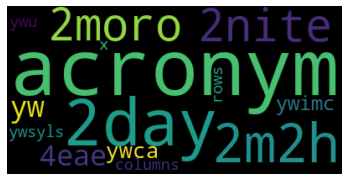

In [105]:
#dictionary_politics_list=list(dictionary_politics.values())
wordcloud = WordCloud().generate(str(slang_df))

# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [110]:
processed_docs_politics

string_docs_politics = ""
for k, v in dictionary_politics.iteritems():
    print(k, v)
    string_dictionary_politics = string_dictionary_politics+ " " +v



def word_count(str):
    counts = dict()
    words = str.split()

    for word in words:
        if word in counts:
            counts[word] += 1
        else:
            counts[word] = 1

    return counts

print( word_count(string_dictionary_politics))

{'argument': 1, 'get': 1, 'live': 1, 'point': 1, 'prefer': 1, 'well': 1, 'would': 1, 'yeah': 1, 'american': 1, 'bet': 1, 'colleg': 1, 'debt': 1, 'health': 1, 'instead': 1, 'money': 1, 'pour': 1, 'relief': 1, 'act': 1, 'actual': 1, 'digniti': 1, 'fuck': 1, 'girl': 1, 'grow': 1, 'incred': 1, 'lash': 1, 'like': 1, 'man': 1, 'media': 1, 'old': 1, 'petti': 1, 'social': 1, 'take': 1, 'thing': 1, 'think': 1, 'twitter': 1, 'year': 1, 'also': 1, 'appli': 1, 'clinton': 1, 'conserv': 1, 'conservat': 1, 'could': 1, 'defeat': 1, 'doubt': 1, 'elect': 1, 'exampl': 1, 'failur': 1, 'fair': 1, 'guess': 1, 'hillari': 1, 'liber': 1, 'listen': 1, 'modern': 1, 'not': 1, 'peopl': 1, 'repres': 1, 'stand': 1, 'still': 1, 'trump': 1, 'use': 1, 'vice': 1, 'control': 1, 'email': 1, 'even': 1, 'podesta': 1, 'releas': 1, 'russian': 1, 'today': 1, 'tweet': 1, 'wikileak': 1, 'accus': 1, 'blatant': 1, 'campaign': 1, 'doubl': 1, 'fbi': 1, 'standard': 1, 'anyon': 1, 'assault': 1, 'els': 1, 'hand': 1, 'interest': 1, 'men

In [153]:
sentence = " "

#sentence = ['this','is','a','sentence']
#sentences_strings = "'" + "','".join(sentence) + "'"

#sentence = " ".join(processed_docs_politics[0])

for n in range(10):
    for word in processed_docs_politics:
        sentence = " ".join(word)

sentence

's o m e t h'

In [118]:
slang_df
for x in slang_df.acronym:
    print(x)
    
    

2day
2m2h
2moro
2nite
4eae
aaf
aar
aayf
abd
ack
adih
adn
adr
aeap
afaic
afaik
aka
ama
ambw
aml
aota
asap
atb
ateotd
atm
awol
aydy
ayec
ayor
ays
aysos
ayt
b/c
b4
b4n
bau
bbiaf
bbiam
bbias
bbs
bbt
bcnu
bcoy
bd
bf
bfaw
bfd
bff
bffn
bfn
bg
bgwm
bhl8
bib
bn
bol
bot
boyf
brb
brh
bro
brt
bt
btw
byoc
cmb
cmiiw
cob
csl
cu
cua
cul
cwyl
cya
cye
cyo
dkdc
dm
dts
dur
dwbh
e1
ef4t
eod
f2f
ftf
faq
fb
ff
fish
fitb
ftbomh
ftl
ftw
fwb
fwiw
fyeo
fyi
g4c
ga
gac
gas
gb
gbu
gf
gfn
glhf
gmta
gnite
gr8
gratz
grl
gtsy
h&k
h2cus
h8
hag1
hagn
hand
hawt
hmb
hmu
hoas
hru
ht
hth
hw
iac
iae
ianal
iao
ic
icymi
idc
ihni
iirc
ikr
ily
im
imho
imo
ims
irl
isly
iso
iu2u
iykwim
j/k
j4f
jff
jic
jlmk
jmo
jsyk
jw
k
kk
kiss
kit
l8
l8r
lho
lmao
lmbo
lmk
lol
lol
loti
ltns
lylas
lysm
mc
mgmt
mm
msm
mu
myob
nagi
nfm
nfs
nm
nm
noyb
np
nsfl
nsfw
nts
nvm
oh
oic
omg
omw
orly
ot
otb
otoh
otp
ott
paw
pcm
pls
pov
ppl
ptb
ptmm
qq
rak
rbtl
rip
rl
rofl
rt 
rtm
rys
sby
sfaik
sh
simyc
sis
sitd
smh
sol
srsly
sry
ssdd
stby
swak
swyp
tafn
tba
tbc

wp
wpa
wpm
wpww
wr
wrt
wru
wrud
wruta
wryd
wryta
wsic
wsm
wsp
wss
wst
wsul
wswta
wt
wta
wtb
wtbs
wtc
wtd
wtdt
wtdta
wtft
wtg
wtgp
wtgp
wth
wthay
wthc
wthigo
wthit
wthiwwy
wthn
wthru
wtii
wtk
wtl
wtlw
wtm
wtmi
wtml
wtmw
wto
wtp
wtt
wttc
wttir
wttj
wttm
wtw
wty
wtyo
wuciwug
wud
wuf
wug
wugowm
wul
wula
wullnp
wum
wuw
wuwcb
wuwh
wuwt
wuwta
wuwtb
wuwu
ww
wwa
wwbd
wwcnd
wwe
wwf
wwic
wwit
wwjbd
wwjd
wwjp
wwotw
wwtbam
wwu
www
wwwy
wwy
wwyd
wwydt
wya
wyatb
wyb
wybd
wybmv
wycm
wyd
wydn
wyf
wyg
wygowm
wyk
wyl
wylaboctgwtr
wylasomwtc
wylion
wylscwtw
wylt
wym
wymm
wyn
wyp
wyr
wys
wysiwyg
wyta
wyut
wyw
wywh
wywta
yagb
yala
yana
yatb
yatk
yatloml
yavw
yaw
ybs
ybtj
ybw
ybwm
ycmiu
ycmu
ydek
ydi
ydk
ydl
ydms
ydmt
yds
ydu
yf
yfw
yg
ygg
ygi
yglt
ygm
ygpm
ygtbk
ygtbkm
ygti
ygtr
yha
yhbt
yhbw
yhgasp
yhl
yhm
yhni
yhtbt
yid
yik
yitb
yite
yjltg
yk
ykhii
ykims
yktr
ykw
ykwim
ykwis
ykylm
yl
yli
ylm
ylod
ylyl
ym
ymbj
ymca
ymcmb
ymmd
ymml
ymms
ymmv
ymw
ynk
ynw
ynwa
yolf
yolo
yomb
yoyo
yp
yqw
yr
yrg
yrmv
yro
yru
ys

In [162]:
sen = " " 
for n in range(len(politics_df['cleaned_parent_comment'])):
    sen = sen + politics_df['cleaned_parent_comment'][n]

sen

' yeah get argument point would prefer lived nc wellbet money poured college debt health debt relief americans would insteadactually acts like moody emo girl twitter lashes incredibly petty things takes social media year old man grow fuck think dignity manstill doubt conservatives stand defeating liberals use election trump example failure modern conservatism also fair use election hillary clinton representative modern liberalism guess not conservatives stand defeating liberals could applied vice versa listen people loudesttoday russian media tweeted wikileaks released podesta emails wikileaks even controlclinton campaign accuses fbi blatant double standardanyone else think interesting way mentioned tape recorder hand assaultingjohn lott cdc coding error hid record low accidental gun deaths breitbarthappens obama gives twitter accountlooking glass people bor echoing obama somethingyes hillary not care soon winsaccording federal intelligence agencies private security firms russian hacki

In [167]:
def word_count(str):
    counts = dict()
    words = str.split()    
    for word in words:
        if word in counts:
            counts[word] += 1
        else:
            counts[word] = 1

    return counts

word_count_politics = word_count(sen)
print(word_count_politics)

{'yeah': 170, 'get': 2295, 'argument': 193, 'point': 584, 'would': 4307, 'prefer': 55, 'lived': 39, 'nc': 19, 'wellbet': 1, 'money': 1099, 'poured': 5, 'college': 330, 'debt': 186, 'health': 438, 'relief': 20, 'americans': 535, 'insteadactually': 1, 'acts': 27, 'like': 3197, 'moody': 1, 'emo': 2, 'girl': 57, 'twitter': 62, 'lashes': 7, 'incredibly': 74, 'petty': 24, 'things': 746, 'takes': 164, 'social': 257, 'media': 504, 'year': 602, 'old': 389, 'man': 517, 'grow': 69, 'fuck': 473, 'think': 1828, 'dignity': 13, 'manstill': 1, 'doubt': 105, 'conservatives': 180, 'stand': 160, 'defeating': 12, 'liberals': 198, 'use': 490, 'election': 818, 'trump': 4478, 'example': 135, 'failure': 69, 'modern': 69, 'conservatism': 15, 'also': 830, 'fair': 167, 'hillary': 1892, 'clinton': 2310, 'representative': 33, 'liberalism': 15, 'guess': 231, 'not': 14300, 'could': 1339, 'applied': 22, 'vice': 44, 'versa': 3, 'listen': 97, 'people': 4718, 'loudesttoday': 1, 'russian': 120, 'tweeted': 8, 'wikileaks':

In [180]:
slang_set = set(slang_df['acronym'].to_list())
#'dnc' in slang_set
# word_count_politics

True

In [182]:
slang_in_politics = {}
for k,v in word_count_politics.items():
    if k in slang_set:
        slang_in_politics[k] = v
slang_in_politics

{'nc': 19,
 'way': 1064,
 'hand': 152,
 'cdc': 6,
 'oh': 231,
 'vs': 130,
 'time': 1268,
 'pa': 33,
 'gop': 649,
 'potus': 29,
 'ama': 8,
 'us': 1537,
 'dnc': 300,
 'op': 57,
 'btw': 19,
 'im': 50,
 'k': 179,
 'etc': 212,
 'nato': 25,
 'pc': 22,
 'irs': 45,
 'nasa': 17,
 'msm': 31,
 'lmao': 7,
 'vp': 72,
 'cnn': 122,
 'ny': 72,
 'mr': 52,
 'lol': 61,
 'nice': 145,
 'hrc': 59,
 'abc': 21,
 'japan': 26,
 'nyt': 24,
 'otoh': 2,
 'add': 92,
 'ads': 54,
 'npr': 18,
 'le': 4,
 'et': 10,
 'kgb': 3,
 'oy': 1,
 'mud': 9,
 'nra': 54,
 'gfc': 2,
 'sat': 14,
 'wtf': 31,
 'nj': 9,
 'icu': 1,
 'ga': 6,
 'kim': 18,
 'idk': 6,
 'fwiw': 2,
 'sol': 1,
 'usa': 89,
 'rip': 8,
 'tom': 16,
 'j': 24,
 'il': 6,
 'asap': 3,
 'tbh': 5,
 'iirc': 6,
 'kkk': 40,
 'gas': 87,
 'nyc': 35,
 'bro': 23,
 'ss': 20,
 'mo': 10,
 'jfk': 10,
 'co': 58,
 'led': 63,
 'wmd': 6,
 'ww': 19,
 'llc': 2,
 'gdp': 43,
 'nbc': 28,
 'rd': 59,
 'ev': 3,
 'pr': 22,
 'scotus': 31,
 'doe': 9,
 'iq': 15,
 'kiss': 17,
 'mm': 6,
 'bbc': 9,
 'n

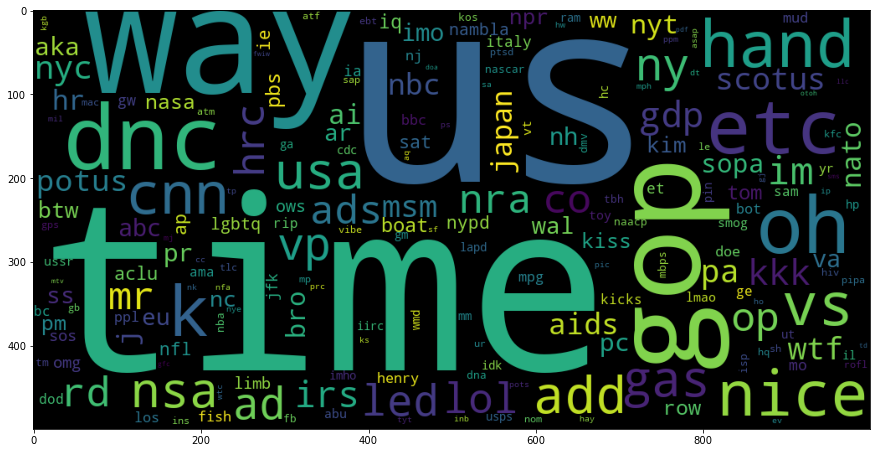

In [183]:
wordcloud = WordCloud(width = 1000, height = 500).generate_from_frequencies(slang_in_politics)

plt.figure(figsize=(15,8))
plt.imshow(wordcloud)

In [184]:
#We will check for Askreddit:
AskReddit_df = top_5_df[top_5_df["subreddit"].isin(["AskReddit"])]
AskReddit_df.index = pd.RangeIndex(len(AskReddit_df.index))

AskReddit_df.index = range(len(AskReddit_df.index))

AskReddit_df.reset_index(inplace=True)
#politics_df['index_col'] = politics_df.index

AskReddit_df['cleaned_parent_comment'] = AskReddit_df['cleaned_parent_comment'].astype('str') 

AskReddit_df

C:\Users\kapil\AppData\Local\Temp/ipykernel_22532/1718705665.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  AskReddit_df['cleaned_parent_comment'] = AskReddit_df['cleaned_parent_comment'].astype('str')


,index,label,cleaned_parent_comment,subreddit
0,0,0,find ariana grande sexy,AskReddit
1,1,0,weird unsettling trick treat story,AskReddit
2,2,0,star wars easy not bothered indiana jones tbh,AskReddit
3,3,0,like end piece bread loaf everyone touches no ...,AskReddit
4,4,0,house burning time grab one thing not includin...,AskReddit
...,...,...,...,...
65672,65672,1,kidding reason not like dave mathews not like ...,AskReddit
65673,65673,0,not really need notifier envelope almost never...,AskReddit
65674,65674,1,second point freedom liberties,AskReddit
65675,65675,1,catholic high school not let girl participate ...,AskReddit


In [187]:
AskReddit_str = " " 
for n in range(len(AskReddit_df['cleaned_parent_comment'])):
    AskReddit_str = AskReddit_str + AskReddit_df['cleaned_parent_comment'][n] + " "

AskReddit_str

' find ariana grande sexy weird unsettling trick treat story star wars easy not bothered indiana jones tbh like end piece bread loaf everyone touches no one wants house burning time grab one thing not including family pets grab hate mainstream spell ness necc nessecary even auto correct used spelling wrong little self lovin turn turn frown upside beat like money much drake represents personality canadians turn signals cars reason people not use could scare crap kids clicky noise predator makes id love able actions person tells newbie job hobby etc yes mentioned different comment yes whole problem lol amount times thought exact sentence staggering man expect hung af house morning no couches sat next feet began massaging seconds realizing everyone looking like actual fuck pleased say not get many invites parties hs anymore may uni new start please not follow logic already forgotten civil war no one alive actually lived yeah not think ever noticed chalk marks every day favourite way mess 

In [188]:
word_count_AskReddit = word_count(AskReddit_str)
print(word_count_AskReddit)

{'find': 1068, 'ariana': 3, 'grande': 5, 'sexy': 111, 'weird': 485, 'unsettling': 9, 'trick': 77, 'treat': 111, 'story': 609, 'star': 191, 'wars': 120, 'easy': 281, 'not': 22752, 'bothered': 48, 'indiana': 21, 'jones': 18, 'tbh': 31, 'like': 7274, 'end': 708, 'piece': 233, 'bread': 88, 'loaf': 12, 'everyone': 1411, 'touches': 19, 'no': 4332, 'one': 5666, 'wants': 260, 'house': 651, 'burning': 44, 'time': 3505, 'grab': 99, 'thing': 2723, 'including': 108, 'family': 667, 'pets': 41, 'hate': 932, 'mainstream': 29, 'spell': 36, 'ness': 15, 'necc': 1, 'nessecary': 2, 'even': 2282, 'auto': 38, 'correct': 174, 'used': 944, 'spelling': 41, 'wrong': 753, 'little': 1057, 'self': 337, 'lovin': 6, 'turn': 449, 'frown': 2, 'upside': 20, 'beat': 196, 'money': 1052, 'much': 1915, 'drake': 6, 'represents': 7, 'personality': 82, 'canadians': 30, 'signals': 31, 'cars': 191, 'reason': 686, 'people': 7209, 'use': 1239, 'could': 2969, 'scare': 25, 'crap': 98, 'kids': 971, 'clicky': 1, 'noise': 74, 'predato

In [189]:
slang_in_AskReddit = {}
for k,v in word_count_AskReddit.items():
    if k in slang_set:
        slang_in_AskReddit[k] = v
slang_in_AskReddit

{'tbh': 31,
 'time': 3505,
 'etc': 566,
 'lol': 292,
 'sat': 114,
 'way': 2115,
 'row': 54,
 'bbq': 18,
 'tp': 7,
 'ib': 3,
 'ap': 20,
 'kicks': 24,
 'im': 262,
 'tom': 63,
 'iirc': 28,
 'oh': 709,
 'us': 1692,
 'mo': 16,
 'omg': 42,
 'usa': 145,
 'dna': 18,
 'bro': 100,
 'htc': 4,
 'kim': 33,
 'vs': 101,
 'pc': 130,
 'kfc': 5,
 'mr': 86,
 'op': 178,
 'hand': 432,
 'html': 5,
 'ads': 46,
 'cm': 10,
 'bf': 40,
 'nice': 574,
 'rn': 7,
 'vat': 3,
 'fwiw': 3,
 'ac': 17,
 'ss': 10,
 'psu': 6,
 'bc': 26,
 'adhd': 19,
 'ur': 30,
 'ai': 92,
 'boat': 69,
 'wr': 2,
 'ad': 54,
 'kiss': 67,
 'nfl': 22,
 'nk': 5,
 'ww': 42,
 'kotor': 3,
 'hr': 25,
 'ras': 1,
 'msg': 7,
 'rip': 62,
 'aids': 38,
 'hbo': 21,
 'nyc': 27,
 'k': 226,
 'nap': 16,
 'pr': 6,
 'bot': 23,
 'pan': 25,
 'gas': 133,
 'ie': 36,
 'brb': 9,
 'j': 31,
 'va': 5,
 'ooh': 11,
 'usd': 29,
 'ks': 1,
 'pin': 22,
 'gdp': 6,
 'nhs': 11,
 'ip': 10,
 'henry': 13,
 'bing': 19,
 'rc': 2,
 'nms': 2,
 'ihop': 2,
 'pbs': 4,
 'rd': 64,
 'vhs': 9,
 

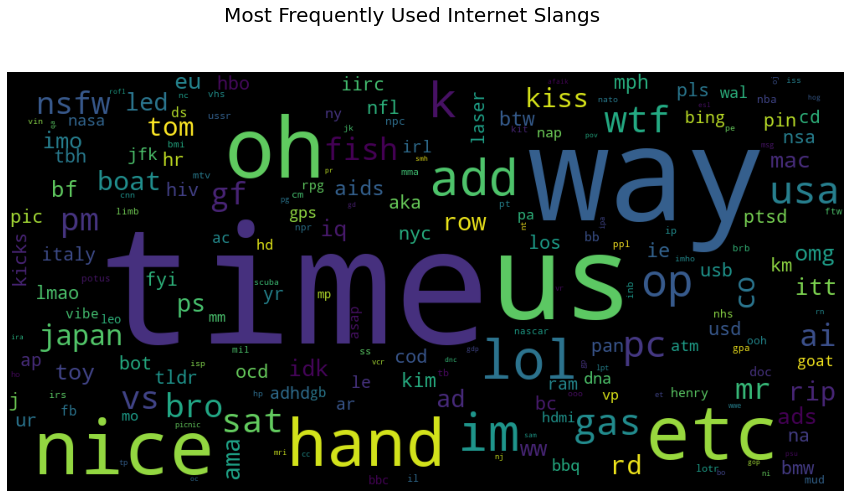

In [206]:
wordcloud = WordCloud(width = 1000, height = 500).generate_from_frequencies(slang_in_AskReddit)

plt.figure(figsize=(15,8)).suptitle('Most Frequently Used Internet Slangs', fontsize=20)
plt.axis('off')
#plt.update_xaxes(visible=False)
plt.imshow(wordcloud)